In [1]:

import simpy
import random
import matplotlib.pyplot as pp
import numpy as np
import pandas as pd

%matplotlib inline


In [2]:
start_date = "16/3/2020"
df = pd.read_excel('casos_covid.xlsx')
clasificador = df[df['Provincia'] == "Guayas"]
confirmados = clasificador.iloc[0].loc[start_date:]

T_CRECIMIENTO = np.round(np.mean(confirmados))
T_CRECIMIENTO

2980.0

In [21]:
import simpy
import random
import matplotlib.pyplot as pp
import numpy as np
import pandas as pd

#PARAMETROS
HOSPITALES = 2
HOSPITAL_CAMA_A = 492 #(https://www.salud.gob.ec/hospital-general-guasmo-sur/)
HOSPITAL_CAMA_B = 228 #(https://www.salud.gob.ec/hospital-de-especialidades-abel-gilbert-ponton/)
HOSPITAL_Personal_A = 430
HOSPITAL_Personal_B = 200
HOSPITAL_Equipos_A = 240
HOSPITAL_Equipos_B = 120 
INFECTADOS = 100
TASA_CRECIMIENTO = int(T_CRECIMIENTO)
DIAS_INTERNADO = 12
DIAS_REQUIERE_PERSONAL = 9
DIAS_USO_DE_EQUIPOS = 4
DIAS_SIMULACION = 100
COSTO_INDIVIDUAL = 10000


#Diccionario para almacenar los resultados
persona_recuperadas={}
persona_fallecidas={}

ninos={}
n_mujeres = {}
n_hombres = {}
nh_sintomas = {}
nm_sintomas = {}
nh_neumonia = {}
nm_neumonia = {}
nh_intensivos = {}
nm_intensivos = {}
nm_fallecidos = {}
nh_fallecidos = {}
nm_recuperados = {}
nh_recuperados = {}

adultos={}
a_mujeres = {}
a_hombres = {}
ah_sintomas = {}
am_sintomas = {}
ah_intensivos = {}
am_intensivos = {}
ah_neumonia = {}
am_neumonia = {}
am_fallecidos = {}
ah_fallecidos = {}
am_recuperados = {}
ah_recuperados = {}

a_mayor={}
am_mujeres = {}
am_hombres = {}
amh_sintomas = {}
amm_sintomas = {}
amh_intensivos = {}
amm_intensivos = {}
amh_neumonia = {}
amm_neumonia = {}
amm_fallecidos = {}
amh_fallecidos = {}
amm_recuperados = {}
amh_recuperados = {}




atendidos_equip=[]
camas_atendidos=[]
personal_atiende=[]

class Hospital(object):
    #constructor
    def __init__(self, env, num_cama,num_personal,num_equipos, name):
            self.env = env
            self.num_cama = num_cama
            self.num_personal=num_personal
            self.num_equipos=num_equipos
            self.camas = simpy.Resource(env, num_cama)
            self.personal = simpy.Resource(env, num_personal)
            self.equipos = simpy.Resource(env, num_equipos)
            self.name = name
            
    def ingresar_paciente(self, paciente):
        yield self.env.timeout(random.randint(DIAS_INTERNADO-5, DIAS_INTERNADO+5))
        print("El paciente ",paciente," fue a una cama en  tiempo de salida: ", self.env.now, " hospital ", self.name)
    def uso_personal_paciente(self, paciente):
        yield self.env.timeout(random.randint(DIAS_REQUIERE_PERSONAL-3, DIAS_REQUIERE_PERSONAL+3))
        print("El paciente fue atendido por el personal: ", paciente, " tiempo de salida: ", self.env.now, " hospital ", self.name)
    def uso_equipo_paciente(self, paciente):
        yield self.env.timeout(random.randint(DIAS_USO_DE_EQUIPOS-1, DIAS_USO_DE_EQUIPOS+1))
        print("El paciente Recibio equipos: ", paciente, " tiempo de salida: ", self.env.now, " hospital ", self.name)
    
        

        
        
        
        
        
def llegada_paciente(env, hospital, paciente):#Metodo donde llega el paciente
    arrive = env.now
    edad = random.randint(1,100)
    numero = random.randint(1,100)
    ###Inicio De ninos y jovenes
    try:
      #########
      ########Ninos
      #########
    
        if (edad <= 14 and edad > 0):
            if(numero <= 46): #46 = (13*100/28)representa ninos varones
                n_hombres[env.now] =  n_hombres[env.now]+1 if env.now in n_hombres else 1
                global nh_sintomas
                global nh_fallecidos
                global nh_recuperados
                global nh_neumonia
                global nh_intensivos
                sintomas = nh_sintomas
                fallecidos = nh_fallecidos
                recuperados = nh_recuperados
                neumonia = nh_neumonia
                intensivos = nh_intensivos
            else:
                n_mujeres[env.now] =  n_mujeres[env.now]+1 if env.now in n_mujeres else 1
                global nm_sintomas
                global nm_fallecidos
                global nm_recuperados
                global nm_neumonia
                global nm_intensivos
                fallecidos = nm_fallecidos
                sintomas = nm_sintomas
                recuperados = nm_recuperados
                neumonia = nm_neumonia
                intensivos = nm_intensivos
            ninos[env.now] =  ninos[env.now]+1 if env.now in ninos else 1
                
            sintoma = random.randint(1,100) 

            if(sintoma<=5):
                sintomas[env.now] =  sintomas[env.now]+1 if env.now in sintomas else 1
                with hospital.camas.request() as cama:
                        dias_esperando = random.randint(1,3) #Numero de dias maximo que puede esperar sin ser asignado a una cama dentro del hospital
                        requerimiento = yield cama | env.timeout(dias_esperando) #Asignar un tiempo de espera
                        wait = env.now - arrive
                        if cama in requerimiento:
                            print("Al paciente: ", paciente, " se le asigna una CAMA ", " hospital " , hospital.name)
                            yield env.process(hospital.ingresar_paciente(paciente))
                            arrive2 = env.now
                            camas_atendidos.append(1)
                            ineumonia = random.randint(1,100)
                            if(ineumonia<=75):
                                neumonia[env.now] =  neumonia[env.now]+1 if env.now in neumonia else 1
                                with hospital.personal.request() as persona:
                                    dias_esperando_personal = random.randint(1,2)
                                    requerimiento2 = yield persona | env.timeout(dias_esperando_personal)
                                    wait_fpersonal = env.now - arrive2
                                    if persona in requerimiento2:
                                        print("El paciente: ", paciente, " recibe atencion del personal ", " hospital " , hospital.name)
                                        yield env.process(hospital.uso_personal_paciente(paciente))
                                        arrive3 = env.now
                                        personal_atiende.append(1)
                                        with hospital.equipos.request() as equipo:
                                            dias_esperando_equipo = random.randint(1,2)
                                            requerimiento3 = yield equipo | env.timeout(dias_esperando_equipo)
                                            wait_fequipo = env.now - arrive3
                                            iintensivos = random.randint(1,100)
                                            if(iintensivos <= 25):
                                                intensivos[env.now] =  intensivos[env.now]+1 if env.now in intensivos else 1
                                                if equipo in requerimiento3:
                                                    
                                                    print("El paciente: ", paciente, " entra a cuidados intensivos ", " hospital " , hospital.name)
                                                    yield env.process(hospital.uso_equipo_paciente(paciente))
                                                    fallece = random.randint(0,1)
                                                    atendidos_equip.append(1)
                                                    if (fallece == 1) : 
                                                        print("Paciente",paciente," menor de edad hombre fallece")
                                                        fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                                                    else:
                                                        print("Paciente",paciente," menor de edad hombre se recupera")
                                                        recuperados[env.now] = recuperados[env.now] + 1 if env.now in recuperados else 1 
                                                else:
                                                    print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait_fequipo , " dias y fallece no hubo Equipo")
                                                    fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                                            else:
                                                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1
                                    else:
                                        print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait_fpersonal , " dias y fallece no hubo personal")
                                        fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                            else:
                                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1
                        else:
                            print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait , " dias y fallece no hay camas")
                            fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1  
            else:
                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1

            if(numero <= 46): #46 = (13*100/28)representa ninos varones
                n_hombres[env.now] =  n_hombres[env.now]+1 if env.now in n_hombres else 1
                nh_fallecidos= fallecidos
                nh_recuperados = recuperados 
                nh_sintomas = sintomas
            else:
                n_mujeres[env.now] =  n_mujeres[env.now]+1 if env.now in n_mujeres else 1
                nm_fallecidos = fallecidos 
                nm_recuperados = recuperados
                nm_sintomas = sintomas 
            

                ###Fin De ninos y jovenes

      #########
      ########ADULTOS 
      #########
        if (edad <= 64 and edad >= 15):
            #definir(env,adultos,edad,hospital,arrive,paciente)
            genero = round(30*100/65)
            if(numero <= genero): #= (30*100/65)representa ninos varones
                a_hombres[env.now] =  a_hombres[env.now]+1 if env.now in a_hombres else 1
                global ah_sintomas
                global ah_fallecidos
                global ah_recuperados
                global ah_neumonia
                global ah_intensivos
                sintomas = ah_sintomas
                fallecidos = ah_fallecidos
                recuperados = ah_recuperados
                neumonia = ah_neumonia
                intensivos = ah_intensivos
            else:
                a_mujeres[env.now] =  a_mujeres[env.now]+1 if env.now in a_mujeres else 1
                global am_sintomas
                global am_fallecidos
                global am_recuperados
                global am_neumonia
                global am_intensivos
                fallecidos = am_fallecidos
                sintomas = am_sintomas
                recuperados = am_recuperados
                neumonia = am_neumonia
                intensivos = am_intensivos
            adultos[env.now] =  adultos[env.now]+1 if env.now in adultos else 1
            sintoma = 100 

            if(sintoma<=100):
                sintomas[env.now] =  sintomas[env.now]+1 if env.now in sintomas else 1
                with hospital.camas.request() as cama:
                        dias_esperando = random.randint(1,3) #Numero de dias maximo que puede esperar sin ser asignado a una cama dentro del hospital
                        requerimiento = yield cama | env.timeout(dias_esperando) #Asignar un tiempo de espera
                        wait = env.now - arrive
                        if cama in requerimiento:
                            print("Al paciente: ", paciente, " se le asigna una CAMA ", " hospital " , hospital.name)
                            yield env.process(hospital.ingresar_paciente(paciente))
                            arrive2 = env.now
                            camas_atendidos.append(1)
                            ineumonia = random.randint(1,100)
                            if(ineumonia<=75):
                                neumonia[env.now] =  neumonia[env.now]+1 if env.now in neumonia else 1
                                with hospital.personal.request() as persona:
                                    dias_esperando_personal = random.randint(1,2)
                                    requerimiento2 = yield persona | env.timeout(dias_esperando_personal)
                                    wait_fpersonal = env.now - arrive2
                                    if persona in requerimiento2:
                                        print("El paciente: ", paciente, " recibe atencion del personal ", " hospital " , hospital.name)
                                        yield env.process(hospital.uso_personal_paciente(paciente))
                                        arrive3 = env.now
                                        personal_atiende.append(1)
                                        with hospital.equipos.request() as equipo:
                                            dias_esperando_equipo = random.randint(1,2)
                                            requerimiento3 = yield equipo | env.timeout(dias_esperando_equipo)
                                            wait_fequipo = env.now - arrive3
                                            iintensivos = random.randint(1,100)
                                            if(iintensivos <= 25):
                                                intensivos[env.now] =  intensivos[env.now]+1 if env.now in intensivos else 1
                                                if equipo in requerimiento3:
                                                    print("El paciente: ", paciente, " entra a cuidados intensivos ", " hospital " , hospital.name)
                                                    yield env.process(hospital.uso_equipo_paciente(paciente))
                                                    fallece = random.randint(0,1)
                                                    atendidos_equip.append(1)
                                                    if (fallece == 0) : 
                                                        print("Paciente",paciente,"  fallece")
                                                        fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                                                    else:
                                                        print("Paciente",paciente,"  se recupera")
                                                        recuperados[env.now] = recuperados[env.now] + 1 if env.now in recuperados else 1 
                                                else:
                                                    print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait_fequipo , " dias y fallece no hubo Equipo")
                                                    recuperados[env.now] = recuperados[env.now] + 1 if env.now in recuperados else 1
                                            else:
                                                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1 
                                    else:
                                        print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait_fpersonal , " dias y fallece no hubo personal")
                                        fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                            else:
                                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1
                        else:
                            print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait , " dias y fallece no hay camas")
                            fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1  
            else:
                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1


            if(numero <= genero): #46 = (13*100/28)representa ninos varones 
                ah_fallecidos= fallecidos
                ah_recuperados = recuperados 
                ah_sintomas = sintomas
                ah_neumonia = neumonia
                ah_intensivos = intensivos
            else: 
                am_fallecidos = fallecidos 
                am_recuperados = recuperados
                am_sintomas = sintomas
                am_neumonia = neumonia
                am_intensivos = intensivos



      #########
      ########ADULTOS MAYORES
      #########
        if (edad <= 100 and edad >= 65): 
            a_mayor[env.now] =  a_mayor[env.now]+1 if env.now in a_mayor else 1
            genero = round(3*100/7)
            if(numero <= genero): #= (30*100/65)representa ninos varones
                global amh_fallecidos
                global amh_neumonia
                global amh_recuperados
                global amh_sintomas
                global amh_intensivos
                am_hombres[env.now] =  am_hombres[env.now]+1 if env.now in am_hombres else 1
                sintomas = amh_sintomas
                fallecidos = amh_fallecidos
                recuperados = amh_recuperados
                intensivos = amh_intensivos
            else:
                am_mujeres[env.now] =  a_mujeres[env.now]+1 if env.now in a_mujeres else 1
                global amm_fallecidos
                global amm_neumonia
                global amm_recuperados
                global amm_sintomas
                global amm_intensivos
                fallecidos = amm_fallecidos
                sintomas = amm_sintomas
                recuperados = amm_recuperados
                neumonia = amm_sintomas
                intensivos = amm_intensivos
            
            sintoma = 100 

            if(sintoma<=100):
                sintomas[env.now] =  sintomas[env.now]+1 if env.now in sintomas else 1
                with hospital.camas.request() as cama:
                        dias_esperando = random.randint(1,3) #Numero de dias maximo que puede esperar sin ser asignado a una cama dentro del hospital
                        requerimiento = yield cama | env.timeout(dias_esperando) #Asignar un tiempo de espera
                        wait = env.now - arrive
                        if cama in requerimiento:
                            print("Al paciente: ", paciente, " se le asigna una CAMA ", " hospital " , hospital.name)
                            yield env.process(hospital.ingresar_paciente(paciente))
                            arrive2 = env.now
                            camas_atendidos.append(1)
                            with hospital.personal.request() as persona:
                                dias_esperando_personal = random.randint(1,2)
                                requerimiento2 = yield persona | env.timeout(dias_esperando_personal)
                                wait_fpersonal = env.now - arrive2
                                if persona in requerimiento2:
                                    print("El paciente: ", paciente, " recibe atencion del personal ", " hospital " , hospital.name)
                                    yield env.process(hospital.uso_personal_paciente(paciente))
                                    arrive3 = env.now
                                    personal_atiende.append(1)
                                    with hospital.equipos.request() as equipo:
                                        dias_esperando_equipo = random.randint(1,2)
                                        requerimiento3 = yield equipo | env.timeout(dias_esperando_equipo)
                                        wait_fequipo = env.now - arrive3
                                        iintensivos = random.randint(1,100)
                                        if(iintensivos <= 25):
                                            intensivos[env.now] =  intensivos[env.now]+1 if env.now in intensivos else 1
                                            if equipo in requerimiento3:
                                                print("El paciente: ", paciente, " entra a cuidados intensivos ", " hospital " , hospital.name)
                                                yield env.process(hospital.uso_equipo_paciente(paciente))
                                                fallece = random.randint(0,1)
                                                atendidos_equip.append(1)
                                                if (fallece == 1) : 
                                                    print("Paciente",paciente,"  fallece")
                                                    fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                                                else:
                                                    print("Paciente",paciente,"  se recupera")
                                                    recuperados[env.now] = recuperados[env.now] + 1 if env.now in recuperados else 1 
                                            else:
                                                print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait_fequipo , " dias y fallece no hubo Equipo")
                                                fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1
                                        else:
                                            recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1
                                else:
                                    print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait_fpersonal , " dias y fallece no hubo personal")
                                    fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1

                        else:
                            print("El paciente " , paciente, " en el hospital ", hospital.name, " espero ", wait , " dias y fallece no hay camas")
                            fallecidos[env.now] = fallecidos[env.now] + 1 if env.now in fallecidos else 1  
            else:
                recuperados[env.now] =  recuperados[env.now]+1 if env.now in recuperados else 1


            if(numero <= genero): #46 = (13*100/28)representa ninos varones
                amh_fallecidos= fallecidos
                amh_recuperados = recuperados 
                amh_sintomas = sintomas
                amh_neumonia = neumonia
                amh_intensivos = intensivos
            else: 
                amm_fallecidos = fallecidos 
                amm_recuperados = recuperados
                amm_sintomas = sintomas 
                amm_neumonia = neumonia
                amm_intensivos = intensivos
    
    except:
        a=1

         
        
        
def ejecutar(env, tasa_crecimiento, infectados):
    hospitalA = Hospital(env, HOSPITAL_CAMA_A,HOSPITAL_Personal_A,HOSPITAL_Equipos_A, "A")
    hospitalB = Hospital(env, HOSPITAL_CAMA_B,HOSPITAL_Personal_B,HOSPITAL_Equipos_B, "B")
    for i in range(infectados):
        asignar_hospital(env, hospitalA, hospitalB, i)
    paciente = infectados
    while True:
        yield env.timeout(1)
        for i in range(tasa_crecimiento):
            paciente += 1
            asignar_hospital(env, hospitalA, hospitalB, paciente)
                
def asignar_hospital(env, hospitalA, hospitalB, paciente):
    hosp_esc = random.randint(1,2)
    if (hosp_esc == 1):
        print("Llega paciente nuevo : ", paciente, " hospital A tiempo ", env.now)
        env.process(llegada_paciente(env, hospitalA, paciente))
    else:
        print("Llega paciente nuevo : ", paciente, " hospital B tiempo ", env.now)
        env.process(llegada_paciente(env, hospitalB, paciente))
    
print("Simulacion COVID 19")
env=simpy.Environment()
env.process(ejecutar(env,TASA_CRECIMIENTO, INFECTADOS))
env.run(until=DIAS_SIMULACION)

print("###Resultados pacientes###")
print("Recuperados: ")
print(nh_recuperados)
print("Fallecidos: ")
print(nh_fallecidos)


df = pd.DataFrame(columns = ["Personas","Total","Sintomas","Neumonia","Intensivo","Fallecieron","Curados Total"])
#primera columna (Total)
total_ninos = sum(ninos.values())
total_adultos = sum(adultos.values())
total_amayores = sum(a_mayor.values())

#segunda columna (Sintomas)
total_nsintomas = sum(nh_sintomas.values())+sum(nm_sintomas.values())
total_asintomas = sum(ah_sintomas.values())+sum(am_sintomas.values())
total_amsintomas = sum(amh_sintomas.values())+sum(amm_sintomas.values())

#tercera columna (Neumonia)
total_nneumonia = sum(nh_neumonia.values())+sum(nm_neumonia.values())
total_aneumonia = sum(ah_neumonia.values())+sum(amm_neumonia.values())
total_amneumonia = sum(amh_neumonia.values())+sum(amm_neumonia.values())

#cuarta columna (Intensivo)
total_nintensivos = sum(nh_intensivos.values())+sum(nm_intensivos.values())
total_aintensivos = sum(ah_intensivos.values())+sum(am_intensivos.values())
total_amintensivos = sum(amh_intensivos.values())+sum(amm_intensivos.values())

#quinta columna (Fallecieron)
total_nfallecidos = sum(nh_fallecidos.values())+sum(nm_fallecidos.values())
total_afallecidos = sum(ah_fallecidos.values())+sum(am_fallecidos.values())
total_amfallecidos = sum(amh_fallecidos.values())+sum(amm_fallecidos.values())

#sexta columna (Recuperados)
total_nrecuperados = total_ninos-total_nfallecidos
total_arecuperados = total_adultos-total_afallecidos
total_amrecuperados = total_amayores-total_amfallecidos

##Para histograma hombres
total_hombres = sum(n_hombres.values())+sum(a_hombres.values())+sum(am_hombres.values())
total_hsintomas = sum(nh_sintomas.values())+sum(ah_sintomas.values())+sum(amh_sintomas.values())
total_hintensivos = sum(nh_intensivos.values())+sum(ah_intensivos.values())+sum(amh_intensivos.values())
total_hneumonia = sum(nh_neumonia.values()) + sum(ah_neumonia.values())+ sum(amh_neumonia.values())
total_hrecuperados = sum(nh_recuperados.values()) + sum(ah_recuperados.values()) + sum(amh_recuperados.values())
total_hfallecidos = sum(nh_fallecidos.values()) + sum(ah_fallecidos.values()) + sum(amh_fallecidos.values())

##Para histograma mujeres
total_mujeres = sum(n_mujeres.values())+sum(a_mujeres.values())+sum(am_mujeres.values())
total_msintomas = sum(nm_sintomas.values())+sum(am_sintomas.values())+sum(amm_sintomas.values())
total_mintensivos = sum(nm_intensivos.values())+sum(am_intensivos.values())+sum(amm_intensivos.values())
total_mneumonia = sum(nm_neumonia.values()) + sum(am_neumonia.values())+ sum(amm_neumonia.values())
total_mrecuperados = sum(nm_recuperados.values()) + sum(am_recuperados.values()) + sum(amm_recuperados.values())
total_mfallecidos = sum(nm_fallecidos.values()) + sum(am_fallecidos.values()) + sum(amm_fallecidos.values())


Simulacion COVID 19
Llega paciente nuevo :  0  hospital A tiempo  0
Llega paciente nuevo :  1  hospital A tiempo  0
Llega paciente nuevo :  2  hospital A tiempo  0
Llega paciente nuevo :  3  hospital A tiempo  0
Llega paciente nuevo :  4  hospital A tiempo  0
Llega paciente nuevo :  5  hospital A tiempo  0
Llega paciente nuevo :  6  hospital A tiempo  0
Llega paciente nuevo :  7  hospital B tiempo  0
Llega paciente nuevo :  8  hospital B tiempo  0
Llega paciente nuevo :  9  hospital A tiempo  0
Llega paciente nuevo :  10  hospital B tiempo  0
Llega paciente nuevo :  11  hospital A tiempo  0
Llega paciente nuevo :  12  hospital B tiempo  0
Llega paciente nuevo :  13  hospital B tiempo  0
Llega paciente nuevo :  14  hospital B tiempo  0
Llega paciente nuevo :  15  hospital A tiempo  0
Llega paciente nuevo :  16  hospital B tiempo  0
Llega paciente nuevo :  17  hospital A tiempo  0
Llega paciente nuevo :  18  hospital A tiempo  0
Llega paciente nuevo :  19  hospital A tiempo  0
Llega paci

Llega paciente nuevo :  150  hospital B tiempo  1
Llega paciente nuevo :  151  hospital B tiempo  1
Llega paciente nuevo :  152  hospital A tiempo  1
Llega paciente nuevo :  153  hospital A tiempo  1
Llega paciente nuevo :  154  hospital B tiempo  1
Llega paciente nuevo :  155  hospital B tiempo  1
Llega paciente nuevo :  156  hospital A tiempo  1
Llega paciente nuevo :  157  hospital A tiempo  1
Llega paciente nuevo :  158  hospital A tiempo  1
Llega paciente nuevo :  159  hospital A tiempo  1
Llega paciente nuevo :  160  hospital B tiempo  1
Llega paciente nuevo :  161  hospital A tiempo  1
Llega paciente nuevo :  162  hospital A tiempo  1
Llega paciente nuevo :  163  hospital A tiempo  1
Llega paciente nuevo :  164  hospital A tiempo  1
Llega paciente nuevo :  165  hospital A tiempo  1
Llega paciente nuevo :  166  hospital A tiempo  1
Llega paciente nuevo :  167  hospital B tiempo  1
Llega paciente nuevo :  168  hospital B tiempo  1
Llega paciente nuevo :  169  hospital A tiempo  1


Llega paciente nuevo :  400  hospital A tiempo  1
Llega paciente nuevo :  401  hospital B tiempo  1
Llega paciente nuevo :  402  hospital B tiempo  1
Llega paciente nuevo :  403  hospital A tiempo  1
Llega paciente nuevo :  404  hospital A tiempo  1
Llega paciente nuevo :  405  hospital A tiempo  1
Llega paciente nuevo :  406  hospital A tiempo  1
Llega paciente nuevo :  407  hospital B tiempo  1
Llega paciente nuevo :  408  hospital B tiempo  1
Llega paciente nuevo :  409  hospital B tiempo  1
Llega paciente nuevo :  410  hospital B tiempo  1
Llega paciente nuevo :  411  hospital A tiempo  1
Llega paciente nuevo :  412  hospital A tiempo  1
Llega paciente nuevo :  413  hospital B tiempo  1
Llega paciente nuevo :  414  hospital A tiempo  1
Llega paciente nuevo :  415  hospital B tiempo  1
Llega paciente nuevo :  416  hospital B tiempo  1
Llega paciente nuevo :  417  hospital A tiempo  1
Llega paciente nuevo :  418  hospital A tiempo  1
Llega paciente nuevo :  419  hospital B tiempo  1


Llega paciente nuevo :  775  hospital B tiempo  1
Llega paciente nuevo :  776  hospital B tiempo  1
Llega paciente nuevo :  777  hospital A tiempo  1
Llega paciente nuevo :  778  hospital B tiempo  1
Llega paciente nuevo :  779  hospital A tiempo  1
Llega paciente nuevo :  780  hospital A tiempo  1
Llega paciente nuevo :  781  hospital A tiempo  1
Llega paciente nuevo :  782  hospital A tiempo  1
Llega paciente nuevo :  783  hospital A tiempo  1
Llega paciente nuevo :  784  hospital A tiempo  1
Llega paciente nuevo :  785  hospital A tiempo  1
Llega paciente nuevo :  786  hospital A tiempo  1
Llega paciente nuevo :  787  hospital A tiempo  1
Llega paciente nuevo :  788  hospital A tiempo  1
Llega paciente nuevo :  789  hospital A tiempo  1
Llega paciente nuevo :  790  hospital B tiempo  1
Llega paciente nuevo :  791  hospital B tiempo  1
Llega paciente nuevo :  792  hospital A tiempo  1
Llega paciente nuevo :  793  hospital A tiempo  1
Llega paciente nuevo :  794  hospital B tiempo  1


Llega paciente nuevo :  961  hospital A tiempo  1
Llega paciente nuevo :  962  hospital A tiempo  1
Llega paciente nuevo :  963  hospital B tiempo  1
Llega paciente nuevo :  964  hospital B tiempo  1
Llega paciente nuevo :  965  hospital B tiempo  1
Llega paciente nuevo :  966  hospital B tiempo  1
Llega paciente nuevo :  967  hospital B tiempo  1
Llega paciente nuevo :  968  hospital B tiempo  1
Llega paciente nuevo :  969  hospital B tiempo  1
Llega paciente nuevo :  970  hospital A tiempo  1
Llega paciente nuevo :  971  hospital B tiempo  1
Llega paciente nuevo :  972  hospital B tiempo  1
Llega paciente nuevo :  973  hospital A tiempo  1
Llega paciente nuevo :  974  hospital B tiempo  1
Llega paciente nuevo :  975  hospital B tiempo  1
Llega paciente nuevo :  976  hospital A tiempo  1
Llega paciente nuevo :  977  hospital B tiempo  1
Llega paciente nuevo :  978  hospital A tiempo  1
Llega paciente nuevo :  979  hospital B tiempo  1
Llega paciente nuevo :  980  hospital B tiempo  1


Llega paciente nuevo :  1274  hospital B tiempo  1
Llega paciente nuevo :  1275  hospital B tiempo  1
Llega paciente nuevo :  1276  hospital A tiempo  1
Llega paciente nuevo :  1277  hospital A tiempo  1
Llega paciente nuevo :  1278  hospital B tiempo  1
Llega paciente nuevo :  1279  hospital B tiempo  1
Llega paciente nuevo :  1280  hospital A tiempo  1
Llega paciente nuevo :  1281  hospital B tiempo  1
Llega paciente nuevo :  1282  hospital A tiempo  1
Llega paciente nuevo :  1283  hospital A tiempo  1
Llega paciente nuevo :  1284  hospital B tiempo  1
Llega paciente nuevo :  1285  hospital A tiempo  1
Llega paciente nuevo :  1286  hospital A tiempo  1
Llega paciente nuevo :  1287  hospital B tiempo  1
Llega paciente nuevo :  1288  hospital B tiempo  1
Llega paciente nuevo :  1289  hospital A tiempo  1
Llega paciente nuevo :  1290  hospital A tiempo  1
Llega paciente nuevo :  1291  hospital A tiempo  1
Llega paciente nuevo :  1292  hospital B tiempo  1
Llega paciente nuevo :  1293  h

Llega paciente nuevo :  1524  hospital A tiempo  1
Llega paciente nuevo :  1525  hospital B tiempo  1
Llega paciente nuevo :  1526  hospital A tiempo  1
Llega paciente nuevo :  1527  hospital B tiempo  1
Llega paciente nuevo :  1528  hospital B tiempo  1
Llega paciente nuevo :  1529  hospital A tiempo  1
Llega paciente nuevo :  1530  hospital A tiempo  1
Llega paciente nuevo :  1531  hospital A tiempo  1
Llega paciente nuevo :  1532  hospital B tiempo  1
Llega paciente nuevo :  1533  hospital B tiempo  1
Llega paciente nuevo :  1534  hospital B tiempo  1
Llega paciente nuevo :  1535  hospital A tiempo  1
Llega paciente nuevo :  1536  hospital A tiempo  1
Llega paciente nuevo :  1537  hospital A tiempo  1
Llega paciente nuevo :  1538  hospital A tiempo  1
Llega paciente nuevo :  1539  hospital B tiempo  1
Llega paciente nuevo :  1540  hospital B tiempo  1
Llega paciente nuevo :  1541  hospital A tiempo  1
Llega paciente nuevo :  1542  hospital B tiempo  1
Llega paciente nuevo :  1543  h

Llega paciente nuevo :  1774  hospital A tiempo  1
Llega paciente nuevo :  1775  hospital A tiempo  1
Llega paciente nuevo :  1776  hospital B tiempo  1
Llega paciente nuevo :  1777  hospital A tiempo  1
Llega paciente nuevo :  1778  hospital A tiempo  1
Llega paciente nuevo :  1779  hospital B tiempo  1
Llega paciente nuevo :  1780  hospital A tiempo  1
Llega paciente nuevo :  1781  hospital A tiempo  1
Llega paciente nuevo :  1782  hospital B tiempo  1
Llega paciente nuevo :  1783  hospital A tiempo  1
Llega paciente nuevo :  1784  hospital B tiempo  1
Llega paciente nuevo :  1785  hospital A tiempo  1
Llega paciente nuevo :  1786  hospital B tiempo  1
Llega paciente nuevo :  1787  hospital A tiempo  1
Llega paciente nuevo :  1788  hospital A tiempo  1
Llega paciente nuevo :  1789  hospital B tiempo  1
Llega paciente nuevo :  1790  hospital B tiempo  1
Llega paciente nuevo :  1791  hospital A tiempo  1
Llega paciente nuevo :  1792  hospital B tiempo  1
Llega paciente nuevo :  1793  h

Llega paciente nuevo :  2024  hospital B tiempo  1
Llega paciente nuevo :  2025  hospital A tiempo  1
Llega paciente nuevo :  2026  hospital B tiempo  1
Llega paciente nuevo :  2027  hospital B tiempo  1
Llega paciente nuevo :  2028  hospital A tiempo  1
Llega paciente nuevo :  2029  hospital A tiempo  1
Llega paciente nuevo :  2030  hospital B tiempo  1
Llega paciente nuevo :  2031  hospital B tiempo  1
Llega paciente nuevo :  2032  hospital A tiempo  1
Llega paciente nuevo :  2033  hospital A tiempo  1
Llega paciente nuevo :  2034  hospital A tiempo  1
Llega paciente nuevo :  2035  hospital A tiempo  1
Llega paciente nuevo :  2036  hospital A tiempo  1
Llega paciente nuevo :  2037  hospital A tiempo  1
Llega paciente nuevo :  2038  hospital A tiempo  1
Llega paciente nuevo :  2039  hospital A tiempo  1
Llega paciente nuevo :  2040  hospital A tiempo  1
Llega paciente nuevo :  2041  hospital A tiempo  1
Llega paciente nuevo :  2042  hospital A tiempo  1
Llega paciente nuevo :  2043  h

Llega paciente nuevo :  2194  hospital A tiempo  1
Llega paciente nuevo :  2195  hospital B tiempo  1
Llega paciente nuevo :  2196  hospital A tiempo  1
Llega paciente nuevo :  2197  hospital B tiempo  1
Llega paciente nuevo :  2198  hospital A tiempo  1
Llega paciente nuevo :  2199  hospital B tiempo  1
Llega paciente nuevo :  2200  hospital B tiempo  1
Llega paciente nuevo :  2201  hospital A tiempo  1
Llega paciente nuevo :  2202  hospital A tiempo  1
Llega paciente nuevo :  2203  hospital A tiempo  1
Llega paciente nuevo :  2204  hospital B tiempo  1
Llega paciente nuevo :  2205  hospital A tiempo  1
Llega paciente nuevo :  2206  hospital B tiempo  1
Llega paciente nuevo :  2207  hospital A tiempo  1
Llega paciente nuevo :  2208  hospital A tiempo  1
Llega paciente nuevo :  2209  hospital A tiempo  1
Llega paciente nuevo :  2210  hospital A tiempo  1
Llega paciente nuevo :  2211  hospital B tiempo  1
Llega paciente nuevo :  2212  hospital A tiempo  1
Llega paciente nuevo :  2213  h

Llega paciente nuevo :  2378  hospital A tiempo  1
Llega paciente nuevo :  2379  hospital A tiempo  1
Llega paciente nuevo :  2380  hospital B tiempo  1
Llega paciente nuevo :  2381  hospital A tiempo  1
Llega paciente nuevo :  2382  hospital A tiempo  1
Llega paciente nuevo :  2383  hospital B tiempo  1
Llega paciente nuevo :  2384  hospital B tiempo  1
Llega paciente nuevo :  2385  hospital A tiempo  1
Llega paciente nuevo :  2386  hospital B tiempo  1
Llega paciente nuevo :  2387  hospital A tiempo  1
Llega paciente nuevo :  2388  hospital A tiempo  1
Llega paciente nuevo :  2389  hospital B tiempo  1
Llega paciente nuevo :  2390  hospital A tiempo  1
Llega paciente nuevo :  2391  hospital A tiempo  1
Llega paciente nuevo :  2392  hospital A tiempo  1
Llega paciente nuevo :  2393  hospital B tiempo  1
Llega paciente nuevo :  2394  hospital B tiempo  1
Llega paciente nuevo :  2395  hospital B tiempo  1
Llega paciente nuevo :  2396  hospital A tiempo  1
Llega paciente nuevo :  2397  h

Llega paciente nuevo :  2609  hospital B tiempo  1
Llega paciente nuevo :  2610  hospital A tiempo  1
Llega paciente nuevo :  2611  hospital A tiempo  1
Llega paciente nuevo :  2612  hospital B tiempo  1
Llega paciente nuevo :  2613  hospital A tiempo  1
Llega paciente nuevo :  2614  hospital A tiempo  1
Llega paciente nuevo :  2615  hospital B tiempo  1
Llega paciente nuevo :  2616  hospital B tiempo  1
Llega paciente nuevo :  2617  hospital A tiempo  1
Llega paciente nuevo :  2618  hospital B tiempo  1
Llega paciente nuevo :  2619  hospital B tiempo  1
Llega paciente nuevo :  2620  hospital B tiempo  1
Llega paciente nuevo :  2621  hospital B tiempo  1
Llega paciente nuevo :  2622  hospital A tiempo  1
Llega paciente nuevo :  2623  hospital A tiempo  1
Llega paciente nuevo :  2624  hospital B tiempo  1
Llega paciente nuevo :  2625  hospital B tiempo  1
Llega paciente nuevo :  2626  hospital A tiempo  1
Llega paciente nuevo :  2627  hospital B tiempo  1
Llega paciente nuevo :  2628  h

Llega paciente nuevo :  2838  hospital A tiempo  1
Llega paciente nuevo :  2839  hospital B tiempo  1
Llega paciente nuevo :  2840  hospital A tiempo  1
Llega paciente nuevo :  2841  hospital A tiempo  1
Llega paciente nuevo :  2842  hospital B tiempo  1
Llega paciente nuevo :  2843  hospital B tiempo  1
Llega paciente nuevo :  2844  hospital B tiempo  1
Llega paciente nuevo :  2845  hospital A tiempo  1
Llega paciente nuevo :  2846  hospital A tiempo  1
Llega paciente nuevo :  2847  hospital A tiempo  1
Llega paciente nuevo :  2848  hospital B tiempo  1
Llega paciente nuevo :  2849  hospital B tiempo  1
Llega paciente nuevo :  2850  hospital B tiempo  1
Llega paciente nuevo :  2851  hospital A tiempo  1
Llega paciente nuevo :  2852  hospital B tiempo  1
Llega paciente nuevo :  2853  hospital A tiempo  1
Llega paciente nuevo :  2854  hospital A tiempo  1
Llega paciente nuevo :  2855  hospital B tiempo  1
Llega paciente nuevo :  2856  hospital B tiempo  1
Llega paciente nuevo :  2857  h

Llega paciente nuevo :  2999  hospital B tiempo  1
Llega paciente nuevo :  3000  hospital B tiempo  1
Llega paciente nuevo :  3001  hospital A tiempo  1
Llega paciente nuevo :  3002  hospital B tiempo  1
Llega paciente nuevo :  3003  hospital A tiempo  1
Llega paciente nuevo :  3004  hospital B tiempo  1
Llega paciente nuevo :  3005  hospital A tiempo  1
Llega paciente nuevo :  3006  hospital A tiempo  1
Llega paciente nuevo :  3007  hospital B tiempo  1
Llega paciente nuevo :  3008  hospital B tiempo  1
Llega paciente nuevo :  3009  hospital B tiempo  1
Llega paciente nuevo :  3010  hospital A tiempo  1
Llega paciente nuevo :  3011  hospital A tiempo  1
Llega paciente nuevo :  3012  hospital B tiempo  1
Llega paciente nuevo :  3013  hospital B tiempo  1
Llega paciente nuevo :  3014  hospital A tiempo  1
Llega paciente nuevo :  3015  hospital B tiempo  1
Llega paciente nuevo :  3016  hospital A tiempo  1
Llega paciente nuevo :  3017  hospital A tiempo  1
Llega paciente nuevo :  3018  h

Al paciente:  270  se le asigna una CAMA   hospital  A
Al paciente:  271  se le asigna una CAMA   hospital  B
Al paciente:  272  se le asigna una CAMA   hospital  B
Al paciente:  274  se le asigna una CAMA   hospital  A
Al paciente:  275  se le asigna una CAMA   hospital  A
Al paciente:  276  se le asigna una CAMA   hospital  A
Al paciente:  277  se le asigna una CAMA   hospital  B
Al paciente:  278  se le asigna una CAMA   hospital  A
Al paciente:  280  se le asigna una CAMA   hospital  B
Al paciente:  281  se le asigna una CAMA   hospital  B
Al paciente:  282  se le asigna una CAMA   hospital  B
Al paciente:  283  se le asigna una CAMA   hospital  A
Al paciente:  284  se le asigna una CAMA   hospital  A
Al paciente:  285  se le asigna una CAMA   hospital  A
Al paciente:  286  se le asigna una CAMA   hospital  A
Al paciente:  287  se le asigna una CAMA   hospital  A
Al paciente:  288  se le asigna una CAMA   hospital  B
Al paciente:  289  se le asigna una CAMA   hospital  A
Al pacient

Al paciente:  511  se le asigna una CAMA   hospital  B
Al paciente:  512  se le asigna una CAMA   hospital  B
Al paciente:  513  se le asigna una CAMA   hospital  A
Al paciente:  514  se le asigna una CAMA   hospital  B
Al paciente:  515  se le asigna una CAMA   hospital  B
Al paciente:  516  se le asigna una CAMA   hospital  B
Al paciente:  517  se le asigna una CAMA   hospital  B
Al paciente:  518  se le asigna una CAMA   hospital  A
Al paciente:  519  se le asigna una CAMA   hospital  A
Al paciente:  520  se le asigna una CAMA   hospital  A
Al paciente:  522  se le asigna una CAMA   hospital  A
Al paciente:  523  se le asigna una CAMA   hospital  B
Al paciente:  524  se le asigna una CAMA   hospital  B
Al paciente:  525  se le asigna una CAMA   hospital  B
Al paciente:  526  se le asigna una CAMA   hospital  B
Al paciente:  527  se le asigna una CAMA   hospital  B
Al paciente:  528  se le asigna una CAMA   hospital  A
Al paciente:  529  se le asigna una CAMA   hospital  B
Al pacient

Al paciente:  919  se le asigna una CAMA   hospital  A
Al paciente:  923  se le asigna una CAMA   hospital  A
Al paciente:  924  se le asigna una CAMA   hospital  A
Al paciente:  926  se le asigna una CAMA   hospital  A
Al paciente:  927  se le asigna una CAMA   hospital  A
Al paciente:  928  se le asigna una CAMA   hospital  A
Al paciente:  931  se le asigna una CAMA   hospital  A
Al paciente:  932  se le asigna una CAMA   hospital  A
Al paciente:  935  se le asigna una CAMA   hospital  A
Al paciente:  939  se le asigna una CAMA   hospital  A
Al paciente:  943  se le asigna una CAMA   hospital  A
Al paciente:  944  se le asigna una CAMA   hospital  A
Al paciente:  945  se le asigna una CAMA   hospital  A
Al paciente:  946  se le asigna una CAMA   hospital  A
Al paciente:  949  se le asigna una CAMA   hospital  A
Al paciente:  955  se le asigna una CAMA   hospital  A
Al paciente:  958  se le asigna una CAMA   hospital  A
Al paciente:  961  se le asigna una CAMA   hospital  A
Al pacient

Llega paciente nuevo :  3226  hospital B tiempo  2
Llega paciente nuevo :  3227  hospital A tiempo  2
Llega paciente nuevo :  3228  hospital B tiempo  2
Llega paciente nuevo :  3229  hospital A tiempo  2
Llega paciente nuevo :  3230  hospital A tiempo  2
Llega paciente nuevo :  3231  hospital A tiempo  2
Llega paciente nuevo :  3232  hospital B tiempo  2
Llega paciente nuevo :  3233  hospital B tiempo  2
Llega paciente nuevo :  3234  hospital B tiempo  2
Llega paciente nuevo :  3235  hospital B tiempo  2
Llega paciente nuevo :  3236  hospital B tiempo  2
Llega paciente nuevo :  3237  hospital B tiempo  2
Llega paciente nuevo :  3238  hospital B tiempo  2
Llega paciente nuevo :  3239  hospital A tiempo  2
Llega paciente nuevo :  3240  hospital B tiempo  2
Llega paciente nuevo :  3241  hospital A tiempo  2
Llega paciente nuevo :  3242  hospital B tiempo  2
Llega paciente nuevo :  3243  hospital A tiempo  2
Llega paciente nuevo :  3244  hospital A tiempo  2
Llega paciente nuevo :  3245  h

Llega paciente nuevo :  3600  hospital A tiempo  2
Llega paciente nuevo :  3601  hospital A tiempo  2
Llega paciente nuevo :  3602  hospital B tiempo  2
Llega paciente nuevo :  3603  hospital A tiempo  2
Llega paciente nuevo :  3604  hospital B tiempo  2
Llega paciente nuevo :  3605  hospital A tiempo  2
Llega paciente nuevo :  3606  hospital A tiempo  2
Llega paciente nuevo :  3607  hospital B tiempo  2
Llega paciente nuevo :  3608  hospital A tiempo  2
Llega paciente nuevo :  3609  hospital A tiempo  2
Llega paciente nuevo :  3610  hospital B tiempo  2
Llega paciente nuevo :  3611  hospital B tiempo  2
Llega paciente nuevo :  3612  hospital B tiempo  2
Llega paciente nuevo :  3613  hospital B tiempo  2
Llega paciente nuevo :  3614  hospital A tiempo  2
Llega paciente nuevo :  3615  hospital A tiempo  2
Llega paciente nuevo :  3616  hospital B tiempo  2
Llega paciente nuevo :  3617  hospital B tiempo  2
Llega paciente nuevo :  3618  hospital A tiempo  2
Llega paciente nuevo :  3619  h

Llega paciente nuevo :  3976  hospital B tiempo  2
Llega paciente nuevo :  3977  hospital B tiempo  2
Llega paciente nuevo :  3978  hospital B tiempo  2
Llega paciente nuevo :  3979  hospital B tiempo  2
Llega paciente nuevo :  3980  hospital B tiempo  2
Llega paciente nuevo :  3981  hospital B tiempo  2
Llega paciente nuevo :  3982  hospital B tiempo  2
Llega paciente nuevo :  3983  hospital A tiempo  2
Llega paciente nuevo :  3984  hospital B tiempo  2
Llega paciente nuevo :  3985  hospital A tiempo  2
Llega paciente nuevo :  3986  hospital A tiempo  2
Llega paciente nuevo :  3987  hospital A tiempo  2
Llega paciente nuevo :  3988  hospital A tiempo  2
Llega paciente nuevo :  3989  hospital B tiempo  2
Llega paciente nuevo :  3990  hospital B tiempo  2
Llega paciente nuevo :  3991  hospital B tiempo  2
Llega paciente nuevo :  3992  hospital B tiempo  2
Llega paciente nuevo :  3993  hospital A tiempo  2
Llega paciente nuevo :  3994  hospital A tiempo  2
Llega paciente nuevo :  3995  h

Llega paciente nuevo :  4225  hospital A tiempo  2
Llega paciente nuevo :  4226  hospital B tiempo  2
Llega paciente nuevo :  4227  hospital A tiempo  2
Llega paciente nuevo :  4228  hospital B tiempo  2
Llega paciente nuevo :  4229  hospital A tiempo  2
Llega paciente nuevo :  4230  hospital B tiempo  2
Llega paciente nuevo :  4231  hospital A tiempo  2
Llega paciente nuevo :  4232  hospital A tiempo  2
Llega paciente nuevo :  4233  hospital A tiempo  2
Llega paciente nuevo :  4234  hospital B tiempo  2
Llega paciente nuevo :  4235  hospital B tiempo  2
Llega paciente nuevo :  4236  hospital A tiempo  2
Llega paciente nuevo :  4237  hospital B tiempo  2
Llega paciente nuevo :  4238  hospital B tiempo  2
Llega paciente nuevo :  4239  hospital B tiempo  2
Llega paciente nuevo :  4240  hospital B tiempo  2
Llega paciente nuevo :  4241  hospital B tiempo  2
Llega paciente nuevo :  4242  hospital A tiempo  2
Llega paciente nuevo :  4243  hospital A tiempo  2
Llega paciente nuevo :  4244  h

Llega paciente nuevo :  4475  hospital A tiempo  2
Llega paciente nuevo :  4476  hospital B tiempo  2
Llega paciente nuevo :  4477  hospital A tiempo  2
Llega paciente nuevo :  4478  hospital A tiempo  2
Llega paciente nuevo :  4479  hospital B tiempo  2
Llega paciente nuevo :  4480  hospital A tiempo  2
Llega paciente nuevo :  4481  hospital A tiempo  2
Llega paciente nuevo :  4482  hospital A tiempo  2
Llega paciente nuevo :  4483  hospital A tiempo  2
Llega paciente nuevo :  4484  hospital B tiempo  2
Llega paciente nuevo :  4485  hospital B tiempo  2
Llega paciente nuevo :  4486  hospital A tiempo  2
Llega paciente nuevo :  4487  hospital A tiempo  2
Llega paciente nuevo :  4488  hospital B tiempo  2
Llega paciente nuevo :  4489  hospital B tiempo  2
Llega paciente nuevo :  4490  hospital A tiempo  2
Llega paciente nuevo :  4491  hospital A tiempo  2
Llega paciente nuevo :  4492  hospital B tiempo  2
Llega paciente nuevo :  4493  hospital B tiempo  2
Llega paciente nuevo :  4494  h

Llega paciente nuevo :  4850  hospital A tiempo  2
Llega paciente nuevo :  4851  hospital B tiempo  2
Llega paciente nuevo :  4852  hospital A tiempo  2
Llega paciente nuevo :  4853  hospital A tiempo  2
Llega paciente nuevo :  4854  hospital B tiempo  2
Llega paciente nuevo :  4855  hospital A tiempo  2
Llega paciente nuevo :  4856  hospital A tiempo  2
Llega paciente nuevo :  4857  hospital A tiempo  2
Llega paciente nuevo :  4858  hospital A tiempo  2
Llega paciente nuevo :  4859  hospital B tiempo  2
Llega paciente nuevo :  4860  hospital B tiempo  2
Llega paciente nuevo :  4861  hospital A tiempo  2
Llega paciente nuevo :  4862  hospital A tiempo  2
Llega paciente nuevo :  4863  hospital A tiempo  2
Llega paciente nuevo :  4864  hospital B tiempo  2
Llega paciente nuevo :  4865  hospital B tiempo  2
Llega paciente nuevo :  4866  hospital B tiempo  2
Llega paciente nuevo :  4867  hospital A tiempo  2
Llega paciente nuevo :  4868  hospital B tiempo  2
Llega paciente nuevo :  4869  h

Llega paciente nuevo :  5100  hospital B tiempo  2
Llega paciente nuevo :  5101  hospital B tiempo  2
Llega paciente nuevo :  5102  hospital A tiempo  2
Llega paciente nuevo :  5103  hospital B tiempo  2
Llega paciente nuevo :  5104  hospital A tiempo  2
Llega paciente nuevo :  5105  hospital A tiempo  2
Llega paciente nuevo :  5106  hospital A tiempo  2
Llega paciente nuevo :  5107  hospital A tiempo  2
Llega paciente nuevo :  5108  hospital B tiempo  2
Llega paciente nuevo :  5109  hospital A tiempo  2
Llega paciente nuevo :  5110  hospital B tiempo  2
Llega paciente nuevo :  5111  hospital A tiempo  2
Llega paciente nuevo :  5112  hospital A tiempo  2
Llega paciente nuevo :  5113  hospital B tiempo  2
Llega paciente nuevo :  5114  hospital B tiempo  2
Llega paciente nuevo :  5115  hospital B tiempo  2
Llega paciente nuevo :  5116  hospital A tiempo  2
Llega paciente nuevo :  5117  hospital B tiempo  2
Llega paciente nuevo :  5118  hospital B tiempo  2
Llega paciente nuevo :  5119  h

Llega paciente nuevo :  5350  hospital B tiempo  2
Llega paciente nuevo :  5351  hospital A tiempo  2
Llega paciente nuevo :  5352  hospital B tiempo  2
Llega paciente nuevo :  5353  hospital A tiempo  2
Llega paciente nuevo :  5354  hospital B tiempo  2
Llega paciente nuevo :  5355  hospital B tiempo  2
Llega paciente nuevo :  5356  hospital A tiempo  2
Llega paciente nuevo :  5357  hospital A tiempo  2
Llega paciente nuevo :  5358  hospital B tiempo  2
Llega paciente nuevo :  5359  hospital B tiempo  2
Llega paciente nuevo :  5360  hospital A tiempo  2
Llega paciente nuevo :  5361  hospital B tiempo  2
Llega paciente nuevo :  5362  hospital A tiempo  2
Llega paciente nuevo :  5363  hospital A tiempo  2
Llega paciente nuevo :  5364  hospital A tiempo  2
Llega paciente nuevo :  5365  hospital A tiempo  2
Llega paciente nuevo :  5366  hospital B tiempo  2
Llega paciente nuevo :  5367  hospital A tiempo  2
Llega paciente nuevo :  5368  hospital B tiempo  2
Llega paciente nuevo :  5369  h

Llega paciente nuevo :  5599  hospital B tiempo  2
Llega paciente nuevo :  5600  hospital A tiempo  2
Llega paciente nuevo :  5601  hospital B tiempo  2
Llega paciente nuevo :  5602  hospital B tiempo  2
Llega paciente nuevo :  5603  hospital B tiempo  2
Llega paciente nuevo :  5604  hospital A tiempo  2
Llega paciente nuevo :  5605  hospital B tiempo  2
Llega paciente nuevo :  5606  hospital B tiempo  2
Llega paciente nuevo :  5607  hospital A tiempo  2
Llega paciente nuevo :  5608  hospital B tiempo  2
Llega paciente nuevo :  5609  hospital B tiempo  2
Llega paciente nuevo :  5610  hospital A tiempo  2
Llega paciente nuevo :  5611  hospital B tiempo  2
Llega paciente nuevo :  5612  hospital A tiempo  2
Llega paciente nuevo :  5613  hospital A tiempo  2
Llega paciente nuevo :  5614  hospital B tiempo  2
Llega paciente nuevo :  5615  hospital B tiempo  2
Llega paciente nuevo :  5616  hospital B tiempo  2
Llega paciente nuevo :  5617  hospital A tiempo  2
Llega paciente nuevo :  5618  h

Llega paciente nuevo :  5849  hospital A tiempo  2
Llega paciente nuevo :  5850  hospital A tiempo  2
Llega paciente nuevo :  5851  hospital A tiempo  2
Llega paciente nuevo :  5852  hospital B tiempo  2
Llega paciente nuevo :  5853  hospital B tiempo  2
Llega paciente nuevo :  5854  hospital B tiempo  2
Llega paciente nuevo :  5855  hospital B tiempo  2
Llega paciente nuevo :  5856  hospital A tiempo  2
Llega paciente nuevo :  5857  hospital B tiempo  2
Llega paciente nuevo :  5858  hospital A tiempo  2
Llega paciente nuevo :  5859  hospital B tiempo  2
Llega paciente nuevo :  5860  hospital B tiempo  2
Llega paciente nuevo :  5861  hospital B tiempo  2
Llega paciente nuevo :  5862  hospital A tiempo  2
Llega paciente nuevo :  5863  hospital B tiempo  2
Llega paciente nuevo :  5864  hospital A tiempo  2
Llega paciente nuevo :  5865  hospital B tiempo  2
Llega paciente nuevo :  5866  hospital B tiempo  2
Llega paciente nuevo :  5867  hospital B tiempo  2
Llega paciente nuevo :  5868  h

El paciente  569  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  571  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  574  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  583  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  590  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  601  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  602  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  603  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  611  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  614  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  616  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  620  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  623  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente 

El paciente  1400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1402  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1405  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1410  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1421  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1425  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  1428  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1431  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  1438  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  1440  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1443  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  1447  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  1449  en el hospital  B  espero  1  dias y fallece no hay camas

El paciente  2144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2157  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2164  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2166  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2167  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2168  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2174  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2175  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2182  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2183  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2186  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2187  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  2659  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2661  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2666  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2668  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2670  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2672  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2673  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2674  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  2675  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2677  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2678  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  2679  en el hospital  B  espero  1  dias y fallece no hay camas

Llega paciente nuevo :  6096  hospital B tiempo  3
Llega paciente nuevo :  6097  hospital B tiempo  3
Llega paciente nuevo :  6098  hospital A tiempo  3
Llega paciente nuevo :  6099  hospital B tiempo  3
Llega paciente nuevo :  6100  hospital B tiempo  3
Llega paciente nuevo :  6101  hospital B tiempo  3
Llega paciente nuevo :  6102  hospital B tiempo  3
Llega paciente nuevo :  6103  hospital A tiempo  3
Llega paciente nuevo :  6104  hospital B tiempo  3
Llega paciente nuevo :  6105  hospital B tiempo  3
Llega paciente nuevo :  6106  hospital A tiempo  3
Llega paciente nuevo :  6107  hospital B tiempo  3
Llega paciente nuevo :  6108  hospital B tiempo  3
Llega paciente nuevo :  6109  hospital B tiempo  3
Llega paciente nuevo :  6110  hospital A tiempo  3
Llega paciente nuevo :  6111  hospital B tiempo  3
Llega paciente nuevo :  6112  hospital B tiempo  3
Llega paciente nuevo :  6113  hospital B tiempo  3
Llega paciente nuevo :  6114  hospital B tiempo  3
Llega paciente nuevo :  6115  h

Llega paciente nuevo :  6346  hospital A tiempo  3
Llega paciente nuevo :  6347  hospital B tiempo  3
Llega paciente nuevo :  6348  hospital B tiempo  3
Llega paciente nuevo :  6349  hospital B tiempo  3
Llega paciente nuevo :  6350  hospital A tiempo  3
Llega paciente nuevo :  6351  hospital A tiempo  3
Llega paciente nuevo :  6352  hospital B tiempo  3
Llega paciente nuevo :  6353  hospital B tiempo  3
Llega paciente nuevo :  6354  hospital B tiempo  3
Llega paciente nuevo :  6355  hospital A tiempo  3
Llega paciente nuevo :  6356  hospital B tiempo  3
Llega paciente nuevo :  6357  hospital B tiempo  3
Llega paciente nuevo :  6358  hospital B tiempo  3
Llega paciente nuevo :  6359  hospital B tiempo  3
Llega paciente nuevo :  6360  hospital B tiempo  3
Llega paciente nuevo :  6361  hospital A tiempo  3
Llega paciente nuevo :  6362  hospital A tiempo  3
Llega paciente nuevo :  6363  hospital A tiempo  3
Llega paciente nuevo :  6364  hospital B tiempo  3
Llega paciente nuevo :  6365  h

Llega paciente nuevo :  6596  hospital B tiempo  3
Llega paciente nuevo :  6597  hospital A tiempo  3
Llega paciente nuevo :  6598  hospital B tiempo  3
Llega paciente nuevo :  6599  hospital B tiempo  3
Llega paciente nuevo :  6600  hospital A tiempo  3
Llega paciente nuevo :  6601  hospital A tiempo  3
Llega paciente nuevo :  6602  hospital A tiempo  3
Llega paciente nuevo :  6603  hospital B tiempo  3
Llega paciente nuevo :  6604  hospital B tiempo  3
Llega paciente nuevo :  6605  hospital A tiempo  3
Llega paciente nuevo :  6606  hospital A tiempo  3
Llega paciente nuevo :  6607  hospital B tiempo  3
Llega paciente nuevo :  6608  hospital A tiempo  3
Llega paciente nuevo :  6609  hospital A tiempo  3
Llega paciente nuevo :  6610  hospital B tiempo  3
Llega paciente nuevo :  6611  hospital B tiempo  3
Llega paciente nuevo :  6612  hospital B tiempo  3
Llega paciente nuevo :  6613  hospital A tiempo  3
Llega paciente nuevo :  6614  hospital B tiempo  3
Llega paciente nuevo :  6615  h

Llega paciente nuevo :  6846  hospital B tiempo  3
Llega paciente nuevo :  6847  hospital A tiempo  3
Llega paciente nuevo :  6848  hospital A tiempo  3
Llega paciente nuevo :  6849  hospital A tiempo  3
Llega paciente nuevo :  6850  hospital B tiempo  3
Llega paciente nuevo :  6851  hospital B tiempo  3
Llega paciente nuevo :  6852  hospital A tiempo  3
Llega paciente nuevo :  6853  hospital B tiempo  3
Llega paciente nuevo :  6854  hospital A tiempo  3
Llega paciente nuevo :  6855  hospital A tiempo  3
Llega paciente nuevo :  6856  hospital B tiempo  3
Llega paciente nuevo :  6857  hospital B tiempo  3
Llega paciente nuevo :  6858  hospital B tiempo  3
Llega paciente nuevo :  6859  hospital B tiempo  3
Llega paciente nuevo :  6860  hospital A tiempo  3
Llega paciente nuevo :  6861  hospital B tiempo  3
Llega paciente nuevo :  6862  hospital B tiempo  3
Llega paciente nuevo :  6863  hospital A tiempo  3
Llega paciente nuevo :  6864  hospital A tiempo  3
Llega paciente nuevo :  6865  h

Llega paciente nuevo :  7057  hospital B tiempo  3
Llega paciente nuevo :  7058  hospital A tiempo  3
Llega paciente nuevo :  7059  hospital A tiempo  3
Llega paciente nuevo :  7060  hospital A tiempo  3
Llega paciente nuevo :  7061  hospital A tiempo  3
Llega paciente nuevo :  7062  hospital B tiempo  3
Llega paciente nuevo :  7063  hospital A tiempo  3
Llega paciente nuevo :  7064  hospital A tiempo  3
Llega paciente nuevo :  7065  hospital B tiempo  3
Llega paciente nuevo :  7066  hospital B tiempo  3
Llega paciente nuevo :  7067  hospital A tiempo  3
Llega paciente nuevo :  7068  hospital A tiempo  3
Llega paciente nuevo :  7069  hospital A tiempo  3
Llega paciente nuevo :  7070  hospital B tiempo  3
Llega paciente nuevo :  7071  hospital B tiempo  3
Llega paciente nuevo :  7072  hospital B tiempo  3
Llega paciente nuevo :  7073  hospital A tiempo  3
Llega paciente nuevo :  7074  hospital B tiempo  3
Llega paciente nuevo :  7075  hospital A tiempo  3
Llega paciente nuevo :  7076  h

Llega paciente nuevo :  7389  hospital B tiempo  3
Llega paciente nuevo :  7390  hospital A tiempo  3
Llega paciente nuevo :  7391  hospital A tiempo  3
Llega paciente nuevo :  7392  hospital B tiempo  3
Llega paciente nuevo :  7393  hospital A tiempo  3
Llega paciente nuevo :  7394  hospital B tiempo  3
Llega paciente nuevo :  7395  hospital B tiempo  3
Llega paciente nuevo :  7396  hospital B tiempo  3
Llega paciente nuevo :  7397  hospital B tiempo  3
Llega paciente nuevo :  7398  hospital A tiempo  3
Llega paciente nuevo :  7399  hospital A tiempo  3
Llega paciente nuevo :  7400  hospital A tiempo  3
Llega paciente nuevo :  7401  hospital A tiempo  3
Llega paciente nuevo :  7402  hospital A tiempo  3
Llega paciente nuevo :  7403  hospital B tiempo  3
Llega paciente nuevo :  7404  hospital B tiempo  3
Llega paciente nuevo :  7405  hospital A tiempo  3
Llega paciente nuevo :  7406  hospital B tiempo  3
Llega paciente nuevo :  7407  hospital A tiempo  3
Llega paciente nuevo :  7408  h

Llega paciente nuevo :  7613  hospital B tiempo  3
Llega paciente nuevo :  7614  hospital A tiempo  3
Llega paciente nuevo :  7615  hospital A tiempo  3
Llega paciente nuevo :  7616  hospital A tiempo  3
Llega paciente nuevo :  7617  hospital A tiempo  3
Llega paciente nuevo :  7618  hospital A tiempo  3
Llega paciente nuevo :  7619  hospital A tiempo  3
Llega paciente nuevo :  7620  hospital B tiempo  3
Llega paciente nuevo :  7621  hospital A tiempo  3
Llega paciente nuevo :  7622  hospital B tiempo  3
Llega paciente nuevo :  7623  hospital A tiempo  3
Llega paciente nuevo :  7624  hospital A tiempo  3
Llega paciente nuevo :  7625  hospital B tiempo  3
Llega paciente nuevo :  7626  hospital B tiempo  3
Llega paciente nuevo :  7627  hospital A tiempo  3
Llega paciente nuevo :  7628  hospital B tiempo  3
Llega paciente nuevo :  7629  hospital B tiempo  3
Llega paciente nuevo :  7630  hospital B tiempo  3
Llega paciente nuevo :  7631  hospital B tiempo  3
Llega paciente nuevo :  7632  h

Llega paciente nuevo :  7845  hospital A tiempo  3
Llega paciente nuevo :  7846  hospital A tiempo  3
Llega paciente nuevo :  7847  hospital B tiempo  3
Llega paciente nuevo :  7848  hospital B tiempo  3
Llega paciente nuevo :  7849  hospital B tiempo  3
Llega paciente nuevo :  7850  hospital B tiempo  3
Llega paciente nuevo :  7851  hospital B tiempo  3
Llega paciente nuevo :  7852  hospital A tiempo  3
Llega paciente nuevo :  7853  hospital B tiempo  3
Llega paciente nuevo :  7854  hospital B tiempo  3
Llega paciente nuevo :  7855  hospital A tiempo  3
Llega paciente nuevo :  7856  hospital B tiempo  3
Llega paciente nuevo :  7857  hospital A tiempo  3
Llega paciente nuevo :  7858  hospital A tiempo  3
Llega paciente nuevo :  7859  hospital A tiempo  3
Llega paciente nuevo :  7860  hospital B tiempo  3
Llega paciente nuevo :  7861  hospital B tiempo  3
Llega paciente nuevo :  7862  hospital B tiempo  3
Llega paciente nuevo :  7863  hospital A tiempo  3
Llega paciente nuevo :  7864  h

Llega paciente nuevo :  8051  hospital B tiempo  3
Llega paciente nuevo :  8052  hospital B tiempo  3
Llega paciente nuevo :  8053  hospital A tiempo  3
Llega paciente nuevo :  8054  hospital A tiempo  3
Llega paciente nuevo :  8055  hospital B tiempo  3
Llega paciente nuevo :  8056  hospital A tiempo  3
Llega paciente nuevo :  8057  hospital B tiempo  3
Llega paciente nuevo :  8058  hospital B tiempo  3
Llega paciente nuevo :  8059  hospital B tiempo  3
Llega paciente nuevo :  8060  hospital B tiempo  3
Llega paciente nuevo :  8061  hospital B tiempo  3
Llega paciente nuevo :  8062  hospital A tiempo  3
Llega paciente nuevo :  8063  hospital A tiempo  3
Llega paciente nuevo :  8064  hospital A tiempo  3
Llega paciente nuevo :  8065  hospital A tiempo  3
Llega paciente nuevo :  8066  hospital A tiempo  3
Llega paciente nuevo :  8067  hospital A tiempo  3
Llega paciente nuevo :  8068  hospital B tiempo  3
Llega paciente nuevo :  8069  hospital B tiempo  3
Llega paciente nuevo :  8070  h

Llega paciente nuevo :  8277  hospital A tiempo  3
Llega paciente nuevo :  8278  hospital B tiempo  3
Llega paciente nuevo :  8279  hospital A tiempo  3
Llega paciente nuevo :  8280  hospital B tiempo  3
Llega paciente nuevo :  8281  hospital A tiempo  3
Llega paciente nuevo :  8282  hospital B tiempo  3
Llega paciente nuevo :  8283  hospital B tiempo  3
Llega paciente nuevo :  8284  hospital A tiempo  3
Llega paciente nuevo :  8285  hospital B tiempo  3
Llega paciente nuevo :  8286  hospital B tiempo  3
Llega paciente nuevo :  8287  hospital B tiempo  3
Llega paciente nuevo :  8288  hospital A tiempo  3
Llega paciente nuevo :  8289  hospital A tiempo  3
Llega paciente nuevo :  8290  hospital B tiempo  3
Llega paciente nuevo :  8291  hospital A tiempo  3
Llega paciente nuevo :  8292  hospital B tiempo  3
Llega paciente nuevo :  8293  hospital A tiempo  3
Llega paciente nuevo :  8294  hospital A tiempo  3
Llega paciente nuevo :  8295  hospital A tiempo  3
Llega paciente nuevo :  8296  h

Llega paciente nuevo :  8497  hospital B tiempo  3
Llega paciente nuevo :  8498  hospital B tiempo  3
Llega paciente nuevo :  8499  hospital B tiempo  3
Llega paciente nuevo :  8500  hospital B tiempo  3
Llega paciente nuevo :  8501  hospital B tiempo  3
Llega paciente nuevo :  8502  hospital A tiempo  3
Llega paciente nuevo :  8503  hospital A tiempo  3
Llega paciente nuevo :  8504  hospital A tiempo  3
Llega paciente nuevo :  8505  hospital B tiempo  3
Llega paciente nuevo :  8506  hospital B tiempo  3
Llega paciente nuevo :  8507  hospital A tiempo  3
Llega paciente nuevo :  8508  hospital B tiempo  3
Llega paciente nuevo :  8509  hospital B tiempo  3
Llega paciente nuevo :  8510  hospital A tiempo  3
Llega paciente nuevo :  8511  hospital A tiempo  3
Llega paciente nuevo :  8512  hospital A tiempo  3
Llega paciente nuevo :  8513  hospital A tiempo  3
Llega paciente nuevo :  8514  hospital A tiempo  3
Llega paciente nuevo :  8515  hospital B tiempo  3
Llega paciente nuevo :  8516  h

Llega paciente nuevo :  8720  hospital B tiempo  3
Llega paciente nuevo :  8721  hospital A tiempo  3
Llega paciente nuevo :  8722  hospital A tiempo  3
Llega paciente nuevo :  8723  hospital B tiempo  3
Llega paciente nuevo :  8724  hospital A tiempo  3
Llega paciente nuevo :  8725  hospital A tiempo  3
Llega paciente nuevo :  8726  hospital A tiempo  3
Llega paciente nuevo :  8727  hospital A tiempo  3
Llega paciente nuevo :  8728  hospital A tiempo  3
Llega paciente nuevo :  8729  hospital A tiempo  3
Llega paciente nuevo :  8730  hospital B tiempo  3
Llega paciente nuevo :  8731  hospital A tiempo  3
Llega paciente nuevo :  8732  hospital A tiempo  3
Llega paciente nuevo :  8733  hospital B tiempo  3
Llega paciente nuevo :  8734  hospital B tiempo  3
Llega paciente nuevo :  8735  hospital B tiempo  3
Llega paciente nuevo :  8736  hospital A tiempo  3
Llega paciente nuevo :  8737  hospital A tiempo  3
Llega paciente nuevo :  8738  hospital B tiempo  3
Llega paciente nuevo :  8739  h

Llega paciente nuevo :  8970  hospital B tiempo  3
Llega paciente nuevo :  8971  hospital B tiempo  3
Llega paciente nuevo :  8972  hospital A tiempo  3
Llega paciente nuevo :  8973  hospital A tiempo  3
Llega paciente nuevo :  8974  hospital A tiempo  3
Llega paciente nuevo :  8975  hospital A tiempo  3
Llega paciente nuevo :  8976  hospital B tiempo  3
Llega paciente nuevo :  8977  hospital B tiempo  3
Llega paciente nuevo :  8978  hospital A tiempo  3
Llega paciente nuevo :  8979  hospital A tiempo  3
Llega paciente nuevo :  8980  hospital A tiempo  3
Llega paciente nuevo :  8981  hospital B tiempo  3
Llega paciente nuevo :  8982  hospital B tiempo  3
Llega paciente nuevo :  8983  hospital A tiempo  3
Llega paciente nuevo :  8984  hospital A tiempo  3
Llega paciente nuevo :  8985  hospital B tiempo  3
Llega paciente nuevo :  8986  hospital B tiempo  3
Llega paciente nuevo :  8987  hospital B tiempo  3
Llega paciente nuevo :  8988  hospital A tiempo  3
Llega paciente nuevo :  8989  h

El paciente  1256  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  1264  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  1268  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  1271  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  1274  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  1275  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  1281  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  1287  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  1289  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  1299  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  1301  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  1304  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  1305  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  2231  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2232  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2235  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2236  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2241  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2242  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2243  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2247  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2249  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2253  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2255  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2258  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2263  en el hospital  B  espero  2  dias y fallece no hay camas

El paciente  2711  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2712  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2716  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2717  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2724  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2727  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2733  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2734  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2740  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2745  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  2747  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2752  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  2758  en el hospital  B  espero  2  dias y fallece no hay camas

El paciente  3278  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3280  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3281  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3289  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3290  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3294  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3296  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3297  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3298  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3299  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3306  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3309  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3310  en el hospital  B  espero  1  dias y fallece no hay camas

El paciente  3739  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3742  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3751  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3752  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3757  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3758  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3759  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3761  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3769  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3778  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  3782  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  3783  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  4216  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4219  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4224  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4229  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4231  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4235  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4242  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4244  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4247  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4249  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4250  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4251  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  4677  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4680  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4685  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4688  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4690  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4700  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4703  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4710  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4716  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  4721  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  4722  en el hospital  B  espero  1  dias y fallece no hay camas

El paciente  5195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5198  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5200  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5208  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5212  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5217  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5220  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5221  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5226  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5243  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5244  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5246  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  5708  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5710  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5715  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5716  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5717  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5727  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5731  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  5735  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5737  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5739  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  5740  en el hospital  B  espero  1  dias y fallece no hay camas

Llega paciente nuevo :  9239  hospital B tiempo  4
Llega paciente nuevo :  9240  hospital A tiempo  4
Llega paciente nuevo :  9241  hospital B tiempo  4
Llega paciente nuevo :  9242  hospital B tiempo  4
Llega paciente nuevo :  9243  hospital B tiempo  4
Llega paciente nuevo :  9244  hospital A tiempo  4
Llega paciente nuevo :  9245  hospital B tiempo  4
Llega paciente nuevo :  9246  hospital A tiempo  4
Llega paciente nuevo :  9247  hospital B tiempo  4
Llega paciente nuevo :  9248  hospital A tiempo  4
Llega paciente nuevo :  9249  hospital A tiempo  4
Llega paciente nuevo :  9250  hospital B tiempo  4
Llega paciente nuevo :  9251  hospital A tiempo  4
Llega paciente nuevo :  9252  hospital A tiempo  4
Llega paciente nuevo :  9253  hospital B tiempo  4
Llega paciente nuevo :  9254  hospital B tiempo  4
Llega paciente nuevo :  9255  hospital B tiempo  4
Llega paciente nuevo :  9256  hospital A tiempo  4
Llega paciente nuevo :  9257  hospital B tiempo  4
Llega paciente nuevo :  9258  h

Llega paciente nuevo :  9489  hospital B tiempo  4
Llega paciente nuevo :  9490  hospital A tiempo  4
Llega paciente nuevo :  9491  hospital A tiempo  4
Llega paciente nuevo :  9492  hospital A tiempo  4
Llega paciente nuevo :  9493  hospital B tiempo  4
Llega paciente nuevo :  9494  hospital A tiempo  4
Llega paciente nuevo :  9495  hospital B tiempo  4
Llega paciente nuevo :  9496  hospital B tiempo  4
Llega paciente nuevo :  9497  hospital B tiempo  4
Llega paciente nuevo :  9498  hospital A tiempo  4
Llega paciente nuevo :  9499  hospital B tiempo  4
Llega paciente nuevo :  9500  hospital A tiempo  4
Llega paciente nuevo :  9501  hospital B tiempo  4
Llega paciente nuevo :  9502  hospital B tiempo  4
Llega paciente nuevo :  9503  hospital B tiempo  4
Llega paciente nuevo :  9504  hospital B tiempo  4
Llega paciente nuevo :  9505  hospital A tiempo  4
Llega paciente nuevo :  9506  hospital A tiempo  4
Llega paciente nuevo :  9507  hospital A tiempo  4
Llega paciente nuevo :  9508  h

Llega paciente nuevo :  9739  hospital B tiempo  4
Llega paciente nuevo :  9740  hospital B tiempo  4
Llega paciente nuevo :  9741  hospital A tiempo  4
Llega paciente nuevo :  9742  hospital B tiempo  4
Llega paciente nuevo :  9743  hospital B tiempo  4
Llega paciente nuevo :  9744  hospital B tiempo  4
Llega paciente nuevo :  9745  hospital B tiempo  4
Llega paciente nuevo :  9746  hospital B tiempo  4
Llega paciente nuevo :  9747  hospital B tiempo  4
Llega paciente nuevo :  9748  hospital B tiempo  4
Llega paciente nuevo :  9749  hospital B tiempo  4
Llega paciente nuevo :  9750  hospital B tiempo  4
Llega paciente nuevo :  9751  hospital B tiempo  4
Llega paciente nuevo :  9752  hospital A tiempo  4
Llega paciente nuevo :  9753  hospital A tiempo  4
Llega paciente nuevo :  9754  hospital B tiempo  4
Llega paciente nuevo :  9755  hospital B tiempo  4
Llega paciente nuevo :  9756  hospital A tiempo  4
Llega paciente nuevo :  9757  hospital B tiempo  4
Llega paciente nuevo :  9758  h

Llega paciente nuevo :  9988  hospital A tiempo  4
Llega paciente nuevo :  9989  hospital B tiempo  4
Llega paciente nuevo :  9990  hospital A tiempo  4
Llega paciente nuevo :  9991  hospital B tiempo  4
Llega paciente nuevo :  9992  hospital A tiempo  4
Llega paciente nuevo :  9993  hospital A tiempo  4
Llega paciente nuevo :  9994  hospital B tiempo  4
Llega paciente nuevo :  9995  hospital A tiempo  4
Llega paciente nuevo :  9996  hospital B tiempo  4
Llega paciente nuevo :  9997  hospital B tiempo  4
Llega paciente nuevo :  9998  hospital B tiempo  4
Llega paciente nuevo :  9999  hospital A tiempo  4
Llega paciente nuevo :  10000  hospital B tiempo  4
Llega paciente nuevo :  10001  hospital A tiempo  4
Llega paciente nuevo :  10002  hospital B tiempo  4
Llega paciente nuevo :  10003  hospital B tiempo  4
Llega paciente nuevo :  10004  hospital A tiempo  4
Llega paciente nuevo :  10005  hospital A tiempo  4
Llega paciente nuevo :  10006  hospital B tiempo  4
Llega paciente nuevo :  

Llega paciente nuevo :  10238  hospital B tiempo  4
Llega paciente nuevo :  10239  hospital A tiempo  4
Llega paciente nuevo :  10240  hospital B tiempo  4
Llega paciente nuevo :  10241  hospital A tiempo  4
Llega paciente nuevo :  10242  hospital B tiempo  4
Llega paciente nuevo :  10243  hospital B tiempo  4
Llega paciente nuevo :  10244  hospital A tiempo  4
Llega paciente nuevo :  10245  hospital A tiempo  4
Llega paciente nuevo :  10246  hospital B tiempo  4
Llega paciente nuevo :  10247  hospital B tiempo  4
Llega paciente nuevo :  10248  hospital B tiempo  4
Llega paciente nuevo :  10249  hospital A tiempo  4
Llega paciente nuevo :  10250  hospital B tiempo  4
Llega paciente nuevo :  10251  hospital B tiempo  4
Llega paciente nuevo :  10252  hospital B tiempo  4
Llega paciente nuevo :  10253  hospital A tiempo  4
Llega paciente nuevo :  10254  hospital B tiempo  4
Llega paciente nuevo :  10255  hospital A tiempo  4
Llega paciente nuevo :  10256  hospital A tiempo  4
Llega pacien

Llega paciente nuevo :  10511  hospital B tiempo  4
Llega paciente nuevo :  10512  hospital B tiempo  4
Llega paciente nuevo :  10513  hospital B tiempo  4
Llega paciente nuevo :  10514  hospital A tiempo  4
Llega paciente nuevo :  10515  hospital B tiempo  4
Llega paciente nuevo :  10516  hospital A tiempo  4
Llega paciente nuevo :  10517  hospital B tiempo  4
Llega paciente nuevo :  10518  hospital A tiempo  4
Llega paciente nuevo :  10519  hospital B tiempo  4
Llega paciente nuevo :  10520  hospital A tiempo  4
Llega paciente nuevo :  10521  hospital A tiempo  4
Llega paciente nuevo :  10522  hospital A tiempo  4
Llega paciente nuevo :  10523  hospital B tiempo  4
Llega paciente nuevo :  10524  hospital B tiempo  4
Llega paciente nuevo :  10525  hospital B tiempo  4
Llega paciente nuevo :  10526  hospital A tiempo  4
Llega paciente nuevo :  10527  hospital A tiempo  4
Llega paciente nuevo :  10528  hospital B tiempo  4
Llega paciente nuevo :  10529  hospital A tiempo  4
Llega pacien

Llega paciente nuevo :  10679  hospital B tiempo  4
Llega paciente nuevo :  10680  hospital A tiempo  4
Llega paciente nuevo :  10681  hospital A tiempo  4
Llega paciente nuevo :  10682  hospital B tiempo  4
Llega paciente nuevo :  10683  hospital B tiempo  4
Llega paciente nuevo :  10684  hospital B tiempo  4
Llega paciente nuevo :  10685  hospital A tiempo  4
Llega paciente nuevo :  10686  hospital B tiempo  4
Llega paciente nuevo :  10687  hospital B tiempo  4
Llega paciente nuevo :  10688  hospital B tiempo  4
Llega paciente nuevo :  10689  hospital A tiempo  4
Llega paciente nuevo :  10690  hospital B tiempo  4
Llega paciente nuevo :  10691  hospital A tiempo  4
Llega paciente nuevo :  10692  hospital B tiempo  4
Llega paciente nuevo :  10693  hospital B tiempo  4
Llega paciente nuevo :  10694  hospital B tiempo  4
Llega paciente nuevo :  10695  hospital A tiempo  4
Llega paciente nuevo :  10696  hospital A tiempo  4
Llega paciente nuevo :  10697  hospital B tiempo  4
Llega pacien

Llega paciente nuevo :  10862  hospital A tiempo  4
Llega paciente nuevo :  10863  hospital B tiempo  4
Llega paciente nuevo :  10864  hospital B tiempo  4
Llega paciente nuevo :  10865  hospital A tiempo  4
Llega paciente nuevo :  10866  hospital A tiempo  4
Llega paciente nuevo :  10867  hospital A tiempo  4
Llega paciente nuevo :  10868  hospital A tiempo  4
Llega paciente nuevo :  10869  hospital A tiempo  4
Llega paciente nuevo :  10870  hospital B tiempo  4
Llega paciente nuevo :  10871  hospital B tiempo  4
Llega paciente nuevo :  10872  hospital A tiempo  4
Llega paciente nuevo :  10873  hospital A tiempo  4
Llega paciente nuevo :  10874  hospital B tiempo  4
Llega paciente nuevo :  10875  hospital B tiempo  4
Llega paciente nuevo :  10876  hospital B tiempo  4
Llega paciente nuevo :  10877  hospital A tiempo  4
Llega paciente nuevo :  10878  hospital B tiempo  4
Llega paciente nuevo :  10879  hospital A tiempo  4
Llega paciente nuevo :  10880  hospital B tiempo  4
Llega pacien

Llega paciente nuevo :  11112  hospital A tiempo  4
Llega paciente nuevo :  11113  hospital A tiempo  4
Llega paciente nuevo :  11114  hospital B tiempo  4
Llega paciente nuevo :  11115  hospital B tiempo  4
Llega paciente nuevo :  11116  hospital B tiempo  4
Llega paciente nuevo :  11117  hospital B tiempo  4
Llega paciente nuevo :  11118  hospital B tiempo  4
Llega paciente nuevo :  11119  hospital B tiempo  4
Llega paciente nuevo :  11120  hospital B tiempo  4
Llega paciente nuevo :  11121  hospital B tiempo  4
Llega paciente nuevo :  11122  hospital B tiempo  4
Llega paciente nuevo :  11123  hospital A tiempo  4
Llega paciente nuevo :  11124  hospital B tiempo  4
Llega paciente nuevo :  11125  hospital A tiempo  4
Llega paciente nuevo :  11126  hospital A tiempo  4
Llega paciente nuevo :  11127  hospital A tiempo  4
Llega paciente nuevo :  11128  hospital A tiempo  4
Llega paciente nuevo :  11129  hospital A tiempo  4
Llega paciente nuevo :  11130  hospital B tiempo  4
Llega pacien

Llega paciente nuevo :  11362  hospital B tiempo  4
Llega paciente nuevo :  11363  hospital A tiempo  4
Llega paciente nuevo :  11364  hospital A tiempo  4
Llega paciente nuevo :  11365  hospital A tiempo  4
Llega paciente nuevo :  11366  hospital A tiempo  4
Llega paciente nuevo :  11367  hospital A tiempo  4
Llega paciente nuevo :  11368  hospital A tiempo  4
Llega paciente nuevo :  11369  hospital A tiempo  4
Llega paciente nuevo :  11370  hospital A tiempo  4
Llega paciente nuevo :  11371  hospital B tiempo  4
Llega paciente nuevo :  11372  hospital B tiempo  4
Llega paciente nuevo :  11373  hospital A tiempo  4
Llega paciente nuevo :  11374  hospital A tiempo  4
Llega paciente nuevo :  11375  hospital A tiempo  4
Llega paciente nuevo :  11376  hospital A tiempo  4
Llega paciente nuevo :  11377  hospital A tiempo  4
Llega paciente nuevo :  11378  hospital A tiempo  4
Llega paciente nuevo :  11379  hospital B tiempo  4
Llega paciente nuevo :  11380  hospital A tiempo  4
Llega pacien

Llega paciente nuevo :  11539  hospital A tiempo  4
Llega paciente nuevo :  11540  hospital A tiempo  4
Llega paciente nuevo :  11541  hospital A tiempo  4
Llega paciente nuevo :  11542  hospital A tiempo  4
Llega paciente nuevo :  11543  hospital A tiempo  4
Llega paciente nuevo :  11544  hospital B tiempo  4
Llega paciente nuevo :  11545  hospital B tiempo  4
Llega paciente nuevo :  11546  hospital B tiempo  4
Llega paciente nuevo :  11547  hospital A tiempo  4
Llega paciente nuevo :  11548  hospital A tiempo  4
Llega paciente nuevo :  11549  hospital A tiempo  4
Llega paciente nuevo :  11550  hospital A tiempo  4
Llega paciente nuevo :  11551  hospital A tiempo  4
Llega paciente nuevo :  11552  hospital B tiempo  4
Llega paciente nuevo :  11553  hospital A tiempo  4
Llega paciente nuevo :  11554  hospital B tiempo  4
Llega paciente nuevo :  11555  hospital A tiempo  4
Llega paciente nuevo :  11556  hospital A tiempo  4
Llega paciente nuevo :  11557  hospital B tiempo  4
Llega pacien

Llega paciente nuevo :  11737  hospital B tiempo  4
Llega paciente nuevo :  11738  hospital A tiempo  4
Llega paciente nuevo :  11739  hospital B tiempo  4
Llega paciente nuevo :  11740  hospital B tiempo  4
Llega paciente nuevo :  11741  hospital A tiempo  4
Llega paciente nuevo :  11742  hospital B tiempo  4
Llega paciente nuevo :  11743  hospital B tiempo  4
Llega paciente nuevo :  11744  hospital B tiempo  4
Llega paciente nuevo :  11745  hospital B tiempo  4
Llega paciente nuevo :  11746  hospital A tiempo  4
Llega paciente nuevo :  11747  hospital A tiempo  4
Llega paciente nuevo :  11748  hospital A tiempo  4
Llega paciente nuevo :  11749  hospital B tiempo  4
Llega paciente nuevo :  11750  hospital B tiempo  4
Llega paciente nuevo :  11751  hospital A tiempo  4
Llega paciente nuevo :  11752  hospital B tiempo  4
Llega paciente nuevo :  11753  hospital A tiempo  4
Llega paciente nuevo :  11754  hospital B tiempo  4
Llega paciente nuevo :  11755  hospital B tiempo  4
Llega pacien

Llega paciente nuevo :  11986  hospital A tiempo  4
Llega paciente nuevo :  11987  hospital A tiempo  4
Llega paciente nuevo :  11988  hospital A tiempo  4
Llega paciente nuevo :  11989  hospital B tiempo  4
Llega paciente nuevo :  11990  hospital A tiempo  4
Llega paciente nuevo :  11991  hospital A tiempo  4
Llega paciente nuevo :  11992  hospital B tiempo  4
Llega paciente nuevo :  11993  hospital A tiempo  4
Llega paciente nuevo :  11994  hospital A tiempo  4
Llega paciente nuevo :  11995  hospital A tiempo  4
Llega paciente nuevo :  11996  hospital B tiempo  4
Llega paciente nuevo :  11997  hospital B tiempo  4
Llega paciente nuevo :  11998  hospital B tiempo  4
Llega paciente nuevo :  11999  hospital B tiempo  4
Llega paciente nuevo :  12000  hospital A tiempo  4
Llega paciente nuevo :  12001  hospital B tiempo  4
Llega paciente nuevo :  12002  hospital B tiempo  4
Llega paciente nuevo :  12003  hospital A tiempo  4
Llega paciente nuevo :  12004  hospital A tiempo  4
Llega pacien

El paciente  1193  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1199  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1202  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1207  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1214  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1215  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1216  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1219  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1220  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1222  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1223  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1224  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  1952  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1955  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1959  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1960  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1973  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1976  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1978  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1981  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1983  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  1985  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1986  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  1992  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  2497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2504  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2514  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2516  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2524  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2531  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2533  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2535  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2538  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2544  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2545  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2550  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  2954  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2956  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2962  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2965  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2967  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2971  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2972  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2973  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2974  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  2976  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2977  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2978  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  2982  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  3439  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  3443  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3450  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  3458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3462  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3464  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3465  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3473  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3475  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  3478  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3480  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3491  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  3973  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  3986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  3988  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  3991  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3992  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3997  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  3998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4000  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4003  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4004  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4007  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  4448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4452  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4453  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4455  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4467  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4468  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4481  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4482  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4489  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4490  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4497  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4499  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4500  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  4956  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4957  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4961  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4967  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4978  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4980  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4986  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4987  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4989  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  4991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  4992  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  5542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  5543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5544  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  5546  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  5550  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5552  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5558  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5559  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5562  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  5567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  5579  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  5580  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  6145  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6146  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6149  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6153  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6156  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6162  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6165  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6172  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6176  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6180  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6183  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6185  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  6600  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6601  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6604  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6607  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6608  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6609  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6610  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6613  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6617  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6619  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6628  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  6629  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  6630  en el hospital  B  espero  1  dias y fallece no hay camas

El paciente  7207  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7209  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7212  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7216  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7225  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7226  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7229  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7234  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7241  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7242  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7246  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  7743  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7748  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7749  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7751  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7757  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7760  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7761  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7764  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7766  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7775  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7780  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  7782  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  7784  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  8326  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8329  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8341  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8352  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8353  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8355  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8356  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8357  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8362  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8363  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8370  en el hospital  B  espero  1  dias y fallece no hay camas

El paciente  8784  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8788  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8793  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8795  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8798  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  8800  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8801  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8802  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8805  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8808  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8812  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  8815  en el hospital  B  espero  1  dias y fallece no hay camas

Llega paciente nuevo :  12122  hospital A tiempo  5
Llega paciente nuevo :  12123  hospital B tiempo  5
Llega paciente nuevo :  12124  hospital B tiempo  5
Llega paciente nuevo :  12125  hospital B tiempo  5
Llega paciente nuevo :  12126  hospital B tiempo  5
Llega paciente nuevo :  12127  hospital B tiempo  5
Llega paciente nuevo :  12128  hospital B tiempo  5
Llega paciente nuevo :  12129  hospital B tiempo  5
Llega paciente nuevo :  12130  hospital A tiempo  5
Llega paciente nuevo :  12131  hospital B tiempo  5
Llega paciente nuevo :  12132  hospital B tiempo  5
Llega paciente nuevo :  12133  hospital A tiempo  5
Llega paciente nuevo :  12134  hospital B tiempo  5
Llega paciente nuevo :  12135  hospital B tiempo  5
Llega paciente nuevo :  12136  hospital A tiempo  5
Llega paciente nuevo :  12137  hospital B tiempo  5
Llega paciente nuevo :  12138  hospital A tiempo  5
Llega paciente nuevo :  12139  hospital B tiempo  5
Llega paciente nuevo :  12140  hospital A tiempo  5
Llega pacien

Llega paciente nuevo :  12371  hospital A tiempo  5
Llega paciente nuevo :  12372  hospital A tiempo  5
Llega paciente nuevo :  12373  hospital B tiempo  5
Llega paciente nuevo :  12374  hospital A tiempo  5
Llega paciente nuevo :  12375  hospital A tiempo  5
Llega paciente nuevo :  12376  hospital B tiempo  5
Llega paciente nuevo :  12377  hospital B tiempo  5
Llega paciente nuevo :  12378  hospital A tiempo  5
Llega paciente nuevo :  12379  hospital A tiempo  5
Llega paciente nuevo :  12380  hospital A tiempo  5
Llega paciente nuevo :  12381  hospital B tiempo  5
Llega paciente nuevo :  12382  hospital B tiempo  5
Llega paciente nuevo :  12383  hospital A tiempo  5
Llega paciente nuevo :  12384  hospital A tiempo  5
Llega paciente nuevo :  12385  hospital B tiempo  5
Llega paciente nuevo :  12386  hospital A tiempo  5
Llega paciente nuevo :  12387  hospital A tiempo  5
Llega paciente nuevo :  12388  hospital A tiempo  5
Llega paciente nuevo :  12389  hospital A tiempo  5
Llega pacien

Llega paciente nuevo :  12621  hospital A tiempo  5
Llega paciente nuevo :  12622  hospital B tiempo  5
Llega paciente nuevo :  12623  hospital B tiempo  5
Llega paciente nuevo :  12624  hospital A tiempo  5
Llega paciente nuevo :  12625  hospital B tiempo  5
Llega paciente nuevo :  12626  hospital B tiempo  5
Llega paciente nuevo :  12627  hospital B tiempo  5
Llega paciente nuevo :  12628  hospital A tiempo  5
Llega paciente nuevo :  12629  hospital A tiempo  5
Llega paciente nuevo :  12630  hospital A tiempo  5
Llega paciente nuevo :  12631  hospital B tiempo  5
Llega paciente nuevo :  12632  hospital B tiempo  5
Llega paciente nuevo :  12633  hospital A tiempo  5
Llega paciente nuevo :  12634  hospital A tiempo  5
Llega paciente nuevo :  12635  hospital B tiempo  5
Llega paciente nuevo :  12636  hospital A tiempo  5
Llega paciente nuevo :  12637  hospital A tiempo  5
Llega paciente nuevo :  12638  hospital A tiempo  5
Llega paciente nuevo :  12639  hospital B tiempo  5
Llega pacien

Llega paciente nuevo :  12871  hospital B tiempo  5
Llega paciente nuevo :  12872  hospital B tiempo  5
Llega paciente nuevo :  12873  hospital B tiempo  5
Llega paciente nuevo :  12874  hospital B tiempo  5
Llega paciente nuevo :  12875  hospital A tiempo  5
Llega paciente nuevo :  12876  hospital A tiempo  5
Llega paciente nuevo :  12877  hospital B tiempo  5
Llega paciente nuevo :  12878  hospital B tiempo  5
Llega paciente nuevo :  12879  hospital A tiempo  5
Llega paciente nuevo :  12880  hospital B tiempo  5
Llega paciente nuevo :  12881  hospital A tiempo  5
Llega paciente nuevo :  12882  hospital A tiempo  5
Llega paciente nuevo :  12883  hospital B tiempo  5
Llega paciente nuevo :  12884  hospital A tiempo  5
Llega paciente nuevo :  12885  hospital B tiempo  5
Llega paciente nuevo :  12886  hospital A tiempo  5
Llega paciente nuevo :  12887  hospital A tiempo  5
Llega paciente nuevo :  12888  hospital A tiempo  5
Llega paciente nuevo :  12889  hospital B tiempo  5
Llega pacien

Llega paciente nuevo :  13121  hospital B tiempo  5
Llega paciente nuevo :  13122  hospital B tiempo  5
Llega paciente nuevo :  13123  hospital A tiempo  5
Llega paciente nuevo :  13124  hospital B tiempo  5
Llega paciente nuevo :  13125  hospital B tiempo  5
Llega paciente nuevo :  13126  hospital A tiempo  5
Llega paciente nuevo :  13127  hospital B tiempo  5
Llega paciente nuevo :  13128  hospital B tiempo  5
Llega paciente nuevo :  13129  hospital A tiempo  5
Llega paciente nuevo :  13130  hospital B tiempo  5
Llega paciente nuevo :  13131  hospital A tiempo  5
Llega paciente nuevo :  13132  hospital A tiempo  5
Llega paciente nuevo :  13133  hospital B tiempo  5
Llega paciente nuevo :  13134  hospital A tiempo  5
Llega paciente nuevo :  13135  hospital B tiempo  5
Llega paciente nuevo :  13136  hospital B tiempo  5
Llega paciente nuevo :  13137  hospital A tiempo  5
Llega paciente nuevo :  13138  hospital B tiempo  5
Llega paciente nuevo :  13139  hospital A tiempo  5
Llega pacien

Llega paciente nuevo :  13371  hospital B tiempo  5
Llega paciente nuevo :  13372  hospital B tiempo  5
Llega paciente nuevo :  13373  hospital B tiempo  5
Llega paciente nuevo :  13374  hospital B tiempo  5
Llega paciente nuevo :  13375  hospital B tiempo  5
Llega paciente nuevo :  13376  hospital B tiempo  5
Llega paciente nuevo :  13377  hospital B tiempo  5
Llega paciente nuevo :  13378  hospital B tiempo  5
Llega paciente nuevo :  13379  hospital B tiempo  5
Llega paciente nuevo :  13380  hospital B tiempo  5
Llega paciente nuevo :  13381  hospital A tiempo  5
Llega paciente nuevo :  13382  hospital A tiempo  5
Llega paciente nuevo :  13383  hospital B tiempo  5
Llega paciente nuevo :  13384  hospital A tiempo  5
Llega paciente nuevo :  13385  hospital B tiempo  5
Llega paciente nuevo :  13386  hospital B tiempo  5
Llega paciente nuevo :  13387  hospital B tiempo  5
Llega paciente nuevo :  13388  hospital A tiempo  5
Llega paciente nuevo :  13389  hospital A tiempo  5
Llega pacien

Llega paciente nuevo :  13621  hospital B tiempo  5
Llega paciente nuevo :  13622  hospital A tiempo  5
Llega paciente nuevo :  13623  hospital B tiempo  5
Llega paciente nuevo :  13624  hospital A tiempo  5
Llega paciente nuevo :  13625  hospital B tiempo  5
Llega paciente nuevo :  13626  hospital A tiempo  5
Llega paciente nuevo :  13627  hospital A tiempo  5
Llega paciente nuevo :  13628  hospital A tiempo  5
Llega paciente nuevo :  13629  hospital A tiempo  5
Llega paciente nuevo :  13630  hospital A tiempo  5
Llega paciente nuevo :  13631  hospital A tiempo  5
Llega paciente nuevo :  13632  hospital B tiempo  5
Llega paciente nuevo :  13633  hospital A tiempo  5
Llega paciente nuevo :  13634  hospital A tiempo  5
Llega paciente nuevo :  13635  hospital B tiempo  5
Llega paciente nuevo :  13636  hospital A tiempo  5
Llega paciente nuevo :  13637  hospital B tiempo  5
Llega paciente nuevo :  13638  hospital B tiempo  5
Llega paciente nuevo :  13639  hospital A tiempo  5
Llega pacien

Llega paciente nuevo :  13842  hospital A tiempo  5
Llega paciente nuevo :  13843  hospital B tiempo  5
Llega paciente nuevo :  13844  hospital A tiempo  5
Llega paciente nuevo :  13845  hospital A tiempo  5
Llega paciente nuevo :  13846  hospital A tiempo  5
Llega paciente nuevo :  13847  hospital A tiempo  5
Llega paciente nuevo :  13848  hospital A tiempo  5
Llega paciente nuevo :  13849  hospital B tiempo  5
Llega paciente nuevo :  13850  hospital A tiempo  5
Llega paciente nuevo :  13851  hospital A tiempo  5
Llega paciente nuevo :  13852  hospital B tiempo  5
Llega paciente nuevo :  13853  hospital A tiempo  5
Llega paciente nuevo :  13854  hospital B tiempo  5
Llega paciente nuevo :  13855  hospital B tiempo  5
Llega paciente nuevo :  13856  hospital B tiempo  5
Llega paciente nuevo :  13857  hospital A tiempo  5
Llega paciente nuevo :  13858  hospital B tiempo  5
Llega paciente nuevo :  13859  hospital B tiempo  5
Llega paciente nuevo :  13860  hospital B tiempo  5
Llega pacien

Llega paciente nuevo :  14230  hospital B tiempo  5
Llega paciente nuevo :  14231  hospital B tiempo  5
Llega paciente nuevo :  14232  hospital A tiempo  5
Llega paciente nuevo :  14233  hospital B tiempo  5
Llega paciente nuevo :  14234  hospital A tiempo  5
Llega paciente nuevo :  14235  hospital A tiempo  5
Llega paciente nuevo :  14236  hospital A tiempo  5
Llega paciente nuevo :  14237  hospital A tiempo  5
Llega paciente nuevo :  14238  hospital B tiempo  5
Llega paciente nuevo :  14239  hospital A tiempo  5
Llega paciente nuevo :  14240  hospital B tiempo  5
Llega paciente nuevo :  14241  hospital A tiempo  5
Llega paciente nuevo :  14242  hospital B tiempo  5
Llega paciente nuevo :  14243  hospital B tiempo  5
Llega paciente nuevo :  14244  hospital A tiempo  5
Llega paciente nuevo :  14245  hospital A tiempo  5
Llega paciente nuevo :  14246  hospital A tiempo  5
Llega paciente nuevo :  14247  hospital B tiempo  5
Llega paciente nuevo :  14248  hospital B tiempo  5
Llega pacien

Llega paciente nuevo :  14402  hospital B tiempo  5
Llega paciente nuevo :  14403  hospital B tiempo  5
Llega paciente nuevo :  14404  hospital B tiempo  5
Llega paciente nuevo :  14405  hospital A tiempo  5
Llega paciente nuevo :  14406  hospital A tiempo  5
Llega paciente nuevo :  14407  hospital A tiempo  5
Llega paciente nuevo :  14408  hospital B tiempo  5
Llega paciente nuevo :  14409  hospital B tiempo  5
Llega paciente nuevo :  14410  hospital B tiempo  5
Llega paciente nuevo :  14411  hospital A tiempo  5
Llega paciente nuevo :  14412  hospital B tiempo  5
Llega paciente nuevo :  14413  hospital B tiempo  5
Llega paciente nuevo :  14414  hospital B tiempo  5
Llega paciente nuevo :  14415  hospital B tiempo  5
Llega paciente nuevo :  14416  hospital B tiempo  5
Llega paciente nuevo :  14417  hospital A tiempo  5
Llega paciente nuevo :  14418  hospital B tiempo  5
Llega paciente nuevo :  14419  hospital B tiempo  5
Llega paciente nuevo :  14420  hospital B tiempo  5
Llega pacien

Llega paciente nuevo :  14620  hospital B tiempo  5
Llega paciente nuevo :  14621  hospital B tiempo  5
Llega paciente nuevo :  14622  hospital B tiempo  5
Llega paciente nuevo :  14623  hospital A tiempo  5
Llega paciente nuevo :  14624  hospital A tiempo  5
Llega paciente nuevo :  14625  hospital B tiempo  5
Llega paciente nuevo :  14626  hospital B tiempo  5
Llega paciente nuevo :  14627  hospital B tiempo  5
Llega paciente nuevo :  14628  hospital A tiempo  5
Llega paciente nuevo :  14629  hospital B tiempo  5
Llega paciente nuevo :  14630  hospital B tiempo  5
Llega paciente nuevo :  14631  hospital B tiempo  5
Llega paciente nuevo :  14632  hospital A tiempo  5
Llega paciente nuevo :  14633  hospital A tiempo  5
Llega paciente nuevo :  14634  hospital B tiempo  5
Llega paciente nuevo :  14635  hospital B tiempo  5
Llega paciente nuevo :  14636  hospital A tiempo  5
Llega paciente nuevo :  14637  hospital B tiempo  5
Llega paciente nuevo :  14638  hospital B tiempo  5
Llega pacien

Llega paciente nuevo :  14965  hospital A tiempo  5
Llega paciente nuevo :  14966  hospital B tiempo  5
Llega paciente nuevo :  14967  hospital B tiempo  5
Llega paciente nuevo :  14968  hospital A tiempo  5
Llega paciente nuevo :  14969  hospital A tiempo  5
Llega paciente nuevo :  14970  hospital A tiempo  5
Llega paciente nuevo :  14971  hospital A tiempo  5
Llega paciente nuevo :  14972  hospital A tiempo  5
Llega paciente nuevo :  14973  hospital A tiempo  5
Llega paciente nuevo :  14974  hospital A tiempo  5
Llega paciente nuevo :  14975  hospital B tiempo  5
Llega paciente nuevo :  14976  hospital B tiempo  5
Llega paciente nuevo :  14977  hospital A tiempo  5
Llega paciente nuevo :  14978  hospital A tiempo  5
Llega paciente nuevo :  14979  hospital A tiempo  5
Llega paciente nuevo :  14980  hospital A tiempo  5
Llega paciente nuevo :  14981  hospital B tiempo  5
Llega paciente nuevo :  14982  hospital B tiempo  5
Llega paciente nuevo :  14983  hospital B tiempo  5
Llega pacien

El paciente  3345  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3347  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  3349  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  3351  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  3353  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  3356  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3357  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  3363  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3369  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3374  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  3376  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3385  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  3987  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3994  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  3999  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4009  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4010  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4012  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4013  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4016  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4019  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4031  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4039  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4041  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4046  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  4502  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4505  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4512  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4514  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4536  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4557  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4560  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4572  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4588  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  4591  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  4592  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  5052  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5054  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5056  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5057  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5063  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5068  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5071  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5075  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5079  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5082  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5083  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5084  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  5541  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5545  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5547  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5556  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5557  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5568  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5572  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5573  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5574  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  5577  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  5582  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  6014  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6015  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6019  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6025  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6031  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6033  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6039  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6042  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6045  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6046  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6048  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6053  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6054  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  6492  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  6493  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  6503  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  6504  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  6505  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  6507  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  6516  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  6518  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  6521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  6528  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  6529  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  6530  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  6532  en el hospital  B  espero  2  dias y fallece no hay camas

El paciente  7009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7011  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7012  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7013  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7015  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7021  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7030  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7038  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7064  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7075  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  7594  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7597  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7598  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7599  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7600  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7601  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7607  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7608  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  7614  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7615  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7616  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7619  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  7631  en el hospital  B  espero  2  dias y fallece no hay camas

El paciente  8224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  8225  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8229  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8236  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8238  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8240  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  8243  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  8244  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8245  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8248  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8251  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8258  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  8259  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  9071  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9073  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9083  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9084  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9085  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9087  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9088  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9092  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9094  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9095  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9097  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9098  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9100  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  9449  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9450  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9451  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9452  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9454  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9455  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9457  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9458  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9463  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9469  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9470  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9473  en el hospital  A  espero  1  dias y fallece no hay camas

El paciente  9948  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9950  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9951  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  9960  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9962  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9963  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9964  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9965  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9966  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9972  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  9980  en el hospital  B  espero  1  dias y fallece no hay camas

El paciente  10361  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  10363  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  10365  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  10375  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  10376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  10377  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  10382  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  10383  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  10390  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  10395  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  10396  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  10401  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  10404  en el hospital  B  espero  1  dias y fallece

El paciente  11051  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11052  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11053  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11063  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11066  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11070  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11071  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11073  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11077  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11078  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11083  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11085  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11095  en el hospital  B  espero  1  dias y fallece

El paciente  11732  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11734  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11735  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11739  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11741  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11742  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11750  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11753  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  11755  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11760  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11761  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11762  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  11763  en el hospital  A  espero  1  dias y fallece

Llega paciente nuevo :  15093  hospital A tiempo  6
Llega paciente nuevo :  15094  hospital A tiempo  6
Llega paciente nuevo :  15095  hospital A tiempo  6
Llega paciente nuevo :  15096  hospital B tiempo  6
Llega paciente nuevo :  15097  hospital B tiempo  6
Llega paciente nuevo :  15098  hospital B tiempo  6
Llega paciente nuevo :  15099  hospital A tiempo  6
Llega paciente nuevo :  15100  hospital A tiempo  6
Llega paciente nuevo :  15101  hospital A tiempo  6
Llega paciente nuevo :  15102  hospital A tiempo  6
Llega paciente nuevo :  15103  hospital B tiempo  6
Llega paciente nuevo :  15104  hospital B tiempo  6
Llega paciente nuevo :  15105  hospital B tiempo  6
Llega paciente nuevo :  15106  hospital B tiempo  6
Llega paciente nuevo :  15107  hospital A tiempo  6
Llega paciente nuevo :  15108  hospital A tiempo  6
Llega paciente nuevo :  15109  hospital A tiempo  6
Llega paciente nuevo :  15110  hospital B tiempo  6
Llega paciente nuevo :  15111  hospital A tiempo  6
Llega pacien

Llega paciente nuevo :  15343  hospital A tiempo  6
Llega paciente nuevo :  15344  hospital B tiempo  6
Llega paciente nuevo :  15345  hospital B tiempo  6
Llega paciente nuevo :  15346  hospital A tiempo  6
Llega paciente nuevo :  15347  hospital B tiempo  6
Llega paciente nuevo :  15348  hospital B tiempo  6
Llega paciente nuevo :  15349  hospital A tiempo  6
Llega paciente nuevo :  15350  hospital B tiempo  6
Llega paciente nuevo :  15351  hospital B tiempo  6
Llega paciente nuevo :  15352  hospital B tiempo  6
Llega paciente nuevo :  15353  hospital A tiempo  6
Llega paciente nuevo :  15354  hospital A tiempo  6
Llega paciente nuevo :  15355  hospital B tiempo  6
Llega paciente nuevo :  15356  hospital A tiempo  6
Llega paciente nuevo :  15357  hospital B tiempo  6
Llega paciente nuevo :  15358  hospital A tiempo  6
Llega paciente nuevo :  15359  hospital A tiempo  6
Llega paciente nuevo :  15360  hospital B tiempo  6
Llega paciente nuevo :  15361  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  15593  hospital A tiempo  6
Llega paciente nuevo :  15594  hospital B tiempo  6
Llega paciente nuevo :  15595  hospital A tiempo  6
Llega paciente nuevo :  15596  hospital B tiempo  6
Llega paciente nuevo :  15597  hospital B tiempo  6
Llega paciente nuevo :  15598  hospital A tiempo  6
Llega paciente nuevo :  15599  hospital B tiempo  6
Llega paciente nuevo :  15600  hospital A tiempo  6
Llega paciente nuevo :  15601  hospital B tiempo  6
Llega paciente nuevo :  15602  hospital B tiempo  6
Llega paciente nuevo :  15603  hospital A tiempo  6
Llega paciente nuevo :  15604  hospital A tiempo  6
Llega paciente nuevo :  15605  hospital A tiempo  6
Llega paciente nuevo :  15606  hospital A tiempo  6
Llega paciente nuevo :  15607  hospital B tiempo  6
Llega paciente nuevo :  15608  hospital B tiempo  6
Llega paciente nuevo :  15609  hospital B tiempo  6
Llega paciente nuevo :  15610  hospital B tiempo  6
Llega paciente nuevo :  15611  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  15754  hospital A tiempo  6
Llega paciente nuevo :  15755  hospital B tiempo  6
Llega paciente nuevo :  15756  hospital A tiempo  6
Llega paciente nuevo :  15757  hospital A tiempo  6
Llega paciente nuevo :  15758  hospital A tiempo  6
Llega paciente nuevo :  15759  hospital A tiempo  6
Llega paciente nuevo :  15760  hospital A tiempo  6
Llega paciente nuevo :  15761  hospital A tiempo  6
Llega paciente nuevo :  15762  hospital A tiempo  6
Llega paciente nuevo :  15763  hospital A tiempo  6
Llega paciente nuevo :  15764  hospital B tiempo  6
Llega paciente nuevo :  15765  hospital A tiempo  6
Llega paciente nuevo :  15766  hospital B tiempo  6
Llega paciente nuevo :  15767  hospital B tiempo  6
Llega paciente nuevo :  15768  hospital B tiempo  6
Llega paciente nuevo :  15769  hospital B tiempo  6
Llega paciente nuevo :  15770  hospital A tiempo  6
Llega paciente nuevo :  15771  hospital B tiempo  6
Llega paciente nuevo :  15772  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  15968  hospital B tiempo  6
Llega paciente nuevo :  15969  hospital B tiempo  6
Llega paciente nuevo :  15970  hospital B tiempo  6
Llega paciente nuevo :  15971  hospital B tiempo  6
Llega paciente nuevo :  15972  hospital A tiempo  6
Llega paciente nuevo :  15973  hospital B tiempo  6
Llega paciente nuevo :  15974  hospital B tiempo  6
Llega paciente nuevo :  15975  hospital B tiempo  6
Llega paciente nuevo :  15976  hospital A tiempo  6
Llega paciente nuevo :  15977  hospital B tiempo  6
Llega paciente nuevo :  15978  hospital A tiempo  6
Llega paciente nuevo :  15979  hospital A tiempo  6
Llega paciente nuevo :  15980  hospital B tiempo  6
Llega paciente nuevo :  15981  hospital A tiempo  6
Llega paciente nuevo :  15982  hospital B tiempo  6
Llega paciente nuevo :  15983  hospital B tiempo  6
Llega paciente nuevo :  15984  hospital A tiempo  6
Llega paciente nuevo :  15985  hospital B tiempo  6
Llega paciente nuevo :  15986  hospital A tiempo  6
Llega pacien

Llega paciente nuevo :  16218  hospital B tiempo  6
Llega paciente nuevo :  16219  hospital B tiempo  6
Llega paciente nuevo :  16220  hospital B tiempo  6
Llega paciente nuevo :  16221  hospital B tiempo  6
Llega paciente nuevo :  16222  hospital A tiempo  6
Llega paciente nuevo :  16223  hospital B tiempo  6
Llega paciente nuevo :  16224  hospital B tiempo  6
Llega paciente nuevo :  16225  hospital A tiempo  6
Llega paciente nuevo :  16226  hospital A tiempo  6
Llega paciente nuevo :  16227  hospital B tiempo  6
Llega paciente nuevo :  16228  hospital A tiempo  6
Llega paciente nuevo :  16229  hospital B tiempo  6
Llega paciente nuevo :  16230  hospital B tiempo  6
Llega paciente nuevo :  16231  hospital A tiempo  6
Llega paciente nuevo :  16232  hospital A tiempo  6
Llega paciente nuevo :  16233  hospital A tiempo  6
Llega paciente nuevo :  16234  hospital A tiempo  6
Llega paciente nuevo :  16235  hospital A tiempo  6
Llega paciente nuevo :  16236  hospital A tiempo  6
Llega pacien

Llega paciente nuevo :  16467  hospital A tiempo  6
Llega paciente nuevo :  16468  hospital A tiempo  6
Llega paciente nuevo :  16469  hospital B tiempo  6
Llega paciente nuevo :  16470  hospital B tiempo  6
Llega paciente nuevo :  16471  hospital B tiempo  6
Llega paciente nuevo :  16472  hospital B tiempo  6
Llega paciente nuevo :  16473  hospital A tiempo  6
Llega paciente nuevo :  16474  hospital A tiempo  6
Llega paciente nuevo :  16475  hospital B tiempo  6
Llega paciente nuevo :  16476  hospital B tiempo  6
Llega paciente nuevo :  16477  hospital B tiempo  6
Llega paciente nuevo :  16478  hospital A tiempo  6
Llega paciente nuevo :  16479  hospital A tiempo  6
Llega paciente nuevo :  16480  hospital A tiempo  6
Llega paciente nuevo :  16481  hospital A tiempo  6
Llega paciente nuevo :  16482  hospital A tiempo  6
Llega paciente nuevo :  16483  hospital B tiempo  6
Llega paciente nuevo :  16484  hospital B tiempo  6
Llega paciente nuevo :  16485  hospital A tiempo  6
Llega pacien

Llega paciente nuevo :  16717  hospital A tiempo  6
Llega paciente nuevo :  16718  hospital B tiempo  6
Llega paciente nuevo :  16719  hospital B tiempo  6
Llega paciente nuevo :  16720  hospital A tiempo  6
Llega paciente nuevo :  16721  hospital A tiempo  6
Llega paciente nuevo :  16722  hospital B tiempo  6
Llega paciente nuevo :  16723  hospital A tiempo  6
Llega paciente nuevo :  16724  hospital B tiempo  6
Llega paciente nuevo :  16725  hospital A tiempo  6
Llega paciente nuevo :  16726  hospital B tiempo  6
Llega paciente nuevo :  16727  hospital A tiempo  6
Llega paciente nuevo :  16728  hospital B tiempo  6
Llega paciente nuevo :  16729  hospital B tiempo  6
Llega paciente nuevo :  16730  hospital A tiempo  6
Llega paciente nuevo :  16731  hospital A tiempo  6
Llega paciente nuevo :  16732  hospital B tiempo  6
Llega paciente nuevo :  16733  hospital B tiempo  6
Llega paciente nuevo :  16734  hospital A tiempo  6
Llega paciente nuevo :  16735  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  16967  hospital A tiempo  6
Llega paciente nuevo :  16968  hospital B tiempo  6
Llega paciente nuevo :  16969  hospital A tiempo  6
Llega paciente nuevo :  16970  hospital A tiempo  6
Llega paciente nuevo :  16971  hospital B tiempo  6
Llega paciente nuevo :  16972  hospital A tiempo  6
Llega paciente nuevo :  16973  hospital B tiempo  6
Llega paciente nuevo :  16974  hospital A tiempo  6
Llega paciente nuevo :  16975  hospital A tiempo  6
Llega paciente nuevo :  16976  hospital B tiempo  6
Llega paciente nuevo :  16977  hospital A tiempo  6
Llega paciente nuevo :  16978  hospital A tiempo  6
Llega paciente nuevo :  16979  hospital A tiempo  6
Llega paciente nuevo :  16980  hospital A tiempo  6
Llega paciente nuevo :  16981  hospital A tiempo  6
Llega paciente nuevo :  16982  hospital B tiempo  6
Llega paciente nuevo :  16983  hospital B tiempo  6
Llega paciente nuevo :  16984  hospital A tiempo  6
Llega paciente nuevo :  16985  hospital A tiempo  6
Llega pacien

Llega paciente nuevo :  17217  hospital B tiempo  6
Llega paciente nuevo :  17218  hospital B tiempo  6
Llega paciente nuevo :  17219  hospital A tiempo  6
Llega paciente nuevo :  17220  hospital B tiempo  6
Llega paciente nuevo :  17221  hospital B tiempo  6
Llega paciente nuevo :  17222  hospital A tiempo  6
Llega paciente nuevo :  17223  hospital B tiempo  6
Llega paciente nuevo :  17224  hospital B tiempo  6
Llega paciente nuevo :  17225  hospital B tiempo  6
Llega paciente nuevo :  17226  hospital A tiempo  6
Llega paciente nuevo :  17227  hospital A tiempo  6
Llega paciente nuevo :  17228  hospital A tiempo  6
Llega paciente nuevo :  17229  hospital A tiempo  6
Llega paciente nuevo :  17230  hospital B tiempo  6
Llega paciente nuevo :  17231  hospital B tiempo  6
Llega paciente nuevo :  17232  hospital A tiempo  6
Llega paciente nuevo :  17233  hospital B tiempo  6
Llega paciente nuevo :  17234  hospital B tiempo  6
Llega paciente nuevo :  17235  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  17467  hospital A tiempo  6
Llega paciente nuevo :  17468  hospital A tiempo  6
Llega paciente nuevo :  17469  hospital B tiempo  6
Llega paciente nuevo :  17470  hospital B tiempo  6
Llega paciente nuevo :  17471  hospital B tiempo  6
Llega paciente nuevo :  17472  hospital A tiempo  6
Llega paciente nuevo :  17473  hospital A tiempo  6
Llega paciente nuevo :  17474  hospital A tiempo  6
Llega paciente nuevo :  17475  hospital A tiempo  6
Llega paciente nuevo :  17476  hospital A tiempo  6
Llega paciente nuevo :  17477  hospital A tiempo  6
Llega paciente nuevo :  17478  hospital A tiempo  6
Llega paciente nuevo :  17479  hospital A tiempo  6
Llega paciente nuevo :  17480  hospital B tiempo  6
Llega paciente nuevo :  17481  hospital B tiempo  6
Llega paciente nuevo :  17482  hospital B tiempo  6
Llega paciente nuevo :  17483  hospital B tiempo  6
Llega paciente nuevo :  17484  hospital B tiempo  6
Llega paciente nuevo :  17485  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  17691  hospital B tiempo  6
Llega paciente nuevo :  17692  hospital B tiempo  6
Llega paciente nuevo :  17693  hospital A tiempo  6
Llega paciente nuevo :  17694  hospital B tiempo  6
Llega paciente nuevo :  17695  hospital A tiempo  6
Llega paciente nuevo :  17696  hospital B tiempo  6
Llega paciente nuevo :  17697  hospital A tiempo  6
Llega paciente nuevo :  17698  hospital A tiempo  6
Llega paciente nuevo :  17699  hospital A tiempo  6
Llega paciente nuevo :  17700  hospital A tiempo  6
Llega paciente nuevo :  17701  hospital A tiempo  6
Llega paciente nuevo :  17702  hospital A tiempo  6
Llega paciente nuevo :  17703  hospital A tiempo  6
Llega paciente nuevo :  17704  hospital A tiempo  6
Llega paciente nuevo :  17705  hospital B tiempo  6
Llega paciente nuevo :  17706  hospital A tiempo  6
Llega paciente nuevo :  17707  hospital A tiempo  6
Llega paciente nuevo :  17708  hospital A tiempo  6
Llega paciente nuevo :  17709  hospital B tiempo  6
Llega pacien

Llega paciente nuevo :  17898  hospital B tiempo  6
Llega paciente nuevo :  17899  hospital B tiempo  6
Llega paciente nuevo :  17900  hospital B tiempo  6
Llega paciente nuevo :  17901  hospital A tiempo  6
Llega paciente nuevo :  17902  hospital A tiempo  6
Llega paciente nuevo :  17903  hospital A tiempo  6
Llega paciente nuevo :  17904  hospital A tiempo  6
Llega paciente nuevo :  17905  hospital A tiempo  6
Llega paciente nuevo :  17906  hospital A tiempo  6
Llega paciente nuevo :  17907  hospital B tiempo  6
Llega paciente nuevo :  17908  hospital A tiempo  6
Llega paciente nuevo :  17909  hospital B tiempo  6
Llega paciente nuevo :  17910  hospital A tiempo  6
Llega paciente nuevo :  17911  hospital A tiempo  6
Llega paciente nuevo :  17912  hospital B tiempo  6
Llega paciente nuevo :  17913  hospital A tiempo  6
Llega paciente nuevo :  17914  hospital B tiempo  6
Llega paciente nuevo :  17915  hospital B tiempo  6
Llega paciente nuevo :  17916  hospital A tiempo  6
Llega pacien

El paciente  6326  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6329  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6333  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6335  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6338  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6339  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6348  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6349  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6351  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6353  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6354  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6358  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  6813  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6816  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6820  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6822  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6825  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6828  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6829  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6830  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6834  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6835  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  6836  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  6841  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  7515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  7517  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7518  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  7520  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  7523  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  7526  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7529  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7535  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7552  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7556  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7558  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7563  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  7982  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  7988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  7990  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7992  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7995  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  7996  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8000  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8002  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8006  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  8021  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8022  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8024  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8026  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  8445  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8459  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8462  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  8466  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  8471  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8485  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  8494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8496  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8498  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8499  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8506  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  8514  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  8519  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  9012  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9013  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9018  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9023  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9026  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9027  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9035  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9036  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9037  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9042  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  9044  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9047  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  9049  en el hospital  A  espero  2  dias y fallece no hay camas

El paciente  9519  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9528  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  9529  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9531  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  9534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9537  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9538  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9540  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  9541  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  9543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  9546  en el hospital  B  espero  2  dias y fallece no hay camas

El paciente  10022  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10026  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10028  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10033  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10035  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10037  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10040  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10048  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10049  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10052  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10053  en el hospital  B  espero  2  dias y fallece

El paciente  10472  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10477  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10481  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10484  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10487  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10490  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10499  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10504  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10505  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10506  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10508  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10509  en el hospital  A  espero  2  dias y fallece

El paciente  10986  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  10988  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10993  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  10995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11005  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11008  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11009  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11010  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11017  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11020  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11021  en el hospital  B  espero  2  dias y fallece

El paciente  11514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11516  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11517  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11518  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11520  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11527  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11529  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11533  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11541  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  11545  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11546  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11547  en el hospital  A  espero  2  dias y fallece

El paciente  11984  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  11994  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12000  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12001  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12002  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12006  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12010  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12012  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12016  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12025  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12029  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12036  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12038  en el hospital  A  espero  1  dias y fallece

El paciente  12806  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12814  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12817  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12819  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  12829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  12834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  12838  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12842  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  12845  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  12848  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  12851  en el hospital  A  espero  1  dias y fallece

El paciente  13392  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13401  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  13403  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13405  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  13408  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13409  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  13415  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13417  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  13418  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  13423  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  13424  en el hospital  A  espero  1  dias y fallece

El paciente  14056  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14060  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14062  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14067  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14069  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14082  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14087  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14094  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14095  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14096  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14101  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14103  en el hospital  B  espero  1  dias y fallece

El paciente  14577  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14582  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14588  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14589  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14590  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14591  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14597  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14598  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14599  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14601  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  14602  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14607  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  14614  en el hospital  A  espero  1  dias y fallece

Llega paciente nuevo :  17997  hospital B tiempo  7
Llega paciente nuevo :  17998  hospital A tiempo  7
Llega paciente nuevo :  17999  hospital B tiempo  7
Llega paciente nuevo :  18000  hospital A tiempo  7
Llega paciente nuevo :  18001  hospital B tiempo  7
Llega paciente nuevo :  18002  hospital A tiempo  7
Llega paciente nuevo :  18003  hospital B tiempo  7
Llega paciente nuevo :  18004  hospital A tiempo  7
Llega paciente nuevo :  18005  hospital A tiempo  7
Llega paciente nuevo :  18006  hospital A tiempo  7
Llega paciente nuevo :  18007  hospital A tiempo  7
Llega paciente nuevo :  18008  hospital B tiempo  7
Llega paciente nuevo :  18009  hospital B tiempo  7
Llega paciente nuevo :  18010  hospital B tiempo  7
Llega paciente nuevo :  18011  hospital A tiempo  7
Llega paciente nuevo :  18012  hospital A tiempo  7
Llega paciente nuevo :  18013  hospital B tiempo  7
Llega paciente nuevo :  18014  hospital A tiempo  7
Llega paciente nuevo :  18015  hospital B tiempo  7
Llega pacien

Llega paciente nuevo :  18246  hospital A tiempo  7
Llega paciente nuevo :  18247  hospital B tiempo  7
Llega paciente nuevo :  18248  hospital A tiempo  7
Llega paciente nuevo :  18249  hospital A tiempo  7
Llega paciente nuevo :  18250  hospital B tiempo  7
Llega paciente nuevo :  18251  hospital B tiempo  7
Llega paciente nuevo :  18252  hospital B tiempo  7
Llega paciente nuevo :  18253  hospital B tiempo  7
Llega paciente nuevo :  18254  hospital B tiempo  7
Llega paciente nuevo :  18255  hospital A tiempo  7
Llega paciente nuevo :  18256  hospital B tiempo  7
Llega paciente nuevo :  18257  hospital A tiempo  7
Llega paciente nuevo :  18258  hospital B tiempo  7
Llega paciente nuevo :  18259  hospital A tiempo  7
Llega paciente nuevo :  18260  hospital B tiempo  7
Llega paciente nuevo :  18261  hospital B tiempo  7
Llega paciente nuevo :  18262  hospital B tiempo  7
Llega paciente nuevo :  18263  hospital B tiempo  7
Llega paciente nuevo :  18264  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  18496  hospital A tiempo  7
Llega paciente nuevo :  18497  hospital B tiempo  7
Llega paciente nuevo :  18498  hospital A tiempo  7
Llega paciente nuevo :  18499  hospital A tiempo  7
Llega paciente nuevo :  18500  hospital A tiempo  7
Llega paciente nuevo :  18501  hospital B tiempo  7
Llega paciente nuevo :  18502  hospital A tiempo  7
Llega paciente nuevo :  18503  hospital A tiempo  7
Llega paciente nuevo :  18504  hospital A tiempo  7
Llega paciente nuevo :  18505  hospital B tiempo  7
Llega paciente nuevo :  18506  hospital A tiempo  7
Llega paciente nuevo :  18507  hospital B tiempo  7
Llega paciente nuevo :  18508  hospital A tiempo  7
Llega paciente nuevo :  18509  hospital B tiempo  7
Llega paciente nuevo :  18510  hospital A tiempo  7
Llega paciente nuevo :  18511  hospital A tiempo  7
Llega paciente nuevo :  18512  hospital A tiempo  7
Llega paciente nuevo :  18513  hospital A tiempo  7
Llega paciente nuevo :  18514  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  18746  hospital B tiempo  7
Llega paciente nuevo :  18747  hospital A tiempo  7
Llega paciente nuevo :  18748  hospital B tiempo  7
Llega paciente nuevo :  18749  hospital B tiempo  7
Llega paciente nuevo :  18750  hospital A tiempo  7
Llega paciente nuevo :  18751  hospital A tiempo  7
Llega paciente nuevo :  18752  hospital B tiempo  7
Llega paciente nuevo :  18753  hospital A tiempo  7
Llega paciente nuevo :  18754  hospital B tiempo  7
Llega paciente nuevo :  18755  hospital B tiempo  7
Llega paciente nuevo :  18756  hospital A tiempo  7
Llega paciente nuevo :  18757  hospital A tiempo  7
Llega paciente nuevo :  18758  hospital A tiempo  7
Llega paciente nuevo :  18759  hospital B tiempo  7
Llega paciente nuevo :  18760  hospital A tiempo  7
Llega paciente nuevo :  18761  hospital A tiempo  7
Llega paciente nuevo :  18762  hospital A tiempo  7
Llega paciente nuevo :  18763  hospital B tiempo  7
Llega paciente nuevo :  18764  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  18996  hospital B tiempo  7
Llega paciente nuevo :  18997  hospital A tiempo  7
Llega paciente nuevo :  18998  hospital A tiempo  7
Llega paciente nuevo :  18999  hospital B tiempo  7
Llega paciente nuevo :  19000  hospital A tiempo  7
Llega paciente nuevo :  19001  hospital A tiempo  7
Llega paciente nuevo :  19002  hospital B tiempo  7
Llega paciente nuevo :  19003  hospital B tiempo  7
Llega paciente nuevo :  19004  hospital A tiempo  7
Llega paciente nuevo :  19005  hospital A tiempo  7
Llega paciente nuevo :  19006  hospital B tiempo  7
Llega paciente nuevo :  19007  hospital A tiempo  7
Llega paciente nuevo :  19008  hospital B tiempo  7
Llega paciente nuevo :  19009  hospital B tiempo  7
Llega paciente nuevo :  19010  hospital A tiempo  7
Llega paciente nuevo :  19011  hospital B tiempo  7
Llega paciente nuevo :  19012  hospital B tiempo  7
Llega paciente nuevo :  19013  hospital B tiempo  7
Llega paciente nuevo :  19014  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  19246  hospital A tiempo  7
Llega paciente nuevo :  19247  hospital A tiempo  7
Llega paciente nuevo :  19248  hospital B tiempo  7
Llega paciente nuevo :  19249  hospital B tiempo  7
Llega paciente nuevo :  19250  hospital B tiempo  7
Llega paciente nuevo :  19251  hospital B tiempo  7
Llega paciente nuevo :  19252  hospital A tiempo  7
Llega paciente nuevo :  19253  hospital B tiempo  7
Llega paciente nuevo :  19254  hospital B tiempo  7
Llega paciente nuevo :  19255  hospital B tiempo  7
Llega paciente nuevo :  19256  hospital B tiempo  7
Llega paciente nuevo :  19257  hospital B tiempo  7
Llega paciente nuevo :  19258  hospital B tiempo  7
Llega paciente nuevo :  19259  hospital A tiempo  7
Llega paciente nuevo :  19260  hospital B tiempo  7
Llega paciente nuevo :  19261  hospital B tiempo  7
Llega paciente nuevo :  19262  hospital B tiempo  7
Llega paciente nuevo :  19263  hospital B tiempo  7
Llega paciente nuevo :  19264  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  19496  hospital B tiempo  7
Llega paciente nuevo :  19497  hospital B tiempo  7
Llega paciente nuevo :  19498  hospital A tiempo  7
Llega paciente nuevo :  19499  hospital B tiempo  7
Llega paciente nuevo :  19500  hospital B tiempo  7
Llega paciente nuevo :  19501  hospital A tiempo  7
Llega paciente nuevo :  19502  hospital B tiempo  7
Llega paciente nuevo :  19503  hospital A tiempo  7
Llega paciente nuevo :  19504  hospital B tiempo  7
Llega paciente nuevo :  19505  hospital A tiempo  7
Llega paciente nuevo :  19506  hospital B tiempo  7
Llega paciente nuevo :  19507  hospital A tiempo  7
Llega paciente nuevo :  19508  hospital A tiempo  7
Llega paciente nuevo :  19509  hospital A tiempo  7
Llega paciente nuevo :  19510  hospital A tiempo  7
Llega paciente nuevo :  19511  hospital B tiempo  7
Llega paciente nuevo :  19512  hospital A tiempo  7
Llega paciente nuevo :  19513  hospital B tiempo  7
Llega paciente nuevo :  19514  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  19746  hospital B tiempo  7
Llega paciente nuevo :  19747  hospital A tiempo  7
Llega paciente nuevo :  19748  hospital B tiempo  7
Llega paciente nuevo :  19749  hospital B tiempo  7
Llega paciente nuevo :  19750  hospital B tiempo  7
Llega paciente nuevo :  19751  hospital A tiempo  7
Llega paciente nuevo :  19752  hospital A tiempo  7
Llega paciente nuevo :  19753  hospital B tiempo  7
Llega paciente nuevo :  19754  hospital A tiempo  7
Llega paciente nuevo :  19755  hospital B tiempo  7
Llega paciente nuevo :  19756  hospital B tiempo  7
Llega paciente nuevo :  19757  hospital B tiempo  7
Llega paciente nuevo :  19758  hospital A tiempo  7
Llega paciente nuevo :  19759  hospital B tiempo  7
Llega paciente nuevo :  19760  hospital A tiempo  7
Llega paciente nuevo :  19761  hospital A tiempo  7
Llega paciente nuevo :  19762  hospital A tiempo  7
Llega paciente nuevo :  19763  hospital B tiempo  7
Llega paciente nuevo :  19764  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  19996  hospital B tiempo  7
Llega paciente nuevo :  19997  hospital B tiempo  7
Llega paciente nuevo :  19998  hospital A tiempo  7
Llega paciente nuevo :  19999  hospital A tiempo  7
Llega paciente nuevo :  20000  hospital B tiempo  7
Llega paciente nuevo :  20001  hospital A tiempo  7
Llega paciente nuevo :  20002  hospital A tiempo  7
Llega paciente nuevo :  20003  hospital B tiempo  7
Llega paciente nuevo :  20004  hospital B tiempo  7
Llega paciente nuevo :  20005  hospital B tiempo  7
Llega paciente nuevo :  20006  hospital A tiempo  7
Llega paciente nuevo :  20007  hospital A tiempo  7
Llega paciente nuevo :  20008  hospital B tiempo  7
Llega paciente nuevo :  20009  hospital A tiempo  7
Llega paciente nuevo :  20010  hospital A tiempo  7
Llega paciente nuevo :  20011  hospital B tiempo  7
Llega paciente nuevo :  20012  hospital A tiempo  7
Llega paciente nuevo :  20013  hospital A tiempo  7
Llega paciente nuevo :  20014  hospital B tiempo  7
Llega pacien

Llega paciente nuevo :  20245  hospital A tiempo  7
Llega paciente nuevo :  20246  hospital A tiempo  7
Llega paciente nuevo :  20247  hospital B tiempo  7
Llega paciente nuevo :  20248  hospital B tiempo  7
Llega paciente nuevo :  20249  hospital B tiempo  7
Llega paciente nuevo :  20250  hospital B tiempo  7
Llega paciente nuevo :  20251  hospital A tiempo  7
Llega paciente nuevo :  20252  hospital B tiempo  7
Llega paciente nuevo :  20253  hospital A tiempo  7
Llega paciente nuevo :  20254  hospital B tiempo  7
Llega paciente nuevo :  20255  hospital B tiempo  7
Llega paciente nuevo :  20256  hospital B tiempo  7
Llega paciente nuevo :  20257  hospital B tiempo  7
Llega paciente nuevo :  20258  hospital B tiempo  7
Llega paciente nuevo :  20259  hospital B tiempo  7
Llega paciente nuevo :  20260  hospital B tiempo  7
Llega paciente nuevo :  20261  hospital A tiempo  7
Llega paciente nuevo :  20262  hospital A tiempo  7
Llega paciente nuevo :  20263  hospital B tiempo  7
Llega pacien

Llega paciente nuevo :  20492  hospital A tiempo  7
Llega paciente nuevo :  20493  hospital A tiempo  7
Llega paciente nuevo :  20494  hospital A tiempo  7
Llega paciente nuevo :  20495  hospital B tiempo  7
Llega paciente nuevo :  20496  hospital A tiempo  7
Llega paciente nuevo :  20497  hospital B tiempo  7
Llega paciente nuevo :  20498  hospital A tiempo  7
Llega paciente nuevo :  20499  hospital B tiempo  7
Llega paciente nuevo :  20500  hospital B tiempo  7
Llega paciente nuevo :  20501  hospital A tiempo  7
Llega paciente nuevo :  20502  hospital B tiempo  7
Llega paciente nuevo :  20503  hospital B tiempo  7
Llega paciente nuevo :  20504  hospital B tiempo  7
Llega paciente nuevo :  20505  hospital B tiempo  7
Llega paciente nuevo :  20506  hospital A tiempo  7
Llega paciente nuevo :  20507  hospital B tiempo  7
Llega paciente nuevo :  20508  hospital A tiempo  7
Llega paciente nuevo :  20509  hospital A tiempo  7
Llega paciente nuevo :  20510  hospital A tiempo  7
Llega pacien

Llega paciente nuevo :  20689  hospital A tiempo  7
Llega paciente nuevo :  20690  hospital B tiempo  7
Llega paciente nuevo :  20691  hospital B tiempo  7
Llega paciente nuevo :  20692  hospital B tiempo  7
Llega paciente nuevo :  20693  hospital A tiempo  7
Llega paciente nuevo :  20694  hospital B tiempo  7
Llega paciente nuevo :  20695  hospital A tiempo  7
Llega paciente nuevo :  20696  hospital A tiempo  7
Llega paciente nuevo :  20697  hospital A tiempo  7
Llega paciente nuevo :  20698  hospital A tiempo  7
Llega paciente nuevo :  20699  hospital B tiempo  7
Llega paciente nuevo :  20700  hospital A tiempo  7
Llega paciente nuevo :  20701  hospital A tiempo  7
Llega paciente nuevo :  20702  hospital B tiempo  7
Llega paciente nuevo :  20703  hospital A tiempo  7
Llega paciente nuevo :  20704  hospital B tiempo  7
Llega paciente nuevo :  20705  hospital A tiempo  7
Llega paciente nuevo :  20706  hospital A tiempo  7
Llega paciente nuevo :  20707  hospital B tiempo  7
Llega pacien

Llega paciente nuevo :  20908  hospital A tiempo  7
Llega paciente nuevo :  20909  hospital A tiempo  7
Llega paciente nuevo :  20910  hospital A tiempo  7
Llega paciente nuevo :  20911  hospital B tiempo  7
Llega paciente nuevo :  20912  hospital A tiempo  7
Llega paciente nuevo :  20913  hospital B tiempo  7
Llega paciente nuevo :  20914  hospital A tiempo  7
Llega paciente nuevo :  20915  hospital B tiempo  7
Llega paciente nuevo :  20916  hospital A tiempo  7
Llega paciente nuevo :  20917  hospital B tiempo  7
Llega paciente nuevo :  20918  hospital B tiempo  7
Llega paciente nuevo :  20919  hospital B tiempo  7
Llega paciente nuevo :  20920  hospital A tiempo  7
Llega paciente nuevo :  20921  hospital A tiempo  7
Llega paciente nuevo :  20922  hospital A tiempo  7
Llega paciente nuevo :  20923  hospital B tiempo  7
Llega paciente nuevo :  20924  hospital B tiempo  7
Llega paciente nuevo :  20925  hospital A tiempo  7
Llega paciente nuevo :  20926  hospital B tiempo  7
Llega pacien

El paciente  9318  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9331  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9346  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9353  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9356  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9358  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9359  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9362  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  9366  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9370  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  9377  en el hospital  B  espero  3  dias y fallece no hay camas

El paciente  10141  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10145  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10151  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10152  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10156  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10159  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10165  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10167  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10168  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10172  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10173  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10176  en el hospital  A  espero  3  dias y fallece

El paciente  10624  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10625  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10626  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10627  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10629  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10632  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10648  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  10652  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10659  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10666  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10668  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10671  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  10672  en el hospital  A  espero  3  dias y fallece

El paciente  11055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11058  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11059  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11061  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11064  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11067  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11068  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11069  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11081  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11087  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11088  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11089  en el hospital  B  espero  3  dias y fallece

El paciente  11561  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11568  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11570  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11578  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11579  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11581  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11582  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11583  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11584  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11585  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  11596  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  11598  en el hospital  A  espero  3  dias y fallece

El paciente  12070  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12076  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12086  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12094  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12098  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12101  en el hospital  B  espero  2  dias y fallece

El paciente  12570  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12571  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12581  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12586  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12590  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12597  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12603  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12606  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  12607  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  12609  en el hospital  B  espero  2  dias y fallece

El paciente  13041  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13052  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13057  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13064  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13068  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13086  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13091  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13093  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13095  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13104  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13105  en el hospital  B  espero  2  dias y fallece

El paciente  13561  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13580  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13586  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13589  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13597  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13598  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13599  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  13601  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13609  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  13610  en el hospital  A  espero  2  dias y fallece

El paciente  14083  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14086  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14099  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14102  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14106  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14117  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14120  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14121  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14132  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14134  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14138  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14149  en el hospital  A  espero  2  dias y fallece

El paciente  14553  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14557  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14559  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14562  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14563  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14567  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14569  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14570  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14579  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14584  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14585  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14592  en el hospital  B  espero  2  dias y fallece

El paciente  14960  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14967  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14974  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  14985  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  14994  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  15001  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15008  en el hospital  B  espero  1  dias y fallece

El paciente  15781  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15784  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15817  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15822  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15826  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15827  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15830  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  15842  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15844  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  15846  en el hospital  B  espero  1  dias y fallece

El paciente  16133  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16138  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16145  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16146  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16148  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16149  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16151  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16158  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16159  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16169  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16170  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16177  en el hospital  A  espero  1  dias y fallece

El paciente  16525  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16527  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16533  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16536  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16545  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16546  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16559  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  16560  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16562  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16564  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16566  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16572  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  16578  en el hospital  B  espero  1  dias y fallece

El paciente  17197  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17201  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17207  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17208  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17209  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17211  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17212  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17213  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17217  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17226  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17227  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17228  en el hospital  A  espero  1  dias y fallece

El paciente  17689  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17690  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17691  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17692  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17694  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17699  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17705  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17711  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17716  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  17718  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17720  en el hospital  A  espero  1  dias y fallece

Llega paciente nuevo :  20983  hospital B tiempo  8
Llega paciente nuevo :  20984  hospital A tiempo  8
Llega paciente nuevo :  20985  hospital B tiempo  8
Llega paciente nuevo :  20986  hospital B tiempo  8
Llega paciente nuevo :  20987  hospital B tiempo  8
Llega paciente nuevo :  20988  hospital A tiempo  8
Llega paciente nuevo :  20989  hospital B tiempo  8
Llega paciente nuevo :  20990  hospital B tiempo  8
Llega paciente nuevo :  20991  hospital A tiempo  8
Llega paciente nuevo :  20992  hospital B tiempo  8
Llega paciente nuevo :  20993  hospital B tiempo  8
Llega paciente nuevo :  20994  hospital B tiempo  8
Llega paciente nuevo :  20995  hospital B tiempo  8
Llega paciente nuevo :  20996  hospital B tiempo  8
Llega paciente nuevo :  20997  hospital B tiempo  8
Llega paciente nuevo :  20998  hospital B tiempo  8
Llega paciente nuevo :  20999  hospital A tiempo  8
Llega paciente nuevo :  21000  hospital B tiempo  8
Llega paciente nuevo :  21001  hospital A tiempo  8
Llega pacien

Llega paciente nuevo :  21233  hospital A tiempo  8
Llega paciente nuevo :  21234  hospital B tiempo  8
Llega paciente nuevo :  21235  hospital B tiempo  8
Llega paciente nuevo :  21236  hospital A tiempo  8
Llega paciente nuevo :  21237  hospital A tiempo  8
Llega paciente nuevo :  21238  hospital B tiempo  8
Llega paciente nuevo :  21239  hospital A tiempo  8
Llega paciente nuevo :  21240  hospital A tiempo  8
Llega paciente nuevo :  21241  hospital A tiempo  8
Llega paciente nuevo :  21242  hospital A tiempo  8
Llega paciente nuevo :  21243  hospital A tiempo  8
Llega paciente nuevo :  21244  hospital B tiempo  8
Llega paciente nuevo :  21245  hospital A tiempo  8
Llega paciente nuevo :  21246  hospital A tiempo  8
Llega paciente nuevo :  21247  hospital A tiempo  8
Llega paciente nuevo :  21248  hospital B tiempo  8
Llega paciente nuevo :  21249  hospital A tiempo  8
Llega paciente nuevo :  21250  hospital A tiempo  8
Llega paciente nuevo :  21251  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  21483  hospital A tiempo  8
Llega paciente nuevo :  21484  hospital A tiempo  8
Llega paciente nuevo :  21485  hospital A tiempo  8
Llega paciente nuevo :  21486  hospital A tiempo  8
Llega paciente nuevo :  21487  hospital B tiempo  8
Llega paciente nuevo :  21488  hospital B tiempo  8
Llega paciente nuevo :  21489  hospital B tiempo  8
Llega paciente nuevo :  21490  hospital B tiempo  8
Llega paciente nuevo :  21491  hospital B tiempo  8
Llega paciente nuevo :  21492  hospital A tiempo  8
Llega paciente nuevo :  21493  hospital A tiempo  8
Llega paciente nuevo :  21494  hospital A tiempo  8
Llega paciente nuevo :  21495  hospital B tiempo  8
Llega paciente nuevo :  21496  hospital A tiempo  8
Llega paciente nuevo :  21497  hospital B tiempo  8
Llega paciente nuevo :  21498  hospital A tiempo  8
Llega paciente nuevo :  21499  hospital A tiempo  8
Llega paciente nuevo :  21500  hospital B tiempo  8
Llega paciente nuevo :  21501  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  21704  hospital B tiempo  8
Llega paciente nuevo :  21705  hospital A tiempo  8
Llega paciente nuevo :  21706  hospital A tiempo  8
Llega paciente nuevo :  21707  hospital A tiempo  8
Llega paciente nuevo :  21708  hospital A tiempo  8
Llega paciente nuevo :  21709  hospital A tiempo  8
Llega paciente nuevo :  21710  hospital A tiempo  8
Llega paciente nuevo :  21711  hospital A tiempo  8
Llega paciente nuevo :  21712  hospital B tiempo  8
Llega paciente nuevo :  21713  hospital B tiempo  8
Llega paciente nuevo :  21714  hospital B tiempo  8
Llega paciente nuevo :  21715  hospital B tiempo  8
Llega paciente nuevo :  21716  hospital B tiempo  8
Llega paciente nuevo :  21717  hospital A tiempo  8
Llega paciente nuevo :  21718  hospital A tiempo  8
Llega paciente nuevo :  21719  hospital B tiempo  8
Llega paciente nuevo :  21720  hospital B tiempo  8
Llega paciente nuevo :  21721  hospital B tiempo  8
Llega paciente nuevo :  21722  hospital A tiempo  8
Llega pacien

Llega paciente nuevo :  22106  hospital B tiempo  8
Llega paciente nuevo :  22107  hospital A tiempo  8
Llega paciente nuevo :  22108  hospital B tiempo  8
Llega paciente nuevo :  22109  hospital A tiempo  8
Llega paciente nuevo :  22110  hospital A tiempo  8
Llega paciente nuevo :  22111  hospital A tiempo  8
Llega paciente nuevo :  22112  hospital A tiempo  8
Llega paciente nuevo :  22113  hospital A tiempo  8
Llega paciente nuevo :  22114  hospital A tiempo  8
Llega paciente nuevo :  22115  hospital A tiempo  8
Llega paciente nuevo :  22116  hospital A tiempo  8
Llega paciente nuevo :  22117  hospital B tiempo  8
Llega paciente nuevo :  22118  hospital A tiempo  8
Llega paciente nuevo :  22119  hospital B tiempo  8
Llega paciente nuevo :  22120  hospital A tiempo  8
Llega paciente nuevo :  22121  hospital B tiempo  8
Llega paciente nuevo :  22122  hospital A tiempo  8
Llega paciente nuevo :  22123  hospital B tiempo  8
Llega paciente nuevo :  22124  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  22276  hospital A tiempo  8
Llega paciente nuevo :  22277  hospital B tiempo  8
Llega paciente nuevo :  22278  hospital A tiempo  8
Llega paciente nuevo :  22279  hospital A tiempo  8
Llega paciente nuevo :  22280  hospital B tiempo  8
Llega paciente nuevo :  22281  hospital B tiempo  8
Llega paciente nuevo :  22282  hospital A tiempo  8
Llega paciente nuevo :  22283  hospital A tiempo  8
Llega paciente nuevo :  22284  hospital A tiempo  8
Llega paciente nuevo :  22285  hospital A tiempo  8
Llega paciente nuevo :  22286  hospital B tiempo  8
Llega paciente nuevo :  22287  hospital A tiempo  8
Llega paciente nuevo :  22288  hospital A tiempo  8
Llega paciente nuevo :  22289  hospital B tiempo  8
Llega paciente nuevo :  22290  hospital A tiempo  8
Llega paciente nuevo :  22291  hospital A tiempo  8
Llega paciente nuevo :  22292  hospital B tiempo  8
Llega paciente nuevo :  22293  hospital B tiempo  8
Llega paciente nuevo :  22294  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  22442  hospital B tiempo  8
Llega paciente nuevo :  22443  hospital B tiempo  8
Llega paciente nuevo :  22444  hospital B tiempo  8
Llega paciente nuevo :  22445  hospital A tiempo  8
Llega paciente nuevo :  22446  hospital A tiempo  8
Llega paciente nuevo :  22447  hospital B tiempo  8
Llega paciente nuevo :  22448  hospital A tiempo  8
Llega paciente nuevo :  22449  hospital B tiempo  8
Llega paciente nuevo :  22450  hospital A tiempo  8
Llega paciente nuevo :  22451  hospital A tiempo  8
Llega paciente nuevo :  22452  hospital A tiempo  8
Llega paciente nuevo :  22453  hospital A tiempo  8
Llega paciente nuevo :  22454  hospital B tiempo  8
Llega paciente nuevo :  22455  hospital A tiempo  8
Llega paciente nuevo :  22456  hospital B tiempo  8
Llega paciente nuevo :  22457  hospital B tiempo  8
Llega paciente nuevo :  22458  hospital B tiempo  8
Llega paciente nuevo :  22459  hospital B tiempo  8
Llega paciente nuevo :  22460  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  22659  hospital A tiempo  8
Llega paciente nuevo :  22660  hospital A tiempo  8
Llega paciente nuevo :  22661  hospital B tiempo  8
Llega paciente nuevo :  22662  hospital A tiempo  8
Llega paciente nuevo :  22663  hospital A tiempo  8
Llega paciente nuevo :  22664  hospital A tiempo  8
Llega paciente nuevo :  22665  hospital A tiempo  8
Llega paciente nuevo :  22666  hospital A tiempo  8
Llega paciente nuevo :  22667  hospital A tiempo  8
Llega paciente nuevo :  22668  hospital B tiempo  8
Llega paciente nuevo :  22669  hospital B tiempo  8
Llega paciente nuevo :  22670  hospital B tiempo  8
Llega paciente nuevo :  22671  hospital A tiempo  8
Llega paciente nuevo :  22672  hospital B tiempo  8
Llega paciente nuevo :  22673  hospital B tiempo  8
Llega paciente nuevo :  22674  hospital B tiempo  8
Llega paciente nuevo :  22675  hospital A tiempo  8
Llega paciente nuevo :  22676  hospital B tiempo  8
Llega paciente nuevo :  22677  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  22917  hospital A tiempo  8
Llega paciente nuevo :  22918  hospital A tiempo  8
Llega paciente nuevo :  22919  hospital B tiempo  8
Llega paciente nuevo :  22920  hospital B tiempo  8
Llega paciente nuevo :  22921  hospital B tiempo  8
Llega paciente nuevo :  22922  hospital B tiempo  8
Llega paciente nuevo :  22923  hospital B tiempo  8
Llega paciente nuevo :  22924  hospital A tiempo  8
Llega paciente nuevo :  22925  hospital B tiempo  8
Llega paciente nuevo :  22926  hospital B tiempo  8
Llega paciente nuevo :  22927  hospital A tiempo  8
Llega paciente nuevo :  22928  hospital B tiempo  8
Llega paciente nuevo :  22929  hospital A tiempo  8
Llega paciente nuevo :  22930  hospital A tiempo  8
Llega paciente nuevo :  22931  hospital B tiempo  8
Llega paciente nuevo :  22932  hospital A tiempo  8
Llega paciente nuevo :  22933  hospital B tiempo  8
Llega paciente nuevo :  22934  hospital A tiempo  8
Llega paciente nuevo :  22935  hospital A tiempo  8
Llega pacien

Llega paciente nuevo :  23231  hospital A tiempo  8
Llega paciente nuevo :  23232  hospital A tiempo  8
Llega paciente nuevo :  23233  hospital A tiempo  8
Llega paciente nuevo :  23234  hospital B tiempo  8
Llega paciente nuevo :  23235  hospital A tiempo  8
Llega paciente nuevo :  23236  hospital B tiempo  8
Llega paciente nuevo :  23237  hospital A tiempo  8
Llega paciente nuevo :  23238  hospital B tiempo  8
Llega paciente nuevo :  23239  hospital B tiempo  8
Llega paciente nuevo :  23240  hospital A tiempo  8
Llega paciente nuevo :  23241  hospital A tiempo  8
Llega paciente nuevo :  23242  hospital B tiempo  8
Llega paciente nuevo :  23243  hospital A tiempo  8
Llega paciente nuevo :  23244  hospital A tiempo  8
Llega paciente nuevo :  23245  hospital B tiempo  8
Llega paciente nuevo :  23246  hospital A tiempo  8
Llega paciente nuevo :  23247  hospital A tiempo  8
Llega paciente nuevo :  23248  hospital A tiempo  8
Llega paciente nuevo :  23249  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  23405  hospital A tiempo  8
Llega paciente nuevo :  23406  hospital B tiempo  8
Llega paciente nuevo :  23407  hospital A tiempo  8
Llega paciente nuevo :  23408  hospital A tiempo  8
Llega paciente nuevo :  23409  hospital B tiempo  8
Llega paciente nuevo :  23410  hospital A tiempo  8
Llega paciente nuevo :  23411  hospital B tiempo  8
Llega paciente nuevo :  23412  hospital A tiempo  8
Llega paciente nuevo :  23413  hospital A tiempo  8
Llega paciente nuevo :  23414  hospital B tiempo  8
Llega paciente nuevo :  23415  hospital B tiempo  8
Llega paciente nuevo :  23416  hospital B tiempo  8
Llega paciente nuevo :  23417  hospital A tiempo  8
Llega paciente nuevo :  23418  hospital A tiempo  8
Llega paciente nuevo :  23419  hospital A tiempo  8
Llega paciente nuevo :  23420  hospital B tiempo  8
Llega paciente nuevo :  23421  hospital A tiempo  8
Llega paciente nuevo :  23422  hospital B tiempo  8
Llega paciente nuevo :  23423  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  23570  hospital B tiempo  8
Llega paciente nuevo :  23571  hospital A tiempo  8
Llega paciente nuevo :  23572  hospital A tiempo  8
Llega paciente nuevo :  23573  hospital A tiempo  8
Llega paciente nuevo :  23574  hospital A tiempo  8
Llega paciente nuevo :  23575  hospital A tiempo  8
Llega paciente nuevo :  23576  hospital B tiempo  8
Llega paciente nuevo :  23577  hospital B tiempo  8
Llega paciente nuevo :  23578  hospital B tiempo  8
Llega paciente nuevo :  23579  hospital A tiempo  8
Llega paciente nuevo :  23580  hospital A tiempo  8
Llega paciente nuevo :  23581  hospital A tiempo  8
Llega paciente nuevo :  23582  hospital B tiempo  8
Llega paciente nuevo :  23583  hospital A tiempo  8
Llega paciente nuevo :  23584  hospital A tiempo  8
Llega paciente nuevo :  23585  hospital A tiempo  8
Llega paciente nuevo :  23586  hospital B tiempo  8
Llega paciente nuevo :  23587  hospital A tiempo  8
Llega paciente nuevo :  23588  hospital B tiempo  8
Llega pacien

Llega paciente nuevo :  23856  hospital A tiempo  8
Llega paciente nuevo :  23857  hospital A tiempo  8
Llega paciente nuevo :  23858  hospital A tiempo  8
Llega paciente nuevo :  23859  hospital A tiempo  8
Llega paciente nuevo :  23860  hospital B tiempo  8
Llega paciente nuevo :  23861  hospital A tiempo  8
Llega paciente nuevo :  23862  hospital A tiempo  8
Llega paciente nuevo :  23863  hospital A tiempo  8
Llega paciente nuevo :  23864  hospital B tiempo  8
Llega paciente nuevo :  23865  hospital A tiempo  8
Llega paciente nuevo :  23866  hospital B tiempo  8
Llega paciente nuevo :  23867  hospital B tiempo  8
Llega paciente nuevo :  23868  hospital A tiempo  8
Llega paciente nuevo :  23869  hospital A tiempo  8
Llega paciente nuevo :  23870  hospital B tiempo  8
Llega paciente nuevo :  23871  hospital B tiempo  8
Llega paciente nuevo :  23872  hospital B tiempo  8
Llega paciente nuevo :  23873  hospital B tiempo  8
Llega paciente nuevo :  23874  hospital A tiempo  8
Llega pacien

El paciente  12503  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12508  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12509  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  12510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12513  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  12521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12524  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12526  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12539  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12540  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  12542  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  12545  en el hospital  B  espero  3  dias y fallece

El paciente  13026  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13031  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13036  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13037  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13042  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13044  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13046  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13049  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13050  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13051  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13054  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13055  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13061  en el hospital  A  espero  3  dias y fallece

El paciente  13568  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13569  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13570  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13571  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13576  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  13578  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13587  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13588  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13590  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13594  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13595  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13600  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  13602  en el hospital  A  espero  3  dias y fallece

El paciente  14030  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14032  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14036  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14037  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14038  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14043  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14048  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14049  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14053  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14059  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14066  en el hospital  A  espero  3  dias y fallece

El paciente  14396  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14405  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14406  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14407  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14410  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14420  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14425  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14428  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14433  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14434  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14435  en el hospital  B  espero  3  dias y fallece

El paciente  14792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14799  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14801  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14802  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14803  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14808  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14817  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14827  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14831  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14833  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  14834  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14835  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  14848  en el hospital  B  espero  3  dias y fallece

El paciente  15439  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15444  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15445  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15447  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15449  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  15464  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  15470  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  15471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  15473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  15483  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  15484  en el hospital  A  espero  2  dias y fallece

El paciente  16349  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16351  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16352  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16355  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16357  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16361  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16364  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16365  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16367  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16370  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16371  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16374  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16375  en el hospital  A  espero  2  dias y fallece

El paciente  16860  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16863  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16864  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16866  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16868  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16871  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16877  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16881  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16884  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16887  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16896  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  16901  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  16907  en el hospital  A  espero  2  dias y fallece

El paciente  17373  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17374  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17380  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17382  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17383  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17384  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17386  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17388  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17389  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17392  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17396  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17403  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17404  en el hospital  B  espero  2  dias y fallece

El paciente  17943  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17944  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17945  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17951  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  17952  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17959  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17961  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17962  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17968  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17978  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  17982  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  17993  en el hospital  A  espero  1  dias y fallece

El paciente  18331  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18332  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18334  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18342  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18351  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18355  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18357  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18360  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18362  en el hospital  A  espero  1  dias y fallece

El paciente  18730  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18731  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18734  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18742  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18746  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18755  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18756  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18759  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18760  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18763  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  18764  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18766  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  18767  en el hospital  B  espero  1  dias y fallece

El paciente  19330  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19336  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19358  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19359  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19363  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19366  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19369  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19372  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19373  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19379  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19393  en el hospital  B  espero  1  dias y fallece

El paciente  19905  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19911  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19916  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19921  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19922  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19923  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19924  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19927  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19930  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19933  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  19935  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19937  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  19942  en el hospital  B  espero  1  dias y fallece

El paciente  20623  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20626  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  20637  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  20641  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20642  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20643  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20645  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  20646  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  20649  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20653  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20656  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  20664  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  20665  en el hospital  B  espero  1  dias y fallece

Llega paciente nuevo :  23941  hospital A tiempo  9
Llega paciente nuevo :  23942  hospital B tiempo  9
Llega paciente nuevo :  23943  hospital A tiempo  9
Llega paciente nuevo :  23944  hospital B tiempo  9
Llega paciente nuevo :  23945  hospital B tiempo  9
Llega paciente nuevo :  23946  hospital B tiempo  9
Llega paciente nuevo :  23947  hospital B tiempo  9
Llega paciente nuevo :  23948  hospital A tiempo  9
Llega paciente nuevo :  23949  hospital A tiempo  9
Llega paciente nuevo :  23950  hospital B tiempo  9
Llega paciente nuevo :  23951  hospital B tiempo  9
Llega paciente nuevo :  23952  hospital B tiempo  9
Llega paciente nuevo :  23953  hospital A tiempo  9
Llega paciente nuevo :  23954  hospital A tiempo  9
Llega paciente nuevo :  23955  hospital B tiempo  9
Llega paciente nuevo :  23956  hospital B tiempo  9
Llega paciente nuevo :  23957  hospital B tiempo  9
Llega paciente nuevo :  23958  hospital A tiempo  9
Llega paciente nuevo :  23959  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  24342  hospital B tiempo  9
Llega paciente nuevo :  24343  hospital A tiempo  9
Llega paciente nuevo :  24344  hospital B tiempo  9
Llega paciente nuevo :  24345  hospital B tiempo  9
Llega paciente nuevo :  24346  hospital A tiempo  9
Llega paciente nuevo :  24347  hospital B tiempo  9
Llega paciente nuevo :  24348  hospital A tiempo  9
Llega paciente nuevo :  24349  hospital A tiempo  9
Llega paciente nuevo :  24350  hospital B tiempo  9
Llega paciente nuevo :  24351  hospital A tiempo  9
Llega paciente nuevo :  24352  hospital B tiempo  9
Llega paciente nuevo :  24353  hospital A tiempo  9
Llega paciente nuevo :  24354  hospital B tiempo  9
Llega paciente nuevo :  24355  hospital B tiempo  9
Llega paciente nuevo :  24356  hospital A tiempo  9
Llega paciente nuevo :  24357  hospital A tiempo  9
Llega paciente nuevo :  24358  hospital A tiempo  9
Llega paciente nuevo :  24359  hospital A tiempo  9
Llega paciente nuevo :  24360  hospital B tiempo  9
Llega pacien

Llega paciente nuevo :  24592  hospital A tiempo  9
Llega paciente nuevo :  24593  hospital B tiempo  9
Llega paciente nuevo :  24594  hospital A tiempo  9
Llega paciente nuevo :  24595  hospital A tiempo  9
Llega paciente nuevo :  24596  hospital A tiempo  9
Llega paciente nuevo :  24597  hospital B tiempo  9
Llega paciente nuevo :  24598  hospital A tiempo  9
Llega paciente nuevo :  24599  hospital B tiempo  9
Llega paciente nuevo :  24600  hospital A tiempo  9
Llega paciente nuevo :  24601  hospital B tiempo  9
Llega paciente nuevo :  24602  hospital A tiempo  9
Llega paciente nuevo :  24603  hospital A tiempo  9
Llega paciente nuevo :  24604  hospital B tiempo  9
Llega paciente nuevo :  24605  hospital A tiempo  9
Llega paciente nuevo :  24606  hospital B tiempo  9
Llega paciente nuevo :  24607  hospital B tiempo  9
Llega paciente nuevo :  24608  hospital B tiempo  9
Llega paciente nuevo :  24609  hospital B tiempo  9
Llega paciente nuevo :  24610  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  24842  hospital B tiempo  9
Llega paciente nuevo :  24843  hospital B tiempo  9
Llega paciente nuevo :  24844  hospital A tiempo  9
Llega paciente nuevo :  24845  hospital A tiempo  9
Llega paciente nuevo :  24846  hospital A tiempo  9
Llega paciente nuevo :  24847  hospital A tiempo  9
Llega paciente nuevo :  24848  hospital B tiempo  9
Llega paciente nuevo :  24849  hospital A tiempo  9
Llega paciente nuevo :  24850  hospital A tiempo  9
Llega paciente nuevo :  24851  hospital A tiempo  9
Llega paciente nuevo :  24852  hospital A tiempo  9
Llega paciente nuevo :  24853  hospital A tiempo  9
Llega paciente nuevo :  24854  hospital A tiempo  9
Llega paciente nuevo :  24855  hospital B tiempo  9
Llega paciente nuevo :  24856  hospital A tiempo  9
Llega paciente nuevo :  24857  hospital A tiempo  9
Llega paciente nuevo :  24858  hospital A tiempo  9
Llega paciente nuevo :  24859  hospital B tiempo  9
Llega paciente nuevo :  24860  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  25091  hospital B tiempo  9
Llega paciente nuevo :  25092  hospital A tiempo  9
Llega paciente nuevo :  25093  hospital B tiempo  9
Llega paciente nuevo :  25094  hospital A tiempo  9
Llega paciente nuevo :  25095  hospital B tiempo  9
Llega paciente nuevo :  25096  hospital A tiempo  9
Llega paciente nuevo :  25097  hospital A tiempo  9
Llega paciente nuevo :  25098  hospital A tiempo  9
Llega paciente nuevo :  25099  hospital A tiempo  9
Llega paciente nuevo :  25100  hospital B tiempo  9
Llega paciente nuevo :  25101  hospital A tiempo  9
Llega paciente nuevo :  25102  hospital B tiempo  9
Llega paciente nuevo :  25103  hospital B tiempo  9
Llega paciente nuevo :  25104  hospital B tiempo  9
Llega paciente nuevo :  25105  hospital B tiempo  9
Llega paciente nuevo :  25106  hospital B tiempo  9
Llega paciente nuevo :  25107  hospital A tiempo  9
Llega paciente nuevo :  25108  hospital B tiempo  9
Llega paciente nuevo :  25109  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  25421  hospital B tiempo  9
Llega paciente nuevo :  25422  hospital A tiempo  9
Llega paciente nuevo :  25423  hospital B tiempo  9
Llega paciente nuevo :  25424  hospital A tiempo  9
Llega paciente nuevo :  25425  hospital B tiempo  9
Llega paciente nuevo :  25426  hospital B tiempo  9
Llega paciente nuevo :  25427  hospital B tiempo  9
Llega paciente nuevo :  25428  hospital A tiempo  9
Llega paciente nuevo :  25429  hospital B tiempo  9
Llega paciente nuevo :  25430  hospital B tiempo  9
Llega paciente nuevo :  25431  hospital B tiempo  9
Llega paciente nuevo :  25432  hospital A tiempo  9
Llega paciente nuevo :  25433  hospital A tiempo  9
Llega paciente nuevo :  25434  hospital B tiempo  9
Llega paciente nuevo :  25435  hospital A tiempo  9
Llega paciente nuevo :  25436  hospital B tiempo  9
Llega paciente nuevo :  25437  hospital A tiempo  9
Llega paciente nuevo :  25438  hospital A tiempo  9
Llega paciente nuevo :  25439  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  25591  hospital B tiempo  9
Llega paciente nuevo :  25592  hospital A tiempo  9
Llega paciente nuevo :  25593  hospital B tiempo  9
Llega paciente nuevo :  25594  hospital B tiempo  9
Llega paciente nuevo :  25595  hospital B tiempo  9
Llega paciente nuevo :  25596  hospital B tiempo  9
Llega paciente nuevo :  25597  hospital A tiempo  9
Llega paciente nuevo :  25598  hospital A tiempo  9
Llega paciente nuevo :  25599  hospital A tiempo  9
Llega paciente nuevo :  25600  hospital A tiempo  9
Llega paciente nuevo :  25601  hospital B tiempo  9
Llega paciente nuevo :  25602  hospital A tiempo  9
Llega paciente nuevo :  25603  hospital A tiempo  9
Llega paciente nuevo :  25604  hospital B tiempo  9
Llega paciente nuevo :  25605  hospital B tiempo  9
Llega paciente nuevo :  25606  hospital A tiempo  9
Llega paciente nuevo :  25607  hospital B tiempo  9
Llega paciente nuevo :  25608  hospital B tiempo  9
Llega paciente nuevo :  25609  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  25841  hospital B tiempo  9
Llega paciente nuevo :  25842  hospital A tiempo  9
Llega paciente nuevo :  25843  hospital B tiempo  9
Llega paciente nuevo :  25844  hospital B tiempo  9
Llega paciente nuevo :  25845  hospital B tiempo  9
Llega paciente nuevo :  25846  hospital B tiempo  9
Llega paciente nuevo :  25847  hospital B tiempo  9
Llega paciente nuevo :  25848  hospital A tiempo  9
Llega paciente nuevo :  25849  hospital B tiempo  9
Llega paciente nuevo :  25850  hospital B tiempo  9
Llega paciente nuevo :  25851  hospital A tiempo  9
Llega paciente nuevo :  25852  hospital A tiempo  9
Llega paciente nuevo :  25853  hospital A tiempo  9
Llega paciente nuevo :  25854  hospital B tiempo  9
Llega paciente nuevo :  25855  hospital A tiempo  9
Llega paciente nuevo :  25856  hospital B tiempo  9
Llega paciente nuevo :  25857  hospital A tiempo  9
Llega paciente nuevo :  25858  hospital B tiempo  9
Llega paciente nuevo :  25859  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  26091  hospital A tiempo  9
Llega paciente nuevo :  26092  hospital A tiempo  9
Llega paciente nuevo :  26093  hospital B tiempo  9
Llega paciente nuevo :  26094  hospital A tiempo  9
Llega paciente nuevo :  26095  hospital A tiempo  9
Llega paciente nuevo :  26096  hospital B tiempo  9
Llega paciente nuevo :  26097  hospital A tiempo  9
Llega paciente nuevo :  26098  hospital B tiempo  9
Llega paciente nuevo :  26099  hospital A tiempo  9
Llega paciente nuevo :  26100  hospital B tiempo  9
Llega paciente nuevo :  26101  hospital B tiempo  9
Llega paciente nuevo :  26102  hospital A tiempo  9
Llega paciente nuevo :  26103  hospital B tiempo  9
Llega paciente nuevo :  26104  hospital A tiempo  9
Llega paciente nuevo :  26105  hospital B tiempo  9
Llega paciente nuevo :  26106  hospital B tiempo  9
Llega paciente nuevo :  26107  hospital A tiempo  9
Llega paciente nuevo :  26108  hospital B tiempo  9
Llega paciente nuevo :  26109  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  26288  hospital A tiempo  9
Llega paciente nuevo :  26289  hospital A tiempo  9
Llega paciente nuevo :  26290  hospital B tiempo  9
Llega paciente nuevo :  26291  hospital B tiempo  9
Llega paciente nuevo :  26292  hospital A tiempo  9
Llega paciente nuevo :  26293  hospital A tiempo  9
Llega paciente nuevo :  26294  hospital B tiempo  9
Llega paciente nuevo :  26295  hospital B tiempo  9
Llega paciente nuevo :  26296  hospital B tiempo  9
Llega paciente nuevo :  26297  hospital B tiempo  9
Llega paciente nuevo :  26298  hospital A tiempo  9
Llega paciente nuevo :  26299  hospital B tiempo  9
Llega paciente nuevo :  26300  hospital A tiempo  9
Llega paciente nuevo :  26301  hospital B tiempo  9
Llega paciente nuevo :  26302  hospital B tiempo  9
Llega paciente nuevo :  26303  hospital A tiempo  9
Llega paciente nuevo :  26304  hospital B tiempo  9
Llega paciente nuevo :  26305  hospital A tiempo  9
Llega paciente nuevo :  26306  hospital A tiempo  9
Llega pacien

Llega paciente nuevo :  26463  hospital A tiempo  9
Llega paciente nuevo :  26464  hospital B tiempo  9
Llega paciente nuevo :  26465  hospital A tiempo  9
Llega paciente nuevo :  26466  hospital A tiempo  9
Llega paciente nuevo :  26467  hospital B tiempo  9
Llega paciente nuevo :  26468  hospital B tiempo  9
Llega paciente nuevo :  26469  hospital A tiempo  9
Llega paciente nuevo :  26470  hospital A tiempo  9
Llega paciente nuevo :  26471  hospital B tiempo  9
Llega paciente nuevo :  26472  hospital A tiempo  9
Llega paciente nuevo :  26473  hospital B tiempo  9
Llega paciente nuevo :  26474  hospital B tiempo  9
Llega paciente nuevo :  26475  hospital A tiempo  9
Llega paciente nuevo :  26476  hospital B tiempo  9
Llega paciente nuevo :  26477  hospital B tiempo  9
Llega paciente nuevo :  26478  hospital B tiempo  9
Llega paciente nuevo :  26479  hospital A tiempo  9
Llega paciente nuevo :  26480  hospital B tiempo  9
Llega paciente nuevo :  26481  hospital B tiempo  9
Llega pacien

Llega paciente nuevo :  26787  hospital A tiempo  9
Llega paciente nuevo :  26788  hospital A tiempo  9
Llega paciente nuevo :  26789  hospital B tiempo  9
Llega paciente nuevo :  26790  hospital A tiempo  9
Llega paciente nuevo :  26791  hospital A tiempo  9
Llega paciente nuevo :  26792  hospital B tiempo  9
Llega paciente nuevo :  26793  hospital B tiempo  9
Llega paciente nuevo :  26794  hospital B tiempo  9
Llega paciente nuevo :  26795  hospital B tiempo  9
Llega paciente nuevo :  26796  hospital A tiempo  9
Llega paciente nuevo :  26797  hospital B tiempo  9
Llega paciente nuevo :  26798  hospital B tiempo  9
Llega paciente nuevo :  26799  hospital A tiempo  9
Llega paciente nuevo :  26800  hospital B tiempo  9
Llega paciente nuevo :  26801  hospital A tiempo  9
Llega paciente nuevo :  26802  hospital B tiempo  9
Llega paciente nuevo :  26803  hospital B tiempo  9
Llega paciente nuevo :  26804  hospital B tiempo  9
Llega paciente nuevo :  26805  hospital B tiempo  9
Llega pacien

El paciente  15600  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  15609  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  15613  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  15616  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  15617  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  15625  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  15627  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  15636  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  15639  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  15643  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  15648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  15664  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  15665  en el hospital  B  espero  3  dias y fallece

El paciente  16378  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16379  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16382  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16394  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16395  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16396  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16401  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16402  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16404  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16405  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16409  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16410  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16412  en el hospital  A  espero  3  dias y fallece

El paciente  16853  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16854  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16857  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16858  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16861  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16862  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16870  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16873  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16874  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16879  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16880  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  16885  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  16888  en el hospital  A  espero  3  dias y fallece

El paciente  17390  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17391  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17393  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17394  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17409  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17412  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17416  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17420  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17426  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17437  en el hospital  B  espero  3  dias y fallece

El paciente  17874  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17877  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17878  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17879  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17883  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17884  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17885  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17886  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17888  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17889  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17892  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  17895  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  17897  en el hospital  B  espero  3  dias y fallece

El paciente  18352  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18353  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18358  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18359  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18361  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18370  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18378  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18384  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18388  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18389  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18395  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18397  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18398  en el hospital  B  espero  2  dias y fallece

El paciente  18820  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18822  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18823  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18825  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18829  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18833  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18836  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18843  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18844  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18846  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18853  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  18861  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  18862  en el hospital  A  espero  2  dias y fallece

El paciente  19307  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19310  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19318  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19321  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19331  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19333  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19339  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19340  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19342  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19343  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19345  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19346  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19350  en el hospital  B  espero  2  dias y fallece

El paciente  19769  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19773  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19775  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19779  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19780  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19786  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19794  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19796  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19808  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19809  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  19810  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  19817  en el hospital  A  espero  2  dias y fallece

El paciente  20254  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20258  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20263  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20269  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  20273  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20275  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  20280  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  20283  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  20285  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  20290  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20295  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  20298  en el hospital  B  espero  2  dias y fallece

El paciente  21039  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21040  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21048  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21050  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21052  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21054  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21064  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21077  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21078  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21079  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21084  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21086  en el hospital  B  espero  1  dias y fallece

El paciente  21578  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21592  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21594  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21596  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21603  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21604  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21609  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21610  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21613  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21621  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21622  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  21627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  21628  en el hospital  A  espero  1  dias y fallece

El paciente  22121  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22123  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22126  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22128  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22129  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22131  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22136  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22137  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22148  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22154  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22161  en el hospital  B  espero  1  dias y fallece

El paciente  22738  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22741  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22746  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22750  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22751  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22760  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22766  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22770  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22774  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22775  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  22780  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  22783  en el hospital  A  espero  1  dias y fallece

El paciente  23323  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23324  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23325  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23327  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23330  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23335  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23336  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23343  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23345  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23348  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23354  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23357  en el hospital  A  espero  1  dias y fallece

El paciente  23840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23844  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23847  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23850  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23855  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23856  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23862  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23863  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23866  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23872  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23873  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  23874  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  23880  en el hospital  B  espero  1  dias y fallece

Llega paciente nuevo :  26942  hospital B tiempo  10
Llega paciente nuevo :  26943  hospital B tiempo  10
Llega paciente nuevo :  26944  hospital A tiempo  10
Llega paciente nuevo :  26945  hospital A tiempo  10
Llega paciente nuevo :  26946  hospital B tiempo  10
Llega paciente nuevo :  26947  hospital A tiempo  10
Llega paciente nuevo :  26948  hospital A tiempo  10
Llega paciente nuevo :  26949  hospital A tiempo  10
Llega paciente nuevo :  26950  hospital B tiempo  10
Llega paciente nuevo :  26951  hospital B tiempo  10
Llega paciente nuevo :  26952  hospital B tiempo  10
Llega paciente nuevo :  26953  hospital A tiempo  10
Llega paciente nuevo :  26954  hospital A tiempo  10
Llega paciente nuevo :  26955  hospital A tiempo  10
Llega paciente nuevo :  26956  hospital A tiempo  10
Llega paciente nuevo :  26957  hospital A tiempo  10
Llega paciente nuevo :  26958  hospital A tiempo  10
Llega paciente nuevo :  26959  hospital A tiempo  10
Llega paciente nuevo :  26960  hospital A tiem

Llega paciente nuevo :  27192  hospital A tiempo  10
Llega paciente nuevo :  27193  hospital A tiempo  10
Llega paciente nuevo :  27194  hospital A tiempo  10
Llega paciente nuevo :  27195  hospital A tiempo  10
Llega paciente nuevo :  27196  hospital A tiempo  10
Llega paciente nuevo :  27197  hospital A tiempo  10
Llega paciente nuevo :  27198  hospital B tiempo  10
Llega paciente nuevo :  27199  hospital A tiempo  10
Llega paciente nuevo :  27200  hospital A tiempo  10
Llega paciente nuevo :  27201  hospital B tiempo  10
Llega paciente nuevo :  27202  hospital B tiempo  10
Llega paciente nuevo :  27203  hospital A tiempo  10
Llega paciente nuevo :  27204  hospital B tiempo  10
Llega paciente nuevo :  27205  hospital B tiempo  10
Llega paciente nuevo :  27206  hospital B tiempo  10
Llega paciente nuevo :  27207  hospital B tiempo  10
Llega paciente nuevo :  27208  hospital B tiempo  10
Llega paciente nuevo :  27209  hospital B tiempo  10
Llega paciente nuevo :  27210  hospital B tiem

Llega paciente nuevo :  27442  hospital A tiempo  10
Llega paciente nuevo :  27443  hospital B tiempo  10
Llega paciente nuevo :  27444  hospital A tiempo  10
Llega paciente nuevo :  27445  hospital A tiempo  10
Llega paciente nuevo :  27446  hospital A tiempo  10
Llega paciente nuevo :  27447  hospital A tiempo  10
Llega paciente nuevo :  27448  hospital A tiempo  10
Llega paciente nuevo :  27449  hospital A tiempo  10
Llega paciente nuevo :  27450  hospital A tiempo  10
Llega paciente nuevo :  27451  hospital A tiempo  10
Llega paciente nuevo :  27452  hospital B tiempo  10
Llega paciente nuevo :  27453  hospital A tiempo  10
Llega paciente nuevo :  27454  hospital A tiempo  10
Llega paciente nuevo :  27455  hospital A tiempo  10
Llega paciente nuevo :  27456  hospital A tiempo  10
Llega paciente nuevo :  27457  hospital B tiempo  10
Llega paciente nuevo :  27458  hospital A tiempo  10
Llega paciente nuevo :  27459  hospital A tiempo  10
Llega paciente nuevo :  27460  hospital B tiem

Llega paciente nuevo :  27692  hospital B tiempo  10
Llega paciente nuevo :  27693  hospital B tiempo  10
Llega paciente nuevo :  27694  hospital B tiempo  10
Llega paciente nuevo :  27695  hospital A tiempo  10
Llega paciente nuevo :  27696  hospital B tiempo  10
Llega paciente nuevo :  27697  hospital A tiempo  10
Llega paciente nuevo :  27698  hospital B tiempo  10
Llega paciente nuevo :  27699  hospital B tiempo  10
Llega paciente nuevo :  27700  hospital B tiempo  10
Llega paciente nuevo :  27701  hospital A tiempo  10
Llega paciente nuevo :  27702  hospital B tiempo  10
Llega paciente nuevo :  27703  hospital B tiempo  10
Llega paciente nuevo :  27704  hospital B tiempo  10
Llega paciente nuevo :  27705  hospital A tiempo  10
Llega paciente nuevo :  27706  hospital A tiempo  10
Llega paciente nuevo :  27707  hospital B tiempo  10
Llega paciente nuevo :  27708  hospital A tiempo  10
Llega paciente nuevo :  27709  hospital B tiempo  10
Llega paciente nuevo :  27710  hospital A tiem

Llega paciente nuevo :  27942  hospital A tiempo  10
Llega paciente nuevo :  27943  hospital B tiempo  10
Llega paciente nuevo :  27944  hospital A tiempo  10
Llega paciente nuevo :  27945  hospital A tiempo  10
Llega paciente nuevo :  27946  hospital A tiempo  10
Llega paciente nuevo :  27947  hospital B tiempo  10
Llega paciente nuevo :  27948  hospital B tiempo  10
Llega paciente nuevo :  27949  hospital A tiempo  10
Llega paciente nuevo :  27950  hospital A tiempo  10
Llega paciente nuevo :  27951  hospital A tiempo  10
Llega paciente nuevo :  27952  hospital A tiempo  10
Llega paciente nuevo :  27953  hospital B tiempo  10
Llega paciente nuevo :  27954  hospital B tiempo  10
Llega paciente nuevo :  27955  hospital A tiempo  10
Llega paciente nuevo :  27956  hospital B tiempo  10
Llega paciente nuevo :  27957  hospital B tiempo  10
Llega paciente nuevo :  27958  hospital A tiempo  10
Llega paciente nuevo :  27959  hospital A tiempo  10
Llega paciente nuevo :  27960  hospital B tiem

Llega paciente nuevo :  28192  hospital B tiempo  10
Llega paciente nuevo :  28193  hospital B tiempo  10
Llega paciente nuevo :  28194  hospital A tiempo  10
Llega paciente nuevo :  28195  hospital B tiempo  10
Llega paciente nuevo :  28196  hospital B tiempo  10
Llega paciente nuevo :  28197  hospital B tiempo  10
Llega paciente nuevo :  28198  hospital A tiempo  10
Llega paciente nuevo :  28199  hospital B tiempo  10
Llega paciente nuevo :  28200  hospital B tiempo  10
Llega paciente nuevo :  28201  hospital B tiempo  10
Llega paciente nuevo :  28202  hospital A tiempo  10
Llega paciente nuevo :  28203  hospital B tiempo  10
Llega paciente nuevo :  28204  hospital A tiempo  10
Llega paciente nuevo :  28205  hospital A tiempo  10
Llega paciente nuevo :  28206  hospital B tiempo  10
Llega paciente nuevo :  28207  hospital B tiempo  10
Llega paciente nuevo :  28208  hospital A tiempo  10
Llega paciente nuevo :  28209  hospital B tiempo  10
Llega paciente nuevo :  28210  hospital B tiem

Llega paciente nuevo :  28441  hospital B tiempo  10
Llega paciente nuevo :  28442  hospital B tiempo  10
Llega paciente nuevo :  28443  hospital B tiempo  10
Llega paciente nuevo :  28444  hospital B tiempo  10
Llega paciente nuevo :  28445  hospital A tiempo  10
Llega paciente nuevo :  28446  hospital A tiempo  10
Llega paciente nuevo :  28447  hospital B tiempo  10
Llega paciente nuevo :  28448  hospital A tiempo  10
Llega paciente nuevo :  28449  hospital B tiempo  10
Llega paciente nuevo :  28450  hospital A tiempo  10
Llega paciente nuevo :  28451  hospital A tiempo  10
Llega paciente nuevo :  28452  hospital A tiempo  10
Llega paciente nuevo :  28453  hospital B tiempo  10
Llega paciente nuevo :  28454  hospital A tiempo  10
Llega paciente nuevo :  28455  hospital B tiempo  10
Llega paciente nuevo :  28456  hospital B tiempo  10
Llega paciente nuevo :  28457  hospital B tiempo  10
Llega paciente nuevo :  28458  hospital A tiempo  10
Llega paciente nuevo :  28459  hospital B tiem

Llega paciente nuevo :  28691  hospital A tiempo  10
Llega paciente nuevo :  28692  hospital B tiempo  10
Llega paciente nuevo :  28693  hospital B tiempo  10
Llega paciente nuevo :  28694  hospital A tiempo  10
Llega paciente nuevo :  28695  hospital A tiempo  10
Llega paciente nuevo :  28696  hospital B tiempo  10
Llega paciente nuevo :  28697  hospital B tiempo  10
Llega paciente nuevo :  28698  hospital B tiempo  10
Llega paciente nuevo :  28699  hospital B tiempo  10
Llega paciente nuevo :  28700  hospital B tiempo  10
Llega paciente nuevo :  28701  hospital A tiempo  10
Llega paciente nuevo :  28702  hospital A tiempo  10
Llega paciente nuevo :  28703  hospital B tiempo  10
Llega paciente nuevo :  28704  hospital B tiempo  10
Llega paciente nuevo :  28705  hospital B tiempo  10
Llega paciente nuevo :  28706  hospital B tiempo  10
Llega paciente nuevo :  28707  hospital A tiempo  10
Llega paciente nuevo :  28708  hospital B tiempo  10
Llega paciente nuevo :  28709  hospital A tiem

Llega paciente nuevo :  28941  hospital A tiempo  10
Llega paciente nuevo :  28942  hospital A tiempo  10
Llega paciente nuevo :  28943  hospital B tiempo  10
Llega paciente nuevo :  28944  hospital A tiempo  10
Llega paciente nuevo :  28945  hospital B tiempo  10
Llega paciente nuevo :  28946  hospital A tiempo  10
Llega paciente nuevo :  28947  hospital B tiempo  10
Llega paciente nuevo :  28948  hospital B tiempo  10
Llega paciente nuevo :  28949  hospital A tiempo  10
Llega paciente nuevo :  28950  hospital A tiempo  10
Llega paciente nuevo :  28951  hospital A tiempo  10
Llega paciente nuevo :  28952  hospital B tiempo  10
Llega paciente nuevo :  28953  hospital A tiempo  10
Llega paciente nuevo :  28954  hospital A tiempo  10
Llega paciente nuevo :  28955  hospital A tiempo  10
Llega paciente nuevo :  28956  hospital A tiempo  10
Llega paciente nuevo :  28957  hospital B tiempo  10
Llega paciente nuevo :  28958  hospital B tiempo  10
Llega paciente nuevo :  28959  hospital B tiem

Llega paciente nuevo :  29164  hospital A tiempo  10
Llega paciente nuevo :  29165  hospital B tiempo  10
Llega paciente nuevo :  29166  hospital B tiempo  10
Llega paciente nuevo :  29167  hospital A tiempo  10
Llega paciente nuevo :  29168  hospital B tiempo  10
Llega paciente nuevo :  29169  hospital B tiempo  10
Llega paciente nuevo :  29170  hospital B tiempo  10
Llega paciente nuevo :  29171  hospital B tiempo  10
Llega paciente nuevo :  29172  hospital B tiempo  10
Llega paciente nuevo :  29173  hospital A tiempo  10
Llega paciente nuevo :  29174  hospital B tiempo  10
Llega paciente nuevo :  29175  hospital A tiempo  10
Llega paciente nuevo :  29176  hospital B tiempo  10
Llega paciente nuevo :  29177  hospital B tiempo  10
Llega paciente nuevo :  29178  hospital B tiempo  10
Llega paciente nuevo :  29179  hospital A tiempo  10
Llega paciente nuevo :  29180  hospital B tiempo  10
Llega paciente nuevo :  29181  hospital B tiempo  10
Llega paciente nuevo :  29182  hospital A tiem

Llega paciente nuevo :  29381  hospital B tiempo  10
Llega paciente nuevo :  29382  hospital A tiempo  10
Llega paciente nuevo :  29383  hospital B tiempo  10
Llega paciente nuevo :  29384  hospital B tiempo  10
Llega paciente nuevo :  29385  hospital A tiempo  10
Llega paciente nuevo :  29386  hospital A tiempo  10
Llega paciente nuevo :  29387  hospital A tiempo  10
Llega paciente nuevo :  29388  hospital A tiempo  10
Llega paciente nuevo :  29389  hospital B tiempo  10
Llega paciente nuevo :  29390  hospital B tiempo  10
Llega paciente nuevo :  29391  hospital B tiempo  10
Llega paciente nuevo :  29392  hospital B tiempo  10
Llega paciente nuevo :  29393  hospital A tiempo  10
Llega paciente nuevo :  29394  hospital A tiempo  10
Llega paciente nuevo :  29395  hospital B tiempo  10
Llega paciente nuevo :  29396  hospital B tiempo  10
Llega paciente nuevo :  29397  hospital A tiempo  10
Llega paciente nuevo :  29398  hospital B tiempo  10
Llega paciente nuevo :  29399  hospital B tiem

Llega paciente nuevo :  29671  hospital B tiempo  10
Llega paciente nuevo :  29672  hospital A tiempo  10
Llega paciente nuevo :  29673  hospital B tiempo  10
Llega paciente nuevo :  29674  hospital B tiempo  10
Llega paciente nuevo :  29675  hospital A tiempo  10
Llega paciente nuevo :  29676  hospital B tiempo  10
Llega paciente nuevo :  29677  hospital B tiempo  10
Llega paciente nuevo :  29678  hospital A tiempo  10
Llega paciente nuevo :  29679  hospital A tiempo  10
Llega paciente nuevo :  29680  hospital A tiempo  10
Llega paciente nuevo :  29681  hospital A tiempo  10
Llega paciente nuevo :  29682  hospital A tiempo  10
Llega paciente nuevo :  29683  hospital A tiempo  10
Llega paciente nuevo :  29684  hospital B tiempo  10
Llega paciente nuevo :  29685  hospital B tiempo  10
Llega paciente nuevo :  29686  hospital A tiempo  10
Llega paciente nuevo :  29687  hospital A tiempo  10
Llega paciente nuevo :  29688  hospital B tiempo  10
Llega paciente nuevo :  29689  hospital B tiem

Llega paciente nuevo :  29840  hospital A tiempo  10
Llega paciente nuevo :  29841  hospital B tiempo  10
Llega paciente nuevo :  29842  hospital A tiempo  10
Llega paciente nuevo :  29843  hospital B tiempo  10
Llega paciente nuevo :  29844  hospital B tiempo  10
Llega paciente nuevo :  29845  hospital B tiempo  10
Llega paciente nuevo :  29846  hospital A tiempo  10
Llega paciente nuevo :  29847  hospital B tiempo  10
Llega paciente nuevo :  29848  hospital B tiempo  10
Llega paciente nuevo :  29849  hospital A tiempo  10
Llega paciente nuevo :  29850  hospital A tiempo  10
Llega paciente nuevo :  29851  hospital A tiempo  10
Llega paciente nuevo :  29852  hospital A tiempo  10
Llega paciente nuevo :  29853  hospital B tiempo  10
Llega paciente nuevo :  29854  hospital A tiempo  10
Llega paciente nuevo :  29855  hospital A tiempo  10
Llega paciente nuevo :  29856  hospital B tiempo  10
Llega paciente nuevo :  29857  hospital B tiempo  10
Llega paciente nuevo :  29858  hospital A tiem

El paciente  18350  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18354  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  18356  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18365  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18371  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  18372  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  18373  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18377  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  18380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18382  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  18385  en el hospital  A  espero  3  dias y fallece

El paciente  19085  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19088  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19097  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19099  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19100  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19101  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19104  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19105  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19107  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19125  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19133  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19144  en el hospital  B  espero  3  dias y fallece

El paciente  19606  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19607  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19611  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19613  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19614  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19615  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19619  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19626  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19631  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19633  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  19636  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19637  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  19641  en el hospital  A  espero  3  dias y fallece

El paciente  20091  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20093  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20095  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20097  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20106  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20111  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20118  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20120  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20123  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20132  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20134  en el hospital  B  espero  3  dias y fallece

El paciente  20609  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20613  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20615  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20621  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20622  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20624  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20627  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20630  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20631  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20636  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  20650  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  20651  en el hospital  B  espero  3  dias y fallece

El paciente  21082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21083  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21090  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21091  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21093  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21094  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21105  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21114  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21115  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21117  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21120  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21128  en el hospital  B  espero  2  dias y fallece

El paciente  21574  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21579  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21580  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21598  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21600  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21602  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21606  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21607  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21608  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21617  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  21619  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  21620  en el hospital  B  espero  2  dias y fallece

El paciente  22097  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22104  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22109  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22113  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22114  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22115  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22120  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22124  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22127  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22133  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22134  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22138  en el hospital  B  espero  2  dias y fallece

El paciente  22581  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22584  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22585  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22589  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22590  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22592  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22595  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22598  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22600  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  22604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  22607  en el hospital  B  espero  2  dias y fallece

El paciente  23093  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23098  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23102  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23107  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23108  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23112  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23113  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23115  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23117  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23119  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23123  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23124  en el hospital  A  espero  2  dias y fallece

El paciente  23574  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23577  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23579  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23594  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23595  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23597  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23598  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23599  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23600  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23601  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23602  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  23603  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  23606  en el hospital  A  espero  2  dias y fallece

El paciente  24029  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24037  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24042  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24045  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24050  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24051  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24054  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24063  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24064  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24065  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24072  en el hospital  A  espero  1  dias y fallece

El paciente  24368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24369  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24387  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24388  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24389  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24396  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24402  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24404  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24407  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24410  en el hospital  A  espero  1  dias y fallece

El paciente  24799  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24804  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24817  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24818  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24825  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24830  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24834  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24835  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  24842  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  24843  en el hospital  B  espero  1  dias y fallece

El paciente  25321  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25324  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25326  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25329  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25330  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25332  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25335  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25351  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25359  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25360  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25364  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25366  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25371  en el hospital  A  espero  1  dias y fallece

El paciente  25925  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25937  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25940  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25941  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25953  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25957  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  25962  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  25963  en el hospital  B  espero  1  dias y fallece

El paciente  26338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26345  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26346  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26363  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26371  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26373  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26374  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26375  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26380  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26389  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26395  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26399  en el hospital  B  espero  1  dias y fallece

El paciente:  272  recibe atencion del personal   hospital  B
El paciente:  328  recibe atencion del personal   hospital  A
El paciente:  336  recibe atencion del personal   hospital  A
El paciente:  337  recibe atencion del personal   hospital  A
El paciente:  346  recibe atencion del personal   hospital  B
El paciente:  366  recibe atencion del personal   hospital  A
El paciente:  368  recibe atencion del personal   hospital  A
El paciente:  379  recibe atencion del personal   hospital  A
El paciente:  394  recibe atencion del personal   hospital  A
El paciente:  398  recibe atencion del personal   hospital  B
El paciente:  408  recibe atencion del personal   hospital  B
El paciente:  410  recibe atencion del personal   hospital  B
El paciente:  451  recibe atencion del personal   hospital  A
El paciente:  454  recibe atencion del personal   hospital  B
El paciente:  494  recibe atencion del personal   hospital  A
El paciente:  498  recibe atencion del personal   hospital  A
El pacie

Llega paciente nuevo :  29965  hospital B tiempo  11
Llega paciente nuevo :  29966  hospital B tiempo  11
Llega paciente nuevo :  29967  hospital A tiempo  11
Llega paciente nuevo :  29968  hospital B tiempo  11
Llega paciente nuevo :  29969  hospital B tiempo  11
Llega paciente nuevo :  29970  hospital A tiempo  11
Llega paciente nuevo :  29971  hospital A tiempo  11
Llega paciente nuevo :  29972  hospital A tiempo  11
Llega paciente nuevo :  29973  hospital B tiempo  11
Llega paciente nuevo :  29974  hospital B tiempo  11
Llega paciente nuevo :  29975  hospital A tiempo  11
Llega paciente nuevo :  29976  hospital A tiempo  11
Llega paciente nuevo :  29977  hospital A tiempo  11
Llega paciente nuevo :  29978  hospital B tiempo  11
Llega paciente nuevo :  29979  hospital A tiempo  11
Llega paciente nuevo :  29980  hospital B tiempo  11
Llega paciente nuevo :  29981  hospital B tiempo  11
Llega paciente nuevo :  29982  hospital B tiempo  11
Llega paciente nuevo :  29983  hospital B tiem

Llega paciente nuevo :  30121  hospital A tiempo  11
Llega paciente nuevo :  30122  hospital B tiempo  11
Llega paciente nuevo :  30123  hospital B tiempo  11
Llega paciente nuevo :  30124  hospital B tiempo  11
Llega paciente nuevo :  30125  hospital B tiempo  11
Llega paciente nuevo :  30126  hospital B tiempo  11
Llega paciente nuevo :  30127  hospital A tiempo  11
Llega paciente nuevo :  30128  hospital B tiempo  11
Llega paciente nuevo :  30129  hospital B tiempo  11
Llega paciente nuevo :  30130  hospital A tiempo  11
Llega paciente nuevo :  30131  hospital B tiempo  11
Llega paciente nuevo :  30132  hospital A tiempo  11
Llega paciente nuevo :  30133  hospital A tiempo  11
Llega paciente nuevo :  30134  hospital B tiempo  11
Llega paciente nuevo :  30135  hospital B tiempo  11
Llega paciente nuevo :  30136  hospital B tiempo  11
Llega paciente nuevo :  30137  hospital B tiempo  11
Llega paciente nuevo :  30138  hospital A tiempo  11
Llega paciente nuevo :  30139  hospital B tiem

Llega paciente nuevo :  30371  hospital B tiempo  11
Llega paciente nuevo :  30372  hospital A tiempo  11
Llega paciente nuevo :  30373  hospital B tiempo  11
Llega paciente nuevo :  30374  hospital A tiempo  11
Llega paciente nuevo :  30375  hospital B tiempo  11
Llega paciente nuevo :  30376  hospital A tiempo  11
Llega paciente nuevo :  30377  hospital B tiempo  11
Llega paciente nuevo :  30378  hospital A tiempo  11
Llega paciente nuevo :  30379  hospital B tiempo  11
Llega paciente nuevo :  30380  hospital A tiempo  11
Llega paciente nuevo :  30381  hospital A tiempo  11
Llega paciente nuevo :  30382  hospital A tiempo  11
Llega paciente nuevo :  30383  hospital B tiempo  11
Llega paciente nuevo :  30384  hospital A tiempo  11
Llega paciente nuevo :  30385  hospital B tiempo  11
Llega paciente nuevo :  30386  hospital A tiempo  11
Llega paciente nuevo :  30387  hospital B tiempo  11
Llega paciente nuevo :  30388  hospital B tiempo  11
Llega paciente nuevo :  30389  hospital B tiem

Llega paciente nuevo :  30621  hospital B tiempo  11
Llega paciente nuevo :  30622  hospital B tiempo  11
Llega paciente nuevo :  30623  hospital B tiempo  11
Llega paciente nuevo :  30624  hospital A tiempo  11
Llega paciente nuevo :  30625  hospital A tiempo  11
Llega paciente nuevo :  30626  hospital B tiempo  11
Llega paciente nuevo :  30627  hospital A tiempo  11
Llega paciente nuevo :  30628  hospital B tiempo  11
Llega paciente nuevo :  30629  hospital B tiempo  11
Llega paciente nuevo :  30630  hospital A tiempo  11
Llega paciente nuevo :  30631  hospital A tiempo  11
Llega paciente nuevo :  30632  hospital A tiempo  11
Llega paciente nuevo :  30633  hospital B tiempo  11
Llega paciente nuevo :  30634  hospital A tiempo  11
Llega paciente nuevo :  30635  hospital A tiempo  11
Llega paciente nuevo :  30636  hospital A tiempo  11
Llega paciente nuevo :  30637  hospital B tiempo  11
Llega paciente nuevo :  30638  hospital A tiempo  11
Llega paciente nuevo :  30639  hospital A tiem

Llega paciente nuevo :  30996  hospital A tiempo  11
Llega paciente nuevo :  30997  hospital B tiempo  11
Llega paciente nuevo :  30998  hospital B tiempo  11
Llega paciente nuevo :  30999  hospital A tiempo  11
Llega paciente nuevo :  31000  hospital A tiempo  11
Llega paciente nuevo :  31001  hospital B tiempo  11
Llega paciente nuevo :  31002  hospital A tiempo  11
Llega paciente nuevo :  31003  hospital A tiempo  11
Llega paciente nuevo :  31004  hospital A tiempo  11
Llega paciente nuevo :  31005  hospital B tiempo  11
Llega paciente nuevo :  31006  hospital B tiempo  11
Llega paciente nuevo :  31007  hospital B tiempo  11
Llega paciente nuevo :  31008  hospital B tiempo  11
Llega paciente nuevo :  31009  hospital B tiempo  11
Llega paciente nuevo :  31010  hospital B tiempo  11
Llega paciente nuevo :  31011  hospital B tiempo  11
Llega paciente nuevo :  31012  hospital A tiempo  11
Llega paciente nuevo :  31013  hospital A tiempo  11
Llega paciente nuevo :  31014  hospital A tiem

Llega paciente nuevo :  31246  hospital A tiempo  11
Llega paciente nuevo :  31247  hospital A tiempo  11
Llega paciente nuevo :  31248  hospital A tiempo  11
Llega paciente nuevo :  31249  hospital A tiempo  11
Llega paciente nuevo :  31250  hospital B tiempo  11
Llega paciente nuevo :  31251  hospital B tiempo  11
Llega paciente nuevo :  31252  hospital B tiempo  11
Llega paciente nuevo :  31253  hospital B tiempo  11
Llega paciente nuevo :  31254  hospital A tiempo  11
Llega paciente nuevo :  31255  hospital A tiempo  11
Llega paciente nuevo :  31256  hospital A tiempo  11
Llega paciente nuevo :  31257  hospital B tiempo  11
Llega paciente nuevo :  31258  hospital B tiempo  11
Llega paciente nuevo :  31259  hospital A tiempo  11
Llega paciente nuevo :  31260  hospital A tiempo  11
Llega paciente nuevo :  31261  hospital A tiempo  11
Llega paciente nuevo :  31262  hospital A tiempo  11
Llega paciente nuevo :  31263  hospital B tiempo  11
Llega paciente nuevo :  31264  hospital A tiem

Llega paciente nuevo :  31496  hospital B tiempo  11
Llega paciente nuevo :  31497  hospital A tiempo  11
Llega paciente nuevo :  31498  hospital B tiempo  11
Llega paciente nuevo :  31499  hospital B tiempo  11
Llega paciente nuevo :  31500  hospital B tiempo  11
Llega paciente nuevo :  31501  hospital A tiempo  11
Llega paciente nuevo :  31502  hospital A tiempo  11
Llega paciente nuevo :  31503  hospital B tiempo  11
Llega paciente nuevo :  31504  hospital B tiempo  11
Llega paciente nuevo :  31505  hospital B tiempo  11
Llega paciente nuevo :  31506  hospital A tiempo  11
Llega paciente nuevo :  31507  hospital B tiempo  11
Llega paciente nuevo :  31508  hospital A tiempo  11
Llega paciente nuevo :  31509  hospital A tiempo  11
Llega paciente nuevo :  31510  hospital B tiempo  11
Llega paciente nuevo :  31511  hospital A tiempo  11
Llega paciente nuevo :  31512  hospital A tiempo  11
Llega paciente nuevo :  31513  hospital B tiempo  11
Llega paciente nuevo :  31514  hospital A tiem

Llega paciente nuevo :  31745  hospital A tiempo  11
Llega paciente nuevo :  31746  hospital A tiempo  11
Llega paciente nuevo :  31747  hospital B tiempo  11
Llega paciente nuevo :  31748  hospital A tiempo  11
Llega paciente nuevo :  31749  hospital B tiempo  11
Llega paciente nuevo :  31750  hospital A tiempo  11
Llega paciente nuevo :  31751  hospital B tiempo  11
Llega paciente nuevo :  31752  hospital A tiempo  11
Llega paciente nuevo :  31753  hospital A tiempo  11
Llega paciente nuevo :  31754  hospital A tiempo  11
Llega paciente nuevo :  31755  hospital A tiempo  11
Llega paciente nuevo :  31756  hospital B tiempo  11
Llega paciente nuevo :  31757  hospital A tiempo  11
Llega paciente nuevo :  31758  hospital B tiempo  11
Llega paciente nuevo :  31759  hospital A tiempo  11
Llega paciente nuevo :  31760  hospital B tiempo  11
Llega paciente nuevo :  31761  hospital A tiempo  11
Llega paciente nuevo :  31762  hospital A tiempo  11
Llega paciente nuevo :  31763  hospital A tiem

Llega paciente nuevo :  31995  hospital A tiempo  11
Llega paciente nuevo :  31996  hospital B tiempo  11
Llega paciente nuevo :  31997  hospital B tiempo  11
Llega paciente nuevo :  31998  hospital B tiempo  11
Llega paciente nuevo :  31999  hospital A tiempo  11
Llega paciente nuevo :  32000  hospital B tiempo  11
Llega paciente nuevo :  32001  hospital A tiempo  11
Llega paciente nuevo :  32002  hospital A tiempo  11
Llega paciente nuevo :  32003  hospital B tiempo  11
Llega paciente nuevo :  32004  hospital A tiempo  11
Llega paciente nuevo :  32005  hospital A tiempo  11
Llega paciente nuevo :  32006  hospital A tiempo  11
Llega paciente nuevo :  32007  hospital B tiempo  11
Llega paciente nuevo :  32008  hospital B tiempo  11
Llega paciente nuevo :  32009  hospital A tiempo  11
Llega paciente nuevo :  32010  hospital A tiempo  11
Llega paciente nuevo :  32011  hospital B tiempo  11
Llega paciente nuevo :  32012  hospital A tiempo  11
Llega paciente nuevo :  32013  hospital A tiem

Llega paciente nuevo :  32243  hospital A tiempo  11
Llega paciente nuevo :  32244  hospital B tiempo  11
Llega paciente nuevo :  32245  hospital B tiempo  11
Llega paciente nuevo :  32246  hospital B tiempo  11
Llega paciente nuevo :  32247  hospital B tiempo  11
Llega paciente nuevo :  32248  hospital A tiempo  11
Llega paciente nuevo :  32249  hospital B tiempo  11
Llega paciente nuevo :  32250  hospital B tiempo  11
Llega paciente nuevo :  32251  hospital A tiempo  11
Llega paciente nuevo :  32252  hospital B tiempo  11
Llega paciente nuevo :  32253  hospital B tiempo  11
Llega paciente nuevo :  32254  hospital A tiempo  11
Llega paciente nuevo :  32255  hospital B tiempo  11
Llega paciente nuevo :  32256  hospital A tiempo  11
Llega paciente nuevo :  32257  hospital B tiempo  11
Llega paciente nuevo :  32258  hospital B tiempo  11
Llega paciente nuevo :  32259  hospital B tiempo  11
Llega paciente nuevo :  32260  hospital B tiempo  11
Llega paciente nuevo :  32261  hospital B tiem

Llega paciente nuevo :  32426  hospital A tiempo  11
Llega paciente nuevo :  32427  hospital B tiempo  11
Llega paciente nuevo :  32428  hospital B tiempo  11
Llega paciente nuevo :  32429  hospital A tiempo  11
Llega paciente nuevo :  32430  hospital A tiempo  11
Llega paciente nuevo :  32431  hospital A tiempo  11
Llega paciente nuevo :  32432  hospital A tiempo  11
Llega paciente nuevo :  32433  hospital A tiempo  11
Llega paciente nuevo :  32434  hospital B tiempo  11
Llega paciente nuevo :  32435  hospital B tiempo  11
Llega paciente nuevo :  32436  hospital A tiempo  11
Llega paciente nuevo :  32437  hospital A tiempo  11
Llega paciente nuevo :  32438  hospital B tiempo  11
Llega paciente nuevo :  32439  hospital B tiempo  11
Llega paciente nuevo :  32440  hospital B tiempo  11
Llega paciente nuevo :  32441  hospital B tiempo  11
Llega paciente nuevo :  32442  hospital B tiempo  11
Llega paciente nuevo :  32443  hospital B tiempo  11
Llega paciente nuevo :  32444  hospital A tiem

Llega paciente nuevo :  32637  hospital A tiempo  11
Llega paciente nuevo :  32638  hospital B tiempo  11
Llega paciente nuevo :  32639  hospital B tiempo  11
Llega paciente nuevo :  32640  hospital A tiempo  11
Llega paciente nuevo :  32641  hospital B tiempo  11
Llega paciente nuevo :  32642  hospital A tiempo  11
Llega paciente nuevo :  32643  hospital A tiempo  11
Llega paciente nuevo :  32644  hospital A tiempo  11
Llega paciente nuevo :  32645  hospital A tiempo  11
Llega paciente nuevo :  32646  hospital B tiempo  11
Llega paciente nuevo :  32647  hospital A tiempo  11
Llega paciente nuevo :  32648  hospital A tiempo  11
Llega paciente nuevo :  32649  hospital B tiempo  11
Llega paciente nuevo :  32650  hospital A tiempo  11
Llega paciente nuevo :  32651  hospital A tiempo  11
Llega paciente nuevo :  32652  hospital B tiempo  11
Llega paciente nuevo :  32653  hospital B tiempo  11
Llega paciente nuevo :  32654  hospital A tiempo  11
Llega paciente nuevo :  32655  hospital A tiem

Llega paciente nuevo :  32857  hospital A tiempo  11
Llega paciente nuevo :  32858  hospital B tiempo  11
Llega paciente nuevo :  32859  hospital A tiempo  11
Llega paciente nuevo :  32860  hospital A tiempo  11
Llega paciente nuevo :  32861  hospital B tiempo  11
Llega paciente nuevo :  32862  hospital B tiempo  11
Llega paciente nuevo :  32863  hospital A tiempo  11
Llega paciente nuevo :  32864  hospital A tiempo  11
Llega paciente nuevo :  32865  hospital B tiempo  11
Llega paciente nuevo :  32866  hospital A tiempo  11
Llega paciente nuevo :  32867  hospital B tiempo  11
Llega paciente nuevo :  32868  hospital B tiempo  11
Llega paciente nuevo :  32869  hospital B tiempo  11
Llega paciente nuevo :  32870  hospital A tiempo  11
Llega paciente nuevo :  32871  hospital A tiempo  11
Llega paciente nuevo :  32872  hospital A tiempo  11
Llega paciente nuevo :  32873  hospital A tiempo  11
Llega paciente nuevo :  32874  hospital A tiempo  11
Llega paciente nuevo :  32875  hospital B tiem

El paciente  21311  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21312  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21316  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21318  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21319  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21320  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21322  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21335  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21336  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21339  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21340  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21351  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21356  en el hospital  A  espero  3  dias y fallece

El paciente  21913  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21920  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21927  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21928  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21929  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21930  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21934  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  21936  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21939  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21941  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21943  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21945  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  21951  en el hospital  B  espero  3  dias y fallece

El paciente  22481  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22483  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22485  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  22493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  22501  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  22503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22505  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22509  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  22514  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22515  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  22524  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22529  en el hospital  B  espero  3  dias y fallece

El paciente  22988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22992  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22995  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22996  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22997  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  22998  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  22999  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23000  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23004  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23005  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23007  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23010  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23012  en el hospital  A  espero  3  dias y fallece

El paciente  23416  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23426  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23431  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23437  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23441  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23444  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23445  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23446  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23447  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23455  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23461  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23467  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23469  en el hospital  A  espero  3  dias y fallece

El paciente  23901  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23902  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23904  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23906  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23907  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23908  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23910  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23913  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23918  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23920  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23921  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23922  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23923  en el hospital  A  espero  3  dias y fallece

El paciente  24399  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24405  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24406  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24408  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24415  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24419  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24420  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24422  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24423  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24430  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24434  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24435  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24437  en el hospital  B  espero  2  dias y fallece

El paciente  24917  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24926  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24932  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24955  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24956  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24969  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24970  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24971  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  24973  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24977  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  24980  en el hospital  A  espero  2  dias y fallece

El paciente  25429  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25432  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25433  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25434  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25435  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25438  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25440  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25446  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25449  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25451  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25452  en el hospital  A  espero  2  dias y fallece

El paciente  25921  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25923  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25930  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25933  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25938  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25939  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25943  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25944  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25946  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25947  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  25948  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  25954  en el hospital  B  espero  2  dias y fallece

El paciente  26422  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26427  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26430  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26431  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26437  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26440  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26455  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26458  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26462  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26465  en el hospital  A  espero  2  dias y fallece

El paciente  26906  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26907  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26908  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26915  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26920  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26925  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  26941  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26948  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  26955  en el hospital  A  espero  1  dias y fallece

El paciente  27398  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27399  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27405  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27408  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27411  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27413  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27416  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27422  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27426  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27432  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27434  en el hospital  A  espero  1  dias y fallece

El paciente  27820  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27824  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27825  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27828  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27837  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27841  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27844  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27845  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27850  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27852  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27855  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  27860  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  27862  en el hospital  A  espero  1  dias y fallece

El paciente  28317  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  28319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  28322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  28323  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  28324  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  28330  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  28332  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  28336  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  28337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  28341  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  28352  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  28353  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  28354  en el hospital  B  espero  1  dias y fallece

El paciente  29037  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29039  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29042  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29045  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29046  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29048  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29049  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29051  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29059  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29067  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29074  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29079  en el hospital  B  espero  1  dias y fallece

El paciente  29513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29514  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29521  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29525  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29536  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29539  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29541  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29543  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29544  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29545  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29548  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29549  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29550  en el hospital  B  espero  1  dias y fallece

El paciente:  651  recibe atencion del personal   hospital  A
El paciente:  677  recibe atencion del personal   hospital  A
El paciente:  692  recibe atencion del personal   hospital  A
El paciente:  719  recibe atencion del personal   hospital  A
El paciente:  723  recibe atencion del personal   hospital  A
El paciente:  773  recibe atencion del personal   hospital  A
El paciente:  784  recibe atencion del personal   hospital  A
El paciente:  868  recibe atencion del personal   hospital  A
El paciente:  872  recibe atencion del personal   hospital  A
El paciente:  890  recibe atencion del personal   hospital  A
El paciente:  912  recibe atencion del personal   hospital  A
El paciente:  985  recibe atencion del personal   hospital  A
El paciente:  1003  recibe atencion del personal   hospital  A
El paciente:  1004  recibe atencion del personal   hospital  A
El paciente:  1078  recibe atencion del personal   hospital  A
El paciente:  1088  recibe atencion del personal   hospital  A
Al p

Llega paciente nuevo :  32996  hospital A tiempo  12
Llega paciente nuevo :  32997  hospital B tiempo  12
Llega paciente nuevo :  32998  hospital B tiempo  12
Llega paciente nuevo :  32999  hospital A tiempo  12
Llega paciente nuevo :  33000  hospital A tiempo  12
Llega paciente nuevo :  33001  hospital B tiempo  12
Llega paciente nuevo :  33002  hospital B tiempo  12
Llega paciente nuevo :  33003  hospital B tiempo  12
Llega paciente nuevo :  33004  hospital B tiempo  12
Llega paciente nuevo :  33005  hospital A tiempo  12
Llega paciente nuevo :  33006  hospital A tiempo  12
Llega paciente nuevo :  33007  hospital A tiempo  12
Llega paciente nuevo :  33008  hospital A tiempo  12
Llega paciente nuevo :  33009  hospital B tiempo  12
Llega paciente nuevo :  33010  hospital B tiempo  12
Llega paciente nuevo :  33011  hospital A tiempo  12
Llega paciente nuevo :  33012  hospital A tiempo  12
Llega paciente nuevo :  33013  hospital B tiempo  12
Llega paciente nuevo :  33014  hospital A tiem

Llega paciente nuevo :  33246  hospital A tiempo  12
Llega paciente nuevo :  33247  hospital B tiempo  12
Llega paciente nuevo :  33248  hospital A tiempo  12
Llega paciente nuevo :  33249  hospital A tiempo  12
Llega paciente nuevo :  33250  hospital B tiempo  12
Llega paciente nuevo :  33251  hospital A tiempo  12
Llega paciente nuevo :  33252  hospital B tiempo  12
Llega paciente nuevo :  33253  hospital B tiempo  12
Llega paciente nuevo :  33254  hospital A tiempo  12
Llega paciente nuevo :  33255  hospital B tiempo  12
Llega paciente nuevo :  33256  hospital A tiempo  12
Llega paciente nuevo :  33257  hospital B tiempo  12
Llega paciente nuevo :  33258  hospital A tiempo  12
Llega paciente nuevo :  33259  hospital A tiempo  12
Llega paciente nuevo :  33260  hospital A tiempo  12
Llega paciente nuevo :  33261  hospital B tiempo  12
Llega paciente nuevo :  33262  hospital B tiempo  12
Llega paciente nuevo :  33263  hospital B tiempo  12
Llega paciente nuevo :  33264  hospital A tiem

Llega paciente nuevo :  33496  hospital B tiempo  12
Llega paciente nuevo :  33497  hospital B tiempo  12
Llega paciente nuevo :  33498  hospital A tiempo  12
Llega paciente nuevo :  33499  hospital A tiempo  12
Llega paciente nuevo :  33500  hospital A tiempo  12
Llega paciente nuevo :  33501  hospital A tiempo  12
Llega paciente nuevo :  33502  hospital A tiempo  12
Llega paciente nuevo :  33503  hospital B tiempo  12
Llega paciente nuevo :  33504  hospital A tiempo  12
Llega paciente nuevo :  33505  hospital B tiempo  12
Llega paciente nuevo :  33506  hospital A tiempo  12
Llega paciente nuevo :  33507  hospital B tiempo  12
Llega paciente nuevo :  33508  hospital B tiempo  12
Llega paciente nuevo :  33509  hospital B tiempo  12
Llega paciente nuevo :  33510  hospital B tiempo  12
Llega paciente nuevo :  33511  hospital A tiempo  12
Llega paciente nuevo :  33512  hospital B tiempo  12
Llega paciente nuevo :  33513  hospital B tiempo  12
Llega paciente nuevo :  33514  hospital B tiem

Llega paciente nuevo :  33746  hospital B tiempo  12
Llega paciente nuevo :  33747  hospital B tiempo  12
Llega paciente nuevo :  33748  hospital A tiempo  12
Llega paciente nuevo :  33749  hospital B tiempo  12
Llega paciente nuevo :  33750  hospital B tiempo  12
Llega paciente nuevo :  33751  hospital B tiempo  12
Llega paciente nuevo :  33752  hospital B tiempo  12
Llega paciente nuevo :  33753  hospital A tiempo  12
Llega paciente nuevo :  33754  hospital A tiempo  12
Llega paciente nuevo :  33755  hospital A tiempo  12
Llega paciente nuevo :  33756  hospital A tiempo  12
Llega paciente nuevo :  33757  hospital B tiempo  12
Llega paciente nuevo :  33758  hospital B tiempo  12
Llega paciente nuevo :  33759  hospital A tiempo  12
Llega paciente nuevo :  33760  hospital B tiempo  12
Llega paciente nuevo :  33761  hospital B tiempo  12
Llega paciente nuevo :  33762  hospital B tiempo  12
Llega paciente nuevo :  33763  hospital B tiempo  12
Llega paciente nuevo :  33764  hospital B tiem

Llega paciente nuevo :  33995  hospital A tiempo  12
Llega paciente nuevo :  33996  hospital B tiempo  12
Llega paciente nuevo :  33997  hospital A tiempo  12
Llega paciente nuevo :  33998  hospital A tiempo  12
Llega paciente nuevo :  33999  hospital A tiempo  12
Llega paciente nuevo :  34000  hospital B tiempo  12
Llega paciente nuevo :  34001  hospital B tiempo  12
Llega paciente nuevo :  34002  hospital B tiempo  12
Llega paciente nuevo :  34003  hospital B tiempo  12
Llega paciente nuevo :  34004  hospital B tiempo  12
Llega paciente nuevo :  34005  hospital A tiempo  12
Llega paciente nuevo :  34006  hospital B tiempo  12
Llega paciente nuevo :  34007  hospital B tiempo  12
Llega paciente nuevo :  34008  hospital A tiempo  12
Llega paciente nuevo :  34009  hospital B tiempo  12
Llega paciente nuevo :  34010  hospital B tiempo  12
Llega paciente nuevo :  34011  hospital A tiempo  12
Llega paciente nuevo :  34012  hospital B tiempo  12
Llega paciente nuevo :  34013  hospital A tiem

Llega paciente nuevo :  34245  hospital A tiempo  12
Llega paciente nuevo :  34246  hospital B tiempo  12
Llega paciente nuevo :  34247  hospital A tiempo  12
Llega paciente nuevo :  34248  hospital B tiempo  12
Llega paciente nuevo :  34249  hospital A tiempo  12
Llega paciente nuevo :  34250  hospital B tiempo  12
Llega paciente nuevo :  34251  hospital B tiempo  12
Llega paciente nuevo :  34252  hospital A tiempo  12
Llega paciente nuevo :  34253  hospital A tiempo  12
Llega paciente nuevo :  34254  hospital A tiempo  12
Llega paciente nuevo :  34255  hospital B tiempo  12
Llega paciente nuevo :  34256  hospital B tiempo  12
Llega paciente nuevo :  34257  hospital B tiempo  12
Llega paciente nuevo :  34258  hospital A tiempo  12
Llega paciente nuevo :  34259  hospital B tiempo  12
Llega paciente nuevo :  34260  hospital B tiempo  12
Llega paciente nuevo :  34261  hospital A tiempo  12
Llega paciente nuevo :  34262  hospital A tiempo  12
Llega paciente nuevo :  34263  hospital B tiem

Llega paciente nuevo :  34495  hospital A tiempo  12
Llega paciente nuevo :  34496  hospital B tiempo  12
Llega paciente nuevo :  34497  hospital B tiempo  12
Llega paciente nuevo :  34498  hospital A tiempo  12
Llega paciente nuevo :  34499  hospital A tiempo  12
Llega paciente nuevo :  34500  hospital B tiempo  12
Llega paciente nuevo :  34501  hospital B tiempo  12
Llega paciente nuevo :  34502  hospital A tiempo  12
Llega paciente nuevo :  34503  hospital B tiempo  12
Llega paciente nuevo :  34504  hospital A tiempo  12
Llega paciente nuevo :  34505  hospital A tiempo  12
Llega paciente nuevo :  34506  hospital B tiempo  12
Llega paciente nuevo :  34507  hospital B tiempo  12
Llega paciente nuevo :  34508  hospital B tiempo  12
Llega paciente nuevo :  34509  hospital A tiempo  12
Llega paciente nuevo :  34510  hospital A tiempo  12
Llega paciente nuevo :  34511  hospital A tiempo  12
Llega paciente nuevo :  34512  hospital A tiempo  12
Llega paciente nuevo :  34513  hospital A tiem

Llega paciente nuevo :  34745  hospital B tiempo  12
Llega paciente nuevo :  34746  hospital A tiempo  12
Llega paciente nuevo :  34747  hospital B tiempo  12
Llega paciente nuevo :  34748  hospital A tiempo  12
Llega paciente nuevo :  34749  hospital A tiempo  12
Llega paciente nuevo :  34750  hospital B tiempo  12
Llega paciente nuevo :  34751  hospital A tiempo  12
Llega paciente nuevo :  34752  hospital A tiempo  12
Llega paciente nuevo :  34753  hospital A tiempo  12
Llega paciente nuevo :  34754  hospital B tiempo  12
Llega paciente nuevo :  34755  hospital B tiempo  12
Llega paciente nuevo :  34756  hospital A tiempo  12
Llega paciente nuevo :  34757  hospital A tiempo  12
Llega paciente nuevo :  34758  hospital B tiempo  12
Llega paciente nuevo :  34759  hospital A tiempo  12
Llega paciente nuevo :  34760  hospital A tiempo  12
Llega paciente nuevo :  34761  hospital B tiempo  12
Llega paciente nuevo :  34762  hospital B tiempo  12
Llega paciente nuevo :  34763  hospital A tiem

Llega paciente nuevo :  34995  hospital B tiempo  12
Llega paciente nuevo :  34996  hospital A tiempo  12
Llega paciente nuevo :  34997  hospital A tiempo  12
Llega paciente nuevo :  34998  hospital A tiempo  12
Llega paciente nuevo :  34999  hospital A tiempo  12
Llega paciente nuevo :  35000  hospital B tiempo  12
Llega paciente nuevo :  35001  hospital B tiempo  12
Llega paciente nuevo :  35002  hospital B tiempo  12
Llega paciente nuevo :  35003  hospital A tiempo  12
Llega paciente nuevo :  35004  hospital A tiempo  12
Llega paciente nuevo :  35005  hospital B tiempo  12
Llega paciente nuevo :  35006  hospital A tiempo  12
Llega paciente nuevo :  35007  hospital A tiempo  12
Llega paciente nuevo :  35008  hospital A tiempo  12
Llega paciente nuevo :  35009  hospital A tiempo  12
Llega paciente nuevo :  35010  hospital A tiempo  12
Llega paciente nuevo :  35011  hospital B tiempo  12
Llega paciente nuevo :  35012  hospital B tiempo  12
Llega paciente nuevo :  35013  hospital B tiem

Llega paciente nuevo :  35245  hospital A tiempo  12
Llega paciente nuevo :  35246  hospital A tiempo  12
Llega paciente nuevo :  35247  hospital B tiempo  12
Llega paciente nuevo :  35248  hospital B tiempo  12
Llega paciente nuevo :  35249  hospital A tiempo  12
Llega paciente nuevo :  35250  hospital A tiempo  12
Llega paciente nuevo :  35251  hospital A tiempo  12
Llega paciente nuevo :  35252  hospital A tiempo  12
Llega paciente nuevo :  35253  hospital A tiempo  12
Llega paciente nuevo :  35254  hospital A tiempo  12
Llega paciente nuevo :  35255  hospital B tiempo  12
Llega paciente nuevo :  35256  hospital B tiempo  12
Llega paciente nuevo :  35257  hospital A tiempo  12
Llega paciente nuevo :  35258  hospital B tiempo  12
Llega paciente nuevo :  35259  hospital B tiempo  12
Llega paciente nuevo :  35260  hospital A tiempo  12
Llega paciente nuevo :  35261  hospital B tiempo  12
Llega paciente nuevo :  35262  hospital A tiempo  12
Llega paciente nuevo :  35263  hospital B tiem

Llega paciente nuevo :  35478  hospital B tiempo  12
Llega paciente nuevo :  35479  hospital B tiempo  12
Llega paciente nuevo :  35480  hospital B tiempo  12
Llega paciente nuevo :  35481  hospital B tiempo  12
Llega paciente nuevo :  35482  hospital A tiempo  12
Llega paciente nuevo :  35483  hospital A tiempo  12
Llega paciente nuevo :  35484  hospital B tiempo  12
Llega paciente nuevo :  35485  hospital B tiempo  12
Llega paciente nuevo :  35486  hospital B tiempo  12
Llega paciente nuevo :  35487  hospital B tiempo  12
Llega paciente nuevo :  35488  hospital B tiempo  12
Llega paciente nuevo :  35489  hospital B tiempo  12
Llega paciente nuevo :  35490  hospital B tiempo  12
Llega paciente nuevo :  35491  hospital B tiempo  12
Llega paciente nuevo :  35492  hospital A tiempo  12
Llega paciente nuevo :  35493  hospital B tiempo  12
Llega paciente nuevo :  35494  hospital A tiempo  12
Llega paciente nuevo :  35495  hospital A tiempo  12
Llega paciente nuevo :  35496  hospital B tiem

Llega paciente nuevo :  35700  hospital B tiempo  12
Llega paciente nuevo :  35701  hospital B tiempo  12
Llega paciente nuevo :  35702  hospital A tiempo  12
Llega paciente nuevo :  35703  hospital A tiempo  12
Llega paciente nuevo :  35704  hospital A tiempo  12
Llega paciente nuevo :  35705  hospital A tiempo  12
Llega paciente nuevo :  35706  hospital A tiempo  12
Llega paciente nuevo :  35707  hospital A tiempo  12
Llega paciente nuevo :  35708  hospital B tiempo  12
Llega paciente nuevo :  35709  hospital B tiempo  12
Llega paciente nuevo :  35710  hospital B tiempo  12
Llega paciente nuevo :  35711  hospital B tiempo  12
Llega paciente nuevo :  35712  hospital A tiempo  12
Llega paciente nuevo :  35713  hospital B tiempo  12
Llega paciente nuevo :  35714  hospital A tiempo  12
Llega paciente nuevo :  35715  hospital B tiempo  12
Llega paciente nuevo :  35716  hospital A tiempo  12
Llega paciente nuevo :  35717  hospital B tiempo  12
Llega paciente nuevo :  35718  hospital B tiem

Llega paciente nuevo :  35855  hospital B tiempo  12
Llega paciente nuevo :  35856  hospital B tiempo  12
Llega paciente nuevo :  35857  hospital B tiempo  12
Llega paciente nuevo :  35858  hospital A tiempo  12
Llega paciente nuevo :  35859  hospital B tiempo  12
Llega paciente nuevo :  35860  hospital B tiempo  12
El paciente  23955  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23957  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23961  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23972  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23980  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  23981  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23982  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23985  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  23989  en el hospital  B  espero  3  dias y f

El paciente  24474  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24477  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24481  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24483  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24487  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24490  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24493  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24495  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24496  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24499  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24500  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24501  en el hospital  A  espero  3  dias y fallece

El paciente  24790  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24802  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24803  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24805  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24806  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24809  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24813  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24816  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24823  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24828  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24831  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  24832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  24838  en el hospital  A  espero  3  dias y fallece

El paciente  25400  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25404  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25415  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25416  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25417  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25431  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25436  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25443  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25445  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25447  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25450  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25455  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25457  en el hospital  B  espero  3  dias y fallece

El paciente  25890  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25895  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25896  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25906  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25911  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25912  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25915  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25918  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25919  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25920  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25931  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  25936  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  25942  en el hospital  A  espero  3  dias y fallece

El paciente  26362  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26364  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  26372  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26377  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26381  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26382  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  26385  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  26387  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26388  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26390  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26393  en el hospital  A  espero  3  dias y fallece

El paciente  26912  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  26913  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  26914  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  26924  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26929  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26931  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26935  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26942  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26944  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26945  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  26950  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  26952  en el hospital  B  espero  2  dias y fallece

El paciente  27438  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27443  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27463  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27472  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27475  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27478  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27480  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27482  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27487  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27500  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27504  en el hospital  A  espero  2  dias y fallece

El paciente  27970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  27978  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27987  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27993  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27996  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27997  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  27999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28007  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28010  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28017  en el hospital  B  espero  2  dias y fallece

El paciente  28468  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28476  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28479  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28482  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28485  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28486  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28488  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28496  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28498  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28499  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28502  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28507  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28509  en el hospital  A  espero  2  dias y fallece

El paciente  28955  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28961  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28964  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28972  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28976  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  28978  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28979  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28984  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28989  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  28992  en el hospital  A  espero  2  dias y fallece

El paciente  29453  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  29456  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  29462  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  29465  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  29466  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  29471  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  29477  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  29480  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  29485  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  29488  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  29489  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  29496  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  29499  en el hospital  B  espero  2  dias y fallece

El paciente  29927  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29938  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29951  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29955  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29960  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29966  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29969  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29970  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29972  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  29974  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  29975  en el hospital  A  espero  1  dias y fallece

El paciente  30381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  30382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  30383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  30389  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  30393  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30394  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30402  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30403  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30407  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  30414  en el hospital  A  espero  1  dias y fallece

El paciente  31112  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31115  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31118  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31123  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31129  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31140  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31141  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31147  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31151  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31153  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31157  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31161  en el hospital  A  espero  1  dias y fallece

El paciente  31978  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31979  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31988  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  31990  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31994  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  31996  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32004  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32005  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32006  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32008  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32011  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32013  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32016  en el hospital  B  espero  1  dias y fallece

El paciente  32486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32494  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32499  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32500  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32501  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32510  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32515  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32522  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32534  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  32536  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  32537  en el hospital  B  espero  1  dias y fallece

El paciente:  943  recibe atencion del personal   hospital  A
El paciente:  949  recibe atencion del personal   hospital  A
El paciente:  1034  recibe atencion del personal   hospital  A
El paciente:  1087  recibe atencion del personal   hospital  A
El paciente:  1096  recibe atencion del personal   hospital  A
El paciente:  1100  recibe atencion del personal   hospital  A
Al paciente:  26927  se le asigna una CAMA   hospital  A
Al paciente:  26930  se le asigna una CAMA   hospital  A
Al paciente:  26923  se le asigna una CAMA   hospital  B
Al paciente:  26933  se le asigna una CAMA   hospital  A
Al paciente:  26934  se le asigna una CAMA   hospital  A
Al paciente:  26937  se le asigna una CAMA   hospital  A
Al paciente:  26939  se le asigna una CAMA   hospital  A
Al paciente:  26943  se le asigna una CAMA   hospital  B
Al paciente:  26946  se le asigna una CAMA   hospital  B
Al paciente:  26951  se le asigna una CAMA   hospital  B
Al paciente:  26940  se le asigna una CAMA   hospital 

Llega paciente nuevo :  35991  hospital B tiempo  13
Llega paciente nuevo :  35992  hospital A tiempo  13
Llega paciente nuevo :  35993  hospital A tiempo  13
Llega paciente nuevo :  35994  hospital B tiempo  13
Llega paciente nuevo :  35995  hospital A tiempo  13
Llega paciente nuevo :  35996  hospital A tiempo  13
Llega paciente nuevo :  35997  hospital B tiempo  13
Llega paciente nuevo :  35998  hospital B tiempo  13
Llega paciente nuevo :  35999  hospital B tiempo  13
Llega paciente nuevo :  36000  hospital B tiempo  13
Llega paciente nuevo :  36001  hospital A tiempo  13
Llega paciente nuevo :  36002  hospital A tiempo  13
Llega paciente nuevo :  36003  hospital A tiempo  13
Llega paciente nuevo :  36004  hospital A tiempo  13
Llega paciente nuevo :  36005  hospital B tiempo  13
Llega paciente nuevo :  36006  hospital A tiempo  13
Llega paciente nuevo :  36007  hospital A tiempo  13
Llega paciente nuevo :  36008  hospital B tiempo  13
Llega paciente nuevo :  36009  hospital B tiem

Llega paciente nuevo :  36240  hospital A tiempo  13
Llega paciente nuevo :  36241  hospital B tiempo  13
Llega paciente nuevo :  36242  hospital A tiempo  13
Llega paciente nuevo :  36243  hospital A tiempo  13
Llega paciente nuevo :  36244  hospital A tiempo  13
Llega paciente nuevo :  36245  hospital A tiempo  13
Llega paciente nuevo :  36246  hospital A tiempo  13
Llega paciente nuevo :  36247  hospital A tiempo  13
Llega paciente nuevo :  36248  hospital B tiempo  13
Llega paciente nuevo :  36249  hospital B tiempo  13
Llega paciente nuevo :  36250  hospital A tiempo  13
Llega paciente nuevo :  36251  hospital A tiempo  13
Llega paciente nuevo :  36252  hospital A tiempo  13
Llega paciente nuevo :  36253  hospital A tiempo  13
Llega paciente nuevo :  36254  hospital A tiempo  13
Llega paciente nuevo :  36255  hospital A tiempo  13
Llega paciente nuevo :  36256  hospital A tiempo  13
Llega paciente nuevo :  36257  hospital B tiempo  13
Llega paciente nuevo :  36258  hospital B tiem

Llega paciente nuevo :  36490  hospital A tiempo  13
Llega paciente nuevo :  36491  hospital A tiempo  13
Llega paciente nuevo :  36492  hospital B tiempo  13
Llega paciente nuevo :  36493  hospital B tiempo  13
Llega paciente nuevo :  36494  hospital B tiempo  13
Llega paciente nuevo :  36495  hospital B tiempo  13
Llega paciente nuevo :  36496  hospital A tiempo  13
Llega paciente nuevo :  36497  hospital A tiempo  13
Llega paciente nuevo :  36498  hospital B tiempo  13
Llega paciente nuevo :  36499  hospital A tiempo  13
Llega paciente nuevo :  36500  hospital B tiempo  13
Llega paciente nuevo :  36501  hospital B tiempo  13
Llega paciente nuevo :  36502  hospital A tiempo  13
Llega paciente nuevo :  36503  hospital B tiempo  13
Llega paciente nuevo :  36504  hospital B tiempo  13
Llega paciente nuevo :  36505  hospital B tiempo  13
Llega paciente nuevo :  36506  hospital A tiempo  13
Llega paciente nuevo :  36507  hospital A tiempo  13
Llega paciente nuevo :  36508  hospital A tiem

Llega paciente nuevo :  36740  hospital B tiempo  13
Llega paciente nuevo :  36741  hospital B tiempo  13
Llega paciente nuevo :  36742  hospital A tiempo  13
Llega paciente nuevo :  36743  hospital A tiempo  13
Llega paciente nuevo :  36744  hospital B tiempo  13
Llega paciente nuevo :  36745  hospital A tiempo  13
Llega paciente nuevo :  36746  hospital A tiempo  13
Llega paciente nuevo :  36747  hospital A tiempo  13
Llega paciente nuevo :  36748  hospital A tiempo  13
Llega paciente nuevo :  36749  hospital B tiempo  13
Llega paciente nuevo :  36750  hospital A tiempo  13
Llega paciente nuevo :  36751  hospital A tiempo  13
Llega paciente nuevo :  36752  hospital A tiempo  13
Llega paciente nuevo :  36753  hospital A tiempo  13
Llega paciente nuevo :  36754  hospital A tiempo  13
Llega paciente nuevo :  36755  hospital A tiempo  13
Llega paciente nuevo :  36756  hospital B tiempo  13
Llega paciente nuevo :  36757  hospital A tiempo  13
Llega paciente nuevo :  36758  hospital B tiem

Llega paciente nuevo :  36990  hospital B tiempo  13
Llega paciente nuevo :  36991  hospital A tiempo  13
Llega paciente nuevo :  36992  hospital B tiempo  13
Llega paciente nuevo :  36993  hospital A tiempo  13
Llega paciente nuevo :  36994  hospital A tiempo  13
Llega paciente nuevo :  36995  hospital A tiempo  13
Llega paciente nuevo :  36996  hospital B tiempo  13
Llega paciente nuevo :  36997  hospital A tiempo  13
Llega paciente nuevo :  36998  hospital A tiempo  13
Llega paciente nuevo :  36999  hospital A tiempo  13
Llega paciente nuevo :  37000  hospital A tiempo  13
Llega paciente nuevo :  37001  hospital B tiempo  13
Llega paciente nuevo :  37002  hospital B tiempo  13
Llega paciente nuevo :  37003  hospital B tiempo  13
Llega paciente nuevo :  37004  hospital B tiempo  13
Llega paciente nuevo :  37005  hospital A tiempo  13
Llega paciente nuevo :  37006  hospital B tiempo  13
Llega paciente nuevo :  37007  hospital A tiempo  13
Llega paciente nuevo :  37008  hospital A tiem

Llega paciente nuevo :  37240  hospital A tiempo  13
Llega paciente nuevo :  37241  hospital B tiempo  13
Llega paciente nuevo :  37242  hospital A tiempo  13
Llega paciente nuevo :  37243  hospital A tiempo  13
Llega paciente nuevo :  37244  hospital A tiempo  13
Llega paciente nuevo :  37245  hospital A tiempo  13
Llega paciente nuevo :  37246  hospital B tiempo  13
Llega paciente nuevo :  37247  hospital A tiempo  13
Llega paciente nuevo :  37248  hospital B tiempo  13
Llega paciente nuevo :  37249  hospital B tiempo  13
Llega paciente nuevo :  37250  hospital A tiempo  13
Llega paciente nuevo :  37251  hospital B tiempo  13
Llega paciente nuevo :  37252  hospital B tiempo  13
Llega paciente nuevo :  37253  hospital B tiempo  13
Llega paciente nuevo :  37254  hospital B tiempo  13
Llega paciente nuevo :  37255  hospital B tiempo  13
Llega paciente nuevo :  37256  hospital B tiempo  13
Llega paciente nuevo :  37257  hospital A tiempo  13
Llega paciente nuevo :  37258  hospital B tiem

Llega paciente nuevo :  37490  hospital B tiempo  13
Llega paciente nuevo :  37491  hospital B tiempo  13
Llega paciente nuevo :  37492  hospital A tiempo  13
Llega paciente nuevo :  37493  hospital B tiempo  13
Llega paciente nuevo :  37494  hospital A tiempo  13
Llega paciente nuevo :  37495  hospital B tiempo  13
Llega paciente nuevo :  37496  hospital A tiempo  13
Llega paciente nuevo :  37497  hospital A tiempo  13
Llega paciente nuevo :  37498  hospital B tiempo  13
Llega paciente nuevo :  37499  hospital A tiempo  13
Llega paciente nuevo :  37500  hospital A tiempo  13
Llega paciente nuevo :  37501  hospital A tiempo  13
Llega paciente nuevo :  37502  hospital A tiempo  13
Llega paciente nuevo :  37503  hospital A tiempo  13
Llega paciente nuevo :  37504  hospital B tiempo  13
Llega paciente nuevo :  37505  hospital A tiempo  13
Llega paciente nuevo :  37506  hospital B tiempo  13
Llega paciente nuevo :  37507  hospital A tiempo  13
Llega paciente nuevo :  37508  hospital B tiem

Llega paciente nuevo :  37740  hospital B tiempo  13
Llega paciente nuevo :  37741  hospital B tiempo  13
Llega paciente nuevo :  37742  hospital A tiempo  13
Llega paciente nuevo :  37743  hospital B tiempo  13
Llega paciente nuevo :  37744  hospital A tiempo  13
Llega paciente nuevo :  37745  hospital A tiempo  13
Llega paciente nuevo :  37746  hospital B tiempo  13
Llega paciente nuevo :  37747  hospital B tiempo  13
Llega paciente nuevo :  37748  hospital A tiempo  13
Llega paciente nuevo :  37749  hospital B tiempo  13
Llega paciente nuevo :  37750  hospital B tiempo  13
Llega paciente nuevo :  37751  hospital A tiempo  13
Llega paciente nuevo :  37752  hospital A tiempo  13
Llega paciente nuevo :  37753  hospital A tiempo  13
Llega paciente nuevo :  37754  hospital A tiempo  13
Llega paciente nuevo :  37755  hospital B tiempo  13
Llega paciente nuevo :  37756  hospital A tiempo  13
Llega paciente nuevo :  37757  hospital B tiempo  13
Llega paciente nuevo :  37758  hospital B tiem

Llega paciente nuevo :  37990  hospital B tiempo  13
Llega paciente nuevo :  37991  hospital B tiempo  13
Llega paciente nuevo :  37992  hospital B tiempo  13
Llega paciente nuevo :  37993  hospital B tiempo  13
Llega paciente nuevo :  37994  hospital B tiempo  13
Llega paciente nuevo :  37995  hospital A tiempo  13
Llega paciente nuevo :  37996  hospital B tiempo  13
Llega paciente nuevo :  37997  hospital B tiempo  13
Llega paciente nuevo :  37998  hospital A tiempo  13
Llega paciente nuevo :  37999  hospital B tiempo  13
Llega paciente nuevo :  38000  hospital B tiempo  13
Llega paciente nuevo :  38001  hospital B tiempo  13
Llega paciente nuevo :  38002  hospital B tiempo  13
Llega paciente nuevo :  38003  hospital A tiempo  13
Llega paciente nuevo :  38004  hospital B tiempo  13
Llega paciente nuevo :  38005  hospital B tiempo  13
Llega paciente nuevo :  38006  hospital B tiempo  13
Llega paciente nuevo :  38007  hospital A tiempo  13
Llega paciente nuevo :  38008  hospital B tiem

Llega paciente nuevo :  38239  hospital A tiempo  13
Llega paciente nuevo :  38240  hospital B tiempo  13
Llega paciente nuevo :  38241  hospital A tiempo  13
Llega paciente nuevo :  38242  hospital B tiempo  13
Llega paciente nuevo :  38243  hospital A tiempo  13
Llega paciente nuevo :  38244  hospital A tiempo  13
Llega paciente nuevo :  38245  hospital A tiempo  13
Llega paciente nuevo :  38246  hospital A tiempo  13
Llega paciente nuevo :  38247  hospital A tiempo  13
Llega paciente nuevo :  38248  hospital A tiempo  13
Llega paciente nuevo :  38249  hospital B tiempo  13
Llega paciente nuevo :  38250  hospital A tiempo  13
Llega paciente nuevo :  38251  hospital A tiempo  13
Llega paciente nuevo :  38252  hospital B tiempo  13
Llega paciente nuevo :  38253  hospital A tiempo  13
Llega paciente nuevo :  38254  hospital A tiempo  13
Llega paciente nuevo :  38255  hospital B tiempo  13
Llega paciente nuevo :  38256  hospital A tiempo  13
Llega paciente nuevo :  38257  hospital A tiem

Llega paciente nuevo :  38411  hospital A tiempo  13
Llega paciente nuevo :  38412  hospital A tiempo  13
Llega paciente nuevo :  38413  hospital A tiempo  13
Llega paciente nuevo :  38414  hospital B tiempo  13
Llega paciente nuevo :  38415  hospital A tiempo  13
Llega paciente nuevo :  38416  hospital B tiempo  13
Llega paciente nuevo :  38417  hospital B tiempo  13
Llega paciente nuevo :  38418  hospital A tiempo  13
Llega paciente nuevo :  38419  hospital A tiempo  13
Llega paciente nuevo :  38420  hospital B tiempo  13
Llega paciente nuevo :  38421  hospital B tiempo  13
Llega paciente nuevo :  38422  hospital A tiempo  13
Llega paciente nuevo :  38423  hospital B tiempo  13
Llega paciente nuevo :  38424  hospital B tiempo  13
Llega paciente nuevo :  38425  hospital A tiempo  13
Llega paciente nuevo :  38426  hospital A tiempo  13
Llega paciente nuevo :  38427  hospital A tiempo  13
Llega paciente nuevo :  38428  hospital A tiempo  13
Llega paciente nuevo :  38429  hospital B tiem

Llega paciente nuevo :  38647  hospital A tiempo  13
Llega paciente nuevo :  38648  hospital B tiempo  13
Llega paciente nuevo :  38649  hospital A tiempo  13
Llega paciente nuevo :  38650  hospital A tiempo  13
Llega paciente nuevo :  38651  hospital B tiempo  13
Llega paciente nuevo :  38652  hospital B tiempo  13
Llega paciente nuevo :  38653  hospital B tiempo  13
Llega paciente nuevo :  38654  hospital A tiempo  13
Llega paciente nuevo :  38655  hospital A tiempo  13
Llega paciente nuevo :  38656  hospital A tiempo  13
Llega paciente nuevo :  38657  hospital B tiempo  13
Llega paciente nuevo :  38658  hospital A tiempo  13
Llega paciente nuevo :  38659  hospital B tiempo  13
Llega paciente nuevo :  38660  hospital B tiempo  13
Llega paciente nuevo :  38661  hospital B tiempo  13
Llega paciente nuevo :  38662  hospital A tiempo  13
Llega paciente nuevo :  38663  hospital B tiempo  13
Llega paciente nuevo :  38664  hospital B tiempo  13
Llega paciente nuevo :  38665  hospital A tiem

Llega paciente nuevo :  38813  hospital B tiempo  13
Llega paciente nuevo :  38814  hospital B tiempo  13
Llega paciente nuevo :  38815  hospital B tiempo  13
Llega paciente nuevo :  38816  hospital A tiempo  13
Llega paciente nuevo :  38817  hospital B tiempo  13
Llega paciente nuevo :  38818  hospital B tiempo  13
Llega paciente nuevo :  38819  hospital A tiempo  13
Llega paciente nuevo :  38820  hospital A tiempo  13
Llega paciente nuevo :  38821  hospital B tiempo  13
Llega paciente nuevo :  38822  hospital A tiempo  13
Llega paciente nuevo :  38823  hospital A tiempo  13
Llega paciente nuevo :  38824  hospital A tiempo  13
Llega paciente nuevo :  38825  hospital B tiempo  13
Llega paciente nuevo :  38826  hospital B tiempo  13
Llega paciente nuevo :  38827  hospital A tiempo  13
Llega paciente nuevo :  38828  hospital B tiempo  13
Llega paciente nuevo :  38829  hospital A tiempo  13
Llega paciente nuevo :  38830  hospital A tiempo  13
Llega paciente nuevo :  38831  hospital A tiem

El paciente  27484  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  27488  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27494  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  27495  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  27499  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  27501  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27508  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  27521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27528  en el hospital  A  espero  3  dias y fallece

El paciente  27991  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27992  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  27994  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  27995  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28001  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28005  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28008  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28011  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28012  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28013  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28031  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28036  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28037  en el hospital  A  espero  3  dias y fallece

El paciente  28490  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28491  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28504  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28508  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28515  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28516  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28517  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28525  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28527  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28529  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28530  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28532  en el hospital  B  espero  3  dias y fallece

El paciente  28965  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28967  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28969  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28971  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28974  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28975  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28983  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28985  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  28987  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  28993  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  29001  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29003  en el hospital  A  espero  3  dias y fallece

El paciente  29484  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29486  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29487  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29490  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29491  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29492  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29493  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  29497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29498  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  29503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  29505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  29506  en el hospital  B  espero  3  dias y fallece

El paciente  30002  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30004  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30006  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30013  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30021  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30024  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30026  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30030  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30031  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30033  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30043  en el hospital  B  espero  2  dias y fallece

El paciente  30533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30549  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30551  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30558  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30559  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30568  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  30574  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  30578  en el hospital  A  espero  2  dias y fallece

El paciente  31012  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31013  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31017  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31020  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31028  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31033  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31036  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31041  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31044  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31045  en el hospital  B  espero  2  dias y fallece

El paciente  31507  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31511  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31512  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31515  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31516  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31518  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31525  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  31531  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  31536  en el hospital  A  espero  2  dias y fallece

El paciente  32051  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32053  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32056  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32057  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32059  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32066  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32067  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32076  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32080  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32085  en el hospital  B  espero  2  dias y fallece

El paciente  32566  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32568  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32577  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32579  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32582  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32585  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  32603  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32615  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32619  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32622  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  32624  en el hospital  B  espero  2  dias y fallece

El paciente  33239  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33242  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33244  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33251  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33252  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33253  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33254  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33256  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33258  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33259  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33260  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33261  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33263  en el hospital  B  espero  1  dias y fallece

El paciente  33813  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33817  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33818  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33822  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33824  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33828  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33831  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33841  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33850  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  33852  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33860  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  33861  en el hospital  A  espero  1  dias y fallece

El paciente  34469  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34471  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34472  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34476  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34478  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34485  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34489  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34507  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34511  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34524  en el hospital  B  espero  1  dias y fallece

El paciente  34963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34967  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34968  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34973  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34975  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34980  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  34982  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34986  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34990  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  34999  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35000  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  35005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  35012  en el hospital  B  espero  1  dias y fallece

El paciente  35427  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35431  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35432  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35436  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  35440  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35441  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35442  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35451  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35453  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35454  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  35456  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35457  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  35458  en el hospital  A  espero  1  dias y fallece

El paciente:  516  recibe atencion del personal   hospital  B
El paciente:  519  recibe atencion del personal   hospital  A
El paciente:  568  recibe atencion del personal   hospital  A
El paciente:  649  recibe atencion del personal   hospital  A
El paciente:  678  recibe atencion del personal   hospital  A
El paciente:  735  recibe atencion del personal   hospital  A
El paciente:  821  recibe atencion del personal   hospital  A
El paciente:  822  recibe atencion del personal   hospital  A
El paciente:  850  recibe atencion del personal   hospital  A
El paciente:  879  recibe atencion del personal   hospital  A
El paciente:  902  recibe atencion del personal   hospital  A
El paciente:  907  recibe atencion del personal   hospital  A
El paciente:  913  recibe atencion del personal   hospital  A
El paciente:  916  recibe atencion del personal   hospital  A
El paciente:  928  recibe atencion del personal   hospital  A
El paciente:  935  recibe atencion del personal   hospital  A
El pacie

Llega paciente nuevo :  38924  hospital B tiempo  14
Llega paciente nuevo :  38925  hospital A tiempo  14
Llega paciente nuevo :  38926  hospital A tiempo  14
Llega paciente nuevo :  38927  hospital A tiempo  14
Llega paciente nuevo :  38928  hospital A tiempo  14
Llega paciente nuevo :  38929  hospital A tiempo  14
Llega paciente nuevo :  38930  hospital B tiempo  14
Llega paciente nuevo :  38931  hospital A tiempo  14
Llega paciente nuevo :  38932  hospital B tiempo  14
Llega paciente nuevo :  38933  hospital B tiempo  14
Llega paciente nuevo :  38934  hospital B tiempo  14
Llega paciente nuevo :  38935  hospital B tiempo  14
Llega paciente nuevo :  38936  hospital B tiempo  14
Llega paciente nuevo :  38937  hospital B tiempo  14
Llega paciente nuevo :  38938  hospital B tiempo  14
Llega paciente nuevo :  38939  hospital A tiempo  14
Llega paciente nuevo :  38940  hospital B tiempo  14
Llega paciente nuevo :  38941  hospital A tiempo  14
Llega paciente nuevo :  38942  hospital A tiem

Llega paciente nuevo :  39174  hospital B tiempo  14
Llega paciente nuevo :  39175  hospital B tiempo  14
Llega paciente nuevo :  39176  hospital B tiempo  14
Llega paciente nuevo :  39177  hospital A tiempo  14
Llega paciente nuevo :  39178  hospital B tiempo  14
Llega paciente nuevo :  39179  hospital B tiempo  14
Llega paciente nuevo :  39180  hospital A tiempo  14
Llega paciente nuevo :  39181  hospital A tiempo  14
Llega paciente nuevo :  39182  hospital A tiempo  14
Llega paciente nuevo :  39183  hospital B tiempo  14
Llega paciente nuevo :  39184  hospital A tiempo  14
Llega paciente nuevo :  39185  hospital B tiempo  14
Llega paciente nuevo :  39186  hospital A tiempo  14
Llega paciente nuevo :  39187  hospital B tiempo  14
Llega paciente nuevo :  39188  hospital A tiempo  14
Llega paciente nuevo :  39189  hospital B tiempo  14
Llega paciente nuevo :  39190  hospital B tiempo  14
Llega paciente nuevo :  39191  hospital B tiempo  14
Llega paciente nuevo :  39192  hospital B tiem

Llega paciente nuevo :  39423  hospital B tiempo  14
Llega paciente nuevo :  39424  hospital A tiempo  14
Llega paciente nuevo :  39425  hospital B tiempo  14
Llega paciente nuevo :  39426  hospital A tiempo  14
Llega paciente nuevo :  39427  hospital A tiempo  14
Llega paciente nuevo :  39428  hospital A tiempo  14
Llega paciente nuevo :  39429  hospital A tiempo  14
Llega paciente nuevo :  39430  hospital A tiempo  14
Llega paciente nuevo :  39431  hospital B tiempo  14
Llega paciente nuevo :  39432  hospital B tiempo  14
Llega paciente nuevo :  39433  hospital A tiempo  14
Llega paciente nuevo :  39434  hospital A tiempo  14
Llega paciente nuevo :  39435  hospital B tiempo  14
Llega paciente nuevo :  39436  hospital B tiempo  14
Llega paciente nuevo :  39437  hospital B tiempo  14
Llega paciente nuevo :  39438  hospital A tiempo  14
Llega paciente nuevo :  39439  hospital B tiempo  14
Llega paciente nuevo :  39440  hospital A tiempo  14
Llega paciente nuevo :  39441  hospital B tiem

Llega paciente nuevo :  39673  hospital A tiempo  14
Llega paciente nuevo :  39674  hospital A tiempo  14
Llega paciente nuevo :  39675  hospital A tiempo  14
Llega paciente nuevo :  39676  hospital A tiempo  14
Llega paciente nuevo :  39677  hospital A tiempo  14
Llega paciente nuevo :  39678  hospital B tiempo  14
Llega paciente nuevo :  39679  hospital A tiempo  14
Llega paciente nuevo :  39680  hospital B tiempo  14
Llega paciente nuevo :  39681  hospital B tiempo  14
Llega paciente nuevo :  39682  hospital B tiempo  14
Llega paciente nuevo :  39683  hospital A tiempo  14
Llega paciente nuevo :  39684  hospital A tiempo  14
Llega paciente nuevo :  39685  hospital A tiempo  14
Llega paciente nuevo :  39686  hospital A tiempo  14
Llega paciente nuevo :  39687  hospital A tiempo  14
Llega paciente nuevo :  39688  hospital A tiempo  14
Llega paciente nuevo :  39689  hospital A tiempo  14
Llega paciente nuevo :  39690  hospital A tiempo  14
Llega paciente nuevo :  39691  hospital B tiem

Llega paciente nuevo :  39923  hospital A tiempo  14
Llega paciente nuevo :  39924  hospital B tiempo  14
Llega paciente nuevo :  39925  hospital A tiempo  14
Llega paciente nuevo :  39926  hospital A tiempo  14
Llega paciente nuevo :  39927  hospital B tiempo  14
Llega paciente nuevo :  39928  hospital B tiempo  14
Llega paciente nuevo :  39929  hospital B tiempo  14
Llega paciente nuevo :  39930  hospital A tiempo  14
Llega paciente nuevo :  39931  hospital A tiempo  14
Llega paciente nuevo :  39932  hospital B tiempo  14
Llega paciente nuevo :  39933  hospital A tiempo  14
Llega paciente nuevo :  39934  hospital A tiempo  14
Llega paciente nuevo :  39935  hospital A tiempo  14
Llega paciente nuevo :  39936  hospital A tiempo  14
Llega paciente nuevo :  39937  hospital A tiempo  14
Llega paciente nuevo :  39938  hospital B tiempo  14
Llega paciente nuevo :  39939  hospital B tiempo  14
Llega paciente nuevo :  39940  hospital B tiempo  14
Llega paciente nuevo :  39941  hospital A tiem

Llega paciente nuevo :  40173  hospital B tiempo  14
Llega paciente nuevo :  40174  hospital B tiempo  14
Llega paciente nuevo :  40175  hospital B tiempo  14
Llega paciente nuevo :  40176  hospital A tiempo  14
Llega paciente nuevo :  40177  hospital A tiempo  14
Llega paciente nuevo :  40178  hospital B tiempo  14
Llega paciente nuevo :  40179  hospital A tiempo  14
Llega paciente nuevo :  40180  hospital B tiempo  14
Llega paciente nuevo :  40181  hospital B tiempo  14
Llega paciente nuevo :  40182  hospital A tiempo  14
Llega paciente nuevo :  40183  hospital B tiempo  14
Llega paciente nuevo :  40184  hospital B tiempo  14
Llega paciente nuevo :  40185  hospital B tiempo  14
Llega paciente nuevo :  40186  hospital B tiempo  14
Llega paciente nuevo :  40187  hospital B tiempo  14
Llega paciente nuevo :  40188  hospital B tiempo  14
Llega paciente nuevo :  40189  hospital A tiempo  14
Llega paciente nuevo :  40190  hospital B tiempo  14
Llega paciente nuevo :  40191  hospital B tiem

Llega paciente nuevo :  40423  hospital B tiempo  14
Llega paciente nuevo :  40424  hospital B tiempo  14
Llega paciente nuevo :  40425  hospital A tiempo  14
Llega paciente nuevo :  40426  hospital A tiempo  14
Llega paciente nuevo :  40427  hospital A tiempo  14
Llega paciente nuevo :  40428  hospital B tiempo  14
Llega paciente nuevo :  40429  hospital B tiempo  14
Llega paciente nuevo :  40430  hospital B tiempo  14
Llega paciente nuevo :  40431  hospital B tiempo  14
Llega paciente nuevo :  40432  hospital B tiempo  14
Llega paciente nuevo :  40433  hospital A tiempo  14
Llega paciente nuevo :  40434  hospital A tiempo  14
Llega paciente nuevo :  40435  hospital A tiempo  14
Llega paciente nuevo :  40436  hospital A tiempo  14
Llega paciente nuevo :  40437  hospital B tiempo  14
Llega paciente nuevo :  40438  hospital A tiempo  14
Llega paciente nuevo :  40439  hospital B tiempo  14
Llega paciente nuevo :  40440  hospital B tiempo  14
Llega paciente nuevo :  40441  hospital A tiem

Llega paciente nuevo :  40673  hospital B tiempo  14
Llega paciente nuevo :  40674  hospital A tiempo  14
Llega paciente nuevo :  40675  hospital B tiempo  14
Llega paciente nuevo :  40676  hospital B tiempo  14
Llega paciente nuevo :  40677  hospital B tiempo  14
Llega paciente nuevo :  40678  hospital B tiempo  14
Llega paciente nuevo :  40679  hospital A tiempo  14
Llega paciente nuevo :  40680  hospital B tiempo  14
Llega paciente nuevo :  40681  hospital B tiempo  14
Llega paciente nuevo :  40682  hospital A tiempo  14
Llega paciente nuevo :  40683  hospital A tiempo  14
Llega paciente nuevo :  40684  hospital A tiempo  14
Llega paciente nuevo :  40685  hospital A tiempo  14
Llega paciente nuevo :  40686  hospital B tiempo  14
Llega paciente nuevo :  40687  hospital A tiempo  14
Llega paciente nuevo :  40688  hospital B tiempo  14
Llega paciente nuevo :  40689  hospital A tiempo  14
Llega paciente nuevo :  40690  hospital B tiempo  14
Llega paciente nuevo :  40691  hospital B tiem

Llega paciente nuevo :  40893  hospital B tiempo  14
Llega paciente nuevo :  40894  hospital A tiempo  14
Llega paciente nuevo :  40895  hospital B tiempo  14
Llega paciente nuevo :  40896  hospital B tiempo  14
Llega paciente nuevo :  40897  hospital B tiempo  14
Llega paciente nuevo :  40898  hospital A tiempo  14
Llega paciente nuevo :  40899  hospital A tiempo  14
Llega paciente nuevo :  40900  hospital B tiempo  14
Llega paciente nuevo :  40901  hospital B tiempo  14
Llega paciente nuevo :  40902  hospital B tiempo  14
Llega paciente nuevo :  40903  hospital A tiempo  14
Llega paciente nuevo :  40904  hospital B tiempo  14
Llega paciente nuevo :  40905  hospital A tiempo  14
Llega paciente nuevo :  40906  hospital A tiempo  14
Llega paciente nuevo :  40907  hospital A tiempo  14
Llega paciente nuevo :  40908  hospital A tiempo  14
Llega paciente nuevo :  40909  hospital B tiempo  14
Llega paciente nuevo :  40910  hospital A tiempo  14
Llega paciente nuevo :  40911  hospital A tiem

Llega paciente nuevo :  41075  hospital B tiempo  14
Llega paciente nuevo :  41076  hospital A tiempo  14
Llega paciente nuevo :  41077  hospital A tiempo  14
Llega paciente nuevo :  41078  hospital A tiempo  14
Llega paciente nuevo :  41079  hospital A tiempo  14
Llega paciente nuevo :  41080  hospital B tiempo  14
Llega paciente nuevo :  41081  hospital A tiempo  14
Llega paciente nuevo :  41082  hospital A tiempo  14
Llega paciente nuevo :  41083  hospital B tiempo  14
Llega paciente nuevo :  41084  hospital A tiempo  14
Llega paciente nuevo :  41085  hospital B tiempo  14
Llega paciente nuevo :  41086  hospital B tiempo  14
Llega paciente nuevo :  41087  hospital B tiempo  14
Llega paciente nuevo :  41088  hospital B tiempo  14
Llega paciente nuevo :  41089  hospital B tiempo  14
Llega paciente nuevo :  41090  hospital B tiempo  14
Llega paciente nuevo :  41091  hospital A tiempo  14
Llega paciente nuevo :  41092  hospital A tiempo  14
Llega paciente nuevo :  41093  hospital A tiem

Llega paciente nuevo :  41285  hospital A tiempo  14
Llega paciente nuevo :  41286  hospital A tiempo  14
Llega paciente nuevo :  41287  hospital B tiempo  14
Llega paciente nuevo :  41288  hospital A tiempo  14
Llega paciente nuevo :  41289  hospital B tiempo  14
Llega paciente nuevo :  41290  hospital B tiempo  14
Llega paciente nuevo :  41291  hospital A tiempo  14
Llega paciente nuevo :  41292  hospital A tiempo  14
Llega paciente nuevo :  41293  hospital B tiempo  14
Llega paciente nuevo :  41294  hospital B tiempo  14
Llega paciente nuevo :  41295  hospital A tiempo  14
Llega paciente nuevo :  41296  hospital A tiempo  14
Llega paciente nuevo :  41297  hospital B tiempo  14
Llega paciente nuevo :  41298  hospital A tiempo  14
Llega paciente nuevo :  41299  hospital A tiempo  14
Llega paciente nuevo :  41300  hospital B tiempo  14
Llega paciente nuevo :  41301  hospital A tiempo  14
Llega paciente nuevo :  41302  hospital B tiempo  14
Llega paciente nuevo :  41303  hospital B tiem

Llega paciente nuevo :  41521  hospital B tiempo  14
Llega paciente nuevo :  41522  hospital B tiempo  14
Llega paciente nuevo :  41523  hospital B tiempo  14
Llega paciente nuevo :  41524  hospital A tiempo  14
Llega paciente nuevo :  41525  hospital A tiempo  14
Llega paciente nuevo :  41526  hospital A tiempo  14
Llega paciente nuevo :  41527  hospital B tiempo  14
Llega paciente nuevo :  41528  hospital B tiempo  14
Llega paciente nuevo :  41529  hospital B tiempo  14
Llega paciente nuevo :  41530  hospital A tiempo  14
Llega paciente nuevo :  41531  hospital A tiempo  14
Llega paciente nuevo :  41532  hospital B tiempo  14
Llega paciente nuevo :  41533  hospital A tiempo  14
Llega paciente nuevo :  41534  hospital B tiempo  14
Llega paciente nuevo :  41535  hospital B tiempo  14
Llega paciente nuevo :  41536  hospital A tiempo  14
Llega paciente nuevo :  41537  hospital A tiempo  14
Llega paciente nuevo :  41538  hospital A tiempo  14
Llega paciente nuevo :  41539  hospital B tiem

Llega paciente nuevo :  41762  hospital A tiempo  14
Llega paciente nuevo :  41763  hospital A tiempo  14
Llega paciente nuevo :  41764  hospital A tiempo  14
Llega paciente nuevo :  41765  hospital A tiempo  14
Llega paciente nuevo :  41766  hospital A tiempo  14
Llega paciente nuevo :  41767  hospital A tiempo  14
Llega paciente nuevo :  41768  hospital B tiempo  14
Llega paciente nuevo :  41769  hospital B tiempo  14
Llega paciente nuevo :  41770  hospital A tiempo  14
Llega paciente nuevo :  41771  hospital A tiempo  14
Llega paciente nuevo :  41772  hospital A tiempo  14
Llega paciente nuevo :  41773  hospital A tiempo  14
Llega paciente nuevo :  41774  hospital B tiempo  14
Llega paciente nuevo :  41775  hospital A tiempo  14
Llega paciente nuevo :  41776  hospital A tiempo  14
Llega paciente nuevo :  41777  hospital B tiempo  14
Llega paciente nuevo :  41778  hospital A tiempo  14
Llega paciente nuevo :  41779  hospital A tiempo  14
Llega paciente nuevo :  41780  hospital A tiem

El paciente  30232  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30233  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30238  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30240  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30241  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30243  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30244  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30246  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30249  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30250  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30253  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30258  en el hospital  A  espero  3  dias y fallece

El paciente  30774  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30775  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30782  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30785  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30789  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30790  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30797  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30799  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30801  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30811  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30812  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  30823  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  30824  en el hospital  B  espero  3  dias y fallece

El paciente  31233  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31234  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31236  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31237  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31238  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31244  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31245  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31246  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31248  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31250  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31256  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31257  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31264  en el hospital  A  espero  3  dias y fallece

El paciente  31731  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31735  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31738  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31746  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31747  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31748  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31750  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31760  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31761  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31768  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31770  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  31774  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  31789  en el hospital  A  espero  3  dias y fallece

El paciente  32135  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32136  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32139  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32140  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32145  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32147  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32149  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32156  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32160  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32178  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32179  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32180  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32182  en el hospital  A  espero  3  dias y fallece

El paciente  32663  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32664  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32667  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32668  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32669  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32670  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32673  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32675  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32682  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32687  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32688  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32690  en el hospital  B  espero  3  dias y fallece

El paciente  33098  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33102  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33103  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33105  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33106  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33107  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33109  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33112  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33115  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33117  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33120  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33122  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33129  en el hospital  A  espero  2  dias y fallece

El paciente  33569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33573  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33576  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33585  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33595  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33605  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33612  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33614  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33619  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  33623  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  33624  en el hospital  B  espero  2  dias y fallece

El paciente  34061  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34065  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34076  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34079  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34085  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34091  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34094  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34097  en el hospital  A  espero  2  dias y fallece

El paciente  34561  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34562  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34566  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34569  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34573  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34574  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  34580  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34585  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34589  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34593  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  34600  en el hospital  A  espero  2  dias y fallece

El paciente  35052  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35054  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35059  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35079  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35081  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35088  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35093  en el hospital  B  espero  2  dias y fallece

El paciente  35799  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35803  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35805  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35809  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35812  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35815  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35821  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35825  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35833  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35835  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35845  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35848  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35855  en el hospital  B  espero  2  dias y fallece

El paciente  36300  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36303  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36304  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36309  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36335  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  36337  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  36338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36339  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  36341  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36345  en el hospital  A  espero  1  dias y fallece

El paciente  36977  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  36980  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  36983  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  36984  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36986  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  36999  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  37007  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37012  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37021  en el hospital  B  espero  1  dias y fallece

El paciente  37664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37667  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  37669  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37674  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37675  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37676  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37677  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37679  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37681  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  37695  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  37696  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37697  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  37704  en el hospital  B  espero  1  dias y fallece

El paciente  38151  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38159  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38161  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38163  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38165  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38166  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38169  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38176  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38181  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38185  en el hospital  A  espero  1  dias y fallece

El paciente  38603  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38607  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38609  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38610  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38614  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38618  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38619  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38625  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38626  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38628  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38630  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38631  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38642  en el hospital  A  espero  1  dias y fallece

El paciente  401  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  418  fue a una cama en  tiempo de salida:  15  hospital  A
El paciente  422  fue a una cama en  tiempo de salida:  15  hospital  A
El paciente  435  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  447  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  480  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  482  fue a una cama en  tiempo de salida:  15  hospital  A
El paciente  483  fue a una cama en  tiempo de salida:  15  hospital  A
El paciente  485  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  495  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  508  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  510  fue a una cama en  tiempo de salida:  15  hospital  A
El paciente  517  fue a una cama en  tiempo de salida:  15  hospital  B
El paciente  538  fue a una cama en  tiempo de salida:  15  hosp

Llega paciente nuevo :  41974  hospital B tiempo  15
Llega paciente nuevo :  41975  hospital B tiempo  15
Llega paciente nuevo :  41976  hospital A tiempo  15
Llega paciente nuevo :  41977  hospital A tiempo  15
Llega paciente nuevo :  41978  hospital B tiempo  15
Llega paciente nuevo :  41979  hospital B tiempo  15
Llega paciente nuevo :  41980  hospital B tiempo  15
Llega paciente nuevo :  41981  hospital A tiempo  15
Llega paciente nuevo :  41982  hospital B tiempo  15
Llega paciente nuevo :  41983  hospital A tiempo  15
Llega paciente nuevo :  41984  hospital A tiempo  15
Llega paciente nuevo :  41985  hospital A tiempo  15
Llega paciente nuevo :  41986  hospital B tiempo  15
Llega paciente nuevo :  41987  hospital A tiempo  15
Llega paciente nuevo :  41988  hospital A tiempo  15
Llega paciente nuevo :  41989  hospital B tiempo  15
Llega paciente nuevo :  41990  hospital B tiempo  15
Llega paciente nuevo :  41991  hospital A tiempo  15
Llega paciente nuevo :  41992  hospital B tiem

Llega paciente nuevo :  42224  hospital A tiempo  15
Llega paciente nuevo :  42225  hospital A tiempo  15
Llega paciente nuevo :  42226  hospital B tiempo  15
Llega paciente nuevo :  42227  hospital B tiempo  15
Llega paciente nuevo :  42228  hospital A tiempo  15
Llega paciente nuevo :  42229  hospital B tiempo  15
Llega paciente nuevo :  42230  hospital A tiempo  15
Llega paciente nuevo :  42231  hospital A tiempo  15
Llega paciente nuevo :  42232  hospital A tiempo  15
Llega paciente nuevo :  42233  hospital A tiempo  15
Llega paciente nuevo :  42234  hospital B tiempo  15
Llega paciente nuevo :  42235  hospital A tiempo  15
Llega paciente nuevo :  42236  hospital B tiempo  15
Llega paciente nuevo :  42237  hospital A tiempo  15
Llega paciente nuevo :  42238  hospital B tiempo  15
Llega paciente nuevo :  42239  hospital A tiempo  15
Llega paciente nuevo :  42240  hospital A tiempo  15
Llega paciente nuevo :  42241  hospital B tiempo  15
Llega paciente nuevo :  42242  hospital B tiem

Llega paciente nuevo :  42474  hospital A tiempo  15
Llega paciente nuevo :  42475  hospital B tiempo  15
Llega paciente nuevo :  42476  hospital B tiempo  15
Llega paciente nuevo :  42477  hospital B tiempo  15
Llega paciente nuevo :  42478  hospital A tiempo  15
Llega paciente nuevo :  42479  hospital A tiempo  15
Llega paciente nuevo :  42480  hospital B tiempo  15
Llega paciente nuevo :  42481  hospital A tiempo  15
Llega paciente nuevo :  42482  hospital B tiempo  15
Llega paciente nuevo :  42483  hospital A tiempo  15
Llega paciente nuevo :  42484  hospital A tiempo  15
Llega paciente nuevo :  42485  hospital A tiempo  15
Llega paciente nuevo :  42486  hospital A tiempo  15
Llega paciente nuevo :  42487  hospital B tiempo  15
Llega paciente nuevo :  42488  hospital A tiempo  15
Llega paciente nuevo :  42489  hospital A tiempo  15
Llega paciente nuevo :  42490  hospital B tiempo  15
Llega paciente nuevo :  42491  hospital A tiempo  15
Llega paciente nuevo :  42492  hospital B tiem

Llega paciente nuevo :  42724  hospital A tiempo  15
Llega paciente nuevo :  42725  hospital B tiempo  15
Llega paciente nuevo :  42726  hospital A tiempo  15
Llega paciente nuevo :  42727  hospital A tiempo  15
Llega paciente nuevo :  42728  hospital A tiempo  15
Llega paciente nuevo :  42729  hospital A tiempo  15
Llega paciente nuevo :  42730  hospital B tiempo  15
Llega paciente nuevo :  42731  hospital A tiempo  15
Llega paciente nuevo :  42732  hospital B tiempo  15
Llega paciente nuevo :  42733  hospital A tiempo  15
Llega paciente nuevo :  42734  hospital B tiempo  15
Llega paciente nuevo :  42735  hospital A tiempo  15
Llega paciente nuevo :  42736  hospital A tiempo  15
Llega paciente nuevo :  42737  hospital B tiempo  15
Llega paciente nuevo :  42738  hospital B tiempo  15
Llega paciente nuevo :  42739  hospital A tiempo  15
Llega paciente nuevo :  42740  hospital B tiempo  15
Llega paciente nuevo :  42741  hospital A tiempo  15
Llega paciente nuevo :  42742  hospital A tiem

Llega paciente nuevo :  42917  hospital B tiempo  15
Llega paciente nuevo :  42918  hospital A tiempo  15
Llega paciente nuevo :  42919  hospital B tiempo  15
Llega paciente nuevo :  42920  hospital A tiempo  15
Llega paciente nuevo :  42921  hospital A tiempo  15
Llega paciente nuevo :  42922  hospital A tiempo  15
Llega paciente nuevo :  42923  hospital A tiempo  15
Llega paciente nuevo :  42924  hospital B tiempo  15
Llega paciente nuevo :  42925  hospital B tiempo  15
Llega paciente nuevo :  42926  hospital B tiempo  15
Llega paciente nuevo :  42927  hospital B tiempo  15
Llega paciente nuevo :  42928  hospital B tiempo  15
Llega paciente nuevo :  42929  hospital A tiempo  15
Llega paciente nuevo :  42930  hospital A tiempo  15
Llega paciente nuevo :  42931  hospital A tiempo  15
Llega paciente nuevo :  42932  hospital B tiempo  15
Llega paciente nuevo :  42933  hospital A tiempo  15
Llega paciente nuevo :  42934  hospital A tiempo  15
Llega paciente nuevo :  42935  hospital B tiem

Llega paciente nuevo :  43099  hospital A tiempo  15
Llega paciente nuevo :  43100  hospital B tiempo  15
Llega paciente nuevo :  43101  hospital B tiempo  15
Llega paciente nuevo :  43102  hospital B tiempo  15
Llega paciente nuevo :  43103  hospital B tiempo  15
Llega paciente nuevo :  43104  hospital A tiempo  15
Llega paciente nuevo :  43105  hospital A tiempo  15
Llega paciente nuevo :  43106  hospital B tiempo  15
Llega paciente nuevo :  43107  hospital A tiempo  15
Llega paciente nuevo :  43108  hospital B tiempo  15
Llega paciente nuevo :  43109  hospital A tiempo  15
Llega paciente nuevo :  43110  hospital A tiempo  15
Llega paciente nuevo :  43111  hospital A tiempo  15
Llega paciente nuevo :  43112  hospital B tiempo  15
Llega paciente nuevo :  43113  hospital B tiempo  15
Llega paciente nuevo :  43114  hospital A tiempo  15
Llega paciente nuevo :  43115  hospital A tiempo  15
Llega paciente nuevo :  43116  hospital A tiempo  15
Llega paciente nuevo :  43117  hospital B tiem

Llega paciente nuevo :  43349  hospital B tiempo  15
Llega paciente nuevo :  43350  hospital A tiempo  15
Llega paciente nuevo :  43351  hospital B tiempo  15
Llega paciente nuevo :  43352  hospital B tiempo  15
Llega paciente nuevo :  43353  hospital A tiempo  15
Llega paciente nuevo :  43354  hospital A tiempo  15
Llega paciente nuevo :  43355  hospital B tiempo  15
Llega paciente nuevo :  43356  hospital B tiempo  15
Llega paciente nuevo :  43357  hospital B tiempo  15
Llega paciente nuevo :  43358  hospital B tiempo  15
Llega paciente nuevo :  43359  hospital B tiempo  15
Llega paciente nuevo :  43360  hospital B tiempo  15
Llega paciente nuevo :  43361  hospital B tiempo  15
Llega paciente nuevo :  43362  hospital A tiempo  15
Llega paciente nuevo :  43363  hospital B tiempo  15
Llega paciente nuevo :  43364  hospital B tiempo  15
Llega paciente nuevo :  43365  hospital A tiempo  15
Llega paciente nuevo :  43366  hospital A tiempo  15
Llega paciente nuevo :  43367  hospital A tiem

Llega paciente nuevo :  43592  hospital B tiempo  15
Llega paciente nuevo :  43593  hospital A tiempo  15
Llega paciente nuevo :  43594  hospital A tiempo  15
Llega paciente nuevo :  43595  hospital A tiempo  15
Llega paciente nuevo :  43596  hospital B tiempo  15
Llega paciente nuevo :  43597  hospital B tiempo  15
Llega paciente nuevo :  43598  hospital A tiempo  15
Llega paciente nuevo :  43599  hospital B tiempo  15
Llega paciente nuevo :  43600  hospital B tiempo  15
Llega paciente nuevo :  43601  hospital A tiempo  15
Llega paciente nuevo :  43602  hospital B tiempo  15
Llega paciente nuevo :  43603  hospital B tiempo  15
Llega paciente nuevo :  43604  hospital B tiempo  15
Llega paciente nuevo :  43605  hospital B tiempo  15
Llega paciente nuevo :  43606  hospital A tiempo  15
Llega paciente nuevo :  43607  hospital A tiempo  15
Llega paciente nuevo :  43608  hospital A tiempo  15
Llega paciente nuevo :  43609  hospital A tiempo  15
Llega paciente nuevo :  43610  hospital A tiem

Llega paciente nuevo :  43808  hospital A tiempo  15
Llega paciente nuevo :  43809  hospital B tiempo  15
Llega paciente nuevo :  43810  hospital B tiempo  15
Llega paciente nuevo :  43811  hospital B tiempo  15
Llega paciente nuevo :  43812  hospital B tiempo  15
Llega paciente nuevo :  43813  hospital B tiempo  15
Llega paciente nuevo :  43814  hospital B tiempo  15
Llega paciente nuevo :  43815  hospital B tiempo  15
Llega paciente nuevo :  43816  hospital A tiempo  15
Llega paciente nuevo :  43817  hospital A tiempo  15
Llega paciente nuevo :  43818  hospital B tiempo  15
Llega paciente nuevo :  43819  hospital B tiempo  15
Llega paciente nuevo :  43820  hospital A tiempo  15
Llega paciente nuevo :  43821  hospital B tiempo  15
Llega paciente nuevo :  43822  hospital B tiempo  15
Llega paciente nuevo :  43823  hospital B tiempo  15
Llega paciente nuevo :  43824  hospital B tiempo  15
Llega paciente nuevo :  43825  hospital A tiempo  15
Llega paciente nuevo :  43826  hospital A tiem

Llega paciente nuevo :  44012  hospital A tiempo  15
Llega paciente nuevo :  44013  hospital A tiempo  15
Llega paciente nuevo :  44014  hospital B tiempo  15
Llega paciente nuevo :  44015  hospital B tiempo  15
Llega paciente nuevo :  44016  hospital B tiempo  15
Llega paciente nuevo :  44017  hospital A tiempo  15
Llega paciente nuevo :  44018  hospital A tiempo  15
Llega paciente nuevo :  44019  hospital A tiempo  15
Llega paciente nuevo :  44020  hospital A tiempo  15
Llega paciente nuevo :  44021  hospital A tiempo  15
Llega paciente nuevo :  44022  hospital A tiempo  15
Llega paciente nuevo :  44023  hospital A tiempo  15
Llega paciente nuevo :  44024  hospital A tiempo  15
Llega paciente nuevo :  44025  hospital B tiempo  15
Llega paciente nuevo :  44026  hospital A tiempo  15
Llega paciente nuevo :  44027  hospital B tiempo  15
Llega paciente nuevo :  44028  hospital A tiempo  15
Llega paciente nuevo :  44029  hospital A tiempo  15
Llega paciente nuevo :  44030  hospital A tiem

Llega paciente nuevo :  44168  hospital B tiempo  15
Llega paciente nuevo :  44169  hospital B tiempo  15
Llega paciente nuevo :  44170  hospital B tiempo  15
Llega paciente nuevo :  44171  hospital A tiempo  15
Llega paciente nuevo :  44172  hospital B tiempo  15
Llega paciente nuevo :  44173  hospital B tiempo  15
Llega paciente nuevo :  44174  hospital A tiempo  15
Llega paciente nuevo :  44175  hospital B tiempo  15
Llega paciente nuevo :  44176  hospital B tiempo  15
Llega paciente nuevo :  44177  hospital A tiempo  15
Llega paciente nuevo :  44178  hospital B tiempo  15
Llega paciente nuevo :  44179  hospital B tiempo  15
Llega paciente nuevo :  44180  hospital A tiempo  15
Llega paciente nuevo :  44181  hospital A tiempo  15
Llega paciente nuevo :  44182  hospital B tiempo  15
Llega paciente nuevo :  44183  hospital A tiempo  15
Llega paciente nuevo :  44184  hospital B tiempo  15
Llega paciente nuevo :  44185  hospital A tiempo  15
Llega paciente nuevo :  44186  hospital B tiem

Llega paciente nuevo :  44335  hospital A tiempo  15
Llega paciente nuevo :  44336  hospital A tiempo  15
Llega paciente nuevo :  44337  hospital A tiempo  15
Llega paciente nuevo :  44338  hospital A tiempo  15
Llega paciente nuevo :  44339  hospital B tiempo  15
Llega paciente nuevo :  44340  hospital A tiempo  15
Llega paciente nuevo :  44341  hospital B tiempo  15
Llega paciente nuevo :  44342  hospital A tiempo  15
Llega paciente nuevo :  44343  hospital B tiempo  15
Llega paciente nuevo :  44344  hospital B tiempo  15
Llega paciente nuevo :  44345  hospital B tiempo  15
Llega paciente nuevo :  44346  hospital B tiempo  15
Llega paciente nuevo :  44347  hospital B tiempo  15
Llega paciente nuevo :  44348  hospital B tiempo  15
Llega paciente nuevo :  44349  hospital B tiempo  15
Llega paciente nuevo :  44350  hospital B tiempo  15
Llega paciente nuevo :  44351  hospital B tiempo  15
Llega paciente nuevo :  44352  hospital A tiempo  15
Llega paciente nuevo :  44353  hospital B tiem

Llega paciente nuevo :  44539  hospital A tiempo  15
Llega paciente nuevo :  44540  hospital B tiempo  15
Llega paciente nuevo :  44541  hospital B tiempo  15
Llega paciente nuevo :  44542  hospital A tiempo  15
Llega paciente nuevo :  44543  hospital B tiempo  15
Llega paciente nuevo :  44544  hospital B tiempo  15
Llega paciente nuevo :  44545  hospital B tiempo  15
Llega paciente nuevo :  44546  hospital A tiempo  15
Llega paciente nuevo :  44547  hospital B tiempo  15
Llega paciente nuevo :  44548  hospital B tiempo  15
Llega paciente nuevo :  44549  hospital A tiempo  15
Llega paciente nuevo :  44550  hospital A tiempo  15
Llega paciente nuevo :  44551  hospital B tiempo  15
Llega paciente nuevo :  44552  hospital B tiempo  15
Llega paciente nuevo :  44553  hospital A tiempo  15
Llega paciente nuevo :  44554  hospital A tiempo  15
Llega paciente nuevo :  44555  hospital B tiempo  15
Llega paciente nuevo :  44556  hospital B tiempo  15
Llega paciente nuevo :  44557  hospital A tiem

Llega paciente nuevo :  44797  hospital A tiempo  15
Llega paciente nuevo :  44798  hospital A tiempo  15
Llega paciente nuevo :  44799  hospital B tiempo  15
Llega paciente nuevo :  44800  hospital B tiempo  15
El paciente  32988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32993  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32994  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  32995  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  32996  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33004  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33006  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33007  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33012  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33015  en el hospital  B  espero  3  dias y fallece no hay camas
El pacie

El paciente  33873  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33875  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33885  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33888  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33893  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33894  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33895  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33896  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33897  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33898  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33901  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  33903  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  33904  en el hospital  B  espero  3  dias y fallece

El paciente  34362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34366  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34367  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34370  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34373  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34377  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34381  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34385  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34393  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34401  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34416  en el hospital  B  espero  3  dias y fallece

El paciente  34857  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34866  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34869  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34873  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34875  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34877  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34878  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34888  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34893  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34902  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  34905  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  34907  en el hospital  B  espero  3  dias y fallece

El paciente  35311  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  35315  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35323  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  35333  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35336  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  35339  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35344  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35345  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35349  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  35350  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35351  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35353  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35362  en el hospital  A  espero  3  dias y fallece

El paciente  35842  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35843  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  35846  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  35852  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  35861  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35865  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35866  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35870  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35873  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35877  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  35878  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  35884  en el hospital  B  espero  2  dias y fallece

El paciente  36320  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36326  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36327  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36328  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36329  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36342  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36343  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36348  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36354  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36355  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36363  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36374  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36375  en el hospital  A  espero  2  dias y fallece

El paciente  36806  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36807  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36808  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36816  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36819  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36827  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36831  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36833  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36834  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36837  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  36838  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  36841  en el hospital  B  espero  2  dias y fallece

El paciente  37287  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37288  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37293  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37294  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37296  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37298  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37301  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37308  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37313  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37314  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37319  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37324  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37327  en el hospital  B  espero  2  dias y fallece

El paciente  37767  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37776  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37777  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37779  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37781  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37782  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37785  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37797  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37802  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  37825  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  37827  en el hospital  A  espero  2  dias y fallece

El paciente  38189  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38192  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38193  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38194  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38196  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38203  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38204  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38205  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38208  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38232  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38238  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38241  en el hospital  A  espero  2  dias y fallece

El paciente  38562  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38564  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38572  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38573  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38578  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38580  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38581  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38586  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38590  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38593  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38597  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38598  en el hospital  A  espero  2  dias y fallece

El paciente  38911  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38912  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38917  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38925  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38926  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38933  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38934  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38943  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  38947  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  38958  en el hospital  B  espero  1  dias y fallece

El paciente  39631  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39638  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  39644  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39645  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39650  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  39653  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39660  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39661  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39664  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  39665  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  39669  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  39670  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  39671  en el hospital  B  espero  1  dias y fallece

El paciente  40431  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40435  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  40441  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  40443  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40450  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40453  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40456  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40470  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  40472  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40475  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  40478  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  40479  en el hospital  A  espero  1  dias y fallece

El paciente  41224  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41227  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41235  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41236  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41242  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41248  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41251  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41252  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41255  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41256  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41257  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41258  en el hospital  B  espero  1  dias y fallece

El paciente  41694  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41696  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41706  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41707  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41711  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41717  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41721  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41724  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41725  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  41726  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  41729  en el hospital  A  espero  1  dias y fallece

El paciente  458  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  479  fue a una cama en  tiempo de salida:  16  hospital  B
El paciente  528  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  533  fue a una cama en  tiempo de salida:  16  hospital  B
El paciente  557  fue a una cama en  tiempo de salida:  16  hospital  B
El paciente  572  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  575  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  579  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  598  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  627  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  664  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  747  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  754  fue a una cama en  tiempo de salida:  16  hospital  A
El paciente  782  fue a una cama en  tiempo de salida:  16  hosp

Llega paciente nuevo :  44980  hospital B tiempo  16
Llega paciente nuevo :  44981  hospital A tiempo  16
Llega paciente nuevo :  44982  hospital B tiempo  16
Llega paciente nuevo :  44983  hospital A tiempo  16
Llega paciente nuevo :  44984  hospital B tiempo  16
Llega paciente nuevo :  44985  hospital A tiempo  16
Llega paciente nuevo :  44986  hospital A tiempo  16
Llega paciente nuevo :  44987  hospital A tiempo  16
Llega paciente nuevo :  44988  hospital A tiempo  16
Llega paciente nuevo :  44989  hospital B tiempo  16
Llega paciente nuevo :  44990  hospital B tiempo  16
Llega paciente nuevo :  44991  hospital A tiempo  16
Llega paciente nuevo :  44992  hospital A tiempo  16
Llega paciente nuevo :  44993  hospital A tiempo  16
Llega paciente nuevo :  44994  hospital A tiempo  16
Llega paciente nuevo :  44995  hospital B tiempo  16
Llega paciente nuevo :  44996  hospital A tiempo  16
Llega paciente nuevo :  44997  hospital A tiempo  16
Llega paciente nuevo :  44998  hospital B tiem

Llega paciente nuevo :  45229  hospital A tiempo  16
Llega paciente nuevo :  45230  hospital B tiempo  16
Llega paciente nuevo :  45231  hospital A tiempo  16
Llega paciente nuevo :  45232  hospital A tiempo  16
Llega paciente nuevo :  45233  hospital A tiempo  16
Llega paciente nuevo :  45234  hospital B tiempo  16
Llega paciente nuevo :  45235  hospital B tiempo  16
Llega paciente nuevo :  45236  hospital A tiempo  16
Llega paciente nuevo :  45237  hospital B tiempo  16
Llega paciente nuevo :  45238  hospital B tiempo  16
Llega paciente nuevo :  45239  hospital A tiempo  16
Llega paciente nuevo :  45240  hospital A tiempo  16
Llega paciente nuevo :  45241  hospital B tiempo  16
Llega paciente nuevo :  45242  hospital A tiempo  16
Llega paciente nuevo :  45243  hospital B tiempo  16
Llega paciente nuevo :  45244  hospital B tiempo  16
Llega paciente nuevo :  45245  hospital A tiempo  16
Llega paciente nuevo :  45246  hospital A tiempo  16
Llega paciente nuevo :  45247  hospital B tiem

Llega paciente nuevo :  45479  hospital B tiempo  16
Llega paciente nuevo :  45480  hospital A tiempo  16
Llega paciente nuevo :  45481  hospital A tiempo  16
Llega paciente nuevo :  45482  hospital A tiempo  16
Llega paciente nuevo :  45483  hospital B tiempo  16
Llega paciente nuevo :  45484  hospital A tiempo  16
Llega paciente nuevo :  45485  hospital A tiempo  16
Llega paciente nuevo :  45486  hospital B tiempo  16
Llega paciente nuevo :  45487  hospital B tiempo  16
Llega paciente nuevo :  45488  hospital A tiempo  16
Llega paciente nuevo :  45489  hospital B tiempo  16
Llega paciente nuevo :  45490  hospital A tiempo  16
Llega paciente nuevo :  45491  hospital B tiempo  16
Llega paciente nuevo :  45492  hospital B tiempo  16
Llega paciente nuevo :  45493  hospital A tiempo  16
Llega paciente nuevo :  45494  hospital B tiempo  16
Llega paciente nuevo :  45495  hospital B tiempo  16
Llega paciente nuevo :  45496  hospital A tiempo  16
Llega paciente nuevo :  45497  hospital B tiem

Llega paciente nuevo :  45729  hospital B tiempo  16
Llega paciente nuevo :  45730  hospital B tiempo  16
Llega paciente nuevo :  45731  hospital A tiempo  16
Llega paciente nuevo :  45732  hospital A tiempo  16
Llega paciente nuevo :  45733  hospital A tiempo  16
Llega paciente nuevo :  45734  hospital B tiempo  16
Llega paciente nuevo :  45735  hospital B tiempo  16
Llega paciente nuevo :  45736  hospital A tiempo  16
Llega paciente nuevo :  45737  hospital A tiempo  16
Llega paciente nuevo :  45738  hospital B tiempo  16
Llega paciente nuevo :  45739  hospital A tiempo  16
Llega paciente nuevo :  45740  hospital B tiempo  16
Llega paciente nuevo :  45741  hospital A tiempo  16
Llega paciente nuevo :  45742  hospital A tiempo  16
Llega paciente nuevo :  45743  hospital A tiempo  16
Llega paciente nuevo :  45744  hospital A tiempo  16
Llega paciente nuevo :  45745  hospital B tiempo  16
Llega paciente nuevo :  45746  hospital B tiempo  16
Llega paciente nuevo :  45747  hospital A tiem

Llega paciente nuevo :  45979  hospital B tiempo  16
Llega paciente nuevo :  45980  hospital A tiempo  16
Llega paciente nuevo :  45981  hospital A tiempo  16
Llega paciente nuevo :  45982  hospital A tiempo  16
Llega paciente nuevo :  45983  hospital B tiempo  16
Llega paciente nuevo :  45984  hospital B tiempo  16
Llega paciente nuevo :  45985  hospital A tiempo  16
Llega paciente nuevo :  45986  hospital B tiempo  16
Llega paciente nuevo :  45987  hospital B tiempo  16
Llega paciente nuevo :  45988  hospital A tiempo  16
Llega paciente nuevo :  45989  hospital B tiempo  16
Llega paciente nuevo :  45990  hospital A tiempo  16
Llega paciente nuevo :  45991  hospital B tiempo  16
Llega paciente nuevo :  45992  hospital A tiempo  16
Llega paciente nuevo :  45993  hospital A tiempo  16
Llega paciente nuevo :  45994  hospital B tiempo  16
Llega paciente nuevo :  45995  hospital B tiempo  16
Llega paciente nuevo :  45996  hospital B tiempo  16
Llega paciente nuevo :  45997  hospital A tiem

Llega paciente nuevo :  46229  hospital A tiempo  16
Llega paciente nuevo :  46230  hospital B tiempo  16
Llega paciente nuevo :  46231  hospital B tiempo  16
Llega paciente nuevo :  46232  hospital B tiempo  16
Llega paciente nuevo :  46233  hospital A tiempo  16
Llega paciente nuevo :  46234  hospital A tiempo  16
Llega paciente nuevo :  46235  hospital B tiempo  16
Llega paciente nuevo :  46236  hospital B tiempo  16
Llega paciente nuevo :  46237  hospital B tiempo  16
Llega paciente nuevo :  46238  hospital B tiempo  16
Llega paciente nuevo :  46239  hospital A tiempo  16
Llega paciente nuevo :  46240  hospital B tiempo  16
Llega paciente nuevo :  46241  hospital A tiempo  16
Llega paciente nuevo :  46242  hospital A tiempo  16
Llega paciente nuevo :  46243  hospital B tiempo  16
Llega paciente nuevo :  46244  hospital B tiempo  16
Llega paciente nuevo :  46245  hospital B tiempo  16
Llega paciente nuevo :  46246  hospital A tiempo  16
Llega paciente nuevo :  46247  hospital A tiem

Llega paciente nuevo :  46469  hospital B tiempo  16
Llega paciente nuevo :  46470  hospital A tiempo  16
Llega paciente nuevo :  46471  hospital A tiempo  16
Llega paciente nuevo :  46472  hospital B tiempo  16
Llega paciente nuevo :  46473  hospital A tiempo  16
Llega paciente nuevo :  46474  hospital A tiempo  16
Llega paciente nuevo :  46475  hospital B tiempo  16
Llega paciente nuevo :  46476  hospital A tiempo  16
Llega paciente nuevo :  46477  hospital B tiempo  16
Llega paciente nuevo :  46478  hospital B tiempo  16
Llega paciente nuevo :  46479  hospital B tiempo  16
Llega paciente nuevo :  46480  hospital B tiempo  16
Llega paciente nuevo :  46481  hospital A tiempo  16
Llega paciente nuevo :  46482  hospital A tiempo  16
Llega paciente nuevo :  46483  hospital A tiempo  16
Llega paciente nuevo :  46484  hospital A tiempo  16
Llega paciente nuevo :  46485  hospital B tiempo  16
Llega paciente nuevo :  46486  hospital B tiempo  16
Llega paciente nuevo :  46487  hospital B tiem

Llega paciente nuevo :  46643  hospital A tiempo  16
Llega paciente nuevo :  46644  hospital A tiempo  16
Llega paciente nuevo :  46645  hospital A tiempo  16
Llega paciente nuevo :  46646  hospital B tiempo  16
Llega paciente nuevo :  46647  hospital A tiempo  16
Llega paciente nuevo :  46648  hospital B tiempo  16
Llega paciente nuevo :  46649  hospital A tiempo  16
Llega paciente nuevo :  46650  hospital A tiempo  16
Llega paciente nuevo :  46651  hospital B tiempo  16
Llega paciente nuevo :  46652  hospital B tiempo  16
Llega paciente nuevo :  46653  hospital B tiempo  16
Llega paciente nuevo :  46654  hospital B tiempo  16
Llega paciente nuevo :  46655  hospital B tiempo  16
Llega paciente nuevo :  46656  hospital B tiempo  16
Llega paciente nuevo :  46657  hospital A tiempo  16
Llega paciente nuevo :  46658  hospital B tiempo  16
Llega paciente nuevo :  46659  hospital B tiempo  16
Llega paciente nuevo :  46660  hospital A tiempo  16
Llega paciente nuevo :  46661  hospital B tiem

Llega paciente nuevo :  46856  hospital B tiempo  16
Llega paciente nuevo :  46857  hospital B tiempo  16
Llega paciente nuevo :  46858  hospital B tiempo  16
Llega paciente nuevo :  46859  hospital B tiempo  16
Llega paciente nuevo :  46860  hospital B tiempo  16
Llega paciente nuevo :  46861  hospital A tiempo  16
Llega paciente nuevo :  46862  hospital B tiempo  16
Llega paciente nuevo :  46863  hospital A tiempo  16
Llega paciente nuevo :  46864  hospital B tiempo  16
Llega paciente nuevo :  46865  hospital B tiempo  16
Llega paciente nuevo :  46866  hospital A tiempo  16
Llega paciente nuevo :  46867  hospital A tiempo  16
Llega paciente nuevo :  46868  hospital A tiempo  16
Llega paciente nuevo :  46869  hospital B tiempo  16
Llega paciente nuevo :  46870  hospital B tiempo  16
Llega paciente nuevo :  46871  hospital A tiempo  16
Llega paciente nuevo :  46872  hospital B tiempo  16
Llega paciente nuevo :  46873  hospital B tiempo  16
Llega paciente nuevo :  46874  hospital B tiem

Llega paciente nuevo :  47064  hospital A tiempo  16
Llega paciente nuevo :  47065  hospital A tiempo  16
Llega paciente nuevo :  47066  hospital B tiempo  16
Llega paciente nuevo :  47067  hospital B tiempo  16
Llega paciente nuevo :  47068  hospital A tiempo  16
Llega paciente nuevo :  47069  hospital B tiempo  16
Llega paciente nuevo :  47070  hospital A tiempo  16
Llega paciente nuevo :  47071  hospital B tiempo  16
Llega paciente nuevo :  47072  hospital B tiempo  16
Llega paciente nuevo :  47073  hospital A tiempo  16
Llega paciente nuevo :  47074  hospital A tiempo  16
Llega paciente nuevo :  47075  hospital A tiempo  16
Llega paciente nuevo :  47076  hospital A tiempo  16
Llega paciente nuevo :  47077  hospital B tiempo  16
Llega paciente nuevo :  47078  hospital A tiempo  16
Llega paciente nuevo :  47079  hospital B tiempo  16
Llega paciente nuevo :  47080  hospital B tiempo  16
Llega paciente nuevo :  47081  hospital A tiempo  16
Llega paciente nuevo :  47082  hospital B tiem

Llega paciente nuevo :  47283  hospital A tiempo  16
Llega paciente nuevo :  47284  hospital A tiempo  16
Llega paciente nuevo :  47285  hospital A tiempo  16
Llega paciente nuevo :  47286  hospital B tiempo  16
Llega paciente nuevo :  47287  hospital B tiempo  16
Llega paciente nuevo :  47288  hospital A tiempo  16
Llega paciente nuevo :  47289  hospital B tiempo  16
Llega paciente nuevo :  47290  hospital B tiempo  16
Llega paciente nuevo :  47291  hospital B tiempo  16
Llega paciente nuevo :  47292  hospital A tiempo  16
Llega paciente nuevo :  47293  hospital B tiempo  16
Llega paciente nuevo :  47294  hospital B tiempo  16
Llega paciente nuevo :  47295  hospital A tiempo  16
Llega paciente nuevo :  47296  hospital A tiempo  16
Llega paciente nuevo :  47297  hospital B tiempo  16
Llega paciente nuevo :  47298  hospital B tiempo  16
Llega paciente nuevo :  47299  hospital B tiempo  16
Llega paciente nuevo :  47300  hospital B tiempo  16
Llega paciente nuevo :  47301  hospital B tiem

Llega paciente nuevo :  47508  hospital A tiempo  16
Llega paciente nuevo :  47509  hospital A tiempo  16
Llega paciente nuevo :  47510  hospital A tiempo  16
Llega paciente nuevo :  47511  hospital B tiempo  16
Llega paciente nuevo :  47512  hospital A tiempo  16
Llega paciente nuevo :  47513  hospital A tiempo  16
Llega paciente nuevo :  47514  hospital B tiempo  16
Llega paciente nuevo :  47515  hospital B tiempo  16
Llega paciente nuevo :  47516  hospital A tiempo  16
Llega paciente nuevo :  47517  hospital B tiempo  16
Llega paciente nuevo :  47518  hospital A tiempo  16
Llega paciente nuevo :  47519  hospital B tiempo  16
Llega paciente nuevo :  47520  hospital B tiempo  16
Llega paciente nuevo :  47521  hospital B tiempo  16
Llega paciente nuevo :  47522  hospital B tiempo  16
Llega paciente nuevo :  47523  hospital B tiempo  16
Llega paciente nuevo :  47524  hospital B tiempo  16
Llega paciente nuevo :  47525  hospital B tiempo  16
Llega paciente nuevo :  47526  hospital A tiem

Llega paciente nuevo :  47715  hospital B tiempo  16
Llega paciente nuevo :  47716  hospital B tiempo  16
Llega paciente nuevo :  47717  hospital B tiempo  16
Llega paciente nuevo :  47718  hospital A tiempo  16
Llega paciente nuevo :  47719  hospital A tiempo  16
Llega paciente nuevo :  47720  hospital B tiempo  16
Llega paciente nuevo :  47721  hospital A tiempo  16
Llega paciente nuevo :  47722  hospital A tiempo  16
Llega paciente nuevo :  47723  hospital B tiempo  16
Llega paciente nuevo :  47724  hospital A tiempo  16
Llega paciente nuevo :  47725  hospital A tiempo  16
Llega paciente nuevo :  47726  hospital A tiempo  16
Llega paciente nuevo :  47727  hospital B tiempo  16
Llega paciente nuevo :  47728  hospital B tiempo  16
Llega paciente nuevo :  47729  hospital A tiempo  16
Llega paciente nuevo :  47730  hospital B tiempo  16
Llega paciente nuevo :  47731  hospital A tiempo  16
Llega paciente nuevo :  47732  hospital A tiempo  16
Llega paciente nuevo :  47733  hospital A tiem

El paciente  36271  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36273  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36274  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36280  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36285  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36287  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36288  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36290  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36292  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36295  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36301  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36302  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36307  en el hospital  B  espero  3  dias y fallece

El paciente  36818  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36821  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36822  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36828  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36840  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36843  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36848  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36849  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  36856  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36857  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  36861  en el hospital  A  espero  3  dias y fallece

El paciente  37339  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37340  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37343  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37351  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37354  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37364  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37368  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37370  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37374  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37376  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37386  en el hospital  B  espero  3  dias y fallece

El paciente  37813  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37814  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37816  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37818  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37820  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37822  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37823  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37826  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37840  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37842  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  37844  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  37848  en el hospital  A  espero  3  dias y fallece

El paciente  38376  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38391  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  38403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  38409  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38412  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38414  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  38422  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38424  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  38425  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38430  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  38434  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38435  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  38441  en el hospital  B  espero  3  dias y fallece

El paciente  38873  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38877  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38883  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38889  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38893  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38895  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38898  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38899  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38900  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38906  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38914  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  38916  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  38919  en el hospital  A  espero  2  dias y fallece

El paciente  39384  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39387  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39392  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39395  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39402  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39403  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39406  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39407  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39409  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39417  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39418  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39420  en el hospital  A  espero  2  dias y fallece

El paciente  39843  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39847  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39853  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39854  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39858  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39861  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39864  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39866  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  39869  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39874  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39881  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39882  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  39886  en el hospital  B  espero  2  dias y fallece

El paciente  40284  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40289  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40290  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40292  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40298  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40299  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40311  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40313  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40319  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40320  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40326  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40341  en el hospital  B  espero  2  dias y fallece

El paciente  40752  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40757  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40758  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40760  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40764  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40774  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40777  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40780  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40785  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40786  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  40788  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  40791  en el hospital  A  espero  2  dias y fallece

El paciente  41234  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41237  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41238  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41239  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41243  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41254  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41264  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41265  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41268  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41271  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41272  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41287  en el hospital  B  espero  2  dias y fallece

El paciente  41720  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41722  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41730  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41737  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41738  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41739  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41741  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41744  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41745  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  41748  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41751  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41752  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  41753  en el hospital  A  espero  2  dias y fallece

El paciente  42176  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42188  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42190  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42193  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42198  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42203  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42204  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42212  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42213  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42216  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42221  en el hospital  A  espero  1  dias y fallece

El paciente  42593  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42594  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42601  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42603  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42612  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42613  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42619  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42620  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42623  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42624  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42626  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  42632  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  42633  en el hospital  B  espero  1  dias y fallece

El paciente  43420  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43422  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43425  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43426  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43430  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43433  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43436  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43438  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43439  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43442  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43445  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43451  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43452  en el hospital  A  espero  1  dias y fallece

El paciente  43880  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43884  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43892  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43905  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43912  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43913  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43929  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  43932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43933  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  43937  en el hospital  A  espero  1  dias y fallece

El paciente  44376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  44391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  44393  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  44394  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  44401  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  44402  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  44407  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  44417  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  44418  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  44421  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  44425  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  44428  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  44429  en el hospital  A  espero  1  dias y fallece

El paciente:  15  recibe atencion del personal   hospital  A
El paciente:  55  recibe atencion del personal   hospital  B
El paciente:  57  recibe atencion del personal   hospital  A
El paciente:  68  recibe atencion del personal   hospital  B
El paciente:  76  recibe atencion del personal   hospital  B
El paciente:  95  recibe atencion del personal   hospital  B
El paciente:  102  recibe atencion del personal   hospital  B
El paciente:  108  recibe atencion del personal   hospital  A
El paciente:  128  recibe atencion del personal   hospital  A
El paciente:  139  recibe atencion del personal   hospital  A
El paciente:  153  recibe atencion del personal   hospital  A
El paciente:  168  recibe atencion del personal   hospital  B
El paciente:  185  recibe atencion del personal   hospital  A
El paciente:  195  recibe atencion del personal   hospital  A
El paciente:  203  recibe atencion del personal   hospital  A
El paciente:  210  recibe atencion del personal   hospital  B
El paciente:  

Llega paciente nuevo :  47928  hospital A tiempo  17
Llega paciente nuevo :  47929  hospital A tiempo  17
Llega paciente nuevo :  47930  hospital A tiempo  17
Llega paciente nuevo :  47931  hospital B tiempo  17
Llega paciente nuevo :  47932  hospital A tiempo  17
Llega paciente nuevo :  47933  hospital A tiempo  17
Llega paciente nuevo :  47934  hospital A tiempo  17
Llega paciente nuevo :  47935  hospital B tiempo  17
Llega paciente nuevo :  47936  hospital B tiempo  17
Llega paciente nuevo :  47937  hospital B tiempo  17
Llega paciente nuevo :  47938  hospital B tiempo  17
Llega paciente nuevo :  47939  hospital A tiempo  17
Llega paciente nuevo :  47940  hospital A tiempo  17
Llega paciente nuevo :  47941  hospital B tiempo  17
Llega paciente nuevo :  47942  hospital A tiempo  17
Llega paciente nuevo :  47943  hospital B tiempo  17
Llega paciente nuevo :  47944  hospital B tiempo  17
Llega paciente nuevo :  47945  hospital B tiempo  17
Llega paciente nuevo :  47946  hospital B tiem

Llega paciente nuevo :  48178  hospital B tiempo  17
Llega paciente nuevo :  48179  hospital B tiempo  17
Llega paciente nuevo :  48180  hospital A tiempo  17
Llega paciente nuevo :  48181  hospital B tiempo  17
Llega paciente nuevo :  48182  hospital A tiempo  17
Llega paciente nuevo :  48183  hospital A tiempo  17
Llega paciente nuevo :  48184  hospital B tiempo  17
Llega paciente nuevo :  48185  hospital A tiempo  17
Llega paciente nuevo :  48186  hospital B tiempo  17
Llega paciente nuevo :  48187  hospital A tiempo  17
Llega paciente nuevo :  48188  hospital B tiempo  17
Llega paciente nuevo :  48189  hospital B tiempo  17
Llega paciente nuevo :  48190  hospital A tiempo  17
Llega paciente nuevo :  48191  hospital B tiempo  17
Llega paciente nuevo :  48192  hospital A tiempo  17
Llega paciente nuevo :  48193  hospital B tiempo  17
Llega paciente nuevo :  48194  hospital B tiempo  17
Llega paciente nuevo :  48195  hospital A tiempo  17
Llega paciente nuevo :  48196  hospital A tiem

Llega paciente nuevo :  48428  hospital B tiempo  17
Llega paciente nuevo :  48429  hospital A tiempo  17
Llega paciente nuevo :  48430  hospital B tiempo  17
Llega paciente nuevo :  48431  hospital A tiempo  17
Llega paciente nuevo :  48432  hospital A tiempo  17
Llega paciente nuevo :  48433  hospital A tiempo  17
Llega paciente nuevo :  48434  hospital B tiempo  17
Llega paciente nuevo :  48435  hospital A tiempo  17
Llega paciente nuevo :  48436  hospital A tiempo  17
Llega paciente nuevo :  48437  hospital B tiempo  17
Llega paciente nuevo :  48438  hospital B tiempo  17
Llega paciente nuevo :  48439  hospital B tiempo  17
Llega paciente nuevo :  48440  hospital B tiempo  17
Llega paciente nuevo :  48441  hospital B tiempo  17
Llega paciente nuevo :  48442  hospital B tiempo  17
Llega paciente nuevo :  48443  hospital A tiempo  17
Llega paciente nuevo :  48444  hospital A tiempo  17
Llega paciente nuevo :  48445  hospital A tiempo  17
Llega paciente nuevo :  48446  hospital B tiem

Llega paciente nuevo :  48678  hospital B tiempo  17
Llega paciente nuevo :  48679  hospital B tiempo  17
Llega paciente nuevo :  48680  hospital B tiempo  17
Llega paciente nuevo :  48681  hospital B tiempo  17
Llega paciente nuevo :  48682  hospital A tiempo  17
Llega paciente nuevo :  48683  hospital B tiempo  17
Llega paciente nuevo :  48684  hospital B tiempo  17
Llega paciente nuevo :  48685  hospital A tiempo  17
Llega paciente nuevo :  48686  hospital A tiempo  17
Llega paciente nuevo :  48687  hospital A tiempo  17
Llega paciente nuevo :  48688  hospital A tiempo  17
Llega paciente nuevo :  48689  hospital B tiempo  17
Llega paciente nuevo :  48690  hospital B tiempo  17
Llega paciente nuevo :  48691  hospital B tiempo  17
Llega paciente nuevo :  48692  hospital B tiempo  17
Llega paciente nuevo :  48693  hospital A tiempo  17
Llega paciente nuevo :  48694  hospital B tiempo  17
Llega paciente nuevo :  48695  hospital A tiempo  17
Llega paciente nuevo :  48696  hospital A tiem

Llega paciente nuevo :  48928  hospital A tiempo  17
Llega paciente nuevo :  48929  hospital B tiempo  17
Llega paciente nuevo :  48930  hospital A tiempo  17
Llega paciente nuevo :  48931  hospital A tiempo  17
Llega paciente nuevo :  48932  hospital B tiempo  17
Llega paciente nuevo :  48933  hospital B tiempo  17
Llega paciente nuevo :  48934  hospital B tiempo  17
Llega paciente nuevo :  48935  hospital B tiempo  17
Llega paciente nuevo :  48936  hospital A tiempo  17
Llega paciente nuevo :  48937  hospital B tiempo  17
Llega paciente nuevo :  48938  hospital A tiempo  17
Llega paciente nuevo :  48939  hospital B tiempo  17
Llega paciente nuevo :  48940  hospital B tiempo  17
Llega paciente nuevo :  48941  hospital B tiempo  17
Llega paciente nuevo :  48942  hospital A tiempo  17
Llega paciente nuevo :  48943  hospital A tiempo  17
Llega paciente nuevo :  48944  hospital A tiempo  17
Llega paciente nuevo :  48945  hospital A tiempo  17
Llega paciente nuevo :  48946  hospital B tiem

Llega paciente nuevo :  49177  hospital B tiempo  17
Llega paciente nuevo :  49178  hospital A tiempo  17
Llega paciente nuevo :  49179  hospital B tiempo  17
Llega paciente nuevo :  49180  hospital A tiempo  17
Llega paciente nuevo :  49181  hospital A tiempo  17
Llega paciente nuevo :  49182  hospital A tiempo  17
Llega paciente nuevo :  49183  hospital A tiempo  17
Llega paciente nuevo :  49184  hospital B tiempo  17
Llega paciente nuevo :  49185  hospital A tiempo  17
Llega paciente nuevo :  49186  hospital A tiempo  17
Llega paciente nuevo :  49187  hospital B tiempo  17
Llega paciente nuevo :  49188  hospital B tiempo  17
Llega paciente nuevo :  49189  hospital A tiempo  17
Llega paciente nuevo :  49190  hospital B tiempo  17
Llega paciente nuevo :  49191  hospital A tiempo  17
Llega paciente nuevo :  49192  hospital B tiempo  17
Llega paciente nuevo :  49193  hospital A tiempo  17
Llega paciente nuevo :  49194  hospital A tiempo  17
Llega paciente nuevo :  49195  hospital A tiem

Llega paciente nuevo :  49427  hospital B tiempo  17
Llega paciente nuevo :  49428  hospital A tiempo  17
Llega paciente nuevo :  49429  hospital A tiempo  17
Llega paciente nuevo :  49430  hospital B tiempo  17
Llega paciente nuevo :  49431  hospital A tiempo  17
Llega paciente nuevo :  49432  hospital A tiempo  17
Llega paciente nuevo :  49433  hospital B tiempo  17
Llega paciente nuevo :  49434  hospital B tiempo  17
Llega paciente nuevo :  49435  hospital A tiempo  17
Llega paciente nuevo :  49436  hospital A tiempo  17
Llega paciente nuevo :  49437  hospital B tiempo  17
Llega paciente nuevo :  49438  hospital A tiempo  17
Llega paciente nuevo :  49439  hospital A tiempo  17
Llega paciente nuevo :  49440  hospital B tiempo  17
Llega paciente nuevo :  49441  hospital B tiempo  17
Llega paciente nuevo :  49442  hospital B tiempo  17
Llega paciente nuevo :  49443  hospital B tiempo  17
Llega paciente nuevo :  49444  hospital B tiempo  17
Llega paciente nuevo :  49445  hospital B tiem

Llega paciente nuevo :  49677  hospital B tiempo  17
Llega paciente nuevo :  49678  hospital A tiempo  17
Llega paciente nuevo :  49679  hospital A tiempo  17
Llega paciente nuevo :  49680  hospital A tiempo  17
Llega paciente nuevo :  49681  hospital A tiempo  17
Llega paciente nuevo :  49682  hospital A tiempo  17
Llega paciente nuevo :  49683  hospital A tiempo  17
Llega paciente nuevo :  49684  hospital B tiempo  17
Llega paciente nuevo :  49685  hospital A tiempo  17
Llega paciente nuevo :  49686  hospital A tiempo  17
Llega paciente nuevo :  49687  hospital A tiempo  17
Llega paciente nuevo :  49688  hospital B tiempo  17
Llega paciente nuevo :  49689  hospital B tiempo  17
Llega paciente nuevo :  49690  hospital A tiempo  17
Llega paciente nuevo :  49691  hospital A tiempo  17
Llega paciente nuevo :  49692  hospital B tiempo  17
Llega paciente nuevo :  49693  hospital B tiempo  17
Llega paciente nuevo :  49694  hospital A tiempo  17
Llega paciente nuevo :  49695  hospital B tiem

Llega paciente nuevo :  49892  hospital A tiempo  17
Llega paciente nuevo :  49893  hospital B tiempo  17
Llega paciente nuevo :  49894  hospital A tiempo  17
Llega paciente nuevo :  49895  hospital B tiempo  17
Llega paciente nuevo :  49896  hospital A tiempo  17
Llega paciente nuevo :  49897  hospital B tiempo  17
Llega paciente nuevo :  49898  hospital B tiempo  17
Llega paciente nuevo :  49899  hospital B tiempo  17
Llega paciente nuevo :  49900  hospital A tiempo  17
Llega paciente nuevo :  49901  hospital A tiempo  17
Llega paciente nuevo :  49902  hospital B tiempo  17
Llega paciente nuevo :  49903  hospital A tiempo  17
Llega paciente nuevo :  49904  hospital A tiempo  17
Llega paciente nuevo :  49905  hospital A tiempo  17
Llega paciente nuevo :  49906  hospital B tiempo  17
Llega paciente nuevo :  49907  hospital B tiempo  17
Llega paciente nuevo :  49908  hospital A tiempo  17
Llega paciente nuevo :  49909  hospital A tiempo  17
Llega paciente nuevo :  49910  hospital A tiem

Llega paciente nuevo :  50097  hospital A tiempo  17
Llega paciente nuevo :  50098  hospital B tiempo  17
Llega paciente nuevo :  50099  hospital A tiempo  17
Llega paciente nuevo :  50100  hospital A tiempo  17
Llega paciente nuevo :  50101  hospital B tiempo  17
Llega paciente nuevo :  50102  hospital B tiempo  17
Llega paciente nuevo :  50103  hospital A tiempo  17
Llega paciente nuevo :  50104  hospital B tiempo  17
Llega paciente nuevo :  50105  hospital A tiempo  17
Llega paciente nuevo :  50106  hospital B tiempo  17
Llega paciente nuevo :  50107  hospital B tiempo  17
Llega paciente nuevo :  50108  hospital B tiempo  17
Llega paciente nuevo :  50109  hospital B tiempo  17
Llega paciente nuevo :  50110  hospital A tiempo  17
Llega paciente nuevo :  50111  hospital A tiempo  17
Llega paciente nuevo :  50112  hospital B tiempo  17
Llega paciente nuevo :  50113  hospital B tiempo  17
Llega paciente nuevo :  50114  hospital A tiempo  17
Llega paciente nuevo :  50115  hospital A tiem

Llega paciente nuevo :  50295  hospital B tiempo  17
Llega paciente nuevo :  50296  hospital A tiempo  17
Llega paciente nuevo :  50297  hospital A tiempo  17
Llega paciente nuevo :  50298  hospital B tiempo  17
Llega paciente nuevo :  50299  hospital A tiempo  17
Llega paciente nuevo :  50300  hospital A tiempo  17
Llega paciente nuevo :  50301  hospital B tiempo  17
Llega paciente nuevo :  50302  hospital B tiempo  17
Llega paciente nuevo :  50303  hospital A tiempo  17
Llega paciente nuevo :  50304  hospital A tiempo  17
Llega paciente nuevo :  50305  hospital B tiempo  17
Llega paciente nuevo :  50306  hospital B tiempo  17
Llega paciente nuevo :  50307  hospital A tiempo  17
Llega paciente nuevo :  50308  hospital B tiempo  17
Llega paciente nuevo :  50309  hospital B tiempo  17
Llega paciente nuevo :  50310  hospital B tiempo  17
Llega paciente nuevo :  50311  hospital A tiempo  17
Llega paciente nuevo :  50312  hospital B tiempo  17
Llega paciente nuevo :  50313  hospital B tiem

Llega paciente nuevo :  50505  hospital A tiempo  17
Llega paciente nuevo :  50506  hospital A tiempo  17
Llega paciente nuevo :  50507  hospital B tiempo  17
Llega paciente nuevo :  50508  hospital B tiempo  17
Llega paciente nuevo :  50509  hospital B tiempo  17
Llega paciente nuevo :  50510  hospital A tiempo  17
Llega paciente nuevo :  50511  hospital B tiempo  17
Llega paciente nuevo :  50512  hospital B tiempo  17
Llega paciente nuevo :  50513  hospital A tiempo  17
Llega paciente nuevo :  50514  hospital B tiempo  17
Llega paciente nuevo :  50515  hospital B tiempo  17
Llega paciente nuevo :  50516  hospital A tiempo  17
Llega paciente nuevo :  50517  hospital A tiempo  17
Llega paciente nuevo :  50518  hospital A tiempo  17
Llega paciente nuevo :  50519  hospital B tiempo  17
Llega paciente nuevo :  50520  hospital A tiempo  17
Llega paciente nuevo :  50521  hospital A tiempo  17
Llega paciente nuevo :  50522  hospital B tiempo  17
Llega paciente nuevo :  50523  hospital A tiem

Llega paciente nuevo :  50702  hospital B tiempo  17
Llega paciente nuevo :  50703  hospital B tiempo  17
Llega paciente nuevo :  50704  hospital B tiempo  17
Llega paciente nuevo :  50705  hospital B tiempo  17
Llega paciente nuevo :  50706  hospital B tiempo  17
Llega paciente nuevo :  50707  hospital A tiempo  17
Llega paciente nuevo :  50708  hospital A tiempo  17
Llega paciente nuevo :  50709  hospital A tiempo  17
Llega paciente nuevo :  50710  hospital A tiempo  17
Llega paciente nuevo :  50711  hospital B tiempo  17
Llega paciente nuevo :  50712  hospital A tiempo  17
Llega paciente nuevo :  50713  hospital A tiempo  17
Llega paciente nuevo :  50714  hospital A tiempo  17
Llega paciente nuevo :  50715  hospital B tiempo  17
Llega paciente nuevo :  50716  hospital A tiempo  17
Llega paciente nuevo :  50717  hospital A tiempo  17
Llega paciente nuevo :  50718  hospital B tiempo  17
Llega paciente nuevo :  50719  hospital B tiempo  17
Llega paciente nuevo :  50720  hospital A tiem

El paciente  39623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  39624  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  39630  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  39634  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  39637  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  39641  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  39643  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  39646  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  39647  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  39648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  39649  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  39657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  39659  en el hospital  A  espero  3  dias y fallece

El paciente  40000  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40002  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40009  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40018  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40019  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40021  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40025  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40031  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40033  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40038  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40048  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40051  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40052  en el hospital  B  espero  3  dias y fallece

El paciente  40505  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40509  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40517  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40525  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40526  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40528  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40530  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40533  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40539  en el hospital  B  espero  3  dias y fallece

El paciente  40971  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40974  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40979  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40981  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40982  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40983  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40984  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40986  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40987  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40991  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40992  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  40997  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  40998  en el hospital  A  espero  3  dias y fallece

El paciente  41511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41512  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  41517  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41519  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41522  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41529  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41531  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  41532  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  41538  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  41540  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  41541  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  41542  en el hospital  A  espero  3  dias y fallece

El paciente  42055  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42056  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42075  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42086  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42092  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42103  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42105  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42106  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42108  en el hospital  B  espero  2  dias y fallece

El paciente  42554  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42557  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42558  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42560  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42570  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42571  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42583  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42586  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42588  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42597  en el hospital  A  espero  2  dias y fallece

El paciente  42966  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42967  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42973  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42980  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  42982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  42996  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43000  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  43003  en el hospital  B  espero  2  dias y fallece

El paciente  43882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43886  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  43888  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43890  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43896  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43903  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43904  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43907  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43908  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  43909  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  43914  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  43916  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  43917  en el hospital  B  espero  2  dias y fallece

El paciente  44431  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44434  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  44436  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44439  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44442  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  44445  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  44448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44449  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44454  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44463  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44464  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44470  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  44471  en el hospital  A  espero  2  dias y fallece

El paciente  45164  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45172  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45173  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45176  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45182  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45183  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45187  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45188  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45189  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45198  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45202  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45203  en el hospital  B  espero  1  dias y fallece

El paciente  45790  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45792  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45793  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45802  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45804  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45808  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45813  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45819  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  45823  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45825  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45834  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  45836  en el hospital  B  espero  1  dias y fallece

El paciente  46309  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46310  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46311  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46323  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46326  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46337  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46343  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46345  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46348  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46350  en el hospital  B  espero  1  dias y fallece

El paciente  46709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46721  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46724  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46726  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46727  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46728  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46731  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46733  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46734  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  46737  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46743  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  46752  en el hospital  B  espero  1  dias y fallece

El paciente  47502  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  47505  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  47509  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47514  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  47519  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  47521  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  47526  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47529  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47532  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47535  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47539  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  47541  en el hospital  B  espero  1  dias y fallece

El paciente  381  fue a una cama en  tiempo de salida:  18  hospital  B
El paciente  389  fue a una cama en  tiempo de salida:  18  hospital  B
El paciente  396  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  399  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  421  fue a una cama en  tiempo de salida:  18  hospital  B
El paciente  427  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  428  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  448  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  450  fue a una cama en  tiempo de salida:  18  hospital  B
El paciente  465  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  468  fue a una cama en  tiempo de salida:  18  hospital  B
El paciente  481  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  497  fue a una cama en  tiempo de salida:  18  hospital  A
El paciente  503  fue a una cama en  tiempo de salida:  18  hosp

Llega paciente nuevo :  50930  hospital B tiempo  18
Llega paciente nuevo :  50931  hospital A tiempo  18
Llega paciente nuevo :  50932  hospital A tiempo  18
Llega paciente nuevo :  50933  hospital A tiempo  18
Llega paciente nuevo :  50934  hospital A tiempo  18
Llega paciente nuevo :  50935  hospital A tiempo  18
Llega paciente nuevo :  50936  hospital B tiempo  18
Llega paciente nuevo :  50937  hospital A tiempo  18
Llega paciente nuevo :  50938  hospital A tiempo  18
Llega paciente nuevo :  50939  hospital A tiempo  18
Llega paciente nuevo :  50940  hospital B tiempo  18
Llega paciente nuevo :  50941  hospital A tiempo  18
Llega paciente nuevo :  50942  hospital B tiempo  18
Llega paciente nuevo :  50943  hospital A tiempo  18
Llega paciente nuevo :  50944  hospital A tiempo  18
Llega paciente nuevo :  50945  hospital A tiempo  18
Llega paciente nuevo :  50946  hospital A tiempo  18
Llega paciente nuevo :  50947  hospital A tiempo  18
Llega paciente nuevo :  50948  hospital A tiem

Llega paciente nuevo :  51368  hospital B tiempo  18
Llega paciente nuevo :  51369  hospital B tiempo  18
Llega paciente nuevo :  51370  hospital B tiempo  18
Llega paciente nuevo :  51371  hospital B tiempo  18
Llega paciente nuevo :  51372  hospital A tiempo  18
Llega paciente nuevo :  51373  hospital B tiempo  18
Llega paciente nuevo :  51374  hospital A tiempo  18
Llega paciente nuevo :  51375  hospital A tiempo  18
Llega paciente nuevo :  51376  hospital A tiempo  18
Llega paciente nuevo :  51377  hospital A tiempo  18
Llega paciente nuevo :  51378  hospital B tiempo  18
Llega paciente nuevo :  51379  hospital A tiempo  18
Llega paciente nuevo :  51380  hospital B tiempo  18
Llega paciente nuevo :  51381  hospital A tiempo  18
Llega paciente nuevo :  51382  hospital B tiempo  18
Llega paciente nuevo :  51383  hospital A tiempo  18
Llega paciente nuevo :  51384  hospital A tiempo  18
Llega paciente nuevo :  51385  hospital A tiempo  18
Llega paciente nuevo :  51386  hospital B tiem

Llega paciente nuevo :  51555  hospital B tiempo  18
Llega paciente nuevo :  51556  hospital A tiempo  18
Llega paciente nuevo :  51557  hospital B tiempo  18
Llega paciente nuevo :  51558  hospital B tiempo  18
Llega paciente nuevo :  51559  hospital A tiempo  18
Llega paciente nuevo :  51560  hospital A tiempo  18
Llega paciente nuevo :  51561  hospital A tiempo  18
Llega paciente nuevo :  51562  hospital A tiempo  18
Llega paciente nuevo :  51563  hospital B tiempo  18
Llega paciente nuevo :  51564  hospital B tiempo  18
Llega paciente nuevo :  51565  hospital A tiempo  18
Llega paciente nuevo :  51566  hospital B tiempo  18
Llega paciente nuevo :  51567  hospital B tiempo  18
Llega paciente nuevo :  51568  hospital A tiempo  18
Llega paciente nuevo :  51569  hospital B tiempo  18
Llega paciente nuevo :  51570  hospital B tiempo  18
Llega paciente nuevo :  51571  hospital B tiempo  18
Llega paciente nuevo :  51572  hospital B tiempo  18
Llega paciente nuevo :  51573  hospital B tiem

Llega paciente nuevo :  51726  hospital B tiempo  18
Llega paciente nuevo :  51727  hospital B tiempo  18
Llega paciente nuevo :  51728  hospital A tiempo  18
Llega paciente nuevo :  51729  hospital B tiempo  18
Llega paciente nuevo :  51730  hospital A tiempo  18
Llega paciente nuevo :  51731  hospital B tiempo  18
Llega paciente nuevo :  51732  hospital A tiempo  18
Llega paciente nuevo :  51733  hospital A tiempo  18
Llega paciente nuevo :  51734  hospital A tiempo  18
Llega paciente nuevo :  51735  hospital B tiempo  18
Llega paciente nuevo :  51736  hospital A tiempo  18
Llega paciente nuevo :  51737  hospital A tiempo  18
Llega paciente nuevo :  51738  hospital B tiempo  18
Llega paciente nuevo :  51739  hospital B tiempo  18
Llega paciente nuevo :  51740  hospital B tiempo  18
Llega paciente nuevo :  51741  hospital A tiempo  18
Llega paciente nuevo :  51742  hospital B tiempo  18
Llega paciente nuevo :  51743  hospital B tiempo  18
Llega paciente nuevo :  51744  hospital B tiem

Llega paciente nuevo :  52028  hospital A tiempo  18
Llega paciente nuevo :  52029  hospital A tiempo  18
Llega paciente nuevo :  52030  hospital B tiempo  18
Llega paciente nuevo :  52031  hospital B tiempo  18
Llega paciente nuevo :  52032  hospital B tiempo  18
Llega paciente nuevo :  52033  hospital B tiempo  18
Llega paciente nuevo :  52034  hospital A tiempo  18
Llega paciente nuevo :  52035  hospital B tiempo  18
Llega paciente nuevo :  52036  hospital B tiempo  18
Llega paciente nuevo :  52037  hospital B tiempo  18
Llega paciente nuevo :  52038  hospital B tiempo  18
Llega paciente nuevo :  52039  hospital A tiempo  18
Llega paciente nuevo :  52040  hospital A tiempo  18
Llega paciente nuevo :  52041  hospital B tiempo  18
Llega paciente nuevo :  52042  hospital A tiempo  18
Llega paciente nuevo :  52043  hospital A tiempo  18
Llega paciente nuevo :  52044  hospital B tiempo  18
Llega paciente nuevo :  52045  hospital B tiempo  18
Llega paciente nuevo :  52046  hospital A tiem

Llega paciente nuevo :  52272  hospital B tiempo  18
Llega paciente nuevo :  52273  hospital A tiempo  18
Llega paciente nuevo :  52274  hospital A tiempo  18
Llega paciente nuevo :  52275  hospital B tiempo  18
Llega paciente nuevo :  52276  hospital B tiempo  18
Llega paciente nuevo :  52277  hospital B tiempo  18
Llega paciente nuevo :  52278  hospital A tiempo  18
Llega paciente nuevo :  52279  hospital A tiempo  18
Llega paciente nuevo :  52280  hospital B tiempo  18
Llega paciente nuevo :  52281  hospital B tiempo  18
Llega paciente nuevo :  52282  hospital B tiempo  18
Llega paciente nuevo :  52283  hospital B tiempo  18
Llega paciente nuevo :  52284  hospital B tiempo  18
Llega paciente nuevo :  52285  hospital B tiempo  18
Llega paciente nuevo :  52286  hospital A tiempo  18
Llega paciente nuevo :  52287  hospital A tiempo  18
Llega paciente nuevo :  52288  hospital A tiempo  18
Llega paciente nuevo :  52289  hospital B tiempo  18
Llega paciente nuevo :  52290  hospital A tiem

Llega paciente nuevo :  52618  hospital B tiempo  18
Llega paciente nuevo :  52619  hospital B tiempo  18
Llega paciente nuevo :  52620  hospital A tiempo  18
Llega paciente nuevo :  52621  hospital A tiempo  18
Llega paciente nuevo :  52622  hospital A tiempo  18
Llega paciente nuevo :  52623  hospital B tiempo  18
Llega paciente nuevo :  52624  hospital B tiempo  18
Llega paciente nuevo :  52625  hospital A tiempo  18
Llega paciente nuevo :  52626  hospital B tiempo  18
Llega paciente nuevo :  52627  hospital A tiempo  18
Llega paciente nuevo :  52628  hospital B tiempo  18
Llega paciente nuevo :  52629  hospital A tiempo  18
Llega paciente nuevo :  52630  hospital A tiempo  18
Llega paciente nuevo :  52631  hospital A tiempo  18
Llega paciente nuevo :  52632  hospital B tiempo  18
Llega paciente nuevo :  52633  hospital A tiempo  18
Llega paciente nuevo :  52634  hospital B tiempo  18
Llega paciente nuevo :  52635  hospital A tiempo  18
Llega paciente nuevo :  52636  hospital A tiem

Llega paciente nuevo :  52867  hospital B tiempo  18
Llega paciente nuevo :  52868  hospital A tiempo  18
Llega paciente nuevo :  52869  hospital B tiempo  18
Llega paciente nuevo :  52870  hospital B tiempo  18
Llega paciente nuevo :  52871  hospital B tiempo  18
Llega paciente nuevo :  52872  hospital B tiempo  18
Llega paciente nuevo :  52873  hospital A tiempo  18
Llega paciente nuevo :  52874  hospital B tiempo  18
Llega paciente nuevo :  52875  hospital A tiempo  18
Llega paciente nuevo :  52876  hospital B tiempo  18
Llega paciente nuevo :  52877  hospital A tiempo  18
Llega paciente nuevo :  52878  hospital A tiempo  18
Llega paciente nuevo :  52879  hospital A tiempo  18
Llega paciente nuevo :  52880  hospital A tiempo  18
Llega paciente nuevo :  52881  hospital A tiempo  18
Llega paciente nuevo :  52882  hospital B tiempo  18
Llega paciente nuevo :  52883  hospital B tiempo  18
Llega paciente nuevo :  52884  hospital A tiempo  18
Llega paciente nuevo :  52885  hospital B tiem

Llega paciente nuevo :  53117  hospital A tiempo  18
Llega paciente nuevo :  53118  hospital A tiempo  18
Llega paciente nuevo :  53119  hospital B tiempo  18
Llega paciente nuevo :  53120  hospital B tiempo  18
Llega paciente nuevo :  53121  hospital A tiempo  18
Llega paciente nuevo :  53122  hospital A tiempo  18
Llega paciente nuevo :  53123  hospital B tiempo  18
Llega paciente nuevo :  53124  hospital B tiempo  18
Llega paciente nuevo :  53125  hospital A tiempo  18
Llega paciente nuevo :  53126  hospital B tiempo  18
Llega paciente nuevo :  53127  hospital B tiempo  18
Llega paciente nuevo :  53128  hospital A tiempo  18
Llega paciente nuevo :  53129  hospital B tiempo  18
Llega paciente nuevo :  53130  hospital A tiempo  18
Llega paciente nuevo :  53131  hospital B tiempo  18
Llega paciente nuevo :  53132  hospital A tiempo  18
Llega paciente nuevo :  53133  hospital B tiempo  18
Llega paciente nuevo :  53134  hospital B tiempo  18
Llega paciente nuevo :  53135  hospital A tiem

Llega paciente nuevo :  53367  hospital B tiempo  18
Llega paciente nuevo :  53368  hospital B tiempo  18
Llega paciente nuevo :  53369  hospital A tiempo  18
Llega paciente nuevo :  53370  hospital B tiempo  18
Llega paciente nuevo :  53371  hospital B tiempo  18
Llega paciente nuevo :  53372  hospital A tiempo  18
Llega paciente nuevo :  53373  hospital B tiempo  18
Llega paciente nuevo :  53374  hospital B tiempo  18
Llega paciente nuevo :  53375  hospital B tiempo  18
Llega paciente nuevo :  53376  hospital A tiempo  18
Llega paciente nuevo :  53377  hospital B tiempo  18
Llega paciente nuevo :  53378  hospital A tiempo  18
Llega paciente nuevo :  53379  hospital A tiempo  18
Llega paciente nuevo :  53380  hospital B tiempo  18
Llega paciente nuevo :  53381  hospital B tiempo  18
Llega paciente nuevo :  53382  hospital A tiempo  18
Llega paciente nuevo :  53383  hospital A tiempo  18
Llega paciente nuevo :  53384  hospital B tiempo  18
Llega paciente nuevo :  53385  hospital A tiem

Llega paciente nuevo :  53617  hospital A tiempo  18
Llega paciente nuevo :  53618  hospital A tiempo  18
Llega paciente nuevo :  53619  hospital A tiempo  18
Llega paciente nuevo :  53620  hospital A tiempo  18
Llega paciente nuevo :  53621  hospital B tiempo  18
Llega paciente nuevo :  53622  hospital B tiempo  18
Llega paciente nuevo :  53623  hospital A tiempo  18
Llega paciente nuevo :  53624  hospital B tiempo  18
Llega paciente nuevo :  53625  hospital A tiempo  18
Llega paciente nuevo :  53626  hospital B tiempo  18
Llega paciente nuevo :  53627  hospital B tiempo  18
Llega paciente nuevo :  53628  hospital B tiempo  18
Llega paciente nuevo :  53629  hospital A tiempo  18
Llega paciente nuevo :  53630  hospital B tiempo  18
Llega paciente nuevo :  53631  hospital A tiempo  18
Llega paciente nuevo :  53632  hospital B tiempo  18
Llega paciente nuevo :  53633  hospital A tiempo  18
Llega paciente nuevo :  53634  hospital A tiempo  18
Llega paciente nuevo :  53635  hospital A tiem

El paciente  42392  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42396  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42401  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42411  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42414  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42416  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42418  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42422  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42423  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42425  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42428  en el hospital  B  espero  3  dias y fallece

El paciente  42928  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42929  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42931  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42934  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42939  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42945  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42947  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42948  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42950  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42960  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42961  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  42962  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  42968  en el hospital  B  espero  3  dias y fallece

El paciente  43383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43388  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  43389  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43392  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  43393  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43394  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  43397  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  43398  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43402  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43403  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43405  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  43407  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  43417  en el hospital  A  espero  3  dias y fallece

El paciente  44058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44060  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44064  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44068  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44070  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44077  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44080  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44084  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44087  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44100  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44102  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44103  en el hospital  A  espero  3  dias y fallece

El paciente  44770  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44771  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44772  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44773  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44774  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44778  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44779  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44787  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44789  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44791  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  44792  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  44795  en el hospital  B  espero  3  dias y fallece

El paciente  45265  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45266  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45268  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45269  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45273  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45275  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45276  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45280  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45281  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45285  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45288  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45290  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45295  en el hospital  A  espero  2  dias y fallece

El paciente  45924  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45929  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45934  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45937  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45940  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45941  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45942  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45944  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45946  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  45959  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45960  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  45968  en el hospital  A  espero  2  dias y fallece

El paciente  46568  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  46575  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46577  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  46579  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46580  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  46587  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  46593  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  46600  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46602  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46603  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  46604  en el hospital  A  espero  2  dias y fallece

El paciente  47064  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47066  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47067  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47075  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47077  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47087  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47095  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47098  en el hospital  A  espero  2  dias y fallece

El paciente  47597  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47598  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47605  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47612  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47614  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47620  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47625  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47629  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47631  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  47633  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  47636  en el hospital  A  espero  2  dias y fallece

El paciente  48129  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48130  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48137  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48142  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48145  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48146  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48148  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48149  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48151  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48156  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48158  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48160  en el hospital  A  espero  1  dias y fallece

El paciente  48645  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48651  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48657  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48662  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48667  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48679  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48681  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48682  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48686  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48691  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48696  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  48706  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  48709  en el hospital  B  espero  1  dias y fallece

El paciente  49134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49141  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49146  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49149  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49150  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49153  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49156  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49157  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49162  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49166  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49167  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49173  en el hospital  B  espero  1  dias y fallece

El paciente  49603  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49604  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49606  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49610  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49612  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49616  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49620  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49622  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49623  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49624  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49626  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  49627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  49630  en el hospital  B  espero  1  dias y fallece

El paciente  50124  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50126  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50128  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50129  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50131  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50132  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50138  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50140  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50145  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50147  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50151  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50153  en el hospital  B  espero  1  dias y fallece

El paciente  50594  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50596  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50600  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50607  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50612  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50613  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50615  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50619  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50624  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50625  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50626  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50642  en el hospital  B  espero  1  dias y fallece

El paciente  18000  fue a una cama en  tiempo de salida:  19  hospital  A
El paciente fue atendido por el personal:  272  tiempo de salida:  19  hospital  B
El paciente fue atendido por el personal:  494  tiempo de salida:  19  hospital  A
El paciente fue atendido por el personal:  605  tiempo de salida:  19  hospital  A
El paciente fue atendido por el personal:  746  tiempo de salida:  19  hospital  A
El paciente fue atendido por el personal:  16  tiempo de salida:  19  hospital  B
El paciente fue atendido por el personal:  872  tiempo de salida:  19  hospital  A
El paciente fue atendido por el personal:  985  tiempo de salida:  19  hospital  A
El paciente fue atendido por el personal:  1088  tiempo de salida:  19  hospital  A
El paciente  23946  fue a una cama en  tiempo de salida:  19  hospital  B
El paciente fue atendido por el personal:  122  tiempo de salida:  19  hospital  B
El paciente fue atendido por el personal:  155  tiempo de salida:  19  hospital  B
El paciente fue atendi

Llega paciente nuevo :  53857  hospital A tiempo  19
Llega paciente nuevo :  53858  hospital A tiempo  19
Llega paciente nuevo :  53859  hospital A tiempo  19
Llega paciente nuevo :  53860  hospital A tiempo  19
Llega paciente nuevo :  53861  hospital A tiempo  19
Llega paciente nuevo :  53862  hospital B tiempo  19
Llega paciente nuevo :  53863  hospital A tiempo  19
Llega paciente nuevo :  53864  hospital A tiempo  19
Llega paciente nuevo :  53865  hospital A tiempo  19
Llega paciente nuevo :  53866  hospital B tiempo  19
Llega paciente nuevo :  53867  hospital A tiempo  19
Llega paciente nuevo :  53868  hospital A tiempo  19
Llega paciente nuevo :  53869  hospital A tiempo  19
Llega paciente nuevo :  53870  hospital A tiempo  19
Llega paciente nuevo :  53871  hospital A tiempo  19
Llega paciente nuevo :  53872  hospital B tiempo  19
Llega paciente nuevo :  53873  hospital A tiempo  19
Llega paciente nuevo :  53874  hospital A tiempo  19
Llega paciente nuevo :  53875  hospital A tiem

Llega paciente nuevo :  54089  hospital B tiempo  19
Llega paciente nuevo :  54090  hospital B tiempo  19
Llega paciente nuevo :  54091  hospital A tiempo  19
Llega paciente nuevo :  54092  hospital B tiempo  19
Llega paciente nuevo :  54093  hospital B tiempo  19
Llega paciente nuevo :  54094  hospital B tiempo  19
Llega paciente nuevo :  54095  hospital A tiempo  19
Llega paciente nuevo :  54096  hospital A tiempo  19
Llega paciente nuevo :  54097  hospital B tiempo  19
Llega paciente nuevo :  54098  hospital A tiempo  19
Llega paciente nuevo :  54099  hospital B tiempo  19
Llega paciente nuevo :  54100  hospital A tiempo  19
Llega paciente nuevo :  54101  hospital B tiempo  19
Llega paciente nuevo :  54102  hospital A tiempo  19
Llega paciente nuevo :  54103  hospital B tiempo  19
Llega paciente nuevo :  54104  hospital A tiempo  19
Llega paciente nuevo :  54105  hospital B tiempo  19
Llega paciente nuevo :  54106  hospital A tiempo  19
Llega paciente nuevo :  54107  hospital B tiem

Llega paciente nuevo :  54328  hospital A tiempo  19
Llega paciente nuevo :  54329  hospital B tiempo  19
Llega paciente nuevo :  54330  hospital B tiempo  19
Llega paciente nuevo :  54331  hospital A tiempo  19
Llega paciente nuevo :  54332  hospital B tiempo  19
Llega paciente nuevo :  54333  hospital A tiempo  19
Llega paciente nuevo :  54334  hospital B tiempo  19
Llega paciente nuevo :  54335  hospital B tiempo  19
Llega paciente nuevo :  54336  hospital A tiempo  19
Llega paciente nuevo :  54337  hospital A tiempo  19
Llega paciente nuevo :  54338  hospital B tiempo  19
Llega paciente nuevo :  54339  hospital B tiempo  19
Llega paciente nuevo :  54340  hospital A tiempo  19
Llega paciente nuevo :  54341  hospital A tiempo  19
Llega paciente nuevo :  54342  hospital B tiempo  19
Llega paciente nuevo :  54343  hospital A tiempo  19
Llega paciente nuevo :  54344  hospital B tiempo  19
Llega paciente nuevo :  54345  hospital B tiempo  19
Llega paciente nuevo :  54346  hospital A tiem

Llega paciente nuevo :  54510  hospital A tiempo  19
Llega paciente nuevo :  54511  hospital B tiempo  19
Llega paciente nuevo :  54512  hospital B tiempo  19
Llega paciente nuevo :  54513  hospital A tiempo  19
Llega paciente nuevo :  54514  hospital B tiempo  19
Llega paciente nuevo :  54515  hospital A tiempo  19
Llega paciente nuevo :  54516  hospital B tiempo  19
Llega paciente nuevo :  54517  hospital B tiempo  19
Llega paciente nuevo :  54518  hospital A tiempo  19
Llega paciente nuevo :  54519  hospital A tiempo  19
Llega paciente nuevo :  54520  hospital A tiempo  19
Llega paciente nuevo :  54521  hospital B tiempo  19
Llega paciente nuevo :  54522  hospital A tiempo  19
Llega paciente nuevo :  54523  hospital A tiempo  19
Llega paciente nuevo :  54524  hospital B tiempo  19
Llega paciente nuevo :  54525  hospital A tiempo  19
Llega paciente nuevo :  54526  hospital A tiempo  19
Llega paciente nuevo :  54527  hospital B tiempo  19
Llega paciente nuevo :  54528  hospital A tiem

Llega paciente nuevo :  54684  hospital B tiempo  19
Llega paciente nuevo :  54685  hospital B tiempo  19
Llega paciente nuevo :  54686  hospital A tiempo  19
Llega paciente nuevo :  54687  hospital B tiempo  19
Llega paciente nuevo :  54688  hospital A tiempo  19
Llega paciente nuevo :  54689  hospital A tiempo  19
Llega paciente nuevo :  54690  hospital B tiempo  19
Llega paciente nuevo :  54691  hospital B tiempo  19
Llega paciente nuevo :  54692  hospital A tiempo  19
Llega paciente nuevo :  54693  hospital A tiempo  19
Llega paciente nuevo :  54694  hospital A tiempo  19
Llega paciente nuevo :  54695  hospital B tiempo  19
Llega paciente nuevo :  54696  hospital B tiempo  19
Llega paciente nuevo :  54697  hospital B tiempo  19
Llega paciente nuevo :  54698  hospital A tiempo  19
Llega paciente nuevo :  54699  hospital B tiempo  19
Llega paciente nuevo :  54700  hospital B tiempo  19
Llega paciente nuevo :  54701  hospital B tiempo  19
Llega paciente nuevo :  54702  hospital A tiem

Llega paciente nuevo :  55032  hospital B tiempo  19
Llega paciente nuevo :  55033  hospital B tiempo  19
Llega paciente nuevo :  55034  hospital A tiempo  19
Llega paciente nuevo :  55035  hospital A tiempo  19
Llega paciente nuevo :  55036  hospital A tiempo  19
Llega paciente nuevo :  55037  hospital B tiempo  19
Llega paciente nuevo :  55038  hospital B tiempo  19
Llega paciente nuevo :  55039  hospital A tiempo  19
Llega paciente nuevo :  55040  hospital B tiempo  19
Llega paciente nuevo :  55041  hospital A tiempo  19
Llega paciente nuevo :  55042  hospital B tiempo  19
Llega paciente nuevo :  55043  hospital B tiempo  19
Llega paciente nuevo :  55044  hospital B tiempo  19
Llega paciente nuevo :  55045  hospital B tiempo  19
Llega paciente nuevo :  55046  hospital A tiempo  19
Llega paciente nuevo :  55047  hospital A tiempo  19
Llega paciente nuevo :  55048  hospital B tiempo  19
Llega paciente nuevo :  55049  hospital B tiempo  19
Llega paciente nuevo :  55050  hospital A tiem

Llega paciente nuevo :  55233  hospital B tiempo  19
Llega paciente nuevo :  55234  hospital B tiempo  19
Llega paciente nuevo :  55235  hospital A tiempo  19
Llega paciente nuevo :  55236  hospital B tiempo  19
Llega paciente nuevo :  55237  hospital A tiempo  19
Llega paciente nuevo :  55238  hospital B tiempo  19
Llega paciente nuevo :  55239  hospital B tiempo  19
Llega paciente nuevo :  55240  hospital B tiempo  19
Llega paciente nuevo :  55241  hospital B tiempo  19
Llega paciente nuevo :  55242  hospital B tiempo  19
Llega paciente nuevo :  55243  hospital A tiempo  19
Llega paciente nuevo :  55244  hospital A tiempo  19
Llega paciente nuevo :  55245  hospital B tiempo  19
Llega paciente nuevo :  55246  hospital B tiempo  19
Llega paciente nuevo :  55247  hospital B tiempo  19
Llega paciente nuevo :  55248  hospital A tiempo  19
Llega paciente nuevo :  55249  hospital A tiempo  19
Llega paciente nuevo :  55250  hospital B tiempo  19
Llega paciente nuevo :  55251  hospital B tiem

Llega paciente nuevo :  55528  hospital A tiempo  19
Llega paciente nuevo :  55529  hospital B tiempo  19
Llega paciente nuevo :  55530  hospital B tiempo  19
Llega paciente nuevo :  55531  hospital A tiempo  19
Llega paciente nuevo :  55532  hospital B tiempo  19
Llega paciente nuevo :  55533  hospital B tiempo  19
Llega paciente nuevo :  55534  hospital A tiempo  19
Llega paciente nuevo :  55535  hospital B tiempo  19
Llega paciente nuevo :  55536  hospital B tiempo  19
Llega paciente nuevo :  55537  hospital B tiempo  19
Llega paciente nuevo :  55538  hospital B tiempo  19
Llega paciente nuevo :  55539  hospital A tiempo  19
Llega paciente nuevo :  55540  hospital A tiempo  19
Llega paciente nuevo :  55541  hospital A tiempo  19
Llega paciente nuevo :  55542  hospital A tiempo  19
Llega paciente nuevo :  55543  hospital A tiempo  19
Llega paciente nuevo :  55544  hospital B tiempo  19
Llega paciente nuevo :  55545  hospital B tiempo  19
Llega paciente nuevo :  55546  hospital A tiem

Llega paciente nuevo :  55752  hospital A tiempo  19
Llega paciente nuevo :  55753  hospital B tiempo  19
Llega paciente nuevo :  55754  hospital A tiempo  19
Llega paciente nuevo :  55755  hospital A tiempo  19
Llega paciente nuevo :  55756  hospital B tiempo  19
Llega paciente nuevo :  55757  hospital A tiempo  19
Llega paciente nuevo :  55758  hospital A tiempo  19
Llega paciente nuevo :  55759  hospital B tiempo  19
Llega paciente nuevo :  55760  hospital A tiempo  19
Llega paciente nuevo :  55761  hospital B tiempo  19
Llega paciente nuevo :  55762  hospital B tiempo  19
Llega paciente nuevo :  55763  hospital A tiempo  19
Llega paciente nuevo :  55764  hospital B tiempo  19
Llega paciente nuevo :  55765  hospital A tiempo  19
Llega paciente nuevo :  55766  hospital B tiempo  19
Llega paciente nuevo :  55767  hospital B tiempo  19
Llega paciente nuevo :  55768  hospital A tiempo  19
Llega paciente nuevo :  55769  hospital A tiempo  19
Llega paciente nuevo :  55770  hospital A tiem

Llega paciente nuevo :  56045  hospital A tiempo  19
Llega paciente nuevo :  56046  hospital A tiempo  19
Llega paciente nuevo :  56047  hospital B tiempo  19
Llega paciente nuevo :  56048  hospital B tiempo  19
Llega paciente nuevo :  56049  hospital B tiempo  19
Llega paciente nuevo :  56050  hospital A tiempo  19
Llega paciente nuevo :  56051  hospital B tiempo  19
Llega paciente nuevo :  56052  hospital B tiempo  19
Llega paciente nuevo :  56053  hospital A tiempo  19
Llega paciente nuevo :  56054  hospital B tiempo  19
Llega paciente nuevo :  56055  hospital A tiempo  19
Llega paciente nuevo :  56056  hospital B tiempo  19
Llega paciente nuevo :  56057  hospital B tiempo  19
Llega paciente nuevo :  56058  hospital B tiempo  19
Llega paciente nuevo :  56059  hospital A tiempo  19
Llega paciente nuevo :  56060  hospital A tiempo  19
Llega paciente nuevo :  56061  hospital B tiempo  19
Llega paciente nuevo :  56062  hospital B tiempo  19
Llega paciente nuevo :  56063  hospital A tiem

Llega paciente nuevo :  56266  hospital B tiempo  19
Llega paciente nuevo :  56267  hospital A tiempo  19
Llega paciente nuevo :  56268  hospital A tiempo  19
Llega paciente nuevo :  56269  hospital A tiempo  19
Llega paciente nuevo :  56270  hospital B tiempo  19
Llega paciente nuevo :  56271  hospital A tiempo  19
Llega paciente nuevo :  56272  hospital B tiempo  19
Llega paciente nuevo :  56273  hospital B tiempo  19
Llega paciente nuevo :  56274  hospital B tiempo  19
Llega paciente nuevo :  56275  hospital A tiempo  19
Llega paciente nuevo :  56276  hospital B tiempo  19
Llega paciente nuevo :  56277  hospital B tiempo  19
Llega paciente nuevo :  56278  hospital A tiempo  19
Llega paciente nuevo :  56279  hospital B tiempo  19
Llega paciente nuevo :  56280  hospital A tiempo  19
Llega paciente nuevo :  56281  hospital B tiempo  19
Llega paciente nuevo :  56282  hospital B tiempo  19
Llega paciente nuevo :  56283  hospital B tiempo  19
Llega paciente nuevo :  56284  hospital A tiem

Llega paciente nuevo :  56446  hospital A tiempo  19
Llega paciente nuevo :  56447  hospital A tiempo  19
Llega paciente nuevo :  56448  hospital A tiempo  19
Llega paciente nuevo :  56449  hospital A tiempo  19
Llega paciente nuevo :  56450  hospital B tiempo  19
Llega paciente nuevo :  56451  hospital B tiempo  19
Llega paciente nuevo :  56452  hospital A tiempo  19
Llega paciente nuevo :  56453  hospital A tiempo  19
Llega paciente nuevo :  56454  hospital A tiempo  19
Llega paciente nuevo :  56455  hospital A tiempo  19
Llega paciente nuevo :  56456  hospital A tiempo  19
Llega paciente nuevo :  56457  hospital A tiempo  19
Llega paciente nuevo :  56458  hospital A tiempo  19
Llega paciente nuevo :  56459  hospital B tiempo  19
Llega paciente nuevo :  56460  hospital B tiempo  19
Llega paciente nuevo :  56461  hospital A tiempo  19
Llega paciente nuevo :  56462  hospital B tiempo  19
Llega paciente nuevo :  56463  hospital B tiempo  19
Llega paciente nuevo :  56464  hospital B tiem

Llega paciente nuevo :  56617  hospital A tiempo  19
Llega paciente nuevo :  56618  hospital A tiempo  19
Llega paciente nuevo :  56619  hospital B tiempo  19
Llega paciente nuevo :  56620  hospital A tiempo  19
Llega paciente nuevo :  56621  hospital A tiempo  19
Llega paciente nuevo :  56622  hospital A tiempo  19
Llega paciente nuevo :  56623  hospital B tiempo  19
Llega paciente nuevo :  56624  hospital A tiempo  19
Llega paciente nuevo :  56625  hospital A tiempo  19
Llega paciente nuevo :  56626  hospital A tiempo  19
Llega paciente nuevo :  56627  hospital B tiempo  19
Llega paciente nuevo :  56628  hospital A tiempo  19
Llega paciente nuevo :  56629  hospital A tiempo  19
Llega paciente nuevo :  56630  hospital B tiempo  19
Llega paciente nuevo :  56631  hospital B tiempo  19
Llega paciente nuevo :  56632  hospital A tiempo  19
Llega paciente nuevo :  56633  hospital A tiempo  19
Llega paciente nuevo :  56634  hospital B tiempo  19
Llega paciente nuevo :  56635  hospital A tiem

El paciente  45595  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  45596  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  45603  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  45604  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  45608  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  45614  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  45616  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  45618  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  45621  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  45623  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  45624  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  45628  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  45632  en el hospital  A  espero  3  dias y fallece

El paciente  46085  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46095  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46098  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46103  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46110  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46114  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46116  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46117  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46122  en el hospital  B  espero  3  dias y fallece

El paciente  46582  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46585  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46589  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46590  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46597  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46606  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46613  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46616  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46618  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46627  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  46628  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  46629  en el hospital  B  espero  3  dias y fallece

El paciente  47040  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47043  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47050  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47052  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47053  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47057  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47062  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47081  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47082  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47084  en el hospital  A  espero  3  dias y fallece

El paciente  47510  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47512  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47515  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47516  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47522  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47524  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47528  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47530  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47534  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47538  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47540  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47542  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  47547  en el hospital  B  espero  3  dias y fallece

El paciente  48019  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48026  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48027  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48039  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48049  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48052  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48056  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48059  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48062  en el hospital  A  espero  2  dias y fallece

El paciente  48525  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48540  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48550  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48553  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  48572  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48574  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48579  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  48583  en el hospital  A  espero  2  dias y fallece

El paciente  49060  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49064  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49079  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49087  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49094  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49097  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49102  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49103  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49110  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49119  en el hospital  A  espero  2  dias y fallece

El paciente  49512  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49513  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49516  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49517  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49520  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49522  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49525  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  49528  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49536  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49538  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  49542  en el hospital  A  espero  2  dias y fallece

El paciente  50008  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50009  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50017  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50026  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50036  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50039  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50049  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50053  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50054  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50056  en el hospital  B  espero  2  dias y fallece

El paciente  50794  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50795  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50797  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50799  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50800  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50801  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50808  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50811  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50812  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50817  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50820  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  50821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  50822  en el hospital  B  espero  1  dias y fallece

El paciente  51223  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51224  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51225  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51226  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51228  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51234  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51235  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51239  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51240  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51244  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51251  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51260  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51261  en el hospital  A  espero  1  dias y fallece

El paciente  51821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51842  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51845  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51850  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51864  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51868  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51889  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51891  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  51892  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  51896  en el hospital  A  espero  1  dias y fallece

El paciente  52793  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52798  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  52802  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  52817  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  52820  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52821  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52822  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  52826  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52828  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  52833  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52835  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  52838  en el hospital  B  espero  1  dias y fallece

El paciente  53309  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53313  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53314  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53317  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53319  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53324  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53326  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53328  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53329  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53330  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53331  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53334  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53335  en el hospital  A  espero  1  dias y fallece

Al paciente:  47794  se le asigna una CAMA   hospital  B
Al paciente:  47833  se le asigna una CAMA   hospital  A
Al paciente:  47836  se le asigna una CAMA   hospital  A
Al paciente:  47798  se le asigna una CAMA   hospital  B
Al paciente:  47800  se le asigna una CAMA   hospital  B
Al paciente:  47844  se le asigna una CAMA   hospital  A
Al paciente:  47851  se le asigna una CAMA   hospital  A
Al paciente:  47811  se le asigna una CAMA   hospital  B
Al paciente:  47859  se le asigna una CAMA   hospital  A
Al paciente:  47874  se le asigna una CAMA   hospital  A
Al paciente:  47895  se le asigna una CAMA   hospital  A
Al paciente:  47897  se le asigna una CAMA   hospital  A
Al paciente:  47813  se le asigna una CAMA   hospital  B
Al paciente:  47814  se le asigna una CAMA   hospital  B
Al paciente:  47821  se le asigna una CAMA   hospital  B
Al paciente:  47903  se le asigna una CAMA   hospital  A
Al paciente:  47910  se le asigna una CAMA   hospital  A
Al paciente:  47829  se le asig

Llega paciente nuevo :  56841  hospital B tiempo  20
Llega paciente nuevo :  56842  hospital A tiempo  20
Llega paciente nuevo :  56843  hospital B tiempo  20
Llega paciente nuevo :  56844  hospital B tiempo  20
Llega paciente nuevo :  56845  hospital B tiempo  20
Llega paciente nuevo :  56846  hospital A tiempo  20
Llega paciente nuevo :  56847  hospital B tiempo  20
Llega paciente nuevo :  56848  hospital B tiempo  20
Llega paciente nuevo :  56849  hospital A tiempo  20
Llega paciente nuevo :  56850  hospital B tiempo  20
Llega paciente nuevo :  56851  hospital B tiempo  20
Llega paciente nuevo :  56852  hospital A tiempo  20
Llega paciente nuevo :  56853  hospital A tiempo  20
Llega paciente nuevo :  56854  hospital B tiempo  20
Llega paciente nuevo :  56855  hospital A tiempo  20
Llega paciente nuevo :  56856  hospital A tiempo  20
Llega paciente nuevo :  56857  hospital B tiempo  20
Llega paciente nuevo :  56858  hospital A tiempo  20
Llega paciente nuevo :  56859  hospital B tiem

Llega paciente nuevo :  57091  hospital B tiempo  20
Llega paciente nuevo :  57092  hospital B tiempo  20
Llega paciente nuevo :  57093  hospital A tiempo  20
Llega paciente nuevo :  57094  hospital B tiempo  20
Llega paciente nuevo :  57095  hospital B tiempo  20
Llega paciente nuevo :  57096  hospital B tiempo  20
Llega paciente nuevo :  57097  hospital A tiempo  20
Llega paciente nuevo :  57098  hospital A tiempo  20
Llega paciente nuevo :  57099  hospital B tiempo  20
Llega paciente nuevo :  57100  hospital B tiempo  20
Llega paciente nuevo :  57101  hospital B tiempo  20
Llega paciente nuevo :  57102  hospital A tiempo  20
Llega paciente nuevo :  57103  hospital A tiempo  20
Llega paciente nuevo :  57104  hospital B tiempo  20
Llega paciente nuevo :  57105  hospital A tiempo  20
Llega paciente nuevo :  57106  hospital B tiempo  20
Llega paciente nuevo :  57107  hospital A tiempo  20
Llega paciente nuevo :  57108  hospital A tiempo  20
Llega paciente nuevo :  57109  hospital B tiem

Llega paciente nuevo :  57341  hospital A tiempo  20
Llega paciente nuevo :  57342  hospital B tiempo  20
Llega paciente nuevo :  57343  hospital B tiempo  20
Llega paciente nuevo :  57344  hospital B tiempo  20
Llega paciente nuevo :  57345  hospital A tiempo  20
Llega paciente nuevo :  57346  hospital A tiempo  20
Llega paciente nuevo :  57347  hospital B tiempo  20
Llega paciente nuevo :  57348  hospital B tiempo  20
Llega paciente nuevo :  57349  hospital A tiempo  20
Llega paciente nuevo :  57350  hospital B tiempo  20
Llega paciente nuevo :  57351  hospital A tiempo  20
Llega paciente nuevo :  57352  hospital A tiempo  20
Llega paciente nuevo :  57353  hospital A tiempo  20
Llega paciente nuevo :  57354  hospital B tiempo  20
Llega paciente nuevo :  57355  hospital B tiempo  20
Llega paciente nuevo :  57356  hospital A tiempo  20
Llega paciente nuevo :  57357  hospital A tiempo  20
Llega paciente nuevo :  57358  hospital B tiempo  20
Llega paciente nuevo :  57359  hospital A tiem

Llega paciente nuevo :  57590  hospital A tiempo  20
Llega paciente nuevo :  57591  hospital A tiempo  20
Llega paciente nuevo :  57592  hospital A tiempo  20
Llega paciente nuevo :  57593  hospital A tiempo  20
Llega paciente nuevo :  57594  hospital A tiempo  20
Llega paciente nuevo :  57595  hospital A tiempo  20
Llega paciente nuevo :  57596  hospital B tiempo  20
Llega paciente nuevo :  57597  hospital B tiempo  20
Llega paciente nuevo :  57598  hospital A tiempo  20
Llega paciente nuevo :  57599  hospital B tiempo  20
Llega paciente nuevo :  57600  hospital B tiempo  20
Llega paciente nuevo :  57601  hospital B tiempo  20
Llega paciente nuevo :  57602  hospital B tiempo  20
Llega paciente nuevo :  57603  hospital B tiempo  20
Llega paciente nuevo :  57604  hospital A tiempo  20
Llega paciente nuevo :  57605  hospital B tiempo  20
Llega paciente nuevo :  57606  hospital B tiempo  20
Llega paciente nuevo :  57607  hospital A tiempo  20
Llega paciente nuevo :  57608  hospital A tiem

Llega paciente nuevo :  57965  hospital B tiempo  20
Llega paciente nuevo :  57966  hospital B tiempo  20
Llega paciente nuevo :  57967  hospital A tiempo  20
Llega paciente nuevo :  57968  hospital B tiempo  20
Llega paciente nuevo :  57969  hospital A tiempo  20
Llega paciente nuevo :  57970  hospital A tiempo  20
Llega paciente nuevo :  57971  hospital A tiempo  20
Llega paciente nuevo :  57972  hospital B tiempo  20
Llega paciente nuevo :  57973  hospital B tiempo  20
Llega paciente nuevo :  57974  hospital B tiempo  20
Llega paciente nuevo :  57975  hospital A tiempo  20
Llega paciente nuevo :  57976  hospital B tiempo  20
Llega paciente nuevo :  57977  hospital B tiempo  20
Llega paciente nuevo :  57978  hospital A tiempo  20
Llega paciente nuevo :  57979  hospital B tiempo  20
Llega paciente nuevo :  57980  hospital B tiempo  20
Llega paciente nuevo :  57981  hospital B tiempo  20
Llega paciente nuevo :  57982  hospital B tiempo  20
Llega paciente nuevo :  57983  hospital B tiem

Llega paciente nuevo :  58215  hospital A tiempo  20
Llega paciente nuevo :  58216  hospital B tiempo  20
Llega paciente nuevo :  58217  hospital A tiempo  20
Llega paciente nuevo :  58218  hospital A tiempo  20
Llega paciente nuevo :  58219  hospital A tiempo  20
Llega paciente nuevo :  58220  hospital B tiempo  20
Llega paciente nuevo :  58221  hospital B tiempo  20
Llega paciente nuevo :  58222  hospital A tiempo  20
Llega paciente nuevo :  58223  hospital A tiempo  20
Llega paciente nuevo :  58224  hospital B tiempo  20
Llega paciente nuevo :  58225  hospital B tiempo  20
Llega paciente nuevo :  58226  hospital A tiempo  20
Llega paciente nuevo :  58227  hospital A tiempo  20
Llega paciente nuevo :  58228  hospital A tiempo  20
Llega paciente nuevo :  58229  hospital B tiempo  20
Llega paciente nuevo :  58230  hospital B tiempo  20
Llega paciente nuevo :  58231  hospital B tiempo  20
Llega paciente nuevo :  58232  hospital B tiempo  20
Llega paciente nuevo :  58233  hospital B tiem

Llega paciente nuevo :  58455  hospital B tiempo  20
Llega paciente nuevo :  58456  hospital A tiempo  20
Llega paciente nuevo :  58457  hospital A tiempo  20
Llega paciente nuevo :  58458  hospital B tiempo  20
Llega paciente nuevo :  58459  hospital A tiempo  20
Llega paciente nuevo :  58460  hospital A tiempo  20
Llega paciente nuevo :  58461  hospital A tiempo  20
Llega paciente nuevo :  58462  hospital B tiempo  20
Llega paciente nuevo :  58463  hospital B tiempo  20
Llega paciente nuevo :  58464  hospital A tiempo  20
Llega paciente nuevo :  58465  hospital B tiempo  20
Llega paciente nuevo :  58466  hospital A tiempo  20
Llega paciente nuevo :  58467  hospital B tiempo  20
Llega paciente nuevo :  58468  hospital B tiempo  20
Llega paciente nuevo :  58469  hospital A tiempo  20
Llega paciente nuevo :  58470  hospital A tiempo  20
Llega paciente nuevo :  58471  hospital B tiempo  20
Llega paciente nuevo :  58472  hospital A tiempo  20
Llega paciente nuevo :  58473  hospital A tiem

Llega paciente nuevo :  58615  hospital A tiempo  20
Llega paciente nuevo :  58616  hospital B tiempo  20
Llega paciente nuevo :  58617  hospital B tiempo  20
Llega paciente nuevo :  58618  hospital B tiempo  20
Llega paciente nuevo :  58619  hospital B tiempo  20
Llega paciente nuevo :  58620  hospital A tiempo  20
Llega paciente nuevo :  58621  hospital A tiempo  20
Llega paciente nuevo :  58622  hospital A tiempo  20
Llega paciente nuevo :  58623  hospital A tiempo  20
Llega paciente nuevo :  58624  hospital B tiempo  20
Llega paciente nuevo :  58625  hospital A tiempo  20
Llega paciente nuevo :  58626  hospital A tiempo  20
Llega paciente nuevo :  58627  hospital A tiempo  20
Llega paciente nuevo :  58628  hospital A tiempo  20
Llega paciente nuevo :  58629  hospital B tiempo  20
Llega paciente nuevo :  58630  hospital B tiempo  20
Llega paciente nuevo :  58631  hospital B tiempo  20
Llega paciente nuevo :  58632  hospital B tiempo  20
Llega paciente nuevo :  58633  hospital B tiem

Llega paciente nuevo :  58840  hospital B tiempo  20
Llega paciente nuevo :  58841  hospital B tiempo  20
Llega paciente nuevo :  58842  hospital A tiempo  20
Llega paciente nuevo :  58843  hospital B tiempo  20
Llega paciente nuevo :  58844  hospital B tiempo  20
Llega paciente nuevo :  58845  hospital A tiempo  20
Llega paciente nuevo :  58846  hospital A tiempo  20
Llega paciente nuevo :  58847  hospital A tiempo  20
Llega paciente nuevo :  58848  hospital A tiempo  20
Llega paciente nuevo :  58849  hospital A tiempo  20
Llega paciente nuevo :  58850  hospital A tiempo  20
Llega paciente nuevo :  58851  hospital B tiempo  20
Llega paciente nuevo :  58852  hospital A tiempo  20
Llega paciente nuevo :  58853  hospital A tiempo  20
Llega paciente nuevo :  58854  hospital B tiempo  20
Llega paciente nuevo :  58855  hospital A tiempo  20
Llega paciente nuevo :  58856  hospital A tiempo  20
Llega paciente nuevo :  58857  hospital A tiempo  20
Llega paciente nuevo :  58858  hospital A tiem

Llega paciente nuevo :  59090  hospital A tiempo  20
Llega paciente nuevo :  59091  hospital B tiempo  20
Llega paciente nuevo :  59092  hospital B tiempo  20
Llega paciente nuevo :  59093  hospital B tiempo  20
Llega paciente nuevo :  59094  hospital A tiempo  20
Llega paciente nuevo :  59095  hospital A tiempo  20
Llega paciente nuevo :  59096  hospital B tiempo  20
Llega paciente nuevo :  59097  hospital A tiempo  20
Llega paciente nuevo :  59098  hospital B tiempo  20
Llega paciente nuevo :  59099  hospital A tiempo  20
Llega paciente nuevo :  59100  hospital B tiempo  20
Llega paciente nuevo :  59101  hospital A tiempo  20
Llega paciente nuevo :  59102  hospital A tiempo  20
Llega paciente nuevo :  59103  hospital B tiempo  20
Llega paciente nuevo :  59104  hospital A tiempo  20
Llega paciente nuevo :  59105  hospital A tiempo  20
Llega paciente nuevo :  59106  hospital A tiempo  20
Llega paciente nuevo :  59107  hospital A tiempo  20
Llega paciente nuevo :  59108  hospital A tiem

Llega paciente nuevo :  59313  hospital A tiempo  20
Llega paciente nuevo :  59314  hospital B tiempo  20
Llega paciente nuevo :  59315  hospital B tiempo  20
Llega paciente nuevo :  59316  hospital B tiempo  20
Llega paciente nuevo :  59317  hospital B tiempo  20
Llega paciente nuevo :  59318  hospital B tiempo  20
Llega paciente nuevo :  59319  hospital A tiempo  20
Llega paciente nuevo :  59320  hospital A tiempo  20
Llega paciente nuevo :  59321  hospital B tiempo  20
Llega paciente nuevo :  59322  hospital B tiempo  20
Llega paciente nuevo :  59323  hospital B tiempo  20
Llega paciente nuevo :  59324  hospital A tiempo  20
Llega paciente nuevo :  59325  hospital B tiempo  20
Llega paciente nuevo :  59326  hospital A tiempo  20
Llega paciente nuevo :  59327  hospital A tiempo  20
Llega paciente nuevo :  59328  hospital B tiempo  20
Llega paciente nuevo :  59329  hospital B tiempo  20
Llega paciente nuevo :  59330  hospital B tiempo  20
Llega paciente nuevo :  59331  hospital B tiem

Llega paciente nuevo :  59492  hospital B tiempo  20
Llega paciente nuevo :  59493  hospital B tiempo  20
Llega paciente nuevo :  59494  hospital A tiempo  20
Llega paciente nuevo :  59495  hospital B tiempo  20
Llega paciente nuevo :  59496  hospital B tiempo  20
Llega paciente nuevo :  59497  hospital A tiempo  20
Llega paciente nuevo :  59498  hospital B tiempo  20
Llega paciente nuevo :  59499  hospital B tiempo  20
Llega paciente nuevo :  59500  hospital A tiempo  20
Llega paciente nuevo :  59501  hospital A tiempo  20
Llega paciente nuevo :  59502  hospital A tiempo  20
Llega paciente nuevo :  59503  hospital A tiempo  20
Llega paciente nuevo :  59504  hospital A tiempo  20
Llega paciente nuevo :  59505  hospital B tiempo  20
Llega paciente nuevo :  59506  hospital A tiempo  20
Llega paciente nuevo :  59507  hospital B tiempo  20
Llega paciente nuevo :  59508  hospital A tiempo  20
Llega paciente nuevo :  59509  hospital A tiempo  20
Llega paciente nuevo :  59510  hospital A tiem

Paciente 565   se recupera
Paciente 228   se recupera
Paciente 283   se recupera
Paciente 498   fallece
El paciente  47838  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47842  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47847  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47853  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47860  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47871  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47880  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47884  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47885  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47886  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  47893  en el hospital  B 

El paciente  48378  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48379  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48381  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48384  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48394  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48395  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48397  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48399  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48400  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48402  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48410  en el hospital  B  espero  3  dias y fallece

El paciente  48799  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48805  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48807  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48826  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48827  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48830  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48835  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48849  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48859  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48864  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  48865  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  48869  en el hospital  B  espero  3  dias y fallece

El paciente  49278  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49284  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49287  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49288  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49294  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49295  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49299  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49303  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49305  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49306  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49309  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49311  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49314  en el hospital  B  espero  3  dias y fallece

El paciente  49799  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49809  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49810  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49812  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49814  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49817  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49828  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49832  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49836  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  49837  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  49843  en el hospital  B  espero  3  dias y fallece

El paciente  50226  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50229  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50233  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50235  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50239  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50240  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50245  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50252  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50254  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50255  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50256  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50257  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50262  en el hospital  B  espero  3  dias y fallece

El paciente  50741  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50751  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50752  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50754  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50757  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  50758  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  50759  en el hospital  A  espero  3  dias y fallece no hay camas
Paciente 931   fallece
El paciente  50766  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50769  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50774  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  50776  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50777  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  50780  en el hospital  B  es

El paciente  51194  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51195  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51196  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51199  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51205  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51207  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51210  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51211  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51217  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51218  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51221  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51227  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51229  en el hospital  A  espero  2  dias y fallece

El paciente  51695  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51696  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51700  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51702  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51704  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51707  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51713  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51714  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51716  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51719  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51721  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  51723  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  51724  en el hospital  A  espero  2  dias y fallece

El paciente  52147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52148  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52151  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52152  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52154  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52159  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52160  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52170  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52172  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52174  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52175  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52177  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52182  en el hospital  B  espero  2  dias y fallece

El paciente  52637  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52640  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52644  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52646  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52649  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52651  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52652  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52655  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52658  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52661  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52673  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  52674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  52677  en el hospital  B  espero  2  dias y fallece

El paciente  53037  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53040  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53057  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53077  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53084  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53089  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53092  en el hospital  B  espero  2  dias y fallece

El paciente  53400  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53403  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53406  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53409  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53414  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53418  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53419  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53423  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53426  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53429  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  53430  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53431  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  53432  en el hospital  A  espero  2  dias y fallece

El paciente  53756  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53757  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53758  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53759  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53761  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53764  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53767  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53769  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  53773  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53776  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53782  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  53786  en el hospital  A  espero  1  dias y fallece

El paciente  54414  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54415  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54417  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54419  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54422  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54424  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54427  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54428  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54430  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54431  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54432  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54433  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54438  en el hospital  A  espero  1  dias y fallece

El paciente  54969  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54970  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54972  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54976  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54982  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54989  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54991  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54992  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54995  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54996  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  54997  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  54998  en el hospital  A  espero  1  dias y fallece

El paciente  55439  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55441  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55447  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55457  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55458  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55461  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55470  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55476  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55477  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55479  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55487  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55488  en el hospital  B  espero  1  dias y fallece

El paciente  55889  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55892  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55894  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55901  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55903  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55909  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55913  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55915  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55916  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  55920  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  55923  en el hospital  B  espero  1  dias y fallece

El paciente  56358  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  56360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56362  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56363  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56379  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56382  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  56384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  56387  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  56390  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56392  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56393  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  56394  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  56397  en el hospital  B  espero  1  dias y fallece

El paciente  15018  fue a una cama en  tiempo de salida:  21  hospital  A
El paciente fue atendido por el personal:  226  tiempo de salida:  21  hospital  B
El paciente fue atendido por el personal:  290  tiempo de salida:  21  hospital  A
El paciente fue atendido por el personal:  350  tiempo de salida:  21  hospital  A
El paciente fue atendido por el personal:  356  tiempo de salida:  21  hospital  A
El paciente fue atendido por el personal:  358  tiempo de salida:  21  hospital  B
El paciente fue atendido por el personal:  413  tiempo de salida:  21  hospital  B
El paciente fue atendido por el personal:  452  tiempo de salida:  21  hospital  A
El paciente fue atendido por el personal:  537  tiempo de salida:  21  hospital  B
El paciente fue atendido por el personal:  543  tiempo de salida:  21  hospital  A
El paciente fue atendido por el personal:  561  tiempo de salida:  21  hospital  B
El paciente fue atendido por el personal:  904  tiempo de salida:  21  hospital  A
El paciente  

Llega paciente nuevo :  59819  hospital B tiempo  21
Llega paciente nuevo :  59820  hospital A tiempo  21
Llega paciente nuevo :  59821  hospital B tiempo  21
Llega paciente nuevo :  59822  hospital B tiempo  21
Llega paciente nuevo :  59823  hospital A tiempo  21
Llega paciente nuevo :  59824  hospital B tiempo  21
Llega paciente nuevo :  59825  hospital B tiempo  21
Llega paciente nuevo :  59826  hospital B tiempo  21
Llega paciente nuevo :  59827  hospital A tiempo  21
Llega paciente nuevo :  59828  hospital A tiempo  21
Llega paciente nuevo :  59829  hospital B tiempo  21
Llega paciente nuevo :  59830  hospital A tiempo  21
Llega paciente nuevo :  59831  hospital B tiempo  21
Llega paciente nuevo :  59832  hospital B tiempo  21
Llega paciente nuevo :  59833  hospital A tiempo  21
Llega paciente nuevo :  59834  hospital B tiempo  21
Llega paciente nuevo :  59835  hospital B tiempo  21
Llega paciente nuevo :  59836  hospital B tiempo  21
Llega paciente nuevo :  59837  hospital A tiem

Llega paciente nuevo :  60069  hospital A tiempo  21
Llega paciente nuevo :  60070  hospital A tiempo  21
Llega paciente nuevo :  60071  hospital B tiempo  21
Llega paciente nuevo :  60072  hospital A tiempo  21
Llega paciente nuevo :  60073  hospital A tiempo  21
Llega paciente nuevo :  60074  hospital B tiempo  21
Llega paciente nuevo :  60075  hospital B tiempo  21
Llega paciente nuevo :  60076  hospital B tiempo  21
Llega paciente nuevo :  60077  hospital B tiempo  21
Llega paciente nuevo :  60078  hospital B tiempo  21
Llega paciente nuevo :  60079  hospital A tiempo  21
Llega paciente nuevo :  60080  hospital A tiempo  21
Llega paciente nuevo :  60081  hospital B tiempo  21
Llega paciente nuevo :  60082  hospital B tiempo  21
Llega paciente nuevo :  60083  hospital A tiempo  21
Llega paciente nuevo :  60084  hospital B tiempo  21
Llega paciente nuevo :  60085  hospital A tiempo  21
Llega paciente nuevo :  60086  hospital A tiempo  21
Llega paciente nuevo :  60087  hospital A tiem

Llega paciente nuevo :  60319  hospital B tiempo  21
Llega paciente nuevo :  60320  hospital B tiempo  21
Llega paciente nuevo :  60321  hospital B tiempo  21
Llega paciente nuevo :  60322  hospital B tiempo  21
Llega paciente nuevo :  60323  hospital A tiempo  21
Llega paciente nuevo :  60324  hospital A tiempo  21
Llega paciente nuevo :  60325  hospital A tiempo  21
Llega paciente nuevo :  60326  hospital B tiempo  21
Llega paciente nuevo :  60327  hospital A tiempo  21
Llega paciente nuevo :  60328  hospital B tiempo  21
Llega paciente nuevo :  60329  hospital A tiempo  21
Llega paciente nuevo :  60330  hospital A tiempo  21
Llega paciente nuevo :  60331  hospital B tiempo  21
Llega paciente nuevo :  60332  hospital B tiempo  21
Llega paciente nuevo :  60333  hospital B tiempo  21
Llega paciente nuevo :  60334  hospital B tiempo  21
Llega paciente nuevo :  60335  hospital B tiempo  21
Llega paciente nuevo :  60336  hospital B tiempo  21
Llega paciente nuevo :  60337  hospital B tiem

Llega paciente nuevo :  60569  hospital B tiempo  21
Llega paciente nuevo :  60570  hospital B tiempo  21
Llega paciente nuevo :  60571  hospital B tiempo  21
Llega paciente nuevo :  60572  hospital B tiempo  21
Llega paciente nuevo :  60573  hospital B tiempo  21
Llega paciente nuevo :  60574  hospital A tiempo  21
Llega paciente nuevo :  60575  hospital B tiempo  21
Llega paciente nuevo :  60576  hospital B tiempo  21
Llega paciente nuevo :  60577  hospital B tiempo  21
Llega paciente nuevo :  60578  hospital B tiempo  21
Llega paciente nuevo :  60579  hospital B tiempo  21
Llega paciente nuevo :  60580  hospital B tiempo  21
Llega paciente nuevo :  60581  hospital A tiempo  21
Llega paciente nuevo :  60582  hospital A tiempo  21
Llega paciente nuevo :  60583  hospital B tiempo  21
Llega paciente nuevo :  60584  hospital B tiempo  21
Llega paciente nuevo :  60585  hospital B tiempo  21
Llega paciente nuevo :  60586  hospital A tiempo  21
Llega paciente nuevo :  60587  hospital A tiem

Llega paciente nuevo :  60819  hospital B tiempo  21
Llega paciente nuevo :  60820  hospital B tiempo  21
Llega paciente nuevo :  60821  hospital A tiempo  21
Llega paciente nuevo :  60822  hospital B tiempo  21
Llega paciente nuevo :  60823  hospital B tiempo  21
Llega paciente nuevo :  60824  hospital B tiempo  21
Llega paciente nuevo :  60825  hospital B tiempo  21
Llega paciente nuevo :  60826  hospital B tiempo  21
Llega paciente nuevo :  60827  hospital B tiempo  21
Llega paciente nuevo :  60828  hospital B tiempo  21
Llega paciente nuevo :  60829  hospital B tiempo  21
Llega paciente nuevo :  60830  hospital A tiempo  21
Llega paciente nuevo :  60831  hospital A tiempo  21
Llega paciente nuevo :  60832  hospital A tiempo  21
Llega paciente nuevo :  60833  hospital B tiempo  21
Llega paciente nuevo :  60834  hospital A tiempo  21
Llega paciente nuevo :  60835  hospital A tiempo  21
Llega paciente nuevo :  60836  hospital A tiempo  21
Llega paciente nuevo :  60837  hospital B tiem

Llega paciente nuevo :  61069  hospital A tiempo  21
Llega paciente nuevo :  61070  hospital A tiempo  21
Llega paciente nuevo :  61071  hospital B tiempo  21
Llega paciente nuevo :  61072  hospital B tiempo  21
Llega paciente nuevo :  61073  hospital B tiempo  21
Llega paciente nuevo :  61074  hospital A tiempo  21
Llega paciente nuevo :  61075  hospital B tiempo  21
Llega paciente nuevo :  61076  hospital B tiempo  21
Llega paciente nuevo :  61077  hospital A tiempo  21
Llega paciente nuevo :  61078  hospital A tiempo  21
Llega paciente nuevo :  61079  hospital A tiempo  21
Llega paciente nuevo :  61080  hospital B tiempo  21
Llega paciente nuevo :  61081  hospital A tiempo  21
Llega paciente nuevo :  61082  hospital A tiempo  21
Llega paciente nuevo :  61083  hospital B tiempo  21
Llega paciente nuevo :  61084  hospital B tiempo  21
Llega paciente nuevo :  61085  hospital A tiempo  21
Llega paciente nuevo :  61086  hospital B tiempo  21
Llega paciente nuevo :  61087  hospital B tiem

Llega paciente nuevo :  61319  hospital B tiempo  21
Llega paciente nuevo :  61320  hospital B tiempo  21
Llega paciente nuevo :  61321  hospital B tiempo  21
Llega paciente nuevo :  61322  hospital A tiempo  21
Llega paciente nuevo :  61323  hospital A tiempo  21
Llega paciente nuevo :  61324  hospital B tiempo  21
Llega paciente nuevo :  61325  hospital A tiempo  21
Llega paciente nuevo :  61326  hospital B tiempo  21
Llega paciente nuevo :  61327  hospital B tiempo  21
Llega paciente nuevo :  61328  hospital B tiempo  21
Llega paciente nuevo :  61329  hospital A tiempo  21
Llega paciente nuevo :  61330  hospital B tiempo  21
Llega paciente nuevo :  61331  hospital A tiempo  21
Llega paciente nuevo :  61332  hospital B tiempo  21
Llega paciente nuevo :  61333  hospital B tiempo  21
Llega paciente nuevo :  61334  hospital A tiempo  21
Llega paciente nuevo :  61335  hospital B tiempo  21
Llega paciente nuevo :  61336  hospital B tiempo  21
Llega paciente nuevo :  61337  hospital A tiem

Llega paciente nuevo :  61568  hospital B tiempo  21
Llega paciente nuevo :  61569  hospital A tiempo  21
Llega paciente nuevo :  61570  hospital B tiempo  21
Llega paciente nuevo :  61571  hospital B tiempo  21
Llega paciente nuevo :  61572  hospital A tiempo  21
Llega paciente nuevo :  61573  hospital A tiempo  21
Llega paciente nuevo :  61574  hospital B tiempo  21
Llega paciente nuevo :  61575  hospital B tiempo  21
Llega paciente nuevo :  61576  hospital B tiempo  21
Llega paciente nuevo :  61577  hospital A tiempo  21
Llega paciente nuevo :  61578  hospital A tiempo  21
Llega paciente nuevo :  61579  hospital B tiempo  21
Llega paciente nuevo :  61580  hospital A tiempo  21
Llega paciente nuevo :  61581  hospital B tiempo  21
Llega paciente nuevo :  61582  hospital B tiempo  21
Llega paciente nuevo :  61583  hospital A tiempo  21
Llega paciente nuevo :  61584  hospital A tiempo  21
Llega paciente nuevo :  61585  hospital A tiempo  21
Llega paciente nuevo :  61586  hospital B tiem

Llega paciente nuevo :  61784  hospital A tiempo  21
Llega paciente nuevo :  61785  hospital B tiempo  21
Llega paciente nuevo :  61786  hospital A tiempo  21
Llega paciente nuevo :  61787  hospital B tiempo  21
Llega paciente nuevo :  61788  hospital B tiempo  21
Llega paciente nuevo :  61789  hospital B tiempo  21
Llega paciente nuevo :  61790  hospital B tiempo  21
Llega paciente nuevo :  61791  hospital A tiempo  21
Llega paciente nuevo :  61792  hospital B tiempo  21
Llega paciente nuevo :  61793  hospital A tiempo  21
Llega paciente nuevo :  61794  hospital A tiempo  21
Llega paciente nuevo :  61795  hospital B tiempo  21
Llega paciente nuevo :  61796  hospital B tiempo  21
Llega paciente nuevo :  61797  hospital B tiempo  21
Llega paciente nuevo :  61798  hospital B tiempo  21
Llega paciente nuevo :  61799  hospital A tiempo  21
Llega paciente nuevo :  61800  hospital A tiempo  21
Llega paciente nuevo :  61801  hospital B tiempo  21
Llega paciente nuevo :  61802  hospital A tiem

Llega paciente nuevo :  61990  hospital B tiempo  21
Llega paciente nuevo :  61991  hospital A tiempo  21
Llega paciente nuevo :  61992  hospital B tiempo  21
Llega paciente nuevo :  61993  hospital A tiempo  21
Llega paciente nuevo :  61994  hospital A tiempo  21
Llega paciente nuevo :  61995  hospital B tiempo  21
Llega paciente nuevo :  61996  hospital A tiempo  21
Llega paciente nuevo :  61997  hospital A tiempo  21
Llega paciente nuevo :  61998  hospital B tiempo  21
Llega paciente nuevo :  61999  hospital A tiempo  21
Llega paciente nuevo :  62000  hospital B tiempo  21
Llega paciente nuevo :  62001  hospital B tiempo  21
Llega paciente nuevo :  62002  hospital B tiempo  21
Llega paciente nuevo :  62003  hospital A tiempo  21
Llega paciente nuevo :  62004  hospital B tiempo  21
Llega paciente nuevo :  62005  hospital A tiempo  21
Llega paciente nuevo :  62006  hospital B tiempo  21
Llega paciente nuevo :  62007  hospital B tiempo  21
Llega paciente nuevo :  62008  hospital A tiem

Llega paciente nuevo :  62207  hospital B tiempo  21
Llega paciente nuevo :  62208  hospital A tiempo  21
Llega paciente nuevo :  62209  hospital A tiempo  21
Llega paciente nuevo :  62210  hospital A tiempo  21
Llega paciente nuevo :  62211  hospital B tiempo  21
Llega paciente nuevo :  62212  hospital B tiempo  21
Llega paciente nuevo :  62213  hospital B tiempo  21
Llega paciente nuevo :  62214  hospital A tiempo  21
Llega paciente nuevo :  62215  hospital B tiempo  21
Llega paciente nuevo :  62216  hospital B tiempo  21
Llega paciente nuevo :  62217  hospital B tiempo  21
Llega paciente nuevo :  62218  hospital B tiempo  21
Llega paciente nuevo :  62219  hospital B tiempo  21
Llega paciente nuevo :  62220  hospital B tiempo  21
Llega paciente nuevo :  62221  hospital A tiempo  21
Llega paciente nuevo :  62222  hospital A tiempo  21
Llega paciente nuevo :  62223  hospital A tiempo  21
Llega paciente nuevo :  62224  hospital A tiempo  21
Llega paciente nuevo :  62225  hospital A tiem

Llega paciente nuevo :  62416  hospital B tiempo  21
Llega paciente nuevo :  62417  hospital A tiempo  21
Llega paciente nuevo :  62418  hospital A tiempo  21
Llega paciente nuevo :  62419  hospital A tiempo  21
Llega paciente nuevo :  62420  hospital A tiempo  21
Llega paciente nuevo :  62421  hospital A tiempo  21
Llega paciente nuevo :  62422  hospital B tiempo  21
Llega paciente nuevo :  62423  hospital B tiempo  21
Llega paciente nuevo :  62424  hospital A tiempo  21
Llega paciente nuevo :  62425  hospital A tiempo  21
Llega paciente nuevo :  62426  hospital A tiempo  21
Llega paciente nuevo :  62427  hospital A tiempo  21
Llega paciente nuevo :  62428  hospital B tiempo  21
Llega paciente nuevo :  62429  hospital A tiempo  21
Llega paciente nuevo :  62430  hospital B tiempo  21
Llega paciente nuevo :  62431  hospital B tiempo  21
Llega paciente nuevo :  62432  hospital A tiempo  21
Llega paciente nuevo :  62433  hospital A tiempo  21
Llega paciente nuevo :  62434  hospital B tiem

Llega paciente nuevo :  62622  hospital A tiempo  21
Llega paciente nuevo :  62623  hospital A tiempo  21
Llega paciente nuevo :  62624  hospital B tiempo  21
Llega paciente nuevo :  62625  hospital A tiempo  21
Llega paciente nuevo :  62626  hospital A tiempo  21
Llega paciente nuevo :  62627  hospital B tiempo  21
Llega paciente nuevo :  62628  hospital B tiempo  21
Llega paciente nuevo :  62629  hospital A tiempo  21
Llega paciente nuevo :  62630  hospital A tiempo  21
Llega paciente nuevo :  62631  hospital B tiempo  21
Llega paciente nuevo :  62632  hospital B tiempo  21
Llega paciente nuevo :  62633  hospital A tiempo  21
Llega paciente nuevo :  62634  hospital B tiempo  21
Llega paciente nuevo :  62635  hospital B tiempo  21
Llega paciente nuevo :  62636  hospital A tiempo  21
Llega paciente nuevo :  62637  hospital A tiempo  21
Llega paciente nuevo :  62638  hospital A tiempo  21
Llega paciente nuevo :  62639  hospital A tiempo  21
Llega paciente nuevo :  62640  hospital A tiem

El paciente  51304  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51315  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51317  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51319  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51324  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51333  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51335  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51337  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51345  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51355  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51358  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51360  en el hospital  A  espero  3  dias y fallece

El paciente  51690  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51691  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51694  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51703  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51705  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51711  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  51712  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51726  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51727  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51735  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51738  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51740  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  51743  en el hospital  B  espero  3  dias y fallece

El paciente  52503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52512  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52519  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52520  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52527  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52529  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52533  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52536  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52542  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52544  en el hospital  B  espero  3  dias y fallece

El paciente  52960  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52965  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52968  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52971  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52981  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52984  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52991  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52993  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  52994  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  52996  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  53000  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53003  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53004  en el hospital  A  espero  3  dias y fallece

El paciente  53517  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53518  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  53526  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53535  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53539  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  53540  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53541  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53552  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53553  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  53556  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  53558  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  53565  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  53570  en el hospital  B  espero  3  dias y fallece

El paciente  54062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54064  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54066  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54068  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54071  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54076  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54079  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54083  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54088  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54093  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54102  en el hospital  A  espero  2  dias y fallece

El paciente  54588  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54589  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54592  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54594  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54599  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54600  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54608  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54609  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54610  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  54613  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  54615  en el hospital  B  espero  2  dias y fallece

El paciente  55106  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55108  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55109  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55110  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55114  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55115  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55119  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55122  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55123  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55128  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55132  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55133  en el hospital  B  espero  2  dias y fallece

El paciente  55582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55587  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55593  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55594  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55603  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55605  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55611  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55614  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55615  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  55632  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55635  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  55647  en el hospital  A  espero  2  dias y fallece

El paciente  56147  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56154  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56157  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56161  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56166  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56168  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56171  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56172  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56175  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56178  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56179  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56180  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56184  en el hospital  B  espero  2  dias y fallece

El paciente  56623  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56625  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56626  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56627  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56631  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56634  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56639  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56641  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56642  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56643  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56645  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  56647  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  56649  en el hospital  B  espero  2  dias y fallece

El paciente  57108  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57113  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57114  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57115  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57116  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57117  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57122  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57124  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57139  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57143  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57145  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57146  en el hospital  B  espero  1  dias y fallece

El paciente  57581  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57586  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57587  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57591  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57595  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57600  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57611  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57612  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  57613  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57614  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57621  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57627  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  57628  en el hospital  B  espero  1  dias y fallece

El paciente  58049  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58050  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58054  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58055  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58058  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58062  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58063  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58067  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58072  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58073  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58075  en el hospital  A  espero  1  dias y fallece

El paciente  58468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58472  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58477  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58478  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58479  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58482  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58491  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58493  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58495  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58507  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58509  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58510  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58511  en el hospital  A  espero  1  dias y fallece

El paciente  58956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58957  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58961  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58966  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58971  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58973  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58974  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58978  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58980  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58983  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  58987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  58988  en el hospital  A  espero  1  dias y fallece

El paciente  59602  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59605  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59608  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59613  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59614  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59619  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59622  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59623  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59626  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59628  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59632  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59633  en el hospital  A  espero  1  dias y fallece

El paciente Recibio equipos:  207  tiempo de salida:  22  hospital  B
El paciente Recibio equipos:  163  tiempo de salida:  22  hospital  A
El paciente Recibio equipos:  398  tiempo de salida:  22  hospital  B
El paciente Recibio equipos:  555  tiempo de salida:  22  hospital  A
El paciente Recibio equipos:  252  tiempo de salida:  22  hospital  A
El paciente Recibio equipos:  836  tiempo de salida:  22  hospital  A
El paciente Recibio equipos:  494  tiempo de salida:  22  hospital  A
Llega paciente nuevo :  62681  hospital A tiempo  22
Llega paciente nuevo :  62682  hospital B tiempo  22
Llega paciente nuevo :  62683  hospital A tiempo  22
Llega paciente nuevo :  62684  hospital A tiempo  22
Llega paciente nuevo :  62685  hospital B tiempo  22
Llega paciente nuevo :  62686  hospital B tiempo  22
Llega paciente nuevo :  62687  hospital A tiempo  22
Llega paciente nuevo :  62688  hospital A tiempo  22
Llega paciente nuevo :  62689  hospital A tiempo  22
Llega paciente nuevo :  62690  ho

Llega paciente nuevo :  62931  hospital B tiempo  22
Llega paciente nuevo :  62932  hospital A tiempo  22
Llega paciente nuevo :  62933  hospital A tiempo  22
Llega paciente nuevo :  62934  hospital A tiempo  22
Llega paciente nuevo :  62935  hospital A tiempo  22
Llega paciente nuevo :  62936  hospital B tiempo  22
Llega paciente nuevo :  62937  hospital B tiempo  22
Llega paciente nuevo :  62938  hospital A tiempo  22
Llega paciente nuevo :  62939  hospital B tiempo  22
Llega paciente nuevo :  62940  hospital B tiempo  22
Llega paciente nuevo :  62941  hospital A tiempo  22
Llega paciente nuevo :  62942  hospital B tiempo  22
Llega paciente nuevo :  62943  hospital B tiempo  22
Llega paciente nuevo :  62944  hospital A tiempo  22
Llega paciente nuevo :  62945  hospital A tiempo  22
Llega paciente nuevo :  62946  hospital A tiempo  22
Llega paciente nuevo :  62947  hospital A tiempo  22
Llega paciente nuevo :  62948  hospital A tiempo  22
Llega paciente nuevo :  62949  hospital A tiem

Llega paciente nuevo :  63181  hospital B tiempo  22
Llega paciente nuevo :  63182  hospital B tiempo  22
Llega paciente nuevo :  63183  hospital A tiempo  22
Llega paciente nuevo :  63184  hospital B tiempo  22
Llega paciente nuevo :  63185  hospital B tiempo  22
Llega paciente nuevo :  63186  hospital A tiempo  22
Llega paciente nuevo :  63187  hospital A tiempo  22
Llega paciente nuevo :  63188  hospital A tiempo  22
Llega paciente nuevo :  63189  hospital A tiempo  22
Llega paciente nuevo :  63190  hospital A tiempo  22
Llega paciente nuevo :  63191  hospital A tiempo  22
Llega paciente nuevo :  63192  hospital B tiempo  22
Llega paciente nuevo :  63193  hospital A tiempo  22
Llega paciente nuevo :  63194  hospital B tiempo  22
Llega paciente nuevo :  63195  hospital B tiempo  22
Llega paciente nuevo :  63196  hospital B tiempo  22
Llega paciente nuevo :  63197  hospital B tiempo  22
Llega paciente nuevo :  63198  hospital B tiempo  22
Llega paciente nuevo :  63199  hospital A tiem

Llega paciente nuevo :  63431  hospital B tiempo  22
Llega paciente nuevo :  63432  hospital A tiempo  22
Llega paciente nuevo :  63433  hospital B tiempo  22
Llega paciente nuevo :  63434  hospital B tiempo  22
Llega paciente nuevo :  63435  hospital A tiempo  22
Llega paciente nuevo :  63436  hospital B tiempo  22
Llega paciente nuevo :  63437  hospital A tiempo  22
Llega paciente nuevo :  63438  hospital B tiempo  22
Llega paciente nuevo :  63439  hospital B tiempo  22
Llega paciente nuevo :  63440  hospital B tiempo  22
Llega paciente nuevo :  63441  hospital A tiempo  22
Llega paciente nuevo :  63442  hospital B tiempo  22
Llega paciente nuevo :  63443  hospital A tiempo  22
Llega paciente nuevo :  63444  hospital B tiempo  22
Llega paciente nuevo :  63445  hospital B tiempo  22
Llega paciente nuevo :  63446  hospital B tiempo  22
Llega paciente nuevo :  63447  hospital B tiempo  22
Llega paciente nuevo :  63448  hospital A tiempo  22
Llega paciente nuevo :  63449  hospital A tiem

Llega paciente nuevo :  63681  hospital A tiempo  22
Llega paciente nuevo :  63682  hospital A tiempo  22
Llega paciente nuevo :  63683  hospital A tiempo  22
Llega paciente nuevo :  63684  hospital A tiempo  22
Llega paciente nuevo :  63685  hospital B tiempo  22
Llega paciente nuevo :  63686  hospital B tiempo  22
Llega paciente nuevo :  63687  hospital A tiempo  22
Llega paciente nuevo :  63688  hospital A tiempo  22
Llega paciente nuevo :  63689  hospital A tiempo  22
Llega paciente nuevo :  63690  hospital A tiempo  22
Llega paciente nuevo :  63691  hospital B tiempo  22
Llega paciente nuevo :  63692  hospital A tiempo  22
Llega paciente nuevo :  63693  hospital B tiempo  22
Llega paciente nuevo :  63694  hospital A tiempo  22
Llega paciente nuevo :  63695  hospital B tiempo  22
Llega paciente nuevo :  63696  hospital A tiempo  22
Llega paciente nuevo :  63697  hospital B tiempo  22
Llega paciente nuevo :  63698  hospital B tiempo  22
Llega paciente nuevo :  63699  hospital B tiem

Llega paciente nuevo :  63931  hospital B tiempo  22
Llega paciente nuevo :  63932  hospital A tiempo  22
Llega paciente nuevo :  63933  hospital B tiempo  22
Llega paciente nuevo :  63934  hospital B tiempo  22
Llega paciente nuevo :  63935  hospital A tiempo  22
Llega paciente nuevo :  63936  hospital B tiempo  22
Llega paciente nuevo :  63937  hospital B tiempo  22
Llega paciente nuevo :  63938  hospital A tiempo  22
Llega paciente nuevo :  63939  hospital A tiempo  22
Llega paciente nuevo :  63940  hospital A tiempo  22
Llega paciente nuevo :  63941  hospital A tiempo  22
Llega paciente nuevo :  63942  hospital B tiempo  22
Llega paciente nuevo :  63943  hospital B tiempo  22
Llega paciente nuevo :  63944  hospital B tiempo  22
Llega paciente nuevo :  63945  hospital A tiempo  22
Llega paciente nuevo :  63946  hospital B tiempo  22
Llega paciente nuevo :  63947  hospital A tiempo  22
Llega paciente nuevo :  63948  hospital B tiempo  22
Llega paciente nuevo :  63949  hospital B tiem

Llega paciente nuevo :  64180  hospital B tiempo  22
Llega paciente nuevo :  64181  hospital A tiempo  22
Llega paciente nuevo :  64182  hospital B tiempo  22
Llega paciente nuevo :  64183  hospital B tiempo  22
Llega paciente nuevo :  64184  hospital A tiempo  22
Llega paciente nuevo :  64185  hospital B tiempo  22
Llega paciente nuevo :  64186  hospital B tiempo  22
Llega paciente nuevo :  64187  hospital A tiempo  22
Llega paciente nuevo :  64188  hospital B tiempo  22
Llega paciente nuevo :  64189  hospital B tiempo  22
Llega paciente nuevo :  64190  hospital A tiempo  22
Llega paciente nuevo :  64191  hospital A tiempo  22
Llega paciente nuevo :  64192  hospital B tiempo  22
Llega paciente nuevo :  64193  hospital A tiempo  22
Llega paciente nuevo :  64194  hospital A tiempo  22
Llega paciente nuevo :  64195  hospital A tiempo  22
Llega paciente nuevo :  64196  hospital B tiempo  22
Llega paciente nuevo :  64197  hospital B tiempo  22
Llega paciente nuevo :  64198  hospital A tiem

Llega paciente nuevo :  64430  hospital A tiempo  22
Llega paciente nuevo :  64431  hospital A tiempo  22
Llega paciente nuevo :  64432  hospital A tiempo  22
Llega paciente nuevo :  64433  hospital B tiempo  22
Llega paciente nuevo :  64434  hospital B tiempo  22
Llega paciente nuevo :  64435  hospital B tiempo  22
Llega paciente nuevo :  64436  hospital B tiempo  22
Llega paciente nuevo :  64437  hospital A tiempo  22
Llega paciente nuevo :  64438  hospital A tiempo  22
Llega paciente nuevo :  64439  hospital B tiempo  22
Llega paciente nuevo :  64440  hospital A tiempo  22
Llega paciente nuevo :  64441  hospital A tiempo  22
Llega paciente nuevo :  64442  hospital A tiempo  22
Llega paciente nuevo :  64443  hospital A tiempo  22
Llega paciente nuevo :  64444  hospital A tiempo  22
Llega paciente nuevo :  64445  hospital B tiempo  22
Llega paciente nuevo :  64446  hospital B tiempo  22
Llega paciente nuevo :  64447  hospital B tiempo  22
Llega paciente nuevo :  64448  hospital B tiem

Llega paciente nuevo :  64680  hospital A tiempo  22
Llega paciente nuevo :  64681  hospital B tiempo  22
Llega paciente nuevo :  64682  hospital B tiempo  22
Llega paciente nuevo :  64683  hospital B tiempo  22
Llega paciente nuevo :  64684  hospital A tiempo  22
Llega paciente nuevo :  64685  hospital B tiempo  22
Llega paciente nuevo :  64686  hospital A tiempo  22
Llega paciente nuevo :  64687  hospital B tiempo  22
Llega paciente nuevo :  64688  hospital B tiempo  22
Llega paciente nuevo :  64689  hospital B tiempo  22
Llega paciente nuevo :  64690  hospital B tiempo  22
Llega paciente nuevo :  64691  hospital A tiempo  22
Llega paciente nuevo :  64692  hospital A tiempo  22
Llega paciente nuevo :  64693  hospital A tiempo  22
Llega paciente nuevo :  64694  hospital A tiempo  22
Llega paciente nuevo :  64695  hospital B tiempo  22
Llega paciente nuevo :  64696  hospital B tiempo  22
Llega paciente nuevo :  64697  hospital A tiempo  22
Llega paciente nuevo :  64698  hospital A tiem

Llega paciente nuevo :  64879  hospital B tiempo  22
Llega paciente nuevo :  64880  hospital B tiempo  22
Llega paciente nuevo :  64881  hospital A tiempo  22
Llega paciente nuevo :  64882  hospital B tiempo  22
Llega paciente nuevo :  64883  hospital A tiempo  22
Llega paciente nuevo :  64884  hospital B tiempo  22
Llega paciente nuevo :  64885  hospital A tiempo  22
Llega paciente nuevo :  64886  hospital A tiempo  22
Llega paciente nuevo :  64887  hospital B tiempo  22
Llega paciente nuevo :  64888  hospital A tiempo  22
Llega paciente nuevo :  64889  hospital B tiempo  22
Llega paciente nuevo :  64890  hospital A tiempo  22
Llega paciente nuevo :  64891  hospital B tiempo  22
Llega paciente nuevo :  64892  hospital B tiempo  22
Llega paciente nuevo :  64893  hospital A tiempo  22
Llega paciente nuevo :  64894  hospital A tiempo  22
Llega paciente nuevo :  64895  hospital A tiempo  22
Llega paciente nuevo :  64896  hospital A tiempo  22
Llega paciente nuevo :  64897  hospital A tiem

Llega paciente nuevo :  65060  hospital B tiempo  22
Llega paciente nuevo :  65061  hospital B tiempo  22
Llega paciente nuevo :  65062  hospital B tiempo  22
Llega paciente nuevo :  65063  hospital A tiempo  22
Llega paciente nuevo :  65064  hospital A tiempo  22
Llega paciente nuevo :  65065  hospital B tiempo  22
Llega paciente nuevo :  65066  hospital B tiempo  22
Llega paciente nuevo :  65067  hospital B tiempo  22
Llega paciente nuevo :  65068  hospital A tiempo  22
Llega paciente nuevo :  65069  hospital A tiempo  22
Llega paciente nuevo :  65070  hospital B tiempo  22
Llega paciente nuevo :  65071  hospital A tiempo  22
Llega paciente nuevo :  65072  hospital A tiempo  22
Llega paciente nuevo :  65073  hospital A tiempo  22
Llega paciente nuevo :  65074  hospital A tiempo  22
Llega paciente nuevo :  65075  hospital A tiempo  22
Llega paciente nuevo :  65076  hospital B tiempo  22
Llega paciente nuevo :  65077  hospital A tiempo  22
Llega paciente nuevo :  65078  hospital B tiem

Llega paciente nuevo :  65292  hospital B tiempo  22
Llega paciente nuevo :  65293  hospital A tiempo  22
Llega paciente nuevo :  65294  hospital A tiempo  22
Llega paciente nuevo :  65295  hospital A tiempo  22
Llega paciente nuevo :  65296  hospital A tiempo  22
Llega paciente nuevo :  65297  hospital A tiempo  22
Llega paciente nuevo :  65298  hospital A tiempo  22
Llega paciente nuevo :  65299  hospital B tiempo  22
Llega paciente nuevo :  65300  hospital B tiempo  22
Llega paciente nuevo :  65301  hospital B tiempo  22
Llega paciente nuevo :  65302  hospital A tiempo  22
Llega paciente nuevo :  65303  hospital B tiempo  22
Llega paciente nuevo :  65304  hospital A tiempo  22
Llega paciente nuevo :  65305  hospital A tiempo  22
Llega paciente nuevo :  65306  hospital B tiempo  22
Llega paciente nuevo :  65307  hospital A tiempo  22
Llega paciente nuevo :  65308  hospital A tiempo  22
Llega paciente nuevo :  65309  hospital B tiempo  22
Llega paciente nuevo :  65310  hospital A tiem

Llega paciente nuevo :  65542  hospital B tiempo  22
Llega paciente nuevo :  65543  hospital B tiempo  22
Llega paciente nuevo :  65544  hospital B tiempo  22
Llega paciente nuevo :  65545  hospital B tiempo  22
Llega paciente nuevo :  65546  hospital B tiempo  22
Llega paciente nuevo :  65547  hospital B tiempo  22
Llega paciente nuevo :  65548  hospital B tiempo  22
Llega paciente nuevo :  65549  hospital A tiempo  22
Llega paciente nuevo :  65550  hospital A tiempo  22
Llega paciente nuevo :  65551  hospital B tiempo  22
Llega paciente nuevo :  65552  hospital B tiempo  22
Llega paciente nuevo :  65553  hospital A tiempo  22
Llega paciente nuevo :  65554  hospital B tiempo  22
Llega paciente nuevo :  65555  hospital B tiempo  22
Llega paciente nuevo :  65556  hospital A tiempo  22
Llega paciente nuevo :  65557  hospital B tiempo  22
Llega paciente nuevo :  65558  hospital A tiempo  22
Llega paciente nuevo :  65559  hospital B tiempo  22
Llega paciente nuevo :  65560  hospital A tiem

El paciente  54126  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  54128  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54129  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  54134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54135  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54143  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  54144  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54145  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  54146  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54151  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54153  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54154  en el hospital  A  espero  3  dias y fallece

El paciente  54958  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54961  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54965  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54967  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  54979  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54981  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54986  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  54990  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55002  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55007  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55009  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55010  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55011  en el hospital  B  espero  3  dias y fallece

El paciente  55482  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55483  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55491  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55495  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55496  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55499  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55503  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55507  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55511  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55512  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55515  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55517  en el hospital  A  espero  3  dias y fallece

El paciente  55955  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55957  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55962  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55963  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55966  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55969  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55973  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55976  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55984  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55985  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  55990  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  55993  en el hospital  A  espero  3  dias y fallece

El paciente  56511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  56515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56517  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  56521  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56525  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  56526  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56527  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56535  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56542  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56543  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  56544  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  56549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  56553  en el hospital  B  espero  3  dias y fallece

El paciente  57030  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57031  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57036  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57037  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57055  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57064  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57081  en el hospital  A  espero  2  dias y fallece

El paciente  57495  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57499  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57504  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57506  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57508  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57511  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57512  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57513  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57515  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57516  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57518  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  57520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  57521  en el hospital  A  espero  2  dias y fallece

El paciente  58017  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58019  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58020  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58023  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58026  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58039  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58040  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58060  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58065  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58079  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58083  en el hospital  B  espero  2  dias y fallece

El paciente  58516  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58518  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58524  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58526  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58529  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58530  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58536  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  58540  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58541  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  58542  en el hospital  B  espero  2  dias y fallece

El paciente  59002  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59005  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59007  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59008  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59013  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59016  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59018  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59022  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59023  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59028  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59029  en el hospital  A  espero  2  dias y fallece

El paciente  59454  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59459  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59460  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59470  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59475  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59479  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59481  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59488  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59492  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59494  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59498  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59502  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59504  en el hospital  A  espero  2  dias y fallece

El paciente  59926  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59937  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59948  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59950  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59951  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59957  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59960  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59964  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  59967  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  59972  en el hospital  B  espero  1  dias y fallece

El paciente  60634  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60641  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  60644  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60645  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  60649  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60658  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60659  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  60661  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60663  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  60664  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  60666  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60668  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  60673  en el hospital  B  espero  1  dias y fallece

El paciente  61059  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61061  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61065  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61069  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61072  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61079  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61083  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61085  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61086  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61087  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61092  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61093  en el hospital  B  espero  1  dias y fallece

El paciente  61631  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61636  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61639  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61640  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61641  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61642  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61643  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61645  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61646  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61653  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  61658  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61660  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  61664  en el hospital  B  espero  1  dias y fallece

El paciente  62139  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62140  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62148  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62153  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62154  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62161  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62166  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62175  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62176  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62179  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62182  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62184  en el hospital  A  espero  1  dias y fallece

El paciente  62650  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62656  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62667  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62668  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62671  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62675  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente:  346  entra a cuidados intensivos   hospital  B
El paciente:  597  entra a cuidados intensivos   hospital  A
El paciente:  209  entra a cuidados intensivos   hospital  B
El paciente:  26927  recibe atencion del personal   hospital  A
El paciente:  26930  recibe atencion del personal   hospital  A
El paciente:  916  entra a cuidados intensivos   hospital  A
El paciente:  29943  recibe atencion del personal   hospital  A
El paciente:  2997

Llega paciente nuevo :  65694  hospital B tiempo  23
Llega paciente nuevo :  65695  hospital A tiempo  23
Llega paciente nuevo :  65696  hospital A tiempo  23
Llega paciente nuevo :  65697  hospital A tiempo  23
Llega paciente nuevo :  65698  hospital A tiempo  23
Llega paciente nuevo :  65699  hospital B tiempo  23
Llega paciente nuevo :  65700  hospital A tiempo  23
Llega paciente nuevo :  65701  hospital A tiempo  23
Llega paciente nuevo :  65702  hospital B tiempo  23
Llega paciente nuevo :  65703  hospital B tiempo  23
Llega paciente nuevo :  65704  hospital B tiempo  23
Llega paciente nuevo :  65705  hospital B tiempo  23
Llega paciente nuevo :  65706  hospital B tiempo  23
Llega paciente nuevo :  65707  hospital A tiempo  23
Llega paciente nuevo :  65708  hospital A tiempo  23
Llega paciente nuevo :  65709  hospital B tiempo  23
Llega paciente nuevo :  65710  hospital B tiempo  23
Llega paciente nuevo :  65711  hospital A tiempo  23
Llega paciente nuevo :  65712  hospital B tiem

Llega paciente nuevo :  65944  hospital B tiempo  23
Llega paciente nuevo :  65945  hospital A tiempo  23
Llega paciente nuevo :  65946  hospital B tiempo  23
Llega paciente nuevo :  65947  hospital B tiempo  23
Llega paciente nuevo :  65948  hospital A tiempo  23
Llega paciente nuevo :  65949  hospital B tiempo  23
Llega paciente nuevo :  65950  hospital A tiempo  23
Llega paciente nuevo :  65951  hospital B tiempo  23
Llega paciente nuevo :  65952  hospital B tiempo  23
Llega paciente nuevo :  65953  hospital B tiempo  23
Llega paciente nuevo :  65954  hospital B tiempo  23
Llega paciente nuevo :  65955  hospital B tiempo  23
Llega paciente nuevo :  65956  hospital B tiempo  23
Llega paciente nuevo :  65957  hospital B tiempo  23
Llega paciente nuevo :  65958  hospital A tiempo  23
Llega paciente nuevo :  65959  hospital B tiempo  23
Llega paciente nuevo :  65960  hospital A tiempo  23
Llega paciente nuevo :  65961  hospital A tiempo  23
Llega paciente nuevo :  65962  hospital A tiem

Llega paciente nuevo :  66194  hospital B tiempo  23
Llega paciente nuevo :  66195  hospital B tiempo  23
Llega paciente nuevo :  66196  hospital B tiempo  23
Llega paciente nuevo :  66197  hospital A tiempo  23
Llega paciente nuevo :  66198  hospital A tiempo  23
Llega paciente nuevo :  66199  hospital A tiempo  23
Llega paciente nuevo :  66200  hospital A tiempo  23
Llega paciente nuevo :  66201  hospital B tiempo  23
Llega paciente nuevo :  66202  hospital A tiempo  23
Llega paciente nuevo :  66203  hospital B tiempo  23
Llega paciente nuevo :  66204  hospital B tiempo  23
Llega paciente nuevo :  66205  hospital B tiempo  23
Llega paciente nuevo :  66206  hospital A tiempo  23
Llega paciente nuevo :  66207  hospital B tiempo  23
Llega paciente nuevo :  66208  hospital B tiempo  23
Llega paciente nuevo :  66209  hospital A tiempo  23
Llega paciente nuevo :  66210  hospital A tiempo  23
Llega paciente nuevo :  66211  hospital B tiempo  23
Llega paciente nuevo :  66212  hospital A tiem

Llega paciente nuevo :  66444  hospital B tiempo  23
Llega paciente nuevo :  66445  hospital A tiempo  23
Llega paciente nuevo :  66446  hospital B tiempo  23
Llega paciente nuevo :  66447  hospital A tiempo  23
Llega paciente nuevo :  66448  hospital A tiempo  23
Llega paciente nuevo :  66449  hospital B tiempo  23
Llega paciente nuevo :  66450  hospital B tiempo  23
Llega paciente nuevo :  66451  hospital B tiempo  23
Llega paciente nuevo :  66452  hospital A tiempo  23
Llega paciente nuevo :  66453  hospital B tiempo  23
Llega paciente nuevo :  66454  hospital A tiempo  23
Llega paciente nuevo :  66455  hospital A tiempo  23
Llega paciente nuevo :  66456  hospital A tiempo  23
Llega paciente nuevo :  66457  hospital B tiempo  23
Llega paciente nuevo :  66458  hospital B tiempo  23
Llega paciente nuevo :  66459  hospital A tiempo  23
Llega paciente nuevo :  66460  hospital A tiempo  23
Llega paciente nuevo :  66461  hospital B tiempo  23
Llega paciente nuevo :  66462  hospital B tiem

Llega paciente nuevo :  66694  hospital B tiempo  23
Llega paciente nuevo :  66695  hospital A tiempo  23
Llega paciente nuevo :  66696  hospital B tiempo  23
Llega paciente nuevo :  66697  hospital B tiempo  23
Llega paciente nuevo :  66698  hospital B tiempo  23
Llega paciente nuevo :  66699  hospital A tiempo  23
Llega paciente nuevo :  66700  hospital B tiempo  23
Llega paciente nuevo :  66701  hospital A tiempo  23
Llega paciente nuevo :  66702  hospital B tiempo  23
Llega paciente nuevo :  66703  hospital B tiempo  23
Llega paciente nuevo :  66704  hospital A tiempo  23
Llega paciente nuevo :  66705  hospital A tiempo  23
Llega paciente nuevo :  66706  hospital A tiempo  23
Llega paciente nuevo :  66707  hospital A tiempo  23
Llega paciente nuevo :  66708  hospital B tiempo  23
Llega paciente nuevo :  66709  hospital B tiempo  23
Llega paciente nuevo :  66710  hospital B tiempo  23
Llega paciente nuevo :  66711  hospital B tiempo  23
Llega paciente nuevo :  66712  hospital A tiem

Llega paciente nuevo :  66944  hospital B tiempo  23
Llega paciente nuevo :  66945  hospital A tiempo  23
Llega paciente nuevo :  66946  hospital A tiempo  23
Llega paciente nuevo :  66947  hospital A tiempo  23
Llega paciente nuevo :  66948  hospital A tiempo  23
Llega paciente nuevo :  66949  hospital B tiempo  23
Llega paciente nuevo :  66950  hospital B tiempo  23
Llega paciente nuevo :  66951  hospital A tiempo  23
Llega paciente nuevo :  66952  hospital B tiempo  23
Llega paciente nuevo :  66953  hospital B tiempo  23
Llega paciente nuevo :  66954  hospital B tiempo  23
Llega paciente nuevo :  66955  hospital A tiempo  23
Llega paciente nuevo :  66956  hospital A tiempo  23
Llega paciente nuevo :  66957  hospital B tiempo  23
Llega paciente nuevo :  66958  hospital A tiempo  23
Llega paciente nuevo :  66959  hospital B tiempo  23
Llega paciente nuevo :  66960  hospital B tiempo  23
Llega paciente nuevo :  66961  hospital A tiempo  23
Llega paciente nuevo :  66962  hospital A tiem

Llega paciente nuevo :  67193  hospital A tiempo  23
Llega paciente nuevo :  67194  hospital B tiempo  23
Llega paciente nuevo :  67195  hospital A tiempo  23
Llega paciente nuevo :  67196  hospital B tiempo  23
Llega paciente nuevo :  67197  hospital A tiempo  23
Llega paciente nuevo :  67198  hospital B tiempo  23
Llega paciente nuevo :  67199  hospital A tiempo  23
Llega paciente nuevo :  67200  hospital B tiempo  23
Llega paciente nuevo :  67201  hospital B tiempo  23
Llega paciente nuevo :  67202  hospital A tiempo  23
Llega paciente nuevo :  67203  hospital A tiempo  23
Llega paciente nuevo :  67204  hospital B tiempo  23
Llega paciente nuevo :  67205  hospital B tiempo  23
Llega paciente nuevo :  67206  hospital A tiempo  23
Llega paciente nuevo :  67207  hospital B tiempo  23
Llega paciente nuevo :  67208  hospital B tiempo  23
Llega paciente nuevo :  67209  hospital B tiempo  23
Llega paciente nuevo :  67210  hospital B tiempo  23
Llega paciente nuevo :  67211  hospital A tiem

Llega paciente nuevo :  67443  hospital A tiempo  23
Llega paciente nuevo :  67444  hospital A tiempo  23
Llega paciente nuevo :  67445  hospital B tiempo  23
Llega paciente nuevo :  67446  hospital B tiempo  23
Llega paciente nuevo :  67447  hospital A tiempo  23
Llega paciente nuevo :  67448  hospital A tiempo  23
Llega paciente nuevo :  67449  hospital A tiempo  23
Llega paciente nuevo :  67450  hospital A tiempo  23
Llega paciente nuevo :  67451  hospital A tiempo  23
Llega paciente nuevo :  67452  hospital B tiempo  23
Llega paciente nuevo :  67453  hospital A tiempo  23
Llega paciente nuevo :  67454  hospital B tiempo  23
Llega paciente nuevo :  67455  hospital A tiempo  23
Llega paciente nuevo :  67456  hospital B tiempo  23
Llega paciente nuevo :  67457  hospital A tiempo  23
Llega paciente nuevo :  67458  hospital A tiempo  23
Llega paciente nuevo :  67459  hospital A tiempo  23
Llega paciente nuevo :  67460  hospital A tiempo  23
Llega paciente nuevo :  67461  hospital B tiem

Llega paciente nuevo :  67693  hospital A tiempo  23
Llega paciente nuevo :  67694  hospital A tiempo  23
Llega paciente nuevo :  67695  hospital B tiempo  23
Llega paciente nuevo :  67696  hospital A tiempo  23
Llega paciente nuevo :  67697  hospital B tiempo  23
Llega paciente nuevo :  67698  hospital B tiempo  23
Llega paciente nuevo :  67699  hospital A tiempo  23
Llega paciente nuevo :  67700  hospital A tiempo  23
Llega paciente nuevo :  67701  hospital A tiempo  23
Llega paciente nuevo :  67702  hospital B tiempo  23
Llega paciente nuevo :  67703  hospital B tiempo  23
Llega paciente nuevo :  67704  hospital A tiempo  23
Llega paciente nuevo :  67705  hospital B tiempo  23
Llega paciente nuevo :  67706  hospital A tiempo  23
Llega paciente nuevo :  67707  hospital A tiempo  23
Llega paciente nuevo :  67708  hospital A tiempo  23
Llega paciente nuevo :  67709  hospital B tiempo  23
Llega paciente nuevo :  67710  hospital B tiempo  23
Llega paciente nuevo :  67711  hospital B tiem

Llega paciente nuevo :  67900  hospital B tiempo  23
Llega paciente nuevo :  67901  hospital A tiempo  23
Llega paciente nuevo :  67902  hospital B tiempo  23
Llega paciente nuevo :  67903  hospital B tiempo  23
Llega paciente nuevo :  67904  hospital B tiempo  23
Llega paciente nuevo :  67905  hospital A tiempo  23
Llega paciente nuevo :  67906  hospital B tiempo  23
Llega paciente nuevo :  67907  hospital B tiempo  23
Llega paciente nuevo :  67908  hospital B tiempo  23
Llega paciente nuevo :  67909  hospital A tiempo  23
Llega paciente nuevo :  67910  hospital A tiempo  23
Llega paciente nuevo :  67911  hospital A tiempo  23
Llega paciente nuevo :  67912  hospital A tiempo  23
Llega paciente nuevo :  67913  hospital B tiempo  23
Llega paciente nuevo :  67914  hospital A tiempo  23
Llega paciente nuevo :  67915  hospital A tiempo  23
Llega paciente nuevo :  67916  hospital B tiempo  23
Llega paciente nuevo :  67917  hospital B tiempo  23
Llega paciente nuevo :  67918  hospital A tiem

Llega paciente nuevo :  68262  hospital B tiempo  23
Llega paciente nuevo :  68263  hospital A tiempo  23
Llega paciente nuevo :  68264  hospital A tiempo  23
Llega paciente nuevo :  68265  hospital A tiempo  23
Llega paciente nuevo :  68266  hospital B tiempo  23
Llega paciente nuevo :  68267  hospital B tiempo  23
Llega paciente nuevo :  68268  hospital A tiempo  23
Llega paciente nuevo :  68269  hospital A tiempo  23
Llega paciente nuevo :  68270  hospital B tiempo  23
Llega paciente nuevo :  68271  hospital B tiempo  23
Llega paciente nuevo :  68272  hospital A tiempo  23
Llega paciente nuevo :  68273  hospital B tiempo  23
Llega paciente nuevo :  68274  hospital A tiempo  23
Llega paciente nuevo :  68275  hospital B tiempo  23
Llega paciente nuevo :  68276  hospital A tiempo  23
Llega paciente nuevo :  68277  hospital A tiempo  23
Llega paciente nuevo :  68278  hospital A tiempo  23
Llega paciente nuevo :  68279  hospital A tiempo  23
Llega paciente nuevo :  68280  hospital A tiem

Llega paciente nuevo :  68504  hospital A tiempo  23
Llega paciente nuevo :  68505  hospital B tiempo  23
Llega paciente nuevo :  68506  hospital B tiempo  23
Llega paciente nuevo :  68507  hospital B tiempo  23
Llega paciente nuevo :  68508  hospital B tiempo  23
Llega paciente nuevo :  68509  hospital B tiempo  23
Llega paciente nuevo :  68510  hospital A tiempo  23
Llega paciente nuevo :  68511  hospital A tiempo  23
Llega paciente nuevo :  68512  hospital B tiempo  23
Llega paciente nuevo :  68513  hospital B tiempo  23
Llega paciente nuevo :  68514  hospital A tiempo  23
Llega paciente nuevo :  68515  hospital B tiempo  23
Llega paciente nuevo :  68516  hospital A tiempo  23
Llega paciente nuevo :  68517  hospital B tiempo  23
Llega paciente nuevo :  68518  hospital A tiempo  23
Llega paciente nuevo :  68519  hospital B tiempo  23
Llega paciente nuevo :  68520  hospital B tiempo  23
Llega paciente nuevo :  68521  hospital B tiempo  23
Llega paciente nuevo :  68522  hospital A tiem

El paciente  57112  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57126  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57128  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57129  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  57131  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  57137  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57144  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57149  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  57155  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  57156  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  57163  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  57166  en el hospital  B  espero  3  dias y fallece

El paciente  58175  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58176  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58178  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58186  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58188  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58189  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58190  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58191  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58192  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58203  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58204  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58209  en el hospital  A  espero  3  dias y fallece

El paciente  58677  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58678  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58681  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58683  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58687  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58689  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58698  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58703  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58704  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58711  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58714  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  58716  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  58717  en el hospital  A  espero  3  dias y fallece

El paciente  59204  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  59210  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59214  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59216  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59217  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  59218  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59226  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59227  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59228  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59235  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  59236  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  59239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  59242  en el hospital  B  espero  3  dias y fallece

El paciente  59711  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59712  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59713  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59716  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59718  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59721  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59726  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59727  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59736  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59738  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  59742  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59743  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  59744  en el hospital  A  espero  2  dias y fallece

El paciente  60157  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60168  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60169  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60172  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60187  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60199  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60200  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60201  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60203  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60208  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60209  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60211  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60212  en el hospital  A  espero  2  dias y fallece

El paciente  60635  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60637  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60638  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60646  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60648  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60670  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60672  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60674  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60675  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  60677  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  60686  en el hospital  A  espero  2  dias y fallece

El paciente  61081  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61084  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61090  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61091  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61098  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61101  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61102  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61104  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61106  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61108  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61111  en el hospital  B  espero  2  dias y fallece

El paciente  61899  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61900  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61918  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61920  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61922  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61923  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61930  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61932  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61938  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61940  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  61942  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  61944  en el hospital  A  espero  2  dias y fallece

El paciente  62383  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62384  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62387  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62389  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62390  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62392  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62393  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  62395  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  62398  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62404  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62408  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  62410  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62413  en el hospital  A  espero  2  dias y fallece

El paciente  62771  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62776  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62782  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62784  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62786  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62787  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62792  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62794  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62799  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62801  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  62803  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62807  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  62812  en el hospital  A  espero  1  dias y fallece

El paciente  63152  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63156  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63157  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63159  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63168  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63170  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63172  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63174  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63178  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63180  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63181  en el hospital  B  espero  1  dias y fallece

El paciente  63513  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63514  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63519  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63520  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63527  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63536  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63544  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  63545  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63548  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63549  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63550  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63554  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  63560  en el hospital  B  espero  1  dias y fallece

El paciente  64233  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  64234  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  64241  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64244  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64248  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64252  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  64254  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64258  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  64260  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64266  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  64268  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64274  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  64282  en el hospital  A  espero  1  dias y fallece

El paciente  65240  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65241  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  65243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  65246  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65247  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65248  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65249  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65251  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  65257  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65261  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65262  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  65276  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  65277  en el hospital  A  espero  1  dias y fallece

El paciente Recibio equipos:  1130  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  441  tiempo de salida:  24  hospital  B
El paciente Recibio equipos:  73  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  356  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  452  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  739  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  21  tiempo de salida:  24  hospital  B
El paciente Recibio equipos:  648  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  325  tiempo de salida:  24  hospital  A
El paciente Recibio equipos:  433  tiempo de salida:  24  hospital  B
Llega paciente nuevo :  68641  hospital B tiempo  24
Llega paciente nuevo :  68642  hospital B tiempo  24
Llega paciente nuevo :  68643  hospital A tiempo  24
Llega paciente nuevo :  68644  hospital A tiempo  24
Llega paciente nuevo :  68645  hospital B tiempo  24
Llega paciente nuevo :  68646  hospi

Llega paciente nuevo :  68877  hospital A tiempo  24
Llega paciente nuevo :  68878  hospital B tiempo  24
Llega paciente nuevo :  68879  hospital B tiempo  24
Llega paciente nuevo :  68880  hospital A tiempo  24
Llega paciente nuevo :  68881  hospital A tiempo  24
Llega paciente nuevo :  68882  hospital B tiempo  24
Llega paciente nuevo :  68883  hospital B tiempo  24
Llega paciente nuevo :  68884  hospital B tiempo  24
Llega paciente nuevo :  68885  hospital B tiempo  24
Llega paciente nuevo :  68886  hospital B tiempo  24
Llega paciente nuevo :  68887  hospital A tiempo  24
Llega paciente nuevo :  68888  hospital A tiempo  24
Llega paciente nuevo :  68889  hospital A tiempo  24
Llega paciente nuevo :  68890  hospital A tiempo  24
Llega paciente nuevo :  68891  hospital A tiempo  24
Llega paciente nuevo :  68892  hospital B tiempo  24
Llega paciente nuevo :  68893  hospital B tiempo  24
Llega paciente nuevo :  68894  hospital B tiempo  24
Llega paciente nuevo :  68895  hospital B tiem

Llega paciente nuevo :  69127  hospital B tiempo  24
Llega paciente nuevo :  69128  hospital A tiempo  24
Llega paciente nuevo :  69129  hospital B tiempo  24
Llega paciente nuevo :  69130  hospital A tiempo  24
Llega paciente nuevo :  69131  hospital B tiempo  24
Llega paciente nuevo :  69132  hospital A tiempo  24
Llega paciente nuevo :  69133  hospital B tiempo  24
Llega paciente nuevo :  69134  hospital B tiempo  24
Llega paciente nuevo :  69135  hospital B tiempo  24
Llega paciente nuevo :  69136  hospital A tiempo  24
Llega paciente nuevo :  69137  hospital B tiempo  24
Llega paciente nuevo :  69138  hospital A tiempo  24
Llega paciente nuevo :  69139  hospital B tiempo  24
Llega paciente nuevo :  69140  hospital B tiempo  24
Llega paciente nuevo :  69141  hospital B tiempo  24
Llega paciente nuevo :  69142  hospital A tiempo  24
Llega paciente nuevo :  69143  hospital B tiempo  24
Llega paciente nuevo :  69144  hospital A tiempo  24
Llega paciente nuevo :  69145  hospital B tiem

Llega paciente nuevo :  69377  hospital A tiempo  24
Llega paciente nuevo :  69378  hospital A tiempo  24
Llega paciente nuevo :  69379  hospital A tiempo  24
Llega paciente nuevo :  69380  hospital A tiempo  24
Llega paciente nuevo :  69381  hospital A tiempo  24
Llega paciente nuevo :  69382  hospital B tiempo  24
Llega paciente nuevo :  69383  hospital A tiempo  24
Llega paciente nuevo :  69384  hospital B tiempo  24
Llega paciente nuevo :  69385  hospital A tiempo  24
Llega paciente nuevo :  69386  hospital B tiempo  24
Llega paciente nuevo :  69387  hospital A tiempo  24
Llega paciente nuevo :  69388  hospital B tiempo  24
Llega paciente nuevo :  69389  hospital B tiempo  24
Llega paciente nuevo :  69390  hospital B tiempo  24
Llega paciente nuevo :  69391  hospital A tiempo  24
Llega paciente nuevo :  69392  hospital B tiempo  24
Llega paciente nuevo :  69393  hospital A tiempo  24
Llega paciente nuevo :  69394  hospital B tiempo  24
Llega paciente nuevo :  69395  hospital B tiem

Llega paciente nuevo :  69626  hospital B tiempo  24
Llega paciente nuevo :  69627  hospital A tiempo  24
Llega paciente nuevo :  69628  hospital B tiempo  24
Llega paciente nuevo :  69629  hospital B tiempo  24
Llega paciente nuevo :  69630  hospital A tiempo  24
Llega paciente nuevo :  69631  hospital B tiempo  24
Llega paciente nuevo :  69632  hospital B tiempo  24
Llega paciente nuevo :  69633  hospital B tiempo  24
Llega paciente nuevo :  69634  hospital A tiempo  24
Llega paciente nuevo :  69635  hospital B tiempo  24
Llega paciente nuevo :  69636  hospital A tiempo  24
Llega paciente nuevo :  69637  hospital B tiempo  24
Llega paciente nuevo :  69638  hospital B tiempo  24
Llega paciente nuevo :  69639  hospital B tiempo  24
Llega paciente nuevo :  69640  hospital A tiempo  24
Llega paciente nuevo :  69641  hospital B tiempo  24
Llega paciente nuevo :  69642  hospital B tiempo  24
Llega paciente nuevo :  69643  hospital A tiempo  24
Llega paciente nuevo :  69644  hospital A tiem

Llega paciente nuevo :  69876  hospital B tiempo  24
Llega paciente nuevo :  69877  hospital A tiempo  24
Llega paciente nuevo :  69878  hospital B tiempo  24
Llega paciente nuevo :  69879  hospital B tiempo  24
Llega paciente nuevo :  69880  hospital B tiempo  24
Llega paciente nuevo :  69881  hospital B tiempo  24
Llega paciente nuevo :  69882  hospital A tiempo  24
Llega paciente nuevo :  69883  hospital A tiempo  24
Llega paciente nuevo :  69884  hospital B tiempo  24
Llega paciente nuevo :  69885  hospital A tiempo  24
Llega paciente nuevo :  69886  hospital B tiempo  24
Llega paciente nuevo :  69887  hospital A tiempo  24
Llega paciente nuevo :  69888  hospital B tiempo  24
Llega paciente nuevo :  69889  hospital A tiempo  24
Llega paciente nuevo :  69890  hospital A tiempo  24
Llega paciente nuevo :  69891  hospital B tiempo  24
Llega paciente nuevo :  69892  hospital B tiempo  24
Llega paciente nuevo :  69893  hospital A tiempo  24
Llega paciente nuevo :  69894  hospital A tiem

Llega paciente nuevo :  70126  hospital B tiempo  24
Llega paciente nuevo :  70127  hospital A tiempo  24
Llega paciente nuevo :  70128  hospital A tiempo  24
Llega paciente nuevo :  70129  hospital A tiempo  24
Llega paciente nuevo :  70130  hospital A tiempo  24
Llega paciente nuevo :  70131  hospital B tiempo  24
Llega paciente nuevo :  70132  hospital B tiempo  24
Llega paciente nuevo :  70133  hospital A tiempo  24
Llega paciente nuevo :  70134  hospital A tiempo  24
Llega paciente nuevo :  70135  hospital A tiempo  24
Llega paciente nuevo :  70136  hospital A tiempo  24
Llega paciente nuevo :  70137  hospital B tiempo  24
Llega paciente nuevo :  70138  hospital A tiempo  24
Llega paciente nuevo :  70139  hospital A tiempo  24
Llega paciente nuevo :  70140  hospital A tiempo  24
Llega paciente nuevo :  70141  hospital A tiempo  24
Llega paciente nuevo :  70142  hospital B tiempo  24
Llega paciente nuevo :  70143  hospital B tiempo  24
Llega paciente nuevo :  70144  hospital A tiem

Llega paciente nuevo :  70376  hospital A tiempo  24
Llega paciente nuevo :  70377  hospital A tiempo  24
Llega paciente nuevo :  70378  hospital B tiempo  24
Llega paciente nuevo :  70379  hospital A tiempo  24
Llega paciente nuevo :  70380  hospital B tiempo  24
Llega paciente nuevo :  70381  hospital B tiempo  24
Llega paciente nuevo :  70382  hospital B tiempo  24
Llega paciente nuevo :  70383  hospital B tiempo  24
Llega paciente nuevo :  70384  hospital B tiempo  24
Llega paciente nuevo :  70385  hospital B tiempo  24
Llega paciente nuevo :  70386  hospital A tiempo  24
Llega paciente nuevo :  70387  hospital B tiempo  24
Llega paciente nuevo :  70388  hospital B tiempo  24
Llega paciente nuevo :  70389  hospital A tiempo  24
Llega paciente nuevo :  70390  hospital A tiempo  24
Llega paciente nuevo :  70391  hospital B tiempo  24
Llega paciente nuevo :  70392  hospital A tiempo  24
Llega paciente nuevo :  70393  hospital A tiempo  24
Llega paciente nuevo :  70394  hospital B tiem

Llega paciente nuevo :  70626  hospital B tiempo  24
Llega paciente nuevo :  70627  hospital A tiempo  24
Llega paciente nuevo :  70628  hospital A tiempo  24
Llega paciente nuevo :  70629  hospital A tiempo  24
Llega paciente nuevo :  70630  hospital A tiempo  24
Llega paciente nuevo :  70631  hospital A tiempo  24
Llega paciente nuevo :  70632  hospital A tiempo  24
Llega paciente nuevo :  70633  hospital B tiempo  24
Llega paciente nuevo :  70634  hospital A tiempo  24
Llega paciente nuevo :  70635  hospital B tiempo  24
Llega paciente nuevo :  70636  hospital A tiempo  24
Llega paciente nuevo :  70637  hospital A tiempo  24
Llega paciente nuevo :  70638  hospital A tiempo  24
Llega paciente nuevo :  70639  hospital A tiempo  24
Llega paciente nuevo :  70640  hospital B tiempo  24
Llega paciente nuevo :  70641  hospital B tiempo  24
Llega paciente nuevo :  70642  hospital B tiempo  24
Llega paciente nuevo :  70643  hospital A tiempo  24
Llega paciente nuevo :  70644  hospital A tiem

Llega paciente nuevo :  70876  hospital A tiempo  24
Llega paciente nuevo :  70877  hospital B tiempo  24
Llega paciente nuevo :  70878  hospital B tiempo  24
Llega paciente nuevo :  70879  hospital A tiempo  24
Llega paciente nuevo :  70880  hospital B tiempo  24
Llega paciente nuevo :  70881  hospital A tiempo  24
Llega paciente nuevo :  70882  hospital A tiempo  24
Llega paciente nuevo :  70883  hospital A tiempo  24
Llega paciente nuevo :  70884  hospital A tiempo  24
Llega paciente nuevo :  70885  hospital A tiempo  24
Llega paciente nuevo :  70886  hospital A tiempo  24
Llega paciente nuevo :  70887  hospital B tiempo  24
Llega paciente nuevo :  70888  hospital B tiempo  24
Llega paciente nuevo :  70889  hospital A tiempo  24
Llega paciente nuevo :  70890  hospital B tiempo  24
Llega paciente nuevo :  70891  hospital A tiempo  24
Llega paciente nuevo :  70892  hospital B tiempo  24
Llega paciente nuevo :  70893  hospital B tiempo  24
Llega paciente nuevo :  70894  hospital B tiem

Llega paciente nuevo :  71090  hospital A tiempo  24
Llega paciente nuevo :  71091  hospital B tiempo  24
Llega paciente nuevo :  71092  hospital A tiempo  24
Llega paciente nuevo :  71093  hospital B tiempo  24
Llega paciente nuevo :  71094  hospital B tiempo  24
Llega paciente nuevo :  71095  hospital B tiempo  24
Llega paciente nuevo :  71096  hospital A tiempo  24
Llega paciente nuevo :  71097  hospital A tiempo  24
Llega paciente nuevo :  71098  hospital A tiempo  24
Llega paciente nuevo :  71099  hospital A tiempo  24
Llega paciente nuevo :  71100  hospital A tiempo  24
Llega paciente nuevo :  71101  hospital B tiempo  24
Llega paciente nuevo :  71102  hospital B tiempo  24
Llega paciente nuevo :  71103  hospital B tiempo  24
Llega paciente nuevo :  71104  hospital A tiempo  24
Llega paciente nuevo :  71105  hospital B tiempo  24
Llega paciente nuevo :  71106  hospital B tiempo  24
Llega paciente nuevo :  71107  hospital A tiempo  24
Llega paciente nuevo :  71108  hospital B tiem

Llega paciente nuevo :  71330  hospital A tiempo  24
Llega paciente nuevo :  71331  hospital B tiempo  24
Llega paciente nuevo :  71332  hospital A tiempo  24
Llega paciente nuevo :  71333  hospital B tiempo  24
Llega paciente nuevo :  71334  hospital A tiempo  24
Llega paciente nuevo :  71335  hospital A tiempo  24
Llega paciente nuevo :  71336  hospital A tiempo  24
Llega paciente nuevo :  71337  hospital B tiempo  24
Llega paciente nuevo :  71338  hospital A tiempo  24
Llega paciente nuevo :  71339  hospital A tiempo  24
Llega paciente nuevo :  71340  hospital A tiempo  24
Llega paciente nuevo :  71341  hospital B tiempo  24
Llega paciente nuevo :  71342  hospital A tiempo  24
Llega paciente nuevo :  71343  hospital B tiempo  24
Llega paciente nuevo :  71344  hospital B tiempo  24
Llega paciente nuevo :  71345  hospital B tiempo  24
Llega paciente nuevo :  71346  hospital B tiempo  24
Llega paciente nuevo :  71347  hospital A tiempo  24
Llega paciente nuevo :  71348  hospital B tiem

Llega paciente nuevo :  71518  hospital A tiempo  24
Llega paciente nuevo :  71519  hospital B tiempo  24
Llega paciente nuevo :  71520  hospital B tiempo  24
Llega paciente nuevo :  71521  hospital B tiempo  24
Llega paciente nuevo :  71522  hospital B tiempo  24
Llega paciente nuevo :  71523  hospital B tiempo  24
Llega paciente nuevo :  71524  hospital A tiempo  24
Llega paciente nuevo :  71525  hospital A tiempo  24
Llega paciente nuevo :  71526  hospital A tiempo  24
Llega paciente nuevo :  71527  hospital B tiempo  24
Llega paciente nuevo :  71528  hospital B tiempo  24
Llega paciente nuevo :  71529  hospital A tiempo  24
Llega paciente nuevo :  71530  hospital A tiempo  24
Llega paciente nuevo :  71531  hospital A tiempo  24
Llega paciente nuevo :  71532  hospital A tiempo  24
Llega paciente nuevo :  71533  hospital A tiempo  24
Llega paciente nuevo :  71534  hospital B tiempo  24
Llega paciente nuevo :  71535  hospital A tiempo  24
Llega paciente nuevo :  71536  hospital B tiem

El paciente  60185  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  60188  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  60189  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60191  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60192  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60195  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60202  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60204  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  60222  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  60224  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60227  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  60229  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  60233  en el hospital  B  espero  3  dias y fallece

El paciente  61195  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61196  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61199  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61212  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61214  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61216  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61217  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61220  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61221  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61228  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61232  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61234  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61235  en el hospital  B  espero  3  dias y fallece

El paciente  61676  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61681  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61684  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61698  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61700  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61702  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61706  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61718  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  61719  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61722  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61724  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  61727  en el hospital  B  espero  3  dias y fallece

El paciente  62172  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  62194  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62196  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  62199  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62204  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62205  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62206  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62210  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  62211  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62214  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  62218  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62219  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62221  en el hospital  A  espero  3  dias y fallece

El paciente  62682  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62685  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62690  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62692  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62694  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62695  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62699  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62707  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  62711  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62719  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62720  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62724  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  62726  en el hospital  A  espero  2  dias y fallece

El paciente  63162  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63164  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63165  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63166  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63167  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63173  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63175  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63176  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63179  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63182  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63187  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63198  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63200  en el hospital  B  espero  2  dias y fallece

El paciente  63632  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63633  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63637  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63640  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63643  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63646  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63650  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63660  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  63666  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63671  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  63672  en el hospital  A  espero  2  dias y fallece

El paciente  64124  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64130  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64141  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64143  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64144  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64151  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64156  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64157  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64158  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64162  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64165  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64168  en el hospital  A  espero  2  dias y fallece

El paciente  64610  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64613  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64621  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64622  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64626  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64632  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64634  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64636  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  64639  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64640  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64644  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  64646  en el hospital  B  espero  2  dias y fallece

El paciente  65088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65090  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65092  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65098  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65106  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65111  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65113  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65115  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65119  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65120  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65122  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65123  en el hospital  A  espero  2  dias y fallece

El paciente  65587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65588  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65595  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65606  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65607  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65612  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65614  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65615  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65617  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  65618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65623  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  65630  en el hospital  B  espero  2  dias y fallece

El paciente  66061  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66063  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66069  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66075  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66079  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66084  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66088  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66089  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66093  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66102  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66106  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66115  en el hospital  B  espero  1  dias y fallece

El paciente  66788  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66795  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66800  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66801  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66805  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66811  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66815  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66816  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66818  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66824  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  66827  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  66830  en el hospital  A  espero  1  dias y fallece

El paciente  67603  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  67604  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  67606  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  67607  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  67611  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  67615  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  67621  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  67622  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  67628  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  67631  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  67637  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  67638  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  67639  en el hospital  B  espero  1  dias y fallece

El paciente  68201  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68213  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68214  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68215  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68216  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68220  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68224  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68225  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68226  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68230  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68232  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68233  en el hospital  B  espero  1  dias y fallece

El paciente  26933  fue a una cama en  tiempo de salida:  25  hospital  A
El paciente  26937  fue a una cama en  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  6  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  164  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  275  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  333  tiempo de salida:  25  hospital  B
El paciente fue atendido por el personal:  477  tiempo de salida:  25  hospital  B
El paciente fue atendido por el personal:  519  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  735  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  907  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  944  tiempo de salida:  25  hospital  A
El paciente fue atendido por el personal:  1018  tiempo de salida:  25  hospital  A
El paciente  29936  fue

Llega paciente nuevo :  71737  hospital A tiempo  25
Llega paciente nuevo :  71738  hospital A tiempo  25
Llega paciente nuevo :  71739  hospital A tiempo  25
Llega paciente nuevo :  71740  hospital B tiempo  25
Llega paciente nuevo :  71741  hospital A tiempo  25
Llega paciente nuevo :  71742  hospital B tiempo  25
Llega paciente nuevo :  71743  hospital B tiempo  25
Llega paciente nuevo :  71744  hospital A tiempo  25
Llega paciente nuevo :  71745  hospital B tiempo  25
Llega paciente nuevo :  71746  hospital B tiempo  25
Llega paciente nuevo :  71747  hospital A tiempo  25
Llega paciente nuevo :  71748  hospital B tiempo  25
Llega paciente nuevo :  71749  hospital B tiempo  25
Llega paciente nuevo :  71750  hospital B tiempo  25
Llega paciente nuevo :  71751  hospital A tiempo  25
Llega paciente nuevo :  71752  hospital B tiempo  25
Llega paciente nuevo :  71753  hospital A tiempo  25
Llega paciente nuevo :  71754  hospital B tiempo  25
Llega paciente nuevo :  71755  hospital B tiem

Llega paciente nuevo :  71986  hospital A tiempo  25
Llega paciente nuevo :  71987  hospital B tiempo  25
Llega paciente nuevo :  71988  hospital B tiempo  25
Llega paciente nuevo :  71989  hospital A tiempo  25
Llega paciente nuevo :  71990  hospital B tiempo  25
Llega paciente nuevo :  71991  hospital B tiempo  25
Llega paciente nuevo :  71992  hospital B tiempo  25
Llega paciente nuevo :  71993  hospital A tiempo  25
Llega paciente nuevo :  71994  hospital B tiempo  25
Llega paciente nuevo :  71995  hospital B tiempo  25
Llega paciente nuevo :  71996  hospital B tiempo  25
Llega paciente nuevo :  71997  hospital A tiempo  25
Llega paciente nuevo :  71998  hospital A tiempo  25
Llega paciente nuevo :  71999  hospital B tiempo  25
Llega paciente nuevo :  72000  hospital B tiempo  25
Llega paciente nuevo :  72001  hospital A tiempo  25
Llega paciente nuevo :  72002  hospital A tiempo  25
Llega paciente nuevo :  72003  hospital A tiempo  25
Llega paciente nuevo :  72004  hospital B tiem

Llega paciente nuevo :  72236  hospital A tiempo  25
Llega paciente nuevo :  72237  hospital B tiempo  25
Llega paciente nuevo :  72238  hospital B tiempo  25
Llega paciente nuevo :  72239  hospital B tiempo  25
Llega paciente nuevo :  72240  hospital A tiempo  25
Llega paciente nuevo :  72241  hospital A tiempo  25
Llega paciente nuevo :  72242  hospital B tiempo  25
Llega paciente nuevo :  72243  hospital A tiempo  25
Llega paciente nuevo :  72244  hospital B tiempo  25
Llega paciente nuevo :  72245  hospital B tiempo  25
Llega paciente nuevo :  72246  hospital B tiempo  25
Llega paciente nuevo :  72247  hospital A tiempo  25
Llega paciente nuevo :  72248  hospital B tiempo  25
Llega paciente nuevo :  72249  hospital A tiempo  25
Llega paciente nuevo :  72250  hospital B tiempo  25
Llega paciente nuevo :  72251  hospital A tiempo  25
Llega paciente nuevo :  72252  hospital A tiempo  25
Llega paciente nuevo :  72253  hospital B tiempo  25
Llega paciente nuevo :  72254  hospital B tiem

Llega paciente nuevo :  72486  hospital B tiempo  25
Llega paciente nuevo :  72487  hospital B tiempo  25
Llega paciente nuevo :  72488  hospital A tiempo  25
Llega paciente nuevo :  72489  hospital B tiempo  25
Llega paciente nuevo :  72490  hospital B tiempo  25
Llega paciente nuevo :  72491  hospital A tiempo  25
Llega paciente nuevo :  72492  hospital A tiempo  25
Llega paciente nuevo :  72493  hospital B tiempo  25
Llega paciente nuevo :  72494  hospital A tiempo  25
Llega paciente nuevo :  72495  hospital B tiempo  25
Llega paciente nuevo :  72496  hospital B tiempo  25
Llega paciente nuevo :  72497  hospital B tiempo  25
Llega paciente nuevo :  72498  hospital B tiempo  25
Llega paciente nuevo :  72499  hospital B tiempo  25
Llega paciente nuevo :  72500  hospital A tiempo  25
Llega paciente nuevo :  72501  hospital A tiempo  25
Llega paciente nuevo :  72502  hospital A tiempo  25
Llega paciente nuevo :  72503  hospital B tiempo  25
Llega paciente nuevo :  72504  hospital B tiem

Llega paciente nuevo :  72736  hospital A tiempo  25
Llega paciente nuevo :  72737  hospital B tiempo  25
Llega paciente nuevo :  72738  hospital B tiempo  25
Llega paciente nuevo :  72739  hospital A tiempo  25
Llega paciente nuevo :  72740  hospital B tiempo  25
Llega paciente nuevo :  72741  hospital B tiempo  25
Llega paciente nuevo :  72742  hospital B tiempo  25
Llega paciente nuevo :  72743  hospital B tiempo  25
Llega paciente nuevo :  72744  hospital A tiempo  25
Llega paciente nuevo :  72745  hospital A tiempo  25
Llega paciente nuevo :  72746  hospital A tiempo  25
Llega paciente nuevo :  72747  hospital B tiempo  25
Llega paciente nuevo :  72748  hospital B tiempo  25
Llega paciente nuevo :  72749  hospital A tiempo  25
Llega paciente nuevo :  72750  hospital A tiempo  25
Llega paciente nuevo :  72751  hospital A tiempo  25
Llega paciente nuevo :  72752  hospital B tiempo  25
Llega paciente nuevo :  72753  hospital A tiempo  25
Llega paciente nuevo :  72754  hospital A tiem

Llega paciente nuevo :  72904  hospital A tiempo  25
Llega paciente nuevo :  72905  hospital B tiempo  25
Llega paciente nuevo :  72906  hospital B tiempo  25
Llega paciente nuevo :  72907  hospital B tiempo  25
Llega paciente nuevo :  72908  hospital A tiempo  25
Llega paciente nuevo :  72909  hospital A tiempo  25
Llega paciente nuevo :  72910  hospital A tiempo  25
Llega paciente nuevo :  72911  hospital A tiempo  25
Llega paciente nuevo :  72912  hospital B tiempo  25
Llega paciente nuevo :  72913  hospital A tiempo  25
Llega paciente nuevo :  72914  hospital A tiempo  25
Llega paciente nuevo :  72915  hospital A tiempo  25
Llega paciente nuevo :  72916  hospital A tiempo  25
Llega paciente nuevo :  72917  hospital B tiempo  25
Llega paciente nuevo :  72918  hospital B tiempo  25
Llega paciente nuevo :  72919  hospital A tiempo  25
Llega paciente nuevo :  72920  hospital B tiempo  25
Llega paciente nuevo :  72921  hospital B tiempo  25
Llega paciente nuevo :  72922  hospital B tiem

Llega paciente nuevo :  73111  hospital B tiempo  25
Llega paciente nuevo :  73112  hospital B tiempo  25
Llega paciente nuevo :  73113  hospital A tiempo  25
Llega paciente nuevo :  73114  hospital B tiempo  25
Llega paciente nuevo :  73115  hospital B tiempo  25
Llega paciente nuevo :  73116  hospital A tiempo  25
Llega paciente nuevo :  73117  hospital B tiempo  25
Llega paciente nuevo :  73118  hospital A tiempo  25
Llega paciente nuevo :  73119  hospital A tiempo  25
Llega paciente nuevo :  73120  hospital B tiempo  25
Llega paciente nuevo :  73121  hospital B tiempo  25
Llega paciente nuevo :  73122  hospital A tiempo  25
Llega paciente nuevo :  73123  hospital B tiempo  25
Llega paciente nuevo :  73124  hospital B tiempo  25
Llega paciente nuevo :  73125  hospital A tiempo  25
Llega paciente nuevo :  73126  hospital A tiempo  25
Llega paciente nuevo :  73127  hospital B tiempo  25
Llega paciente nuevo :  73128  hospital A tiempo  25
Llega paciente nuevo :  73129  hospital B tiem

Llega paciente nuevo :  73361  hospital A tiempo  25
Llega paciente nuevo :  73362  hospital B tiempo  25
Llega paciente nuevo :  73363  hospital A tiempo  25
Llega paciente nuevo :  73364  hospital A tiempo  25
Llega paciente nuevo :  73365  hospital B tiempo  25
Llega paciente nuevo :  73366  hospital B tiempo  25
Llega paciente nuevo :  73367  hospital B tiempo  25
Llega paciente nuevo :  73368  hospital B tiempo  25
Llega paciente nuevo :  73369  hospital B tiempo  25
Llega paciente nuevo :  73370  hospital B tiempo  25
Llega paciente nuevo :  73371  hospital B tiempo  25
Llega paciente nuevo :  73372  hospital A tiempo  25
Llega paciente nuevo :  73373  hospital A tiempo  25
Llega paciente nuevo :  73374  hospital B tiempo  25
Llega paciente nuevo :  73375  hospital A tiempo  25
Llega paciente nuevo :  73376  hospital B tiempo  25
Llega paciente nuevo :  73377  hospital A tiempo  25
Llega paciente nuevo :  73378  hospital A tiempo  25
Llega paciente nuevo :  73379  hospital B tiem

Llega paciente nuevo :  73611  hospital B tiempo  25
Llega paciente nuevo :  73612  hospital B tiempo  25
Llega paciente nuevo :  73613  hospital B tiempo  25
Llega paciente nuevo :  73614  hospital B tiempo  25
Llega paciente nuevo :  73615  hospital B tiempo  25
Llega paciente nuevo :  73616  hospital B tiempo  25
Llega paciente nuevo :  73617  hospital B tiempo  25
Llega paciente nuevo :  73618  hospital B tiempo  25
Llega paciente nuevo :  73619  hospital A tiempo  25
Llega paciente nuevo :  73620  hospital A tiempo  25
Llega paciente nuevo :  73621  hospital B tiempo  25
Llega paciente nuevo :  73622  hospital B tiempo  25
Llega paciente nuevo :  73623  hospital A tiempo  25
Llega paciente nuevo :  73624  hospital A tiempo  25
Llega paciente nuevo :  73625  hospital A tiempo  25
Llega paciente nuevo :  73626  hospital B tiempo  25
Llega paciente nuevo :  73627  hospital A tiempo  25
Llega paciente nuevo :  73628  hospital A tiempo  25
Llega paciente nuevo :  73629  hospital B tiem

Llega paciente nuevo :  73860  hospital A tiempo  25
Llega paciente nuevo :  73861  hospital A tiempo  25
Llega paciente nuevo :  73862  hospital B tiempo  25
Llega paciente nuevo :  73863  hospital B tiempo  25
Llega paciente nuevo :  73864  hospital A tiempo  25
Llega paciente nuevo :  73865  hospital B tiempo  25
Llega paciente nuevo :  73866  hospital A tiempo  25
Llega paciente nuevo :  73867  hospital B tiempo  25
Llega paciente nuevo :  73868  hospital B tiempo  25
Llega paciente nuevo :  73869  hospital B tiempo  25
Llega paciente nuevo :  73870  hospital A tiempo  25
Llega paciente nuevo :  73871  hospital B tiempo  25
Llega paciente nuevo :  73872  hospital A tiempo  25
Llega paciente nuevo :  73873  hospital A tiempo  25
Llega paciente nuevo :  73874  hospital A tiempo  25
Llega paciente nuevo :  73875  hospital A tiempo  25
Llega paciente nuevo :  73876  hospital A tiempo  25
Llega paciente nuevo :  73877  hospital A tiempo  25
Llega paciente nuevo :  73878  hospital A tiem

Llega paciente nuevo :  74235  hospital B tiempo  25
Llega paciente nuevo :  74236  hospital A tiempo  25
Llega paciente nuevo :  74237  hospital A tiempo  25
Llega paciente nuevo :  74238  hospital A tiempo  25
Llega paciente nuevo :  74239  hospital B tiempo  25
Llega paciente nuevo :  74240  hospital A tiempo  25
Llega paciente nuevo :  74241  hospital A tiempo  25
Llega paciente nuevo :  74242  hospital A tiempo  25
Llega paciente nuevo :  74243  hospital A tiempo  25
Llega paciente nuevo :  74244  hospital B tiempo  25
Llega paciente nuevo :  74245  hospital B tiempo  25
Llega paciente nuevo :  74246  hospital A tiempo  25
Llega paciente nuevo :  74247  hospital B tiempo  25
Llega paciente nuevo :  74248  hospital A tiempo  25
Llega paciente nuevo :  74249  hospital A tiempo  25
Llega paciente nuevo :  74250  hospital B tiempo  25
Llega paciente nuevo :  74251  hospital B tiempo  25
Llega paciente nuevo :  74252  hospital B tiempo  25
Llega paciente nuevo :  74253  hospital B tiem

Llega paciente nuevo :  74422  hospital A tiempo  25
Llega paciente nuevo :  74423  hospital A tiempo  25
Llega paciente nuevo :  74424  hospital A tiempo  25
Llega paciente nuevo :  74425  hospital A tiempo  25
Llega paciente nuevo :  74426  hospital A tiempo  25
Llega paciente nuevo :  74427  hospital B tiempo  25
Llega paciente nuevo :  74428  hospital A tiempo  25
Llega paciente nuevo :  74429  hospital A tiempo  25
Llega paciente nuevo :  74430  hospital A tiempo  25
Llega paciente nuevo :  74431  hospital B tiempo  25
Llega paciente nuevo :  74432  hospital A tiempo  25
Llega paciente nuevo :  74433  hospital A tiempo  25
Llega paciente nuevo :  74434  hospital B tiempo  25
Llega paciente nuevo :  74435  hospital A tiempo  25
Llega paciente nuevo :  74436  hospital A tiempo  25
Llega paciente nuevo :  74437  hospital A tiempo  25
Llega paciente nuevo :  74438  hospital B tiempo  25
Llega paciente nuevo :  74439  hospital A tiempo  25
Llega paciente nuevo :  74440  hospital A tiem

Paciente 71   fallece
Paciente 282   fallece
Paciente 313   fallece
Paciente 53   fallece
Paciente 403   fallece
Paciente 543   fallece
Paciente 640   fallece
Paciente 1051   se recupera
Paciente 220   fallece
Paciente 695   fallece
El paciente  62788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62795  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62798  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62805  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62809  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62816  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62817  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62835  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  62840  en el hospital  B  espero  3  dias y fallece 

El paciente  63475  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63482  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63486  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  63495  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63499  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  63505  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  63512  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63515  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63517  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  63522  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  63524  en el hospital  B  espero  3  dias y fallece

El paciente  64290  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  64292  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  64296  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  64299  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  64304  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  64306  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  64312  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  64313  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  64322  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  64323  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  64324  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  64330  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  64334  en el hospital  B  espero  3  dias y fallece

El paciente  65121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65126  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65133  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65135  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65143  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65144  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65150  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65155  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65158  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65159  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65160  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65161  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65164  en el hospital  A  espero  3  dias y fallece

El paciente  65572  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65576  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65582  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65592  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65597  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65598  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65599  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65600  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65604  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  65608  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65616  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  65619  en el hospital  B  espero  3  dias y fallece

El paciente  66047  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66048  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66053  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66055  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66059  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66060  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66064  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66065  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66077  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66085  en el hospital  A  espero  2  dias y fallece

El paciente  66550  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66553  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66558  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66559  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66575  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66583  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66585  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66591  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  66594  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  66603  en el hospital  A  espero  2  dias y fallece

El paciente  67056  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67057  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67058  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67059  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67065  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67067  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67077  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67081  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67082  en el hospital  A  espero  2  dias y fallece

El paciente  67710  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67717  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67720  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67722  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67725  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67730  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67738  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67743  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67744  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67745  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67747  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  67752  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  67757  en el hospital  B  espero  2  dias y fallece

El paciente  68121  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68124  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68126  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68132  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68133  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68138  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68140  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68151  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68152  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68159  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68160  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68165  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68166  en el hospital  A  espero  2  dias y fallece

El paciente  68615  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68623  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68626  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68627  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68630  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68633  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68634  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68638  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68639  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68644  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68646  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68647  en el hospital  B  espero  1  dias y fallece

El paciente  68987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68988  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68989  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68990  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68992  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  68994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  68999  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  69004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69006  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  69008  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69009  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  69013  en el hospital  A  espero  1  dias y fallece

El paciente  69541  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69542  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69543  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69544  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  69550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  69553  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69562  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69563  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69564  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69565  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69566  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  69571  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  69573  en el hospital  A  espero  1  dias y fallece

El paciente  70154  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70158  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70160  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70164  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70169  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70170  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70171  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70174  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70176  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70178  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70185  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70187  en el hospital  B  espero  1  dias y fallece

El paciente  70882  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70883  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70885  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70887  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70891  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70896  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70898  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70899  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70901  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70903  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70905  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  70906  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  70912  en el hospital  A  espero  1  dias y fallece

El paciente  71362  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71370  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71371  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71386  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71388  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71390  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71393  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71396  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71404  en el hospital  A  espero  1  dias y fallece

El paciente  26947  fue a una cama en  tiempo de salida:  26  hospital  A
El paciente  29901  fue a una cama en  tiempo de salida:  26  hospital  B
El paciente  29954  fue a una cama en  tiempo de salida:  26  hospital  A
El paciente  29962  fue a una cama en  tiempo de salida:  26  hospital  A
El paciente fue atendido por el personal:  62  tiempo de salida:  26  hospital  A
El paciente fue atendido por el personal:  353  tiempo de salida:  26  hospital  A
El paciente fue atendido por el personal:  548  tiempo de salida:  26  hospital  B
El paciente fue atendido por el personal:  564  tiempo de salida:  26  hospital  A
El paciente fue atendido por el personal:  617  tiempo de salida:  26  hospital  A
El paciente fue atendido por el personal:  927  tiempo de salida:  26  hospital  A
El paciente  32952  fue a una cama en  tiempo de salida:  26  hospital  A
El paciente  32970  fue a una cama en  tiempo de salida:  26  hospital  B
El paciente fue atendido por el personal:  9  tiempo de sal

Llega paciente nuevo :  74728  hospital B tiempo  26
Llega paciente nuevo :  74729  hospital B tiempo  26
Llega paciente nuevo :  74730  hospital A tiempo  26
Llega paciente nuevo :  74731  hospital A tiempo  26
Llega paciente nuevo :  74732  hospital B tiempo  26
Llega paciente nuevo :  74733  hospital B tiempo  26
Llega paciente nuevo :  74734  hospital B tiempo  26
Llega paciente nuevo :  74735  hospital A tiempo  26
Llega paciente nuevo :  74736  hospital A tiempo  26
Llega paciente nuevo :  74737  hospital A tiempo  26
Llega paciente nuevo :  74738  hospital B tiempo  26
Llega paciente nuevo :  74739  hospital B tiempo  26
Llega paciente nuevo :  74740  hospital A tiempo  26
Llega paciente nuevo :  74741  hospital B tiempo  26
Llega paciente nuevo :  74742  hospital B tiempo  26
Llega paciente nuevo :  74743  hospital A tiempo  26
Llega paciente nuevo :  74744  hospital B tiempo  26
Llega paciente nuevo :  74745  hospital A tiempo  26
Llega paciente nuevo :  74746  hospital B tiem

Llega paciente nuevo :  74978  hospital A tiempo  26
Llega paciente nuevo :  74979  hospital B tiempo  26
Llega paciente nuevo :  74980  hospital B tiempo  26
Llega paciente nuevo :  74981  hospital A tiempo  26
Llega paciente nuevo :  74982  hospital A tiempo  26
Llega paciente nuevo :  74983  hospital A tiempo  26
Llega paciente nuevo :  74984  hospital B tiempo  26
Llega paciente nuevo :  74985  hospital A tiempo  26
Llega paciente nuevo :  74986  hospital A tiempo  26
Llega paciente nuevo :  74987  hospital B tiempo  26
Llega paciente nuevo :  74988  hospital B tiempo  26
Llega paciente nuevo :  74989  hospital A tiempo  26
Llega paciente nuevo :  74990  hospital A tiempo  26
Llega paciente nuevo :  74991  hospital A tiempo  26
Llega paciente nuevo :  74992  hospital B tiempo  26
Llega paciente nuevo :  74993  hospital B tiempo  26
Llega paciente nuevo :  74994  hospital A tiempo  26
Llega paciente nuevo :  74995  hospital B tiempo  26
Llega paciente nuevo :  74996  hospital B tiem

Llega paciente nuevo :  75227  hospital A tiempo  26
Llega paciente nuevo :  75228  hospital B tiempo  26
Llega paciente nuevo :  75229  hospital A tiempo  26
Llega paciente nuevo :  75230  hospital B tiempo  26
Llega paciente nuevo :  75231  hospital A tiempo  26
Llega paciente nuevo :  75232  hospital B tiempo  26
Llega paciente nuevo :  75233  hospital A tiempo  26
Llega paciente nuevo :  75234  hospital B tiempo  26
Llega paciente nuevo :  75235  hospital A tiempo  26
Llega paciente nuevo :  75236  hospital A tiempo  26
Llega paciente nuevo :  75237  hospital A tiempo  26
Llega paciente nuevo :  75238  hospital B tiempo  26
Llega paciente nuevo :  75239  hospital A tiempo  26
Llega paciente nuevo :  75240  hospital A tiempo  26
Llega paciente nuevo :  75241  hospital B tiempo  26
Llega paciente nuevo :  75242  hospital B tiempo  26
Llega paciente nuevo :  75243  hospital A tiempo  26
Llega paciente nuevo :  75244  hospital B tiempo  26
Llega paciente nuevo :  75245  hospital A tiem

Llega paciente nuevo :  75477  hospital B tiempo  26
Llega paciente nuevo :  75478  hospital A tiempo  26
Llega paciente nuevo :  75479  hospital B tiempo  26
Llega paciente nuevo :  75480  hospital A tiempo  26
Llega paciente nuevo :  75481  hospital A tiempo  26
Llega paciente nuevo :  75482  hospital B tiempo  26
Llega paciente nuevo :  75483  hospital A tiempo  26
Llega paciente nuevo :  75484  hospital A tiempo  26
Llega paciente nuevo :  75485  hospital B tiempo  26
Llega paciente nuevo :  75486  hospital A tiempo  26
Llega paciente nuevo :  75487  hospital B tiempo  26
Llega paciente nuevo :  75488  hospital A tiempo  26
Llega paciente nuevo :  75489  hospital A tiempo  26
Llega paciente nuevo :  75490  hospital A tiempo  26
Llega paciente nuevo :  75491  hospital A tiempo  26
Llega paciente nuevo :  75492  hospital A tiempo  26
Llega paciente nuevo :  75493  hospital B tiempo  26
Llega paciente nuevo :  75494  hospital A tiempo  26
Llega paciente nuevo :  75495  hospital B tiem

Llega paciente nuevo :  75727  hospital A tiempo  26
Llega paciente nuevo :  75728  hospital A tiempo  26
Llega paciente nuevo :  75729  hospital A tiempo  26
Llega paciente nuevo :  75730  hospital A tiempo  26
Llega paciente nuevo :  75731  hospital B tiempo  26
Llega paciente nuevo :  75732  hospital A tiempo  26
Llega paciente nuevo :  75733  hospital B tiempo  26
Llega paciente nuevo :  75734  hospital A tiempo  26
Llega paciente nuevo :  75735  hospital A tiempo  26
Llega paciente nuevo :  75736  hospital B tiempo  26
Llega paciente nuevo :  75737  hospital B tiempo  26
Llega paciente nuevo :  75738  hospital B tiempo  26
Llega paciente nuevo :  75739  hospital B tiempo  26
Llega paciente nuevo :  75740  hospital A tiempo  26
Llega paciente nuevo :  75741  hospital A tiempo  26
Llega paciente nuevo :  75742  hospital B tiempo  26
Llega paciente nuevo :  75743  hospital B tiempo  26
Llega paciente nuevo :  75744  hospital A tiempo  26
Llega paciente nuevo :  75745  hospital B tiem

Llega paciente nuevo :  75977  hospital B tiempo  26
Llega paciente nuevo :  75978  hospital B tiempo  26
Llega paciente nuevo :  75979  hospital B tiempo  26
Llega paciente nuevo :  75980  hospital A tiempo  26
Llega paciente nuevo :  75981  hospital A tiempo  26
Llega paciente nuevo :  75982  hospital A tiempo  26
Llega paciente nuevo :  75983  hospital A tiempo  26
Llega paciente nuevo :  75984  hospital B tiempo  26
Llega paciente nuevo :  75985  hospital A tiempo  26
Llega paciente nuevo :  75986  hospital A tiempo  26
Llega paciente nuevo :  75987  hospital B tiempo  26
Llega paciente nuevo :  75988  hospital A tiempo  26
Llega paciente nuevo :  75989  hospital B tiempo  26
Llega paciente nuevo :  75990  hospital A tiempo  26
Llega paciente nuevo :  75991  hospital A tiempo  26
Llega paciente nuevo :  75992  hospital B tiempo  26
Llega paciente nuevo :  75993  hospital A tiempo  26
Llega paciente nuevo :  75994  hospital B tiempo  26
Llega paciente nuevo :  75995  hospital A tiem

Llega paciente nuevo :  76171  hospital A tiempo  26
Llega paciente nuevo :  76172  hospital A tiempo  26
Llega paciente nuevo :  76173  hospital B tiempo  26
Llega paciente nuevo :  76174  hospital B tiempo  26
Llega paciente nuevo :  76175  hospital A tiempo  26
Llega paciente nuevo :  76176  hospital B tiempo  26
Llega paciente nuevo :  76177  hospital A tiempo  26
Llega paciente nuevo :  76178  hospital B tiempo  26
Llega paciente nuevo :  76179  hospital A tiempo  26
Llega paciente nuevo :  76180  hospital A tiempo  26
Llega paciente nuevo :  76181  hospital B tiempo  26
Llega paciente nuevo :  76182  hospital A tiempo  26
Llega paciente nuevo :  76183  hospital A tiempo  26
Llega paciente nuevo :  76184  hospital B tiempo  26
Llega paciente nuevo :  76185  hospital A tiempo  26
Llega paciente nuevo :  76186  hospital B tiempo  26
Llega paciente nuevo :  76187  hospital B tiempo  26
Llega paciente nuevo :  76188  hospital B tiempo  26
Llega paciente nuevo :  76189  hospital B tiem

Llega paciente nuevo :  76373  hospital A tiempo  26
Llega paciente nuevo :  76374  hospital B tiempo  26
Llega paciente nuevo :  76375  hospital A tiempo  26
Llega paciente nuevo :  76376  hospital B tiempo  26
Llega paciente nuevo :  76377  hospital B tiempo  26
Llega paciente nuevo :  76378  hospital A tiempo  26
Llega paciente nuevo :  76379  hospital A tiempo  26
Llega paciente nuevo :  76380  hospital B tiempo  26
Llega paciente nuevo :  76381  hospital A tiempo  26
Llega paciente nuevo :  76382  hospital B tiempo  26
Llega paciente nuevo :  76383  hospital B tiempo  26
Llega paciente nuevo :  76384  hospital A tiempo  26
Llega paciente nuevo :  76385  hospital A tiempo  26
Llega paciente nuevo :  76386  hospital A tiempo  26
Llega paciente nuevo :  76387  hospital A tiempo  26
Llega paciente nuevo :  76388  hospital A tiempo  26
Llega paciente nuevo :  76389  hospital A tiempo  26
Llega paciente nuevo :  76390  hospital A tiempo  26
Llega paciente nuevo :  76391  hospital A tiem

Llega paciente nuevo :  76602  hospital A tiempo  26
Llega paciente nuevo :  76603  hospital B tiempo  26
Llega paciente nuevo :  76604  hospital B tiempo  26
Llega paciente nuevo :  76605  hospital A tiempo  26
Llega paciente nuevo :  76606  hospital B tiempo  26
Llega paciente nuevo :  76607  hospital A tiempo  26
Llega paciente nuevo :  76608  hospital A tiempo  26
Llega paciente nuevo :  76609  hospital B tiempo  26
Llega paciente nuevo :  76610  hospital A tiempo  26
Llega paciente nuevo :  76611  hospital B tiempo  26
Llega paciente nuevo :  76612  hospital B tiempo  26
Llega paciente nuevo :  76613  hospital B tiempo  26
Llega paciente nuevo :  76614  hospital A tiempo  26
Llega paciente nuevo :  76615  hospital A tiempo  26
Llega paciente nuevo :  76616  hospital B tiempo  26
Llega paciente nuevo :  76617  hospital A tiempo  26
Llega paciente nuevo :  76618  hospital B tiempo  26
Llega paciente nuevo :  76619  hospital A tiempo  26
Llega paciente nuevo :  76620  hospital B tiem

Llega paciente nuevo :  76852  hospital B tiempo  26
Llega paciente nuevo :  76853  hospital A tiempo  26
Llega paciente nuevo :  76854  hospital B tiempo  26
Llega paciente nuevo :  76855  hospital B tiempo  26
Llega paciente nuevo :  76856  hospital A tiempo  26
Llega paciente nuevo :  76857  hospital B tiempo  26
Llega paciente nuevo :  76858  hospital B tiempo  26
Llega paciente nuevo :  76859  hospital A tiempo  26
Llega paciente nuevo :  76860  hospital A tiempo  26
Llega paciente nuevo :  76861  hospital A tiempo  26
Llega paciente nuevo :  76862  hospital A tiempo  26
Llega paciente nuevo :  76863  hospital A tiempo  26
Llega paciente nuevo :  76864  hospital A tiempo  26
Llega paciente nuevo :  76865  hospital B tiempo  26
Llega paciente nuevo :  76866  hospital A tiempo  26
Llega paciente nuevo :  76867  hospital A tiempo  26
Llega paciente nuevo :  76868  hospital A tiempo  26
Llega paciente nuevo :  76869  hospital A tiempo  26
Llega paciente nuevo :  76870  hospital A tiem

Llega paciente nuevo :  77101  hospital B tiempo  26
Llega paciente nuevo :  77102  hospital B tiempo  26
Llega paciente nuevo :  77103  hospital B tiempo  26
Llega paciente nuevo :  77104  hospital B tiempo  26
Llega paciente nuevo :  77105  hospital A tiempo  26
Llega paciente nuevo :  77106  hospital B tiempo  26
Llega paciente nuevo :  77107  hospital B tiempo  26
Llega paciente nuevo :  77108  hospital B tiempo  26
Llega paciente nuevo :  77109  hospital B tiempo  26
Llega paciente nuevo :  77110  hospital B tiempo  26
Llega paciente nuevo :  77111  hospital A tiempo  26
Llega paciente nuevo :  77112  hospital B tiempo  26
Llega paciente nuevo :  77113  hospital B tiempo  26
Llega paciente nuevo :  77114  hospital B tiempo  26
Llega paciente nuevo :  77115  hospital A tiempo  26
Llega paciente nuevo :  77116  hospital B tiempo  26
Llega paciente nuevo :  77117  hospital A tiempo  26
Llega paciente nuevo :  77118  hospital A tiempo  26
Llega paciente nuevo :  77119  hospital A tiem

Llega paciente nuevo :  77316  hospital B tiempo  26
Llega paciente nuevo :  77317  hospital A tiempo  26
Llega paciente nuevo :  77318  hospital B tiempo  26
Llega paciente nuevo :  77319  hospital A tiempo  26
Llega paciente nuevo :  77320  hospital A tiempo  26
Llega paciente nuevo :  77321  hospital A tiempo  26
Llega paciente nuevo :  77322  hospital B tiempo  26
Llega paciente nuevo :  77323  hospital A tiempo  26
Llega paciente nuevo :  77324  hospital B tiempo  26
Llega paciente nuevo :  77325  hospital B tiempo  26
Llega paciente nuevo :  77326  hospital A tiempo  26
Llega paciente nuevo :  77327  hospital A tiempo  26
Llega paciente nuevo :  77328  hospital A tiempo  26
Llega paciente nuevo :  77329  hospital B tiempo  26
Llega paciente nuevo :  77330  hospital A tiempo  26
Llega paciente nuevo :  77331  hospital B tiempo  26
Llega paciente nuevo :  77332  hospital A tiempo  26
Llega paciente nuevo :  77333  hospital A tiempo  26
Llega paciente nuevo :  77334  hospital B tiem

Llega paciente nuevo :  77510  hospital A tiempo  26
Llega paciente nuevo :  77511  hospital A tiempo  26
Llega paciente nuevo :  77512  hospital B tiempo  26
Llega paciente nuevo :  77513  hospital A tiempo  26
Llega paciente nuevo :  77514  hospital A tiempo  26
Llega paciente nuevo :  77515  hospital A tiempo  26
Llega paciente nuevo :  77516  hospital A tiempo  26
Llega paciente nuevo :  77517  hospital A tiempo  26
Llega paciente nuevo :  77518  hospital B tiempo  26
Llega paciente nuevo :  77519  hospital A tiempo  26
Llega paciente nuevo :  77520  hospital B tiempo  26
Llega paciente nuevo :  77521  hospital B tiempo  26
Llega paciente nuevo :  77522  hospital B tiempo  26
Llega paciente nuevo :  77523  hospital A tiempo  26
Llega paciente nuevo :  77524  hospital B tiempo  26
Llega paciente nuevo :  77525  hospital A tiempo  26
Llega paciente nuevo :  77526  hospital B tiempo  26
Llega paciente nuevo :  77527  hospital A tiempo  26
Llega paciente nuevo :  77528  hospital B tiem

El paciente  66417  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66420  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66427  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66428  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66429  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66431  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66432  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66437  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66443  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66445  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66447  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66454  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66456  en el hospital  A  espero  3  dias y fallece

El paciente  66908  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66909  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66912  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66915  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66916  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66917  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66919  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66920  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66927  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66928  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66935  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  66936  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  66937  en el hospital  B  espero  3  dias y fallece

El paciente  67370  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67371  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67376  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67377  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67384  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67389  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67398  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67401  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67403  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67404  en el hospital  A  espero  3  dias y fallece

El paciente  67897  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67900  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67903  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67904  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67907  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67908  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67911  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67913  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67914  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67916  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  67920  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67927  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  67930  en el hospital  A  espero  3  dias y fallece

El paciente  68377  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68381  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  68383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68387  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68388  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68392  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68397  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  68402  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68406  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  68408  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68412  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68413  en el hospital  B  espero  3  dias y fallece

El paciente  68864  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68867  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68873  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68888  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68889  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68891  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68898  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68902  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68903  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68905  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  68907  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68916  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  68918  en el hospital  B  espero  2  dias y fallece

El paciente  69371  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69375  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69376  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69380  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69381  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69383  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69392  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69393  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69396  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69399  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69406  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69407  en el hospital  A  espero  2  dias y fallece

El paciente  69901  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69904  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69905  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69909  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69913  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69915  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69918  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69921  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  69929  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69932  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69934  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69943  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  69946  en el hospital  B  espero  2  dias y fallece

El paciente  70402  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70403  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70411  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70416  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  70418  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  70419  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  70421  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70423  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70427  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70430  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  70432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  70433  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  70434  en el hospital  A  espero  2  dias y fallece

El paciente  71031  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71037  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71040  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71045  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71049  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71053  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71059  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71061  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71069  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71072  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71074  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71075  en el hospital  A  espero  2  dias y fallece

El paciente  71425  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71427  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71431  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71433  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71438  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71443  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71449  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71451  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  71456  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71460  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  71470  en el hospital  A  espero  2  dias y fallece

El paciente  71895  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71898  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71903  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71907  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71913  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71917  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71919  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71920  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71921  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71922  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71931  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  71933  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  71938  en el hospital  B  espero  1  dias y fallece

El paciente  72373  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72378  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72384  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72385  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72389  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72390  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72393  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72394  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72395  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72402  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72403  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72405  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72406  en el hospital  B  espero  1  dias y fallece

El paciente  72886  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72888  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72889  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72890  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72891  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72892  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72899  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72910  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72914  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72915  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  72921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  72923  en el hospital  B  espero  1  dias y fallece

El paciente  73860  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73861  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73867  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  73868  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  73872  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73873  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73876  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73878  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73883  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73889  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  73890  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73891  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  73892  en el hospital  A  espero  1  dias y fallece

El paciente  74343  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74348  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74350  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74354  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74361  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74364  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74367  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74378  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74379  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74382  en el hospital  A  espero  1  dias y fallece

El paciente fue atendido por el personal:  120  tiempo de salida:  27  hospital  B
El paciente fue atendido por el personal:  243  tiempo de salida:  27  hospital  A
El paciente fue atendido por el personal:  345  tiempo de salida:  27  hospital  B
El paciente fue atendido por el personal:  418  tiempo de salida:  27  hospital  A
El paciente fue atendido por el personal:  447  tiempo de salida:  27  hospital  B
El paciente fue atendido por el personal:  495  tiempo de salida:  27  hospital  B
El paciente fue atendido por el personal:  939  tiempo de salida:  27  hospital  A
El paciente fue atendido por el personal:  1074  tiempo de salida:  27  hospital  A
El paciente fue atendido por el personal:  1147  tiempo de salida:  27  hospital  A
El paciente fue atendido por el personal:  15011  tiempo de salida:  27  hospital  B
El paciente fue atendido por el personal:  15058  tiempo de salida:  27  hospital  A
El paciente  35867  fue a una cama en  tiempo de salida:  27  hospital  A
El paci

Llega paciente nuevo :  77722  hospital A tiempo  27
Llega paciente nuevo :  77723  hospital A tiempo  27
Llega paciente nuevo :  77724  hospital A tiempo  27
Llega paciente nuevo :  77725  hospital A tiempo  27
Llega paciente nuevo :  77726  hospital B tiempo  27
Llega paciente nuevo :  77727  hospital B tiempo  27
Llega paciente nuevo :  77728  hospital A tiempo  27
Llega paciente nuevo :  77729  hospital B tiempo  27
Llega paciente nuevo :  77730  hospital B tiempo  27
Llega paciente nuevo :  77731  hospital A tiempo  27
Llega paciente nuevo :  77732  hospital A tiempo  27
Llega paciente nuevo :  77733  hospital A tiempo  27
Llega paciente nuevo :  77734  hospital B tiempo  27
Llega paciente nuevo :  77735  hospital B tiempo  27
Llega paciente nuevo :  77736  hospital B tiempo  27
Llega paciente nuevo :  77737  hospital B tiempo  27
Llega paciente nuevo :  77738  hospital A tiempo  27
Llega paciente nuevo :  77739  hospital B tiempo  27
Llega paciente nuevo :  77740  hospital A tiem

Llega paciente nuevo :  77972  hospital A tiempo  27
Llega paciente nuevo :  77973  hospital B tiempo  27
Llega paciente nuevo :  77974  hospital A tiempo  27
Llega paciente nuevo :  77975  hospital B tiempo  27
Llega paciente nuevo :  77976  hospital A tiempo  27
Llega paciente nuevo :  77977  hospital B tiempo  27
Llega paciente nuevo :  77978  hospital B tiempo  27
Llega paciente nuevo :  77979  hospital B tiempo  27
Llega paciente nuevo :  77980  hospital B tiempo  27
Llega paciente nuevo :  77981  hospital A tiempo  27
Llega paciente nuevo :  77982  hospital A tiempo  27
Llega paciente nuevo :  77983  hospital A tiempo  27
Llega paciente nuevo :  77984  hospital A tiempo  27
Llega paciente nuevo :  77985  hospital A tiempo  27
Llega paciente nuevo :  77986  hospital A tiempo  27
Llega paciente nuevo :  77987  hospital B tiempo  27
Llega paciente nuevo :  77988  hospital B tiempo  27
Llega paciente nuevo :  77989  hospital A tiempo  27
Llega paciente nuevo :  77990  hospital A tiem

Llega paciente nuevo :  78222  hospital B tiempo  27
Llega paciente nuevo :  78223  hospital A tiempo  27
Llega paciente nuevo :  78224  hospital A tiempo  27
Llega paciente nuevo :  78225  hospital A tiempo  27
Llega paciente nuevo :  78226  hospital A tiempo  27
Llega paciente nuevo :  78227  hospital B tiempo  27
Llega paciente nuevo :  78228  hospital B tiempo  27
Llega paciente nuevo :  78229  hospital B tiempo  27
Llega paciente nuevo :  78230  hospital A tiempo  27
Llega paciente nuevo :  78231  hospital A tiempo  27
Llega paciente nuevo :  78232  hospital A tiempo  27
Llega paciente nuevo :  78233  hospital B tiempo  27
Llega paciente nuevo :  78234  hospital A tiempo  27
Llega paciente nuevo :  78235  hospital B tiempo  27
Llega paciente nuevo :  78236  hospital A tiempo  27
Llega paciente nuevo :  78237  hospital A tiempo  27
Llega paciente nuevo :  78238  hospital A tiempo  27
Llega paciente nuevo :  78239  hospital A tiempo  27
Llega paciente nuevo :  78240  hospital A tiem

Llega paciente nuevo :  78472  hospital B tiempo  27
Llega paciente nuevo :  78473  hospital A tiempo  27
Llega paciente nuevo :  78474  hospital B tiempo  27
Llega paciente nuevo :  78475  hospital A tiempo  27
Llega paciente nuevo :  78476  hospital B tiempo  27
Llega paciente nuevo :  78477  hospital B tiempo  27
Llega paciente nuevo :  78478  hospital A tiempo  27
Llega paciente nuevo :  78479  hospital B tiempo  27
Llega paciente nuevo :  78480  hospital A tiempo  27
Llega paciente nuevo :  78481  hospital B tiempo  27
Llega paciente nuevo :  78482  hospital A tiempo  27
Llega paciente nuevo :  78483  hospital B tiempo  27
Llega paciente nuevo :  78484  hospital B tiempo  27
Llega paciente nuevo :  78485  hospital A tiempo  27
Llega paciente nuevo :  78486  hospital B tiempo  27
Llega paciente nuevo :  78487  hospital B tiempo  27
Llega paciente nuevo :  78488  hospital A tiempo  27
Llega paciente nuevo :  78489  hospital A tiempo  27
Llega paciente nuevo :  78490  hospital A tiem

Llega paciente nuevo :  78721  hospital A tiempo  27
Llega paciente nuevo :  78722  hospital A tiempo  27
Llega paciente nuevo :  78723  hospital B tiempo  27
Llega paciente nuevo :  78724  hospital A tiempo  27
Llega paciente nuevo :  78725  hospital A tiempo  27
Llega paciente nuevo :  78726  hospital B tiempo  27
Llega paciente nuevo :  78727  hospital A tiempo  27
Llega paciente nuevo :  78728  hospital B tiempo  27
Llega paciente nuevo :  78729  hospital A tiempo  27
Llega paciente nuevo :  78730  hospital B tiempo  27
Llega paciente nuevo :  78731  hospital A tiempo  27
Llega paciente nuevo :  78732  hospital A tiempo  27
Llega paciente nuevo :  78733  hospital B tiempo  27
Llega paciente nuevo :  78734  hospital A tiempo  27
Llega paciente nuevo :  78735  hospital B tiempo  27
Llega paciente nuevo :  78736  hospital B tiempo  27
Llega paciente nuevo :  78737  hospital A tiempo  27
Llega paciente nuevo :  78738  hospital A tiempo  27
Llega paciente nuevo :  78739  hospital A tiem

Llega paciente nuevo :  78971  hospital B tiempo  27
Llega paciente nuevo :  78972  hospital B tiempo  27
Llega paciente nuevo :  78973  hospital B tiempo  27
Llega paciente nuevo :  78974  hospital B tiempo  27
Llega paciente nuevo :  78975  hospital A tiempo  27
Llega paciente nuevo :  78976  hospital B tiempo  27
Llega paciente nuevo :  78977  hospital A tiempo  27
Llega paciente nuevo :  78978  hospital A tiempo  27
Llega paciente nuevo :  78979  hospital B tiempo  27
Llega paciente nuevo :  78980  hospital B tiempo  27
Llega paciente nuevo :  78981  hospital B tiempo  27
Llega paciente nuevo :  78982  hospital B tiempo  27
Llega paciente nuevo :  78983  hospital B tiempo  27
Llega paciente nuevo :  78984  hospital B tiempo  27
Llega paciente nuevo :  78985  hospital A tiempo  27
Llega paciente nuevo :  78986  hospital B tiempo  27
Llega paciente nuevo :  78987  hospital A tiempo  27
Llega paciente nuevo :  78988  hospital A tiempo  27
Llega paciente nuevo :  78989  hospital A tiem

Llega paciente nuevo :  79221  hospital A tiempo  27
Llega paciente nuevo :  79222  hospital A tiempo  27
Llega paciente nuevo :  79223  hospital B tiempo  27
Llega paciente nuevo :  79224  hospital A tiempo  27
Llega paciente nuevo :  79225  hospital A tiempo  27
Llega paciente nuevo :  79226  hospital B tiempo  27
Llega paciente nuevo :  79227  hospital B tiempo  27
Llega paciente nuevo :  79228  hospital B tiempo  27
Llega paciente nuevo :  79229  hospital A tiempo  27
Llega paciente nuevo :  79230  hospital A tiempo  27
Llega paciente nuevo :  79231  hospital B tiempo  27
Llega paciente nuevo :  79232  hospital A tiempo  27
Llega paciente nuevo :  79233  hospital A tiempo  27
Llega paciente nuevo :  79234  hospital B tiempo  27
Llega paciente nuevo :  79235  hospital B tiempo  27
Llega paciente nuevo :  79236  hospital B tiempo  27
Llega paciente nuevo :  79237  hospital B tiempo  27
Llega paciente nuevo :  79238  hospital B tiempo  27
Llega paciente nuevo :  79239  hospital B tiem

Llega paciente nuevo :  79471  hospital B tiempo  27
Llega paciente nuevo :  79472  hospital B tiempo  27
Llega paciente nuevo :  79473  hospital A tiempo  27
Llega paciente nuevo :  79474  hospital A tiempo  27
Llega paciente nuevo :  79475  hospital A tiempo  27
Llega paciente nuevo :  79476  hospital A tiempo  27
Llega paciente nuevo :  79477  hospital A tiempo  27
Llega paciente nuevo :  79478  hospital A tiempo  27
Llega paciente nuevo :  79479  hospital B tiempo  27
Llega paciente nuevo :  79480  hospital A tiempo  27
Llega paciente nuevo :  79481  hospital B tiempo  27
Llega paciente nuevo :  79482  hospital B tiempo  27
Llega paciente nuevo :  79483  hospital B tiempo  27
Llega paciente nuevo :  79484  hospital B tiempo  27
Llega paciente nuevo :  79485  hospital B tiempo  27
Llega paciente nuevo :  79486  hospital B tiempo  27
Llega paciente nuevo :  79487  hospital A tiempo  27
Llega paciente nuevo :  79488  hospital B tiempo  27
Llega paciente nuevo :  79489  hospital A tiem

Llega paciente nuevo :  79718  hospital A tiempo  27
Llega paciente nuevo :  79719  hospital B tiempo  27
Llega paciente nuevo :  79720  hospital A tiempo  27
Llega paciente nuevo :  79721  hospital B tiempo  27
Llega paciente nuevo :  79722  hospital B tiempo  27
Llega paciente nuevo :  79723  hospital A tiempo  27
Llega paciente nuevo :  79724  hospital B tiempo  27
Llega paciente nuevo :  79725  hospital A tiempo  27
Llega paciente nuevo :  79726  hospital A tiempo  27
Llega paciente nuevo :  79727  hospital B tiempo  27
Llega paciente nuevo :  79728  hospital A tiempo  27
Llega paciente nuevo :  79729  hospital A tiempo  27
Llega paciente nuevo :  79730  hospital B tiempo  27
Llega paciente nuevo :  79731  hospital B tiempo  27
Llega paciente nuevo :  79732  hospital B tiempo  27
Llega paciente nuevo :  79733  hospital A tiempo  27
Llega paciente nuevo :  79734  hospital B tiempo  27
Llega paciente nuevo :  79735  hospital A tiempo  27
Llega paciente nuevo :  79736  hospital A tiem

Llega paciente nuevo :  79913  hospital B tiempo  27
Llega paciente nuevo :  79914  hospital A tiempo  27
Llega paciente nuevo :  79915  hospital A tiempo  27
Llega paciente nuevo :  79916  hospital B tiempo  27
Llega paciente nuevo :  79917  hospital A tiempo  27
Llega paciente nuevo :  79918  hospital B tiempo  27
Llega paciente nuevo :  79919  hospital A tiempo  27
Llega paciente nuevo :  79920  hospital B tiempo  27
Llega paciente nuevo :  79921  hospital B tiempo  27
Llega paciente nuevo :  79922  hospital B tiempo  27
Llega paciente nuevo :  79923  hospital B tiempo  27
Llega paciente nuevo :  79924  hospital B tiempo  27
Llega paciente nuevo :  79925  hospital A tiempo  27
Llega paciente nuevo :  79926  hospital B tiempo  27
Llega paciente nuevo :  79927  hospital B tiempo  27
Llega paciente nuevo :  79928  hospital A tiempo  27
Llega paciente nuevo :  79929  hospital A tiempo  27
Llega paciente nuevo :  79930  hospital B tiempo  27
Llega paciente nuevo :  79931  hospital B tiem

Llega paciente nuevo :  80127  hospital A tiempo  27
Llega paciente nuevo :  80128  hospital B tiempo  27
Llega paciente nuevo :  80129  hospital B tiempo  27
Llega paciente nuevo :  80130  hospital A tiempo  27
Llega paciente nuevo :  80131  hospital A tiempo  27
Llega paciente nuevo :  80132  hospital A tiempo  27
Llega paciente nuevo :  80133  hospital B tiempo  27
Llega paciente nuevo :  80134  hospital A tiempo  27
Llega paciente nuevo :  80135  hospital A tiempo  27
Llega paciente nuevo :  80136  hospital B tiempo  27
Llega paciente nuevo :  80137  hospital B tiempo  27
Llega paciente nuevo :  80138  hospital A tiempo  27
Llega paciente nuevo :  80139  hospital A tiempo  27
Llega paciente nuevo :  80140  hospital B tiempo  27
Llega paciente nuevo :  80141  hospital B tiempo  27
Llega paciente nuevo :  80142  hospital A tiempo  27
Llega paciente nuevo :  80143  hospital A tiempo  27
Llega paciente nuevo :  80144  hospital B tiempo  27
Llega paciente nuevo :  80145  hospital B tiem

Llega paciente nuevo :  80346  hospital B tiempo  27
Llega paciente nuevo :  80347  hospital A tiempo  27
Llega paciente nuevo :  80348  hospital A tiempo  27
Llega paciente nuevo :  80349  hospital A tiempo  27
Llega paciente nuevo :  80350  hospital A tiempo  27
Llega paciente nuevo :  80351  hospital A tiempo  27
Llega paciente nuevo :  80352  hospital B tiempo  27
Llega paciente nuevo :  80353  hospital A tiempo  27
Llega paciente nuevo :  80354  hospital A tiempo  27
Llega paciente nuevo :  80355  hospital A tiempo  27
Llega paciente nuevo :  80356  hospital A tiempo  27
Llega paciente nuevo :  80357  hospital A tiempo  27
Llega paciente nuevo :  80358  hospital B tiempo  27
Llega paciente nuevo :  80359  hospital B tiempo  27
Llega paciente nuevo :  80360  hospital B tiempo  27
Llega paciente nuevo :  80361  hospital A tiempo  27
Llega paciente nuevo :  80362  hospital A tiempo  27
Llega paciente nuevo :  80363  hospital A tiempo  27
Llega paciente nuevo :  80364  hospital B tiem

Paciente 694   fallece
Paciente 713   se recupera
Paciente 56   fallece
Paciente 553   fallece
Paciente 395   se recupera
Paciente 260   se recupera
Paciente 329   fallece
Paciente 68   se recupera
Paciente 320   fallece
El paciente  68775  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68784  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68807  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68814  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68818  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68825  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68836  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  68847  en el hospital  A  espero  3  dias y fallece no hay camas

El paciente  69477  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69479  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69481  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69482  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69483  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69498  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69500  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69502  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69504  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69507  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69508  en el hospital  B  espero  3  dias y fallece

El paciente  69925  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69926  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69931  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69944  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69945  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69949  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69951  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69971  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69978  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  69979  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69980  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  69983  en el hospital  A  espero  3  dias y fallece

El paciente  70641  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70645  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70646  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  70652  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  70653  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  70654  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70665  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70671  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70673  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70676  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  70680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  70682  en el hospital  B  espero  3  dias y fallece

El paciente  71491  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71496  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  71497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  71501  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71503  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71504  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71507  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71509  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71516  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  71518  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  71520  en el hospital  B  espero  3  dias y fallece

El paciente  71998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72001  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72003  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72007  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72010  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72014  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72020  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72027  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72029  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72037  en el hospital  A  espero  2  dias y fallece

El paciente  72472  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72473  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72479  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72480  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72481  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72483  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72485  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72490  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72496  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72500  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72502  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72508  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72510  en el hospital  A  espero  2  dias y fallece

El paciente  72959  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72963  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72972  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72975  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72982  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72983  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72984  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  72985  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72989  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  72995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73000  en el hospital  A  espero  2  dias y fallece

El paciente  73446  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73447  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73459  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73462  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73463  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73464  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73468  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73470  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73474  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73476  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73480  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73481  en el hospital  A  espero  2  dias y fallece

El paciente  73913  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73921  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73926  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73931  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73932  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73933  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73934  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73956  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73957  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  73958  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73960  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  73961  en el hospital  A  espero  2  dias y fallece

El paciente  74371  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74373  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74383  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74389  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74390  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74397  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74398  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74402  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74403  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74404  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74408  en el hospital  A  espero  2  dias y fallece

El paciente  74878  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74884  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74889  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74893  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74895  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74902  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74910  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74911  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  74914  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74915  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  74917  en el hospital  B  espero  1  dias y fallece

El paciente  75383  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75384  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75386  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75389  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75410  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75412  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75413  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75418  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75421  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75424  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75429  en el hospital  B  espero  1  dias y fallece

El paciente  75884  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75891  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75894  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75900  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75901  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75909  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  75913  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75915  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75920  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75925  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  75930  en el hospital  B  espero  1  dias y fallece

El paciente  76360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76367  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76375  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76377  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76378  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76389  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76393  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76400  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76404  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76406  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76410  en el hospital  A  espero  1  dias y fallece

El paciente  76969  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76973  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76975  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76984  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76985  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76987  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  76989  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  76998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77001  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77003  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77006  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77009  en el hospital  A  espero  1  dias y fallece

El paciente  77405  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77424  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77428  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77430  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77431  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77434  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77436  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77444  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77446  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77451  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77454  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77455  en el hospital  B  espero  1  dias y fallece

El paciente fue atendido por el personal:  622  tiempo de salida:  28  hospital  A
El paciente fue atendido por el personal:  738  tiempo de salida:  28  hospital  A
El paciente fue atendido por el personal:  743  tiempo de salida:  28  hospital  A
El paciente fue atendido por el personal:  751  tiempo de salida:  28  hospital  A
El paciente fue atendido por el personal:  978  tiempo de salida:  28  hospital  A
El paciente  41875  fue a una cama en  tiempo de salida:  28  hospital  A
El paciente  41882  fue a una cama en  tiempo de salida:  28  hospital  A
El paciente  41863  fue a una cama en  tiempo de salida:  28  hospital  B
El paciente fue atendido por el personal:  465  tiempo de salida:  28  hospital  A
El paciente fue atendido por el personal:  512  tiempo de salida:  28  hospital  B
El paciente fue atendido por el personal:  592  tiempo de salida:  28  hospital  A
El paciente fue atendido por el personal:  673  tiempo de salida:  28  hospital  A
El paciente  44852  fue a una c

Llega paciente nuevo :  80688  hospital A tiempo  28
Llega paciente nuevo :  80689  hospital B tiempo  28
Llega paciente nuevo :  80690  hospital B tiempo  28
Llega paciente nuevo :  80691  hospital B tiempo  28
Llega paciente nuevo :  80692  hospital A tiempo  28
Llega paciente nuevo :  80693  hospital B tiempo  28
Llega paciente nuevo :  80694  hospital B tiempo  28
Llega paciente nuevo :  80695  hospital A tiempo  28
Llega paciente nuevo :  80696  hospital B tiempo  28
Llega paciente nuevo :  80697  hospital B tiempo  28
Llega paciente nuevo :  80698  hospital B tiempo  28
Llega paciente nuevo :  80699  hospital A tiempo  28
Llega paciente nuevo :  80700  hospital A tiempo  28
Llega paciente nuevo :  80701  hospital B tiempo  28
Llega paciente nuevo :  80702  hospital B tiempo  28
Llega paciente nuevo :  80703  hospital B tiempo  28
Llega paciente nuevo :  80704  hospital A tiempo  28
Llega paciente nuevo :  80705  hospital B tiempo  28
Llega paciente nuevo :  80706  hospital A tiem

Llega paciente nuevo :  80980  hospital B tiempo  28
Llega paciente nuevo :  80981  hospital A tiempo  28
Llega paciente nuevo :  80982  hospital A tiempo  28
Llega paciente nuevo :  80983  hospital B tiempo  28
Llega paciente nuevo :  80984  hospital A tiempo  28
Llega paciente nuevo :  80985  hospital A tiempo  28
Llega paciente nuevo :  80986  hospital B tiempo  28
Llega paciente nuevo :  80987  hospital B tiempo  28
Llega paciente nuevo :  80988  hospital B tiempo  28
Llega paciente nuevo :  80989  hospital A tiempo  28
Llega paciente nuevo :  80990  hospital B tiempo  28
Llega paciente nuevo :  80991  hospital A tiempo  28
Llega paciente nuevo :  80992  hospital A tiempo  28
Llega paciente nuevo :  80993  hospital A tiempo  28
Llega paciente nuevo :  80994  hospital A tiempo  28
Llega paciente nuevo :  80995  hospital A tiempo  28
Llega paciente nuevo :  80996  hospital B tiempo  28
Llega paciente nuevo :  80997  hospital A tiempo  28
Llega paciente nuevo :  80998  hospital B tiem

Llega paciente nuevo :  81355  hospital B tiempo  28
Llega paciente nuevo :  81356  hospital A tiempo  28
Llega paciente nuevo :  81357  hospital B tiempo  28
Llega paciente nuevo :  81358  hospital B tiempo  28
Llega paciente nuevo :  81359  hospital A tiempo  28
Llega paciente nuevo :  81360  hospital A tiempo  28
Llega paciente nuevo :  81361  hospital B tiempo  28
Llega paciente nuevo :  81362  hospital B tiempo  28
Llega paciente nuevo :  81363  hospital B tiempo  28
Llega paciente nuevo :  81364  hospital B tiempo  28
Llega paciente nuevo :  81365  hospital B tiempo  28
Llega paciente nuevo :  81366  hospital B tiempo  28
Llega paciente nuevo :  81367  hospital A tiempo  28
Llega paciente nuevo :  81368  hospital A tiempo  28
Llega paciente nuevo :  81369  hospital A tiempo  28
Llega paciente nuevo :  81370  hospital A tiempo  28
Llega paciente nuevo :  81371  hospital B tiempo  28
Llega paciente nuevo :  81372  hospital A tiempo  28
Llega paciente nuevo :  81373  hospital A tiem

Llega paciente nuevo :  81604  hospital A tiempo  28
Llega paciente nuevo :  81605  hospital B tiempo  28
Llega paciente nuevo :  81606  hospital A tiempo  28
Llega paciente nuevo :  81607  hospital B tiempo  28
Llega paciente nuevo :  81608  hospital B tiempo  28
Llega paciente nuevo :  81609  hospital A tiempo  28
Llega paciente nuevo :  81610  hospital A tiempo  28
Llega paciente nuevo :  81611  hospital B tiempo  28
Llega paciente nuevo :  81612  hospital B tiempo  28
Llega paciente nuevo :  81613  hospital A tiempo  28
Llega paciente nuevo :  81614  hospital A tiempo  28
Llega paciente nuevo :  81615  hospital A tiempo  28
Llega paciente nuevo :  81616  hospital A tiempo  28
Llega paciente nuevo :  81617  hospital B tiempo  28
Llega paciente nuevo :  81618  hospital A tiempo  28
Llega paciente nuevo :  81619  hospital A tiempo  28
Llega paciente nuevo :  81620  hospital B tiempo  28
Llega paciente nuevo :  81621  hospital A tiempo  28
Llega paciente nuevo :  81622  hospital B tiem

Llega paciente nuevo :  81979  hospital A tiempo  28
Llega paciente nuevo :  81980  hospital A tiempo  28
Llega paciente nuevo :  81981  hospital B tiempo  28
Llega paciente nuevo :  81982  hospital A tiempo  28
Llega paciente nuevo :  81983  hospital A tiempo  28
Llega paciente nuevo :  81984  hospital A tiempo  28
Llega paciente nuevo :  81985  hospital A tiempo  28
Llega paciente nuevo :  81986  hospital B tiempo  28
Llega paciente nuevo :  81987  hospital A tiempo  28
Llega paciente nuevo :  81988  hospital B tiempo  28
Llega paciente nuevo :  81989  hospital A tiempo  28
Llega paciente nuevo :  81990  hospital B tiempo  28
Llega paciente nuevo :  81991  hospital B tiempo  28
Llega paciente nuevo :  81992  hospital B tiempo  28
Llega paciente nuevo :  81993  hospital A tiempo  28
Llega paciente nuevo :  81994  hospital A tiempo  28
Llega paciente nuevo :  81995  hospital A tiempo  28
Llega paciente nuevo :  81996  hospital A tiempo  28
Llega paciente nuevo :  81997  hospital A tiem

Llega paciente nuevo :  82229  hospital B tiempo  28
Llega paciente nuevo :  82230  hospital B tiempo  28
Llega paciente nuevo :  82231  hospital B tiempo  28
Llega paciente nuevo :  82232  hospital A tiempo  28
Llega paciente nuevo :  82233  hospital B tiempo  28
Llega paciente nuevo :  82234  hospital B tiempo  28
Llega paciente nuevo :  82235  hospital A tiempo  28
Llega paciente nuevo :  82236  hospital A tiempo  28
Llega paciente nuevo :  82237  hospital A tiempo  28
Llega paciente nuevo :  82238  hospital A tiempo  28
Llega paciente nuevo :  82239  hospital A tiempo  28
Llega paciente nuevo :  82240  hospital B tiempo  28
Llega paciente nuevo :  82241  hospital B tiempo  28
Llega paciente nuevo :  82242  hospital A tiempo  28
Llega paciente nuevo :  82243  hospital A tiempo  28
Llega paciente nuevo :  82244  hospital A tiempo  28
Llega paciente nuevo :  82245  hospital B tiempo  28
Llega paciente nuevo :  82246  hospital A tiempo  28
Llega paciente nuevo :  82247  hospital B tiem

Llega paciente nuevo :  82479  hospital A tiempo  28
Llega paciente nuevo :  82480  hospital B tiempo  28
Llega paciente nuevo :  82481  hospital A tiempo  28
Llega paciente nuevo :  82482  hospital A tiempo  28
Llega paciente nuevo :  82483  hospital B tiempo  28
Llega paciente nuevo :  82484  hospital A tiempo  28
Llega paciente nuevo :  82485  hospital B tiempo  28
Llega paciente nuevo :  82486  hospital A tiempo  28
Llega paciente nuevo :  82487  hospital B tiempo  28
Llega paciente nuevo :  82488  hospital A tiempo  28
Llega paciente nuevo :  82489  hospital A tiempo  28
Llega paciente nuevo :  82490  hospital B tiempo  28
Llega paciente nuevo :  82491  hospital A tiempo  28
Llega paciente nuevo :  82492  hospital B tiempo  28
Llega paciente nuevo :  82493  hospital A tiempo  28
Llega paciente nuevo :  82494  hospital A tiempo  28
Llega paciente nuevo :  82495  hospital B tiempo  28
Llega paciente nuevo :  82496  hospital A tiempo  28
Llega paciente nuevo :  82497  hospital A tiem

Llega paciente nuevo :  82650  hospital B tiempo  28
Llega paciente nuevo :  82651  hospital A tiempo  28
Llega paciente nuevo :  82652  hospital A tiempo  28
Llega paciente nuevo :  82653  hospital A tiempo  28
Llega paciente nuevo :  82654  hospital B tiempo  28
Llega paciente nuevo :  82655  hospital B tiempo  28
Llega paciente nuevo :  82656  hospital B tiempo  28
Llega paciente nuevo :  82657  hospital B tiempo  28
Llega paciente nuevo :  82658  hospital B tiempo  28
Llega paciente nuevo :  82659  hospital A tiempo  28
Llega paciente nuevo :  82660  hospital A tiempo  28
Llega paciente nuevo :  82661  hospital A tiempo  28
Llega paciente nuevo :  82662  hospital B tiempo  28
Llega paciente nuevo :  82663  hospital A tiempo  28
Llega paciente nuevo :  82664  hospital B tiempo  28
Llega paciente nuevo :  82665  hospital B tiempo  28
Llega paciente nuevo :  82666  hospital A tiempo  28
Llega paciente nuevo :  82667  hospital B tiempo  28
Llega paciente nuevo :  82668  hospital B tiem

Llega paciente nuevo :  82842  hospital B tiempo  28
Llega paciente nuevo :  82843  hospital B tiempo  28
Llega paciente nuevo :  82844  hospital B tiempo  28
Llega paciente nuevo :  82845  hospital A tiempo  28
Llega paciente nuevo :  82846  hospital A tiempo  28
Llega paciente nuevo :  82847  hospital B tiempo  28
Llega paciente nuevo :  82848  hospital B tiempo  28
Llega paciente nuevo :  82849  hospital B tiempo  28
Llega paciente nuevo :  82850  hospital A tiempo  28
Llega paciente nuevo :  82851  hospital B tiempo  28
Llega paciente nuevo :  82852  hospital A tiempo  28
Llega paciente nuevo :  82853  hospital B tiempo  28
Llega paciente nuevo :  82854  hospital A tiempo  28
Llega paciente nuevo :  82855  hospital B tiempo  28
Llega paciente nuevo :  82856  hospital B tiempo  28
Llega paciente nuevo :  82857  hospital A tiempo  28
Llega paciente nuevo :  82858  hospital A tiempo  28
Llega paciente nuevo :  82859  hospital B tiempo  28
Llega paciente nuevo :  82860  hospital A tiem

Llega paciente nuevo :  83228  hospital A tiempo  28
Llega paciente nuevo :  83229  hospital A tiempo  28
Llega paciente nuevo :  83230  hospital B tiempo  28
Llega paciente nuevo :  83231  hospital B tiempo  28
Llega paciente nuevo :  83232  hospital A tiempo  28
Llega paciente nuevo :  83233  hospital B tiempo  28
Llega paciente nuevo :  83234  hospital B tiempo  28
Llega paciente nuevo :  83235  hospital B tiempo  28
Llega paciente nuevo :  83236  hospital A tiempo  28
Llega paciente nuevo :  83237  hospital B tiempo  28
Llega paciente nuevo :  83238  hospital B tiempo  28
Llega paciente nuevo :  83239  hospital A tiempo  28
Llega paciente nuevo :  83240  hospital A tiempo  28
Llega paciente nuevo :  83241  hospital B tiempo  28
Llega paciente nuevo :  83242  hospital A tiempo  28
Llega paciente nuevo :  83243  hospital A tiempo  28
Llega paciente nuevo :  83244  hospital A tiempo  28
Llega paciente nuevo :  83245  hospital B tiempo  28
Llega paciente nuevo :  83246  hospital B tiem

Llega paciente nuevo :  83478  hospital A tiempo  28
Llega paciente nuevo :  83479  hospital A tiempo  28
Llega paciente nuevo :  83480  hospital B tiempo  28
Llega paciente nuevo :  83481  hospital A tiempo  28
Llega paciente nuevo :  83482  hospital A tiempo  28
Llega paciente nuevo :  83483  hospital A tiempo  28
Llega paciente nuevo :  83484  hospital B tiempo  28
Llega paciente nuevo :  83485  hospital B tiempo  28
Llega paciente nuevo :  83486  hospital B tiempo  28
Llega paciente nuevo :  83487  hospital A tiempo  28
Llega paciente nuevo :  83488  hospital B tiempo  28
Llega paciente nuevo :  83489  hospital B tiempo  28
Llega paciente nuevo :  83490  hospital A tiempo  28
Llega paciente nuevo :  83491  hospital A tiempo  28
Llega paciente nuevo :  83492  hospital B tiempo  28
Llega paciente nuevo :  83493  hospital A tiempo  28
Llega paciente nuevo :  83494  hospital B tiempo  28
Llega paciente nuevo :  83495  hospital B tiempo  28
Llega paciente nuevo :  83496  hospital A tiem

El paciente  72355  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72359  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72360  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72366  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72368  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72372  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72374  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72398  en el hospital  B  espero  3  dias y fallece

El paciente  72767  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72768  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72770  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72772  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72778  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72780  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72781  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72782  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72785  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72787  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  72788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72793  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  72796  en el hospital  B  espero  3  dias y fallece

El paciente  73230  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73235  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73240  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73241  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73243  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73245  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73247  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73249  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73253  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73258  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73265  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73267  en el hospital  A  espero  3  dias y fallece

El paciente  73805  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73810  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73811  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73819  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73820  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73823  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73826  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73827  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73835  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73836  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  73837  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  73847  en el hospital  A  espero  3  dias y fallece

El paciente  74288  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  74291  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74293  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  74296  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74298  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  74302  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74304  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74306  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74308  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74309  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  74311  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74312  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  74325  en el hospital  B  espero  3  dias y fallece

El paciente  74848  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74852  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74854  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74856  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74857  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74859  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74861  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74863  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74866  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74869  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  74871  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74874  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  74876  en el hospital  B  espero  2  dias y fallece

El paciente  75312  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75316  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75320  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75321  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75323  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75327  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75330  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75334  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75335  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75346  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75362  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75363  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75364  en el hospital  B  espero  2  dias y fallece

El paciente  75898  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75902  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75903  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75905  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75907  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75918  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  75919  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75921  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75922  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75927  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75931  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  75935  en el hospital  B  espero  2  dias y fallece

El paciente  76472  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  76473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76487  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76491  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  76495  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  76498  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76503  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  76507  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76508  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76511  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  76516  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  76517  en el hospital  B  espero  2  dias y fallece

El paciente  77000  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77004  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77008  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77010  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77020  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77021  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77027  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77031  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77032  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77035  en el hospital  A  espero  2  dias y fallece

El paciente  77392  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77393  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77395  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77396  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77397  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77402  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77403  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77404  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77407  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77409  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77411  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77412  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77413  en el hospital  B  espero  2  dias y fallece

El paciente  77712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77716  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77719  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77720  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77726  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77727  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77731  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77736  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  77740  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77741  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77742  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  77743  en el hospital  A  espero  1  dias y fallece

El paciente  78106  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78118  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78120  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78125  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78127  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78128  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78129  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78135  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78136  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78138  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78141  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78142  en el hospital  A  espero  1  dias y fallece

El paciente  78649  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78652  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78653  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78654  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78662  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78663  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78666  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78668  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78669  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78671  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  78675  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  78677  en el hospital  B  espero  1  dias y fallece

El paciente  79011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79013  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79023  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79024  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79025  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79028  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79030  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79033  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79036  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79050  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79053  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79056  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79058  en el hospital  A  espero  1  dias y fallece

El paciente  79538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79545  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79546  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79547  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79549  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79550  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79551  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79555  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79556  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79558  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79559  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79568  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79577  en el hospital  B  espero  1  dias y fallece

El paciente  79960  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79963  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79971  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79973  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79974  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79977  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79980  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79981  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  79989  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  79996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80000  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80003  en el hospital  A  espero  1  dias y fallece

El paciente  80545  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80553  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80555  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80560  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente:  23945  recibe atencion del personal   hospital  B
El paciente:  32903  recibe atencion del personal   hospital  B
El paciente:  32921  recibe atencion del personal   hospital  A
El paciente:  35869  recibe atencion del personal   hospital  B
El paciente:  35914  recibe atencion del personal   hospital  B
El paciente:  35986  recibe atencion del personal   hospital  A
El paciente:  310  entra a cuidados intensivos   hospital  A
El paciente:  340  entra a cuidados intensivos   hospital  A
El paciente:  446  entra a

Llega paciente nuevo :  83683  hospital A tiempo  29
Llega paciente nuevo :  83684  hospital A tiempo  29
Llega paciente nuevo :  83685  hospital A tiempo  29
Llega paciente nuevo :  83686  hospital B tiempo  29
Llega paciente nuevo :  83687  hospital A tiempo  29
Llega paciente nuevo :  83688  hospital B tiempo  29
Llega paciente nuevo :  83689  hospital A tiempo  29
Llega paciente nuevo :  83690  hospital B tiempo  29
Llega paciente nuevo :  83691  hospital A tiempo  29
Llega paciente nuevo :  83692  hospital A tiempo  29
Llega paciente nuevo :  83693  hospital B tiempo  29
Llega paciente nuevo :  83694  hospital B tiempo  29
Llega paciente nuevo :  83695  hospital A tiempo  29
Llega paciente nuevo :  83696  hospital A tiempo  29
Llega paciente nuevo :  83697  hospital B tiempo  29
Llega paciente nuevo :  83698  hospital B tiempo  29
Llega paciente nuevo :  83699  hospital A tiempo  29
Llega paciente nuevo :  83700  hospital A tiempo  29
Llega paciente nuevo :  83701  hospital B tiem

Llega paciente nuevo :  83933  hospital A tiempo  29
Llega paciente nuevo :  83934  hospital B tiempo  29
Llega paciente nuevo :  83935  hospital A tiempo  29
Llega paciente nuevo :  83936  hospital B tiempo  29
Llega paciente nuevo :  83937  hospital B tiempo  29
Llega paciente nuevo :  83938  hospital A tiempo  29
Llega paciente nuevo :  83939  hospital A tiempo  29
Llega paciente nuevo :  83940  hospital B tiempo  29
Llega paciente nuevo :  83941  hospital B tiempo  29
Llega paciente nuevo :  83942  hospital A tiempo  29
Llega paciente nuevo :  83943  hospital B tiempo  29
Llega paciente nuevo :  83944  hospital B tiempo  29
Llega paciente nuevo :  83945  hospital B tiempo  29
Llega paciente nuevo :  83946  hospital A tiempo  29
Llega paciente nuevo :  83947  hospital A tiempo  29
Llega paciente nuevo :  83948  hospital B tiempo  29
Llega paciente nuevo :  83949  hospital A tiempo  29
Llega paciente nuevo :  83950  hospital A tiempo  29
Llega paciente nuevo :  83951  hospital A tiem

Llega paciente nuevo :  84183  hospital A tiempo  29
Llega paciente nuevo :  84184  hospital B tiempo  29
Llega paciente nuevo :  84185  hospital B tiempo  29
Llega paciente nuevo :  84186  hospital A tiempo  29
Llega paciente nuevo :  84187  hospital B tiempo  29
Llega paciente nuevo :  84188  hospital A tiempo  29
Llega paciente nuevo :  84189  hospital A tiempo  29
Llega paciente nuevo :  84190  hospital A tiempo  29
Llega paciente nuevo :  84191  hospital B tiempo  29
Llega paciente nuevo :  84192  hospital A tiempo  29
Llega paciente nuevo :  84193  hospital A tiempo  29
Llega paciente nuevo :  84194  hospital A tiempo  29
Llega paciente nuevo :  84195  hospital A tiempo  29
Llega paciente nuevo :  84196  hospital A tiempo  29
Llega paciente nuevo :  84197  hospital A tiempo  29
Llega paciente nuevo :  84198  hospital B tiempo  29
Llega paciente nuevo :  84199  hospital A tiempo  29
Llega paciente nuevo :  84200  hospital A tiempo  29
Llega paciente nuevo :  84201  hospital B tiem

Llega paciente nuevo :  84432  hospital A tiempo  29
Llega paciente nuevo :  84433  hospital A tiempo  29
Llega paciente nuevo :  84434  hospital B tiempo  29
Llega paciente nuevo :  84435  hospital A tiempo  29
Llega paciente nuevo :  84436  hospital B tiempo  29
Llega paciente nuevo :  84437  hospital A tiempo  29
Llega paciente nuevo :  84438  hospital A tiempo  29
Llega paciente nuevo :  84439  hospital B tiempo  29
Llega paciente nuevo :  84440  hospital B tiempo  29
Llega paciente nuevo :  84441  hospital A tiempo  29
Llega paciente nuevo :  84442  hospital B tiempo  29
Llega paciente nuevo :  84443  hospital A tiempo  29
Llega paciente nuevo :  84444  hospital B tiempo  29
Llega paciente nuevo :  84445  hospital B tiempo  29
Llega paciente nuevo :  84446  hospital A tiempo  29
Llega paciente nuevo :  84447  hospital B tiempo  29
Llega paciente nuevo :  84448  hospital B tiempo  29
Llega paciente nuevo :  84449  hospital B tiempo  29
Llega paciente nuevo :  84450  hospital A tiem

Llega paciente nuevo :  84682  hospital A tiempo  29
Llega paciente nuevo :  84683  hospital B tiempo  29
Llega paciente nuevo :  84684  hospital B tiempo  29
Llega paciente nuevo :  84685  hospital B tiempo  29
Llega paciente nuevo :  84686  hospital A tiempo  29
Llega paciente nuevo :  84687  hospital B tiempo  29
Llega paciente nuevo :  84688  hospital B tiempo  29
Llega paciente nuevo :  84689  hospital A tiempo  29
Llega paciente nuevo :  84690  hospital A tiempo  29
Llega paciente nuevo :  84691  hospital B tiempo  29
Llega paciente nuevo :  84692  hospital B tiempo  29
Llega paciente nuevo :  84693  hospital A tiempo  29
Llega paciente nuevo :  84694  hospital B tiempo  29
Llega paciente nuevo :  84695  hospital A tiempo  29
Llega paciente nuevo :  84696  hospital A tiempo  29
Llega paciente nuevo :  84697  hospital B tiempo  29
Llega paciente nuevo :  84698  hospital B tiempo  29
Llega paciente nuevo :  84699  hospital A tiempo  29
Llega paciente nuevo :  84700  hospital A tiem

Llega paciente nuevo :  84886  hospital A tiempo  29
Llega paciente nuevo :  84887  hospital B tiempo  29
Llega paciente nuevo :  84888  hospital A tiempo  29
Llega paciente nuevo :  84889  hospital B tiempo  29
Llega paciente nuevo :  84890  hospital A tiempo  29
Llega paciente nuevo :  84891  hospital A tiempo  29
Llega paciente nuevo :  84892  hospital B tiempo  29
Llega paciente nuevo :  84893  hospital B tiempo  29
Llega paciente nuevo :  84894  hospital B tiempo  29
Llega paciente nuevo :  84895  hospital B tiempo  29
Llega paciente nuevo :  84896  hospital B tiempo  29
Llega paciente nuevo :  84897  hospital A tiempo  29
Llega paciente nuevo :  84898  hospital A tiempo  29
Llega paciente nuevo :  84899  hospital B tiempo  29
Llega paciente nuevo :  84900  hospital B tiempo  29
Llega paciente nuevo :  84901  hospital B tiempo  29
Llega paciente nuevo :  84902  hospital A tiempo  29
Llega paciente nuevo :  84903  hospital B tiempo  29
Llega paciente nuevo :  84904  hospital A tiem

Llega paciente nuevo :  85057  hospital A tiempo  29
Llega paciente nuevo :  85058  hospital B tiempo  29
Llega paciente nuevo :  85059  hospital B tiempo  29
Llega paciente nuevo :  85060  hospital A tiempo  29
Llega paciente nuevo :  85061  hospital A tiempo  29
Llega paciente nuevo :  85062  hospital B tiempo  29
Llega paciente nuevo :  85063  hospital A tiempo  29
Llega paciente nuevo :  85064  hospital B tiempo  29
Llega paciente nuevo :  85065  hospital B tiempo  29
Llega paciente nuevo :  85066  hospital B tiempo  29
Llega paciente nuevo :  85067  hospital A tiempo  29
Llega paciente nuevo :  85068  hospital A tiempo  29
Llega paciente nuevo :  85069  hospital B tiempo  29
Llega paciente nuevo :  85070  hospital B tiempo  29
Llega paciente nuevo :  85071  hospital A tiempo  29
Llega paciente nuevo :  85072  hospital A tiempo  29
Llega paciente nuevo :  85073  hospital A tiempo  29
Llega paciente nuevo :  85074  hospital B tiempo  29
Llega paciente nuevo :  85075  hospital B tiem

Llega paciente nuevo :  85307  hospital B tiempo  29
Llega paciente nuevo :  85308  hospital A tiempo  29
Llega paciente nuevo :  85309  hospital A tiempo  29
Llega paciente nuevo :  85310  hospital B tiempo  29
Llega paciente nuevo :  85311  hospital B tiempo  29
Llega paciente nuevo :  85312  hospital B tiempo  29
Llega paciente nuevo :  85313  hospital B tiempo  29
Llega paciente nuevo :  85314  hospital A tiempo  29
Llega paciente nuevo :  85315  hospital B tiempo  29
Llega paciente nuevo :  85316  hospital B tiempo  29
Llega paciente nuevo :  85317  hospital A tiempo  29
Llega paciente nuevo :  85318  hospital A tiempo  29
Llega paciente nuevo :  85319  hospital A tiempo  29
Llega paciente nuevo :  85320  hospital B tiempo  29
Llega paciente nuevo :  85321  hospital B tiempo  29
Llega paciente nuevo :  85322  hospital A tiempo  29
Llega paciente nuevo :  85323  hospital B tiempo  29
Llega paciente nuevo :  85324  hospital B tiempo  29
Llega paciente nuevo :  85325  hospital A tiem

Llega paciente nuevo :  85557  hospital B tiempo  29
Llega paciente nuevo :  85558  hospital A tiempo  29
Llega paciente nuevo :  85559  hospital B tiempo  29
Llega paciente nuevo :  85560  hospital B tiempo  29
Llega paciente nuevo :  85561  hospital B tiempo  29
Llega paciente nuevo :  85562  hospital B tiempo  29
Llega paciente nuevo :  85563  hospital A tiempo  29
Llega paciente nuevo :  85564  hospital A tiempo  29
Llega paciente nuevo :  85565  hospital A tiempo  29
Llega paciente nuevo :  85566  hospital A tiempo  29
Llega paciente nuevo :  85567  hospital A tiempo  29
Llega paciente nuevo :  85568  hospital A tiempo  29
Llega paciente nuevo :  85569  hospital A tiempo  29
Llega paciente nuevo :  85570  hospital A tiempo  29
Llega paciente nuevo :  85571  hospital A tiempo  29
Llega paciente nuevo :  85572  hospital A tiempo  29
Llega paciente nuevo :  85573  hospital B tiempo  29
Llega paciente nuevo :  85574  hospital A tiempo  29
Llega paciente nuevo :  85575  hospital A tiem

Llega paciente nuevo :  85807  hospital A tiempo  29
Llega paciente nuevo :  85808  hospital A tiempo  29
Llega paciente nuevo :  85809  hospital B tiempo  29
Llega paciente nuevo :  85810  hospital A tiempo  29
Llega paciente nuevo :  85811  hospital A tiempo  29
Llega paciente nuevo :  85812  hospital B tiempo  29
Llega paciente nuevo :  85813  hospital A tiempo  29
Llega paciente nuevo :  85814  hospital B tiempo  29
Llega paciente nuevo :  85815  hospital A tiempo  29
Llega paciente nuevo :  85816  hospital B tiempo  29
Llega paciente nuevo :  85817  hospital A tiempo  29
Llega paciente nuevo :  85818  hospital B tiempo  29
Llega paciente nuevo :  85819  hospital B tiempo  29
Llega paciente nuevo :  85820  hospital B tiempo  29
Llega paciente nuevo :  85821  hospital B tiempo  29
Llega paciente nuevo :  85822  hospital B tiempo  29
Llega paciente nuevo :  85823  hospital A tiempo  29
Llega paciente nuevo :  85824  hospital A tiempo  29
Llega paciente nuevo :  85825  hospital A tiem

Llega paciente nuevo :  86057  hospital A tiempo  29
Llega paciente nuevo :  86058  hospital A tiempo  29
Llega paciente nuevo :  86059  hospital B tiempo  29
Llega paciente nuevo :  86060  hospital A tiempo  29
Llega paciente nuevo :  86061  hospital A tiempo  29
Llega paciente nuevo :  86062  hospital B tiempo  29
Llega paciente nuevo :  86063  hospital B tiempo  29
Llega paciente nuevo :  86064  hospital A tiempo  29
Llega paciente nuevo :  86065  hospital A tiempo  29
Llega paciente nuevo :  86066  hospital A tiempo  29
Llega paciente nuevo :  86067  hospital A tiempo  29
Llega paciente nuevo :  86068  hospital A tiempo  29
Llega paciente nuevo :  86069  hospital A tiempo  29
Llega paciente nuevo :  86070  hospital B tiempo  29
Llega paciente nuevo :  86071  hospital B tiempo  29
Llega paciente nuevo :  86072  hospital B tiempo  29
Llega paciente nuevo :  86073  hospital A tiempo  29
Llega paciente nuevo :  86074  hospital A tiempo  29
Llega paciente nuevo :  86075  hospital B tiem

Llega paciente nuevo :  86306  hospital B tiempo  29
Llega paciente nuevo :  86307  hospital A tiempo  29
Llega paciente nuevo :  86308  hospital A tiempo  29
Llega paciente nuevo :  86309  hospital A tiempo  29
Llega paciente nuevo :  86310  hospital B tiempo  29
Llega paciente nuevo :  86311  hospital A tiempo  29
Llega paciente nuevo :  86312  hospital A tiempo  29
Llega paciente nuevo :  86313  hospital A tiempo  29
Llega paciente nuevo :  86314  hospital A tiempo  29
Llega paciente nuevo :  86315  hospital A tiempo  29
Llega paciente nuevo :  86316  hospital A tiempo  29
Llega paciente nuevo :  86317  hospital B tiempo  29
Llega paciente nuevo :  86318  hospital B tiempo  29
Llega paciente nuevo :  86319  hospital B tiempo  29
Llega paciente nuevo :  86320  hospital B tiempo  29
Llega paciente nuevo :  86321  hospital A tiempo  29
Llega paciente nuevo :  86322  hospital B tiempo  29
Llega paciente nuevo :  86323  hospital A tiempo  29
Llega paciente nuevo :  86324  hospital B tiem

Paciente 667   se recupera
Paciente 519   fallece
Paciente 660   se recupera
Paciente 781   se recupera
Paciente 102   fallece
Paciente 462   fallece
El paciente  74657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74659  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74675  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74678  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74679  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74681  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74688  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  74703  en el hospital  B  espero  3  dias y fallece no ha

El paciente  75106  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75107  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  75113  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  75116  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75118  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75123  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  75129  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  75137  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75138  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75139  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75141  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  75144  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  75147  en el hospital  B  espero  3  dias y fallece

El paciente  75998  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76001  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76004  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76014  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76016  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76019  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76024  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76027  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76029  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76033  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76034  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76036  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76037  en el hospital  A  espero  3  dias y fallece

El paciente  76535  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76538  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76548  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76549  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76555  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76560  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76563  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76566  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76570  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76576  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  76584  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  76585  en el hospital  B  espero  3  dias y fallece

El paciente  77249  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77253  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77254  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77255  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77258  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77263  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77265  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  77267  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  77272  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  77276  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77282  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  77284  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  77285  en el hospital  B  espero  3  dias y fallece

El paciente  77968  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77983  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77988  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  77997  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  77998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78000  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78003  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78005  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78006  en el hospital  B  espero  2  dias y fallece

El paciente  78412  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78415  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78423  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78424  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78431  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78442  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78443  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78444  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78452  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78454  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78457  en el hospital  A  espero  2  dias y fallece

El paciente  78935  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78937  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78940  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78944  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78947  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78949  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78951  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78958  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78962  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78963  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78969  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  78970  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  78976  en el hospital  B  espero  2  dias y fallece

El paciente  79427  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79428  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  79432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79433  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  79436  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79437  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79439  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79441  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  79448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  79449  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79451  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79460  en el hospital  B  espero  2  dias y fallece

El paciente  79869  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  79882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79884  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79885  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79889  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79890  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79891  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79892  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79897  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79900  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79901  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  79907  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  79909  en el hospital  A  espero  2  dias y fallece

El paciente  80365  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80366  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80367  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80370  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80374  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80377  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80378  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80381  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80382  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80383  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80389  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80392  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80394  en el hospital  A  espero  2  dias y fallece

El paciente  80849  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80854  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80859  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80864  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80865  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80871  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80873  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80876  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80878  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80883  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  80890  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  80893  en el hospital  B  espero  1  dias y fallece

El paciente  81360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81363  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81364  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81369  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81372  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81379  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81380  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81381  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81388  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81389  en el hospital  B  espero  1  dias y fallece

El paciente  81767  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81772  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81780  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81782  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81783  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81784  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81793  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81803  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81808  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81816  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  81826  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  81828  en el hospital  B  espero  1  dias y fallece

El paciente  82493  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82508  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82509  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82513  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  82523  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82524  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82526  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82530  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  82533  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  82539  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  82541  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  82543  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  82546  en el hospital  A  espero  1  dias y fallece

El paciente  83097  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83099  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83102  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83103  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83104  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83106  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83110  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83111  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83115  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83118  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83121  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83123  en el hospital  B  espero  1  dias y fallece

El paciente  50783  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  50784  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  50859  fue a una cama en  tiempo de salida:  30  hospital  A
El paciente  53796  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  53835  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente fue atendido por el personal:  32884  tiempo de salida:  30  hospital  B
El paciente  56744  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  56747  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  56784  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  56901  fue a una cama en  tiempo de salida:  30  hospital  A
El paciente  56908  fue a una cama en  tiempo de salida:  30  hospital  A
El paciente  56811  fue a una cama en  tiempo de salida:  30  hospital  B
El paciente  56947  fue a una cama en  tiempo de salida:  30  hospital  A
El paciente fue atendido po

Llega paciente nuevo :  86729  hospital A tiempo  30
Llega paciente nuevo :  86730  hospital B tiempo  30
Llega paciente nuevo :  86731  hospital A tiempo  30
Llega paciente nuevo :  86732  hospital A tiempo  30
Llega paciente nuevo :  86733  hospital A tiempo  30
Llega paciente nuevo :  86734  hospital B tiempo  30
Llega paciente nuevo :  86735  hospital B tiempo  30
Llega paciente nuevo :  86736  hospital B tiempo  30
Llega paciente nuevo :  86737  hospital A tiempo  30
Llega paciente nuevo :  86738  hospital B tiempo  30
Llega paciente nuevo :  86739  hospital A tiempo  30
Llega paciente nuevo :  86740  hospital B tiempo  30
Llega paciente nuevo :  86741  hospital A tiempo  30
Llega paciente nuevo :  86742  hospital A tiempo  30
Llega paciente nuevo :  86743  hospital A tiempo  30
Llega paciente nuevo :  86744  hospital B tiempo  30
Llega paciente nuevo :  86745  hospital B tiempo  30
Llega paciente nuevo :  86746  hospital A tiempo  30
Llega paciente nuevo :  86747  hospital B tiem

Llega paciente nuevo :  86979  hospital A tiempo  30
Llega paciente nuevo :  86980  hospital A tiempo  30
Llega paciente nuevo :  86981  hospital A tiempo  30
Llega paciente nuevo :  86982  hospital A tiempo  30
Llega paciente nuevo :  86983  hospital B tiempo  30
Llega paciente nuevo :  86984  hospital A tiempo  30
Llega paciente nuevo :  86985  hospital B tiempo  30
Llega paciente nuevo :  86986  hospital B tiempo  30
Llega paciente nuevo :  86987  hospital A tiempo  30
Llega paciente nuevo :  86988  hospital B tiempo  30
Llega paciente nuevo :  86989  hospital B tiempo  30
Llega paciente nuevo :  86990  hospital B tiempo  30
Llega paciente nuevo :  86991  hospital B tiempo  30
Llega paciente nuevo :  86992  hospital A tiempo  30
Llega paciente nuevo :  86993  hospital A tiempo  30
Llega paciente nuevo :  86994  hospital B tiempo  30
Llega paciente nuevo :  86995  hospital A tiempo  30
Llega paciente nuevo :  86996  hospital B tiempo  30
Llega paciente nuevo :  86997  hospital B tiem

Llega paciente nuevo :  87229  hospital B tiempo  30
Llega paciente nuevo :  87230  hospital B tiempo  30
Llega paciente nuevo :  87231  hospital B tiempo  30
Llega paciente nuevo :  87232  hospital A tiempo  30
Llega paciente nuevo :  87233  hospital B tiempo  30
Llega paciente nuevo :  87234  hospital A tiempo  30
Llega paciente nuevo :  87235  hospital A tiempo  30
Llega paciente nuevo :  87236  hospital A tiempo  30
Llega paciente nuevo :  87237  hospital B tiempo  30
Llega paciente nuevo :  87238  hospital B tiempo  30
Llega paciente nuevo :  87239  hospital A tiempo  30
Llega paciente nuevo :  87240  hospital B tiempo  30
Llega paciente nuevo :  87241  hospital A tiempo  30
Llega paciente nuevo :  87242  hospital B tiempo  30
Llega paciente nuevo :  87243  hospital A tiempo  30
Llega paciente nuevo :  87244  hospital B tiempo  30
Llega paciente nuevo :  87245  hospital A tiempo  30
Llega paciente nuevo :  87246  hospital A tiempo  30
Llega paciente nuevo :  87247  hospital B tiem

Llega paciente nuevo :  87479  hospital B tiempo  30
Llega paciente nuevo :  87480  hospital A tiempo  30
Llega paciente nuevo :  87481  hospital A tiempo  30
Llega paciente nuevo :  87482  hospital B tiempo  30
Llega paciente nuevo :  87483  hospital B tiempo  30
Llega paciente nuevo :  87484  hospital A tiempo  30
Llega paciente nuevo :  87485  hospital A tiempo  30
Llega paciente nuevo :  87486  hospital A tiempo  30
Llega paciente nuevo :  87487  hospital B tiempo  30
Llega paciente nuevo :  87488  hospital B tiempo  30
Llega paciente nuevo :  87489  hospital B tiempo  30
Llega paciente nuevo :  87490  hospital B tiempo  30
Llega paciente nuevo :  87491  hospital A tiempo  30
Llega paciente nuevo :  87492  hospital B tiempo  30
Llega paciente nuevo :  87493  hospital A tiempo  30
Llega paciente nuevo :  87494  hospital B tiempo  30
Llega paciente nuevo :  87495  hospital A tiempo  30
Llega paciente nuevo :  87496  hospital B tiempo  30
Llega paciente nuevo :  87497  hospital A tiem

Llega paciente nuevo :  87729  hospital B tiempo  30
Llega paciente nuevo :  87730  hospital B tiempo  30
Llega paciente nuevo :  87731  hospital B tiempo  30
Llega paciente nuevo :  87732  hospital B tiempo  30
Llega paciente nuevo :  87733  hospital A tiempo  30
Llega paciente nuevo :  87734  hospital A tiempo  30
Llega paciente nuevo :  87735  hospital B tiempo  30
Llega paciente nuevo :  87736  hospital A tiempo  30
Llega paciente nuevo :  87737  hospital B tiempo  30
Llega paciente nuevo :  87738  hospital B tiempo  30
Llega paciente nuevo :  87739  hospital B tiempo  30
Llega paciente nuevo :  87740  hospital A tiempo  30
Llega paciente nuevo :  87741  hospital A tiempo  30
Llega paciente nuevo :  87742  hospital A tiempo  30
Llega paciente nuevo :  87743  hospital A tiempo  30
Llega paciente nuevo :  87744  hospital B tiempo  30
Llega paciente nuevo :  87745  hospital B tiempo  30
Llega paciente nuevo :  87746  hospital A tiempo  30
Llega paciente nuevo :  87747  hospital A tiem

Llega paciente nuevo :  87978  hospital B tiempo  30
Llega paciente nuevo :  87979  hospital B tiempo  30
Llega paciente nuevo :  87980  hospital A tiempo  30
Llega paciente nuevo :  87981  hospital B tiempo  30
Llega paciente nuevo :  87982  hospital B tiempo  30
Llega paciente nuevo :  87983  hospital B tiempo  30
Llega paciente nuevo :  87984  hospital A tiempo  30
Llega paciente nuevo :  87985  hospital A tiempo  30
Llega paciente nuevo :  87986  hospital A tiempo  30
Llega paciente nuevo :  87987  hospital B tiempo  30
Llega paciente nuevo :  87988  hospital A tiempo  30
Llega paciente nuevo :  87989  hospital B tiempo  30
Llega paciente nuevo :  87990  hospital B tiempo  30
Llega paciente nuevo :  87991  hospital B tiempo  30
Llega paciente nuevo :  87992  hospital B tiempo  30
Llega paciente nuevo :  87993  hospital B tiempo  30
Llega paciente nuevo :  87994  hospital A tiempo  30
Llega paciente nuevo :  87995  hospital B tiempo  30
Llega paciente nuevo :  87996  hospital B tiem

Llega paciente nuevo :  88228  hospital B tiempo  30
Llega paciente nuevo :  88229  hospital B tiempo  30
Llega paciente nuevo :  88230  hospital A tiempo  30
Llega paciente nuevo :  88231  hospital A tiempo  30
Llega paciente nuevo :  88232  hospital B tiempo  30
Llega paciente nuevo :  88233  hospital A tiempo  30
Llega paciente nuevo :  88234  hospital A tiempo  30
Llega paciente nuevo :  88235  hospital B tiempo  30
Llega paciente nuevo :  88236  hospital B tiempo  30
Llega paciente nuevo :  88237  hospital A tiempo  30
Llega paciente nuevo :  88238  hospital A tiempo  30
Llega paciente nuevo :  88239  hospital B tiempo  30
Llega paciente nuevo :  88240  hospital A tiempo  30
Llega paciente nuevo :  88241  hospital B tiempo  30
Llega paciente nuevo :  88242  hospital A tiempo  30
Llega paciente nuevo :  88243  hospital A tiempo  30
Llega paciente nuevo :  88244  hospital A tiempo  30
Llega paciente nuevo :  88245  hospital B tiempo  30
Llega paciente nuevo :  88246  hospital B tiem

Llega paciente nuevo :  88478  hospital A tiempo  30
Llega paciente nuevo :  88479  hospital A tiempo  30
Llega paciente nuevo :  88480  hospital A tiempo  30
Llega paciente nuevo :  88481  hospital B tiempo  30
Llega paciente nuevo :  88482  hospital B tiempo  30
Llega paciente nuevo :  88483  hospital A tiempo  30
Llega paciente nuevo :  88484  hospital B tiempo  30
Llega paciente nuevo :  88485  hospital A tiempo  30
Llega paciente nuevo :  88486  hospital B tiempo  30
Llega paciente nuevo :  88487  hospital B tiempo  30
Llega paciente nuevo :  88488  hospital B tiempo  30
Llega paciente nuevo :  88489  hospital A tiempo  30
Llega paciente nuevo :  88490  hospital A tiempo  30
Llega paciente nuevo :  88491  hospital A tiempo  30
Llega paciente nuevo :  88492  hospital A tiempo  30
Llega paciente nuevo :  88493  hospital A tiempo  30
Llega paciente nuevo :  88494  hospital B tiempo  30
Llega paciente nuevo :  88495  hospital A tiempo  30
Llega paciente nuevo :  88496  hospital A tiem

Llega paciente nuevo :  88728  hospital B tiempo  30
Llega paciente nuevo :  88729  hospital B tiempo  30
Llega paciente nuevo :  88730  hospital B tiempo  30
Llega paciente nuevo :  88731  hospital B tiempo  30
Llega paciente nuevo :  88732  hospital A tiempo  30
Llega paciente nuevo :  88733  hospital B tiempo  30
Llega paciente nuevo :  88734  hospital B tiempo  30
Llega paciente nuevo :  88735  hospital A tiempo  30
Llega paciente nuevo :  88736  hospital B tiempo  30
Llega paciente nuevo :  88737  hospital B tiempo  30
Llega paciente nuevo :  88738  hospital B tiempo  30
Llega paciente nuevo :  88739  hospital B tiempo  30
Llega paciente nuevo :  88740  hospital B tiempo  30
Llega paciente nuevo :  88741  hospital A tiempo  30
Llega paciente nuevo :  88742  hospital A tiempo  30
Llega paciente nuevo :  88743  hospital A tiempo  30
Llega paciente nuevo :  88744  hospital A tiempo  30
Llega paciente nuevo :  88745  hospital A tiempo  30
Llega paciente nuevo :  88746  hospital B tiem

Llega paciente nuevo :  88978  hospital B tiempo  30
Llega paciente nuevo :  88979  hospital A tiempo  30
Llega paciente nuevo :  88980  hospital A tiempo  30
Llega paciente nuevo :  88981  hospital A tiempo  30
Llega paciente nuevo :  88982  hospital B tiempo  30
Llega paciente nuevo :  88983  hospital A tiempo  30
Llega paciente nuevo :  88984  hospital B tiempo  30
Llega paciente nuevo :  88985  hospital B tiempo  30
Llega paciente nuevo :  88986  hospital A tiempo  30
Llega paciente nuevo :  88987  hospital B tiempo  30
Llega paciente nuevo :  88988  hospital A tiempo  30
Llega paciente nuevo :  88989  hospital B tiempo  30
Llega paciente nuevo :  88990  hospital A tiempo  30
Llega paciente nuevo :  88991  hospital A tiempo  30
Llega paciente nuevo :  88992  hospital A tiempo  30
Llega paciente nuevo :  88993  hospital A tiempo  30
Llega paciente nuevo :  88994  hospital A tiempo  30
Llega paciente nuevo :  88995  hospital B tiempo  30
Llega paciente nuevo :  88996  hospital B tiem

Llega paciente nuevo :  89228  hospital B tiempo  30
Llega paciente nuevo :  89229  hospital B tiempo  30
Llega paciente nuevo :  89230  hospital A tiempo  30
Llega paciente nuevo :  89231  hospital A tiempo  30
Llega paciente nuevo :  89232  hospital A tiempo  30
Llega paciente nuevo :  89233  hospital B tiempo  30
Llega paciente nuevo :  89234  hospital A tiempo  30
Llega paciente nuevo :  89235  hospital B tiempo  30
Llega paciente nuevo :  89236  hospital A tiempo  30
Llega paciente nuevo :  89237  hospital A tiempo  30
Llega paciente nuevo :  89238  hospital A tiempo  30
Llega paciente nuevo :  89239  hospital A tiempo  30
Llega paciente nuevo :  89240  hospital B tiempo  30
Llega paciente nuevo :  89241  hospital B tiempo  30
Llega paciente nuevo :  89242  hospital A tiempo  30
Llega paciente nuevo :  89243  hospital B tiempo  30
Llega paciente nuevo :  89244  hospital B tiempo  30
Llega paciente nuevo :  89245  hospital A tiempo  30
Llega paciente nuevo :  89246  hospital B tiem

Llega paciente nuevo :  89478  hospital B tiempo  30
Llega paciente nuevo :  89479  hospital A tiempo  30
Llega paciente nuevo :  89480  hospital A tiempo  30
Llega paciente nuevo :  89481  hospital A tiempo  30
Llega paciente nuevo :  89482  hospital A tiempo  30
Llega paciente nuevo :  89483  hospital B tiempo  30
Llega paciente nuevo :  89484  hospital A tiempo  30
Llega paciente nuevo :  89485  hospital B tiempo  30
Llega paciente nuevo :  89486  hospital B tiempo  30
Llega paciente nuevo :  89487  hospital A tiempo  30
Llega paciente nuevo :  89488  hospital A tiempo  30
Llega paciente nuevo :  89489  hospital B tiempo  30
Llega paciente nuevo :  89490  hospital A tiempo  30
Llega paciente nuevo :  89491  hospital B tiempo  30
Llega paciente nuevo :  89492  hospital B tiempo  30
Llega paciente nuevo :  89493  hospital A tiempo  30
Llega paciente nuevo :  89494  hospital A tiempo  30
Llega paciente nuevo :  89495  hospital B tiempo  30
Llega paciente nuevo :  89496  hospital A tiem

El paciente  78388  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78400  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78404  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78405  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78410  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78416  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78418  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78420  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78421  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78426  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78432  en el hospital  B  espero  3  dias y fallece

El paciente  78833  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78834  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78836  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78838  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78847  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78848  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78851  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78853  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78856  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78857  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78858  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  78863  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  78867  en el hospital  A  espero  3  dias y fallece

El paciente  79341  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79343  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79350  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79351  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79352  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79355  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79358  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79360  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79361  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79364  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79367  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79369  en el hospital  A  espero  3  dias y fallece

El paciente  79832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79833  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79839  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79840  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79842  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79848  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79849  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79855  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  79863  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79867  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79876  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79877  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  79879  en el hospital  A  espero  3  dias y fallece

El paciente  80358  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80361  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80364  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80368  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80371  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80372  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80376  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80385  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80386  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80388  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80390  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80391  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80395  en el hospital  A  espero  3  dias y fallece

El paciente  80811  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80813  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80820  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80822  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80827  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80831  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80833  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80834  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  80838  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80843  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80844  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  80847  en el hospital  A  espero  2  dias y fallece

El paciente  81278  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81281  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81283  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81287  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81289  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81291  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81301  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81306  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81311  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81313  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81314  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81315  en el hospital  A  espero  2  dias y fallece

El paciente  81700  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81703  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81705  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81706  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81708  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81713  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81716  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81717  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81719  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81721  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81722  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  81727  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  81734  en el hospital  A  espero  2  dias y fallece

El paciente  82291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82292  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82303  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82304  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82308  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82313  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82318  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  82321  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82328  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  82330  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82340  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  82342  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82345  en el hospital  A  espero  2  dias y fallece

El paciente  82655  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82658  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82664  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82666  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  82668  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82670  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82674  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  82679  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82680  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  82681  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  82685  en el hospital  B  espero  2  dias y fallece

El paciente  83046  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83047  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83056  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83064  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83065  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83070  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83073  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83074  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83075  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83080  en el hospital  B  espero  2  dias y fallece

El paciente  83610  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83611  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83614  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83616  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83620  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83626  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83627  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83639  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83643  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83644  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83652  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  83657  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  83658  en el hospital  B  espero  1  dias y fallece

El paciente  84062  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84066  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84081  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84088  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84092  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84095  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84097  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84098  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84100  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84101  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84116  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84121  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84126  en el hospital  B  espero  1  dias y fallece

El paciente  84594  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84600  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84604  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84607  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84620  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84622  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84627  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84635  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84638  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84642  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84646  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  84647  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  84649  en el hospital  A  espero  1  dias y fallece

El paciente  85296  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85303  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85306  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85308  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85309  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85320  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85323  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85324  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85343  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85352  en el hospital  B  espero  1  dias y fallece

El paciente  85890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85891  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85893  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85895  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85897  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85899  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85906  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85908  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85910  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  85911  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  85913  en el hospital  B  espero  1  dias y fallece

El paciente  86365  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86366  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86367  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86376  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86386  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86387  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86388  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86391  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86394  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86404  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86406  en el hospital  B  espero  1  dias y fallece

El paciente Recibio equipos:  310  tiempo de salida:  31  hospital  A
El paciente Recibio equipos:  446  tiempo de salida:  31  hospital  A
El paciente Recibio equipos:  622  tiempo de salida:  31  hospital  A
El paciente Recibio equipos:  743  tiempo de salida:  31  hospital  A
Llega paciente nuevo :  89501  hospital B tiempo  31
Llega paciente nuevo :  89502  hospital A tiempo  31
Llega paciente nuevo :  89503  hospital B tiempo  31
Llega paciente nuevo :  89504  hospital A tiempo  31
Llega paciente nuevo :  89505  hospital A tiempo  31
Llega paciente nuevo :  89506  hospital A tiempo  31
Llega paciente nuevo :  89507  hospital A tiempo  31
Llega paciente nuevo :  89508  hospital B tiempo  31
Llega paciente nuevo :  89509  hospital A tiempo  31
Llega paciente nuevo :  89510  hospital B tiempo  31
Llega paciente nuevo :  89511  hospital A tiempo  31
Llega paciente nuevo :  89512  hospital A tiempo  31
Llega paciente nuevo :  89513  hospital A tiempo  31
Llega paciente nuevo :  89514  

Llega paciente nuevo :  89890  hospital B tiempo  31
Llega paciente nuevo :  89891  hospital A tiempo  31
Llega paciente nuevo :  89892  hospital A tiempo  31
Llega paciente nuevo :  89893  hospital B tiempo  31
Llega paciente nuevo :  89894  hospital A tiempo  31
Llega paciente nuevo :  89895  hospital B tiempo  31
Llega paciente nuevo :  89896  hospital B tiempo  31
Llega paciente nuevo :  89897  hospital B tiempo  31
Llega paciente nuevo :  89898  hospital A tiempo  31
Llega paciente nuevo :  89899  hospital A tiempo  31
Llega paciente nuevo :  89900  hospital B tiempo  31
Llega paciente nuevo :  89901  hospital B tiempo  31
Llega paciente nuevo :  89902  hospital B tiempo  31
Llega paciente nuevo :  89903  hospital A tiempo  31
Llega paciente nuevo :  89904  hospital B tiempo  31
Llega paciente nuevo :  89905  hospital A tiempo  31
Llega paciente nuevo :  89906  hospital A tiempo  31
Llega paciente nuevo :  89907  hospital B tiempo  31
Llega paciente nuevo :  89908  hospital A tiem

Llega paciente nuevo :  90140  hospital A tiempo  31
Llega paciente nuevo :  90141  hospital B tiempo  31
Llega paciente nuevo :  90142  hospital A tiempo  31
Llega paciente nuevo :  90143  hospital A tiempo  31
Llega paciente nuevo :  90144  hospital B tiempo  31
Llega paciente nuevo :  90145  hospital B tiempo  31
Llega paciente nuevo :  90146  hospital A tiempo  31
Llega paciente nuevo :  90147  hospital A tiempo  31
Llega paciente nuevo :  90148  hospital A tiempo  31
Llega paciente nuevo :  90149  hospital A tiempo  31
Llega paciente nuevo :  90150  hospital B tiempo  31
Llega paciente nuevo :  90151  hospital B tiempo  31
Llega paciente nuevo :  90152  hospital B tiempo  31
Llega paciente nuevo :  90153  hospital B tiempo  31
Llega paciente nuevo :  90154  hospital A tiempo  31
Llega paciente nuevo :  90155  hospital A tiempo  31
Llega paciente nuevo :  90156  hospital B tiempo  31
Llega paciente nuevo :  90157  hospital A tiempo  31
Llega paciente nuevo :  90158  hospital B tiem

Llega paciente nuevo :  90390  hospital B tiempo  31
Llega paciente nuevo :  90391  hospital B tiempo  31
Llega paciente nuevo :  90392  hospital B tiempo  31
Llega paciente nuevo :  90393  hospital A tiempo  31
Llega paciente nuevo :  90394  hospital B tiempo  31
Llega paciente nuevo :  90395  hospital A tiempo  31
Llega paciente nuevo :  90396  hospital A tiempo  31
Llega paciente nuevo :  90397  hospital A tiempo  31
Llega paciente nuevo :  90398  hospital B tiempo  31
Llega paciente nuevo :  90399  hospital A tiempo  31
Llega paciente nuevo :  90400  hospital B tiempo  31
Llega paciente nuevo :  90401  hospital B tiempo  31
Llega paciente nuevo :  90402  hospital B tiempo  31
Llega paciente nuevo :  90403  hospital A tiempo  31
Llega paciente nuevo :  90404  hospital B tiempo  31
Llega paciente nuevo :  90405  hospital A tiempo  31
Llega paciente nuevo :  90406  hospital A tiempo  31
Llega paciente nuevo :  90407  hospital A tiempo  31
Llega paciente nuevo :  90408  hospital B tiem

Llega paciente nuevo :  90640  hospital B tiempo  31
Llega paciente nuevo :  90641  hospital B tiempo  31
Llega paciente nuevo :  90642  hospital A tiempo  31
Llega paciente nuevo :  90643  hospital A tiempo  31
Llega paciente nuevo :  90644  hospital B tiempo  31
Llega paciente nuevo :  90645  hospital A tiempo  31
Llega paciente nuevo :  90646  hospital B tiempo  31
Llega paciente nuevo :  90647  hospital B tiempo  31
Llega paciente nuevo :  90648  hospital B tiempo  31
Llega paciente nuevo :  90649  hospital B tiempo  31
Llega paciente nuevo :  90650  hospital B tiempo  31
Llega paciente nuevo :  90651  hospital A tiempo  31
Llega paciente nuevo :  90652  hospital A tiempo  31
Llega paciente nuevo :  90653  hospital A tiempo  31
Llega paciente nuevo :  90654  hospital A tiempo  31
Llega paciente nuevo :  90655  hospital A tiempo  31
Llega paciente nuevo :  90656  hospital B tiempo  31
Llega paciente nuevo :  90657  hospital A tiempo  31
Llega paciente nuevo :  90658  hospital B tiem

Llega paciente nuevo :  90879  hospital B tiempo  31
Llega paciente nuevo :  90880  hospital B tiempo  31
Llega paciente nuevo :  90881  hospital A tiempo  31
Llega paciente nuevo :  90882  hospital B tiempo  31
Llega paciente nuevo :  90883  hospital B tiempo  31
Llega paciente nuevo :  90884  hospital B tiempo  31
Llega paciente nuevo :  90885  hospital A tiempo  31
Llega paciente nuevo :  90886  hospital A tiempo  31
Llega paciente nuevo :  90887  hospital A tiempo  31
Llega paciente nuevo :  90888  hospital B tiempo  31
Llega paciente nuevo :  90889  hospital A tiempo  31
Llega paciente nuevo :  90890  hospital B tiempo  31
Llega paciente nuevo :  90891  hospital B tiempo  31
Llega paciente nuevo :  90892  hospital B tiempo  31
Llega paciente nuevo :  90893  hospital B tiempo  31
Llega paciente nuevo :  90894  hospital A tiempo  31
Llega paciente nuevo :  90895  hospital B tiempo  31
Llega paciente nuevo :  90896  hospital B tiempo  31
Llega paciente nuevo :  90897  hospital A tiem

Llega paciente nuevo :  91081  hospital B tiempo  31
Llega paciente nuevo :  91082  hospital B tiempo  31
Llega paciente nuevo :  91083  hospital B tiempo  31
Llega paciente nuevo :  91084  hospital B tiempo  31
Llega paciente nuevo :  91085  hospital B tiempo  31
Llega paciente nuevo :  91086  hospital A tiempo  31
Llega paciente nuevo :  91087  hospital A tiempo  31
Llega paciente nuevo :  91088  hospital B tiempo  31
Llega paciente nuevo :  91089  hospital A tiempo  31
Llega paciente nuevo :  91090  hospital B tiempo  31
Llega paciente nuevo :  91091  hospital A tiempo  31
Llega paciente nuevo :  91092  hospital A tiempo  31
Llega paciente nuevo :  91093  hospital A tiempo  31
Llega paciente nuevo :  91094  hospital B tiempo  31
Llega paciente nuevo :  91095  hospital B tiempo  31
Llega paciente nuevo :  91096  hospital B tiempo  31
Llega paciente nuevo :  91097  hospital A tiempo  31
Llega paciente nuevo :  91098  hospital B tiempo  31
Llega paciente nuevo :  91099  hospital A tiem

Llega paciente nuevo :  91264  hospital B tiempo  31
Llega paciente nuevo :  91265  hospital B tiempo  31
Llega paciente nuevo :  91266  hospital B tiempo  31
Llega paciente nuevo :  91267  hospital A tiempo  31
Llega paciente nuevo :  91268  hospital B tiempo  31
Llega paciente nuevo :  91269  hospital A tiempo  31
Llega paciente nuevo :  91270  hospital A tiempo  31
Llega paciente nuevo :  91271  hospital B tiempo  31
Llega paciente nuevo :  91272  hospital A tiempo  31
Llega paciente nuevo :  91273  hospital B tiempo  31
Llega paciente nuevo :  91274  hospital B tiempo  31
Llega paciente nuevo :  91275  hospital B tiempo  31
Llega paciente nuevo :  91276  hospital B tiempo  31
Llega paciente nuevo :  91277  hospital A tiempo  31
Llega paciente nuevo :  91278  hospital B tiempo  31
Llega paciente nuevo :  91279  hospital B tiempo  31
Llega paciente nuevo :  91280  hospital B tiempo  31
Llega paciente nuevo :  91281  hospital A tiempo  31
Llega paciente nuevo :  91282  hospital B tiem

Llega paciente nuevo :  91514  hospital A tiempo  31
Llega paciente nuevo :  91515  hospital B tiempo  31
Llega paciente nuevo :  91516  hospital B tiempo  31
Llega paciente nuevo :  91517  hospital A tiempo  31
Llega paciente nuevo :  91518  hospital A tiempo  31
Llega paciente nuevo :  91519  hospital B tiempo  31
Llega paciente nuevo :  91520  hospital B tiempo  31
Llega paciente nuevo :  91521  hospital A tiempo  31
Llega paciente nuevo :  91522  hospital B tiempo  31
Llega paciente nuevo :  91523  hospital A tiempo  31
Llega paciente nuevo :  91524  hospital B tiempo  31
Llega paciente nuevo :  91525  hospital B tiempo  31
Llega paciente nuevo :  91526  hospital B tiempo  31
Llega paciente nuevo :  91527  hospital A tiempo  31
Llega paciente nuevo :  91528  hospital B tiempo  31
Llega paciente nuevo :  91529  hospital A tiempo  31
Llega paciente nuevo :  91530  hospital A tiempo  31
Llega paciente nuevo :  91531  hospital B tiempo  31
Llega paciente nuevo :  91532  hospital A tiem

Llega paciente nuevo :  91762  hospital A tiempo  31
Llega paciente nuevo :  91763  hospital B tiempo  31
Llega paciente nuevo :  91764  hospital A tiempo  31
Llega paciente nuevo :  91765  hospital B tiempo  31
Llega paciente nuevo :  91766  hospital B tiempo  31
Llega paciente nuevo :  91767  hospital B tiempo  31
Llega paciente nuevo :  91768  hospital B tiempo  31
Llega paciente nuevo :  91769  hospital A tiempo  31
Llega paciente nuevo :  91770  hospital A tiempo  31
Llega paciente nuevo :  91771  hospital B tiempo  31
Llega paciente nuevo :  91772  hospital B tiempo  31
Llega paciente nuevo :  91773  hospital B tiempo  31
Llega paciente nuevo :  91774  hospital A tiempo  31
Llega paciente nuevo :  91775  hospital A tiempo  31
Llega paciente nuevo :  91776  hospital B tiempo  31
Llega paciente nuevo :  91777  hospital B tiempo  31
Llega paciente nuevo :  91778  hospital B tiempo  31
Llega paciente nuevo :  91779  hospital B tiempo  31
Llega paciente nuevo :  91780  hospital A tiem

Llega paciente nuevo :  91927  hospital A tiempo  31
Llega paciente nuevo :  91928  hospital B tiempo  31
Llega paciente nuevo :  91929  hospital A tiempo  31
Llega paciente nuevo :  91930  hospital A tiempo  31
Llega paciente nuevo :  91931  hospital B tiempo  31
Llega paciente nuevo :  91932  hospital A tiempo  31
Llega paciente nuevo :  91933  hospital B tiempo  31
Llega paciente nuevo :  91934  hospital A tiempo  31
Llega paciente nuevo :  91935  hospital B tiempo  31
Llega paciente nuevo :  91936  hospital A tiempo  31
Llega paciente nuevo :  91937  hospital B tiempo  31
Llega paciente nuevo :  91938  hospital A tiempo  31
Llega paciente nuevo :  91939  hospital B tiempo  31
Llega paciente nuevo :  91940  hospital A tiempo  31
Llega paciente nuevo :  91941  hospital A tiempo  31
Llega paciente nuevo :  91942  hospital B tiempo  31
Llega paciente nuevo :  91943  hospital A tiempo  31
Llega paciente nuevo :  91944  hospital A tiempo  31
Llega paciente nuevo :  91945  hospital B tiem

Llega paciente nuevo :  92142  hospital A tiempo  31
Llega paciente nuevo :  92143  hospital B tiempo  31
Llega paciente nuevo :  92144  hospital A tiempo  31
Llega paciente nuevo :  92145  hospital A tiempo  31
Llega paciente nuevo :  92146  hospital B tiempo  31
Llega paciente nuevo :  92147  hospital A tiempo  31
Llega paciente nuevo :  92148  hospital B tiempo  31
Llega paciente nuevo :  92149  hospital A tiempo  31
Llega paciente nuevo :  92150  hospital A tiempo  31
Llega paciente nuevo :  92151  hospital B tiempo  31
Llega paciente nuevo :  92152  hospital A tiempo  31
Llega paciente nuevo :  92153  hospital B tiempo  31
Llega paciente nuevo :  92154  hospital A tiempo  31
Llega paciente nuevo :  92155  hospital B tiempo  31
Llega paciente nuevo :  92156  hospital B tiempo  31
Llega paciente nuevo :  92157  hospital A tiempo  31
Llega paciente nuevo :  92158  hospital A tiempo  31
Llega paciente nuevo :  92159  hospital B tiempo  31
Llega paciente nuevo :  92160  hospital B tiem

Llega paciente nuevo :  92315  hospital A tiempo  31
Llega paciente nuevo :  92316  hospital A tiempo  31
Llega paciente nuevo :  92317  hospital A tiempo  31
Llega paciente nuevo :  92318  hospital B tiempo  31
Llega paciente nuevo :  92319  hospital A tiempo  31
Llega paciente nuevo :  92320  hospital B tiempo  31
Llega paciente nuevo :  92321  hospital B tiempo  31
Llega paciente nuevo :  92322  hospital B tiempo  31
Llega paciente nuevo :  92323  hospital A tiempo  31
Llega paciente nuevo :  92324  hospital B tiempo  31
Llega paciente nuevo :  92325  hospital A tiempo  31
Llega paciente nuevo :  92326  hospital B tiempo  31
Llega paciente nuevo :  92327  hospital B tiempo  31
Llega paciente nuevo :  92328  hospital B tiempo  31
Llega paciente nuevo :  92329  hospital B tiempo  31
Llega paciente nuevo :  92330  hospital A tiempo  31
Llega paciente nuevo :  92331  hospital A tiempo  31
Llega paciente nuevo :  92332  hospital B tiempo  31
Llega paciente nuevo :  92333  hospital A tiem

Paciente 211   fallece
Paciente 627   se recupera
Paciente 447   fallece
Paciente 427   se recupera
El paciente  80648  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80649  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80650  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80652  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80656  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80659  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80665  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  80675  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80681  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80684  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  80687  en el hospital  B  esp

El paciente  81182  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81183  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81184  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81187  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81189  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81199  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81201  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81202  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81205  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81207  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81211  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81212  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81213  en el hospital  B  espero  3  dias y fallece

El paciente  81786  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81789  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81790  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81796  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81797  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81799  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81804  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81809  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81810  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  81815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81823  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  81824  en el hospital  A  espero  3  dias y fallece

El paciente  82250  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  82251  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82252  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82255  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  82256  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82257  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  82258  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82263  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  82265  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82267  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82276  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  82277  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  82280  en el hospital  B  espero  3  dias y fallece

El paciente  83022  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83026  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83027  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83029  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83032  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83034  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83044  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83053  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83057  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83059  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83061  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83068  en el hospital  B  espero  3  dias y fallece

El paciente  83727  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83731  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83735  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83746  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83767  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83768  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83769  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83775  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83792  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83795  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  83798  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  83804  en el hospital  A  espero  2  dias y fallece

El paciente  84274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84276  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84278  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84279  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84280  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84285  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84289  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84292  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84294  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84296  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84302  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84306  en el hospital  B  espero  2  dias y fallece

El paciente  84769  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84774  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84775  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84777  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84782  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84783  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84784  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84785  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84791  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  84799  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  84809  en el hospital  B  espero  2  dias y fallece

El paciente  85372  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85373  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85383  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85386  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85396  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85398  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85402  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85406  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85408  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85412  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85415  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85420  en el hospital  A  espero  2  dias y fallece

El paciente  85902  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85904  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85912  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85914  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85916  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85925  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85929  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85939  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85940  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  85947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85952  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85961  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  85967  en el hospital  A  espero  2  dias y fallece

El paciente  86299  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86301  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86302  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86303  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86304  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86308  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86314  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86318  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86320  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86334  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86335  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86349  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86353  en el hospital  A  espero  2  dias y fallece

El paciente  86804  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86806  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86810  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86812  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86816  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86819  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86822  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86833  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  86838  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86843  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  86845  en el hospital  A  espero  1  dias y fallece

El paciente  87285  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87291  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87293  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87298  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87301  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87303  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87305  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  87306  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87309  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87311  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87315  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87321  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  87323  en el hospital  A  espero  1  dias y fallece

El paciente  88041  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88046  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88053  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88056  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88062  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88063  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88073  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88080  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88082  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88083  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88085  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88090  en el hospital  A  espero  1  dias y fallece

El paciente  88484  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88504  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88506  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88507  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88513  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88514  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88516  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88517  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88519  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88523  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  88525  en el hospital  A  espero  1  dias y fallece

El paciente  88993  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  88995  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89003  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89006  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89008  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89013  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89015  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89020  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89028  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89037  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89038  en el hospital  A  espero  1  dias y fallece

El paciente  89471  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89476  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89478  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89480  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89491  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89497  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89499  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente:  32910  recibe atencion del personal   hospital  A
El paciente:  32917  recibe atencion del personal   hospital  B
El paciente:  32959  recibe atencion del personal   hospital  B
El paciente:  32974  recibe atencion del personal   hospital  B
El paciente:  35891  recibe atencion del personal   hospital  B
El paciente:  35970  recibe atencion del personal   hosp

Llega paciente nuevo :  92523  hospital A tiempo  32
Llega paciente nuevo :  92524  hospital B tiempo  32
Llega paciente nuevo :  92525  hospital B tiempo  32
Llega paciente nuevo :  92526  hospital B tiempo  32
Llega paciente nuevo :  92527  hospital A tiempo  32
Llega paciente nuevo :  92528  hospital B tiempo  32
Llega paciente nuevo :  92529  hospital B tiempo  32
Llega paciente nuevo :  92530  hospital A tiempo  32
Llega paciente nuevo :  92531  hospital B tiempo  32
Llega paciente nuevo :  92532  hospital A tiempo  32
Llega paciente nuevo :  92533  hospital A tiempo  32
Llega paciente nuevo :  92534  hospital B tiempo  32
Llega paciente nuevo :  92535  hospital B tiempo  32
Llega paciente nuevo :  92536  hospital A tiempo  32
Llega paciente nuevo :  92537  hospital B tiempo  32
Llega paciente nuevo :  92538  hospital B tiempo  32
Llega paciente nuevo :  92539  hospital A tiempo  32
Llega paciente nuevo :  92540  hospital B tiempo  32
Llega paciente nuevo :  92541  hospital B tiem

Llega paciente nuevo :  92702  hospital A tiempo  32
Llega paciente nuevo :  92703  hospital B tiempo  32
Llega paciente nuevo :  92704  hospital B tiempo  32
Llega paciente nuevo :  92705  hospital B tiempo  32
Llega paciente nuevo :  92706  hospital B tiempo  32
Llega paciente nuevo :  92707  hospital B tiempo  32
Llega paciente nuevo :  92708  hospital A tiempo  32
Llega paciente nuevo :  92709  hospital B tiempo  32
Llega paciente nuevo :  92710  hospital A tiempo  32
Llega paciente nuevo :  92711  hospital B tiempo  32
Llega paciente nuevo :  92712  hospital A tiempo  32
Llega paciente nuevo :  92713  hospital A tiempo  32
Llega paciente nuevo :  92714  hospital B tiempo  32
Llega paciente nuevo :  92715  hospital A tiempo  32
Llega paciente nuevo :  92716  hospital A tiempo  32
Llega paciente nuevo :  92717  hospital B tiempo  32
Llega paciente nuevo :  92718  hospital A tiempo  32
Llega paciente nuevo :  92719  hospital A tiempo  32
Llega paciente nuevo :  92720  hospital A tiem

Llega paciente nuevo :  92880  hospital A tiempo  32
Llega paciente nuevo :  92881  hospital A tiempo  32
Llega paciente nuevo :  92882  hospital A tiempo  32
Llega paciente nuevo :  92883  hospital A tiempo  32
Llega paciente nuevo :  92884  hospital B tiempo  32
Llega paciente nuevo :  92885  hospital B tiempo  32
Llega paciente nuevo :  92886  hospital A tiempo  32
Llega paciente nuevo :  92887  hospital B tiempo  32
Llega paciente nuevo :  92888  hospital B tiempo  32
Llega paciente nuevo :  92889  hospital A tiempo  32
Llega paciente nuevo :  92890  hospital B tiempo  32
Llega paciente nuevo :  92891  hospital B tiempo  32
Llega paciente nuevo :  92892  hospital A tiempo  32
Llega paciente nuevo :  92893  hospital A tiempo  32
Llega paciente nuevo :  92894  hospital B tiempo  32
Llega paciente nuevo :  92895  hospital B tiempo  32
Llega paciente nuevo :  92896  hospital B tiempo  32
Llega paciente nuevo :  92897  hospital B tiempo  32
Llega paciente nuevo :  92898  hospital B tiem

Llega paciente nuevo :  93129  hospital B tiempo  32
Llega paciente nuevo :  93130  hospital A tiempo  32
Llega paciente nuevo :  93131  hospital B tiempo  32
Llega paciente nuevo :  93132  hospital B tiempo  32
Llega paciente nuevo :  93133  hospital A tiempo  32
Llega paciente nuevo :  93134  hospital A tiempo  32
Llega paciente nuevo :  93135  hospital B tiempo  32
Llega paciente nuevo :  93136  hospital A tiempo  32
Llega paciente nuevo :  93137  hospital A tiempo  32
Llega paciente nuevo :  93138  hospital B tiempo  32
Llega paciente nuevo :  93139  hospital B tiempo  32
Llega paciente nuevo :  93140  hospital B tiempo  32
Llega paciente nuevo :  93141  hospital A tiempo  32
Llega paciente nuevo :  93142  hospital A tiempo  32
Llega paciente nuevo :  93143  hospital B tiempo  32
Llega paciente nuevo :  93144  hospital A tiempo  32
Llega paciente nuevo :  93145  hospital B tiempo  32
Llega paciente nuevo :  93146  hospital B tiempo  32
Llega paciente nuevo :  93147  hospital A tiem

Llega paciente nuevo :  93367  hospital A tiempo  32
Llega paciente nuevo :  93368  hospital B tiempo  32
Llega paciente nuevo :  93369  hospital B tiempo  32
Llega paciente nuevo :  93370  hospital A tiempo  32
Llega paciente nuevo :  93371  hospital A tiempo  32
Llega paciente nuevo :  93372  hospital B tiempo  32
Llega paciente nuevo :  93373  hospital B tiempo  32
Llega paciente nuevo :  93374  hospital A tiempo  32
Llega paciente nuevo :  93375  hospital A tiempo  32
Llega paciente nuevo :  93376  hospital A tiempo  32
Llega paciente nuevo :  93377  hospital A tiempo  32
Llega paciente nuevo :  93378  hospital A tiempo  32
Llega paciente nuevo :  93379  hospital B tiempo  32
Llega paciente nuevo :  93380  hospital A tiempo  32
Llega paciente nuevo :  93381  hospital B tiempo  32
Llega paciente nuevo :  93382  hospital B tiempo  32
Llega paciente nuevo :  93383  hospital A tiempo  32
Llega paciente nuevo :  93384  hospital B tiempo  32
Llega paciente nuevo :  93385  hospital B tiem

Llega paciente nuevo :  93562  hospital A tiempo  32
Llega paciente nuevo :  93563  hospital A tiempo  32
Llega paciente nuevo :  93564  hospital A tiempo  32
Llega paciente nuevo :  93565  hospital A tiempo  32
Llega paciente nuevo :  93566  hospital B tiempo  32
Llega paciente nuevo :  93567  hospital B tiempo  32
Llega paciente nuevo :  93568  hospital B tiempo  32
Llega paciente nuevo :  93569  hospital A tiempo  32
Llega paciente nuevo :  93570  hospital A tiempo  32
Llega paciente nuevo :  93571  hospital B tiempo  32
Llega paciente nuevo :  93572  hospital A tiempo  32
Llega paciente nuevo :  93573  hospital A tiempo  32
Llega paciente nuevo :  93574  hospital B tiempo  32
Llega paciente nuevo :  93575  hospital B tiempo  32
Llega paciente nuevo :  93576  hospital B tiempo  32
Llega paciente nuevo :  93577  hospital B tiempo  32
Llega paciente nuevo :  93578  hospital B tiempo  32
Llega paciente nuevo :  93579  hospital B tiempo  32
Llega paciente nuevo :  93580  hospital A tiem

Llega paciente nuevo :  93757  hospital B tiempo  32
Llega paciente nuevo :  93758  hospital B tiempo  32
Llega paciente nuevo :  93759  hospital A tiempo  32
Llega paciente nuevo :  93760  hospital B tiempo  32
Llega paciente nuevo :  93761  hospital B tiempo  32
Llega paciente nuevo :  93762  hospital A tiempo  32
Llega paciente nuevo :  93763  hospital B tiempo  32
Llega paciente nuevo :  93764  hospital B tiempo  32
Llega paciente nuevo :  93765  hospital A tiempo  32
Llega paciente nuevo :  93766  hospital B tiempo  32
Llega paciente nuevo :  93767  hospital B tiempo  32
Llega paciente nuevo :  93768  hospital B tiempo  32
Llega paciente nuevo :  93769  hospital A tiempo  32
Llega paciente nuevo :  93770  hospital A tiempo  32
Llega paciente nuevo :  93771  hospital A tiempo  32
Llega paciente nuevo :  93772  hospital A tiempo  32
Llega paciente nuevo :  93773  hospital B tiempo  32
Llega paciente nuevo :  93774  hospital A tiempo  32
Llega paciente nuevo :  93775  hospital A tiem

Llega paciente nuevo :  93950  hospital A tiempo  32
Llega paciente nuevo :  93951  hospital B tiempo  32
Llega paciente nuevo :  93952  hospital A tiempo  32
Llega paciente nuevo :  93953  hospital A tiempo  32
Llega paciente nuevo :  93954  hospital A tiempo  32
Llega paciente nuevo :  93955  hospital A tiempo  32
Llega paciente nuevo :  93956  hospital B tiempo  32
Llega paciente nuevo :  93957  hospital B tiempo  32
Llega paciente nuevo :  93958  hospital B tiempo  32
Llega paciente nuevo :  93959  hospital B tiempo  32
Llega paciente nuevo :  93960  hospital A tiempo  32
Llega paciente nuevo :  93961  hospital A tiempo  32
Llega paciente nuevo :  93962  hospital B tiempo  32
Llega paciente nuevo :  93963  hospital A tiempo  32
Llega paciente nuevo :  93964  hospital B tiempo  32
Llega paciente nuevo :  93965  hospital B tiempo  32
Llega paciente nuevo :  93966  hospital B tiempo  32
Llega paciente nuevo :  93967  hospital A tiempo  32
Llega paciente nuevo :  93968  hospital A tiem

Llega paciente nuevo :  94272  hospital A tiempo  32
Llega paciente nuevo :  94273  hospital A tiempo  32
Llega paciente nuevo :  94274  hospital A tiempo  32
Llega paciente nuevo :  94275  hospital B tiempo  32
Llega paciente nuevo :  94276  hospital B tiempo  32
Llega paciente nuevo :  94277  hospital A tiempo  32
Llega paciente nuevo :  94278  hospital B tiempo  32
Llega paciente nuevo :  94279  hospital A tiempo  32
Llega paciente nuevo :  94280  hospital B tiempo  32
Llega paciente nuevo :  94281  hospital B tiempo  32
Llega paciente nuevo :  94282  hospital B tiempo  32
Llega paciente nuevo :  94283  hospital A tiempo  32
Llega paciente nuevo :  94284  hospital B tiempo  32
Llega paciente nuevo :  94285  hospital B tiempo  32
Llega paciente nuevo :  94286  hospital A tiempo  32
Llega paciente nuevo :  94287  hospital B tiempo  32
Llega paciente nuevo :  94288  hospital B tiempo  32
Llega paciente nuevo :  94289  hospital A tiempo  32
Llega paciente nuevo :  94290  hospital A tiem

Llega paciente nuevo :  94482  hospital B tiempo  32
Llega paciente nuevo :  94483  hospital A tiempo  32
Llega paciente nuevo :  94484  hospital A tiempo  32
Llega paciente nuevo :  94485  hospital A tiempo  32
Llega paciente nuevo :  94486  hospital A tiempo  32
Llega paciente nuevo :  94487  hospital A tiempo  32
Llega paciente nuevo :  94488  hospital A tiempo  32
Llega paciente nuevo :  94489  hospital B tiempo  32
Llega paciente nuevo :  94490  hospital A tiempo  32
Llega paciente nuevo :  94491  hospital B tiempo  32
Llega paciente nuevo :  94492  hospital B tiempo  32
Llega paciente nuevo :  94493  hospital A tiempo  32
Llega paciente nuevo :  94494  hospital B tiempo  32
Llega paciente nuevo :  94495  hospital B tiempo  32
Llega paciente nuevo :  94496  hospital A tiempo  32
Llega paciente nuevo :  94497  hospital B tiempo  32
Llega paciente nuevo :  94498  hospital A tiempo  32
Llega paciente nuevo :  94499  hospital B tiempo  32
Llega paciente nuevo :  94500  hospital B tiem

Llega paciente nuevo :  94660  hospital A tiempo  32
Llega paciente nuevo :  94661  hospital B tiempo  32
Llega paciente nuevo :  94662  hospital A tiempo  32
Llega paciente nuevo :  94663  hospital A tiempo  32
Llega paciente nuevo :  94664  hospital A tiempo  32
Llega paciente nuevo :  94665  hospital B tiempo  32
Llega paciente nuevo :  94666  hospital B tiempo  32
Llega paciente nuevo :  94667  hospital A tiempo  32
Llega paciente nuevo :  94668  hospital A tiempo  32
Llega paciente nuevo :  94669  hospital A tiempo  32
Llega paciente nuevo :  94670  hospital A tiempo  32
Llega paciente nuevo :  94671  hospital B tiempo  32
Llega paciente nuevo :  94672  hospital A tiempo  32
Llega paciente nuevo :  94673  hospital B tiempo  32
Llega paciente nuevo :  94674  hospital B tiempo  32
Llega paciente nuevo :  94675  hospital A tiempo  32
Llega paciente nuevo :  94676  hospital B tiempo  32
Llega paciente nuevo :  94677  hospital B tiempo  32
Llega paciente nuevo :  94678  hospital A tiem

Llega paciente nuevo :  94855  hospital A tiempo  32
Llega paciente nuevo :  94856  hospital A tiempo  32
Llega paciente nuevo :  94857  hospital B tiempo  32
Llega paciente nuevo :  94858  hospital B tiempo  32
Llega paciente nuevo :  94859  hospital A tiempo  32
Llega paciente nuevo :  94860  hospital A tiempo  32
Llega paciente nuevo :  94861  hospital A tiempo  32
Llega paciente nuevo :  94862  hospital A tiempo  32
Llega paciente nuevo :  94863  hospital A tiempo  32
Llega paciente nuevo :  94864  hospital A tiempo  32
Llega paciente nuevo :  94865  hospital A tiempo  32
Llega paciente nuevo :  94866  hospital B tiempo  32
Llega paciente nuevo :  94867  hospital A tiempo  32
Llega paciente nuevo :  94868  hospital A tiempo  32
Llega paciente nuevo :  94869  hospital A tiempo  32
Llega paciente nuevo :  94870  hospital B tiempo  32
Llega paciente nuevo :  94871  hospital B tiempo  32
Llega paciente nuevo :  94872  hospital A tiempo  32
Llega paciente nuevo :  94873  hospital A tiem

Llega paciente nuevo :  95069  hospital A tiempo  32
Llega paciente nuevo :  95070  hospital A tiempo  32
Llega paciente nuevo :  95071  hospital B tiempo  32
Llega paciente nuevo :  95072  hospital B tiempo  32
Llega paciente nuevo :  95073  hospital A tiempo  32
Llega paciente nuevo :  95074  hospital A tiempo  32
Llega paciente nuevo :  95075  hospital A tiempo  32
Llega paciente nuevo :  95076  hospital A tiempo  32
Llega paciente nuevo :  95077  hospital B tiempo  32
Llega paciente nuevo :  95078  hospital B tiempo  32
Llega paciente nuevo :  95079  hospital B tiempo  32
Llega paciente nuevo :  95080  hospital B tiempo  32
Llega paciente nuevo :  95081  hospital A tiempo  32
Llega paciente nuevo :  95082  hospital B tiempo  32
Llega paciente nuevo :  95083  hospital A tiempo  32
Llega paciente nuevo :  95084  hospital A tiempo  32
Llega paciente nuevo :  95085  hospital B tiempo  32
Llega paciente nuevo :  95086  hospital A tiempo  32
Llega paciente nuevo :  95087  hospital B tiem

Llega paciente nuevo :  95258  hospital A tiempo  32
Llega paciente nuevo :  95259  hospital A tiempo  32
Llega paciente nuevo :  95260  hospital A tiempo  32
Llega paciente nuevo :  95261  hospital B tiempo  32
Llega paciente nuevo :  95262  hospital B tiempo  32
Llega paciente nuevo :  95263  hospital A tiempo  32
Llega paciente nuevo :  95264  hospital A tiempo  32
Llega paciente nuevo :  95265  hospital A tiempo  32
Llega paciente nuevo :  95266  hospital B tiempo  32
Llega paciente nuevo :  95267  hospital A tiempo  32
Llega paciente nuevo :  95268  hospital A tiempo  32
Llega paciente nuevo :  95269  hospital B tiempo  32
Llega paciente nuevo :  95270  hospital B tiempo  32
Llega paciente nuevo :  95271  hospital B tiempo  32
Llega paciente nuevo :  95272  hospital A tiempo  32
Llega paciente nuevo :  95273  hospital B tiempo  32
Llega paciente nuevo :  95274  hospital B tiempo  32
Llega paciente nuevo :  95275  hospital A tiempo  32
Llega paciente nuevo :  95276  hospital A tiem

Paciente 418   se recupera
Paciente 277   fallece
Paciente 8   se recupera
Paciente 265   fallece
Paciente 396   fallece
Paciente 340   se recupera
Paciente 751   fallece
Paciente 465   se recupera
El paciente  83633  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83645  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83649  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83659  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83661  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  83673  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83679  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83684  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83685  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  83689  en

El paciente  84190  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84193  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84197  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84202  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84205  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84210  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84212  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84213  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84214  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84216  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84218  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84220  en el hospital  A  espero  3  dias y fallece

El paciente  84644  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84652  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84655  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84659  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84662  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84664  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84666  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84668  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84670  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  84672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  84674  en el hospital  B  espero  3  dias y fallece

El paciente  85056  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85059  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85072  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85077  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85080  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85087  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85088  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85095  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85098  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85106  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85107  en el hospital  A  espero  3  dias y fallece

El paciente  85551  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85552  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85553  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85557  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85560  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85561  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85568  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85569  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85573  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  85579  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  85580  en el hospital  B  espero  3  dias y fallece

El paciente  86017  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86025  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86034  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86035  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86036  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86039  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86041  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86043  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86045  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86051  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86052  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86054  en el hospital  B  espero  3  dias y fallece

El paciente  86523  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86543  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86544  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86545  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86546  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86552  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86555  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86558  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  86572  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  86580  en el hospital  B  espero  2  dias y fallece

El paciente  87023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87024  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87026  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87028  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87056  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87060  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87064  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87067  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87071  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87082  en el hospital  B  espero  2  dias y fallece

El paciente  87478  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87483  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87485  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87486  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87493  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87494  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87497  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87499  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87500  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87509  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87511  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87514  en el hospital  B  espero  2  dias y fallece

El paciente  87970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87971  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87979  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87982  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87983  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87985  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87990  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  87998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  87999  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88003  en el hospital  B  espero  2  dias y fallece

El paciente  88487  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88490  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88491  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88492  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88495  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88497  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88503  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88511  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88512  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88518  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88524  en el hospital  B  espero  2  dias y fallece

El paciente  88934  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88935  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88937  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88948  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88952  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88959  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88964  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88966  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88972  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88975  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  88980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  88994  en el hospital  A  espero  2  dias y fallece

El paciente  89317  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89319  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89327  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89328  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89335  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89338  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89349  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89351  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89352  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89353  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89356  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89365  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89366  en el hospital  B  espero  2  dias y fallece

El paciente  89914  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89918  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89922  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89925  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89932  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89942  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89947  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  89948  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89959  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  89960  en el hospital  A  espero  1  dias y fallece

El paciente  90445  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90449  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90460  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  90463  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90465  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  90466  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90469  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90482  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90484  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  90489  en el hospital  B  espero  1  dias y fallece

El paciente  90869  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  90873  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90876  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  90878  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90879  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90882  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90883  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90896  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90899  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90903  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  90907  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  90908  en el hospital  A  espero  1  dias y fallece

El paciente  91302  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91303  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91322  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91332  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91333  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91335  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91336  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91341  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91342  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91349  en el hospital  A  espero  1  dias y fallece

El paciente  91824  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91831  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91833  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91837  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91841  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91852  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91854  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91855  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  91856  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91870  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91874  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  91875  en el hospital  B  espero  1  dias y fallece

El paciente  92348  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92354  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92356  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92359  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92371  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92373  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92380  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92381  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92383  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92384  en el hospital  A  espero  1  dias y fallece

El paciente Recibio equipos:  552  tiempo de salida:  33  hospital  A
El paciente Recibio equipos:  20961  tiempo de salida:  33  hospital  A
Llega paciente nuevo :  95461  hospital B tiempo  33
Llega paciente nuevo :  95462  hospital B tiempo  33
Llega paciente nuevo :  95463  hospital B tiempo  33
Llega paciente nuevo :  95464  hospital B tiempo  33
Llega paciente nuevo :  95465  hospital B tiempo  33
Llega paciente nuevo :  95466  hospital B tiempo  33
Llega paciente nuevo :  95467  hospital B tiempo  33
Llega paciente nuevo :  95468  hospital B tiempo  33
Llega paciente nuevo :  95469  hospital B tiempo  33
Llega paciente nuevo :  95470  hospital A tiempo  33
Llega paciente nuevo :  95471  hospital B tiempo  33
Llega paciente nuevo :  95472  hospital B tiempo  33
Llega paciente nuevo :  95473  hospital B tiempo  33
Llega paciente nuevo :  95474  hospital B tiempo  33
Llega paciente nuevo :  95475  hospital B tiempo  33
Llega paciente nuevo :  95476  hospital A tiempo  33
Llega paci

Llega paciente nuevo :  95709  hospital A tiempo  33
Llega paciente nuevo :  95710  hospital A tiempo  33
Llega paciente nuevo :  95711  hospital B tiempo  33
Llega paciente nuevo :  95712  hospital A tiempo  33
Llega paciente nuevo :  95713  hospital A tiempo  33
Llega paciente nuevo :  95714  hospital B tiempo  33
Llega paciente nuevo :  95715  hospital A tiempo  33
Llega paciente nuevo :  95716  hospital A tiempo  33
Llega paciente nuevo :  95717  hospital B tiempo  33
Llega paciente nuevo :  95718  hospital A tiempo  33
Llega paciente nuevo :  95719  hospital B tiempo  33
Llega paciente nuevo :  95720  hospital B tiempo  33
Llega paciente nuevo :  95721  hospital A tiempo  33
Llega paciente nuevo :  95722  hospital A tiempo  33
Llega paciente nuevo :  95723  hospital B tiempo  33
Llega paciente nuevo :  95724  hospital B tiempo  33
Llega paciente nuevo :  95725  hospital A tiempo  33
Llega paciente nuevo :  95726  hospital A tiempo  33
Llega paciente nuevo :  95727  hospital A tiem

Llega paciente nuevo :  95958  hospital A tiempo  33
Llega paciente nuevo :  95959  hospital A tiempo  33
Llega paciente nuevo :  95960  hospital A tiempo  33
Llega paciente nuevo :  95961  hospital B tiempo  33
Llega paciente nuevo :  95962  hospital B tiempo  33
Llega paciente nuevo :  95963  hospital A tiempo  33
Llega paciente nuevo :  95964  hospital A tiempo  33
Llega paciente nuevo :  95965  hospital A tiempo  33
Llega paciente nuevo :  95966  hospital A tiempo  33
Llega paciente nuevo :  95967  hospital B tiempo  33
Llega paciente nuevo :  95968  hospital A tiempo  33
Llega paciente nuevo :  95969  hospital B tiempo  33
Llega paciente nuevo :  95970  hospital B tiempo  33
Llega paciente nuevo :  95971  hospital A tiempo  33
Llega paciente nuevo :  95972  hospital A tiempo  33
Llega paciente nuevo :  95973  hospital A tiempo  33
Llega paciente nuevo :  95974  hospital A tiempo  33
Llega paciente nuevo :  95975  hospital A tiempo  33
Llega paciente nuevo :  95976  hospital B tiem

Llega paciente nuevo :  96208  hospital A tiempo  33
Llega paciente nuevo :  96209  hospital A tiempo  33
Llega paciente nuevo :  96210  hospital A tiempo  33
Llega paciente nuevo :  96211  hospital A tiempo  33
Llega paciente nuevo :  96212  hospital B tiempo  33
Llega paciente nuevo :  96213  hospital A tiempo  33
Llega paciente nuevo :  96214  hospital A tiempo  33
Llega paciente nuevo :  96215  hospital A tiempo  33
Llega paciente nuevo :  96216  hospital A tiempo  33
Llega paciente nuevo :  96217  hospital B tiempo  33
Llega paciente nuevo :  96218  hospital B tiempo  33
Llega paciente nuevo :  96219  hospital A tiempo  33
Llega paciente nuevo :  96220  hospital A tiempo  33
Llega paciente nuevo :  96221  hospital A tiempo  33
Llega paciente nuevo :  96222  hospital B tiempo  33
Llega paciente nuevo :  96223  hospital A tiempo  33
Llega paciente nuevo :  96224  hospital A tiempo  33
Llega paciente nuevo :  96225  hospital A tiempo  33
Llega paciente nuevo :  96226  hospital A tiem

Llega paciente nuevo :  96458  hospital B tiempo  33
Llega paciente nuevo :  96459  hospital A tiempo  33
Llega paciente nuevo :  96460  hospital B tiempo  33
Llega paciente nuevo :  96461  hospital B tiempo  33
Llega paciente nuevo :  96462  hospital A tiempo  33
Llega paciente nuevo :  96463  hospital B tiempo  33
Llega paciente nuevo :  96464  hospital A tiempo  33
Llega paciente nuevo :  96465  hospital B tiempo  33
Llega paciente nuevo :  96466  hospital A tiempo  33
Llega paciente nuevo :  96467  hospital A tiempo  33
Llega paciente nuevo :  96468  hospital B tiempo  33
Llega paciente nuevo :  96469  hospital B tiempo  33
Llega paciente nuevo :  96470  hospital A tiempo  33
Llega paciente nuevo :  96471  hospital B tiempo  33
Llega paciente nuevo :  96472  hospital B tiempo  33
Llega paciente nuevo :  96473  hospital B tiempo  33
Llega paciente nuevo :  96474  hospital A tiempo  33
Llega paciente nuevo :  96475  hospital A tiempo  33
Llega paciente nuevo :  96476  hospital A tiem

Llega paciente nuevo :  96708  hospital B tiempo  33
Llega paciente nuevo :  96709  hospital A tiempo  33
Llega paciente nuevo :  96710  hospital A tiempo  33
Llega paciente nuevo :  96711  hospital B tiempo  33
Llega paciente nuevo :  96712  hospital A tiempo  33
Llega paciente nuevo :  96713  hospital A tiempo  33
Llega paciente nuevo :  96714  hospital B tiempo  33
Llega paciente nuevo :  96715  hospital A tiempo  33
Llega paciente nuevo :  96716  hospital B tiempo  33
Llega paciente nuevo :  96717  hospital A tiempo  33
Llega paciente nuevo :  96718  hospital A tiempo  33
Llega paciente nuevo :  96719  hospital A tiempo  33
Llega paciente nuevo :  96720  hospital B tiempo  33
Llega paciente nuevo :  96721  hospital B tiempo  33
Llega paciente nuevo :  96722  hospital A tiempo  33
Llega paciente nuevo :  96723  hospital A tiempo  33
Llega paciente nuevo :  96724  hospital B tiempo  33
Llega paciente nuevo :  96725  hospital B tiempo  33
Llega paciente nuevo :  96726  hospital B tiem

Llega paciente nuevo :  96958  hospital A tiempo  33
Llega paciente nuevo :  96959  hospital B tiempo  33
Llega paciente nuevo :  96960  hospital B tiempo  33
Llega paciente nuevo :  96961  hospital A tiempo  33
Llega paciente nuevo :  96962  hospital B tiempo  33
Llega paciente nuevo :  96963  hospital B tiempo  33
Llega paciente nuevo :  96964  hospital B tiempo  33
Llega paciente nuevo :  96965  hospital A tiempo  33
Llega paciente nuevo :  96966  hospital B tiempo  33
Llega paciente nuevo :  96967  hospital A tiempo  33
Llega paciente nuevo :  96968  hospital A tiempo  33
Llega paciente nuevo :  96969  hospital B tiempo  33
Llega paciente nuevo :  96970  hospital B tiempo  33
Llega paciente nuevo :  96971  hospital B tiempo  33
Llega paciente nuevo :  96972  hospital A tiempo  33
Llega paciente nuevo :  96973  hospital A tiempo  33
Llega paciente nuevo :  96974  hospital A tiempo  33
Llega paciente nuevo :  96975  hospital B tiempo  33
Llega paciente nuevo :  96976  hospital B tiem

Llega paciente nuevo :  97204  hospital A tiempo  33
Llega paciente nuevo :  97205  hospital A tiempo  33
Llega paciente nuevo :  97206  hospital B tiempo  33
Llega paciente nuevo :  97207  hospital B tiempo  33
Llega paciente nuevo :  97208  hospital B tiempo  33
Llega paciente nuevo :  97209  hospital B tiempo  33
Llega paciente nuevo :  97210  hospital A tiempo  33
Llega paciente nuevo :  97211  hospital A tiempo  33
Llega paciente nuevo :  97212  hospital B tiempo  33
Llega paciente nuevo :  97213  hospital B tiempo  33
Llega paciente nuevo :  97214  hospital B tiempo  33
Llega paciente nuevo :  97215  hospital B tiempo  33
Llega paciente nuevo :  97216  hospital B tiempo  33
Llega paciente nuevo :  97217  hospital A tiempo  33
Llega paciente nuevo :  97218  hospital A tiempo  33
Llega paciente nuevo :  97219  hospital A tiempo  33
Llega paciente nuevo :  97220  hospital B tiempo  33
Llega paciente nuevo :  97221  hospital A tiempo  33
Llega paciente nuevo :  97222  hospital B tiem

Llega paciente nuevo :  97390  hospital A tiempo  33
Llega paciente nuevo :  97391  hospital A tiempo  33
Llega paciente nuevo :  97392  hospital B tiempo  33
Llega paciente nuevo :  97393  hospital A tiempo  33
Llega paciente nuevo :  97394  hospital A tiempo  33
Llega paciente nuevo :  97395  hospital B tiempo  33
Llega paciente nuevo :  97396  hospital A tiempo  33
Llega paciente nuevo :  97397  hospital A tiempo  33
Llega paciente nuevo :  97398  hospital A tiempo  33
Llega paciente nuevo :  97399  hospital A tiempo  33
Llega paciente nuevo :  97400  hospital A tiempo  33
Llega paciente nuevo :  97401  hospital A tiempo  33
Llega paciente nuevo :  97402  hospital B tiempo  33
Llega paciente nuevo :  97403  hospital A tiempo  33
Llega paciente nuevo :  97404  hospital A tiempo  33
Llega paciente nuevo :  97405  hospital B tiempo  33
Llega paciente nuevo :  97406  hospital A tiempo  33
Llega paciente nuevo :  97407  hospital B tiempo  33
Llega paciente nuevo :  97408  hospital B tiem

Llega paciente nuevo :  97600  hospital B tiempo  33
Llega paciente nuevo :  97601  hospital B tiempo  33
Llega paciente nuevo :  97602  hospital A tiempo  33
Llega paciente nuevo :  97603  hospital B tiempo  33
Llega paciente nuevo :  97604  hospital A tiempo  33
Llega paciente nuevo :  97605  hospital A tiempo  33
Llega paciente nuevo :  97606  hospital B tiempo  33
Llega paciente nuevo :  97607  hospital B tiempo  33
Llega paciente nuevo :  97608  hospital A tiempo  33
Llega paciente nuevo :  97609  hospital A tiempo  33
Llega paciente nuevo :  97610  hospital A tiempo  33
Llega paciente nuevo :  97611  hospital A tiempo  33
Llega paciente nuevo :  97612  hospital A tiempo  33
Llega paciente nuevo :  97613  hospital A tiempo  33
Llega paciente nuevo :  97614  hospital B tiempo  33
Llega paciente nuevo :  97615  hospital A tiempo  33
Llega paciente nuevo :  97616  hospital A tiempo  33
Llega paciente nuevo :  97617  hospital A tiempo  33
Llega paciente nuevo :  97618  hospital B tiem

Llega paciente nuevo :  97785  hospital A tiempo  33
Llega paciente nuevo :  97786  hospital B tiempo  33
Llega paciente nuevo :  97787  hospital B tiempo  33
Llega paciente nuevo :  97788  hospital A tiempo  33
Llega paciente nuevo :  97789  hospital B tiempo  33
Llega paciente nuevo :  97790  hospital A tiempo  33
Llega paciente nuevo :  97791  hospital A tiempo  33
Llega paciente nuevo :  97792  hospital B tiempo  33
Llega paciente nuevo :  97793  hospital A tiempo  33
Llega paciente nuevo :  97794  hospital B tiempo  33
Llega paciente nuevo :  97795  hospital B tiempo  33
Llega paciente nuevo :  97796  hospital B tiempo  33
Llega paciente nuevo :  97797  hospital B tiempo  33
Llega paciente nuevo :  97798  hospital A tiempo  33
Llega paciente nuevo :  97799  hospital A tiempo  33
Llega paciente nuevo :  97800  hospital B tiempo  33
Llega paciente nuevo :  97801  hospital A tiempo  33
Llega paciente nuevo :  97802  hospital B tiempo  33
Llega paciente nuevo :  97803  hospital A tiem

Llega paciente nuevo :  98155  hospital B tiempo  33
Llega paciente nuevo :  98156  hospital B tiempo  33
Llega paciente nuevo :  98157  hospital A tiempo  33
Llega paciente nuevo :  98158  hospital B tiempo  33
Llega paciente nuevo :  98159  hospital A tiempo  33
Llega paciente nuevo :  98160  hospital B tiempo  33
Llega paciente nuevo :  98161  hospital B tiempo  33
Llega paciente nuevo :  98162  hospital A tiempo  33
Llega paciente nuevo :  98163  hospital B tiempo  33
Llega paciente nuevo :  98164  hospital A tiempo  33
Llega paciente nuevo :  98165  hospital B tiempo  33
Llega paciente nuevo :  98166  hospital B tiempo  33
Llega paciente nuevo :  98167  hospital A tiempo  33
Llega paciente nuevo :  98168  hospital A tiempo  33
Llega paciente nuevo :  98169  hospital A tiempo  33
Llega paciente nuevo :  98170  hospital B tiempo  33
Llega paciente nuevo :  98171  hospital B tiempo  33
Llega paciente nuevo :  98172  hospital A tiempo  33
Llega paciente nuevo :  98173  hospital A tiem

Llega paciente nuevo :  98321  hospital A tiempo  33
Llega paciente nuevo :  98322  hospital B tiempo  33
Llega paciente nuevo :  98323  hospital B tiempo  33
Llega paciente nuevo :  98324  hospital A tiempo  33
Llega paciente nuevo :  98325  hospital B tiempo  33
Llega paciente nuevo :  98326  hospital B tiempo  33
Llega paciente nuevo :  98327  hospital B tiempo  33
Llega paciente nuevo :  98328  hospital A tiempo  33
Llega paciente nuevo :  98329  hospital A tiempo  33
Llega paciente nuevo :  98330  hospital B tiempo  33
Llega paciente nuevo :  98331  hospital B tiempo  33
Llega paciente nuevo :  98332  hospital A tiempo  33
Llega paciente nuevo :  98333  hospital B tiempo  33
Llega paciente nuevo :  98334  hospital B tiempo  33
Llega paciente nuevo :  98335  hospital A tiempo  33
Llega paciente nuevo :  98336  hospital B tiempo  33
Llega paciente nuevo :  98337  hospital B tiempo  33
Llega paciente nuevo :  98338  hospital A tiempo  33
Llega paciente nuevo :  98339  hospital A tiem

El paciente  86889  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86893  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86894  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86899  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86901  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86904  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  86905  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86908  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86917  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86919  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86922  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86923  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  86925  en el hospital  A  espero  3  dias y fallece

El paciente  87643  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87646  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87652  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87654  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87655  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  87657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87659  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  87666  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87668  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87673  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  87675  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  87679  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  87684  en el hospital  B  espero  3  dias y fallece

El paciente  88163  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88164  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88171  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88175  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88176  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88182  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88183  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88184  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88190  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88194  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88202  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88206  en el hospital  A  espero  3  dias y fallece

El paciente  88658  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88663  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88664  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88675  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88676  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88677  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88685  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88690  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  88695  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  88703  en el hospital  B  espero  3  dias y fallece

El paciente  89166  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89169  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  89173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  89175  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  89180  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89186  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89188  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  89197  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89203  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89208  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89212  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  89215  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  89217  en el hospital  B  espero  3  dias y fallece

El paciente  89659  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89676  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89678  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89680  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89681  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89686  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89687  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89688  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89689  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89690  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  89692  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  89694  en el hospital  A  espero  2  dias y fallece

El paciente  90189  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90190  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90192  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90196  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90201  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90203  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90204  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90207  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90209  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90213  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90218  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90219  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90220  en el hospital  A  espero  2  dias y fallece

El paciente  90684  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90707  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90718  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90725  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90727  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90728  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90729  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90736  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90739  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90744  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90749  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  90751  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  90755  en el hospital  B  espero  2  dias y fallece

El paciente  91177  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91189  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91190  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91196  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91198  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91199  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91206  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91214  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91215  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91218  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91221  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91225  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91227  en el hospital  A  espero  2  dias y fallece

El paciente  91623  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91624  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91625  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91626  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91627  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91635  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91639  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91641  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91645  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91647  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91649  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  91651  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  91652  en el hospital  A  espero  2  dias y fallece

El paciente  92108  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92115  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92122  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92133  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92137  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92138  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92140  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92142  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92144  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92146  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92148  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92149  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92150  en el hospital  A  espero  2  dias y fallece

El paciente  92575  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92583  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92588  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92593  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92596  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92599  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92614  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92618  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92630  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92633  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92639  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  92640  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  92644  en el hospital  A  espero  1  dias y fallece

El paciente  93367  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  93369  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93380  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  93381  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  93403  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  93405  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  93412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93414  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  93415  en el hospital  A  espero  1  dias y fallece

El paciente  94052  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94056  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94061  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94063  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94070  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94072  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94074  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94079  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94080  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94081  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94082  en el hospital  B  espero  1  dias y fallece

El paciente  94598  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94600  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94602  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94606  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94619  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94620  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94626  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94629  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94634  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  94635  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94638  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94643  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  94644  en el hospital  B  espero  1  dias y fallece

El paciente  95081  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95083  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95084  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95086  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95087  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95091  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95096  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95099  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95102  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95103  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95104  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95107  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95109  en el hospital  A  espero  1  dias y fallece

Al paciente:  89510  se le asigna una CAMA   hospital  B
Al paciente:  89565  se le asigna una CAMA   hospital  A
El paciente  44825  fue a una cama en  tiempo de salida:  34  hospital  A
El paciente  44876  fue a una cama en  tiempo de salida:  34  hospital  B
El paciente  44934  fue a una cama en  tiempo de salida:  34  hospital  A
El paciente  44942  fue a una cama en  tiempo de salida:  34  hospital  A
El paciente  47794  fue a una cama en  tiempo de salida:  34  hospital  B
El paciente  47851  fue a una cama en  tiempo de salida:  34  hospital  A
El paciente  47811  fue a una cama en  tiempo de salida:  34  hospital  B
El paciente  47874  fue a una cama en  tiempo de salida:  34  hospital  A
El paciente  47814  fue a una cama en  tiempo de salida:  34  hospital  B
El paciente  47939  fue a una cama en  tiempo de salida:  34  hospital  A
El paciente  50762  fue a una cama en  tiempo de salida:  34  hospital  B
El paciente  50771  fue a una cama en  tiempo de salida:  34  hospital  

Llega paciente nuevo :  98596  hospital B tiempo  34
Llega paciente nuevo :  98597  hospital A tiempo  34
Llega paciente nuevo :  98598  hospital A tiempo  34
Llega paciente nuevo :  98599  hospital B tiempo  34
Llega paciente nuevo :  98600  hospital A tiempo  34
Llega paciente nuevo :  98601  hospital B tiempo  34
Llega paciente nuevo :  98602  hospital A tiempo  34
Llega paciente nuevo :  98603  hospital B tiempo  34
Llega paciente nuevo :  98604  hospital B tiempo  34
Llega paciente nuevo :  98605  hospital B tiempo  34
Llega paciente nuevo :  98606  hospital A tiempo  34
Llega paciente nuevo :  98607  hospital B tiempo  34
Llega paciente nuevo :  98608  hospital A tiempo  34
Llega paciente nuevo :  98609  hospital B tiempo  34
Llega paciente nuevo :  98610  hospital A tiempo  34
Llega paciente nuevo :  98611  hospital A tiempo  34
Llega paciente nuevo :  98612  hospital B tiempo  34
Llega paciente nuevo :  98613  hospital B tiempo  34
Llega paciente nuevo :  98614  hospital A tiem

Llega paciente nuevo :  98845  hospital B tiempo  34
Llega paciente nuevo :  98846  hospital B tiempo  34
Llega paciente nuevo :  98847  hospital B tiempo  34
Llega paciente nuevo :  98848  hospital A tiempo  34
Llega paciente nuevo :  98849  hospital A tiempo  34
Llega paciente nuevo :  98850  hospital B tiempo  34
Llega paciente nuevo :  98851  hospital A tiempo  34
Llega paciente nuevo :  98852  hospital B tiempo  34
Llega paciente nuevo :  98853  hospital A tiempo  34
Llega paciente nuevo :  98854  hospital B tiempo  34
Llega paciente nuevo :  98855  hospital A tiempo  34
Llega paciente nuevo :  98856  hospital A tiempo  34
Llega paciente nuevo :  98857  hospital B tiempo  34
Llega paciente nuevo :  98858  hospital A tiempo  34
Llega paciente nuevo :  98859  hospital A tiempo  34
Llega paciente nuevo :  98860  hospital B tiempo  34
Llega paciente nuevo :  98861  hospital B tiempo  34
Llega paciente nuevo :  98862  hospital A tiempo  34
Llega paciente nuevo :  98863  hospital A tiem

Llega paciente nuevo :  99095  hospital A tiempo  34
Llega paciente nuevo :  99096  hospital A tiempo  34
Llega paciente nuevo :  99097  hospital A tiempo  34
Llega paciente nuevo :  99098  hospital A tiempo  34
Llega paciente nuevo :  99099  hospital B tiempo  34
Llega paciente nuevo :  99100  hospital B tiempo  34
Llega paciente nuevo :  99101  hospital B tiempo  34
Llega paciente nuevo :  99102  hospital A tiempo  34
Llega paciente nuevo :  99103  hospital B tiempo  34
Llega paciente nuevo :  99104  hospital A tiempo  34
Llega paciente nuevo :  99105  hospital A tiempo  34
Llega paciente nuevo :  99106  hospital A tiempo  34
Llega paciente nuevo :  99107  hospital A tiempo  34
Llega paciente nuevo :  99108  hospital A tiempo  34
Llega paciente nuevo :  99109  hospital B tiempo  34
Llega paciente nuevo :  99110  hospital A tiempo  34
Llega paciente nuevo :  99111  hospital B tiempo  34
Llega paciente nuevo :  99112  hospital A tiempo  34
Llega paciente nuevo :  99113  hospital B tiem

Llega paciente nuevo :  99345  hospital A tiempo  34
Llega paciente nuevo :  99346  hospital A tiempo  34
Llega paciente nuevo :  99347  hospital B tiempo  34
Llega paciente nuevo :  99348  hospital B tiempo  34
Llega paciente nuevo :  99349  hospital A tiempo  34
Llega paciente nuevo :  99350  hospital B tiempo  34
Llega paciente nuevo :  99351  hospital B tiempo  34
Llega paciente nuevo :  99352  hospital A tiempo  34
Llega paciente nuevo :  99353  hospital B tiempo  34
Llega paciente nuevo :  99354  hospital B tiempo  34
Llega paciente nuevo :  99355  hospital B tiempo  34
Llega paciente nuevo :  99356  hospital B tiempo  34
Llega paciente nuevo :  99357  hospital A tiempo  34
Llega paciente nuevo :  99358  hospital B tiempo  34
Llega paciente nuevo :  99359  hospital A tiempo  34
Llega paciente nuevo :  99360  hospital A tiempo  34
Llega paciente nuevo :  99361  hospital A tiempo  34
Llega paciente nuevo :  99362  hospital A tiempo  34
Llega paciente nuevo :  99363  hospital B tiem

Llega paciente nuevo :  99595  hospital B tiempo  34
Llega paciente nuevo :  99596  hospital B tiempo  34
Llega paciente nuevo :  99597  hospital B tiempo  34
Llega paciente nuevo :  99598  hospital B tiempo  34
Llega paciente nuevo :  99599  hospital B tiempo  34
Llega paciente nuevo :  99600  hospital B tiempo  34
Llega paciente nuevo :  99601  hospital A tiempo  34
Llega paciente nuevo :  99602  hospital B tiempo  34
Llega paciente nuevo :  99603  hospital A tiempo  34
Llega paciente nuevo :  99604  hospital B tiempo  34
Llega paciente nuevo :  99605  hospital A tiempo  34
Llega paciente nuevo :  99606  hospital B tiempo  34
Llega paciente nuevo :  99607  hospital A tiempo  34
Llega paciente nuevo :  99608  hospital A tiempo  34
Llega paciente nuevo :  99609  hospital B tiempo  34
Llega paciente nuevo :  99610  hospital B tiempo  34
Llega paciente nuevo :  99611  hospital B tiempo  34
Llega paciente nuevo :  99612  hospital B tiempo  34
Llega paciente nuevo :  99613  hospital A tiem

Llega paciente nuevo :  99922  hospital B tiempo  34
Llega paciente nuevo :  99923  hospital A tiempo  34
Llega paciente nuevo :  99924  hospital B tiempo  34
Llega paciente nuevo :  99925  hospital B tiempo  34
Llega paciente nuevo :  99926  hospital B tiempo  34
Llega paciente nuevo :  99927  hospital B tiempo  34
Llega paciente nuevo :  99928  hospital A tiempo  34
Llega paciente nuevo :  99929  hospital B tiempo  34
Llega paciente nuevo :  99930  hospital B tiempo  34
Llega paciente nuevo :  99931  hospital B tiempo  34
Llega paciente nuevo :  99932  hospital A tiempo  34
Llega paciente nuevo :  99933  hospital A tiempo  34
Llega paciente nuevo :  99934  hospital A tiempo  34
Llega paciente nuevo :  99935  hospital A tiempo  34
Llega paciente nuevo :  99936  hospital B tiempo  34
Llega paciente nuevo :  99937  hospital A tiempo  34
Llega paciente nuevo :  99938  hospital A tiempo  34
Llega paciente nuevo :  99939  hospital B tiempo  34
Llega paciente nuevo :  99940  hospital A tiem

Llega paciente nuevo :  100220  hospital B tiempo  34
Llega paciente nuevo :  100221  hospital B tiempo  34
Llega paciente nuevo :  100222  hospital A tiempo  34
Llega paciente nuevo :  100223  hospital A tiempo  34
Llega paciente nuevo :  100224  hospital B tiempo  34
Llega paciente nuevo :  100225  hospital B tiempo  34
Llega paciente nuevo :  100226  hospital B tiempo  34
Llega paciente nuevo :  100227  hospital B tiempo  34
Llega paciente nuevo :  100228  hospital B tiempo  34
Llega paciente nuevo :  100229  hospital B tiempo  34
Llega paciente nuevo :  100230  hospital B tiempo  34
Llega paciente nuevo :  100231  hospital A tiempo  34
Llega paciente nuevo :  100232  hospital B tiempo  34
Llega paciente nuevo :  100233  hospital B tiempo  34
Llega paciente nuevo :  100234  hospital A tiempo  34
Llega paciente nuevo :  100235  hospital A tiempo  34
Llega paciente nuevo :  100236  hospital B tiempo  34
Llega paciente nuevo :  100237  hospital B tiempo  34
Llega paciente nuevo :  1002

Llega paciente nuevo :  100469  hospital B tiempo  34
Llega paciente nuevo :  100470  hospital A tiempo  34
Llega paciente nuevo :  100471  hospital A tiempo  34
Llega paciente nuevo :  100472  hospital A tiempo  34
Llega paciente nuevo :  100473  hospital B tiempo  34
Llega paciente nuevo :  100474  hospital B tiempo  34
Llega paciente nuevo :  100475  hospital A tiempo  34
Llega paciente nuevo :  100476  hospital B tiempo  34
Llega paciente nuevo :  100477  hospital A tiempo  34
Llega paciente nuevo :  100478  hospital A tiempo  34
Llega paciente nuevo :  100479  hospital B tiempo  34
Llega paciente nuevo :  100480  hospital A tiempo  34
Llega paciente nuevo :  100481  hospital B tiempo  34
Llega paciente nuevo :  100482  hospital B tiempo  34
Llega paciente nuevo :  100483  hospital B tiempo  34
Llega paciente nuevo :  100484  hospital A tiempo  34
Llega paciente nuevo :  100485  hospital A tiempo  34
Llega paciente nuevo :  100486  hospital B tiempo  34
Llega paciente nuevo :  1004

Llega paciente nuevo :  100672  hospital A tiempo  34
Llega paciente nuevo :  100673  hospital B tiempo  34
Llega paciente nuevo :  100674  hospital A tiempo  34
Llega paciente nuevo :  100675  hospital B tiempo  34
Llega paciente nuevo :  100676  hospital A tiempo  34
Llega paciente nuevo :  100677  hospital B tiempo  34
Llega paciente nuevo :  100678  hospital B tiempo  34
Llega paciente nuevo :  100679  hospital B tiempo  34
Llega paciente nuevo :  100680  hospital A tiempo  34
Llega paciente nuevo :  100681  hospital A tiempo  34
Llega paciente nuevo :  100682  hospital A tiempo  34
Llega paciente nuevo :  100683  hospital B tiempo  34
Llega paciente nuevo :  100684  hospital A tiempo  34
Llega paciente nuevo :  100685  hospital A tiempo  34
Llega paciente nuevo :  100686  hospital A tiempo  34
Llega paciente nuevo :  100687  hospital A tiempo  34
Llega paciente nuevo :  100688  hospital B tiempo  34
Llega paciente nuevo :  100689  hospital B tiempo  34
Llega paciente nuevo :  1006

Llega paciente nuevo :  100884  hospital B tiempo  34
Llega paciente nuevo :  100885  hospital A tiempo  34
Llega paciente nuevo :  100886  hospital A tiempo  34
Llega paciente nuevo :  100887  hospital B tiempo  34
Llega paciente nuevo :  100888  hospital A tiempo  34
Llega paciente nuevo :  100889  hospital B tiempo  34
Llega paciente nuevo :  100890  hospital B tiempo  34
Llega paciente nuevo :  100891  hospital B tiempo  34
Llega paciente nuevo :  100892  hospital A tiempo  34
Llega paciente nuevo :  100893  hospital B tiempo  34
Llega paciente nuevo :  100894  hospital A tiempo  34
Llega paciente nuevo :  100895  hospital B tiempo  34
Llega paciente nuevo :  100896  hospital B tiempo  34
Llega paciente nuevo :  100897  hospital A tiempo  34
Llega paciente nuevo :  100898  hospital B tiempo  34
Llega paciente nuevo :  100899  hospital A tiempo  34
Llega paciente nuevo :  100900  hospital A tiempo  34
Llega paciente nuevo :  100901  hospital A tiempo  34
Llega paciente nuevo :  1009

Llega paciente nuevo :  101060  hospital A tiempo  34
Llega paciente nuevo :  101061  hospital A tiempo  34
Llega paciente nuevo :  101062  hospital A tiempo  34
Llega paciente nuevo :  101063  hospital B tiempo  34
Llega paciente nuevo :  101064  hospital B tiempo  34
Llega paciente nuevo :  101065  hospital A tiempo  34
Llega paciente nuevo :  101066  hospital A tiempo  34
Llega paciente nuevo :  101067  hospital A tiempo  34
Llega paciente nuevo :  101068  hospital A tiempo  34
Llega paciente nuevo :  101069  hospital A tiempo  34
Llega paciente nuevo :  101070  hospital A tiempo  34
Llega paciente nuevo :  101071  hospital A tiempo  34
Llega paciente nuevo :  101072  hospital B tiempo  34
Llega paciente nuevo :  101073  hospital A tiempo  34
Llega paciente nuevo :  101074  hospital B tiempo  34
Llega paciente nuevo :  101075  hospital A tiempo  34
Llega paciente nuevo :  101076  hospital B tiempo  34
Llega paciente nuevo :  101077  hospital A tiempo  34
Llega paciente nuevo :  1010

Llega paciente nuevo :  101283  hospital A tiempo  34
Llega paciente nuevo :  101284  hospital A tiempo  34
Llega paciente nuevo :  101285  hospital B tiempo  34
Llega paciente nuevo :  101286  hospital B tiempo  34
Llega paciente nuevo :  101287  hospital A tiempo  34
Llega paciente nuevo :  101288  hospital B tiempo  34
Llega paciente nuevo :  101289  hospital B tiempo  34
Llega paciente nuevo :  101290  hospital A tiempo  34
Llega paciente nuevo :  101291  hospital B tiempo  34
Llega paciente nuevo :  101292  hospital A tiempo  34
Llega paciente nuevo :  101293  hospital A tiempo  34
Llega paciente nuevo :  101294  hospital B tiempo  34
Llega paciente nuevo :  101295  hospital A tiempo  34
Llega paciente nuevo :  101296  hospital B tiempo  34
Llega paciente nuevo :  101297  hospital A tiempo  34
Llega paciente nuevo :  101298  hospital A tiempo  34
Llega paciente nuevo :  101299  hospital B tiempo  34
Llega paciente nuevo :  101300  hospital A tiempo  34
Llega paciente nuevo :  1013

El paciente  90090  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90091  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90093  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90096  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90098  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90103  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90107  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90109  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90110  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90111  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90119  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90128  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90132  en el hospital  B  espero  3  dias y fallece

El paciente  90577  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90578  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90584  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90585  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90589  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90597  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90598  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90606  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  90608  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90612  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  90614  en el hospital  B  espero  3  dias y fallece

El paciente  91116  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91118  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91122  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91123  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91131  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91135  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91136  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91137  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91138  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91141  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91142  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91147  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91148  en el hospital  B  espero  3  dias y fallece

El paciente  91655  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91656  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91668  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91675  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91683  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91686  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91687  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91688  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91694  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91701  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  91702  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  91704  en el hospital  A  espero  3  dias y fallece

El paciente  92111  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92112  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92113  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92116  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92118  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92119  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92129  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92135  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92145  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92147  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92151  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92153  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92163  en el hospital  A  espero  3  dias y fallece

El paciente  92637  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92638  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92647  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92648  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92651  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92656  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92672  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92675  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92677  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  92680  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  92681  en el hospital  B  espero  2  dias y fallece

El paciente  93123  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93136  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93137  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93138  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93141  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93143  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93152  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93156  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93157  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93164  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93165  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93166  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93176  en el hospital  A  espero  2  dias y fallece

El paciente  93869  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93874  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93875  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93877  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93879  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93886  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93890  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93893  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93898  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93902  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  93906  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93909  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  93910  en el hospital  A  espero  2  dias y fallece

El paciente  94352  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94353  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94354  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94357  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94359  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94363  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94364  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94366  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94369  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94373  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94375  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94381  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94383  en el hospital  B  espero  2  dias y fallece

El paciente  94834  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94836  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94839  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94841  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94842  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94843  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94852  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94865  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94866  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94868  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  94874  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94877  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  94879  en el hospital  A  espero  2  dias y fallece

El paciente  95553  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95559  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95560  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95562  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95574  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95583  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95587  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95592  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95597  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95604  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  95606  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  95607  en el hospital  B  espero  1  dias y fallece

El paciente  96337  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96339  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96352  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96353  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96355  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96366  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96369  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96371  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96378  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96381  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96382  en el hospital  B  espero  1  dias y fallece

El paciente  96868  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96869  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96872  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96873  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96875  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96879  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96885  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96892  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96896  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  96914  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96915  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  96920  en el hospital  A  espero  1  dias y fallece

El paciente  97354  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97357  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97359  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97361  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97364  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97369  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97370  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97373  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97379  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97389  en el hospital  A  espero  1  dias y fallece

El paciente  97807  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97810  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97819  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97822  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97825  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97831  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97833  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  97848  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97849  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  97850  en el hospital  B  espero  1  dias y fallece

El paciente  98313  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98331  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98332  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98336  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98346  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98347  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98349  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98354  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98362  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98368  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98370  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98383  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98384  en el hospital  A  espero  1  dias y fallece

Llega paciente nuevo :  101451  hospital A tiempo  35
Llega paciente nuevo :  101452  hospital B tiempo  35
Llega paciente nuevo :  101453  hospital B tiempo  35
Llega paciente nuevo :  101454  hospital B tiempo  35
Llega paciente nuevo :  101455  hospital B tiempo  35
Llega paciente nuevo :  101456  hospital A tiempo  35
Llega paciente nuevo :  101457  hospital B tiempo  35
Llega paciente nuevo :  101458  hospital B tiempo  35
Llega paciente nuevo :  101459  hospital A tiempo  35
Llega paciente nuevo :  101460  hospital B tiempo  35
Llega paciente nuevo :  101461  hospital A tiempo  35
Llega paciente nuevo :  101462  hospital A tiempo  35
Llega paciente nuevo :  101463  hospital B tiempo  35
Llega paciente nuevo :  101464  hospital A tiempo  35
Llega paciente nuevo :  101465  hospital B tiempo  35
Llega paciente nuevo :  101466  hospital B tiempo  35
Llega paciente nuevo :  101467  hospital A tiempo  35
Llega paciente nuevo :  101468  hospital A tiempo  35
Llega paciente nuevo :  1014

Llega paciente nuevo :  101701  hospital B tiempo  35
Llega paciente nuevo :  101702  hospital A tiempo  35
Llega paciente nuevo :  101703  hospital B tiempo  35
Llega paciente nuevo :  101704  hospital A tiempo  35
Llega paciente nuevo :  101705  hospital A tiempo  35
Llega paciente nuevo :  101706  hospital B tiempo  35
Llega paciente nuevo :  101707  hospital A tiempo  35
Llega paciente nuevo :  101708  hospital A tiempo  35
Llega paciente nuevo :  101709  hospital B tiempo  35
Llega paciente nuevo :  101710  hospital B tiempo  35
Llega paciente nuevo :  101711  hospital B tiempo  35
Llega paciente nuevo :  101712  hospital A tiempo  35
Llega paciente nuevo :  101713  hospital A tiempo  35
Llega paciente nuevo :  101714  hospital A tiempo  35
Llega paciente nuevo :  101715  hospital A tiempo  35
Llega paciente nuevo :  101716  hospital B tiempo  35
Llega paciente nuevo :  101717  hospital A tiempo  35
Llega paciente nuevo :  101718  hospital A tiempo  35
Llega paciente nuevo :  1017

Llega paciente nuevo :  101951  hospital A tiempo  35
Llega paciente nuevo :  101952  hospital A tiempo  35
Llega paciente nuevo :  101953  hospital B tiempo  35
Llega paciente nuevo :  101954  hospital A tiempo  35
Llega paciente nuevo :  101955  hospital A tiempo  35
Llega paciente nuevo :  101956  hospital A tiempo  35
Llega paciente nuevo :  101957  hospital A tiempo  35
Llega paciente nuevo :  101958  hospital B tiempo  35
Llega paciente nuevo :  101959  hospital A tiempo  35
Llega paciente nuevo :  101960  hospital A tiempo  35
Llega paciente nuevo :  101961  hospital B tiempo  35
Llega paciente nuevo :  101962  hospital A tiempo  35
Llega paciente nuevo :  101963  hospital B tiempo  35
Llega paciente nuevo :  101964  hospital A tiempo  35
Llega paciente nuevo :  101965  hospital A tiempo  35
Llega paciente nuevo :  101966  hospital B tiempo  35
Llega paciente nuevo :  101967  hospital B tiempo  35
Llega paciente nuevo :  101968  hospital B tiempo  35
Llega paciente nuevo :  1019

Llega paciente nuevo :  102201  hospital A tiempo  35
Llega paciente nuevo :  102202  hospital B tiempo  35
Llega paciente nuevo :  102203  hospital B tiempo  35
Llega paciente nuevo :  102204  hospital A tiempo  35
Llega paciente nuevo :  102205  hospital A tiempo  35
Llega paciente nuevo :  102206  hospital B tiempo  35
Llega paciente nuevo :  102207  hospital A tiempo  35
Llega paciente nuevo :  102208  hospital B tiempo  35
Llega paciente nuevo :  102209  hospital B tiempo  35
Llega paciente nuevo :  102210  hospital B tiempo  35
Llega paciente nuevo :  102211  hospital B tiempo  35
Llega paciente nuevo :  102212  hospital A tiempo  35
Llega paciente nuevo :  102213  hospital A tiempo  35
Llega paciente nuevo :  102214  hospital B tiempo  35
Llega paciente nuevo :  102215  hospital A tiempo  35
Llega paciente nuevo :  102216  hospital A tiempo  35
Llega paciente nuevo :  102217  hospital B tiempo  35
Llega paciente nuevo :  102218  hospital B tiempo  35
Llega paciente nuevo :  1022

Llega paciente nuevo :  102451  hospital B tiempo  35
Llega paciente nuevo :  102452  hospital A tiempo  35
Llega paciente nuevo :  102453  hospital A tiempo  35
Llega paciente nuevo :  102454  hospital A tiempo  35
Llega paciente nuevo :  102455  hospital A tiempo  35
Llega paciente nuevo :  102456  hospital B tiempo  35
Llega paciente nuevo :  102457  hospital B tiempo  35
Llega paciente nuevo :  102458  hospital A tiempo  35
Llega paciente nuevo :  102459  hospital A tiempo  35
Llega paciente nuevo :  102460  hospital B tiempo  35
Llega paciente nuevo :  102461  hospital B tiempo  35
Llega paciente nuevo :  102462  hospital B tiempo  35
Llega paciente nuevo :  102463  hospital B tiempo  35
Llega paciente nuevo :  102464  hospital B tiempo  35
Llega paciente nuevo :  102465  hospital B tiempo  35
Llega paciente nuevo :  102466  hospital A tiempo  35
Llega paciente nuevo :  102467  hospital A tiempo  35
Llega paciente nuevo :  102468  hospital B tiempo  35
Llega paciente nuevo :  1024

Llega paciente nuevo :  102700  hospital B tiempo  35
Llega paciente nuevo :  102701  hospital A tiempo  35
Llega paciente nuevo :  102702  hospital B tiempo  35
Llega paciente nuevo :  102703  hospital A tiempo  35
Llega paciente nuevo :  102704  hospital B tiempo  35
Llega paciente nuevo :  102705  hospital B tiempo  35
Llega paciente nuevo :  102706  hospital A tiempo  35
Llega paciente nuevo :  102707  hospital A tiempo  35
Llega paciente nuevo :  102708  hospital A tiempo  35
Llega paciente nuevo :  102709  hospital B tiempo  35
Llega paciente nuevo :  102710  hospital A tiempo  35
Llega paciente nuevo :  102711  hospital A tiempo  35
Llega paciente nuevo :  102712  hospital B tiempo  35
Llega paciente nuevo :  102713  hospital B tiempo  35
Llega paciente nuevo :  102714  hospital A tiempo  35
Llega paciente nuevo :  102715  hospital B tiempo  35
Llega paciente nuevo :  102716  hospital A tiempo  35
Llega paciente nuevo :  102717  hospital B tiempo  35
Llega paciente nuevo :  1027

Llega paciente nuevo :  102950  hospital B tiempo  35
Llega paciente nuevo :  102951  hospital A tiempo  35
Llega paciente nuevo :  102952  hospital B tiempo  35
Llega paciente nuevo :  102953  hospital A tiempo  35
Llega paciente nuevo :  102954  hospital B tiempo  35
Llega paciente nuevo :  102955  hospital A tiempo  35
Llega paciente nuevo :  102956  hospital B tiempo  35
Llega paciente nuevo :  102957  hospital B tiempo  35
Llega paciente nuevo :  102958  hospital A tiempo  35
Llega paciente nuevo :  102959  hospital A tiempo  35
Llega paciente nuevo :  102960  hospital B tiempo  35
Llega paciente nuevo :  102961  hospital B tiempo  35
Llega paciente nuevo :  102962  hospital B tiempo  35
Llega paciente nuevo :  102963  hospital A tiempo  35
Llega paciente nuevo :  102964  hospital B tiempo  35
Llega paciente nuevo :  102965  hospital B tiempo  35
Llega paciente nuevo :  102966  hospital A tiempo  35
Llega paciente nuevo :  102967  hospital A tiempo  35
Llega paciente nuevo :  1029

Llega paciente nuevo :  103179  hospital B tiempo  35
Llega paciente nuevo :  103180  hospital B tiempo  35
Llega paciente nuevo :  103181  hospital B tiempo  35
Llega paciente nuevo :  103182  hospital B tiempo  35
Llega paciente nuevo :  103183  hospital B tiempo  35
Llega paciente nuevo :  103184  hospital A tiempo  35
Llega paciente nuevo :  103185  hospital A tiempo  35
Llega paciente nuevo :  103186  hospital B tiempo  35
Llega paciente nuevo :  103187  hospital A tiempo  35
Llega paciente nuevo :  103188  hospital A tiempo  35
Llega paciente nuevo :  103189  hospital B tiempo  35
Llega paciente nuevo :  103190  hospital A tiempo  35
Llega paciente nuevo :  103191  hospital B tiempo  35
Llega paciente nuevo :  103192  hospital A tiempo  35
Llega paciente nuevo :  103193  hospital A tiempo  35
Llega paciente nuevo :  103194  hospital A tiempo  35
Llega paciente nuevo :  103195  hospital B tiempo  35
Llega paciente nuevo :  103196  hospital A tiempo  35
Llega paciente nuevo :  1031

Llega paciente nuevo :  103393  hospital A tiempo  35
Llega paciente nuevo :  103394  hospital B tiempo  35
Llega paciente nuevo :  103395  hospital B tiempo  35
Llega paciente nuevo :  103396  hospital A tiempo  35
Llega paciente nuevo :  103397  hospital A tiempo  35
Llega paciente nuevo :  103398  hospital A tiempo  35
Llega paciente nuevo :  103399  hospital A tiempo  35
Llega paciente nuevo :  103400  hospital A tiempo  35
Llega paciente nuevo :  103401  hospital A tiempo  35
Llega paciente nuevo :  103402  hospital A tiempo  35
Llega paciente nuevo :  103403  hospital A tiempo  35
Llega paciente nuevo :  103404  hospital A tiempo  35
Llega paciente nuevo :  103405  hospital B tiempo  35
Llega paciente nuevo :  103406  hospital A tiempo  35
Llega paciente nuevo :  103407  hospital A tiempo  35
Llega paciente nuevo :  103408  hospital A tiempo  35
Llega paciente nuevo :  103409  hospital A tiempo  35
Llega paciente nuevo :  103410  hospital B tiempo  35
Llega paciente nuevo :  1034

Llega paciente nuevo :  103553  hospital A tiempo  35
Llega paciente nuevo :  103554  hospital B tiempo  35
Llega paciente nuevo :  103555  hospital B tiempo  35
Llega paciente nuevo :  103556  hospital A tiempo  35
Llega paciente nuevo :  103557  hospital A tiempo  35
Llega paciente nuevo :  103558  hospital A tiempo  35
Llega paciente nuevo :  103559  hospital A tiempo  35
Llega paciente nuevo :  103560  hospital A tiempo  35
Llega paciente nuevo :  103561  hospital A tiempo  35
Llega paciente nuevo :  103562  hospital A tiempo  35
Llega paciente nuevo :  103563  hospital B tiempo  35
Llega paciente nuevo :  103564  hospital A tiempo  35
Llega paciente nuevo :  103565  hospital B tiempo  35
Llega paciente nuevo :  103566  hospital B tiempo  35
Llega paciente nuevo :  103567  hospital B tiempo  35
Llega paciente nuevo :  103568  hospital B tiempo  35
Llega paciente nuevo :  103569  hospital B tiempo  35
Llega paciente nuevo :  103570  hospital B tiempo  35
Llega paciente nuevo :  1035

Llega paciente nuevo :  103853  hospital A tiempo  35
Llega paciente nuevo :  103854  hospital A tiempo  35
Llega paciente nuevo :  103855  hospital B tiempo  35
Llega paciente nuevo :  103856  hospital B tiempo  35
Llega paciente nuevo :  103857  hospital A tiempo  35
Llega paciente nuevo :  103858  hospital A tiempo  35
Llega paciente nuevo :  103859  hospital B tiempo  35
Llega paciente nuevo :  103860  hospital B tiempo  35
Llega paciente nuevo :  103861  hospital A tiempo  35
Llega paciente nuevo :  103862  hospital A tiempo  35
Llega paciente nuevo :  103863  hospital B tiempo  35
Llega paciente nuevo :  103864  hospital A tiempo  35
Llega paciente nuevo :  103865  hospital B tiempo  35
Llega paciente nuevo :  103866  hospital B tiempo  35
Llega paciente nuevo :  103867  hospital A tiempo  35
Llega paciente nuevo :  103868  hospital B tiempo  35
Llega paciente nuevo :  103869  hospital A tiempo  35
Llega paciente nuevo :  103870  hospital A tiempo  35
Llega paciente nuevo :  1038

Llega paciente nuevo :  104043  hospital A tiempo  35
Llega paciente nuevo :  104044  hospital B tiempo  35
Llega paciente nuevo :  104045  hospital A tiempo  35
Llega paciente nuevo :  104046  hospital A tiempo  35
Llega paciente nuevo :  104047  hospital B tiempo  35
Llega paciente nuevo :  104048  hospital B tiempo  35
Llega paciente nuevo :  104049  hospital A tiempo  35
Llega paciente nuevo :  104050  hospital A tiempo  35
Llega paciente nuevo :  104051  hospital A tiempo  35
Llega paciente nuevo :  104052  hospital B tiempo  35
Llega paciente nuevo :  104053  hospital A tiempo  35
Llega paciente nuevo :  104054  hospital A tiempo  35
Llega paciente nuevo :  104055  hospital B tiempo  35
Llega paciente nuevo :  104056  hospital B tiempo  35
Llega paciente nuevo :  104057  hospital A tiempo  35
Llega paciente nuevo :  104058  hospital B tiempo  35
Llega paciente nuevo :  104059  hospital A tiempo  35
Llega paciente nuevo :  104060  hospital A tiempo  35
Llega paciente nuevo :  1040

Llega paciente nuevo :  104295  hospital B tiempo  35
Llega paciente nuevo :  104296  hospital A tiempo  35
Llega paciente nuevo :  104297  hospital B tiempo  35
Llega paciente nuevo :  104298  hospital B tiempo  35
Llega paciente nuevo :  104299  hospital B tiempo  35
Llega paciente nuevo :  104300  hospital B tiempo  35
Llega paciente nuevo :  104301  hospital A tiempo  35
Llega paciente nuevo :  104302  hospital A tiempo  35
Llega paciente nuevo :  104303  hospital A tiempo  35
Llega paciente nuevo :  104304  hospital B tiempo  35
Llega paciente nuevo :  104305  hospital B tiempo  35
Llega paciente nuevo :  104306  hospital A tiempo  35
Llega paciente nuevo :  104307  hospital B tiempo  35
Llega paciente nuevo :  104308  hospital B tiempo  35
Llega paciente nuevo :  104309  hospital B tiempo  35
Llega paciente nuevo :  104310  hospital B tiempo  35
Llega paciente nuevo :  104311  hospital B tiempo  35
Llega paciente nuevo :  104312  hospital B tiempo  35
Llega paciente nuevo :  1043

El paciente  92919  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92923  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92925  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92926  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92927  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92930  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92935  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92938  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92942  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92944  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  92950  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92960  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  92961  en el hospital  B  espero  3  dias y fallece

El paciente  93755  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93756  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93757  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93764  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93766  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93772  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  93778  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93779  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  93782  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  93792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93795  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  93799  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  93800  en el hospital  A  espero  3  dias y fallece

El paciente  94311  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94313  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94316  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94323  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94327  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94329  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94332  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94333  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94338  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94339  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94343  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94347  en el hospital  B  espero  3  dias y fallece

El paciente  94823  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94824  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94826  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94831  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94835  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94840  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94846  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94847  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94848  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  94849  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94861  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94864  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  94867  en el hospital  A  espero  3  dias y fallece

El paciente  95341  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95348  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  95360  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95362  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95363  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  95364  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  95369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  95370  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95375  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95379  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  95383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95387  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  95390  en el hospital  A  espero  3  dias y fallece

El paciente  95847  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95849  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95851  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  95852  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95854  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  95855  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95858  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95859  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  95864  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  95870  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95871  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  95876  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  95881  en el hospital  A  espero  2  dias y fallece

El paciente  96306  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96307  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96311  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96315  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96316  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96321  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96326  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96330  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96331  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96332  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96334  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96342  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96345  en el hospital  A  espero  2  dias y fallece

El paciente  96761  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96764  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96766  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96772  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96777  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96782  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96788  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96795  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96796  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96797  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96798  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  96802  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  96806  en el hospital  B  espero  2  dias y fallece

El paciente  97316  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97320  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97322  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97329  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97332  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97335  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97339  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97341  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97349  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97351  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97356  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97358  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97362  en el hospital  A  espero  2  dias y fallece

El paciente  97854  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97856  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97857  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97861  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97863  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97866  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97877  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97878  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97880  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97883  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  97896  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  97904  en el hospital  A  espero  2  dias y fallece

El paciente  98372  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98374  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98376  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98377  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98378  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98379  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98380  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98391  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98397  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98404  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98408  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98415  en el hospital  B  espero  2  dias y fallece

El paciente  98840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98841  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98842  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98846  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98851  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98855  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98856  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98858  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98861  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98864  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98866  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  98867  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  98871  en el hospital  A  espero  1  dias y fallece

El paciente  99267  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  99271  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99282  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  99289  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99293  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  99306  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99309  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99311  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  99313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  99314  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99316  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99321  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  99322  en el hospital  B  espero  1  dias y fallece

El paciente  100016  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100019  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100025  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100028  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100029  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100034  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100038  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100042  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100044  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100047  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100049  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100055  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100058  en el hospital  B  espero  1  d

El paciente  100538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100541  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100543  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100547  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100551  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100560  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100564  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100582  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100589  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100593  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  100598  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  100600  en el hospital  B  espero  1  d

El paciente  101213  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101218  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101221  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101222  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101229  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101232  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101236  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101237  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101241  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101242  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101246  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101252  en el hospital  B  espero  1  d

Llega paciente nuevo :  104409  hospital B tiempo  36
Llega paciente nuevo :  104410  hospital B tiempo  36
Llega paciente nuevo :  104411  hospital A tiempo  36
Llega paciente nuevo :  104412  hospital A tiempo  36
Llega paciente nuevo :  104413  hospital A tiempo  36
Llega paciente nuevo :  104414  hospital A tiempo  36
Llega paciente nuevo :  104415  hospital A tiempo  36
Llega paciente nuevo :  104416  hospital B tiempo  36
Llega paciente nuevo :  104417  hospital A tiempo  36
Llega paciente nuevo :  104418  hospital A tiempo  36
Llega paciente nuevo :  104419  hospital B tiempo  36
Llega paciente nuevo :  104420  hospital A tiempo  36
Llega paciente nuevo :  104421  hospital B tiempo  36
Llega paciente nuevo :  104422  hospital A tiempo  36
Llega paciente nuevo :  104423  hospital A tiempo  36
Llega paciente nuevo :  104424  hospital A tiempo  36
Llega paciente nuevo :  104425  hospital A tiempo  36
Llega paciente nuevo :  104426  hospital B tiempo  36
Llega paciente nuevo :  1044

Llega paciente nuevo :  104785  hospital B tiempo  36
Llega paciente nuevo :  104786  hospital B tiempo  36
Llega paciente nuevo :  104787  hospital A tiempo  36
Llega paciente nuevo :  104788  hospital B tiempo  36
Llega paciente nuevo :  104789  hospital B tiempo  36
Llega paciente nuevo :  104790  hospital A tiempo  36
Llega paciente nuevo :  104791  hospital B tiempo  36
Llega paciente nuevo :  104792  hospital A tiempo  36
Llega paciente nuevo :  104793  hospital B tiempo  36
Llega paciente nuevo :  104794  hospital B tiempo  36
Llega paciente nuevo :  104795  hospital B tiempo  36
Llega paciente nuevo :  104796  hospital A tiempo  36
Llega paciente nuevo :  104797  hospital B tiempo  36
Llega paciente nuevo :  104798  hospital B tiempo  36
Llega paciente nuevo :  104799  hospital A tiempo  36
Llega paciente nuevo :  104800  hospital A tiempo  36
Llega paciente nuevo :  104801  hospital A tiempo  36
Llega paciente nuevo :  104802  hospital B tiempo  36
Llega paciente nuevo :  1048

Llega paciente nuevo :  105035  hospital B tiempo  36
Llega paciente nuevo :  105036  hospital A tiempo  36
Llega paciente nuevo :  105037  hospital A tiempo  36
Llega paciente nuevo :  105038  hospital A tiempo  36
Llega paciente nuevo :  105039  hospital A tiempo  36
Llega paciente nuevo :  105040  hospital A tiempo  36
Llega paciente nuevo :  105041  hospital A tiempo  36
Llega paciente nuevo :  105042  hospital B tiempo  36
Llega paciente nuevo :  105043  hospital B tiempo  36
Llega paciente nuevo :  105044  hospital B tiempo  36
Llega paciente nuevo :  105045  hospital B tiempo  36
Llega paciente nuevo :  105046  hospital A tiempo  36
Llega paciente nuevo :  105047  hospital A tiempo  36
Llega paciente nuevo :  105048  hospital B tiempo  36
Llega paciente nuevo :  105049  hospital B tiempo  36
Llega paciente nuevo :  105050  hospital B tiempo  36
Llega paciente nuevo :  105051  hospital B tiempo  36
Llega paciente nuevo :  105052  hospital A tiempo  36
Llega paciente nuevo :  1050

Llega paciente nuevo :  105285  hospital B tiempo  36
Llega paciente nuevo :  105286  hospital A tiempo  36
Llega paciente nuevo :  105287  hospital B tiempo  36
Llega paciente nuevo :  105288  hospital A tiempo  36
Llega paciente nuevo :  105289  hospital A tiempo  36
Llega paciente nuevo :  105290  hospital A tiempo  36
Llega paciente nuevo :  105291  hospital B tiempo  36
Llega paciente nuevo :  105292  hospital B tiempo  36
Llega paciente nuevo :  105293  hospital A tiempo  36
Llega paciente nuevo :  105294  hospital B tiempo  36
Llega paciente nuevo :  105295  hospital B tiempo  36
Llega paciente nuevo :  105296  hospital A tiempo  36
Llega paciente nuevo :  105297  hospital A tiempo  36
Llega paciente nuevo :  105298  hospital A tiempo  36
Llega paciente nuevo :  105299  hospital B tiempo  36
Llega paciente nuevo :  105300  hospital A tiempo  36
Llega paciente nuevo :  105301  hospital A tiempo  36
Llega paciente nuevo :  105302  hospital A tiempo  36
Llega paciente nuevo :  1053

Llega paciente nuevo :  105535  hospital B tiempo  36
Llega paciente nuevo :  105536  hospital A tiempo  36
Llega paciente nuevo :  105537  hospital A tiempo  36
Llega paciente nuevo :  105538  hospital A tiempo  36
Llega paciente nuevo :  105539  hospital B tiempo  36
Llega paciente nuevo :  105540  hospital A tiempo  36
Llega paciente nuevo :  105541  hospital B tiempo  36
Llega paciente nuevo :  105542  hospital A tiempo  36
Llega paciente nuevo :  105543  hospital B tiempo  36
Llega paciente nuevo :  105544  hospital B tiempo  36
Llega paciente nuevo :  105545  hospital A tiempo  36
Llega paciente nuevo :  105546  hospital B tiempo  36
Llega paciente nuevo :  105547  hospital B tiempo  36
Llega paciente nuevo :  105548  hospital B tiempo  36
Llega paciente nuevo :  105549  hospital A tiempo  36
Llega paciente nuevo :  105550  hospital A tiempo  36
Llega paciente nuevo :  105551  hospital B tiempo  36
Llega paciente nuevo :  105552  hospital A tiempo  36
Llega paciente nuevo :  1055

Llega paciente nuevo :  105785  hospital A tiempo  36
Llega paciente nuevo :  105786  hospital B tiempo  36
Llega paciente nuevo :  105787  hospital B tiempo  36
Llega paciente nuevo :  105788  hospital B tiempo  36
Llega paciente nuevo :  105789  hospital B tiempo  36
Llega paciente nuevo :  105790  hospital B tiempo  36
Llega paciente nuevo :  105791  hospital B tiempo  36
Llega paciente nuevo :  105792  hospital A tiempo  36
Llega paciente nuevo :  105793  hospital B tiempo  36
Llega paciente nuevo :  105794  hospital B tiempo  36
Llega paciente nuevo :  105795  hospital B tiempo  36
Llega paciente nuevo :  105796  hospital A tiempo  36
Llega paciente nuevo :  105797  hospital B tiempo  36
Llega paciente nuevo :  105798  hospital B tiempo  36
Llega paciente nuevo :  105799  hospital B tiempo  36
Llega paciente nuevo :  105800  hospital B tiempo  36
Llega paciente nuevo :  105801  hospital A tiempo  36
Llega paciente nuevo :  105802  hospital A tiempo  36
Llega paciente nuevo :  1058

Llega paciente nuevo :  106035  hospital A tiempo  36
Llega paciente nuevo :  106036  hospital A tiempo  36
Llega paciente nuevo :  106037  hospital A tiempo  36
Llega paciente nuevo :  106038  hospital B tiempo  36
Llega paciente nuevo :  106039  hospital B tiempo  36
Llega paciente nuevo :  106040  hospital B tiempo  36
Llega paciente nuevo :  106041  hospital B tiempo  36
Llega paciente nuevo :  106042  hospital A tiempo  36
Llega paciente nuevo :  106043  hospital B tiempo  36
Llega paciente nuevo :  106044  hospital B tiempo  36
Llega paciente nuevo :  106045  hospital A tiempo  36
Llega paciente nuevo :  106046  hospital B tiempo  36
Llega paciente nuevo :  106047  hospital A tiempo  36
Llega paciente nuevo :  106048  hospital B tiempo  36
Llega paciente nuevo :  106049  hospital A tiempo  36
Llega paciente nuevo :  106050  hospital B tiempo  36
Llega paciente nuevo :  106051  hospital B tiempo  36
Llega paciente nuevo :  106052  hospital A tiempo  36
Llega paciente nuevo :  1060

Llega paciente nuevo :  106284  hospital B tiempo  36
Llega paciente nuevo :  106285  hospital A tiempo  36
Llega paciente nuevo :  106286  hospital A tiempo  36
Llega paciente nuevo :  106287  hospital B tiempo  36
Llega paciente nuevo :  106288  hospital A tiempo  36
Llega paciente nuevo :  106289  hospital B tiempo  36
Llega paciente nuevo :  106290  hospital A tiempo  36
Llega paciente nuevo :  106291  hospital A tiempo  36
Llega paciente nuevo :  106292  hospital A tiempo  36
Llega paciente nuevo :  106293  hospital A tiempo  36
Llega paciente nuevo :  106294  hospital B tiempo  36
Llega paciente nuevo :  106295  hospital A tiempo  36
Llega paciente nuevo :  106296  hospital A tiempo  36
Llega paciente nuevo :  106297  hospital A tiempo  36
Llega paciente nuevo :  106298  hospital B tiempo  36
Llega paciente nuevo :  106299  hospital B tiempo  36
Llega paciente nuevo :  106300  hospital B tiempo  36
Llega paciente nuevo :  106301  hospital B tiempo  36
Llega paciente nuevo :  1063

Llega paciente nuevo :  106534  hospital A tiempo  36
Llega paciente nuevo :  106535  hospital B tiempo  36
Llega paciente nuevo :  106536  hospital B tiempo  36
Llega paciente nuevo :  106537  hospital A tiempo  36
Llega paciente nuevo :  106538  hospital A tiempo  36
Llega paciente nuevo :  106539  hospital A tiempo  36
Llega paciente nuevo :  106540  hospital A tiempo  36
Llega paciente nuevo :  106541  hospital A tiempo  36
Llega paciente nuevo :  106542  hospital A tiempo  36
Llega paciente nuevo :  106543  hospital B tiempo  36
Llega paciente nuevo :  106544  hospital A tiempo  36
Llega paciente nuevo :  106545  hospital B tiempo  36
Llega paciente nuevo :  106546  hospital A tiempo  36
Llega paciente nuevo :  106547  hospital B tiempo  36
Llega paciente nuevo :  106548  hospital A tiempo  36
Llega paciente nuevo :  106549  hospital A tiempo  36
Llega paciente nuevo :  106550  hospital B tiempo  36
Llega paciente nuevo :  106551  hospital A tiempo  36
Llega paciente nuevo :  1065

Llega paciente nuevo :  106783  hospital A tiempo  36
Llega paciente nuevo :  106784  hospital B tiempo  36
Llega paciente nuevo :  106785  hospital B tiempo  36
Llega paciente nuevo :  106786  hospital A tiempo  36
Llega paciente nuevo :  106787  hospital A tiempo  36
Llega paciente nuevo :  106788  hospital A tiempo  36
Llega paciente nuevo :  106789  hospital A tiempo  36
Llega paciente nuevo :  106790  hospital B tiempo  36
Llega paciente nuevo :  106791  hospital A tiempo  36
Llega paciente nuevo :  106792  hospital A tiempo  36
Llega paciente nuevo :  106793  hospital B tiempo  36
Llega paciente nuevo :  106794  hospital B tiempo  36
Llega paciente nuevo :  106795  hospital A tiempo  36
Llega paciente nuevo :  106796  hospital B tiempo  36
Llega paciente nuevo :  106797  hospital A tiempo  36
Llega paciente nuevo :  106798  hospital B tiempo  36
Llega paciente nuevo :  106799  hospital B tiempo  36
Llega paciente nuevo :  106800  hospital B tiempo  36
Llega paciente nuevo :  1068

Llega paciente nuevo :  107134  hospital B tiempo  36
Llega paciente nuevo :  107135  hospital A tiempo  36
Llega paciente nuevo :  107136  hospital A tiempo  36
Llega paciente nuevo :  107137  hospital A tiempo  36
Llega paciente nuevo :  107138  hospital B tiempo  36
Llega paciente nuevo :  107139  hospital B tiempo  36
Llega paciente nuevo :  107140  hospital A tiempo  36
Llega paciente nuevo :  107141  hospital A tiempo  36
Llega paciente nuevo :  107142  hospital B tiempo  36
Llega paciente nuevo :  107143  hospital A tiempo  36
Llega paciente nuevo :  107144  hospital B tiempo  36
Llega paciente nuevo :  107145  hospital A tiempo  36
Llega paciente nuevo :  107146  hospital A tiempo  36
Llega paciente nuevo :  107147  hospital B tiempo  36
Llega paciente nuevo :  107148  hospital A tiempo  36
Llega paciente nuevo :  107149  hospital B tiempo  36
Llega paciente nuevo :  107150  hospital B tiempo  36
Llega paciente nuevo :  107151  hospital A tiempo  36
Llega paciente nuevo :  1071

Llega paciente nuevo :  107340  hospital B tiempo  36
Llega paciente nuevo :  107341  hospital B tiempo  36
Llega paciente nuevo :  107342  hospital A tiempo  36
Llega paciente nuevo :  107343  hospital A tiempo  36
Llega paciente nuevo :  107344  hospital A tiempo  36
Llega paciente nuevo :  107345  hospital A tiempo  36
Llega paciente nuevo :  107346  hospital A tiempo  36
Llega paciente nuevo :  107347  hospital A tiempo  36
Llega paciente nuevo :  107348  hospital B tiempo  36
Llega paciente nuevo :  107349  hospital B tiempo  36
Llega paciente nuevo :  107350  hospital A tiempo  36
Llega paciente nuevo :  107351  hospital A tiempo  36
Llega paciente nuevo :  107352  hospital B tiempo  36
Llega paciente nuevo :  107353  hospital B tiempo  36
Llega paciente nuevo :  107354  hospital B tiempo  36
Llega paciente nuevo :  107355  hospital B tiempo  36
Llega paciente nuevo :  107356  hospital B tiempo  36
Llega paciente nuevo :  107357  hospital B tiempo  36
Llega paciente nuevo :  1073

El paciente  96064  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96066  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96071  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96089  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96092  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96097  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96101  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96107  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96108  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96109  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96123  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96126  en el hospital  B  espero  3  dias y fallece

El paciente  96462  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96465  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96468  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96469  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96470  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96471  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96473  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96475  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96478  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96481  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96486  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  96487  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  96489  en el hospital  A  espero  3  dias y fallece

El paciente  97071  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97080  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97083  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97085  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97087  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97090  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97091  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97094  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97101  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97110  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97112  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97127  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97136  en el hospital  A  espero  3  dias y fallece

El paciente  97578  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97579  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97581  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97582  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97585  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97588  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97590  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97591  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97595  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97597  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  97599  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  97602  en el hospital  A  espero  3  dias y fallece

El paciente  98036  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98041  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98045  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98047  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98048  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98057  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98068  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98074  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98080  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98081  en el hospital  B  espero  3  dias y fallece

El paciente  98515  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98517  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98519  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98532  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98536  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98538  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98540  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  98557  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98558  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98560  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  98561  en el hospital  A  espero  2  dias y fallece

El paciente  99002  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99006  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99007  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99010  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99011  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99013  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99024  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99025  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99029  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99030  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99031  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99036  en el hospital  B  espero  2  dias y fallece

El paciente  99505  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99509  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99511  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99512  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99513  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99519  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99530  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99531  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99532  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  99535  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99541  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  99543  en el hospital  B  espero  2  dias y fallece

El paciente  100045  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100046  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100051  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100052  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100054  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100060  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100061  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100067  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100072  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100073  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100075  en el hospital  B  espero  2  d

El paciente  100491  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100502  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100507  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100513  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100517  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100519  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100524  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100527  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  100530  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  100535  en el hospital  B  espero  2  d

El paciente  101026  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101027  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101028  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101030  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101031  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101035  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101040  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101044  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101047  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101054  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101055  en el hospital  B  espero  2  d

El paciente  101498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101501  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101509  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101511  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101514  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101519  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101524  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101525  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101526  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101530  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101532  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101540  en el hospital  A  espero  1  d

El paciente  101906  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101907  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101909  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101910  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101914  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101915  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101926  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101927  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101928  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101929  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101930  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  101937  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  101938  en el hospital  B  espero  1  d

El paciente  102439  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  102440  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  102443  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  102444  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  102445  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  102446  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  102447  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  102451  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  102452  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  102454  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  102456  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  102458  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  102459  en el hospital  A  espero  1  d

El paciente  103188  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103189  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103191  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103192  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103195  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103196  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103208  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103212  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103214  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103215  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103220  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103229  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103233  en el hospital  A  espero  1  d

El paciente  103654  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103657  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103660  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103661  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103662  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103666  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103669  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103672  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103673  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103675  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103676  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  103678  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  103680  en el hospital  B  espero  1  d

El paciente  104112  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104114  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104115  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104120  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104123  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104136  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104139  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104141  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104150  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104165  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104174  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104179  en el hospital  B  espero  1  d

Llega paciente nuevo :  107439  hospital B tiempo  37
Llega paciente nuevo :  107440  hospital A tiempo  37
Llega paciente nuevo :  107441  hospital B tiempo  37
Llega paciente nuevo :  107442  hospital B tiempo  37
Llega paciente nuevo :  107443  hospital B tiempo  37
Llega paciente nuevo :  107444  hospital A tiempo  37
Llega paciente nuevo :  107445  hospital B tiempo  37
Llega paciente nuevo :  107446  hospital A tiempo  37
Llega paciente nuevo :  107447  hospital B tiempo  37
Llega paciente nuevo :  107448  hospital A tiempo  37
Llega paciente nuevo :  107449  hospital B tiempo  37
Llega paciente nuevo :  107450  hospital A tiempo  37
Llega paciente nuevo :  107451  hospital A tiempo  37
Llega paciente nuevo :  107452  hospital A tiempo  37
Llega paciente nuevo :  107453  hospital A tiempo  37
Llega paciente nuevo :  107454  hospital B tiempo  37
Llega paciente nuevo :  107455  hospital A tiempo  37
Llega paciente nuevo :  107456  hospital A tiempo  37
Llega paciente nuevo :  1074

Llega paciente nuevo :  107689  hospital B tiempo  37
Llega paciente nuevo :  107690  hospital A tiempo  37
Llega paciente nuevo :  107691  hospital A tiempo  37
Llega paciente nuevo :  107692  hospital A tiempo  37
Llega paciente nuevo :  107693  hospital B tiempo  37
Llega paciente nuevo :  107694  hospital B tiempo  37
Llega paciente nuevo :  107695  hospital A tiempo  37
Llega paciente nuevo :  107696  hospital B tiempo  37
Llega paciente nuevo :  107697  hospital A tiempo  37
Llega paciente nuevo :  107698  hospital B tiempo  37
Llega paciente nuevo :  107699  hospital A tiempo  37
Llega paciente nuevo :  107700  hospital B tiempo  37
Llega paciente nuevo :  107701  hospital B tiempo  37
Llega paciente nuevo :  107702  hospital A tiempo  37
Llega paciente nuevo :  107703  hospital B tiempo  37
Llega paciente nuevo :  107704  hospital A tiempo  37
Llega paciente nuevo :  107705  hospital A tiempo  37
Llega paciente nuevo :  107706  hospital B tiempo  37
Llega paciente nuevo :  1077

Llega paciente nuevo :  108064  hospital A tiempo  37
Llega paciente nuevo :  108065  hospital A tiempo  37
Llega paciente nuevo :  108066  hospital A tiempo  37
Llega paciente nuevo :  108067  hospital B tiempo  37
Llega paciente nuevo :  108068  hospital A tiempo  37
Llega paciente nuevo :  108069  hospital B tiempo  37
Llega paciente nuevo :  108070  hospital B tiempo  37
Llega paciente nuevo :  108071  hospital B tiempo  37
Llega paciente nuevo :  108072  hospital B tiempo  37
Llega paciente nuevo :  108073  hospital B tiempo  37
Llega paciente nuevo :  108074  hospital B tiempo  37
Llega paciente nuevo :  108075  hospital A tiempo  37
Llega paciente nuevo :  108076  hospital A tiempo  37
Llega paciente nuevo :  108077  hospital B tiempo  37
Llega paciente nuevo :  108078  hospital B tiempo  37
Llega paciente nuevo :  108079  hospital B tiempo  37
Llega paciente nuevo :  108080  hospital A tiempo  37
Llega paciente nuevo :  108081  hospital A tiempo  37
Llega paciente nuevo :  1080

Llega paciente nuevo :  108314  hospital A tiempo  37
Llega paciente nuevo :  108315  hospital B tiempo  37
Llega paciente nuevo :  108316  hospital A tiempo  37
Llega paciente nuevo :  108317  hospital A tiempo  37
Llega paciente nuevo :  108318  hospital A tiempo  37
Llega paciente nuevo :  108319  hospital B tiempo  37
Llega paciente nuevo :  108320  hospital A tiempo  37
Llega paciente nuevo :  108321  hospital A tiempo  37
Llega paciente nuevo :  108322  hospital A tiempo  37
Llega paciente nuevo :  108323  hospital B tiempo  37
Llega paciente nuevo :  108324  hospital B tiempo  37
Llega paciente nuevo :  108325  hospital A tiempo  37
Llega paciente nuevo :  108326  hospital B tiempo  37
Llega paciente nuevo :  108327  hospital A tiempo  37
Llega paciente nuevo :  108328  hospital B tiempo  37
Llega paciente nuevo :  108329  hospital A tiempo  37
Llega paciente nuevo :  108330  hospital A tiempo  37
Llega paciente nuevo :  108331  hospital B tiempo  37
Llega paciente nuevo :  1083

Llega paciente nuevo :  108564  hospital A tiempo  37
Llega paciente nuevo :  108565  hospital A tiempo  37
Llega paciente nuevo :  108566  hospital A tiempo  37
Llega paciente nuevo :  108567  hospital B tiempo  37
Llega paciente nuevo :  108568  hospital A tiempo  37
Llega paciente nuevo :  108569  hospital B tiempo  37
Llega paciente nuevo :  108570  hospital A tiempo  37
Llega paciente nuevo :  108571  hospital B tiempo  37
Llega paciente nuevo :  108572  hospital A tiempo  37
Llega paciente nuevo :  108573  hospital A tiempo  37
Llega paciente nuevo :  108574  hospital A tiempo  37
Llega paciente nuevo :  108575  hospital A tiempo  37
Llega paciente nuevo :  108576  hospital B tiempo  37
Llega paciente nuevo :  108577  hospital B tiempo  37
Llega paciente nuevo :  108578  hospital A tiempo  37
Llega paciente nuevo :  108579  hospital B tiempo  37
Llega paciente nuevo :  108580  hospital A tiempo  37
Llega paciente nuevo :  108581  hospital A tiempo  37
Llega paciente nuevo :  1085

Llega paciente nuevo :  108814  hospital B tiempo  37
Llega paciente nuevo :  108815  hospital A tiempo  37
Llega paciente nuevo :  108816  hospital B tiempo  37
Llega paciente nuevo :  108817  hospital A tiempo  37
Llega paciente nuevo :  108818  hospital B tiempo  37
Llega paciente nuevo :  108819  hospital B tiempo  37
Llega paciente nuevo :  108820  hospital B tiempo  37
Llega paciente nuevo :  108821  hospital A tiempo  37
Llega paciente nuevo :  108822  hospital A tiempo  37
Llega paciente nuevo :  108823  hospital A tiempo  37
Llega paciente nuevo :  108824  hospital A tiempo  37
Llega paciente nuevo :  108825  hospital A tiempo  37
Llega paciente nuevo :  108826  hospital A tiempo  37
Llega paciente nuevo :  108827  hospital A tiempo  37
Llega paciente nuevo :  108828  hospital A tiempo  37
Llega paciente nuevo :  108829  hospital A tiempo  37
Llega paciente nuevo :  108830  hospital A tiempo  37
Llega paciente nuevo :  108831  hospital A tiempo  37
Llega paciente nuevo :  1088

Llega paciente nuevo :  109048  hospital A tiempo  37
Llega paciente nuevo :  109049  hospital B tiempo  37
Llega paciente nuevo :  109050  hospital A tiempo  37
Llega paciente nuevo :  109051  hospital B tiempo  37
Llega paciente nuevo :  109052  hospital B tiempo  37
Llega paciente nuevo :  109053  hospital A tiempo  37
Llega paciente nuevo :  109054  hospital B tiempo  37
Llega paciente nuevo :  109055  hospital A tiempo  37
Llega paciente nuevo :  109056  hospital A tiempo  37
Llega paciente nuevo :  109057  hospital B tiempo  37
Llega paciente nuevo :  109058  hospital A tiempo  37
Llega paciente nuevo :  109059  hospital B tiempo  37
Llega paciente nuevo :  109060  hospital A tiempo  37
Llega paciente nuevo :  109061  hospital B tiempo  37
Llega paciente nuevo :  109062  hospital B tiempo  37
Llega paciente nuevo :  109063  hospital B tiempo  37
Llega paciente nuevo :  109064  hospital B tiempo  37
Llega paciente nuevo :  109065  hospital B tiempo  37
Llega paciente nuevo :  1090

Llega paciente nuevo :  109223  hospital B tiempo  37
Llega paciente nuevo :  109224  hospital A tiempo  37
Llega paciente nuevo :  109225  hospital B tiempo  37
Llega paciente nuevo :  109226  hospital B tiempo  37
Llega paciente nuevo :  109227  hospital A tiempo  37
Llega paciente nuevo :  109228  hospital B tiempo  37
Llega paciente nuevo :  109229  hospital B tiempo  37
Llega paciente nuevo :  109230  hospital B tiempo  37
Llega paciente nuevo :  109231  hospital A tiempo  37
Llega paciente nuevo :  109232  hospital A tiempo  37
Llega paciente nuevo :  109233  hospital B tiempo  37
Llega paciente nuevo :  109234  hospital B tiempo  37
Llega paciente nuevo :  109235  hospital A tiempo  37
Llega paciente nuevo :  109236  hospital B tiempo  37
Llega paciente nuevo :  109237  hospital A tiempo  37
Llega paciente nuevo :  109238  hospital B tiempo  37
Llega paciente nuevo :  109239  hospital B tiempo  37
Llega paciente nuevo :  109240  hospital B tiempo  37
Llega paciente nuevo :  1092

Llega paciente nuevo :  109401  hospital B tiempo  37
Llega paciente nuevo :  109402  hospital B tiempo  37
Llega paciente nuevo :  109403  hospital A tiempo  37
Llega paciente nuevo :  109404  hospital A tiempo  37
Llega paciente nuevo :  109405  hospital A tiempo  37
Llega paciente nuevo :  109406  hospital A tiempo  37
Llega paciente nuevo :  109407  hospital B tiempo  37
Llega paciente nuevo :  109408  hospital A tiempo  37
Llega paciente nuevo :  109409  hospital B tiempo  37
Llega paciente nuevo :  109410  hospital A tiempo  37
Llega paciente nuevo :  109411  hospital B tiempo  37
Llega paciente nuevo :  109412  hospital A tiempo  37
Llega paciente nuevo :  109413  hospital A tiempo  37
Llega paciente nuevo :  109414  hospital B tiempo  37
Llega paciente nuevo :  109415  hospital A tiempo  37
Llega paciente nuevo :  109416  hospital A tiempo  37
Llega paciente nuevo :  109417  hospital A tiempo  37
Llega paciente nuevo :  109418  hospital B tiempo  37
Llega paciente nuevo :  1094

Llega paciente nuevo :  109645  hospital A tiempo  37
Llega paciente nuevo :  109646  hospital B tiempo  37
Llega paciente nuevo :  109647  hospital B tiempo  37
Llega paciente nuevo :  109648  hospital B tiempo  37
Llega paciente nuevo :  109649  hospital A tiempo  37
Llega paciente nuevo :  109650  hospital B tiempo  37
Llega paciente nuevo :  109651  hospital B tiempo  37
Llega paciente nuevo :  109652  hospital A tiempo  37
Llega paciente nuevo :  109653  hospital A tiempo  37
Llega paciente nuevo :  109654  hospital B tiempo  37
Llega paciente nuevo :  109655  hospital A tiempo  37
Llega paciente nuevo :  109656  hospital A tiempo  37
Llega paciente nuevo :  109657  hospital A tiempo  37
Llega paciente nuevo :  109658  hospital A tiempo  37
Llega paciente nuevo :  109659  hospital B tiempo  37
Llega paciente nuevo :  109660  hospital A tiempo  37
Llega paciente nuevo :  109661  hospital A tiempo  37
Llega paciente nuevo :  109662  hospital B tiempo  37
Llega paciente nuevo :  1096

Llega paciente nuevo :  110038  hospital A tiempo  37
Llega paciente nuevo :  110039  hospital B tiempo  37
Llega paciente nuevo :  110040  hospital A tiempo  37
Llega paciente nuevo :  110041  hospital B tiempo  37
Llega paciente nuevo :  110042  hospital B tiempo  37
Llega paciente nuevo :  110043  hospital A tiempo  37
Llega paciente nuevo :  110044  hospital B tiempo  37
Llega paciente nuevo :  110045  hospital B tiempo  37
Llega paciente nuevo :  110046  hospital B tiempo  37
Llega paciente nuevo :  110047  hospital B tiempo  37
Llega paciente nuevo :  110048  hospital B tiempo  37
Llega paciente nuevo :  110049  hospital B tiempo  37
Llega paciente nuevo :  110050  hospital A tiempo  37
Llega paciente nuevo :  110051  hospital A tiempo  37
Llega paciente nuevo :  110052  hospital B tiempo  37
Llega paciente nuevo :  110053  hospital A tiempo  37
Llega paciente nuevo :  110054  hospital B tiempo  37
Llega paciente nuevo :  110055  hospital B tiempo  37
Llega paciente nuevo :  1100

Llega paciente nuevo :  110197  hospital B tiempo  37
Llega paciente nuevo :  110198  hospital A tiempo  37
Llega paciente nuevo :  110199  hospital A tiempo  37
Llega paciente nuevo :  110200  hospital B tiempo  37
Llega paciente nuevo :  110201  hospital B tiempo  37
Llega paciente nuevo :  110202  hospital B tiempo  37
Llega paciente nuevo :  110203  hospital B tiempo  37
Llega paciente nuevo :  110204  hospital A tiempo  37
Llega paciente nuevo :  110205  hospital B tiempo  37
Llega paciente nuevo :  110206  hospital B tiempo  37
Llega paciente nuevo :  110207  hospital A tiempo  37
Llega paciente nuevo :  110208  hospital B tiempo  37
Llega paciente nuevo :  110209  hospital A tiempo  37
Llega paciente nuevo :  110210  hospital B tiempo  37
Llega paciente nuevo :  110211  hospital B tiempo  37
Llega paciente nuevo :  110212  hospital B tiempo  37
Llega paciente nuevo :  110213  hospital A tiempo  37
Llega paciente nuevo :  110214  hospital A tiempo  37
Llega paciente nuevo :  1102

Paciente 41865   fallece
Paciente 35948   fallece
Paciente 47967   fallece
El paciente  98513  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98527  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98530  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98531  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98534  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98539  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98542  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98544  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98546  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98547  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98549  en el hospital  A  espero  3  dias y fallece no

El paciente  98928  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98935  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98936  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98937  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98942  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98944  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98945  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98948  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98953  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98955  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  98970  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98973  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  98974  en el hospital  B  espero  3  dias y fallece

El paciente  99704  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99710  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99713  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99714  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  99719  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99720  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  99721  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99724  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  99727  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  99730  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99733  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  99736  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  99739  en el hospital  A  espero  3  dias y fallece

El paciente  100650  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100651  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  100655  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100656  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  100657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100660  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100664  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100665  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  100669  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  100672  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  100674  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  100676  en el hospital  A  espero  3  d

El paciente  101118  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101119  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101120  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101127  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101147  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101151  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101152  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101155  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  101159  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101162  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  101163  en el hospital  A  espero  3  d

El paciente  101596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101599  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101617  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101623  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101627  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101629  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101635  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101636  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101640  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101641  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101642  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  101645  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  101648  en el hospital  A  espero  2  d

El paciente  102154  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102155  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102156  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102157  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102158  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102161  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102168  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102172  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102175  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102183  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102184  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102187  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102192  en el hospital  B  espero  2  d

El paciente  102623  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102633  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102638  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102639  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102643  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102646  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102655  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102662  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102663  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  102681  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102683  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  102685  en el hospital  B  espero  2  d

El paciente  103430  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  103431  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  103443  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  103447  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103450  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103458  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  103459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  103463  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103464  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103469  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  103474  en el hospital  A  espero  2  d

El paciente  104188  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104190  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104199  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104203  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104205  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104207  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104211  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104214  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104219  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104226  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104232  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104237  en el hospital  B  espero  2  d

El paciente  104670  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104671  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104673  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104683  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104685  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104692  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104693  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104711  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  104712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104716  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  104718  en el hospital  B  espero  1  d

El paciente  105225  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105226  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105232  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105235  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105241  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105248  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105249  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105251  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105265  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105268  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105274  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105276  en el hospital  A  espero  1  d

El paciente  105633  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105638  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105644  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105649  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105658  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105663  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105665  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105666  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105675  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105682  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105684  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  105685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  105693  en el hospital  B  espero  1  d

El paciente  106014  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106015  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106021  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106022  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106023  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106038  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106040  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106041  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106042  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106049  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106052  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106054  en el hospital  A  espero  1  d

El paciente  106622  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106623  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106624  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106629  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106631  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106635  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106639  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106658  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106662  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106663  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  106666  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  106673  en el hospital  A  espero  1  d

El paciente  107189  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107196  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107198  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107201  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107204  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107206  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107213  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107217  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107219  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107220  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107221  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107222  en el hospital  A  espero  1  d

El paciente  74674  fue a una cama en  tiempo de salida:  38  hospital  A
El paciente  74715  fue a una cama en  tiempo de salida:  38  hospital  A
El paciente  74636  fue a una cama en  tiempo de salida:  38  hospital  B
El paciente  74737  fue a una cama en  tiempo de salida:  38  hospital  A
El paciente  74640  fue a una cama en  tiempo de salida:  38  hospital  B
El paciente  74745  fue a una cama en  tiempo de salida:  38  hospital  A
El paciente fue atendido por el personal:  35901  tiempo de salida:  38  hospital  A
El paciente fue atendido por el personal:  35975  tiempo de salida:  38  hospital  A
El paciente fue atendido por el personal:  35923  tiempo de salida:  38  hospital  B
El paciente fue atendido por el personal:  41864  tiempo de salida:  38  hospital  B
El paciente fue atendido por el personal:  44897  tiempo de salida:  38  hospital  B
El paciente fue atendido por el personal:  44938  tiempo de salida:  38  hospital  A
El paciente fue atendido por el personal:  538

Llega paciente nuevo :  110571  hospital B tiempo  38
Llega paciente nuevo :  110572  hospital B tiempo  38
Llega paciente nuevo :  110573  hospital B tiempo  38
Llega paciente nuevo :  110574  hospital A tiempo  38
Llega paciente nuevo :  110575  hospital A tiempo  38
Llega paciente nuevo :  110576  hospital B tiempo  38
Llega paciente nuevo :  110577  hospital A tiempo  38
Llega paciente nuevo :  110578  hospital A tiempo  38
Llega paciente nuevo :  110579  hospital A tiempo  38
Llega paciente nuevo :  110580  hospital A tiempo  38
Llega paciente nuevo :  110581  hospital B tiempo  38
Llega paciente nuevo :  110582  hospital A tiempo  38
Llega paciente nuevo :  110583  hospital B tiempo  38
Llega paciente nuevo :  110584  hospital A tiempo  38
Llega paciente nuevo :  110585  hospital B tiempo  38
Llega paciente nuevo :  110586  hospital A tiempo  38
Llega paciente nuevo :  110587  hospital A tiempo  38
Llega paciente nuevo :  110588  hospital B tiempo  38
Llega paciente nuevo :  1105

Llega paciente nuevo :  110821  hospital A tiempo  38
Llega paciente nuevo :  110822  hospital A tiempo  38
Llega paciente nuevo :  110823  hospital A tiempo  38
Llega paciente nuevo :  110824  hospital A tiempo  38
Llega paciente nuevo :  110825  hospital B tiempo  38
Llega paciente nuevo :  110826  hospital B tiempo  38
Llega paciente nuevo :  110827  hospital A tiempo  38
Llega paciente nuevo :  110828  hospital B tiempo  38
Llega paciente nuevo :  110829  hospital B tiempo  38
Llega paciente nuevo :  110830  hospital B tiempo  38
Llega paciente nuevo :  110831  hospital B tiempo  38
Llega paciente nuevo :  110832  hospital B tiempo  38
Llega paciente nuevo :  110833  hospital A tiempo  38
Llega paciente nuevo :  110834  hospital B tiempo  38
Llega paciente nuevo :  110835  hospital B tiempo  38
Llega paciente nuevo :  110836  hospital A tiempo  38
Llega paciente nuevo :  110837  hospital B tiempo  38
Llega paciente nuevo :  110838  hospital B tiempo  38
Llega paciente nuevo :  1108

Llega paciente nuevo :  111071  hospital A tiempo  38
Llega paciente nuevo :  111072  hospital B tiempo  38
Llega paciente nuevo :  111073  hospital B tiempo  38
Llega paciente nuevo :  111074  hospital A tiempo  38
Llega paciente nuevo :  111075  hospital B tiempo  38
Llega paciente nuevo :  111076  hospital B tiempo  38
Llega paciente nuevo :  111077  hospital B tiempo  38
Llega paciente nuevo :  111078  hospital B tiempo  38
Llega paciente nuevo :  111079  hospital B tiempo  38
Llega paciente nuevo :  111080  hospital A tiempo  38
Llega paciente nuevo :  111081  hospital A tiempo  38
Llega paciente nuevo :  111082  hospital B tiempo  38
Llega paciente nuevo :  111083  hospital A tiempo  38
Llega paciente nuevo :  111084  hospital B tiempo  38
Llega paciente nuevo :  111085  hospital B tiempo  38
Llega paciente nuevo :  111086  hospital B tiempo  38
Llega paciente nuevo :  111087  hospital A tiempo  38
Llega paciente nuevo :  111088  hospital A tiempo  38
Llega paciente nuevo :  1110

Llega paciente nuevo :  111321  hospital B tiempo  38
Llega paciente nuevo :  111322  hospital B tiempo  38
Llega paciente nuevo :  111323  hospital B tiempo  38
Llega paciente nuevo :  111324  hospital A tiempo  38
Llega paciente nuevo :  111325  hospital B tiempo  38
Llega paciente nuevo :  111326  hospital A tiempo  38
Llega paciente nuevo :  111327  hospital B tiempo  38
Llega paciente nuevo :  111328  hospital B tiempo  38
Llega paciente nuevo :  111329  hospital A tiempo  38
Llega paciente nuevo :  111330  hospital B tiempo  38
Llega paciente nuevo :  111331  hospital A tiempo  38
Llega paciente nuevo :  111332  hospital A tiempo  38
Llega paciente nuevo :  111333  hospital A tiempo  38
Llega paciente nuevo :  111334  hospital A tiempo  38
Llega paciente nuevo :  111335  hospital A tiempo  38
Llega paciente nuevo :  111336  hospital A tiempo  38
Llega paciente nuevo :  111337  hospital A tiempo  38
Llega paciente nuevo :  111338  hospital A tiempo  38
Llega paciente nuevo :  1113

Llega paciente nuevo :  111571  hospital B tiempo  38
Llega paciente nuevo :  111572  hospital B tiempo  38
Llega paciente nuevo :  111573  hospital A tiempo  38
Llega paciente nuevo :  111574  hospital A tiempo  38
Llega paciente nuevo :  111575  hospital A tiempo  38
Llega paciente nuevo :  111576  hospital B tiempo  38
Llega paciente nuevo :  111577  hospital A tiempo  38
Llega paciente nuevo :  111578  hospital B tiempo  38
Llega paciente nuevo :  111579  hospital B tiempo  38
Llega paciente nuevo :  111580  hospital A tiempo  38
Llega paciente nuevo :  111581  hospital A tiempo  38
Llega paciente nuevo :  111582  hospital B tiempo  38
Llega paciente nuevo :  111583  hospital A tiempo  38
Llega paciente nuevo :  111584  hospital B tiempo  38
Llega paciente nuevo :  111585  hospital B tiempo  38
Llega paciente nuevo :  111586  hospital B tiempo  38
Llega paciente nuevo :  111587  hospital B tiempo  38
Llega paciente nuevo :  111588  hospital B tiempo  38
Llega paciente nuevo :  1115

Llega paciente nuevo :  111821  hospital A tiempo  38
Llega paciente nuevo :  111822  hospital A tiempo  38
Llega paciente nuevo :  111823  hospital B tiempo  38
Llega paciente nuevo :  111824  hospital A tiempo  38
Llega paciente nuevo :  111825  hospital B tiempo  38
Llega paciente nuevo :  111826  hospital B tiempo  38
Llega paciente nuevo :  111827  hospital B tiempo  38
Llega paciente nuevo :  111828  hospital A tiempo  38
Llega paciente nuevo :  111829  hospital B tiempo  38
Llega paciente nuevo :  111830  hospital B tiempo  38
Llega paciente nuevo :  111831  hospital A tiempo  38
Llega paciente nuevo :  111832  hospital B tiempo  38
Llega paciente nuevo :  111833  hospital B tiempo  38
Llega paciente nuevo :  111834  hospital B tiempo  38
Llega paciente nuevo :  111835  hospital A tiempo  38
Llega paciente nuevo :  111836  hospital B tiempo  38
Llega paciente nuevo :  111837  hospital B tiempo  38
Llega paciente nuevo :  111838  hospital A tiempo  38
Llega paciente nuevo :  1118

Llega paciente nuevo :  112071  hospital B tiempo  38
Llega paciente nuevo :  112072  hospital B tiempo  38
Llega paciente nuevo :  112073  hospital A tiempo  38
Llega paciente nuevo :  112074  hospital B tiempo  38
Llega paciente nuevo :  112075  hospital A tiempo  38
Llega paciente nuevo :  112076  hospital B tiempo  38
Llega paciente nuevo :  112077  hospital A tiempo  38
Llega paciente nuevo :  112078  hospital A tiempo  38
Llega paciente nuevo :  112079  hospital A tiempo  38
Llega paciente nuevo :  112080  hospital A tiempo  38
Llega paciente nuevo :  112081  hospital B tiempo  38
Llega paciente nuevo :  112082  hospital B tiempo  38
Llega paciente nuevo :  112083  hospital B tiempo  38
Llega paciente nuevo :  112084  hospital B tiempo  38
Llega paciente nuevo :  112085  hospital B tiempo  38
Llega paciente nuevo :  112086  hospital B tiempo  38
Llega paciente nuevo :  112087  hospital A tiempo  38
Llega paciente nuevo :  112088  hospital A tiempo  38
Llega paciente nuevo :  1120

Llega paciente nuevo :  112321  hospital B tiempo  38
Llega paciente nuevo :  112322  hospital A tiempo  38
Llega paciente nuevo :  112323  hospital A tiempo  38
Llega paciente nuevo :  112324  hospital A tiempo  38
Llega paciente nuevo :  112325  hospital B tiempo  38
Llega paciente nuevo :  112326  hospital A tiempo  38
Llega paciente nuevo :  112327  hospital A tiempo  38
Llega paciente nuevo :  112328  hospital B tiempo  38
Llega paciente nuevo :  112329  hospital B tiempo  38
Llega paciente nuevo :  112330  hospital A tiempo  38
Llega paciente nuevo :  112331  hospital B tiempo  38
Llega paciente nuevo :  112332  hospital A tiempo  38
Llega paciente nuevo :  112333  hospital A tiempo  38
Llega paciente nuevo :  112334  hospital B tiempo  38
Llega paciente nuevo :  112335  hospital A tiempo  38
Llega paciente nuevo :  112336  hospital B tiempo  38
Llega paciente nuevo :  112337  hospital B tiempo  38
Llega paciente nuevo :  112338  hospital B tiempo  38
Llega paciente nuevo :  1123

Llega paciente nuevo :  112570  hospital A tiempo  38
Llega paciente nuevo :  112571  hospital B tiempo  38
Llega paciente nuevo :  112572  hospital B tiempo  38
Llega paciente nuevo :  112573  hospital A tiempo  38
Llega paciente nuevo :  112574  hospital B tiempo  38
Llega paciente nuevo :  112575  hospital A tiempo  38
Llega paciente nuevo :  112576  hospital B tiempo  38
Llega paciente nuevo :  112577  hospital A tiempo  38
Llega paciente nuevo :  112578  hospital B tiempo  38
Llega paciente nuevo :  112579  hospital A tiempo  38
Llega paciente nuevo :  112580  hospital A tiempo  38
Llega paciente nuevo :  112581  hospital A tiempo  38
Llega paciente nuevo :  112582  hospital B tiempo  38
Llega paciente nuevo :  112583  hospital A tiempo  38
Llega paciente nuevo :  112584  hospital B tiempo  38
Llega paciente nuevo :  112585  hospital A tiempo  38
Llega paciente nuevo :  112586  hospital B tiempo  38
Llega paciente nuevo :  112587  hospital A tiempo  38
Llega paciente nuevo :  1125

Llega paciente nuevo :  112820  hospital A tiempo  38
Llega paciente nuevo :  112821  hospital B tiempo  38
Llega paciente nuevo :  112822  hospital B tiempo  38
Llega paciente nuevo :  112823  hospital A tiempo  38
Llega paciente nuevo :  112824  hospital B tiempo  38
Llega paciente nuevo :  112825  hospital B tiempo  38
Llega paciente nuevo :  112826  hospital B tiempo  38
Llega paciente nuevo :  112827  hospital A tiempo  38
Llega paciente nuevo :  112828  hospital B tiempo  38
Llega paciente nuevo :  112829  hospital B tiempo  38
Llega paciente nuevo :  112830  hospital B tiempo  38
Llega paciente nuevo :  112831  hospital A tiempo  38
Llega paciente nuevo :  112832  hospital B tiempo  38
Llega paciente nuevo :  112833  hospital B tiempo  38
Llega paciente nuevo :  112834  hospital B tiempo  38
Llega paciente nuevo :  112835  hospital A tiempo  38
Llega paciente nuevo :  112836  hospital B tiempo  38
Llega paciente nuevo :  112837  hospital A tiempo  38
Llega paciente nuevo :  1128

Llega paciente nuevo :  113057  hospital B tiempo  38
Llega paciente nuevo :  113058  hospital B tiempo  38
Llega paciente nuevo :  113059  hospital A tiempo  38
Llega paciente nuevo :  113060  hospital A tiempo  38
Llega paciente nuevo :  113061  hospital B tiempo  38
Llega paciente nuevo :  113062  hospital A tiempo  38
Llega paciente nuevo :  113063  hospital A tiempo  38
Llega paciente nuevo :  113064  hospital B tiempo  38
Llega paciente nuevo :  113065  hospital B tiempo  38
Llega paciente nuevo :  113066  hospital B tiempo  38
Llega paciente nuevo :  113067  hospital B tiempo  38
Llega paciente nuevo :  113068  hospital B tiempo  38
Llega paciente nuevo :  113069  hospital B tiempo  38
Llega paciente nuevo :  113070  hospital A tiempo  38
Llega paciente nuevo :  113071  hospital A tiempo  38
Llega paciente nuevo :  113072  hospital B tiempo  38
Llega paciente nuevo :  113073  hospital A tiempo  38
Llega paciente nuevo :  113074  hospital B tiempo  38
Llega paciente nuevo :  1130

Llega paciente nuevo :  113310  hospital B tiempo  38
Llega paciente nuevo :  113311  hospital B tiempo  38
Llega paciente nuevo :  113312  hospital B tiempo  38
Llega paciente nuevo :  113313  hospital B tiempo  38
Llega paciente nuevo :  113314  hospital B tiempo  38
Llega paciente nuevo :  113315  hospital A tiempo  38
Llega paciente nuevo :  113316  hospital B tiempo  38
Llega paciente nuevo :  113317  hospital A tiempo  38
Llega paciente nuevo :  113318  hospital A tiempo  38
Llega paciente nuevo :  113319  hospital A tiempo  38
Llega paciente nuevo :  113320  hospital A tiempo  38
Llega paciente nuevo :  113321  hospital B tiempo  38
Llega paciente nuevo :  113322  hospital B tiempo  38
Llega paciente nuevo :  113323  hospital B tiempo  38
Llega paciente nuevo :  113324  hospital B tiempo  38
Llega paciente nuevo :  113325  hospital A tiempo  38
Llega paciente nuevo :  113326  hospital A tiempo  38
Llega paciente nuevo :  113327  hospital A tiempo  38
Llega paciente nuevo :  1133

El paciente  102375  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102379  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102381  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102385  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102387  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102396  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102399  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102403  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102406  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102411  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102412  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102416  en el hospital  A  espero  3  d

El paciente  102868  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102870  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102872  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102873  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102876  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102880  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102881  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102886  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102888  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102889  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  102895  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102899  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  102904  en el hospital  B  espero  3  d

El paciente  103324  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103339  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103340  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103341  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103343  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103344  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103346  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103348  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103349  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103352  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103357  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103359  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103362  en el hospital  B  espero  3  d

El paciente  103808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103809  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103811  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103816  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103818  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103829  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103830  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103838  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103842  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103844  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103848  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  103851  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  103855  en el hospital  B  espero  3  d

El paciente  104290  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104294  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104298  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104299  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104301  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104302  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104303  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104305  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104306  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104318  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104321  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104325  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104328  en el hospital  B  espero  3  d

El paciente  104807  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104809  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104822  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104837  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104838  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104841  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104844  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104845  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104847  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104849  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  104863  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  104866  en el hospital  B  espero  2  d

El paciente  105365  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105372  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105375  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105380  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105383  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105392  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105395  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105396  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105399  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105403  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105406  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105407  en el hospital  A  espero  2  d

El paciente  105868  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105873  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105877  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105880  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105884  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105886  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105895  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105900  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  105902  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105906  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105910  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105912  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  105913  en el hospital  A  espero  2  d

El paciente  106405  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  106406  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  106408  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106425  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106427  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106428  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106430  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106457  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  106458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106461  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  106462  en el hospital  B  espero  2  d

El paciente  106975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  106977  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  106981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106983  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106990  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  106995  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107004  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107006  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107008  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107013  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107021  en el hospital  A  espero  2  d

El paciente  107490  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107506  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107516  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107524  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107525  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107534  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107536  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107537  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107539  en el hospital  A  espero  1  d

El paciente  107890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107897  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107898  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107899  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107900  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107907  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107910  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107912  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107920  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  107924  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  107925  en el hospital  B  espero  1  d

El paciente  108269  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108272  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108273  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108277  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108278  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108283  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108285  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108288  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108289  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108290  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108291  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108293  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108295  en el hospital  A  espero  1  d

El paciente  108837  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108839  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108841  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108842  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108844  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108845  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108847  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108850  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108852  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108861  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  108865  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  108866  en el hospital  A  espero  1  d

El paciente  109349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109352  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109354  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109359  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109369  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109374  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109378  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109380  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109389  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109391  en el hospital  B  espero  1  d

El paciente  109866  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109867  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109869  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  109871  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109873  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109883  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109884  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109887  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  109890  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109897  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  109899  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  109906  en el hospital  B  espero  1  d

El paciente  110311  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110312  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110314  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110316  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110321  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110329  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110333  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110343  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110348  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110349  en el hospital  A  espero  1  d

Llega paciente nuevo :  113360  hospital B tiempo  39
Llega paciente nuevo :  113361  hospital A tiempo  39
Llega paciente nuevo :  113362  hospital B tiempo  39
Llega paciente nuevo :  113363  hospital A tiempo  39
Llega paciente nuevo :  113364  hospital B tiempo  39
Llega paciente nuevo :  113365  hospital A tiempo  39
Llega paciente nuevo :  113366  hospital A tiempo  39
Llega paciente nuevo :  113367  hospital A tiempo  39
Llega paciente nuevo :  113368  hospital B tiempo  39
Llega paciente nuevo :  113369  hospital B tiempo  39
Llega paciente nuevo :  113370  hospital B tiempo  39
Llega paciente nuevo :  113371  hospital A tiempo  39
Llega paciente nuevo :  113372  hospital A tiempo  39
Llega paciente nuevo :  113373  hospital B tiempo  39
Llega paciente nuevo :  113374  hospital A tiempo  39
Llega paciente nuevo :  113375  hospital B tiempo  39
Llega paciente nuevo :  113376  hospital A tiempo  39
Llega paciente nuevo :  113377  hospital A tiempo  39
Llega paciente nuevo :  1133

Llega paciente nuevo :  113517  hospital A tiempo  39
Llega paciente nuevo :  113518  hospital A tiempo  39
Llega paciente nuevo :  113519  hospital A tiempo  39
Llega paciente nuevo :  113520  hospital B tiempo  39
Llega paciente nuevo :  113521  hospital A tiempo  39
Llega paciente nuevo :  113522  hospital A tiempo  39
Llega paciente nuevo :  113523  hospital B tiempo  39
Llega paciente nuevo :  113524  hospital B tiempo  39
Llega paciente nuevo :  113525  hospital B tiempo  39
Llega paciente nuevo :  113526  hospital B tiempo  39
Llega paciente nuevo :  113527  hospital B tiempo  39
Llega paciente nuevo :  113528  hospital B tiempo  39
Llega paciente nuevo :  113529  hospital B tiempo  39
Llega paciente nuevo :  113530  hospital B tiempo  39
Llega paciente nuevo :  113531  hospital B tiempo  39
Llega paciente nuevo :  113532  hospital B tiempo  39
Llega paciente nuevo :  113533  hospital B tiempo  39
Llega paciente nuevo :  113534  hospital B tiempo  39
Llega paciente nuevo :  1135

Llega paciente nuevo :  113735  hospital B tiempo  39
Llega paciente nuevo :  113736  hospital B tiempo  39
Llega paciente nuevo :  113737  hospital A tiempo  39
Llega paciente nuevo :  113738  hospital A tiempo  39
Llega paciente nuevo :  113739  hospital B tiempo  39
Llega paciente nuevo :  113740  hospital B tiempo  39
Llega paciente nuevo :  113741  hospital A tiempo  39
Llega paciente nuevo :  113742  hospital A tiempo  39
Llega paciente nuevo :  113743  hospital A tiempo  39
Llega paciente nuevo :  113744  hospital A tiempo  39
Llega paciente nuevo :  113745  hospital A tiempo  39
Llega paciente nuevo :  113746  hospital A tiempo  39
Llega paciente nuevo :  113747  hospital A tiempo  39
Llega paciente nuevo :  113748  hospital A tiempo  39
Llega paciente nuevo :  113749  hospital B tiempo  39
Llega paciente nuevo :  113750  hospital A tiempo  39
Llega paciente nuevo :  113751  hospital A tiempo  39
Llega paciente nuevo :  113752  hospital A tiempo  39
Llega paciente nuevo :  1137

Llega paciente nuevo :  113985  hospital A tiempo  39
Llega paciente nuevo :  113986  hospital A tiempo  39
Llega paciente nuevo :  113987  hospital A tiempo  39
Llega paciente nuevo :  113988  hospital A tiempo  39
Llega paciente nuevo :  113989  hospital A tiempo  39
Llega paciente nuevo :  113990  hospital B tiempo  39
Llega paciente nuevo :  113991  hospital B tiempo  39
Llega paciente nuevo :  113992  hospital B tiempo  39
Llega paciente nuevo :  113993  hospital B tiempo  39
Llega paciente nuevo :  113994  hospital B tiempo  39
Llega paciente nuevo :  113995  hospital A tiempo  39
Llega paciente nuevo :  113996  hospital B tiempo  39
Llega paciente nuevo :  113997  hospital A tiempo  39
Llega paciente nuevo :  113998  hospital B tiempo  39
Llega paciente nuevo :  113999  hospital B tiempo  39
Llega paciente nuevo :  114000  hospital A tiempo  39
Llega paciente nuevo :  114001  hospital A tiempo  39
Llega paciente nuevo :  114002  hospital B tiempo  39
Llega paciente nuevo :  1140

Llega paciente nuevo :  114235  hospital A tiempo  39
Llega paciente nuevo :  114236  hospital A tiempo  39
Llega paciente nuevo :  114237  hospital B tiempo  39
Llega paciente nuevo :  114238  hospital B tiempo  39
Llega paciente nuevo :  114239  hospital A tiempo  39
Llega paciente nuevo :  114240  hospital B tiempo  39
Llega paciente nuevo :  114241  hospital A tiempo  39
Llega paciente nuevo :  114242  hospital A tiempo  39
Llega paciente nuevo :  114243  hospital A tiempo  39
Llega paciente nuevo :  114244  hospital B tiempo  39
Llega paciente nuevo :  114245  hospital B tiempo  39
Llega paciente nuevo :  114246  hospital A tiempo  39
Llega paciente nuevo :  114247  hospital B tiempo  39
Llega paciente nuevo :  114248  hospital B tiempo  39
Llega paciente nuevo :  114249  hospital A tiempo  39
Llega paciente nuevo :  114250  hospital A tiempo  39
Llega paciente nuevo :  114251  hospital B tiempo  39
Llega paciente nuevo :  114252  hospital A tiempo  39
Llega paciente nuevo :  1142

Llega paciente nuevo :  114485  hospital B tiempo  39
Llega paciente nuevo :  114486  hospital A tiempo  39
Llega paciente nuevo :  114487  hospital B tiempo  39
Llega paciente nuevo :  114488  hospital A tiempo  39
Llega paciente nuevo :  114489  hospital B tiempo  39
Llega paciente nuevo :  114490  hospital A tiempo  39
Llega paciente nuevo :  114491  hospital B tiempo  39
Llega paciente nuevo :  114492  hospital B tiempo  39
Llega paciente nuevo :  114493  hospital B tiempo  39
Llega paciente nuevo :  114494  hospital A tiempo  39
Llega paciente nuevo :  114495  hospital A tiempo  39
Llega paciente nuevo :  114496  hospital A tiempo  39
Llega paciente nuevo :  114497  hospital B tiempo  39
Llega paciente nuevo :  114498  hospital A tiempo  39
Llega paciente nuevo :  114499  hospital B tiempo  39
Llega paciente nuevo :  114500  hospital A tiempo  39
Llega paciente nuevo :  114501  hospital B tiempo  39
Llega paciente nuevo :  114502  hospital B tiempo  39
Llega paciente nuevo :  1145

Llega paciente nuevo :  114735  hospital A tiempo  39
Llega paciente nuevo :  114736  hospital A tiempo  39
Llega paciente nuevo :  114737  hospital B tiempo  39
Llega paciente nuevo :  114738  hospital A tiempo  39
Llega paciente nuevo :  114739  hospital B tiempo  39
Llega paciente nuevo :  114740  hospital A tiempo  39
Llega paciente nuevo :  114741  hospital A tiempo  39
Llega paciente nuevo :  114742  hospital B tiempo  39
Llega paciente nuevo :  114743  hospital B tiempo  39
Llega paciente nuevo :  114744  hospital B tiempo  39
Llega paciente nuevo :  114745  hospital B tiempo  39
Llega paciente nuevo :  114746  hospital A tiempo  39
Llega paciente nuevo :  114747  hospital B tiempo  39
Llega paciente nuevo :  114748  hospital B tiempo  39
Llega paciente nuevo :  114749  hospital B tiempo  39
Llega paciente nuevo :  114750  hospital B tiempo  39
Llega paciente nuevo :  114751  hospital B tiempo  39
Llega paciente nuevo :  114752  hospital B tiempo  39
Llega paciente nuevo :  1147

Llega paciente nuevo :  114985  hospital A tiempo  39
Llega paciente nuevo :  114986  hospital B tiempo  39
Llega paciente nuevo :  114987  hospital B tiempo  39
Llega paciente nuevo :  114988  hospital A tiempo  39
Llega paciente nuevo :  114989  hospital B tiempo  39
Llega paciente nuevo :  114990  hospital B tiempo  39
Llega paciente nuevo :  114991  hospital B tiempo  39
Llega paciente nuevo :  114992  hospital B tiempo  39
Llega paciente nuevo :  114993  hospital A tiempo  39
Llega paciente nuevo :  114994  hospital B tiempo  39
Llega paciente nuevo :  114995  hospital B tiempo  39
Llega paciente nuevo :  114996  hospital B tiempo  39
Llega paciente nuevo :  114997  hospital A tiempo  39
Llega paciente nuevo :  114998  hospital A tiempo  39
Llega paciente nuevo :  114999  hospital B tiempo  39
Llega paciente nuevo :  115000  hospital A tiempo  39
Llega paciente nuevo :  115001  hospital A tiempo  39
Llega paciente nuevo :  115002  hospital B tiempo  39
Llega paciente nuevo :  1150

Llega paciente nuevo :  115234  hospital B tiempo  39
Llega paciente nuevo :  115235  hospital B tiempo  39
Llega paciente nuevo :  115236  hospital A tiempo  39
Llega paciente nuevo :  115237  hospital A tiempo  39
Llega paciente nuevo :  115238  hospital A tiempo  39
Llega paciente nuevo :  115239  hospital A tiempo  39
Llega paciente nuevo :  115240  hospital A tiempo  39
Llega paciente nuevo :  115241  hospital B tiempo  39
Llega paciente nuevo :  115242  hospital A tiempo  39
Llega paciente nuevo :  115243  hospital A tiempo  39
Llega paciente nuevo :  115244  hospital B tiempo  39
Llega paciente nuevo :  115245  hospital A tiempo  39
Llega paciente nuevo :  115246  hospital B tiempo  39
Llega paciente nuevo :  115247  hospital B tiempo  39
Llega paciente nuevo :  115248  hospital B tiempo  39
Llega paciente nuevo :  115249  hospital B tiempo  39
Llega paciente nuevo :  115250  hospital B tiempo  39
Llega paciente nuevo :  115251  hospital B tiempo  39
Llega paciente nuevo :  1152

Llega paciente nuevo :  115484  hospital B tiempo  39
Llega paciente nuevo :  115485  hospital A tiempo  39
Llega paciente nuevo :  115486  hospital A tiempo  39
Llega paciente nuevo :  115487  hospital B tiempo  39
Llega paciente nuevo :  115488  hospital A tiempo  39
Llega paciente nuevo :  115489  hospital A tiempo  39
Llega paciente nuevo :  115490  hospital B tiempo  39
Llega paciente nuevo :  115491  hospital B tiempo  39
Llega paciente nuevo :  115492  hospital B tiempo  39
Llega paciente nuevo :  115493  hospital B tiempo  39
Llega paciente nuevo :  115494  hospital A tiempo  39
Llega paciente nuevo :  115495  hospital B tiempo  39
Llega paciente nuevo :  115496  hospital A tiempo  39
Llega paciente nuevo :  115497  hospital A tiempo  39
Llega paciente nuevo :  115498  hospital A tiempo  39
Llega paciente nuevo :  115499  hospital B tiempo  39
Llega paciente nuevo :  115500  hospital A tiempo  39
Llega paciente nuevo :  115501  hospital B tiempo  39
Llega paciente nuevo :  1155

Llega paciente nuevo :  115734  hospital A tiempo  39
Llega paciente nuevo :  115735  hospital B tiempo  39
Llega paciente nuevo :  115736  hospital B tiempo  39
Llega paciente nuevo :  115737  hospital A tiempo  39
Llega paciente nuevo :  115738  hospital B tiempo  39
Llega paciente nuevo :  115739  hospital B tiempo  39
Llega paciente nuevo :  115740  hospital B tiempo  39
Llega paciente nuevo :  115741  hospital B tiempo  39
Llega paciente nuevo :  115742  hospital B tiempo  39
Llega paciente nuevo :  115743  hospital B tiempo  39
Llega paciente nuevo :  115744  hospital B tiempo  39
Llega paciente nuevo :  115745  hospital A tiempo  39
Llega paciente nuevo :  115746  hospital B tiempo  39
Llega paciente nuevo :  115747  hospital B tiempo  39
Llega paciente nuevo :  115748  hospital B tiempo  39
Llega paciente nuevo :  115749  hospital A tiempo  39
Llega paciente nuevo :  115750  hospital B tiempo  39
Llega paciente nuevo :  115751  hospital B tiempo  39
Llega paciente nuevo :  1157

Llega paciente nuevo :  115938  hospital B tiempo  39
Llega paciente nuevo :  115939  hospital A tiempo  39
Llega paciente nuevo :  115940  hospital B tiempo  39
Llega paciente nuevo :  115941  hospital B tiempo  39
Llega paciente nuevo :  115942  hospital B tiempo  39
Llega paciente nuevo :  115943  hospital B tiempo  39
Llega paciente nuevo :  115944  hospital A tiempo  39
Llega paciente nuevo :  115945  hospital B tiempo  39
Llega paciente nuevo :  115946  hospital B tiempo  39
Llega paciente nuevo :  115947  hospital B tiempo  39
Llega paciente nuevo :  115948  hospital B tiempo  39
Llega paciente nuevo :  115949  hospital B tiempo  39
Llega paciente nuevo :  115950  hospital B tiempo  39
Llega paciente nuevo :  115951  hospital B tiempo  39
Llega paciente nuevo :  115952  hospital A tiempo  39
Llega paciente nuevo :  115953  hospital B tiempo  39
Llega paciente nuevo :  115954  hospital A tiempo  39
Llega paciente nuevo :  115955  hospital A tiempo  39
Llega paciente nuevo :  1159

Llega paciente nuevo :  116144  hospital B tiempo  39
Llega paciente nuevo :  116145  hospital B tiempo  39
Llega paciente nuevo :  116146  hospital B tiempo  39
Llega paciente nuevo :  116147  hospital A tiempo  39
Llega paciente nuevo :  116148  hospital B tiempo  39
Llega paciente nuevo :  116149  hospital A tiempo  39
Llega paciente nuevo :  116150  hospital B tiempo  39
Llega paciente nuevo :  116151  hospital B tiempo  39
Llega paciente nuevo :  116152  hospital A tiempo  39
Llega paciente nuevo :  116153  hospital A tiempo  39
Llega paciente nuevo :  116154  hospital A tiempo  39
Llega paciente nuevo :  116155  hospital B tiempo  39
Llega paciente nuevo :  116156  hospital B tiempo  39
Llega paciente nuevo :  116157  hospital B tiempo  39
Llega paciente nuevo :  116158  hospital B tiempo  39
Llega paciente nuevo :  116159  hospital B tiempo  39
Llega paciente nuevo :  116160  hospital B tiempo  39
Llega paciente nuevo :  116161  hospital B tiempo  39
Llega paciente nuevo :  1161

Llega paciente nuevo :  116315  hospital B tiempo  39
Llega paciente nuevo :  116316  hospital A tiempo  39
Llega paciente nuevo :  116317  hospital A tiempo  39
Llega paciente nuevo :  116318  hospital B tiempo  39
Llega paciente nuevo :  116319  hospital A tiempo  39
Llega paciente nuevo :  116320  hospital B tiempo  39
Paciente 35874   se recupera
Paciente 32952   se recupera
Paciente 44804   se recupera
Paciente 44940   fallece
El paciente  104473  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104480  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104486  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  104487  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104500  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  104513  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente

El paciente  105203  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105204  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105206  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105207  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105212  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105214  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105219  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105220  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105222  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105223  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105224  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105230  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105233  en el hospital  B  espero  3  d

El paciente  105662  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105668  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105669  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105670  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105671  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105676  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105679  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105681  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105688  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  105689  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  105699  en el hospital  A  espero  3  d

El paciente  106343  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106350  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106351  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106354  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106355  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106356  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106357  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106361  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106362  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106365  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106384  en el hospital  A  espero  3  d

El paciente  106808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106809  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106810  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106813  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106814  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106818  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106822  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106827  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106828  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  106835  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  106836  en el hospital  A  espero  3  d

El paciente  107269  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  107276  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  107285  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  107300  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107303  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107306  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107310  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107318  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107321  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107322  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  107323  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107324  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  107328  en el hospital  B  espero  3  d

El paciente  107798  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107802  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107803  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107813  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107817  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107821  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107824  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107825  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107826  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107828  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  107830  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  107833  en el hospital  A  espero  2  d

El paciente  108294  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  108300  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108303  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108307  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  108310  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108321  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108326  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  108333  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  108337  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108338  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108341  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  108342  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  108347  en el hospital  A  espero  2  d

El paciente  109093  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109095  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109102  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109105  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109108  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109111  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109128  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109129  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109131  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109134  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109135  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109144  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109145  en el hospital  A  espero  2  d

El paciente  109555  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109560  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109565  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109573  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109574  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109577  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109581  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109586  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  109589  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  109592  en el hospital  A  espero  2  d

El paciente  110104  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110106  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110107  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110109  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110117  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110119  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110120  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110121  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110124  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110128  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110129  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110133  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110139  en el hospital  A  espero  2  d

El paciente  110620  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110630  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110631  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110633  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110634  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110639  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110640  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110641  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  110642  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110643  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110644  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  110645  en el hospital  B  espero  1  d

El paciente  111065  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111066  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111074  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111075  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111077  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111080  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111082  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111084  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111086  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111091  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111097  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111099  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111111  en el hospital  B  espero  1  d

El paciente  111476  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111479  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111480  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111494  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111497  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111500  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111501  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111504  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111507  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111508  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  111512  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  111519  en el hospital  B  espero  1  d

El paciente  112125  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  112132  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112138  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112139  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112144  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112151  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112152  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  112157  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  112160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  112161  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  112164  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  112171  en el hospital  B  espero  1  d

El paciente  113055  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113056  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113058  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113072  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113081  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113085  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113086  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113090  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113091  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113095  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113097  en el hospital  A  espero  1  d

Al paciente:  107526  se le asigna una CAMA   hospital  A
Al paciente:  107528  se le asigna una CAMA   hospital  A
Al paciente:  107436  se le asigna una CAMA   hospital  B
Al paciente:  107438  se le asigna una CAMA   hospital  B
Al paciente:  107533  se le asigna una CAMA   hospital  A
Al paciente:  107535  se le asigna una CAMA   hospital  A
Al paciente:  107441  se le asigna una CAMA   hospital  B
Al paciente:  107541  se le asigna una CAMA   hospital  A
Al paciente:  107546  se le asigna una CAMA   hospital  A
Al paciente:  107551  se le asigna una CAMA   hospital  A
Al paciente:  107445  se le asigna una CAMA   hospital  B
Al paciente:  107554  se le asigna una CAMA   hospital  A
El paciente  59729  fue a una cama en  tiempo de salida:  40  hospital  A
El paciente  59740  fue a una cama en  tiempo de salida:  40  hospital  A
El paciente  59850  fue a una cama en  tiempo de salida:  40  hospital  A
El paciente  59940  fue a una cama en  tiempo de salida:  40  hospital  A
El pacie

Llega paciente nuevo :  116459  hospital B tiempo  40
Llega paciente nuevo :  116460  hospital B tiempo  40
Llega paciente nuevo :  116461  hospital B tiempo  40
Llega paciente nuevo :  116462  hospital A tiempo  40
Llega paciente nuevo :  116463  hospital A tiempo  40
Llega paciente nuevo :  116464  hospital B tiempo  40
Llega paciente nuevo :  116465  hospital A tiempo  40
Llega paciente nuevo :  116466  hospital B tiempo  40
Llega paciente nuevo :  116467  hospital B tiempo  40
Llega paciente nuevo :  116468  hospital A tiempo  40
Llega paciente nuevo :  116469  hospital B tiempo  40
Llega paciente nuevo :  116470  hospital A tiempo  40
Llega paciente nuevo :  116471  hospital A tiempo  40
Llega paciente nuevo :  116472  hospital A tiempo  40
Llega paciente nuevo :  116473  hospital B tiempo  40
Llega paciente nuevo :  116474  hospital B tiempo  40
Llega paciente nuevo :  116475  hospital B tiempo  40
Llega paciente nuevo :  116476  hospital A tiempo  40
Llega paciente nuevo :  1164

Llega paciente nuevo :  116709  hospital A tiempo  40
Llega paciente nuevo :  116710  hospital A tiempo  40
Llega paciente nuevo :  116711  hospital B tiempo  40
Llega paciente nuevo :  116712  hospital A tiempo  40
Llega paciente nuevo :  116713  hospital B tiempo  40
Llega paciente nuevo :  116714  hospital B tiempo  40
Llega paciente nuevo :  116715  hospital B tiempo  40
Llega paciente nuevo :  116716  hospital A tiempo  40
Llega paciente nuevo :  116717  hospital B tiempo  40
Llega paciente nuevo :  116718  hospital A tiempo  40
Llega paciente nuevo :  116719  hospital B tiempo  40
Llega paciente nuevo :  116720  hospital A tiempo  40
Llega paciente nuevo :  116721  hospital A tiempo  40
Llega paciente nuevo :  116722  hospital B tiempo  40
Llega paciente nuevo :  116723  hospital B tiempo  40
Llega paciente nuevo :  116724  hospital B tiempo  40
Llega paciente nuevo :  116725  hospital A tiempo  40
Llega paciente nuevo :  116726  hospital B tiempo  40
Llega paciente nuevo :  1167

Llega paciente nuevo :  116959  hospital B tiempo  40
Llega paciente nuevo :  116960  hospital B tiempo  40
Llega paciente nuevo :  116961  hospital B tiempo  40
Llega paciente nuevo :  116962  hospital B tiempo  40
Llega paciente nuevo :  116963  hospital B tiempo  40
Llega paciente nuevo :  116964  hospital B tiempo  40
Llega paciente nuevo :  116965  hospital B tiempo  40
Llega paciente nuevo :  116966  hospital B tiempo  40
Llega paciente nuevo :  116967  hospital B tiempo  40
Llega paciente nuevo :  116968  hospital A tiempo  40
Llega paciente nuevo :  116969  hospital B tiempo  40
Llega paciente nuevo :  116970  hospital B tiempo  40
Llega paciente nuevo :  116971  hospital B tiempo  40
Llega paciente nuevo :  116972  hospital B tiempo  40
Llega paciente nuevo :  116973  hospital B tiempo  40
Llega paciente nuevo :  116974  hospital A tiempo  40
Llega paciente nuevo :  116975  hospital A tiempo  40
Llega paciente nuevo :  116976  hospital A tiempo  40
Llega paciente nuevo :  1169

Llega paciente nuevo :  117209  hospital B tiempo  40
Llega paciente nuevo :  117210  hospital A tiempo  40
Llega paciente nuevo :  117211  hospital B tiempo  40
Llega paciente nuevo :  117212  hospital B tiempo  40
Llega paciente nuevo :  117213  hospital A tiempo  40
Llega paciente nuevo :  117214  hospital A tiempo  40
Llega paciente nuevo :  117215  hospital B tiempo  40
Llega paciente nuevo :  117216  hospital B tiempo  40
Llega paciente nuevo :  117217  hospital B tiempo  40
Llega paciente nuevo :  117218  hospital A tiempo  40
Llega paciente nuevo :  117219  hospital B tiempo  40
Llega paciente nuevo :  117220  hospital B tiempo  40
Llega paciente nuevo :  117221  hospital A tiempo  40
Llega paciente nuevo :  117222  hospital B tiempo  40
Llega paciente nuevo :  117223  hospital B tiempo  40
Llega paciente nuevo :  117224  hospital A tiempo  40
Llega paciente nuevo :  117225  hospital A tiempo  40
Llega paciente nuevo :  117226  hospital A tiempo  40
Llega paciente nuevo :  1172

Llega paciente nuevo :  117459  hospital A tiempo  40
Llega paciente nuevo :  117460  hospital B tiempo  40
Llega paciente nuevo :  117461  hospital A tiempo  40
Llega paciente nuevo :  117462  hospital A tiempo  40
Llega paciente nuevo :  117463  hospital A tiempo  40
Llega paciente nuevo :  117464  hospital A tiempo  40
Llega paciente nuevo :  117465  hospital B tiempo  40
Llega paciente nuevo :  117466  hospital B tiempo  40
Llega paciente nuevo :  117467  hospital B tiempo  40
Llega paciente nuevo :  117468  hospital B tiempo  40
Llega paciente nuevo :  117469  hospital B tiempo  40
Llega paciente nuevo :  117470  hospital B tiempo  40
Llega paciente nuevo :  117471  hospital B tiempo  40
Llega paciente nuevo :  117472  hospital B tiempo  40
Llega paciente nuevo :  117473  hospital A tiempo  40
Llega paciente nuevo :  117474  hospital A tiempo  40
Llega paciente nuevo :  117475  hospital A tiempo  40
Llega paciente nuevo :  117476  hospital B tiempo  40
Llega paciente nuevo :  1174

Llega paciente nuevo :  117708  hospital B tiempo  40
Llega paciente nuevo :  117709  hospital B tiempo  40
Llega paciente nuevo :  117710  hospital A tiempo  40
Llega paciente nuevo :  117711  hospital A tiempo  40
Llega paciente nuevo :  117712  hospital B tiempo  40
Llega paciente nuevo :  117713  hospital A tiempo  40
Llega paciente nuevo :  117714  hospital A tiempo  40
Llega paciente nuevo :  117715  hospital B tiempo  40
Llega paciente nuevo :  117716  hospital B tiempo  40
Llega paciente nuevo :  117717  hospital B tiempo  40
Llega paciente nuevo :  117718  hospital A tiempo  40
Llega paciente nuevo :  117719  hospital A tiempo  40
Llega paciente nuevo :  117720  hospital A tiempo  40
Llega paciente nuevo :  117721  hospital A tiempo  40
Llega paciente nuevo :  117722  hospital B tiempo  40
Llega paciente nuevo :  117723  hospital B tiempo  40
Llega paciente nuevo :  117724  hospital B tiempo  40
Llega paciente nuevo :  117725  hospital B tiempo  40
Llega paciente nuevo :  1177

Llega paciente nuevo :  117958  hospital B tiempo  40
Llega paciente nuevo :  117959  hospital A tiempo  40
Llega paciente nuevo :  117960  hospital A tiempo  40
Llega paciente nuevo :  117961  hospital B tiempo  40
Llega paciente nuevo :  117962  hospital B tiempo  40
Llega paciente nuevo :  117963  hospital A tiempo  40
Llega paciente nuevo :  117964  hospital A tiempo  40
Llega paciente nuevo :  117965  hospital A tiempo  40
Llega paciente nuevo :  117966  hospital B tiempo  40
Llega paciente nuevo :  117967  hospital A tiempo  40
Llega paciente nuevo :  117968  hospital B tiempo  40
Llega paciente nuevo :  117969  hospital B tiempo  40
Llega paciente nuevo :  117970  hospital B tiempo  40
Llega paciente nuevo :  117971  hospital B tiempo  40
Llega paciente nuevo :  117972  hospital B tiempo  40
Llega paciente nuevo :  117973  hospital A tiempo  40
Llega paciente nuevo :  117974  hospital B tiempo  40
Llega paciente nuevo :  117975  hospital A tiempo  40
Llega paciente nuevo :  1179

Llega paciente nuevo :  118208  hospital B tiempo  40
Llega paciente nuevo :  118209  hospital A tiempo  40
Llega paciente nuevo :  118210  hospital B tiempo  40
Llega paciente nuevo :  118211  hospital B tiempo  40
Llega paciente nuevo :  118212  hospital B tiempo  40
Llega paciente nuevo :  118213  hospital B tiempo  40
Llega paciente nuevo :  118214  hospital A tiempo  40
Llega paciente nuevo :  118215  hospital A tiempo  40
Llega paciente nuevo :  118216  hospital B tiempo  40
Llega paciente nuevo :  118217  hospital B tiempo  40
Llega paciente nuevo :  118218  hospital A tiempo  40
Llega paciente nuevo :  118219  hospital B tiempo  40
Llega paciente nuevo :  118220  hospital A tiempo  40
Llega paciente nuevo :  118221  hospital B tiempo  40
Llega paciente nuevo :  118222  hospital A tiempo  40
Llega paciente nuevo :  118223  hospital B tiempo  40
Llega paciente nuevo :  118224  hospital A tiempo  40
Llega paciente nuevo :  118225  hospital B tiempo  40
Llega paciente nuevo :  1182

Llega paciente nuevo :  118458  hospital A tiempo  40
Llega paciente nuevo :  118459  hospital B tiempo  40
Llega paciente nuevo :  118460  hospital B tiempo  40
Llega paciente nuevo :  118461  hospital A tiempo  40
Llega paciente nuevo :  118462  hospital A tiempo  40
Llega paciente nuevo :  118463  hospital B tiempo  40
Llega paciente nuevo :  118464  hospital B tiempo  40
Llega paciente nuevo :  118465  hospital B tiempo  40
Llega paciente nuevo :  118466  hospital A tiempo  40
Llega paciente nuevo :  118467  hospital B tiempo  40
Llega paciente nuevo :  118468  hospital A tiempo  40
Llega paciente nuevo :  118469  hospital A tiempo  40
Llega paciente nuevo :  118470  hospital B tiempo  40
Llega paciente nuevo :  118471  hospital B tiempo  40
Llega paciente nuevo :  118472  hospital A tiempo  40
Llega paciente nuevo :  118473  hospital A tiempo  40
Llega paciente nuevo :  118474  hospital B tiempo  40
Llega paciente nuevo :  118475  hospital A tiempo  40
Llega paciente nuevo :  1184

Llega paciente nuevo :  118727  hospital A tiempo  40
Llega paciente nuevo :  118728  hospital B tiempo  40
Llega paciente nuevo :  118729  hospital A tiempo  40
Llega paciente nuevo :  118730  hospital A tiempo  40
Llega paciente nuevo :  118731  hospital A tiempo  40
Llega paciente nuevo :  118732  hospital A tiempo  40
Llega paciente nuevo :  118733  hospital B tiempo  40
Llega paciente nuevo :  118734  hospital A tiempo  40
Llega paciente nuevo :  118735  hospital A tiempo  40
Llega paciente nuevo :  118736  hospital A tiempo  40
Llega paciente nuevo :  118737  hospital B tiempo  40
Llega paciente nuevo :  118738  hospital A tiempo  40
Llega paciente nuevo :  118739  hospital B tiempo  40
Llega paciente nuevo :  118740  hospital B tiempo  40
Llega paciente nuevo :  118741  hospital B tiempo  40
Llega paciente nuevo :  118742  hospital A tiempo  40
Llega paciente nuevo :  118743  hospital B tiempo  40
Llega paciente nuevo :  118744  hospital A tiempo  40
Llega paciente nuevo :  1187

Llega paciente nuevo :  118938  hospital B tiempo  40
Llega paciente nuevo :  118939  hospital B tiempo  40
Llega paciente nuevo :  118940  hospital A tiempo  40
Llega paciente nuevo :  118941  hospital A tiempo  40
Llega paciente nuevo :  118942  hospital A tiempo  40
Llega paciente nuevo :  118943  hospital B tiempo  40
Llega paciente nuevo :  118944  hospital B tiempo  40
Llega paciente nuevo :  118945  hospital A tiempo  40
Llega paciente nuevo :  118946  hospital B tiempo  40
Llega paciente nuevo :  118947  hospital B tiempo  40
Llega paciente nuevo :  118948  hospital B tiempo  40
Llega paciente nuevo :  118949  hospital B tiempo  40
Llega paciente nuevo :  118950  hospital B tiempo  40
Llega paciente nuevo :  118951  hospital B tiempo  40
Llega paciente nuevo :  118952  hospital A tiempo  40
Llega paciente nuevo :  118953  hospital B tiempo  40
Llega paciente nuevo :  118954  hospital B tiempo  40
Llega paciente nuevo :  118955  hospital B tiempo  40
Llega paciente nuevo :  1189

Llega paciente nuevo :  119107  hospital B tiempo  40
Llega paciente nuevo :  119108  hospital A tiempo  40
Llega paciente nuevo :  119109  hospital A tiempo  40
Llega paciente nuevo :  119110  hospital A tiempo  40
Llega paciente nuevo :  119111  hospital A tiempo  40
Llega paciente nuevo :  119112  hospital B tiempo  40
Llega paciente nuevo :  119113  hospital B tiempo  40
Llega paciente nuevo :  119114  hospital B tiempo  40
Llega paciente nuevo :  119115  hospital B tiempo  40
Llega paciente nuevo :  119116  hospital A tiempo  40
Llega paciente nuevo :  119117  hospital B tiempo  40
Llega paciente nuevo :  119118  hospital B tiempo  40
Llega paciente nuevo :  119119  hospital B tiempo  40
Llega paciente nuevo :  119120  hospital B tiempo  40
Llega paciente nuevo :  119121  hospital B tiempo  40
Llega paciente nuevo :  119122  hospital A tiempo  40
Llega paciente nuevo :  119123  hospital B tiempo  40
Llega paciente nuevo :  119124  hospital A tiempo  40
Llega paciente nuevo :  1191

Paciente 41881   se recupera
Paciente 38942   se recupera
El paciente  107447  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107454  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107464  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107466  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107475  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107483  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107485  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107486  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  107531  en el hospital  B  espero  3  dias y fallece no hay 

El paciente  108367  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108371  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108386  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108402  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108405  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108407  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108409  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108420  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108421  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108424  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108425  en el hospital  A  espero  3  d

El paciente  108912  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108913  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108917  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108934  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108939  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108944  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108945  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108948  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  108950  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108951  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108955  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  108959  en el hospital  A  espero  3  d

El paciente  109419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109428  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109431  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109433  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109434  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109438  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109439  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109445  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109451  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109454  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109456  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109461  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109463  en el hospital  A  espero  3  d

El paciente  109879  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109881  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109882  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109886  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109889  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109891  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109892  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109893  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109894  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  109900  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109910  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109911  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  109912  en el hospital  A  espero  3  d

El paciente  110359  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  110360  en el hospital  B  espero  3  dias y fallece no hay camas
Paciente 29936   se recupera
Paciente 47964   se recupera
El paciente  110366  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110370  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110377  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110382  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110387  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110392  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110393  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110396  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110400  en el hospital  B  espero  2  dias y fallece no hay 

El paciente  110858  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110861  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110876  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110877  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110878  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110880  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110886  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110891  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110897  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110899  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  110906  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  110907  en el hospital  A  espero  2  d

El paciente  111290  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111295  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111301  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111302  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111307  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111308  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111309  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111312  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111315  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111317  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111318  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111328  en el hospital  B  espero  2  d

El paciente  111802  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111803  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111810  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111813  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111816  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111818  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111821  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111825  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111833  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  111835  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111838  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111844  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  111849  en el hospital  A  espero  2  d

El paciente  112260  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112262  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112268  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112275  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112279  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112281  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112283  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112285  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112286  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112291  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112293  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112298  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112300  en el hospital  B  espero  2  d

El paciente  112808  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112810  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112813  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112816  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112820  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112824  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112826  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112832  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112839  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112841  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112846  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  112849  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  112850  en el hospital  A  espero  2  d

El paciente  113325  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113329  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113333  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113334  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113335  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113338  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113351  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113355  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113356  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113357  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113365  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113374  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113375  en el hospital  B  espero  1  d

El paciente  113811  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113828  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113831  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113832  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113833  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113835  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  113837  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  113842  en el hospital  A  espero  1  d

El paciente  114368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114369  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114370  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114371  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114373  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  114380  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  114382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114386  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  114388  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  114390  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  114396  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  114402  en el hospital  A  espero  1  d

El paciente  115110  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115112  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115118  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115124  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115125  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115127  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115133  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115149  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115152  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115154  en el hospital  A  espero  1  d

El paciente  115506  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115512  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115515  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115516  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115528  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115530  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115535  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115539  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115540  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115546  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115552  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115555  en el hospital  B  espero  1  d

El paciente  115881  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115885  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115890  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115896  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115902  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115904  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115906  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115907  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115910  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115911  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115913  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  115917  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  115920  en el hospital  A  espero  1  d

El paciente:  59850  recibe atencion del personal   hospital  A
El paciente:  59940  recibe atencion del personal   hospital  A
El paciente:  60000  recibe atencion del personal   hospital  A
El paciente:  62717  recibe atencion del personal   hospital  B
El paciente:  62723  recibe atencion del personal   hospital  A
El paciente:  62755  recibe atencion del personal   hospital  A
El paciente:  65679  recibe atencion del personal   hospital  B
El paciente:  65790  recibe atencion del personal   hospital  A
El paciente:  65873  recibe atencion del personal   hospital  A
El paciente:  68732  recibe atencion del personal   hospital  B
El paciente:  71759  recibe atencion del personal   hospital  A
El paciente:  38902  entra a cuidados intensivos   hospital  B
El paciente:  44867  entra a cuidados intensivos   hospital  A
El paciente:  74643  recibe atencion del personal   hospital  A
El paciente:  74662  recibe atencion del personal   hospital  A
El paciente:  74638  recibe atencion del p

Llega paciente nuevo :  119465  hospital A tiempo  41
Llega paciente nuevo :  119466  hospital A tiempo  41
Llega paciente nuevo :  119467  hospital B tiempo  41
Llega paciente nuevo :  119468  hospital B tiempo  41
Llega paciente nuevo :  119469  hospital A tiempo  41
Llega paciente nuevo :  119470  hospital B tiempo  41
Llega paciente nuevo :  119471  hospital A tiempo  41
Llega paciente nuevo :  119472  hospital A tiempo  41
Llega paciente nuevo :  119473  hospital A tiempo  41
Llega paciente nuevo :  119474  hospital B tiempo  41
Llega paciente nuevo :  119475  hospital B tiempo  41
Llega paciente nuevo :  119476  hospital B tiempo  41
Llega paciente nuevo :  119477  hospital A tiempo  41
Llega paciente nuevo :  119478  hospital A tiempo  41
Llega paciente nuevo :  119479  hospital B tiempo  41
Llega paciente nuevo :  119480  hospital A tiempo  41
Llega paciente nuevo :  119481  hospital B tiempo  41
Llega paciente nuevo :  119482  hospital A tiempo  41
Llega paciente nuevo :  1194

Llega paciente nuevo :  119715  hospital A tiempo  41
Llega paciente nuevo :  119716  hospital A tiempo  41
Llega paciente nuevo :  119717  hospital A tiempo  41
Llega paciente nuevo :  119718  hospital A tiempo  41
Llega paciente nuevo :  119719  hospital A tiempo  41
Llega paciente nuevo :  119720  hospital A tiempo  41
Llega paciente nuevo :  119721  hospital A tiempo  41
Llega paciente nuevo :  119722  hospital B tiempo  41
Llega paciente nuevo :  119723  hospital A tiempo  41
Llega paciente nuevo :  119724  hospital A tiempo  41
Llega paciente nuevo :  119725  hospital B tiempo  41
Llega paciente nuevo :  119726  hospital B tiempo  41
Llega paciente nuevo :  119727  hospital B tiempo  41
Llega paciente nuevo :  119728  hospital A tiempo  41
Llega paciente nuevo :  119729  hospital B tiempo  41
Llega paciente nuevo :  119730  hospital A tiempo  41
Llega paciente nuevo :  119731  hospital A tiempo  41
Llega paciente nuevo :  119732  hospital B tiempo  41
Llega paciente nuevo :  1197

Llega paciente nuevo :  119965  hospital A tiempo  41
Llega paciente nuevo :  119966  hospital B tiempo  41
Llega paciente nuevo :  119967  hospital B tiempo  41
Llega paciente nuevo :  119968  hospital A tiempo  41
Llega paciente nuevo :  119969  hospital A tiempo  41
Llega paciente nuevo :  119970  hospital B tiempo  41
Llega paciente nuevo :  119971  hospital B tiempo  41
Llega paciente nuevo :  119972  hospital B tiempo  41
Llega paciente nuevo :  119973  hospital B tiempo  41
Llega paciente nuevo :  119974  hospital B tiempo  41
Llega paciente nuevo :  119975  hospital B tiempo  41
Llega paciente nuevo :  119976  hospital B tiempo  41
Llega paciente nuevo :  119977  hospital A tiempo  41
Llega paciente nuevo :  119978  hospital B tiempo  41
Llega paciente nuevo :  119979  hospital A tiempo  41
Llega paciente nuevo :  119980  hospital A tiempo  41
Llega paciente nuevo :  119981  hospital A tiempo  41
Llega paciente nuevo :  119982  hospital B tiempo  41
Llega paciente nuevo :  1199

Llega paciente nuevo :  120206  hospital B tiempo  41
Llega paciente nuevo :  120207  hospital A tiempo  41
Llega paciente nuevo :  120208  hospital B tiempo  41
Llega paciente nuevo :  120209  hospital B tiempo  41
Llega paciente nuevo :  120210  hospital A tiempo  41
Llega paciente nuevo :  120211  hospital A tiempo  41
Llega paciente nuevo :  120212  hospital B tiempo  41
Llega paciente nuevo :  120213  hospital A tiempo  41
Llega paciente nuevo :  120214  hospital B tiempo  41
Llega paciente nuevo :  120215  hospital A tiempo  41
Llega paciente nuevo :  120216  hospital B tiempo  41
Llega paciente nuevo :  120217  hospital B tiempo  41
Llega paciente nuevo :  120218  hospital B tiempo  41
Llega paciente nuevo :  120219  hospital A tiempo  41
Llega paciente nuevo :  120220  hospital A tiempo  41
Llega paciente nuevo :  120221  hospital A tiempo  41
Llega paciente nuevo :  120222  hospital A tiempo  41
Llega paciente nuevo :  120223  hospital B tiempo  41
Llega paciente nuevo :  1202

Llega paciente nuevo :  120381  hospital B tiempo  41
Llega paciente nuevo :  120382  hospital B tiempo  41
Llega paciente nuevo :  120383  hospital A tiempo  41
Llega paciente nuevo :  120384  hospital B tiempo  41
Llega paciente nuevo :  120385  hospital B tiempo  41
Llega paciente nuevo :  120386  hospital B tiempo  41
Llega paciente nuevo :  120387  hospital A tiempo  41
Llega paciente nuevo :  120388  hospital B tiempo  41
Llega paciente nuevo :  120389  hospital A tiempo  41
Llega paciente nuevo :  120390  hospital B tiempo  41
Llega paciente nuevo :  120391  hospital A tiempo  41
Llega paciente nuevo :  120392  hospital B tiempo  41
Llega paciente nuevo :  120393  hospital A tiempo  41
Llega paciente nuevo :  120394  hospital B tiempo  41
Llega paciente nuevo :  120395  hospital A tiempo  41
Llega paciente nuevo :  120396  hospital A tiempo  41
Llega paciente nuevo :  120397  hospital B tiempo  41
Llega paciente nuevo :  120398  hospital B tiempo  41
Llega paciente nuevo :  1203

Llega paciente nuevo :  120565  hospital A tiempo  41
Llega paciente nuevo :  120566  hospital A tiempo  41
Llega paciente nuevo :  120567  hospital A tiempo  41
Llega paciente nuevo :  120568  hospital A tiempo  41
Llega paciente nuevo :  120569  hospital B tiempo  41
Llega paciente nuevo :  120570  hospital A tiempo  41
Llega paciente nuevo :  120571  hospital B tiempo  41
Llega paciente nuevo :  120572  hospital A tiempo  41
Llega paciente nuevo :  120573  hospital A tiempo  41
Llega paciente nuevo :  120574  hospital B tiempo  41
Llega paciente nuevo :  120575  hospital B tiempo  41
Llega paciente nuevo :  120576  hospital A tiempo  41
Llega paciente nuevo :  120577  hospital B tiempo  41
Llega paciente nuevo :  120578  hospital A tiempo  41
Llega paciente nuevo :  120579  hospital B tiempo  41
Llega paciente nuevo :  120580  hospital B tiempo  41
Llega paciente nuevo :  120581  hospital B tiempo  41
Llega paciente nuevo :  120582  hospital A tiempo  41
Llega paciente nuevo :  1205

Llega paciente nuevo :  120964  hospital B tiempo  41
Llega paciente nuevo :  120965  hospital A tiempo  41
Llega paciente nuevo :  120966  hospital A tiempo  41
Llega paciente nuevo :  120967  hospital B tiempo  41
Llega paciente nuevo :  120968  hospital B tiempo  41
Llega paciente nuevo :  120969  hospital B tiempo  41
Llega paciente nuevo :  120970  hospital B tiempo  41
Llega paciente nuevo :  120971  hospital B tiempo  41
Llega paciente nuevo :  120972  hospital B tiempo  41
Llega paciente nuevo :  120973  hospital A tiempo  41
Llega paciente nuevo :  120974  hospital B tiempo  41
Llega paciente nuevo :  120975  hospital B tiempo  41
Llega paciente nuevo :  120976  hospital A tiempo  41
Llega paciente nuevo :  120977  hospital B tiempo  41
Llega paciente nuevo :  120978  hospital A tiempo  41
Llega paciente nuevo :  120979  hospital B tiempo  41
Llega paciente nuevo :  120980  hospital B tiempo  41
Llega paciente nuevo :  120981  hospital B tiempo  41
Llega paciente nuevo :  1209

Llega paciente nuevo :  121214  hospital B tiempo  41
Llega paciente nuevo :  121215  hospital A tiempo  41
Llega paciente nuevo :  121216  hospital B tiempo  41
Llega paciente nuevo :  121217  hospital B tiempo  41
Llega paciente nuevo :  121218  hospital A tiempo  41
Llega paciente nuevo :  121219  hospital A tiempo  41
Llega paciente nuevo :  121220  hospital B tiempo  41
Llega paciente nuevo :  121221  hospital B tiempo  41
Llega paciente nuevo :  121222  hospital A tiempo  41
Llega paciente nuevo :  121223  hospital B tiempo  41
Llega paciente nuevo :  121224  hospital B tiempo  41
Llega paciente nuevo :  121225  hospital A tiempo  41
Llega paciente nuevo :  121226  hospital B tiempo  41
Llega paciente nuevo :  121227  hospital A tiempo  41
Llega paciente nuevo :  121228  hospital B tiempo  41
Llega paciente nuevo :  121229  hospital B tiempo  41
Llega paciente nuevo :  121230  hospital B tiempo  41
Llega paciente nuevo :  121231  hospital A tiempo  41
Llega paciente nuevo :  1212

Llega paciente nuevo :  121420  hospital A tiempo  41
Llega paciente nuevo :  121421  hospital A tiempo  41
Llega paciente nuevo :  121422  hospital B tiempo  41
Llega paciente nuevo :  121423  hospital B tiempo  41
Llega paciente nuevo :  121424  hospital B tiempo  41
Llega paciente nuevo :  121425  hospital A tiempo  41
Llega paciente nuevo :  121426  hospital A tiempo  41
Llega paciente nuevo :  121427  hospital A tiempo  41
Llega paciente nuevo :  121428  hospital A tiempo  41
Llega paciente nuevo :  121429  hospital B tiempo  41
Llega paciente nuevo :  121430  hospital A tiempo  41
Llega paciente nuevo :  121431  hospital A tiempo  41
Llega paciente nuevo :  121432  hospital A tiempo  41
Llega paciente nuevo :  121433  hospital A tiempo  41
Llega paciente nuevo :  121434  hospital A tiempo  41
Llega paciente nuevo :  121435  hospital B tiempo  41
Llega paciente nuevo :  121436  hospital A tiempo  41
Llega paciente nuevo :  121437  hospital A tiempo  41
Llega paciente nuevo :  1214

Llega paciente nuevo :  121611  hospital A tiempo  41
Llega paciente nuevo :  121612  hospital A tiempo  41
Llega paciente nuevo :  121613  hospital B tiempo  41
Llega paciente nuevo :  121614  hospital B tiempo  41
Llega paciente nuevo :  121615  hospital B tiempo  41
Llega paciente nuevo :  121616  hospital A tiempo  41
Llega paciente nuevo :  121617  hospital B tiempo  41
Llega paciente nuevo :  121618  hospital B tiempo  41
Llega paciente nuevo :  121619  hospital B tiempo  41
Llega paciente nuevo :  121620  hospital B tiempo  41
Llega paciente nuevo :  121621  hospital B tiempo  41
Llega paciente nuevo :  121622  hospital B tiempo  41
Llega paciente nuevo :  121623  hospital A tiempo  41
Llega paciente nuevo :  121624  hospital B tiempo  41
Llega paciente nuevo :  121625  hospital B tiempo  41
Llega paciente nuevo :  121626  hospital A tiempo  41
Llega paciente nuevo :  121627  hospital A tiempo  41
Llega paciente nuevo :  121628  hospital A tiempo  41
Llega paciente nuevo :  1216

Llega paciente nuevo :  121787  hospital A tiempo  41
Llega paciente nuevo :  121788  hospital A tiempo  41
Llega paciente nuevo :  121789  hospital B tiempo  41
Llega paciente nuevo :  121790  hospital B tiempo  41
Llega paciente nuevo :  121791  hospital A tiempo  41
Llega paciente nuevo :  121792  hospital B tiempo  41
Llega paciente nuevo :  121793  hospital A tiempo  41
Llega paciente nuevo :  121794  hospital B tiempo  41
Llega paciente nuevo :  121795  hospital B tiempo  41
Llega paciente nuevo :  121796  hospital A tiempo  41
Llega paciente nuevo :  121797  hospital A tiempo  41
Llega paciente nuevo :  121798  hospital A tiempo  41
Llega paciente nuevo :  121799  hospital A tiempo  41
Llega paciente nuevo :  121800  hospital A tiempo  41
Llega paciente nuevo :  121801  hospital A tiempo  41
Llega paciente nuevo :  121802  hospital B tiempo  41
Llega paciente nuevo :  121803  hospital B tiempo  41
Llega paciente nuevo :  121804  hospital B tiempo  41
Llega paciente nuevo :  1218

Llega paciente nuevo :  122043  hospital A tiempo  41
Llega paciente nuevo :  122044  hospital B tiempo  41
Llega paciente nuevo :  122045  hospital A tiempo  41
Llega paciente nuevo :  122046  hospital B tiempo  41
Llega paciente nuevo :  122047  hospital B tiempo  41
Llega paciente nuevo :  122048  hospital B tiempo  41
Llega paciente nuevo :  122049  hospital B tiempo  41
Llega paciente nuevo :  122050  hospital B tiempo  41
Llega paciente nuevo :  122051  hospital A tiempo  41
Llega paciente nuevo :  122052  hospital B tiempo  41
Llega paciente nuevo :  122053  hospital A tiempo  41
Llega paciente nuevo :  122054  hospital B tiempo  41
Llega paciente nuevo :  122055  hospital A tiempo  41
Llega paciente nuevo :  122056  hospital A tiempo  41
Llega paciente nuevo :  122057  hospital B tiempo  41
Llega paciente nuevo :  122058  hospital B tiempo  41
Llega paciente nuevo :  122059  hospital B tiempo  41
Llega paciente nuevo :  122060  hospital B tiempo  41
Llega paciente nuevo :  1220

Llega paciente nuevo :  122255  hospital B tiempo  41
Llega paciente nuevo :  122256  hospital A tiempo  41
Llega paciente nuevo :  122257  hospital B tiempo  41
Llega paciente nuevo :  122258  hospital B tiempo  41
Llega paciente nuevo :  122259  hospital B tiempo  41
Llega paciente nuevo :  122260  hospital B tiempo  41
Llega paciente nuevo :  122261  hospital A tiempo  41
Llega paciente nuevo :  122262  hospital B tiempo  41
Llega paciente nuevo :  122263  hospital B tiempo  41
Llega paciente nuevo :  122264  hospital B tiempo  41
Llega paciente nuevo :  122265  hospital A tiempo  41
Llega paciente nuevo :  122266  hospital A tiempo  41
Llega paciente nuevo :  122267  hospital B tiempo  41
Llega paciente nuevo :  122268  hospital A tiempo  41
Llega paciente nuevo :  122269  hospital A tiempo  41
Llega paciente nuevo :  122270  hospital A tiempo  41
Llega paciente nuevo :  122271  hospital A tiempo  41
Llega paciente nuevo :  122272  hospital B tiempo  41
Llega paciente nuevo :  1222

El paciente  111051  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111061  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111064  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111067  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111071  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111098  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111101  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111103  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111104  en el hospital  B  espero  3  d

El paciente  111730  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111732  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111735  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111737  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111739  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111740  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111743  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111745  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111749  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111750  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111753  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  111754  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  111755  en el hospital  B  espero  3  d

El paciente  112120  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112122  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112130  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112131  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112133  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112136  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112145  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112147  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112148  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112153  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112155  en el hospital  A  espero  3  d

El paciente  112607  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112615  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112616  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112620  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112624  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112629  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  112630  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112637  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112639  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112647  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112651  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  112658  en el hospital  B  espero  3  d

El paciente  113030  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113031  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113033  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113034  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  113036  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  113038  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113040  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113041  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  113046  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113053  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  113059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  113061  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  113065  en el hospital  B  espero  3  d

El paciente  113520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113529  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113532  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113539  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113541  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  113549  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113552  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  113553  en el hospital  A  espero  2  d

El paciente  114053  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114054  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114058  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114062  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114064  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114066  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114082  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114083  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114085  en el hospital  B  espero  2  d

El paciente  114576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114580  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114589  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114593  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114598  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114610  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114611  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114616  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  114618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114620  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  114621  en el hospital  B  espero  2  d

El paciente  115080  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115082  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115086  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115094  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115099  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115100  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115102  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115103  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115106  en el hospital  A  espero  2  d

El paciente  115514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115520  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115523  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115525  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115526  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115533  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115534  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115541  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  115543  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115545  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115550  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115554  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  115561  en el hospital  B  espero  2  d

El paciente  116006  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116009  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116025  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116030  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116032  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116034  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116038  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116052  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116075  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116082  en el hospital  A  espero  2  d

El paciente  116543  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116545  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116546  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116558  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116560  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116562  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116565  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116570  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116571  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116577  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116579  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116582  en el hospital  A  espero  1  d

El paciente  116877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116878  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116879  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116881  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116884  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116892  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116893  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  116894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116897  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116898  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  116900  en el hospital  B  espero  1  d

El paciente  117708  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117710  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  117714  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  117718  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  117722  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117725  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117726  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  117729  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117734  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117736  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117741  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  117746  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  117747  en el hospital  A  espero  1  d

El paciente  118317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118328  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118330  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118331  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118334  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118342  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118345  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118347  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118360  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118363  en el hospital  A  espero  1  d

El paciente  118984  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118989  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118990  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118995  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  118996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  118997  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119005  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119014  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119016  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119020  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119021  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119022  en el hospital  B  espero  1  d

El paciente  65749  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  65757  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  65772  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  65776  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  65823  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  65900  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  65753  fue a una cama en  tiempo de salida:  42  hospital  B
El paciente  65791  fue a una cama en  tiempo de salida:  42  hospital  B
El paciente  68645  fue a una cama en  tiempo de salida:  42  hospital  B
El paciente  68701  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  68707  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  68726  fue a una cama en  tiempo de salida:  42  hospital  A
El paciente  71626  fue a una cama en  tiempo de salida:  42  hospital  B
El paciente  71665  fue a una cama en 

Llega paciente nuevo :  122389  hospital B tiempo  42
Llega paciente nuevo :  122390  hospital A tiempo  42
Llega paciente nuevo :  122391  hospital A tiempo  42
Llega paciente nuevo :  122392  hospital A tiempo  42
Llega paciente nuevo :  122393  hospital A tiempo  42
Llega paciente nuevo :  122394  hospital A tiempo  42
Llega paciente nuevo :  122395  hospital A tiempo  42
Llega paciente nuevo :  122396  hospital B tiempo  42
Llega paciente nuevo :  122397  hospital B tiempo  42
Llega paciente nuevo :  122398  hospital B tiempo  42
Llega paciente nuevo :  122399  hospital B tiempo  42
Llega paciente nuevo :  122400  hospital B tiempo  42
Llega paciente nuevo :  122401  hospital A tiempo  42
Llega paciente nuevo :  122402  hospital A tiempo  42
Llega paciente nuevo :  122403  hospital A tiempo  42
Llega paciente nuevo :  122404  hospital B tiempo  42
Llega paciente nuevo :  122405  hospital A tiempo  42
Llega paciente nuevo :  122406  hospital B tiempo  42
Llega paciente nuevo :  1224

Llega paciente nuevo :  122639  hospital A tiempo  42
Llega paciente nuevo :  122640  hospital A tiempo  42
Llega paciente nuevo :  122641  hospital B tiempo  42
Llega paciente nuevo :  122642  hospital A tiempo  42
Llega paciente nuevo :  122643  hospital B tiempo  42
Llega paciente nuevo :  122644  hospital A tiempo  42
Llega paciente nuevo :  122645  hospital A tiempo  42
Llega paciente nuevo :  122646  hospital B tiempo  42
Llega paciente nuevo :  122647  hospital A tiempo  42
Llega paciente nuevo :  122648  hospital A tiempo  42
Llega paciente nuevo :  122649  hospital A tiempo  42
Llega paciente nuevo :  122650  hospital A tiempo  42
Llega paciente nuevo :  122651  hospital B tiempo  42
Llega paciente nuevo :  122652  hospital B tiempo  42
Llega paciente nuevo :  122653  hospital B tiempo  42
Llega paciente nuevo :  122654  hospital B tiempo  42
Llega paciente nuevo :  122655  hospital B tiempo  42
Llega paciente nuevo :  122656  hospital A tiempo  42
Llega paciente nuevo :  1226

Llega paciente nuevo :  122888  hospital B tiempo  42
Llega paciente nuevo :  122889  hospital A tiempo  42
Llega paciente nuevo :  122890  hospital A tiempo  42
Llega paciente nuevo :  122891  hospital A tiempo  42
Llega paciente nuevo :  122892  hospital A tiempo  42
Llega paciente nuevo :  122893  hospital A tiempo  42
Llega paciente nuevo :  122894  hospital B tiempo  42
Llega paciente nuevo :  122895  hospital A tiempo  42
Llega paciente nuevo :  122896  hospital B tiempo  42
Llega paciente nuevo :  122897  hospital B tiempo  42
Llega paciente nuevo :  122898  hospital B tiempo  42
Llega paciente nuevo :  122899  hospital B tiempo  42
Llega paciente nuevo :  122900  hospital B tiempo  42
Llega paciente nuevo :  122901  hospital B tiempo  42
Llega paciente nuevo :  122902  hospital B tiempo  42
Llega paciente nuevo :  122903  hospital A tiempo  42
Llega paciente nuevo :  122904  hospital A tiempo  42
Llega paciente nuevo :  122905  hospital B tiempo  42
Llega paciente nuevo :  1229

Llega paciente nuevo :  123138  hospital A tiempo  42
Llega paciente nuevo :  123139  hospital B tiempo  42
Llega paciente nuevo :  123140  hospital A tiempo  42
Llega paciente nuevo :  123141  hospital B tiempo  42
Llega paciente nuevo :  123142  hospital B tiempo  42
Llega paciente nuevo :  123143  hospital A tiempo  42
Llega paciente nuevo :  123144  hospital B tiempo  42
Llega paciente nuevo :  123145  hospital A tiempo  42
Llega paciente nuevo :  123146  hospital A tiempo  42
Llega paciente nuevo :  123147  hospital B tiempo  42
Llega paciente nuevo :  123148  hospital A tiempo  42
Llega paciente nuevo :  123149  hospital B tiempo  42
Llega paciente nuevo :  123150  hospital A tiempo  42
Llega paciente nuevo :  123151  hospital B tiempo  42
Llega paciente nuevo :  123152  hospital A tiempo  42
Llega paciente nuevo :  123153  hospital B tiempo  42
Llega paciente nuevo :  123154  hospital B tiempo  42
Llega paciente nuevo :  123155  hospital B tiempo  42
Llega paciente nuevo :  1231

Llega paciente nuevo :  123388  hospital B tiempo  42
Llega paciente nuevo :  123389  hospital B tiempo  42
Llega paciente nuevo :  123390  hospital A tiempo  42
Llega paciente nuevo :  123391  hospital A tiempo  42
Llega paciente nuevo :  123392  hospital A tiempo  42
Llega paciente nuevo :  123393  hospital A tiempo  42
Llega paciente nuevo :  123394  hospital A tiempo  42
Llega paciente nuevo :  123395  hospital A tiempo  42
Llega paciente nuevo :  123396  hospital B tiempo  42
Llega paciente nuevo :  123397  hospital B tiempo  42
Llega paciente nuevo :  123398  hospital A tiempo  42
Llega paciente nuevo :  123399  hospital B tiempo  42
Llega paciente nuevo :  123400  hospital A tiempo  42
Llega paciente nuevo :  123401  hospital B tiempo  42
Llega paciente nuevo :  123402  hospital B tiempo  42
Llega paciente nuevo :  123403  hospital B tiempo  42
Llega paciente nuevo :  123404  hospital B tiempo  42
Llega paciente nuevo :  123405  hospital B tiempo  42
Llega paciente nuevo :  1234

Llega paciente nuevo :  123638  hospital A tiempo  42
Llega paciente nuevo :  123639  hospital A tiempo  42
Llega paciente nuevo :  123640  hospital B tiempo  42
Llega paciente nuevo :  123641  hospital A tiempo  42
Llega paciente nuevo :  123642  hospital A tiempo  42
Llega paciente nuevo :  123643  hospital B tiempo  42
Llega paciente nuevo :  123644  hospital B tiempo  42
Llega paciente nuevo :  123645  hospital A tiempo  42
Llega paciente nuevo :  123646  hospital A tiempo  42
Llega paciente nuevo :  123647  hospital B tiempo  42
Llega paciente nuevo :  123648  hospital B tiempo  42
Llega paciente nuevo :  123649  hospital A tiempo  42
Llega paciente nuevo :  123650  hospital B tiempo  42
Llega paciente nuevo :  123651  hospital B tiempo  42
Llega paciente nuevo :  123652  hospital B tiempo  42
Llega paciente nuevo :  123653  hospital A tiempo  42
Llega paciente nuevo :  123654  hospital A tiempo  42
Llega paciente nuevo :  123655  hospital B tiempo  42
Llega paciente nuevo :  1236

Llega paciente nuevo :  123814  hospital A tiempo  42
Llega paciente nuevo :  123815  hospital A tiempo  42
Llega paciente nuevo :  123816  hospital B tiempo  42
Llega paciente nuevo :  123817  hospital A tiempo  42
Llega paciente nuevo :  123818  hospital B tiempo  42
Llega paciente nuevo :  123819  hospital A tiempo  42
Llega paciente nuevo :  123820  hospital A tiempo  42
Llega paciente nuevo :  123821  hospital A tiempo  42
Llega paciente nuevo :  123822  hospital B tiempo  42
Llega paciente nuevo :  123823  hospital A tiempo  42
Llega paciente nuevo :  123824  hospital A tiempo  42
Llega paciente nuevo :  123825  hospital A tiempo  42
Llega paciente nuevo :  123826  hospital B tiempo  42
Llega paciente nuevo :  123827  hospital B tiempo  42
Llega paciente nuevo :  123828  hospital B tiempo  42
Llega paciente nuevo :  123829  hospital B tiempo  42
Llega paciente nuevo :  123830  hospital A tiempo  42
Llega paciente nuevo :  123831  hospital A tiempo  42
Llega paciente nuevo :  1238

Llega paciente nuevo :  123988  hospital B tiempo  42
Llega paciente nuevo :  123989  hospital B tiempo  42
Llega paciente nuevo :  123990  hospital B tiempo  42
Llega paciente nuevo :  123991  hospital B tiempo  42
Llega paciente nuevo :  123992  hospital A tiempo  42
Llega paciente nuevo :  123993  hospital B tiempo  42
Llega paciente nuevo :  123994  hospital B tiempo  42
Llega paciente nuevo :  123995  hospital B tiempo  42
Llega paciente nuevo :  123996  hospital B tiempo  42
Llega paciente nuevo :  123997  hospital A tiempo  42
Llega paciente nuevo :  123998  hospital B tiempo  42
Llega paciente nuevo :  123999  hospital B tiempo  42
Llega paciente nuevo :  124000  hospital B tiempo  42
Llega paciente nuevo :  124001  hospital A tiempo  42
Llega paciente nuevo :  124002  hospital B tiempo  42
Llega paciente nuevo :  124003  hospital B tiempo  42
Llega paciente nuevo :  124004  hospital B tiempo  42
Llega paciente nuevo :  124005  hospital B tiempo  42
Llega paciente nuevo :  1240

Llega paciente nuevo :  124388  hospital B tiempo  42
Llega paciente nuevo :  124389  hospital B tiempo  42
Llega paciente nuevo :  124390  hospital B tiempo  42
Llega paciente nuevo :  124391  hospital A tiempo  42
Llega paciente nuevo :  124392  hospital B tiempo  42
Llega paciente nuevo :  124393  hospital B tiempo  42
Llega paciente nuevo :  124394  hospital B tiempo  42
Llega paciente nuevo :  124395  hospital B tiempo  42
Llega paciente nuevo :  124396  hospital B tiempo  42
Llega paciente nuevo :  124397  hospital B tiempo  42
Llega paciente nuevo :  124398  hospital A tiempo  42
Llega paciente nuevo :  124399  hospital A tiempo  42
Llega paciente nuevo :  124400  hospital B tiempo  42
Llega paciente nuevo :  124401  hospital B tiempo  42
Llega paciente nuevo :  124402  hospital B tiempo  42
Llega paciente nuevo :  124403  hospital A tiempo  42
Llega paciente nuevo :  124404  hospital B tiempo  42
Llega paciente nuevo :  124405  hospital B tiempo  42
Llega paciente nuevo :  1244

Llega paciente nuevo :  124690  hospital A tiempo  42
Llega paciente nuevo :  124691  hospital B tiempo  42
Llega paciente nuevo :  124692  hospital A tiempo  42
Llega paciente nuevo :  124693  hospital B tiempo  42
Llega paciente nuevo :  124694  hospital A tiempo  42
Llega paciente nuevo :  124695  hospital B tiempo  42
Llega paciente nuevo :  124696  hospital A tiempo  42
Llega paciente nuevo :  124697  hospital B tiempo  42
Llega paciente nuevo :  124698  hospital B tiempo  42
Llega paciente nuevo :  124699  hospital A tiempo  42
Llega paciente nuevo :  124700  hospital B tiempo  42
Llega paciente nuevo :  124701  hospital A tiempo  42
Llega paciente nuevo :  124702  hospital B tiempo  42
Llega paciente nuevo :  124703  hospital A tiempo  42
Llega paciente nuevo :  124704  hospital A tiempo  42
Llega paciente nuevo :  124705  hospital B tiempo  42
Llega paciente nuevo :  124706  hospital A tiempo  42
Llega paciente nuevo :  124707  hospital A tiempo  42
Llega paciente nuevo :  1247

Llega paciente nuevo :  124852  hospital B tiempo  42
Llega paciente nuevo :  124853  hospital B tiempo  42
Llega paciente nuevo :  124854  hospital B tiempo  42
Llega paciente nuevo :  124855  hospital A tiempo  42
Llega paciente nuevo :  124856  hospital A tiempo  42
Llega paciente nuevo :  124857  hospital A tiempo  42
Llega paciente nuevo :  124858  hospital B tiempo  42
Llega paciente nuevo :  124859  hospital B tiempo  42
Llega paciente nuevo :  124860  hospital A tiempo  42
Llega paciente nuevo :  124861  hospital B tiempo  42
Llega paciente nuevo :  124862  hospital A tiempo  42
Llega paciente nuevo :  124863  hospital B tiempo  42
Llega paciente nuevo :  124864  hospital B tiempo  42
Llega paciente nuevo :  124865  hospital B tiempo  42
Llega paciente nuevo :  124866  hospital B tiempo  42
Llega paciente nuevo :  124867  hospital A tiempo  42
Llega paciente nuevo :  124868  hospital B tiempo  42
Llega paciente nuevo :  124869  hospital A tiempo  42
Llega paciente nuevo :  1248

Llega paciente nuevo :  125142  hospital A tiempo  42
Llega paciente nuevo :  125143  hospital A tiempo  42
Llega paciente nuevo :  125144  hospital B tiempo  42
Llega paciente nuevo :  125145  hospital B tiempo  42
Llega paciente nuevo :  125146  hospital B tiempo  42
Llega paciente nuevo :  125147  hospital A tiempo  42
Llega paciente nuevo :  125148  hospital B tiempo  42
Llega paciente nuevo :  125149  hospital B tiempo  42
Llega paciente nuevo :  125150  hospital B tiempo  42
Llega paciente nuevo :  125151  hospital B tiempo  42
Llega paciente nuevo :  125152  hospital B tiempo  42
Llega paciente nuevo :  125153  hospital A tiempo  42
Llega paciente nuevo :  125154  hospital A tiempo  42
Llega paciente nuevo :  125155  hospital B tiempo  42
Llega paciente nuevo :  125156  hospital A tiempo  42
Llega paciente nuevo :  125157  hospital B tiempo  42
Llega paciente nuevo :  125158  hospital A tiempo  42
Llega paciente nuevo :  125159  hospital A tiempo  42
Llega paciente nuevo :  1251

El paciente  114004  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114006  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114007  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114008  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114009  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114014  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114015  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114018  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114027  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114029  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114032  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114039  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114043  en el hospital  A  espero  3  d

El paciente  114492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114496  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114513  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114517  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114519  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114528  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  114530  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114539  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  114540  en el hospital  A  espero  3  d

El paciente  115359  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115360  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115363  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115370  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115371  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115376  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115378  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115380  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115382  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115386  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115391  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115395  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115396  en el hospital  B  espero  3  d

El paciente  115869  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115878  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115886  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115891  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115892  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115893  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115894  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115900  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115903  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  115914  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115915  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115919  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  115921  en el hospital  B  espero  3  d

El paciente  116258  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116262  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116264  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116266  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  116268  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  116270  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  116272  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  116277  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  116278  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116279  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116286  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  116290  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116291  en el hospital  B  espero  3  d

El paciente  116699  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116701  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116702  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116703  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116705  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116707  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116709  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116712  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116720  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116728  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  116729  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116730  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  116734  en el hospital  A  espero  2  d

El paciente  117284  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  117285  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  117287  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  117293  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  117302  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  117303  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  117305  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  117308  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  117311  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  117312  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  117313  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  117314  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  117315  en el hospital  A  espero  2  d

El paciente  118174  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118177  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118182  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118186  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118189  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118190  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118198  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118211  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118218  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118229  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118236  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118239  en el hospital  A  espero  2  d

El paciente  118682  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118684  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118693  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118700  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118702  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118703  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118710  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118716  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  118721  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118727  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118730  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118735  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  118738  en el hospital  A  espero  2  d

El paciente  119195  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119196  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119197  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119199  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119200  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119202  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119203  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119204  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119208  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119214  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119215  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119221  en el hospital  A  espero  2  d

El paciente  119651  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119652  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119653  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119655  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119657  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119666  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119672  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119675  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119680  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119683  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  119695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  119696  en el hospital  A  espero  1  d

El paciente  120169  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120170  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120172  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120173  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120174  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120175  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120177  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120179  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120180  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120182  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120188  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120190  en el hospital  A  espero  1  d

El paciente  120618  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120623  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120635  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120638  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120641  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120642  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120643  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120644  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  120646  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120651  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120654  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  120655  en el hospital  B  espero  1  d

El paciente  121091  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121096  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121097  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121103  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121108  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121110  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121111  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121121  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121122  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121136  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121138  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121139  en el hospital  B  espero  1  d

El paciente  121604  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121611  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121616  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121617  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121619  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121622  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121624  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121625  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121627  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121632  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121633  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  121638  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  121642  en el hospital  A  espero  1  d

El paciente  122032  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122033  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122036  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122047  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122053  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122054  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122058  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122064  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122066  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122074  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122075  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122077  en el hospital  A  espero  1  d

Al paciente:  116422  se le asigna una CAMA   hospital  B
Al paciente:  116470  se le asigna una CAMA   hospital  A
Al paciente:  116432  se le asigna una CAMA   hospital  B
Al paciente:  116481  se le asigna una CAMA   hospital  A
Al paciente:  116485  se le asigna una CAMA   hospital  A
Al paciente:  116438  se le asigna una CAMA   hospital  B
Al paciente:  116486  se le asigna una CAMA   hospital  A
Al paciente:  116498  se le asigna una CAMA   hospital  A
Al paciente:  116459  se le asigna una CAMA   hospital  B
Al paciente:  116506  se le asigna una CAMA   hospital  A
Al paciente:  116509  se le asigna una CAMA   hospital  A
Al paciente:  116510  se le asigna una CAMA   hospital  A
Al paciente:  116511  se le asigna una CAMA   hospital  A
Al paciente:  116517  se le asigna una CAMA   hospital  A
Al paciente:  116460  se le asigna una CAMA   hospital  B
Al paciente:  116466  se le asigna una CAMA   hospital  B
Al paciente:  116527  se le asigna una CAMA   hospital  A
Al paciente:  

Llega paciente nuevo :  125401  hospital A tiempo  43
Llega paciente nuevo :  125402  hospital B tiempo  43
Llega paciente nuevo :  125403  hospital A tiempo  43
Llega paciente nuevo :  125404  hospital A tiempo  43
Llega paciente nuevo :  125405  hospital A tiempo  43
Llega paciente nuevo :  125406  hospital B tiempo  43
Llega paciente nuevo :  125407  hospital B tiempo  43
Llega paciente nuevo :  125408  hospital B tiempo  43
Llega paciente nuevo :  125409  hospital A tiempo  43
Llega paciente nuevo :  125410  hospital A tiempo  43
Llega paciente nuevo :  125411  hospital A tiempo  43
Llega paciente nuevo :  125412  hospital B tiempo  43
Llega paciente nuevo :  125413  hospital A tiempo  43
Llega paciente nuevo :  125414  hospital A tiempo  43
Llega paciente nuevo :  125415  hospital B tiempo  43
Llega paciente nuevo :  125416  hospital B tiempo  43
Llega paciente nuevo :  125417  hospital A tiempo  43
Llega paciente nuevo :  125418  hospital B tiempo  43
Llega paciente nuevo :  1254

Llega paciente nuevo :  125659  hospital B tiempo  43
Llega paciente nuevo :  125660  hospital B tiempo  43
Llega paciente nuevo :  125661  hospital A tiempo  43
Llega paciente nuevo :  125662  hospital A tiempo  43
Llega paciente nuevo :  125663  hospital B tiempo  43
Llega paciente nuevo :  125664  hospital B tiempo  43
Llega paciente nuevo :  125665  hospital B tiempo  43
Llega paciente nuevo :  125666  hospital A tiempo  43
Llega paciente nuevo :  125667  hospital A tiempo  43
Llega paciente nuevo :  125668  hospital A tiempo  43
Llega paciente nuevo :  125669  hospital A tiempo  43
Llega paciente nuevo :  125670  hospital A tiempo  43
Llega paciente nuevo :  125671  hospital A tiempo  43
Llega paciente nuevo :  125672  hospital B tiempo  43
Llega paciente nuevo :  125673  hospital A tiempo  43
Llega paciente nuevo :  125674  hospital B tiempo  43
Llega paciente nuevo :  125675  hospital A tiempo  43
Llega paciente nuevo :  125676  hospital B tiempo  43
Llega paciente nuevo :  1256

Llega paciente nuevo :  126026  hospital A tiempo  43
Llega paciente nuevo :  126027  hospital A tiempo  43
Llega paciente nuevo :  126028  hospital A tiempo  43
Llega paciente nuevo :  126029  hospital A tiempo  43
Llega paciente nuevo :  126030  hospital B tiempo  43
Llega paciente nuevo :  126031  hospital A tiempo  43
Llega paciente nuevo :  126032  hospital A tiempo  43
Llega paciente nuevo :  126033  hospital B tiempo  43
Llega paciente nuevo :  126034  hospital A tiempo  43
Llega paciente nuevo :  126035  hospital A tiempo  43
Llega paciente nuevo :  126036  hospital B tiempo  43
Llega paciente nuevo :  126037  hospital B tiempo  43
Llega paciente nuevo :  126038  hospital B tiempo  43
Llega paciente nuevo :  126039  hospital B tiempo  43
Llega paciente nuevo :  126040  hospital A tiempo  43
Llega paciente nuevo :  126041  hospital A tiempo  43
Llega paciente nuevo :  126042  hospital A tiempo  43
Llega paciente nuevo :  126043  hospital A tiempo  43
Llega paciente nuevo :  1260

Llega paciente nuevo :  126275  hospital B tiempo  43
Llega paciente nuevo :  126276  hospital B tiempo  43
Llega paciente nuevo :  126277  hospital B tiempo  43
Llega paciente nuevo :  126278  hospital B tiempo  43
Llega paciente nuevo :  126279  hospital A tiempo  43
Llega paciente nuevo :  126280  hospital A tiempo  43
Llega paciente nuevo :  126281  hospital A tiempo  43
Llega paciente nuevo :  126282  hospital A tiempo  43
Llega paciente nuevo :  126283  hospital A tiempo  43
Llega paciente nuevo :  126284  hospital A tiempo  43
Llega paciente nuevo :  126285  hospital A tiempo  43
Llega paciente nuevo :  126286  hospital B tiempo  43
Llega paciente nuevo :  126287  hospital B tiempo  43
Llega paciente nuevo :  126288  hospital A tiempo  43
Llega paciente nuevo :  126289  hospital A tiempo  43
Llega paciente nuevo :  126290  hospital B tiempo  43
Llega paciente nuevo :  126291  hospital B tiempo  43
Llega paciente nuevo :  126292  hospital B tiempo  43
Llega paciente nuevo :  1262

Llega paciente nuevo :  126509  hospital A tiempo  43
Llega paciente nuevo :  126510  hospital A tiempo  43
Llega paciente nuevo :  126511  hospital B tiempo  43
Llega paciente nuevo :  126512  hospital B tiempo  43
Llega paciente nuevo :  126513  hospital A tiempo  43
Llega paciente nuevo :  126514  hospital A tiempo  43
Llega paciente nuevo :  126515  hospital B tiempo  43
Llega paciente nuevo :  126516  hospital A tiempo  43
Llega paciente nuevo :  126517  hospital B tiempo  43
Llega paciente nuevo :  126518  hospital B tiempo  43
Llega paciente nuevo :  126519  hospital B tiempo  43
Llega paciente nuevo :  126520  hospital A tiempo  43
Llega paciente nuevo :  126521  hospital A tiempo  43
Llega paciente nuevo :  126522  hospital B tiempo  43
Llega paciente nuevo :  126523  hospital B tiempo  43
Llega paciente nuevo :  126524  hospital B tiempo  43
Llega paciente nuevo :  126525  hospital B tiempo  43
Llega paciente nuevo :  126526  hospital A tiempo  43
Llega paciente nuevo :  1265

Llega paciente nuevo :  126706  hospital B tiempo  43
Llega paciente nuevo :  126707  hospital A tiempo  43
Llega paciente nuevo :  126708  hospital A tiempo  43
Llega paciente nuevo :  126709  hospital B tiempo  43
Llega paciente nuevo :  126710  hospital B tiempo  43
Llega paciente nuevo :  126711  hospital B tiempo  43
Llega paciente nuevo :  126712  hospital A tiempo  43
Llega paciente nuevo :  126713  hospital A tiempo  43
Llega paciente nuevo :  126714  hospital A tiempo  43
Llega paciente nuevo :  126715  hospital B tiempo  43
Llega paciente nuevo :  126716  hospital B tiempo  43
Llega paciente nuevo :  126717  hospital A tiempo  43
Llega paciente nuevo :  126718  hospital A tiempo  43
Llega paciente nuevo :  126719  hospital B tiempo  43
Llega paciente nuevo :  126720  hospital B tiempo  43
Llega paciente nuevo :  126721  hospital B tiempo  43
Llega paciente nuevo :  126722  hospital B tiempo  43
Llega paciente nuevo :  126723  hospital A tiempo  43
Llega paciente nuevo :  1267

Llega paciente nuevo :  126900  hospital B tiempo  43
Llega paciente nuevo :  126901  hospital B tiempo  43
Llega paciente nuevo :  126902  hospital B tiempo  43
Llega paciente nuevo :  126903  hospital B tiempo  43
Llega paciente nuevo :  126904  hospital B tiempo  43
Llega paciente nuevo :  126905  hospital B tiempo  43
Llega paciente nuevo :  126906  hospital B tiempo  43
Llega paciente nuevo :  126907  hospital B tiempo  43
Llega paciente nuevo :  126908  hospital B tiempo  43
Llega paciente nuevo :  126909  hospital A tiempo  43
Llega paciente nuevo :  126910  hospital A tiempo  43
Llega paciente nuevo :  126911  hospital A tiempo  43
Llega paciente nuevo :  126912  hospital B tiempo  43
Llega paciente nuevo :  126913  hospital A tiempo  43
Llega paciente nuevo :  126914  hospital B tiempo  43
Llega paciente nuevo :  126915  hospital B tiempo  43
Llega paciente nuevo :  126916  hospital B tiempo  43
Llega paciente nuevo :  126917  hospital B tiempo  43
Llega paciente nuevo :  1269

Llega paciente nuevo :  127150  hospital B tiempo  43
Llega paciente nuevo :  127151  hospital B tiempo  43
Llega paciente nuevo :  127152  hospital A tiempo  43
Llega paciente nuevo :  127153  hospital B tiempo  43
Llega paciente nuevo :  127154  hospital A tiempo  43
Llega paciente nuevo :  127155  hospital B tiempo  43
Llega paciente nuevo :  127156  hospital B tiempo  43
Llega paciente nuevo :  127157  hospital B tiempo  43
Llega paciente nuevo :  127158  hospital A tiempo  43
Llega paciente nuevo :  127159  hospital A tiempo  43
Llega paciente nuevo :  127160  hospital B tiempo  43
Llega paciente nuevo :  127161  hospital B tiempo  43
Llega paciente nuevo :  127162  hospital A tiempo  43
Llega paciente nuevo :  127163  hospital A tiempo  43
Llega paciente nuevo :  127164  hospital B tiempo  43
Llega paciente nuevo :  127165  hospital B tiempo  43
Llega paciente nuevo :  127166  hospital A tiempo  43
Llega paciente nuevo :  127167  hospital B tiempo  43
Llega paciente nuevo :  1271

Llega paciente nuevo :  127334  hospital B tiempo  43
Llega paciente nuevo :  127335  hospital A tiempo  43
Llega paciente nuevo :  127336  hospital B tiempo  43
Llega paciente nuevo :  127337  hospital A tiempo  43
Llega paciente nuevo :  127338  hospital A tiempo  43
Llega paciente nuevo :  127339  hospital B tiempo  43
Llega paciente nuevo :  127340  hospital A tiempo  43
Llega paciente nuevo :  127341  hospital A tiempo  43
Llega paciente nuevo :  127342  hospital B tiempo  43
Llega paciente nuevo :  127343  hospital B tiempo  43
Llega paciente nuevo :  127344  hospital A tiempo  43
Llega paciente nuevo :  127345  hospital B tiempo  43
Llega paciente nuevo :  127346  hospital A tiempo  43
Llega paciente nuevo :  127347  hospital B tiempo  43
Llega paciente nuevo :  127348  hospital A tiempo  43
Llega paciente nuevo :  127349  hospital B tiempo  43
Llega paciente nuevo :  127350  hospital B tiempo  43
Llega paciente nuevo :  127351  hospital A tiempo  43
Llega paciente nuevo :  1273

Llega paciente nuevo :  127524  hospital B tiempo  43
Llega paciente nuevo :  127525  hospital A tiempo  43
Llega paciente nuevo :  127526  hospital A tiempo  43
Llega paciente nuevo :  127527  hospital B tiempo  43
Llega paciente nuevo :  127528  hospital A tiempo  43
Llega paciente nuevo :  127529  hospital A tiempo  43
Llega paciente nuevo :  127530  hospital B tiempo  43
Llega paciente nuevo :  127531  hospital A tiempo  43
Llega paciente nuevo :  127532  hospital A tiempo  43
Llega paciente nuevo :  127533  hospital A tiempo  43
Llega paciente nuevo :  127534  hospital A tiempo  43
Llega paciente nuevo :  127535  hospital A tiempo  43
Llega paciente nuevo :  127536  hospital B tiempo  43
Llega paciente nuevo :  127537  hospital A tiempo  43
Llega paciente nuevo :  127538  hospital B tiempo  43
Llega paciente nuevo :  127539  hospital B tiempo  43
Llega paciente nuevo :  127540  hospital B tiempo  43
Llega paciente nuevo :  127541  hospital B tiempo  43
Llega paciente nuevo :  1275

Llega paciente nuevo :  127899  hospital B tiempo  43
Llega paciente nuevo :  127900  hospital B tiempo  43
Llega paciente nuevo :  127901  hospital B tiempo  43
Llega paciente nuevo :  127902  hospital B tiempo  43
Llega paciente nuevo :  127903  hospital B tiempo  43
Llega paciente nuevo :  127904  hospital B tiempo  43
Llega paciente nuevo :  127905  hospital B tiempo  43
Llega paciente nuevo :  127906  hospital B tiempo  43
Llega paciente nuevo :  127907  hospital B tiempo  43
Llega paciente nuevo :  127908  hospital B tiempo  43
Llega paciente nuevo :  127909  hospital B tiempo  43
Llega paciente nuevo :  127910  hospital A tiempo  43
Llega paciente nuevo :  127911  hospital B tiempo  43
Llega paciente nuevo :  127912  hospital A tiempo  43
Llega paciente nuevo :  127913  hospital A tiempo  43
Llega paciente nuevo :  127914  hospital A tiempo  43
Llega paciente nuevo :  127915  hospital B tiempo  43
Llega paciente nuevo :  127916  hospital B tiempo  43
Llega paciente nuevo :  1279

Llega paciente nuevo :  128237  hospital A tiempo  43
Llega paciente nuevo :  128238  hospital A tiempo  43
Llega paciente nuevo :  128239  hospital B tiempo  43
Llega paciente nuevo :  128240  hospital B tiempo  43
Paciente 44806   fallece
Paciente 50837   se recupera
Paciente 53986   fallece
Paciente 59933   fallece
El paciente  116469  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116483  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116484  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116487  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116488  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  116500  en el hospital  B  espero  

El paciente  116995  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117000  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117003  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117004  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117012  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117014  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117015  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117016  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117018  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117021  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117022  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117023  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117028  en el hospital  B  espero  3  d

El paciente  117663  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117668  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117677  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117679  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117681  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117698  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117699  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117702  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117709  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117716  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  117721  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  117728  en el hospital  A  espero  3  d

El paciente  118052  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118054  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118056  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118061  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118064  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118066  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118067  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118074  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118075  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118088  en el hospital  A  espero  3  d

El paciente  118550  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118554  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118557  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118565  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118571  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118577  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118581  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118583  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118585  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118593  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  118599  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  118605  en el hospital  B  espero  3  d

El paciente  119220  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119225  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119226  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119227  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119228  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119229  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119233  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119234  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119235  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119238  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119239  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119245  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119248  en el hospital  B  espero  3  d

El paciente  119767  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119773  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119774  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119776  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119777  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119780  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119791  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119792  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119794  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119795  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  119796  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  119798  en el hospital  A  espero  2  d

El paciente  120264  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120270  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120273  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120275  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120277  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120299  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120300  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120301  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120305  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120307  en el hospital  B  espero  2  d

El paciente  120826  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120838  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120839  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120844  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120848  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120850  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120853  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120856  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120858  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  120859  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120869  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120876  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  120882  en el hospital  A  espero  2  d

El paciente  121386  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121387  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121391  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121393  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121394  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121395  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121405  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121407  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121416  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121417  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121420  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121426  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121427  en el hospital  A  espero  2  d

El paciente  121870  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121872  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121873  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121880  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121881  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121896  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121898  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  121900  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121907  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121914  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121917  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121918  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  121920  en el hospital  A  espero  2  d

El paciente  122400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122408  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122409  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122417  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122421  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122428  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122429  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122443  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122449  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122451  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122454  en el hospital  B  espero  1  d

El paciente  122929  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122932  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122939  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122940  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122942  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122944  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122945  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122946  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122953  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  122956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  122958  en el hospital  B  espero  1  d

El paciente  123426  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123428  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123429  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123431  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123432  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123433  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123434  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123436  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123437  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123448  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123449  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123450  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123457  en el hospital  A  espero  1  d

El paciente  123919  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123926  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123931  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123936  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123940  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123946  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123949  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123950  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123951  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123952  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123953  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  123957  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  123962  en el hospital  A  espero  1  d

El paciente  124368  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  124372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  124373  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  124387  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124392  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  124397  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  124398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124399  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124403  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124407  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  124412  en el hospital  A  espero  1  d

El paciente  125025  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125040  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125046  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125050  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125052  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125055  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125056  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125058  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125064  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125078  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125079  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125081  en el hospital  A  espero  1  d

Al paciente:  119365  se le asigna una CAMA   hospital  B
Al paciente:  119395  se le asigna una CAMA   hospital  A
Al paciente:  119396  se le asigna una CAMA   hospital  A
Al paciente:  119385  se le asigna una CAMA   hospital  B
Al paciente:  119401  se le asigna una CAMA   hospital  A
Al paciente:  119408  se le asigna una CAMA   hospital  A
Al paciente:  119412  se le asigna una CAMA   hospital  A
Al paciente:  119416  se le asigna una CAMA   hospital  A
Al paciente:  119389  se le asigna una CAMA   hospital  B
Al paciente:  119411  se le asigna una CAMA   hospital  B
Al paciente:  119417  se le asigna una CAMA   hospital  A
El paciente  71625  fue a una cama en  tiempo de salida:  44  hospital  B
El paciente  71642  fue a una cama en  tiempo de salida:  44  hospital  B
El paciente  71692  fue a una cama en  tiempo de salida:  44  hospital  A
El paciente  71664  fue a una cama en  tiempo de salida:  44  hospital  B
El paciente  71732  fue a una cama en  tiempo de salida:  44  hosp

Llega paciente nuevo :  128360  hospital B tiempo  44
Llega paciente nuevo :  128361  hospital A tiempo  44
Llega paciente nuevo :  128362  hospital B tiempo  44
Llega paciente nuevo :  128363  hospital B tiempo  44
Llega paciente nuevo :  128364  hospital A tiempo  44
Llega paciente nuevo :  128365  hospital A tiempo  44
Llega paciente nuevo :  128366  hospital A tiempo  44
Llega paciente nuevo :  128367  hospital A tiempo  44
Llega paciente nuevo :  128368  hospital A tiempo  44
Llega paciente nuevo :  128369  hospital B tiempo  44
Llega paciente nuevo :  128370  hospital A tiempo  44
Llega paciente nuevo :  128371  hospital B tiempo  44
Llega paciente nuevo :  128372  hospital B tiempo  44
Llega paciente nuevo :  128373  hospital B tiempo  44
Llega paciente nuevo :  128374  hospital A tiempo  44
Llega paciente nuevo :  128375  hospital A tiempo  44
Llega paciente nuevo :  128376  hospital A tiempo  44
Llega paciente nuevo :  128377  hospital B tiempo  44
Llega paciente nuevo :  1283

Llega paciente nuevo :  128624  hospital A tiempo  44
Llega paciente nuevo :  128625  hospital B tiempo  44
Llega paciente nuevo :  128626  hospital A tiempo  44
Llega paciente nuevo :  128627  hospital A tiempo  44
Llega paciente nuevo :  128628  hospital A tiempo  44
Llega paciente nuevo :  128629  hospital B tiempo  44
Llega paciente nuevo :  128630  hospital B tiempo  44
Llega paciente nuevo :  128631  hospital B tiempo  44
Llega paciente nuevo :  128632  hospital B tiempo  44
Llega paciente nuevo :  128633  hospital B tiempo  44
Llega paciente nuevo :  128634  hospital A tiempo  44
Llega paciente nuevo :  128635  hospital B tiempo  44
Llega paciente nuevo :  128636  hospital B tiempo  44
Llega paciente nuevo :  128637  hospital A tiempo  44
Llega paciente nuevo :  128638  hospital B tiempo  44
Llega paciente nuevo :  128639  hospital A tiempo  44
Llega paciente nuevo :  128640  hospital A tiempo  44
Llega paciente nuevo :  128641  hospital A tiempo  44
Llega paciente nuevo :  1286

Llega paciente nuevo :  128876  hospital B tiempo  44
Llega paciente nuevo :  128877  hospital A tiempo  44
Llega paciente nuevo :  128878  hospital B tiempo  44
Llega paciente nuevo :  128879  hospital B tiempo  44
Llega paciente nuevo :  128880  hospital B tiempo  44
Llega paciente nuevo :  128881  hospital A tiempo  44
Llega paciente nuevo :  128882  hospital A tiempo  44
Llega paciente nuevo :  128883  hospital A tiempo  44
Llega paciente nuevo :  128884  hospital A tiempo  44
Llega paciente nuevo :  128885  hospital B tiempo  44
Llega paciente nuevo :  128886  hospital A tiempo  44
Llega paciente nuevo :  128887  hospital A tiempo  44
Llega paciente nuevo :  128888  hospital A tiempo  44
Llega paciente nuevo :  128889  hospital A tiempo  44
Llega paciente nuevo :  128890  hospital A tiempo  44
Llega paciente nuevo :  128891  hospital A tiempo  44
Llega paciente nuevo :  128892  hospital B tiempo  44
Llega paciente nuevo :  128893  hospital A tiempo  44
Llega paciente nuevo :  1288

Llega paciente nuevo :  129053  hospital B tiempo  44
Llega paciente nuevo :  129054  hospital B tiempo  44
Llega paciente nuevo :  129055  hospital A tiempo  44
Llega paciente nuevo :  129056  hospital B tiempo  44
Llega paciente nuevo :  129057  hospital A tiempo  44
Llega paciente nuevo :  129058  hospital B tiempo  44
Llega paciente nuevo :  129059  hospital A tiempo  44
Llega paciente nuevo :  129060  hospital A tiempo  44
Llega paciente nuevo :  129061  hospital B tiempo  44
Llega paciente nuevo :  129062  hospital A tiempo  44
Llega paciente nuevo :  129063  hospital B tiempo  44
Llega paciente nuevo :  129064  hospital A tiempo  44
Llega paciente nuevo :  129065  hospital A tiempo  44
Llega paciente nuevo :  129066  hospital A tiempo  44
Llega paciente nuevo :  129067  hospital B tiempo  44
Llega paciente nuevo :  129068  hospital A tiempo  44
Llega paciente nuevo :  129069  hospital B tiempo  44
Llega paciente nuevo :  129070  hospital A tiempo  44
Llega paciente nuevo :  1290

Llega paciente nuevo :  129328  hospital A tiempo  44
Llega paciente nuevo :  129329  hospital B tiempo  44
Llega paciente nuevo :  129330  hospital B tiempo  44
Llega paciente nuevo :  129331  hospital A tiempo  44
Llega paciente nuevo :  129332  hospital B tiempo  44
Llega paciente nuevo :  129333  hospital A tiempo  44
Llega paciente nuevo :  129334  hospital B tiempo  44
Llega paciente nuevo :  129335  hospital A tiempo  44
Llega paciente nuevo :  129336  hospital A tiempo  44
Llega paciente nuevo :  129337  hospital A tiempo  44
Llega paciente nuevo :  129338  hospital A tiempo  44
Llega paciente nuevo :  129339  hospital A tiempo  44
Llega paciente nuevo :  129340  hospital B tiempo  44
Llega paciente nuevo :  129341  hospital A tiempo  44
Llega paciente nuevo :  129342  hospital B tiempo  44
Llega paciente nuevo :  129343  hospital B tiempo  44
Llega paciente nuevo :  129344  hospital B tiempo  44
Llega paciente nuevo :  129345  hospital A tiempo  44
Llega paciente nuevo :  1293

Llega paciente nuevo :  129505  hospital A tiempo  44
Llega paciente nuevo :  129506  hospital A tiempo  44
Llega paciente nuevo :  129507  hospital A tiempo  44
Llega paciente nuevo :  129508  hospital B tiempo  44
Llega paciente nuevo :  129509  hospital A tiempo  44
Llega paciente nuevo :  129510  hospital B tiempo  44
Llega paciente nuevo :  129511  hospital A tiempo  44
Llega paciente nuevo :  129512  hospital B tiempo  44
Llega paciente nuevo :  129513  hospital B tiempo  44
Llega paciente nuevo :  129514  hospital A tiempo  44
Llega paciente nuevo :  129515  hospital A tiempo  44
Llega paciente nuevo :  129516  hospital B tiempo  44
Llega paciente nuevo :  129517  hospital B tiempo  44
Llega paciente nuevo :  129518  hospital B tiempo  44
Llega paciente nuevo :  129519  hospital B tiempo  44
Llega paciente nuevo :  129520  hospital A tiempo  44
Llega paciente nuevo :  129521  hospital B tiempo  44
Llega paciente nuevo :  129522  hospital B tiempo  44
Llega paciente nuevo :  1295

Llega paciente nuevo :  129676  hospital A tiempo  44
Llega paciente nuevo :  129677  hospital A tiempo  44
Llega paciente nuevo :  129678  hospital A tiempo  44
Llega paciente nuevo :  129679  hospital A tiempo  44
Llega paciente nuevo :  129680  hospital B tiempo  44
Llega paciente nuevo :  129681  hospital A tiempo  44
Llega paciente nuevo :  129682  hospital B tiempo  44
Llega paciente nuevo :  129683  hospital A tiempo  44
Llega paciente nuevo :  129684  hospital B tiempo  44
Llega paciente nuevo :  129685  hospital A tiempo  44
Llega paciente nuevo :  129686  hospital B tiempo  44
Llega paciente nuevo :  129687  hospital A tiempo  44
Llega paciente nuevo :  129688  hospital A tiempo  44
Llega paciente nuevo :  129689  hospital B tiempo  44
Llega paciente nuevo :  129690  hospital B tiempo  44
Llega paciente nuevo :  129691  hospital B tiempo  44
Llega paciente nuevo :  129692  hospital B tiempo  44
Llega paciente nuevo :  129693  hospital B tiempo  44
Llega paciente nuevo :  1296

Llega paciente nuevo :  129844  hospital B tiempo  44
Llega paciente nuevo :  129845  hospital B tiempo  44
Llega paciente nuevo :  129846  hospital A tiempo  44
Llega paciente nuevo :  129847  hospital A tiempo  44
Llega paciente nuevo :  129848  hospital B tiempo  44
Llega paciente nuevo :  129849  hospital A tiempo  44
Llega paciente nuevo :  129850  hospital A tiempo  44
Llega paciente nuevo :  129851  hospital B tiempo  44
Llega paciente nuevo :  129852  hospital B tiempo  44
Llega paciente nuevo :  129853  hospital A tiempo  44
Llega paciente nuevo :  129854  hospital A tiempo  44
Llega paciente nuevo :  129855  hospital A tiempo  44
Llega paciente nuevo :  129856  hospital A tiempo  44
Llega paciente nuevo :  129857  hospital A tiempo  44
Llega paciente nuevo :  129858  hospital B tiempo  44
Llega paciente nuevo :  129859  hospital B tiempo  44
Llega paciente nuevo :  129860  hospital B tiempo  44
Llega paciente nuevo :  129861  hospital A tiempo  44
Llega paciente nuevo :  1298

Llega paciente nuevo :  130126  hospital A tiempo  44
Llega paciente nuevo :  130127  hospital B tiempo  44
Llega paciente nuevo :  130128  hospital B tiempo  44
Llega paciente nuevo :  130129  hospital A tiempo  44
Llega paciente nuevo :  130130  hospital B tiempo  44
Llega paciente nuevo :  130131  hospital B tiempo  44
Llega paciente nuevo :  130132  hospital A tiempo  44
Llega paciente nuevo :  130133  hospital B tiempo  44
Llega paciente nuevo :  130134  hospital B tiempo  44
Llega paciente nuevo :  130135  hospital A tiempo  44
Llega paciente nuevo :  130136  hospital B tiempo  44
Llega paciente nuevo :  130137  hospital A tiempo  44
Llega paciente nuevo :  130138  hospital B tiempo  44
Llega paciente nuevo :  130139  hospital A tiempo  44
Llega paciente nuevo :  130140  hospital B tiempo  44
Llega paciente nuevo :  130141  hospital A tiempo  44
Llega paciente nuevo :  130142  hospital B tiempo  44
Llega paciente nuevo :  130143  hospital B tiempo  44
Llega paciente nuevo :  1301

Llega paciente nuevo :  130367  hospital B tiempo  44
Llega paciente nuevo :  130368  hospital A tiempo  44
Llega paciente nuevo :  130369  hospital A tiempo  44
Llega paciente nuevo :  130370  hospital A tiempo  44
Llega paciente nuevo :  130371  hospital A tiempo  44
Llega paciente nuevo :  130372  hospital B tiempo  44
Llega paciente nuevo :  130373  hospital A tiempo  44
Llega paciente nuevo :  130374  hospital B tiempo  44
Llega paciente nuevo :  130375  hospital B tiempo  44
Llega paciente nuevo :  130376  hospital A tiempo  44
Llega paciente nuevo :  130377  hospital B tiempo  44
Llega paciente nuevo :  130378  hospital A tiempo  44
Llega paciente nuevo :  130379  hospital B tiempo  44
Llega paciente nuevo :  130380  hospital B tiempo  44
Llega paciente nuevo :  130381  hospital B tiempo  44
Llega paciente nuevo :  130382  hospital B tiempo  44
Llega paciente nuevo :  130383  hospital B tiempo  44
Llega paciente nuevo :  130384  hospital B tiempo  44
Llega paciente nuevo :  1303

Llega paciente nuevo :  130617  hospital B tiempo  44
Llega paciente nuevo :  130618  hospital B tiempo  44
Llega paciente nuevo :  130619  hospital B tiempo  44
Llega paciente nuevo :  130620  hospital A tiempo  44
Llega paciente nuevo :  130621  hospital B tiempo  44
Llega paciente nuevo :  130622  hospital B tiempo  44
Llega paciente nuevo :  130623  hospital A tiempo  44
Llega paciente nuevo :  130624  hospital A tiempo  44
Llega paciente nuevo :  130625  hospital B tiempo  44
Llega paciente nuevo :  130626  hospital B tiempo  44
Llega paciente nuevo :  130627  hospital A tiempo  44
Llega paciente nuevo :  130628  hospital A tiempo  44
Llega paciente nuevo :  130629  hospital B tiempo  44
Llega paciente nuevo :  130630  hospital A tiempo  44
Llega paciente nuevo :  130631  hospital A tiempo  44
Llega paciente nuevo :  130632  hospital B tiempo  44
Llega paciente nuevo :  130633  hospital B tiempo  44
Llega paciente nuevo :  130634  hospital A tiempo  44
Llega paciente nuevo :  1306

Llega paciente nuevo :  130867  hospital A tiempo  44
Llega paciente nuevo :  130868  hospital B tiempo  44
Llega paciente nuevo :  130869  hospital A tiempo  44
Llega paciente nuevo :  130870  hospital B tiempo  44
Llega paciente nuevo :  130871  hospital A tiempo  44
Llega paciente nuevo :  130872  hospital B tiempo  44
Llega paciente nuevo :  130873  hospital A tiempo  44
Llega paciente nuevo :  130874  hospital B tiempo  44
Llega paciente nuevo :  130875  hospital B tiempo  44
Llega paciente nuevo :  130876  hospital B tiempo  44
Llega paciente nuevo :  130877  hospital B tiempo  44
Llega paciente nuevo :  130878  hospital B tiempo  44
Llega paciente nuevo :  130879  hospital B tiempo  44
Llega paciente nuevo :  130880  hospital B tiempo  44
Llega paciente nuevo :  130881  hospital A tiempo  44
Llega paciente nuevo :  130882  hospital A tiempo  44
Llega paciente nuevo :  130883  hospital B tiempo  44
Llega paciente nuevo :  130884  hospital B tiempo  44
Llega paciente nuevo :  1308

Paciente 53913   fallece
Paciente 41866   fallece
Paciente 41858   se recupera
Paciente 62781   fallece
Paciente 59788   se recupera
El paciente  119413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119418  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119422  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119425  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119428  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119429  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  119431  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119433  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119434  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119439  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  119441  en el hospital  A  espero  3  dias y fallece no hay cama

El paciente  120159  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120164  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120165  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120166  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120183  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120196  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120203  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120207  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120208  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120209  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120213  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120214  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120215  en el hospital  A  espero  3  d

El paciente  120662  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120663  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120666  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120671  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120674  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120678  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120683  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120685  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120686  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  120692  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120704  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  120718  en el hospital  B  espero  3  d

El paciente  121131  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121132  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121133  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121140  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121146  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121150  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121154  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121158  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121160  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121165  en el hospital  B  espero  3  d

El paciente  121639  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121643  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121644  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121653  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121656  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121659  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121662  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121665  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  121672  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  121675  en el hospital  A  espero  3  d

El paciente  122068  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122072  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122073  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122079  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122082  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122083  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122086  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122088  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122090  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122098  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122101  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122103  en el hospital  A  espero  3  d

El paciente  122435  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122439  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122455  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122457  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122465  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122466  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122470  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122471  en el hospital  A  espero  2  d

El paciente  122828  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122829  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122830  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122834  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122835  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122836  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122839  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122840  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122852  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122853  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122857  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  122867  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  122870  en el hospital  A  espero  2  d

El paciente  123323  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123324  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123327  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123329  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123330  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123332  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123333  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123334  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123336  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123337  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123339  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123343  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123345  en el hospital  B  espero  2  d

El paciente  123859  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123869  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123873  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123878  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123880  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123884  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123886  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123887  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123891  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  123893  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123894  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123898  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  123902  en el hospital  A  espero  2  d

El paciente  124547  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124548  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124550  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124557  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124560  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124561  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124562  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124566  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124568  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124571  en el hospital  B  espero  2  d

El paciente  124869  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124873  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124875  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124881  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124884  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124888  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124890  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124891  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  124900  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124901  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124904  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  124908  en el hospital  A  espero  2  d

El paciente  125343  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125345  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125350  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125361  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125362  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125363  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125366  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125375  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125402  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125405  en el hospital  A  espero  1  d

El paciente  125867  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125871  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125872  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125873  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125874  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125875  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125877  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125879  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125895  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125899  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  125900  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  125901  en el hospital  B  espero  1  d

El paciente  126350  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126353  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126358  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126362  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126369  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126377  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126384  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126387  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126388  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126389  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126391  en el hospital  B  espero  1  d

El paciente  126933  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126934  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126935  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126938  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126939  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126940  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126945  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126948  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  126951  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126955  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  126963  en el hospital  B  espero  1  d

El paciente  127471  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  127472  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  127473  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  127474  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  127479  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  127481  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  127483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  127488  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  127492  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  127500  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  127504  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  127508  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  127515  en el hospital  B  espero  1  d

El paciente  128011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128024  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128029  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128031  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128042  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128043  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128046  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128049  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128053  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128054  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128058  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128059  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128062  en el hospital  B  espero  1  d

El paciente  80632  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente  83559  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente  83660  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente  86532  fue a una cama en  tiempo de salida:  45  hospital  B
El paciente  86527  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente  86614  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente  86616  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente  86650  fue a una cama en  tiempo de salida:  45  hospital  A
El paciente fue atendido por el personal:  38960  tiempo de salida:  45  hospital  A
El paciente fue atendido por el personal:  53801  tiempo de salida:  45  hospital  B
El paciente fue atendido por el personal:  59750  tiempo de salida:  45  hospital  A
El paciente fue atendido por el personal:  59906  tiempo de salida:  45  hospital  A
El paciente fue atendido por el personal:  65787  tiempo de salida: 

Llega paciente nuevo :  131266  hospital B tiempo  45
Llega paciente nuevo :  131267  hospital B tiempo  45
Llega paciente nuevo :  131268  hospital A tiempo  45
Llega paciente nuevo :  131269  hospital B tiempo  45
Llega paciente nuevo :  131270  hospital B tiempo  45
Llega paciente nuevo :  131271  hospital A tiempo  45
Llega paciente nuevo :  131272  hospital A tiempo  45
Llega paciente nuevo :  131273  hospital B tiempo  45
Llega paciente nuevo :  131274  hospital B tiempo  45
Llega paciente nuevo :  131275  hospital B tiempo  45
Llega paciente nuevo :  131276  hospital B tiempo  45
Llega paciente nuevo :  131277  hospital B tiempo  45
Llega paciente nuevo :  131278  hospital B tiempo  45
Llega paciente nuevo :  131279  hospital B tiempo  45
Llega paciente nuevo :  131280  hospital B tiempo  45
Llega paciente nuevo :  131281  hospital A tiempo  45
Llega paciente nuevo :  131282  hospital B tiempo  45
Llega paciente nuevo :  131283  hospital A tiempo  45
Llega paciente nuevo :  1312

Llega paciente nuevo :  131516  hospital A tiempo  45
Llega paciente nuevo :  131517  hospital A tiempo  45
Llega paciente nuevo :  131518  hospital B tiempo  45
Llega paciente nuevo :  131519  hospital A tiempo  45
Llega paciente nuevo :  131520  hospital A tiempo  45
Llega paciente nuevo :  131521  hospital B tiempo  45
Llega paciente nuevo :  131522  hospital A tiempo  45
Llega paciente nuevo :  131523  hospital A tiempo  45
Llega paciente nuevo :  131524  hospital B tiempo  45
Llega paciente nuevo :  131525  hospital B tiempo  45
Llega paciente nuevo :  131526  hospital B tiempo  45
Llega paciente nuevo :  131527  hospital B tiempo  45
Llega paciente nuevo :  131528  hospital B tiempo  45
Llega paciente nuevo :  131529  hospital B tiempo  45
Llega paciente nuevo :  131530  hospital B tiempo  45
Llega paciente nuevo :  131531  hospital A tiempo  45
Llega paciente nuevo :  131532  hospital B tiempo  45
Llega paciente nuevo :  131533  hospital A tiempo  45
Llega paciente nuevo :  1315

Llega paciente nuevo :  131766  hospital B tiempo  45
Llega paciente nuevo :  131767  hospital B tiempo  45
Llega paciente nuevo :  131768  hospital A tiempo  45
Llega paciente nuevo :  131769  hospital B tiempo  45
Llega paciente nuevo :  131770  hospital B tiempo  45
Llega paciente nuevo :  131771  hospital A tiempo  45
Llega paciente nuevo :  131772  hospital A tiempo  45
Llega paciente nuevo :  131773  hospital B tiempo  45
Llega paciente nuevo :  131774  hospital A tiempo  45
Llega paciente nuevo :  131775  hospital B tiempo  45
Llega paciente nuevo :  131776  hospital A tiempo  45
Llega paciente nuevo :  131777  hospital B tiempo  45
Llega paciente nuevo :  131778  hospital A tiempo  45
Llega paciente nuevo :  131779  hospital A tiempo  45
Llega paciente nuevo :  131780  hospital A tiempo  45
Llega paciente nuevo :  131781  hospital B tiempo  45
Llega paciente nuevo :  131782  hospital B tiempo  45
Llega paciente nuevo :  131783  hospital B tiempo  45
Llega paciente nuevo :  1317

Llega paciente nuevo :  132016  hospital A tiempo  45
Llega paciente nuevo :  132017  hospital A tiempo  45
Llega paciente nuevo :  132018  hospital A tiempo  45
Llega paciente nuevo :  132019  hospital A tiempo  45
Llega paciente nuevo :  132020  hospital A tiempo  45
Llega paciente nuevo :  132021  hospital A tiempo  45
Llega paciente nuevo :  132022  hospital B tiempo  45
Llega paciente nuevo :  132023  hospital B tiempo  45
Llega paciente nuevo :  132024  hospital A tiempo  45
Llega paciente nuevo :  132025  hospital A tiempo  45
Llega paciente nuevo :  132026  hospital A tiempo  45
Llega paciente nuevo :  132027  hospital B tiempo  45
Llega paciente nuevo :  132028  hospital B tiempo  45
Llega paciente nuevo :  132029  hospital A tiempo  45
Llega paciente nuevo :  132030  hospital A tiempo  45
Llega paciente nuevo :  132031  hospital B tiempo  45
Llega paciente nuevo :  132032  hospital B tiempo  45
Llega paciente nuevo :  132033  hospital B tiempo  45
Llega paciente nuevo :  1320

Llega paciente nuevo :  132232  hospital A tiempo  45
Llega paciente nuevo :  132233  hospital B tiempo  45
Llega paciente nuevo :  132234  hospital B tiempo  45
Llega paciente nuevo :  132235  hospital A tiempo  45
Llega paciente nuevo :  132236  hospital B tiempo  45
Llega paciente nuevo :  132237  hospital B tiempo  45
Llega paciente nuevo :  132238  hospital A tiempo  45
Llega paciente nuevo :  132239  hospital A tiempo  45
Llega paciente nuevo :  132240  hospital B tiempo  45
Llega paciente nuevo :  132241  hospital B tiempo  45
Llega paciente nuevo :  132242  hospital B tiempo  45
Llega paciente nuevo :  132243  hospital A tiempo  45
Llega paciente nuevo :  132244  hospital B tiempo  45
Llega paciente nuevo :  132245  hospital A tiempo  45
Llega paciente nuevo :  132246  hospital A tiempo  45
Llega paciente nuevo :  132247  hospital A tiempo  45
Llega paciente nuevo :  132248  hospital A tiempo  45
Llega paciente nuevo :  132249  hospital B tiempo  45
Llega paciente nuevo :  1322

Llega paciente nuevo :  132415  hospital A tiempo  45
Llega paciente nuevo :  132416  hospital A tiempo  45
Llega paciente nuevo :  132417  hospital B tiempo  45
Llega paciente nuevo :  132418  hospital B tiempo  45
Llega paciente nuevo :  132419  hospital A tiempo  45
Llega paciente nuevo :  132420  hospital B tiempo  45
Llega paciente nuevo :  132421  hospital A tiempo  45
Llega paciente nuevo :  132422  hospital B tiempo  45
Llega paciente nuevo :  132423  hospital A tiempo  45
Llega paciente nuevo :  132424  hospital A tiempo  45
Llega paciente nuevo :  132425  hospital B tiempo  45
Llega paciente nuevo :  132426  hospital B tiempo  45
Llega paciente nuevo :  132427  hospital A tiempo  45
Llega paciente nuevo :  132428  hospital B tiempo  45
Llega paciente nuevo :  132429  hospital B tiempo  45
Llega paciente nuevo :  132430  hospital B tiempo  45
Llega paciente nuevo :  132431  hospital B tiempo  45
Llega paciente nuevo :  132432  hospital A tiempo  45
Llega paciente nuevo :  1324

Llega paciente nuevo :  132587  hospital A tiempo  45
Llega paciente nuevo :  132588  hospital B tiempo  45
Llega paciente nuevo :  132589  hospital B tiempo  45
Llega paciente nuevo :  132590  hospital A tiempo  45
Llega paciente nuevo :  132591  hospital B tiempo  45
Llega paciente nuevo :  132592  hospital A tiempo  45
Llega paciente nuevo :  132593  hospital B tiempo  45
Llega paciente nuevo :  132594  hospital A tiempo  45
Llega paciente nuevo :  132595  hospital A tiempo  45
Llega paciente nuevo :  132596  hospital A tiempo  45
Llega paciente nuevo :  132597  hospital B tiempo  45
Llega paciente nuevo :  132598  hospital A tiempo  45
Llega paciente nuevo :  132599  hospital A tiempo  45
Llega paciente nuevo :  132600  hospital A tiempo  45
Llega paciente nuevo :  132601  hospital B tiempo  45
Llega paciente nuevo :  132602  hospital B tiempo  45
Llega paciente nuevo :  132603  hospital A tiempo  45
Llega paciente nuevo :  132604  hospital B tiempo  45
Llega paciente nuevo :  1326

Llega paciente nuevo :  132865  hospital A tiempo  45
Llega paciente nuevo :  132866  hospital B tiempo  45
Llega paciente nuevo :  132867  hospital A tiempo  45
Llega paciente nuevo :  132868  hospital B tiempo  45
Llega paciente nuevo :  132869  hospital B tiempo  45
Llega paciente nuevo :  132870  hospital B tiempo  45
Llega paciente nuevo :  132871  hospital B tiempo  45
Llega paciente nuevo :  132872  hospital A tiempo  45
Llega paciente nuevo :  132873  hospital B tiempo  45
Llega paciente nuevo :  132874  hospital A tiempo  45
Llega paciente nuevo :  132875  hospital B tiempo  45
Llega paciente nuevo :  132876  hospital B tiempo  45
Llega paciente nuevo :  132877  hospital A tiempo  45
Llega paciente nuevo :  132878  hospital A tiempo  45
Llega paciente nuevo :  132879  hospital A tiempo  45
Llega paciente nuevo :  132880  hospital B tiempo  45
Llega paciente nuevo :  132881  hospital B tiempo  45
Llega paciente nuevo :  132882  hospital A tiempo  45
Llega paciente nuevo :  1328

Llega paciente nuevo :  133270  hospital B tiempo  45
Llega paciente nuevo :  133271  hospital B tiempo  45
Llega paciente nuevo :  133272  hospital A tiempo  45
Llega paciente nuevo :  133273  hospital A tiempo  45
Llega paciente nuevo :  133274  hospital A tiempo  45
Llega paciente nuevo :  133275  hospital A tiempo  45
Llega paciente nuevo :  133276  hospital B tiempo  45
Llega paciente nuevo :  133277  hospital B tiempo  45
Llega paciente nuevo :  133278  hospital A tiempo  45
Llega paciente nuevo :  133279  hospital A tiempo  45
Llega paciente nuevo :  133280  hospital A tiempo  45
Llega paciente nuevo :  133281  hospital A tiempo  45
Llega paciente nuevo :  133282  hospital A tiempo  45
Llega paciente nuevo :  133283  hospital B tiempo  45
Llega paciente nuevo :  133284  hospital B tiempo  45
Llega paciente nuevo :  133285  hospital A tiempo  45
Llega paciente nuevo :  133286  hospital A tiempo  45
Llega paciente nuevo :  133287  hospital A tiempo  45
Llega paciente nuevo :  1332

Llega paciente nuevo :  133515  hospital A tiempo  45
Llega paciente nuevo :  133516  hospital A tiempo  45
Llega paciente nuevo :  133517  hospital A tiempo  45
Llega paciente nuevo :  133518  hospital A tiempo  45
Llega paciente nuevo :  133519  hospital A tiempo  45
Llega paciente nuevo :  133520  hospital A tiempo  45
Llega paciente nuevo :  133521  hospital A tiempo  45
Llega paciente nuevo :  133522  hospital B tiempo  45
Llega paciente nuevo :  133523  hospital B tiempo  45
Llega paciente nuevo :  133524  hospital B tiempo  45
Llega paciente nuevo :  133525  hospital A tiempo  45
Llega paciente nuevo :  133526  hospital A tiempo  45
Llega paciente nuevo :  133527  hospital B tiempo  45
Llega paciente nuevo :  133528  hospital A tiempo  45
Llega paciente nuevo :  133529  hospital B tiempo  45
Llega paciente nuevo :  133530  hospital A tiempo  45
Llega paciente nuevo :  133531  hospital A tiempo  45
Llega paciente nuevo :  133532  hospital B tiempo  45
Llega paciente nuevo :  1335

Llega paciente nuevo :  133765  hospital B tiempo  45
Llega paciente nuevo :  133766  hospital A tiempo  45
Llega paciente nuevo :  133767  hospital A tiempo  45
Llega paciente nuevo :  133768  hospital B tiempo  45
Llega paciente nuevo :  133769  hospital B tiempo  45
Llega paciente nuevo :  133770  hospital A tiempo  45
Llega paciente nuevo :  133771  hospital B tiempo  45
Llega paciente nuevo :  133772  hospital B tiempo  45
Llega paciente nuevo :  133773  hospital A tiempo  45
Llega paciente nuevo :  133774  hospital B tiempo  45
Llega paciente nuevo :  133775  hospital A tiempo  45
Llega paciente nuevo :  133776  hospital A tiempo  45
Llega paciente nuevo :  133777  hospital A tiempo  45
Llega paciente nuevo :  133778  hospital A tiempo  45
Llega paciente nuevo :  133779  hospital B tiempo  45
Llega paciente nuevo :  133780  hospital B tiempo  45
Llega paciente nuevo :  133781  hospital B tiempo  45
Llega paciente nuevo :  133782  hospital B tiempo  45
Llega paciente nuevo :  1337

Llega paciente nuevo :  134015  hospital A tiempo  45
Llega paciente nuevo :  134016  hospital B tiempo  45
Llega paciente nuevo :  134017  hospital B tiempo  45
Llega paciente nuevo :  134018  hospital A tiempo  45
Llega paciente nuevo :  134019  hospital B tiempo  45
Llega paciente nuevo :  134020  hospital B tiempo  45
Llega paciente nuevo :  134021  hospital B tiempo  45
Llega paciente nuevo :  134022  hospital B tiempo  45
Llega paciente nuevo :  134023  hospital B tiempo  45
Llega paciente nuevo :  134024  hospital B tiempo  45
Llega paciente nuevo :  134025  hospital B tiempo  45
Llega paciente nuevo :  134026  hospital A tiempo  45
Llega paciente nuevo :  134027  hospital A tiempo  45
Llega paciente nuevo :  134028  hospital B tiempo  45
Llega paciente nuevo :  134029  hospital B tiempo  45
Llega paciente nuevo :  134030  hospital B tiempo  45
Llega paciente nuevo :  134031  hospital A tiempo  45
Llega paciente nuevo :  134032  hospital B tiempo  45
Llega paciente nuevo :  1340

Paciente 38902   se recupera
Paciente 44952   fallece
Paciente 62882   se recupera
Paciente 62698   se recupera
Paciente 41833   se recupera
Paciente 62783   fallece
El paciente  122394  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122403  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122416  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122419  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122432  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122436  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122437  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122442  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122444  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122446  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122447  en el hospital  A  espe

El paciente  122785  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122790  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122793  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122800  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122803  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122804  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122806  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122812  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122813  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  122816  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122817  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  122819  en el hospital  A  espero  3  d

El paciente  123296  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123302  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123305  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123308  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123311  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123314  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123316  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123318  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123320  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123326  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123331  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123341  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123346  en el hospital  A  espero  3  d

El paciente  123785  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123802  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  123808  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123813  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123817  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123819  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123820  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123824  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123837  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123841  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  123842  en el hospital  B  espero  3  d

El paciente  124284  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124288  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124290  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124291  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124293  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124298  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124301  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124303  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124305  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124309  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124311  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124316  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124321  en el hospital  A  espero  3  d

El paciente  124726  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124734  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124736  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124738  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124741  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124743  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124746  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124747  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124748  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124749  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124759  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  124764  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  124767  en el hospital  B  espero  3  d

El paciente  125138  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125142  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125144  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125146  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125151  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125152  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125172  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125174  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125179  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125180  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125181  en el hospital  B  espero  3  d

El paciente  125714  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  125717  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125719  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125726  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125728  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125731  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125734  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125739  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125744  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  125754  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  125760  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  125761  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  125764  en el hospital  A  espero  2  d

El paciente  126252  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126260  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126267  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126276  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126281  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126285  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126293  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126297  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126298  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126304  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126308  en el hospital  A  espero  2  d

El paciente  126794  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126799  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126800  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126801  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126803  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126805  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126806  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126812  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126814  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126818  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  126830  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  126833  en el hospital  B  espero  2  d

El paciente  127214  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127220  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127225  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127238  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127239  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127242  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127246  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127249  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127254  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127255  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127256  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127258  en el hospital  B  espero  2  d

El paciente  127752  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127755  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127761  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127767  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127768  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127774  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127776  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127778  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127780  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127788  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  127792  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127795  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  127796  en el hospital  A  espero  2  d

El paciente  128676  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128681  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128683  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128691  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128701  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128702  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128705  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128713  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128715  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  128721  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  128724  en el hospital  B  espero  1  d

El paciente  129199  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129200  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129203  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129204  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129206  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129207  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129210  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129212  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129213  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129218  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129219  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129222  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129225  en el hospital  B  espero  1  d

El paciente  129693  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129694  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129698  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129699  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129701  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129705  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129706  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129713  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  129717  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129718  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  129720  en el hospital  A  espero  1  d

El paciente  130144  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130149  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130151  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130152  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130159  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130162  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130170  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130175  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130180  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130183  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130184  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130185  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130193  en el hospital  B  espero  1  d

El paciente  130662  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130665  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130666  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130668  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130669  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130680  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130681  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130687  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130688  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130690  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  130692  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  130696  en el hospital  B  espero  1  d

El paciente  131175  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131177  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131178  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131179  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131180  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131190  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131191  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131194  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131200  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131210  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131214  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131215  en el hospital  A  espero  1  d

Llega paciente nuevo :  134223  hospital B tiempo  46
Llega paciente nuevo :  134224  hospital B tiempo  46
Llega paciente nuevo :  134225  hospital A tiempo  46
Llega paciente nuevo :  134226  hospital A tiempo  46
Llega paciente nuevo :  134227  hospital B tiempo  46
Llega paciente nuevo :  134228  hospital B tiempo  46
Llega paciente nuevo :  134229  hospital B tiempo  46
Llega paciente nuevo :  134230  hospital A tiempo  46
Llega paciente nuevo :  134231  hospital A tiempo  46
Llega paciente nuevo :  134232  hospital B tiempo  46
Llega paciente nuevo :  134233  hospital B tiempo  46
Llega paciente nuevo :  134234  hospital B tiempo  46
Llega paciente nuevo :  134235  hospital B tiempo  46
Llega paciente nuevo :  134236  hospital B tiempo  46
Llega paciente nuevo :  134237  hospital B tiempo  46
Llega paciente nuevo :  134238  hospital A tiempo  46
Llega paciente nuevo :  134239  hospital B tiempo  46
Llega paciente nuevo :  134240  hospital B tiempo  46
Llega paciente nuevo :  1342

Llega paciente nuevo :  134473  hospital B tiempo  46
Llega paciente nuevo :  134474  hospital A tiempo  46
Llega paciente nuevo :  134475  hospital B tiempo  46
Llega paciente nuevo :  134476  hospital B tiempo  46
Llega paciente nuevo :  134477  hospital A tiempo  46
Llega paciente nuevo :  134478  hospital B tiempo  46
Llega paciente nuevo :  134479  hospital A tiempo  46
Llega paciente nuevo :  134480  hospital B tiempo  46
Llega paciente nuevo :  134481  hospital B tiempo  46
Llega paciente nuevo :  134482  hospital B tiempo  46
Llega paciente nuevo :  134483  hospital B tiempo  46
Llega paciente nuevo :  134484  hospital A tiempo  46
Llega paciente nuevo :  134485  hospital A tiempo  46
Llega paciente nuevo :  134486  hospital B tiempo  46
Llega paciente nuevo :  134487  hospital A tiempo  46
Llega paciente nuevo :  134488  hospital A tiempo  46
Llega paciente nuevo :  134489  hospital B tiempo  46
Llega paciente nuevo :  134490  hospital A tiempo  46
Llega paciente nuevo :  1344

Llega paciente nuevo :  134738  hospital A tiempo  46
Llega paciente nuevo :  134739  hospital B tiempo  46
Llega paciente nuevo :  134740  hospital B tiempo  46
Llega paciente nuevo :  134741  hospital A tiempo  46
Llega paciente nuevo :  134742  hospital B tiempo  46
Llega paciente nuevo :  134743  hospital B tiempo  46
Llega paciente nuevo :  134744  hospital A tiempo  46
Llega paciente nuevo :  134745  hospital A tiempo  46
Llega paciente nuevo :  134746  hospital A tiempo  46
Llega paciente nuevo :  134747  hospital B tiempo  46
Llega paciente nuevo :  134748  hospital A tiempo  46
Llega paciente nuevo :  134749  hospital B tiempo  46
Llega paciente nuevo :  134750  hospital A tiempo  46
Llega paciente nuevo :  134751  hospital A tiempo  46
Llega paciente nuevo :  134752  hospital B tiempo  46
Llega paciente nuevo :  134753  hospital B tiempo  46
Llega paciente nuevo :  134754  hospital A tiempo  46
Llega paciente nuevo :  134755  hospital B tiempo  46
Llega paciente nuevo :  1347

Llega paciente nuevo :  135010  hospital B tiempo  46
Llega paciente nuevo :  135011  hospital A tiempo  46
Llega paciente nuevo :  135012  hospital B tiempo  46
Llega paciente nuevo :  135013  hospital A tiempo  46
Llega paciente nuevo :  135014  hospital A tiempo  46
Llega paciente nuevo :  135015  hospital B tiempo  46
Llega paciente nuevo :  135016  hospital B tiempo  46
Llega paciente nuevo :  135017  hospital A tiempo  46
Llega paciente nuevo :  135018  hospital A tiempo  46
Llega paciente nuevo :  135019  hospital A tiempo  46
Llega paciente nuevo :  135020  hospital A tiempo  46
Llega paciente nuevo :  135021  hospital B tiempo  46
Llega paciente nuevo :  135022  hospital A tiempo  46
Llega paciente nuevo :  135023  hospital A tiempo  46
Llega paciente nuevo :  135024  hospital A tiempo  46
Llega paciente nuevo :  135025  hospital B tiempo  46
Llega paciente nuevo :  135026  hospital A tiempo  46
Llega paciente nuevo :  135027  hospital A tiempo  46
Llega paciente nuevo :  1350

Llega paciente nuevo :  135222  hospital B tiempo  46
Llega paciente nuevo :  135223  hospital A tiempo  46
Llega paciente nuevo :  135224  hospital B tiempo  46
Llega paciente nuevo :  135225  hospital B tiempo  46
Llega paciente nuevo :  135226  hospital A tiempo  46
Llega paciente nuevo :  135227  hospital B tiempo  46
Llega paciente nuevo :  135228  hospital A tiempo  46
Llega paciente nuevo :  135229  hospital A tiempo  46
Llega paciente nuevo :  135230  hospital B tiempo  46
Llega paciente nuevo :  135231  hospital B tiempo  46
Llega paciente nuevo :  135232  hospital B tiempo  46
Llega paciente nuevo :  135233  hospital B tiempo  46
Llega paciente nuevo :  135234  hospital A tiempo  46
Llega paciente nuevo :  135235  hospital A tiempo  46
Llega paciente nuevo :  135236  hospital B tiempo  46
Llega paciente nuevo :  135237  hospital A tiempo  46
Llega paciente nuevo :  135238  hospital B tiempo  46
Llega paciente nuevo :  135239  hospital B tiempo  46
Llega paciente nuevo :  1352

Llega paciente nuevo :  135405  hospital B tiempo  46
Llega paciente nuevo :  135406  hospital B tiempo  46
Llega paciente nuevo :  135407  hospital A tiempo  46
Llega paciente nuevo :  135408  hospital B tiempo  46
Llega paciente nuevo :  135409  hospital B tiempo  46
Llega paciente nuevo :  135410  hospital A tiempo  46
Llega paciente nuevo :  135411  hospital B tiempo  46
Llega paciente nuevo :  135412  hospital B tiempo  46
Llega paciente nuevo :  135413  hospital B tiempo  46
Llega paciente nuevo :  135414  hospital B tiempo  46
Llega paciente nuevo :  135415  hospital B tiempo  46
Llega paciente nuevo :  135416  hospital B tiempo  46
Llega paciente nuevo :  135417  hospital A tiempo  46
Llega paciente nuevo :  135418  hospital B tiempo  46
Llega paciente nuevo :  135419  hospital A tiempo  46
Llega paciente nuevo :  135420  hospital B tiempo  46
Llega paciente nuevo :  135421  hospital B tiempo  46
Llega paciente nuevo :  135422  hospital A tiempo  46
Llega paciente nuevo :  1354

Llega paciente nuevo :  135600  hospital B tiempo  46
Llega paciente nuevo :  135601  hospital B tiempo  46
Llega paciente nuevo :  135602  hospital B tiempo  46
Llega paciente nuevo :  135603  hospital B tiempo  46
Llega paciente nuevo :  135604  hospital B tiempo  46
Llega paciente nuevo :  135605  hospital A tiempo  46
Llega paciente nuevo :  135606  hospital A tiempo  46
Llega paciente nuevo :  135607  hospital B tiempo  46
Llega paciente nuevo :  135608  hospital B tiempo  46
Llega paciente nuevo :  135609  hospital A tiempo  46
Llega paciente nuevo :  135610  hospital A tiempo  46
Llega paciente nuevo :  135611  hospital B tiempo  46
Llega paciente nuevo :  135612  hospital B tiempo  46
Llega paciente nuevo :  135613  hospital A tiempo  46
Llega paciente nuevo :  135614  hospital B tiempo  46
Llega paciente nuevo :  135615  hospital A tiempo  46
Llega paciente nuevo :  135616  hospital A tiempo  46
Llega paciente nuevo :  135617  hospital A tiempo  46
Llega paciente nuevo :  1356

Llega paciente nuevo :  135771  hospital B tiempo  46
Llega paciente nuevo :  135772  hospital A tiempo  46
Llega paciente nuevo :  135773  hospital B tiempo  46
Llega paciente nuevo :  135774  hospital A tiempo  46
Llega paciente nuevo :  135775  hospital A tiempo  46
Llega paciente nuevo :  135776  hospital A tiempo  46
Llega paciente nuevo :  135777  hospital A tiempo  46
Llega paciente nuevo :  135778  hospital A tiempo  46
Llega paciente nuevo :  135779  hospital B tiempo  46
Llega paciente nuevo :  135780  hospital A tiempo  46
Llega paciente nuevo :  135781  hospital A tiempo  46
Llega paciente nuevo :  135782  hospital A tiempo  46
Llega paciente nuevo :  135783  hospital A tiempo  46
Llega paciente nuevo :  135784  hospital B tiempo  46
Llega paciente nuevo :  135785  hospital A tiempo  46
Llega paciente nuevo :  135786  hospital B tiempo  46
Llega paciente nuevo :  135787  hospital A tiempo  46
Llega paciente nuevo :  135788  hospital A tiempo  46
Llega paciente nuevo :  1357

Llega paciente nuevo :  135963  hospital A tiempo  46
Llega paciente nuevo :  135964  hospital B tiempo  46
Llega paciente nuevo :  135965  hospital B tiempo  46
Llega paciente nuevo :  135966  hospital A tiempo  46
Llega paciente nuevo :  135967  hospital A tiempo  46
Llega paciente nuevo :  135968  hospital B tiempo  46
Llega paciente nuevo :  135969  hospital B tiempo  46
Llega paciente nuevo :  135970  hospital A tiempo  46
Llega paciente nuevo :  135971  hospital A tiempo  46
Llega paciente nuevo :  135972  hospital A tiempo  46
Llega paciente nuevo :  135973  hospital B tiempo  46
Llega paciente nuevo :  135974  hospital B tiempo  46
Llega paciente nuevo :  135975  hospital B tiempo  46
Llega paciente nuevo :  135976  hospital A tiempo  46
Llega paciente nuevo :  135977  hospital B tiempo  46
Llega paciente nuevo :  135978  hospital B tiempo  46
Llega paciente nuevo :  135979  hospital B tiempo  46
Llega paciente nuevo :  135980  hospital B tiempo  46
Llega paciente nuevo :  1359

Llega paciente nuevo :  136159  hospital A tiempo  46
Llega paciente nuevo :  136160  hospital B tiempo  46
Llega paciente nuevo :  136161  hospital A tiempo  46
Llega paciente nuevo :  136162  hospital A tiempo  46
Llega paciente nuevo :  136163  hospital B tiempo  46
Llega paciente nuevo :  136164  hospital B tiempo  46
Llega paciente nuevo :  136165  hospital B tiempo  46
Llega paciente nuevo :  136166  hospital A tiempo  46
Llega paciente nuevo :  136167  hospital A tiempo  46
Llega paciente nuevo :  136168  hospital A tiempo  46
Llega paciente nuevo :  136169  hospital B tiempo  46
Llega paciente nuevo :  136170  hospital B tiempo  46
Llega paciente nuevo :  136171  hospital B tiempo  46
Llega paciente nuevo :  136172  hospital A tiempo  46
Llega paciente nuevo :  136173  hospital A tiempo  46
Llega paciente nuevo :  136174  hospital B tiempo  46
Llega paciente nuevo :  136175  hospital B tiempo  46
Llega paciente nuevo :  136176  hospital A tiempo  46
Llega paciente nuevo :  1361

Llega paciente nuevo :  136358  hospital B tiempo  46
Llega paciente nuevo :  136359  hospital B tiempo  46
Llega paciente nuevo :  136360  hospital A tiempo  46
Llega paciente nuevo :  136361  hospital B tiempo  46
Llega paciente nuevo :  136362  hospital A tiempo  46
Llega paciente nuevo :  136363  hospital A tiempo  46
Llega paciente nuevo :  136364  hospital B tiempo  46
Llega paciente nuevo :  136365  hospital B tiempo  46
Llega paciente nuevo :  136366  hospital B tiempo  46
Llega paciente nuevo :  136367  hospital A tiempo  46
Llega paciente nuevo :  136368  hospital B tiempo  46
Llega paciente nuevo :  136369  hospital B tiempo  46
Llega paciente nuevo :  136370  hospital A tiempo  46
Llega paciente nuevo :  136371  hospital B tiempo  46
Llega paciente nuevo :  136372  hospital A tiempo  46
Llega paciente nuevo :  136373  hospital B tiempo  46
Llega paciente nuevo :  136374  hospital B tiempo  46
Llega paciente nuevo :  136375  hospital A tiempo  46
Llega paciente nuevo :  1363

Llega paciente nuevo :  136553  hospital B tiempo  46
Llega paciente nuevo :  136554  hospital A tiempo  46
Llega paciente nuevo :  136555  hospital A tiempo  46
Llega paciente nuevo :  136556  hospital A tiempo  46
Llega paciente nuevo :  136557  hospital B tiempo  46
Llega paciente nuevo :  136558  hospital A tiempo  46
Llega paciente nuevo :  136559  hospital B tiempo  46
Llega paciente nuevo :  136560  hospital A tiempo  46
Llega paciente nuevo :  136561  hospital B tiempo  46
Llega paciente nuevo :  136562  hospital A tiempo  46
Llega paciente nuevo :  136563  hospital A tiempo  46
Llega paciente nuevo :  136564  hospital B tiempo  46
Llega paciente nuevo :  136565  hospital B tiempo  46
Llega paciente nuevo :  136566  hospital B tiempo  46
Llega paciente nuevo :  136567  hospital B tiempo  46
Llega paciente nuevo :  136568  hospital A tiempo  46
Llega paciente nuevo :  136569  hospital A tiempo  46
Llega paciente nuevo :  136570  hospital B tiempo  46
Llega paciente nuevo :  1365

Llega paciente nuevo :  136720  hospital A tiempo  46
Llega paciente nuevo :  136721  hospital A tiempo  46
Llega paciente nuevo :  136722  hospital A tiempo  46
Llega paciente nuevo :  136723  hospital B tiempo  46
Llega paciente nuevo :  136724  hospital B tiempo  46
Llega paciente nuevo :  136725  hospital A tiempo  46
Llega paciente nuevo :  136726  hospital B tiempo  46
Llega paciente nuevo :  136727  hospital B tiempo  46
Llega paciente nuevo :  136728  hospital A tiempo  46
Llega paciente nuevo :  136729  hospital B tiempo  46
Llega paciente nuevo :  136730  hospital A tiempo  46
Llega paciente nuevo :  136731  hospital B tiempo  46
Llega paciente nuevo :  136732  hospital B tiempo  46
Llega paciente nuevo :  136733  hospital B tiempo  46
Llega paciente nuevo :  136734  hospital A tiempo  46
Llega paciente nuevo :  136735  hospital A tiempo  46
Llega paciente nuevo :  136736  hospital B tiempo  46
Llega paciente nuevo :  136737  hospital B tiempo  46
Llega paciente nuevo :  1367

Llega paciente nuevo :  137046  hospital A tiempo  46
Llega paciente nuevo :  137047  hospital A tiempo  46
Llega paciente nuevo :  137048  hospital B tiempo  46
Llega paciente nuevo :  137049  hospital B tiempo  46
Llega paciente nuevo :  137050  hospital B tiempo  46
Llega paciente nuevo :  137051  hospital A tiempo  46
Llega paciente nuevo :  137052  hospital B tiempo  46
Llega paciente nuevo :  137053  hospital B tiempo  46
Llega paciente nuevo :  137054  hospital A tiempo  46
Llega paciente nuevo :  137055  hospital B tiempo  46
Llega paciente nuevo :  137056  hospital A tiempo  46
Llega paciente nuevo :  137057  hospital B tiempo  46
Llega paciente nuevo :  137058  hospital A tiempo  46
Llega paciente nuevo :  137059  hospital A tiempo  46
Llega paciente nuevo :  137060  hospital A tiempo  46
Llega paciente nuevo :  137061  hospital B tiempo  46
Llega paciente nuevo :  137062  hospital A tiempo  46
Llega paciente nuevo :  137063  hospital A tiempo  46
Llega paciente nuevo :  1370

El paciente  125712  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125716  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125722  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125723  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125727  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125733  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125737  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125738  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125742  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125745  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125750  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  125756  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  125757  en el hospital  A  espero  3  d

El paciente  126243  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126244  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126245  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126249  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126254  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126258  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126264  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126265  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126274  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126277  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126279  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126280  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126284  en el hospital  A  espero  3  d

El paciente  126694  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126699  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126701  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126702  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126705  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126707  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126708  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126709  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126714  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126722  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  126724  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126730  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  126731  en el hospital  A  espero  3  d

El paciente  127121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127126  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127131  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127133  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127137  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127140  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127142  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127145  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127151  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127152  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127154  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127156  en el hospital  B  espero  3  d

El paciente  127608  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127614  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127617  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127621  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127629  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127641  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127646  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127651  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127654  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  127658  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  127660  en el hospital  B  espero  3  d

El paciente  128117  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128120  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128123  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128132  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128141  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128142  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128144  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128145  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128148  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128150  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128153  en el hospital  A  espero  3  d

El paciente  128559  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  128560  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  128561  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128567  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  128575  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  128587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128588  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128592  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128593  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  128595  en el hospital  B  espero  2  d

El paciente  129034  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129035  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129036  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129038  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129039  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129042  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129044  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129054  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129056  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129060  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129071  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129075  en el hospital  A  espero  2  d

El paciente  129462  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129463  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129470  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129472  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129474  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129475  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129482  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129486  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  129487  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  129490  en el hospital  B  espero  2  d

El paciente  130068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130072  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130102  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130104  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130108  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130110  en el hospital  A  espero  2  d

El paciente  130409  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130423  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130425  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130428  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130429  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130433  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130435  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130436  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130446  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130449  en el hospital  B  espero  2  d

El paciente  130986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130990  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130993  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  130995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  130998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131001  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131002  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131003  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131004  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131005  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131014  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131019  en el hospital  B  espero  2  d

El paciente  131556  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131561  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131564  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131566  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131569  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131570  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131571  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131577  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131580  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131584  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131587  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131589  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131592  en el hospital  B  espero  1  d

El paciente  131957  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131964  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131968  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131977  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131981  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131984  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131989  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  131995  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  131996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132001  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  132002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132003  en el hospital  A  espero  1  d

El paciente  132523  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132524  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132527  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132528  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  132530  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132533  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132534  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  132537  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132547  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  132548  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132556  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132572  en el hospital  A  espero  1  d

El paciente  132966  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  132971  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132974  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132981  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132986  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  132992  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  132998  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133000  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133003  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133014  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133015  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133021  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133024  en el hospital  B  espero  1  d

El paciente  133454  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133455  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133460  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133468  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133471  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133476  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133485  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133495  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133501  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133503  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133504  en el hospital  A  espero  1  d

El paciente  133977  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133984  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133987  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  133991  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  133994  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134001  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134003  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134006  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134018  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134019  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134022  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134026  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134033  en el hospital  A  espero  1  d

El paciente fue atendido por el personal:  74640  tiempo de salida:  47  hospital  B
El paciente fue atendido por el personal:  77622  tiempo de salida:  47  hospital  A
El paciente  104419  fue a una cama en  tiempo de salida:  47  hospital  B
El paciente  104479  fue a una cama en  tiempo de salida:  47  hospital  A
El paciente  104483  fue a una cama en  tiempo de salida:  47  hospital  A
El paciente fue atendido por el personal:  59763  tiempo de salida:  47  hospital  B
El paciente fue atendido por el personal:  71760  tiempo de salida:  47  hospital  A
El paciente  107415  fue a una cama en  tiempo de salida:  47  hospital  A
El paciente  107399  fue a una cama en  tiempo de salida:  47  hospital  B
El paciente  107541  fue a una cama en  tiempo de salida:  47  hospital  A
El paciente fue atendido por el personal:  62755  tiempo de salida:  47  hospital  A
El paciente fue atendido por el personal:  65679  tiempo de salida:  47  hospital  B
El paciente fue atendido por el personal

Llega paciente nuevo :  137390  hospital B tiempo  47
Llega paciente nuevo :  137391  hospital A tiempo  47
Llega paciente nuevo :  137392  hospital A tiempo  47
Llega paciente nuevo :  137393  hospital A tiempo  47
Llega paciente nuevo :  137394  hospital B tiempo  47
Llega paciente nuevo :  137395  hospital B tiempo  47
Llega paciente nuevo :  137396  hospital A tiempo  47
Llega paciente nuevo :  137397  hospital B tiempo  47
Llega paciente nuevo :  137398  hospital A tiempo  47
Llega paciente nuevo :  137399  hospital A tiempo  47
Llega paciente nuevo :  137400  hospital B tiempo  47
Llega paciente nuevo :  137401  hospital A tiempo  47
Llega paciente nuevo :  137402  hospital A tiempo  47
Llega paciente nuevo :  137403  hospital A tiempo  47
Llega paciente nuevo :  137404  hospital B tiempo  47
Llega paciente nuevo :  137405  hospital A tiempo  47
Llega paciente nuevo :  137406  hospital A tiempo  47
Llega paciente nuevo :  137407  hospital B tiempo  47
Llega paciente nuevo :  1374

Llega paciente nuevo :  137640  hospital A tiempo  47
Llega paciente nuevo :  137641  hospital B tiempo  47
Llega paciente nuevo :  137642  hospital B tiempo  47
Llega paciente nuevo :  137643  hospital A tiempo  47
Llega paciente nuevo :  137644  hospital A tiempo  47
Llega paciente nuevo :  137645  hospital A tiempo  47
Llega paciente nuevo :  137646  hospital B tiempo  47
Llega paciente nuevo :  137647  hospital A tiempo  47
Llega paciente nuevo :  137648  hospital A tiempo  47
Llega paciente nuevo :  137649  hospital B tiempo  47
Llega paciente nuevo :  137650  hospital B tiempo  47
Llega paciente nuevo :  137651  hospital A tiempo  47
Llega paciente nuevo :  137652  hospital A tiempo  47
Llega paciente nuevo :  137653  hospital A tiempo  47
Llega paciente nuevo :  137654  hospital A tiempo  47
Llega paciente nuevo :  137655  hospital B tiempo  47
Llega paciente nuevo :  137656  hospital A tiempo  47
Llega paciente nuevo :  137657  hospital B tiempo  47
Llega paciente nuevo :  1376

Llega paciente nuevo :  137890  hospital B tiempo  47
Llega paciente nuevo :  137891  hospital A tiempo  47
Llega paciente nuevo :  137892  hospital A tiempo  47
Llega paciente nuevo :  137893  hospital B tiempo  47
Llega paciente nuevo :  137894  hospital A tiempo  47
Llega paciente nuevo :  137895  hospital B tiempo  47
Llega paciente nuevo :  137896  hospital A tiempo  47
Llega paciente nuevo :  137897  hospital A tiempo  47
Llega paciente nuevo :  137898  hospital A tiempo  47
Llega paciente nuevo :  137899  hospital A tiempo  47
Llega paciente nuevo :  137900  hospital B tiempo  47
Llega paciente nuevo :  137901  hospital A tiempo  47
Llega paciente nuevo :  137902  hospital B tiempo  47
Llega paciente nuevo :  137903  hospital A tiempo  47
Llega paciente nuevo :  137904  hospital A tiempo  47
Llega paciente nuevo :  137905  hospital B tiempo  47
Llega paciente nuevo :  137906  hospital A tiempo  47
Llega paciente nuevo :  137907  hospital B tiempo  47
Llega paciente nuevo :  1379

Llega paciente nuevo :  138140  hospital A tiempo  47
Llega paciente nuevo :  138141  hospital B tiempo  47
Llega paciente nuevo :  138142  hospital B tiempo  47
Llega paciente nuevo :  138143  hospital A tiempo  47
Llega paciente nuevo :  138144  hospital A tiempo  47
Llega paciente nuevo :  138145  hospital B tiempo  47
Llega paciente nuevo :  138146  hospital A tiempo  47
Llega paciente nuevo :  138147  hospital A tiempo  47
Llega paciente nuevo :  138148  hospital B tiempo  47
Llega paciente nuevo :  138149  hospital A tiempo  47
Llega paciente nuevo :  138150  hospital A tiempo  47
Llega paciente nuevo :  138151  hospital A tiempo  47
Llega paciente nuevo :  138152  hospital A tiempo  47
Llega paciente nuevo :  138153  hospital B tiempo  47
Llega paciente nuevo :  138154  hospital A tiempo  47
Llega paciente nuevo :  138155  hospital B tiempo  47
Llega paciente nuevo :  138156  hospital B tiempo  47
Llega paciente nuevo :  138157  hospital B tiempo  47
Llega paciente nuevo :  1381

Llega paciente nuevo :  138390  hospital A tiempo  47
Llega paciente nuevo :  138391  hospital B tiempo  47
Llega paciente nuevo :  138392  hospital B tiempo  47
Llega paciente nuevo :  138393  hospital A tiempo  47
Llega paciente nuevo :  138394  hospital A tiempo  47
Llega paciente nuevo :  138395  hospital A tiempo  47
Llega paciente nuevo :  138396  hospital B tiempo  47
Llega paciente nuevo :  138397  hospital B tiempo  47
Llega paciente nuevo :  138398  hospital B tiempo  47
Llega paciente nuevo :  138399  hospital A tiempo  47
Llega paciente nuevo :  138400  hospital B tiempo  47
Llega paciente nuevo :  138401  hospital A tiempo  47
Llega paciente nuevo :  138402  hospital B tiempo  47
Llega paciente nuevo :  138403  hospital A tiempo  47
Llega paciente nuevo :  138404  hospital B tiempo  47
Llega paciente nuevo :  138405  hospital B tiempo  47
Llega paciente nuevo :  138406  hospital A tiempo  47
Llega paciente nuevo :  138407  hospital A tiempo  47
Llega paciente nuevo :  1384

Llega paciente nuevo :  138640  hospital B tiempo  47
Llega paciente nuevo :  138641  hospital A tiempo  47
Llega paciente nuevo :  138642  hospital A tiempo  47
Llega paciente nuevo :  138643  hospital A tiempo  47
Llega paciente nuevo :  138644  hospital B tiempo  47
Llega paciente nuevo :  138645  hospital A tiempo  47
Llega paciente nuevo :  138646  hospital A tiempo  47
Llega paciente nuevo :  138647  hospital B tiempo  47
Llega paciente nuevo :  138648  hospital A tiempo  47
Llega paciente nuevo :  138649  hospital A tiempo  47
Llega paciente nuevo :  138650  hospital A tiempo  47
Llega paciente nuevo :  138651  hospital B tiempo  47
Llega paciente nuevo :  138652  hospital B tiempo  47
Llega paciente nuevo :  138653  hospital A tiempo  47
Llega paciente nuevo :  138654  hospital B tiempo  47
Llega paciente nuevo :  138655  hospital B tiempo  47
Llega paciente nuevo :  138656  hospital A tiempo  47
Llega paciente nuevo :  138657  hospital B tiempo  47
Llega paciente nuevo :  1386

Llega paciente nuevo :  138890  hospital A tiempo  47
Llega paciente nuevo :  138891  hospital A tiempo  47
Llega paciente nuevo :  138892  hospital A tiempo  47
Llega paciente nuevo :  138893  hospital B tiempo  47
Llega paciente nuevo :  138894  hospital B tiempo  47
Llega paciente nuevo :  138895  hospital A tiempo  47
Llega paciente nuevo :  138896  hospital A tiempo  47
Llega paciente nuevo :  138897  hospital A tiempo  47
Llega paciente nuevo :  138898  hospital B tiempo  47
Llega paciente nuevo :  138899  hospital A tiempo  47
Llega paciente nuevo :  138900  hospital A tiempo  47
Llega paciente nuevo :  138901  hospital A tiempo  47
Llega paciente nuevo :  138902  hospital A tiempo  47
Llega paciente nuevo :  138903  hospital B tiempo  47
Llega paciente nuevo :  138904  hospital A tiempo  47
Llega paciente nuevo :  138905  hospital B tiempo  47
Llega paciente nuevo :  138906  hospital A tiempo  47
Llega paciente nuevo :  138907  hospital A tiempo  47
Llega paciente nuevo :  1389

Llega paciente nuevo :  139264  hospital A tiempo  47
Llega paciente nuevo :  139265  hospital A tiempo  47
Llega paciente nuevo :  139266  hospital A tiempo  47
Llega paciente nuevo :  139267  hospital B tiempo  47
Llega paciente nuevo :  139268  hospital B tiempo  47
Llega paciente nuevo :  139269  hospital A tiempo  47
Llega paciente nuevo :  139270  hospital B tiempo  47
Llega paciente nuevo :  139271  hospital B tiempo  47
Llega paciente nuevo :  139272  hospital A tiempo  47
Llega paciente nuevo :  139273  hospital B tiempo  47
Llega paciente nuevo :  139274  hospital A tiempo  47
Llega paciente nuevo :  139275  hospital B tiempo  47
Llega paciente nuevo :  139276  hospital A tiempo  47
Llega paciente nuevo :  139277  hospital A tiempo  47
Llega paciente nuevo :  139278  hospital A tiempo  47
Llega paciente nuevo :  139279  hospital B tiempo  47
Llega paciente nuevo :  139280  hospital A tiempo  47
Llega paciente nuevo :  139281  hospital A tiempo  47
Llega paciente nuevo :  1392

Llega paciente nuevo :  139514  hospital B tiempo  47
Llega paciente nuevo :  139515  hospital A tiempo  47
Llega paciente nuevo :  139516  hospital A tiempo  47
Llega paciente nuevo :  139517  hospital B tiempo  47
Llega paciente nuevo :  139518  hospital B tiempo  47
Llega paciente nuevo :  139519  hospital B tiempo  47
Llega paciente nuevo :  139520  hospital B tiempo  47
Llega paciente nuevo :  139521  hospital B tiempo  47
Llega paciente nuevo :  139522  hospital A tiempo  47
Llega paciente nuevo :  139523  hospital A tiempo  47
Llega paciente nuevo :  139524  hospital A tiempo  47
Llega paciente nuevo :  139525  hospital B tiempo  47
Llega paciente nuevo :  139526  hospital B tiempo  47
Llega paciente nuevo :  139527  hospital A tiempo  47
Llega paciente nuevo :  139528  hospital A tiempo  47
Llega paciente nuevo :  139529  hospital B tiempo  47
Llega paciente nuevo :  139530  hospital B tiempo  47
Llega paciente nuevo :  139531  hospital B tiempo  47
Llega paciente nuevo :  1395

Llega paciente nuevo :  139764  hospital B tiempo  47
Llega paciente nuevo :  139765  hospital B tiempo  47
Llega paciente nuevo :  139766  hospital B tiempo  47
Llega paciente nuevo :  139767  hospital B tiempo  47
Llega paciente nuevo :  139768  hospital A tiempo  47
Llega paciente nuevo :  139769  hospital A tiempo  47
Llega paciente nuevo :  139770  hospital B tiempo  47
Llega paciente nuevo :  139771  hospital B tiempo  47
Llega paciente nuevo :  139772  hospital A tiempo  47
Llega paciente nuevo :  139773  hospital A tiempo  47
Llega paciente nuevo :  139774  hospital A tiempo  47
Llega paciente nuevo :  139775  hospital B tiempo  47
Llega paciente nuevo :  139776  hospital B tiempo  47
Llega paciente nuevo :  139777  hospital A tiempo  47
Llega paciente nuevo :  139778  hospital B tiempo  47
Llega paciente nuevo :  139779  hospital A tiempo  47
Llega paciente nuevo :  139780  hospital A tiempo  47
Llega paciente nuevo :  139781  hospital B tiempo  47
Llega paciente nuevo :  1397

Llega paciente nuevo :  140014  hospital B tiempo  47
Llega paciente nuevo :  140015  hospital A tiempo  47
Llega paciente nuevo :  140016  hospital A tiempo  47
Llega paciente nuevo :  140017  hospital A tiempo  47
Llega paciente nuevo :  140018  hospital B tiempo  47
Llega paciente nuevo :  140019  hospital B tiempo  47
Llega paciente nuevo :  140020  hospital B tiempo  47
Llega paciente nuevo :  140021  hospital B tiempo  47
Llega paciente nuevo :  140022  hospital A tiempo  47
Llega paciente nuevo :  140023  hospital B tiempo  47
Llega paciente nuevo :  140024  hospital B tiempo  47
Llega paciente nuevo :  140025  hospital A tiempo  47
Llega paciente nuevo :  140026  hospital B tiempo  47
Llega paciente nuevo :  140027  hospital B tiempo  47
Llega paciente nuevo :  140028  hospital A tiempo  47
Llega paciente nuevo :  140029  hospital B tiempo  47
Llega paciente nuevo :  140030  hospital B tiempo  47
Llega paciente nuevo :  140031  hospital A tiempo  47
Llega paciente nuevo :  1400

El paciente  128572  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128573  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128576  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128585  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128586  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128589  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128594  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  128598  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128606  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128607  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128608  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128610  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  128613  en el hospital  B  espero  3  d

El paciente  129045  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129050  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129052  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129057  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129061  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129062  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129067  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129068  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129069  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129070  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129072  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129079  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129080  en el hospital  A  espero  3  d

El paciente  129523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129527  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129530  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129531  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129532  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129535  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129536  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129550  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129556  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129560  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  129565  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  129570  en el hospital  A  espero  3  d

El paciente  130087  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130088  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130095  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130097  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130099  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130100  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130107  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130109  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130111  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130112  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130113  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130114  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130117  en el hospital  B  espero  3  d

El paciente  130466  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130467  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130468  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130471  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130472  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130473  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130475  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130478  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130484  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130488  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130489  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  130493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  130495  en el hospital  A  espero  3  d

El paciente  131093  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131099  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131103  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131104  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131108  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131111  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131112  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131113  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131118  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131120  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131122  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131133  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131139  en el hospital  A  espero  3  d

El paciente  131519  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131524  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131525  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131529  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131531  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131533  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131535  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131538  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131541  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131542  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131545  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131552  en el hospital  B  espero  2  d

El paciente  131973  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131976  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131979  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131986  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131987  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131988  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131991  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  131993  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  131998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  132006  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132009  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132011  en el hospital  B  espero  2  d

El paciente  132560  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132562  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  132566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  132567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132571  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  132578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132579  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132589  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132593  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  132596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  132598  en el hospital  A  espero  2  d

El paciente  133420  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133423  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133425  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133427  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133429  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133430  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133433  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133434  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133435  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133437  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133441  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133445  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133447  en el hospital  A  espero  2  d

El paciente  133913  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133922  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133925  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133932  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133939  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133940  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133941  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133942  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133945  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  133950  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  133953  en el hospital  A  espero  2  d

El paciente  134382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134394  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134402  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134415  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134419  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134421  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134422  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134423  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134427  en el hospital  A  espero  1  d

El paciente  134742  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134743  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134744  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134745  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134751  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134752  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134754  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134756  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134758  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134760  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134761  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  134764  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  134765  en el hospital  A  espero  1  d

El paciente  135071  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135073  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135081  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135084  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135090  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135092  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135104  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135105  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135106  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135107  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135109  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135110  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135111  en el hospital  A  espero  1  d

El paciente  135548  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135553  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135558  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135563  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135567  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135569  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135572  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135576  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135578  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135580  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  135582  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135585  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  135590  en el hospital  B  espero  1  d

El paciente  136223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136237  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136239  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136243  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136248  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136251  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136258  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136259  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136274  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136278  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136282  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136285  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136294  en el hospital  A  espero  1  d

El paciente  136709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136710  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136712  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136721  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136726  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136727  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136728  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136731  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136732  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136740  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136741  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  136750  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  136752  en el hospital  B  espero  1  d

El paciente  137099  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137105  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137107  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137108  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137111  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137117  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137127  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137129  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137138  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137139  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137146  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137148  en el hospital  B  espero  1  d

El paciente fue atendido por el personal:  86524  tiempo de salida:  48  hospital  B
El paciente  113418  fue a una cama en  tiempo de salida:  48  hospital  B
El paciente  113494  fue a una cama en  tiempo de salida:  48  hospital  A
El paciente fue atendido por el personal:  65776  tiempo de salida:  48  hospital  A
El paciente fue atendido por el personal:  83604  tiempo de salida:  48  hospital  A
El paciente Recibio equipos:  71771  tiempo de salida:  48  hospital  A
El paciente Recibio equipos:  80618  tiempo de salida:  48  hospital  B
El paciente Recibio equipos:  35899  tiempo de salida:  48  hospital  B
El paciente Recibio equipos:  53760  tiempo de salida:  48  hospital  A
El paciente Recibio equipos:  56942  tiempo de salida:  48  hospital  A
El paciente Recibio equipos:  71715  tiempo de salida:  48  hospital  A
El paciente Recibio equipos:  59906  tiempo de salida:  48  hospital  A
El paciente Recibio equipos:  44934  tiempo de salida:  48  hospital  A
Llega paciente nuev

Llega paciente nuevo :  140313  hospital A tiempo  48
Llega paciente nuevo :  140314  hospital B tiempo  48
Llega paciente nuevo :  140315  hospital B tiempo  48
Llega paciente nuevo :  140316  hospital A tiempo  48
Llega paciente nuevo :  140317  hospital A tiempo  48
Llega paciente nuevo :  140318  hospital A tiempo  48
Llega paciente nuevo :  140319  hospital B tiempo  48
Llega paciente nuevo :  140320  hospital A tiempo  48
Llega paciente nuevo :  140321  hospital B tiempo  48
Llega paciente nuevo :  140322  hospital A tiempo  48
Llega paciente nuevo :  140323  hospital B tiempo  48
Llega paciente nuevo :  140324  hospital A tiempo  48
Llega paciente nuevo :  140325  hospital B tiempo  48
Llega paciente nuevo :  140326  hospital A tiempo  48
Llega paciente nuevo :  140327  hospital B tiempo  48
Llega paciente nuevo :  140328  hospital B tiempo  48
Llega paciente nuevo :  140329  hospital B tiempo  48
Llega paciente nuevo :  140330  hospital B tiempo  48
Llega paciente nuevo :  1403

Llega paciente nuevo :  140563  hospital A tiempo  48
Llega paciente nuevo :  140564  hospital A tiempo  48
Llega paciente nuevo :  140565  hospital B tiempo  48
Llega paciente nuevo :  140566  hospital B tiempo  48
Llega paciente nuevo :  140567  hospital B tiempo  48
Llega paciente nuevo :  140568  hospital A tiempo  48
Llega paciente nuevo :  140569  hospital B tiempo  48
Llega paciente nuevo :  140570  hospital A tiempo  48
Llega paciente nuevo :  140571  hospital A tiempo  48
Llega paciente nuevo :  140572  hospital A tiempo  48
Llega paciente nuevo :  140573  hospital A tiempo  48
Llega paciente nuevo :  140574  hospital A tiempo  48
Llega paciente nuevo :  140575  hospital A tiempo  48
Llega paciente nuevo :  140576  hospital B tiempo  48
Llega paciente nuevo :  140577  hospital B tiempo  48
Llega paciente nuevo :  140578  hospital B tiempo  48
Llega paciente nuevo :  140579  hospital B tiempo  48
Llega paciente nuevo :  140580  hospital A tiempo  48
Llega paciente nuevo :  1405

Llega paciente nuevo :  140813  hospital A tiempo  48
Llega paciente nuevo :  140814  hospital B tiempo  48
Llega paciente nuevo :  140815  hospital A tiempo  48
Llega paciente nuevo :  140816  hospital A tiempo  48
Llega paciente nuevo :  140817  hospital B tiempo  48
Llega paciente nuevo :  140818  hospital B tiempo  48
Llega paciente nuevo :  140819  hospital A tiempo  48
Llega paciente nuevo :  140820  hospital A tiempo  48
Llega paciente nuevo :  140821  hospital A tiempo  48
Llega paciente nuevo :  140822  hospital A tiempo  48
Llega paciente nuevo :  140823  hospital A tiempo  48
Llega paciente nuevo :  140824  hospital B tiempo  48
Llega paciente nuevo :  140825  hospital A tiempo  48
Llega paciente nuevo :  140826  hospital B tiempo  48
Llega paciente nuevo :  140827  hospital A tiempo  48
Llega paciente nuevo :  140828  hospital B tiempo  48
Llega paciente nuevo :  140829  hospital A tiempo  48
Llega paciente nuevo :  140830  hospital B tiempo  48
Llega paciente nuevo :  1408

Llega paciente nuevo :  141188  hospital A tiempo  48
Llega paciente nuevo :  141189  hospital A tiempo  48
Llega paciente nuevo :  141190  hospital B tiempo  48
Llega paciente nuevo :  141191  hospital B tiempo  48
Llega paciente nuevo :  141192  hospital B tiempo  48
Llega paciente nuevo :  141193  hospital B tiempo  48
Llega paciente nuevo :  141194  hospital B tiempo  48
Llega paciente nuevo :  141195  hospital B tiempo  48
Llega paciente nuevo :  141196  hospital A tiempo  48
Llega paciente nuevo :  141197  hospital A tiempo  48
Llega paciente nuevo :  141198  hospital A tiempo  48
Llega paciente nuevo :  141199  hospital B tiempo  48
Llega paciente nuevo :  141200  hospital A tiempo  48
Llega paciente nuevo :  141201  hospital B tiempo  48
Llega paciente nuevo :  141202  hospital B tiempo  48
Llega paciente nuevo :  141203  hospital B tiempo  48
Llega paciente nuevo :  141204  hospital B tiempo  48
Llega paciente nuevo :  141205  hospital A tiempo  48
Llega paciente nuevo :  1412

Llega paciente nuevo :  141553  hospital A tiempo  48
Llega paciente nuevo :  141554  hospital B tiempo  48
Llega paciente nuevo :  141555  hospital A tiempo  48
Llega paciente nuevo :  141556  hospital B tiempo  48
Llega paciente nuevo :  141557  hospital A tiempo  48
Llega paciente nuevo :  141558  hospital B tiempo  48
Llega paciente nuevo :  141559  hospital A tiempo  48
Llega paciente nuevo :  141560  hospital A tiempo  48
Llega paciente nuevo :  141561  hospital A tiempo  48
Llega paciente nuevo :  141562  hospital A tiempo  48
Llega paciente nuevo :  141563  hospital B tiempo  48
Llega paciente nuevo :  141564  hospital B tiempo  48
Llega paciente nuevo :  141565  hospital B tiempo  48
Llega paciente nuevo :  141566  hospital A tiempo  48
Llega paciente nuevo :  141567  hospital A tiempo  48
Llega paciente nuevo :  141568  hospital B tiempo  48
Llega paciente nuevo :  141569  hospital B tiempo  48
Llega paciente nuevo :  141570  hospital B tiempo  48
Llega paciente nuevo :  1415

Llega paciente nuevo :  141812  hospital A tiempo  48
Llega paciente nuevo :  141813  hospital A tiempo  48
Llega paciente nuevo :  141814  hospital A tiempo  48
Llega paciente nuevo :  141815  hospital B tiempo  48
Llega paciente nuevo :  141816  hospital A tiempo  48
Llega paciente nuevo :  141817  hospital B tiempo  48
Llega paciente nuevo :  141818  hospital B tiempo  48
Llega paciente nuevo :  141819  hospital B tiempo  48
Llega paciente nuevo :  141820  hospital B tiempo  48
Llega paciente nuevo :  141821  hospital B tiempo  48
Llega paciente nuevo :  141822  hospital A tiempo  48
Llega paciente nuevo :  141823  hospital B tiempo  48
Llega paciente nuevo :  141824  hospital B tiempo  48
Llega paciente nuevo :  141825  hospital A tiempo  48
Llega paciente nuevo :  141826  hospital A tiempo  48
Llega paciente nuevo :  141827  hospital B tiempo  48
Llega paciente nuevo :  141828  hospital B tiempo  48
Llega paciente nuevo :  141829  hospital A tiempo  48
Llega paciente nuevo :  1418

Llega paciente nuevo :  142079  hospital A tiempo  48
Llega paciente nuevo :  142080  hospital A tiempo  48
Llega paciente nuevo :  142081  hospital A tiempo  48
Llega paciente nuevo :  142082  hospital B tiempo  48
Llega paciente nuevo :  142083  hospital B tiempo  48
Llega paciente nuevo :  142084  hospital B tiempo  48
Llega paciente nuevo :  142085  hospital B tiempo  48
Llega paciente nuevo :  142086  hospital A tiempo  48
Llega paciente nuevo :  142087  hospital B tiempo  48
Llega paciente nuevo :  142088  hospital B tiempo  48
Llega paciente nuevo :  142089  hospital A tiempo  48
Llega paciente nuevo :  142090  hospital A tiempo  48
Llega paciente nuevo :  142091  hospital B tiempo  48
Llega paciente nuevo :  142092  hospital B tiempo  48
Llega paciente nuevo :  142093  hospital B tiempo  48
Llega paciente nuevo :  142094  hospital A tiempo  48
Llega paciente nuevo :  142095  hospital A tiempo  48
Llega paciente nuevo :  142096  hospital B tiempo  48
Llega paciente nuevo :  1420

Llega paciente nuevo :  142316  hospital A tiempo  48
Llega paciente nuevo :  142317  hospital B tiempo  48
Llega paciente nuevo :  142318  hospital B tiempo  48
Llega paciente nuevo :  142319  hospital A tiempo  48
Llega paciente nuevo :  142320  hospital A tiempo  48
Llega paciente nuevo :  142321  hospital B tiempo  48
Llega paciente nuevo :  142322  hospital A tiempo  48
Llega paciente nuevo :  142323  hospital A tiempo  48
Llega paciente nuevo :  142324  hospital A tiempo  48
Llega paciente nuevo :  142325  hospital B tiempo  48
Llega paciente nuevo :  142326  hospital B tiempo  48
Llega paciente nuevo :  142327  hospital B tiempo  48
Llega paciente nuevo :  142328  hospital A tiempo  48
Llega paciente nuevo :  142329  hospital A tiempo  48
Llega paciente nuevo :  142330  hospital B tiempo  48
Llega paciente nuevo :  142331  hospital B tiempo  48
Llega paciente nuevo :  142332  hospital B tiempo  48
Llega paciente nuevo :  142333  hospital A tiempo  48
Llega paciente nuevo :  1423

Llega paciente nuevo :  142556  hospital A tiempo  48
Llega paciente nuevo :  142557  hospital A tiempo  48
Llega paciente nuevo :  142558  hospital B tiempo  48
Llega paciente nuevo :  142559  hospital A tiempo  48
Llega paciente nuevo :  142560  hospital A tiempo  48
Llega paciente nuevo :  142561  hospital A tiempo  48
Llega paciente nuevo :  142562  hospital A tiempo  48
Llega paciente nuevo :  142563  hospital B tiempo  48
Llega paciente nuevo :  142564  hospital B tiempo  48
Llega paciente nuevo :  142565  hospital B tiempo  48
Llega paciente nuevo :  142566  hospital A tiempo  48
Llega paciente nuevo :  142567  hospital B tiempo  48
Llega paciente nuevo :  142568  hospital A tiempo  48
Llega paciente nuevo :  142569  hospital A tiempo  48
Llega paciente nuevo :  142570  hospital A tiempo  48
Llega paciente nuevo :  142571  hospital B tiempo  48
Llega paciente nuevo :  142572  hospital A tiempo  48
Llega paciente nuevo :  142573  hospital B tiempo  48
Llega paciente nuevo :  1425

Llega paciente nuevo :  142811  hospital B tiempo  48
Llega paciente nuevo :  142812  hospital B tiempo  48
Llega paciente nuevo :  142813  hospital A tiempo  48
Llega paciente nuevo :  142814  hospital A tiempo  48
Llega paciente nuevo :  142815  hospital A tiempo  48
Llega paciente nuevo :  142816  hospital B tiempo  48
Llega paciente nuevo :  142817  hospital B tiempo  48
Llega paciente nuevo :  142818  hospital B tiempo  48
Llega paciente nuevo :  142819  hospital A tiempo  48
Llega paciente nuevo :  142820  hospital A tiempo  48
Llega paciente nuevo :  142821  hospital B tiempo  48
Llega paciente nuevo :  142822  hospital B tiempo  48
Llega paciente nuevo :  142823  hospital A tiempo  48
Llega paciente nuevo :  142824  hospital A tiempo  48
Llega paciente nuevo :  142825  hospital A tiempo  48
Llega paciente nuevo :  142826  hospital A tiempo  48
Llega paciente nuevo :  142827  hospital A tiempo  48
Llega paciente nuevo :  142828  hospital B tiempo  48
Llega paciente nuevo :  1428

Llega paciente nuevo :  142978  hospital B tiempo  48
Llega paciente nuevo :  142979  hospital B tiempo  48
Llega paciente nuevo :  142980  hospital A tiempo  48
Llega paciente nuevo :  142981  hospital A tiempo  48
Llega paciente nuevo :  142982  hospital A tiempo  48
Llega paciente nuevo :  142983  hospital B tiempo  48
Llega paciente nuevo :  142984  hospital A tiempo  48
Llega paciente nuevo :  142985  hospital B tiempo  48
Llega paciente nuevo :  142986  hospital A tiempo  48
Llega paciente nuevo :  142987  hospital B tiempo  48
Llega paciente nuevo :  142988  hospital A tiempo  48
Llega paciente nuevo :  142989  hospital B tiempo  48
Llega paciente nuevo :  142990  hospital A tiempo  48
Llega paciente nuevo :  142991  hospital A tiempo  48
Llega paciente nuevo :  142992  hospital A tiempo  48
Llega paciente nuevo :  142993  hospital B tiempo  48
Llega paciente nuevo :  142994  hospital A tiempo  48
Llega paciente nuevo :  142995  hospital B tiempo  48
Llega paciente nuevo :  1429

Paciente 71771   se recupera
Paciente 80618   fallece
Paciente 35899   fallece
Paciente 53760   se recupera
Paciente 56942   se recupera
Paciente 71715   fallece
El paciente  131298  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131301  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131307  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131315  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131320  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131326  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131327  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131333  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131340  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131360  en el hospital  B  espero  

El paciente  131767  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131768  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131770  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131771  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131773  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131775  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131780  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131782  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  131788  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131795  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131798  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  131806  en el hospital  B  espero  3  d

El paciente  132190  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132195  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132197  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132201  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132202  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132204  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132206  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132210  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132213  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132218  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132225  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132234  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132236  en el hospital  B  espero  3  d

El paciente  132926  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132932  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132938  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132939  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132940  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132941  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132942  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132943  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132944  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132950  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  132952  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132954  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  132956  en el hospital  A  espero  3  d

El paciente  133449  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133453  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133457  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133458  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133462  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133467  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133470  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133473  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133475  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133479  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133480  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133487  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133490  en el hospital  A  espero  3  d

El paciente  133923  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133929  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133931  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133933  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133936  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133946  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133951  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133957  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133961  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  133968  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133969  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133970  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  133971  en el hospital  A  espero  3  d

El paciente  134405  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134407  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  134409  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134411  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134413  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  134416  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134417  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134418  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134425  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  134426  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134438  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  134439  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  134442  en el hospital  A  espero  2  d

El paciente  135015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135027  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135030  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135032  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135033  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135041  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135045  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135048  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135049  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135051  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135052  en el hospital  B  espero  2  d

El paciente  135491  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135495  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135500  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135506  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135510  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135512  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135513  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135520  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135524  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  135525  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135526  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  135529  en el hospital  B  espero  2  d

El paciente  136044  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136045  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136046  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136051  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136052  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136054  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136060  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136061  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136063  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136072  en el hospital  A  espero  2  d

El paciente  136777  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136779  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136780  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136782  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136787  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136791  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136802  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136813  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136814  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136819  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136820  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  136822  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  136826  en el hospital  A  espero  2  d

El paciente  137305  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137306  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137312  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137315  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137318  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137322  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137324  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137325  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137333  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137334  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137336  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137337  en el hospital  A  espero  1  d

El paciente  137798  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137802  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137805  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137813  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137816  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137822  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137829  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137838  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137845  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137859  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137865  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  137873  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  137874  en el hospital  A  espero  1  d

El paciente  138538  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138540  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138548  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138559  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138560  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138563  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138564  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138565  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138569  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138572  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138573  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138574  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138576  en el hospital  B  espero  1  d

El paciente  138974  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138975  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138978  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138982  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138986  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  138995  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  138997  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139004  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139008  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139013  en el hospital  A  espero  1  d

El paciente  139375  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139383  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139385  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139388  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139393  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139398  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139403  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139409  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139411  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  139416  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  139420  en el hospital  A  espero  1  d

El paciente  139995  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140003  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140019  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140022  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140027  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140031  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140034  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140036  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140037  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140040  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140041  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140042  en el hospital  B  espero  1  d

Llega paciente nuevo :  143210  hospital B tiempo  49
Llega paciente nuevo :  143211  hospital A tiempo  49
Llega paciente nuevo :  143212  hospital B tiempo  49
Llega paciente nuevo :  143213  hospital B tiempo  49
Llega paciente nuevo :  143214  hospital B tiempo  49
Llega paciente nuevo :  143215  hospital B tiempo  49
Llega paciente nuevo :  143216  hospital A tiempo  49
Llega paciente nuevo :  143217  hospital B tiempo  49
Llega paciente nuevo :  143218  hospital A tiempo  49
Llega paciente nuevo :  143219  hospital A tiempo  49
Llega paciente nuevo :  143220  hospital B tiempo  49
Llega paciente nuevo :  143221  hospital B tiempo  49
Llega paciente nuevo :  143222  hospital A tiempo  49
Llega paciente nuevo :  143223  hospital B tiempo  49
Llega paciente nuevo :  143224  hospital B tiempo  49
Llega paciente nuevo :  143225  hospital B tiempo  49
Llega paciente nuevo :  143226  hospital A tiempo  49
Llega paciente nuevo :  143227  hospital A tiempo  49
Llega paciente nuevo :  1432

Llega paciente nuevo :  143367  hospital B tiempo  49
Llega paciente nuevo :  143368  hospital A tiempo  49
Llega paciente nuevo :  143369  hospital A tiempo  49
Llega paciente nuevo :  143370  hospital A tiempo  49
Llega paciente nuevo :  143371  hospital B tiempo  49
Llega paciente nuevo :  143372  hospital A tiempo  49
Llega paciente nuevo :  143373  hospital A tiempo  49
Llega paciente nuevo :  143374  hospital B tiempo  49
Llega paciente nuevo :  143375  hospital B tiempo  49
Llega paciente nuevo :  143376  hospital B tiempo  49
Llega paciente nuevo :  143377  hospital B tiempo  49
Llega paciente nuevo :  143378  hospital B tiempo  49
Llega paciente nuevo :  143379  hospital A tiempo  49
Llega paciente nuevo :  143380  hospital A tiempo  49
Llega paciente nuevo :  143381  hospital B tiempo  49
Llega paciente nuevo :  143382  hospital A tiempo  49
Llega paciente nuevo :  143383  hospital A tiempo  49
Llega paciente nuevo :  143384  hospital B tiempo  49
Llega paciente nuevo :  1433

Llega paciente nuevo :  143542  hospital B tiempo  49
Llega paciente nuevo :  143543  hospital B tiempo  49
Llega paciente nuevo :  143544  hospital A tiempo  49
Llega paciente nuevo :  143545  hospital B tiempo  49
Llega paciente nuevo :  143546  hospital B tiempo  49
Llega paciente nuevo :  143547  hospital B tiempo  49
Llega paciente nuevo :  143548  hospital A tiempo  49
Llega paciente nuevo :  143549  hospital A tiempo  49
Llega paciente nuevo :  143550  hospital A tiempo  49
Llega paciente nuevo :  143551  hospital B tiempo  49
Llega paciente nuevo :  143552  hospital A tiempo  49
Llega paciente nuevo :  143553  hospital B tiempo  49
Llega paciente nuevo :  143554  hospital B tiempo  49
Llega paciente nuevo :  143555  hospital B tiempo  49
Llega paciente nuevo :  143556  hospital A tiempo  49
Llega paciente nuevo :  143557  hospital A tiempo  49
Llega paciente nuevo :  143558  hospital B tiempo  49
Llega paciente nuevo :  143559  hospital A tiempo  49
Llega paciente nuevo :  1435

Llega paciente nuevo :  143694  hospital A tiempo  49
Llega paciente nuevo :  143695  hospital A tiempo  49
Llega paciente nuevo :  143696  hospital B tiempo  49
Llega paciente nuevo :  143697  hospital A tiempo  49
Llega paciente nuevo :  143698  hospital A tiempo  49
Llega paciente nuevo :  143699  hospital A tiempo  49
Llega paciente nuevo :  143700  hospital A tiempo  49
Llega paciente nuevo :  143701  hospital B tiempo  49
Llega paciente nuevo :  143702  hospital B tiempo  49
Llega paciente nuevo :  143703  hospital A tiempo  49
Llega paciente nuevo :  143704  hospital A tiempo  49
Llega paciente nuevo :  143705  hospital A tiempo  49
Llega paciente nuevo :  143706  hospital A tiempo  49
Llega paciente nuevo :  143707  hospital B tiempo  49
Llega paciente nuevo :  143708  hospital A tiempo  49
Llega paciente nuevo :  143709  hospital B tiempo  49
Llega paciente nuevo :  143710  hospital A tiempo  49
Llega paciente nuevo :  143711  hospital B tiempo  49
Llega paciente nuevo :  1437

Llega paciente nuevo :  143965  hospital A tiempo  49
Llega paciente nuevo :  143966  hospital B tiempo  49
Llega paciente nuevo :  143967  hospital B tiempo  49
Llega paciente nuevo :  143968  hospital A tiempo  49
Llega paciente nuevo :  143969  hospital A tiempo  49
Llega paciente nuevo :  143970  hospital B tiempo  49
Llega paciente nuevo :  143971  hospital B tiempo  49
Llega paciente nuevo :  143972  hospital B tiempo  49
Llega paciente nuevo :  143973  hospital A tiempo  49
Llega paciente nuevo :  143974  hospital B tiempo  49
Llega paciente nuevo :  143975  hospital A tiempo  49
Llega paciente nuevo :  143976  hospital A tiempo  49
Llega paciente nuevo :  143977  hospital A tiempo  49
Llega paciente nuevo :  143978  hospital A tiempo  49
Llega paciente nuevo :  143979  hospital A tiempo  49
Llega paciente nuevo :  143980  hospital A tiempo  49
Llega paciente nuevo :  143981  hospital B tiempo  49
Llega paciente nuevo :  143982  hospital A tiempo  49
Llega paciente nuevo :  1439

Llega paciente nuevo :  144256  hospital A tiempo  49
Llega paciente nuevo :  144257  hospital A tiempo  49
Llega paciente nuevo :  144258  hospital B tiempo  49
Llega paciente nuevo :  144259  hospital B tiempo  49
Llega paciente nuevo :  144260  hospital A tiempo  49
Llega paciente nuevo :  144261  hospital A tiempo  49
Llega paciente nuevo :  144262  hospital A tiempo  49
Llega paciente nuevo :  144263  hospital A tiempo  49
Llega paciente nuevo :  144264  hospital B tiempo  49
Llega paciente nuevo :  144265  hospital A tiempo  49
Llega paciente nuevo :  144266  hospital A tiempo  49
Llega paciente nuevo :  144267  hospital A tiempo  49
Llega paciente nuevo :  144268  hospital A tiempo  49
Llega paciente nuevo :  144269  hospital B tiempo  49
Llega paciente nuevo :  144270  hospital B tiempo  49
Llega paciente nuevo :  144271  hospital B tiempo  49
Llega paciente nuevo :  144272  hospital A tiempo  49
Llega paciente nuevo :  144273  hospital A tiempo  49
Llega paciente nuevo :  1442

Llega paciente nuevo :  144451  hospital B tiempo  49
Llega paciente nuevo :  144452  hospital B tiempo  49
Llega paciente nuevo :  144453  hospital B tiempo  49
Llega paciente nuevo :  144454  hospital A tiempo  49
Llega paciente nuevo :  144455  hospital A tiempo  49
Llega paciente nuevo :  144456  hospital A tiempo  49
Llega paciente nuevo :  144457  hospital B tiempo  49
Llega paciente nuevo :  144458  hospital A tiempo  49
Llega paciente nuevo :  144459  hospital B tiempo  49
Llega paciente nuevo :  144460  hospital B tiempo  49
Llega paciente nuevo :  144461  hospital A tiempo  49
Llega paciente nuevo :  144462  hospital B tiempo  49
Llega paciente nuevo :  144463  hospital B tiempo  49
Llega paciente nuevo :  144464  hospital A tiempo  49
Llega paciente nuevo :  144465  hospital B tiempo  49
Llega paciente nuevo :  144466  hospital A tiempo  49
Llega paciente nuevo :  144467  hospital B tiempo  49
Llega paciente nuevo :  144468  hospital B tiempo  49
Llega paciente nuevo :  1444

Llega paciente nuevo :  144725  hospital A tiempo  49
Llega paciente nuevo :  144726  hospital A tiempo  49
Llega paciente nuevo :  144727  hospital A tiempo  49
Llega paciente nuevo :  144728  hospital A tiempo  49
Llega paciente nuevo :  144729  hospital A tiempo  49
Llega paciente nuevo :  144730  hospital B tiempo  49
Llega paciente nuevo :  144731  hospital A tiempo  49
Llega paciente nuevo :  144732  hospital A tiempo  49
Llega paciente nuevo :  144733  hospital B tiempo  49
Llega paciente nuevo :  144734  hospital A tiempo  49
Llega paciente nuevo :  144735  hospital A tiempo  49
Llega paciente nuevo :  144736  hospital B tiempo  49
Llega paciente nuevo :  144737  hospital A tiempo  49
Llega paciente nuevo :  144738  hospital B tiempo  49
Llega paciente nuevo :  144739  hospital A tiempo  49
Llega paciente nuevo :  144740  hospital A tiempo  49
Llega paciente nuevo :  144741  hospital A tiempo  49
Llega paciente nuevo :  144742  hospital A tiempo  49
Llega paciente nuevo :  1447

Llega paciente nuevo :  144891  hospital A tiempo  49
Llega paciente nuevo :  144892  hospital B tiempo  49
Llega paciente nuevo :  144893  hospital B tiempo  49
Llega paciente nuevo :  144894  hospital A tiempo  49
Llega paciente nuevo :  144895  hospital A tiempo  49
Llega paciente nuevo :  144896  hospital A tiempo  49
Llega paciente nuevo :  144897  hospital A tiempo  49
Llega paciente nuevo :  144898  hospital B tiempo  49
Llega paciente nuevo :  144899  hospital A tiempo  49
Llega paciente nuevo :  144900  hospital B tiempo  49
Llega paciente nuevo :  144901  hospital B tiempo  49
Llega paciente nuevo :  144902  hospital B tiempo  49
Llega paciente nuevo :  144903  hospital A tiempo  49
Llega paciente nuevo :  144904  hospital B tiempo  49
Llega paciente nuevo :  144905  hospital A tiempo  49
Llega paciente nuevo :  144906  hospital A tiempo  49
Llega paciente nuevo :  144907  hospital B tiempo  49
Llega paciente nuevo :  144908  hospital B tiempo  49
Llega paciente nuevo :  1449

Llega paciente nuevo :  145200  hospital B tiempo  49
Llega paciente nuevo :  145201  hospital A tiempo  49
Llega paciente nuevo :  145202  hospital A tiempo  49
Llega paciente nuevo :  145203  hospital A tiempo  49
Llega paciente nuevo :  145204  hospital A tiempo  49
Llega paciente nuevo :  145205  hospital B tiempo  49
Llega paciente nuevo :  145206  hospital B tiempo  49
Llega paciente nuevo :  145207  hospital B tiempo  49
Llega paciente nuevo :  145208  hospital B tiempo  49
Llega paciente nuevo :  145209  hospital B tiempo  49
Llega paciente nuevo :  145210  hospital A tiempo  49
Llega paciente nuevo :  145211  hospital A tiempo  49
Llega paciente nuevo :  145212  hospital B tiempo  49
Llega paciente nuevo :  145213  hospital A tiempo  49
Llega paciente nuevo :  145214  hospital A tiempo  49
Llega paciente nuevo :  145215  hospital B tiempo  49
Llega paciente nuevo :  145216  hospital A tiempo  49
Llega paciente nuevo :  145217  hospital A tiempo  49
Llega paciente nuevo :  1452

Llega paciente nuevo :  145431  hospital B tiempo  49
Llega paciente nuevo :  145432  hospital B tiempo  49
Llega paciente nuevo :  145433  hospital B tiempo  49
Llega paciente nuevo :  145434  hospital A tiempo  49
Llega paciente nuevo :  145435  hospital B tiempo  49
Llega paciente nuevo :  145436  hospital A tiempo  49
Llega paciente nuevo :  145437  hospital A tiempo  49
Llega paciente nuevo :  145438  hospital A tiempo  49
Llega paciente nuevo :  145439  hospital B tiempo  49
Llega paciente nuevo :  145440  hospital B tiempo  49
Llega paciente nuevo :  145441  hospital A tiempo  49
Llega paciente nuevo :  145442  hospital B tiempo  49
Llega paciente nuevo :  145443  hospital A tiempo  49
Llega paciente nuevo :  145444  hospital A tiempo  49
Llega paciente nuevo :  145445  hospital B tiempo  49
Llega paciente nuevo :  145446  hospital A tiempo  49
Llega paciente nuevo :  145447  hospital B tiempo  49
Llega paciente nuevo :  145448  hospital B tiempo  49
Llega paciente nuevo :  1454

Llega paciente nuevo :  145616  hospital B tiempo  49
Llega paciente nuevo :  145617  hospital B tiempo  49
Llega paciente nuevo :  145618  hospital B tiempo  49
Llega paciente nuevo :  145619  hospital A tiempo  49
Llega paciente nuevo :  145620  hospital A tiempo  49
Llega paciente nuevo :  145621  hospital B tiempo  49
Llega paciente nuevo :  145622  hospital B tiempo  49
Llega paciente nuevo :  145623  hospital B tiempo  49
Llega paciente nuevo :  145624  hospital A tiempo  49
Llega paciente nuevo :  145625  hospital A tiempo  49
Llega paciente nuevo :  145626  hospital B tiempo  49
Llega paciente nuevo :  145627  hospital B tiempo  49
Llega paciente nuevo :  145628  hospital B tiempo  49
Llega paciente nuevo :  145629  hospital A tiempo  49
Llega paciente nuevo :  145630  hospital B tiempo  49
Llega paciente nuevo :  145631  hospital B tiempo  49
Llega paciente nuevo :  145632  hospital B tiempo  49
Llega paciente nuevo :  145633  hospital B tiempo  49
Llega paciente nuevo :  1456

Llega paciente nuevo :  145962  hospital B tiempo  49
Llega paciente nuevo :  145963  hospital B tiempo  49
Llega paciente nuevo :  145964  hospital A tiempo  49
Llega paciente nuevo :  145965  hospital B tiempo  49
Llega paciente nuevo :  145966  hospital B tiempo  49
Llega paciente nuevo :  145967  hospital B tiempo  49
Llega paciente nuevo :  145968  hospital B tiempo  49
Llega paciente nuevo :  145969  hospital A tiempo  49
Llega paciente nuevo :  145970  hospital A tiempo  49
Llega paciente nuevo :  145971  hospital B tiempo  49
Llega paciente nuevo :  145972  hospital B tiempo  49
Llega paciente nuevo :  145973  hospital B tiempo  49
Llega paciente nuevo :  145974  hospital A tiempo  49
Llega paciente nuevo :  145975  hospital B tiempo  49
Llega paciente nuevo :  145976  hospital B tiempo  49
Llega paciente nuevo :  145977  hospital B tiempo  49
Llega paciente nuevo :  145978  hospital B tiempo  49
Llega paciente nuevo :  145979  hospital A tiempo  49
Llega paciente nuevo :  1459

Llega paciente nuevo :  146115  hospital A tiempo  49
Llega paciente nuevo :  146116  hospital A tiempo  49
Llega paciente nuevo :  146117  hospital B tiempo  49
Llega paciente nuevo :  146118  hospital B tiempo  49
Llega paciente nuevo :  146119  hospital B tiempo  49
Llega paciente nuevo :  146120  hospital A tiempo  49
Paciente 65848   fallece
Paciente 44876   fallece
Paciente 56819   se recupera
Paciente 56858   se recupera
Paciente 71663   fallece
Paciente 77599   fallece
Paciente 59796   fallece
El paciente  134291  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134301  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134304  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134338  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134343  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134363  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134364

El paciente  134776  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134781  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134782  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134788  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134796  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134797  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134799  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134800  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134802  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134814  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134815  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  134816  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  134830  en el hospital  A  espero  3  d

El paciente  135208  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135209  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135211  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135212  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135222  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135223  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135225  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135229  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135234  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135236  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135244  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135245  en el hospital  A  espero  3  d

El paciente  135801  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135802  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135804  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135806  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135811  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135822  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135823  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135829  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135831  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  135832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  135834  en el hospital  B  espero  3  d

El paciente  136473  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136474  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136475  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136476  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136483  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136487  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136491  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136493  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136494  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136499  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136505  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136509  en el hospital  B  espero  3  d

El paciente  136900  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136903  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136907  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136908  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136909  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136910  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136913  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136927  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136934  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136938  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  136942  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136944  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  136946  en el hospital  A  espero  3  d

El paciente  137429  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137434  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  137449  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  137451  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  137456  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137459  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  137469  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137470  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137479  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  137480  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  137482  en el hospital  B  espero  2  d

El paciente  138189  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138190  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138208  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138210  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138211  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138214  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138216  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138217  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138227  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138228  en el hospital  B  espero  2  d

El paciente  138633  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138634  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138644  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138648  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138668  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138669  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138670  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138671  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  138674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138680  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138683  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  138685  en el hospital  A  espero  2  d

El paciente  139194  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139199  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139200  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139201  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139208  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139212  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139215  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139216  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139218  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139219  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139222  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139225  en el hospital  A  espero  2  d

El paciente  139748  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139749  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139760  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139766  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139767  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139777  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139779  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139781  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139782  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139783  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  139790  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  139793  en el hospital  A  espero  2  d

El paciente  140145  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140146  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140148  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140153  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140154  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140155  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140156  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140159  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140163  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140164  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140166  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140167  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140169  en el hospital  A  espero  1  d

El paciente  140543  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140548  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140554  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140555  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140556  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140569  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140572  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140583  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140590  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  140591  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140593  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  140594  en el hospital  A  espero  1  d

El paciente  141082  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141083  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141084  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141085  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141086  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141089  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141091  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141096  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141097  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141098  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141099  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141100  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141105  en el hospital  B  espero  1  d

El paciente  141479  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141484  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141488  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141489  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141494  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  141495  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141504  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141505  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141507  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  141510  en el hospital  A  espero  1  d

El paciente  142114  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142115  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142116  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142127  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142130  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142132  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142135  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142136  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142137  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142140  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142147  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142148  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142156  en el hospital  B  espero  1  d

El paciente  142722  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142723  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142725  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142733  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142735  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142736  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142738  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142741  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142742  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142743  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142745  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  142749  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  142750  en el hospital  B  espero  1  d

El paciente  143116  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143122  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143123  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143129  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143135  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente:  86522  recibe atencion del personal   hospital  A
El paciente:  86547  recibe atencion del personal   hospital  A
El paciente:  86561  recibe atencion del personal   hospital  A
El paciente:  86645  recibe atencion del personal   hospital  A
El paciente:  89537  recibe atencion del personal   hospital  A
El paciente:  92491  recibe atencion del personal   hospital  B
El paciente:  95465  recibe atencion del personal   hospital  B
El paciente:  95520  recibe atencion del personal   hospital  A
El paciente:  

Llega paciente nuevo :  146160  hospital B tiempo  50
Llega paciente nuevo :  146161  hospital B tiempo  50
Llega paciente nuevo :  146162  hospital A tiempo  50
Llega paciente nuevo :  146163  hospital A tiempo  50
Llega paciente nuevo :  146164  hospital B tiempo  50
Llega paciente nuevo :  146165  hospital A tiempo  50
Llega paciente nuevo :  146166  hospital B tiempo  50
Llega paciente nuevo :  146167  hospital A tiempo  50
Llega paciente nuevo :  146168  hospital A tiempo  50
Llega paciente nuevo :  146169  hospital A tiempo  50
Llega paciente nuevo :  146170  hospital A tiempo  50
Llega paciente nuevo :  146171  hospital A tiempo  50
Llega paciente nuevo :  146172  hospital A tiempo  50
Llega paciente nuevo :  146173  hospital B tiempo  50
Llega paciente nuevo :  146174  hospital B tiempo  50
Llega paciente nuevo :  146175  hospital B tiempo  50
Llega paciente nuevo :  146176  hospital B tiempo  50
Llega paciente nuevo :  146177  hospital A tiempo  50
Llega paciente nuevo :  1461

Llega paciente nuevo :  146416  hospital A tiempo  50
Llega paciente nuevo :  146417  hospital B tiempo  50
Llega paciente nuevo :  146418  hospital B tiempo  50
Llega paciente nuevo :  146419  hospital A tiempo  50
Llega paciente nuevo :  146420  hospital B tiempo  50
Llega paciente nuevo :  146421  hospital B tiempo  50
Llega paciente nuevo :  146422  hospital B tiempo  50
Llega paciente nuevo :  146423  hospital B tiempo  50
Llega paciente nuevo :  146424  hospital A tiempo  50
Llega paciente nuevo :  146425  hospital B tiempo  50
Llega paciente nuevo :  146426  hospital B tiempo  50
Llega paciente nuevo :  146427  hospital A tiempo  50
Llega paciente nuevo :  146428  hospital B tiempo  50
Llega paciente nuevo :  146429  hospital B tiempo  50
Llega paciente nuevo :  146430  hospital A tiempo  50
Llega paciente nuevo :  146431  hospital A tiempo  50
Llega paciente nuevo :  146432  hospital A tiempo  50
Llega paciente nuevo :  146433  hospital A tiempo  50
Llega paciente nuevo :  1464

Llega paciente nuevo :  146666  hospital B tiempo  50
Llega paciente nuevo :  146667  hospital A tiempo  50
Llega paciente nuevo :  146668  hospital A tiempo  50
Llega paciente nuevo :  146669  hospital A tiempo  50
Llega paciente nuevo :  146670  hospital A tiempo  50
Llega paciente nuevo :  146671  hospital B tiempo  50
Llega paciente nuevo :  146672  hospital A tiempo  50
Llega paciente nuevo :  146673  hospital A tiempo  50
Llega paciente nuevo :  146674  hospital A tiempo  50
Llega paciente nuevo :  146675  hospital A tiempo  50
Llega paciente nuevo :  146676  hospital B tiempo  50
Llega paciente nuevo :  146677  hospital A tiempo  50
Llega paciente nuevo :  146678  hospital B tiempo  50
Llega paciente nuevo :  146679  hospital B tiempo  50
Llega paciente nuevo :  146680  hospital B tiempo  50
Llega paciente nuevo :  146681  hospital A tiempo  50
Llega paciente nuevo :  146682  hospital A tiempo  50
Llega paciente nuevo :  146683  hospital A tiempo  50
Llega paciente nuevo :  1466

Llega paciente nuevo :  146987  hospital A tiempo  50
Llega paciente nuevo :  146988  hospital B tiempo  50
Llega paciente nuevo :  146989  hospital B tiempo  50
Llega paciente nuevo :  146990  hospital A tiempo  50
Llega paciente nuevo :  146991  hospital B tiempo  50
Llega paciente nuevo :  146992  hospital A tiempo  50
Llega paciente nuevo :  146993  hospital A tiempo  50
Llega paciente nuevo :  146994  hospital A tiempo  50
Llega paciente nuevo :  146995  hospital B tiempo  50
Llega paciente nuevo :  146996  hospital A tiempo  50
Llega paciente nuevo :  146997  hospital B tiempo  50
Llega paciente nuevo :  146998  hospital A tiempo  50
Llega paciente nuevo :  146999  hospital B tiempo  50
Llega paciente nuevo :  147000  hospital B tiempo  50
Llega paciente nuevo :  147001  hospital A tiempo  50
Llega paciente nuevo :  147002  hospital A tiempo  50
Llega paciente nuevo :  147003  hospital B tiempo  50
Llega paciente nuevo :  147004  hospital A tiempo  50
Llega paciente nuevo :  1470

Llega paciente nuevo :  147166  hospital A tiempo  50
Llega paciente nuevo :  147167  hospital A tiempo  50
Llega paciente nuevo :  147168  hospital B tiempo  50
Llega paciente nuevo :  147169  hospital A tiempo  50
Llega paciente nuevo :  147170  hospital A tiempo  50
Llega paciente nuevo :  147171  hospital B tiempo  50
Llega paciente nuevo :  147172  hospital B tiempo  50
Llega paciente nuevo :  147173  hospital B tiempo  50
Llega paciente nuevo :  147174  hospital A tiempo  50
Llega paciente nuevo :  147175  hospital A tiempo  50
Llega paciente nuevo :  147176  hospital B tiempo  50
Llega paciente nuevo :  147177  hospital B tiempo  50
Llega paciente nuevo :  147178  hospital B tiempo  50
Llega paciente nuevo :  147179  hospital A tiempo  50
Llega paciente nuevo :  147180  hospital A tiempo  50
Llega paciente nuevo :  147181  hospital B tiempo  50
Llega paciente nuevo :  147182  hospital B tiempo  50
Llega paciente nuevo :  147183  hospital A tiempo  50
Llega paciente nuevo :  1471

Llega paciente nuevo :  147415  hospital B tiempo  50
Llega paciente nuevo :  147416  hospital B tiempo  50
Llega paciente nuevo :  147417  hospital B tiempo  50
Llega paciente nuevo :  147418  hospital A tiempo  50
Llega paciente nuevo :  147419  hospital B tiempo  50
Llega paciente nuevo :  147420  hospital A tiempo  50
Llega paciente nuevo :  147421  hospital B tiempo  50
Llega paciente nuevo :  147422  hospital B tiempo  50
Llega paciente nuevo :  147423  hospital B tiempo  50
Llega paciente nuevo :  147424  hospital A tiempo  50
Llega paciente nuevo :  147425  hospital B tiempo  50
Llega paciente nuevo :  147426  hospital B tiempo  50
Llega paciente nuevo :  147427  hospital B tiempo  50
Llega paciente nuevo :  147428  hospital B tiempo  50
Llega paciente nuevo :  147429  hospital B tiempo  50
Llega paciente nuevo :  147430  hospital A tiempo  50
Llega paciente nuevo :  147431  hospital A tiempo  50
Llega paciente nuevo :  147432  hospital A tiempo  50
Llega paciente nuevo :  1474

Llega paciente nuevo :  147665  hospital A tiempo  50
Llega paciente nuevo :  147666  hospital B tiempo  50
Llega paciente nuevo :  147667  hospital B tiempo  50
Llega paciente nuevo :  147668  hospital A tiempo  50
Llega paciente nuevo :  147669  hospital A tiempo  50
Llega paciente nuevo :  147670  hospital B tiempo  50
Llega paciente nuevo :  147671  hospital A tiempo  50
Llega paciente nuevo :  147672  hospital B tiempo  50
Llega paciente nuevo :  147673  hospital A tiempo  50
Llega paciente nuevo :  147674  hospital A tiempo  50
Llega paciente nuevo :  147675  hospital A tiempo  50
Llega paciente nuevo :  147676  hospital A tiempo  50
Llega paciente nuevo :  147677  hospital A tiempo  50
Llega paciente nuevo :  147678  hospital A tiempo  50
Llega paciente nuevo :  147679  hospital B tiempo  50
Llega paciente nuevo :  147680  hospital B tiempo  50
Llega paciente nuevo :  147681  hospital B tiempo  50
Llega paciente nuevo :  147682  hospital B tiempo  50
Llega paciente nuevo :  1476

Llega paciente nuevo :  147915  hospital A tiempo  50
Llega paciente nuevo :  147916  hospital A tiempo  50
Llega paciente nuevo :  147917  hospital B tiempo  50
Llega paciente nuevo :  147918  hospital A tiempo  50
Llega paciente nuevo :  147919  hospital A tiempo  50
Llega paciente nuevo :  147920  hospital B tiempo  50
Llega paciente nuevo :  147921  hospital A tiempo  50
Llega paciente nuevo :  147922  hospital B tiempo  50
Llega paciente nuevo :  147923  hospital A tiempo  50
Llega paciente nuevo :  147924  hospital A tiempo  50
Llega paciente nuevo :  147925  hospital B tiempo  50
Llega paciente nuevo :  147926  hospital B tiempo  50
Llega paciente nuevo :  147927  hospital A tiempo  50
Llega paciente nuevo :  147928  hospital B tiempo  50
Llega paciente nuevo :  147929  hospital A tiempo  50
Llega paciente nuevo :  147930  hospital B tiempo  50
Llega paciente nuevo :  147931  hospital A tiempo  50
Llega paciente nuevo :  147932  hospital B tiempo  50
Llega paciente nuevo :  1479

Llega paciente nuevo :  148146  hospital A tiempo  50
Llega paciente nuevo :  148147  hospital A tiempo  50
Llega paciente nuevo :  148148  hospital A tiempo  50
Llega paciente nuevo :  148149  hospital B tiempo  50
Llega paciente nuevo :  148150  hospital B tiempo  50
Llega paciente nuevo :  148151  hospital B tiempo  50
Llega paciente nuevo :  148152  hospital A tiempo  50
Llega paciente nuevo :  148153  hospital B tiempo  50
Llega paciente nuevo :  148154  hospital B tiempo  50
Llega paciente nuevo :  148155  hospital A tiempo  50
Llega paciente nuevo :  148156  hospital A tiempo  50
Llega paciente nuevo :  148157  hospital A tiempo  50
Llega paciente nuevo :  148158  hospital B tiempo  50
Llega paciente nuevo :  148159  hospital B tiempo  50
Llega paciente nuevo :  148160  hospital B tiempo  50
Llega paciente nuevo :  148161  hospital A tiempo  50
Llega paciente nuevo :  148162  hospital A tiempo  50
Llega paciente nuevo :  148163  hospital B tiempo  50
Llega paciente nuevo :  1481

Llega paciente nuevo :  148474  hospital B tiempo  50
Llega paciente nuevo :  148475  hospital A tiempo  50
Llega paciente nuevo :  148476  hospital A tiempo  50
Llega paciente nuevo :  148477  hospital B tiempo  50
Llega paciente nuevo :  148478  hospital A tiempo  50
Llega paciente nuevo :  148479  hospital A tiempo  50
Llega paciente nuevo :  148480  hospital B tiempo  50
Llega paciente nuevo :  148481  hospital A tiempo  50
Llega paciente nuevo :  148482  hospital A tiempo  50
Llega paciente nuevo :  148483  hospital B tiempo  50
Llega paciente nuevo :  148484  hospital B tiempo  50
Llega paciente nuevo :  148485  hospital A tiempo  50
Llega paciente nuevo :  148486  hospital A tiempo  50
Llega paciente nuevo :  148487  hospital B tiempo  50
Llega paciente nuevo :  148488  hospital A tiempo  50
Llega paciente nuevo :  148489  hospital A tiempo  50
Llega paciente nuevo :  148490  hospital A tiempo  50
Llega paciente nuevo :  148491  hospital B tiempo  50
Llega paciente nuevo :  1484

Llega paciente nuevo :  148634  hospital A tiempo  50
Llega paciente nuevo :  148635  hospital A tiempo  50
Llega paciente nuevo :  148636  hospital A tiempo  50
Llega paciente nuevo :  148637  hospital A tiempo  50
Llega paciente nuevo :  148638  hospital A tiempo  50
Llega paciente nuevo :  148639  hospital A tiempo  50
Llega paciente nuevo :  148640  hospital B tiempo  50
Llega paciente nuevo :  148641  hospital B tiempo  50
Llega paciente nuevo :  148642  hospital B tiempo  50
Llega paciente nuevo :  148643  hospital A tiempo  50
Llega paciente nuevo :  148644  hospital A tiempo  50
Llega paciente nuevo :  148645  hospital A tiempo  50
Llega paciente nuevo :  148646  hospital B tiempo  50
Llega paciente nuevo :  148647  hospital B tiempo  50
Llega paciente nuevo :  148648  hospital B tiempo  50
Llega paciente nuevo :  148649  hospital A tiempo  50
Llega paciente nuevo :  148650  hospital B tiempo  50
Llega paciente nuevo :  148651  hospital A tiempo  50
Llega paciente nuevo :  1486

Llega paciente nuevo :  148786  hospital B tiempo  50
Llega paciente nuevo :  148787  hospital B tiempo  50
Llega paciente nuevo :  148788  hospital A tiempo  50
Llega paciente nuevo :  148789  hospital A tiempo  50
Llega paciente nuevo :  148790  hospital B tiempo  50
Llega paciente nuevo :  148791  hospital A tiempo  50
Llega paciente nuevo :  148792  hospital A tiempo  50
Llega paciente nuevo :  148793  hospital B tiempo  50
Llega paciente nuevo :  148794  hospital B tiempo  50
Llega paciente nuevo :  148795  hospital A tiempo  50
Llega paciente nuevo :  148796  hospital B tiempo  50
Llega paciente nuevo :  148797  hospital A tiempo  50
Llega paciente nuevo :  148798  hospital A tiempo  50
Llega paciente nuevo :  148799  hospital B tiempo  50
Llega paciente nuevo :  148800  hospital B tiempo  50
Llega paciente nuevo :  148801  hospital B tiempo  50
Llega paciente nuevo :  148802  hospital B tiempo  50
Llega paciente nuevo :  148803  hospital B tiempo  50
Llega paciente nuevo :  1488

Llega paciente nuevo :  148967  hospital B tiempo  50
Llega paciente nuevo :  148968  hospital A tiempo  50
Llega paciente nuevo :  148969  hospital B tiempo  50
Llega paciente nuevo :  148970  hospital A tiempo  50
Llega paciente nuevo :  148971  hospital B tiempo  50
Llega paciente nuevo :  148972  hospital B tiempo  50
Llega paciente nuevo :  148973  hospital B tiempo  50
Llega paciente nuevo :  148974  hospital A tiempo  50
Llega paciente nuevo :  148975  hospital B tiempo  50
Llega paciente nuevo :  148976  hospital B tiempo  50
Llega paciente nuevo :  148977  hospital A tiempo  50
Llega paciente nuevo :  148978  hospital A tiempo  50
Llega paciente nuevo :  148979  hospital B tiempo  50
Llega paciente nuevo :  148980  hospital A tiempo  50
Llega paciente nuevo :  148981  hospital A tiempo  50
Llega paciente nuevo :  148982  hospital B tiempo  50
Llega paciente nuevo :  148983  hospital A tiempo  50
Llega paciente nuevo :  148984  hospital A tiempo  50
Llega paciente nuevo :  1489

El paciente  137860  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137863  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137867  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137868  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137872  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137875  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137877  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  137879  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  137886  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137888  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137890  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  137892  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  137893  en el hospital  B  espero  3  d

El paciente  138395  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138401  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138405  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138411  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138417  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138419  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138425  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138429  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138431  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138433  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138437  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138440  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138441  en el hospital  A  espero  3  d

El paciente  138837  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138840  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138848  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138849  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138854  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138864  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138867  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138871  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138872  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138875  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  138876  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138877  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  138878  en el hospital  A  espero  3  d

El paciente  139397  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139407  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139408  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139414  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139417  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139423  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139426  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139429  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139430  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139436  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139437  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139442  en el hospital  A  espero  3  d

El paciente  139917  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139919  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139922  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139927  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139929  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139933  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139934  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139936  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139937  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139938  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  139940  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139954  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  139956  en el hospital  B  espero  3  d

El paciente  140442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140445  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140446  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140467  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140485  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140492  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140496  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140497  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140502  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140505  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  140507  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  140508  en el hospital  B  espero  2  d

El paciente  141023  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141024  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141026  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141027  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141030  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141034  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141035  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141037  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141042  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141044  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141045  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141050  en el hospital  A  espero  2  d

El paciente  141513  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141515  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141519  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141523  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141524  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141525  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141527  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141531  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141532  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141534  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  141535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  141556  en el hospital  B  espero  2  d

El paciente  141998  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142001  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142004  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142005  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142013  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142017  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142020  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142023  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142030  en el hospital  A  espero  2  d

El paciente  142459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142464  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142467  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142470  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142474  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142477  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142480  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142486  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142487  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142489  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142496  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142499  en el hospital  B  espero  2  d

El paciente  142874  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142876  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142878  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142880  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142882  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142884  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142889  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142891  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  142897  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142902  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142906  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142910  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  142913  en el hospital  B  espero  2  d

El paciente  143508  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143512  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143516  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143517  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143528  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143530  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143541  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143542  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143547  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  143550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143552  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  143556  en el hospital  A  espero  1  d

El paciente  144103  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144107  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144116  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144120  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144121  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144130  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144145  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144152  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144155  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144158  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144169  en el hospital  A  espero  1  d

El paciente  144674  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144676  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144677  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144678  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144682  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144684  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144685  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144686  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144689  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  144695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144697  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  144698  en el hospital  B  espero  1  d

El paciente  145138  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145139  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145143  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145144  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145147  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145149  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145156  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145157  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145159  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145165  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145170  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145171  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145173  en el hospital  A  espero  1  d

El paciente  145680  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145681  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145692  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145695  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  145704  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145707  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  145715  en el hospital  B  espero  1  d

El paciente:  98526  recibe atencion del personal   hospital  A
El paciente:  101424  recibe atencion del personal   hospital  A
El paciente:  101429  recibe atencion del personal   hospital  B
El paciente:  101444  recibe atencion del personal   hospital  B
El paciente:  101456  recibe atencion del personal   hospital  A
El paciente:  101528  recibe atencion del personal   hospital  A
El paciente:  68842  entra a cuidados intensivos   hospital  A
El paciente:  107469  recibe atencion del personal   hospital  A
El paciente:  107408  recibe atencion del personal   hospital  B
El paciente:  107501  recibe atencion del personal   hospital  A
El paciente:  107535  recibe atencion del personal   hospital  A
El paciente:  110372  recibe atencion del personal   hospital  A
El paciente:  110368  recibe atencion del personal   hospital  B
El paciente:  110447  recibe atencion del personal   hospital  A
El paciente:  110460  recibe atencion del personal   hospital  A
El paciente:  77673  entra a

Llega paciente nuevo :  149147  hospital A tiempo  51
Llega paciente nuevo :  149148  hospital B tiempo  51
Llega paciente nuevo :  149149  hospital A tiempo  51
Llega paciente nuevo :  149150  hospital A tiempo  51
Llega paciente nuevo :  149151  hospital A tiempo  51
Llega paciente nuevo :  149152  hospital B tiempo  51
Llega paciente nuevo :  149153  hospital B tiempo  51
Llega paciente nuevo :  149154  hospital A tiempo  51
Llega paciente nuevo :  149155  hospital A tiempo  51
Llega paciente nuevo :  149156  hospital B tiempo  51
Llega paciente nuevo :  149157  hospital B tiempo  51
Llega paciente nuevo :  149158  hospital A tiempo  51
Llega paciente nuevo :  149159  hospital A tiempo  51
Llega paciente nuevo :  149160  hospital B tiempo  51
Llega paciente nuevo :  149161  hospital B tiempo  51
Llega paciente nuevo :  149162  hospital A tiempo  51
Llega paciente nuevo :  149163  hospital B tiempo  51
Llega paciente nuevo :  149164  hospital A tiempo  51
Llega paciente nuevo :  1491

Llega paciente nuevo :  149397  hospital A tiempo  51
Llega paciente nuevo :  149398  hospital B tiempo  51
Llega paciente nuevo :  149399  hospital A tiempo  51
Llega paciente nuevo :  149400  hospital A tiempo  51
Llega paciente nuevo :  149401  hospital B tiempo  51
Llega paciente nuevo :  149402  hospital A tiempo  51
Llega paciente nuevo :  149403  hospital B tiempo  51
Llega paciente nuevo :  149404  hospital B tiempo  51
Llega paciente nuevo :  149405  hospital B tiempo  51
Llega paciente nuevo :  149406  hospital B tiempo  51
Llega paciente nuevo :  149407  hospital A tiempo  51
Llega paciente nuevo :  149408  hospital B tiempo  51
Llega paciente nuevo :  149409  hospital B tiempo  51
Llega paciente nuevo :  149410  hospital B tiempo  51
Llega paciente nuevo :  149411  hospital A tiempo  51
Llega paciente nuevo :  149412  hospital B tiempo  51
Llega paciente nuevo :  149413  hospital B tiempo  51
Llega paciente nuevo :  149414  hospital B tiempo  51
Llega paciente nuevo :  1494

Llega paciente nuevo :  149647  hospital B tiempo  51
Llega paciente nuevo :  149648  hospital A tiempo  51
Llega paciente nuevo :  149649  hospital A tiempo  51
Llega paciente nuevo :  149650  hospital A tiempo  51
Llega paciente nuevo :  149651  hospital A tiempo  51
Llega paciente nuevo :  149652  hospital A tiempo  51
Llega paciente nuevo :  149653  hospital B tiempo  51
Llega paciente nuevo :  149654  hospital A tiempo  51
Llega paciente nuevo :  149655  hospital B tiempo  51
Llega paciente nuevo :  149656  hospital A tiempo  51
Llega paciente nuevo :  149657  hospital B tiempo  51
Llega paciente nuevo :  149658  hospital A tiempo  51
Llega paciente nuevo :  149659  hospital A tiempo  51
Llega paciente nuevo :  149660  hospital B tiempo  51
Llega paciente nuevo :  149661  hospital B tiempo  51
Llega paciente nuevo :  149662  hospital B tiempo  51
Llega paciente nuevo :  149663  hospital B tiempo  51
Llega paciente nuevo :  149664  hospital B tiempo  51
Llega paciente nuevo :  1496

Llega paciente nuevo :  149897  hospital A tiempo  51
Llega paciente nuevo :  149898  hospital A tiempo  51
Llega paciente nuevo :  149899  hospital B tiempo  51
Llega paciente nuevo :  149900  hospital B tiempo  51
Llega paciente nuevo :  149901  hospital B tiempo  51
Llega paciente nuevo :  149902  hospital A tiempo  51
Llega paciente nuevo :  149903  hospital A tiempo  51
Llega paciente nuevo :  149904  hospital A tiempo  51
Llega paciente nuevo :  149905  hospital A tiempo  51
Llega paciente nuevo :  149906  hospital A tiempo  51
Llega paciente nuevo :  149907  hospital A tiempo  51
Llega paciente nuevo :  149908  hospital B tiempo  51
Llega paciente nuevo :  149909  hospital A tiempo  51
Llega paciente nuevo :  149910  hospital A tiempo  51
Llega paciente nuevo :  149911  hospital B tiempo  51
Llega paciente nuevo :  149912  hospital B tiempo  51
Llega paciente nuevo :  149913  hospital B tiempo  51
Llega paciente nuevo :  149914  hospital A tiempo  51
Llega paciente nuevo :  1499

Llega paciente nuevo :  150147  hospital B tiempo  51
Llega paciente nuevo :  150148  hospital A tiempo  51
Llega paciente nuevo :  150149  hospital A tiempo  51
Llega paciente nuevo :  150150  hospital A tiempo  51
Llega paciente nuevo :  150151  hospital A tiempo  51
Llega paciente nuevo :  150152  hospital A tiempo  51
Llega paciente nuevo :  150153  hospital B tiempo  51
Llega paciente nuevo :  150154  hospital B tiempo  51
Llega paciente nuevo :  150155  hospital A tiempo  51
Llega paciente nuevo :  150156  hospital A tiempo  51
Llega paciente nuevo :  150157  hospital A tiempo  51
Llega paciente nuevo :  150158  hospital A tiempo  51
Llega paciente nuevo :  150159  hospital B tiempo  51
Llega paciente nuevo :  150160  hospital B tiempo  51
Llega paciente nuevo :  150161  hospital A tiempo  51
Llega paciente nuevo :  150162  hospital B tiempo  51
Llega paciente nuevo :  150163  hospital A tiempo  51
Llega paciente nuevo :  150164  hospital A tiempo  51
Llega paciente nuevo :  1501

Llega paciente nuevo :  150397  hospital B tiempo  51
Llega paciente nuevo :  150398  hospital A tiempo  51
Llega paciente nuevo :  150399  hospital A tiempo  51
Llega paciente nuevo :  150400  hospital B tiempo  51
Llega paciente nuevo :  150401  hospital B tiempo  51
Llega paciente nuevo :  150402  hospital A tiempo  51
Llega paciente nuevo :  150403  hospital B tiempo  51
Llega paciente nuevo :  150404  hospital B tiempo  51
Llega paciente nuevo :  150405  hospital B tiempo  51
Llega paciente nuevo :  150406  hospital B tiempo  51
Llega paciente nuevo :  150407  hospital A tiempo  51
Llega paciente nuevo :  150408  hospital B tiempo  51
Llega paciente nuevo :  150409  hospital A tiempo  51
Llega paciente nuevo :  150410  hospital A tiempo  51
Llega paciente nuevo :  150411  hospital B tiempo  51
Llega paciente nuevo :  150412  hospital A tiempo  51
Llega paciente nuevo :  150413  hospital A tiempo  51
Llega paciente nuevo :  150414  hospital A tiempo  51
Llega paciente nuevo :  1504

Llega paciente nuevo :  150647  hospital B tiempo  51
Llega paciente nuevo :  150648  hospital B tiempo  51
Llega paciente nuevo :  150649  hospital B tiempo  51
Llega paciente nuevo :  150650  hospital A tiempo  51
Llega paciente nuevo :  150651  hospital A tiempo  51
Llega paciente nuevo :  150652  hospital A tiempo  51
Llega paciente nuevo :  150653  hospital A tiempo  51
Llega paciente nuevo :  150654  hospital B tiempo  51
Llega paciente nuevo :  150655  hospital A tiempo  51
Llega paciente nuevo :  150656  hospital A tiempo  51
Llega paciente nuevo :  150657  hospital B tiempo  51
Llega paciente nuevo :  150658  hospital A tiempo  51
Llega paciente nuevo :  150659  hospital B tiempo  51
Llega paciente nuevo :  150660  hospital A tiempo  51
Llega paciente nuevo :  150661  hospital A tiempo  51
Llega paciente nuevo :  150662  hospital A tiempo  51
Llega paciente nuevo :  150663  hospital A tiempo  51
Llega paciente nuevo :  150664  hospital B tiempo  51
Llega paciente nuevo :  1506

Llega paciente nuevo :  150897  hospital B tiempo  51
Llega paciente nuevo :  150898  hospital A tiempo  51
Llega paciente nuevo :  150899  hospital A tiempo  51
Llega paciente nuevo :  150900  hospital B tiempo  51
Llega paciente nuevo :  150901  hospital A tiempo  51
Llega paciente nuevo :  150902  hospital B tiempo  51
Llega paciente nuevo :  150903  hospital B tiempo  51
Llega paciente nuevo :  150904  hospital A tiempo  51
Llega paciente nuevo :  150905  hospital A tiempo  51
Llega paciente nuevo :  150906  hospital B tiempo  51
Llega paciente nuevo :  150907  hospital A tiempo  51
Llega paciente nuevo :  150908  hospital A tiempo  51
Llega paciente nuevo :  150909  hospital B tiempo  51
Llega paciente nuevo :  150910  hospital B tiempo  51
Llega paciente nuevo :  150911  hospital A tiempo  51
Llega paciente nuevo :  150912  hospital B tiempo  51
Llega paciente nuevo :  150913  hospital A tiempo  51
Llega paciente nuevo :  150914  hospital B tiempo  51
Llega paciente nuevo :  1509

Llega paciente nuevo :  151120  hospital A tiempo  51
Llega paciente nuevo :  151121  hospital A tiempo  51
Llega paciente nuevo :  151122  hospital A tiempo  51
Llega paciente nuevo :  151123  hospital B tiempo  51
Llega paciente nuevo :  151124  hospital B tiempo  51
Llega paciente nuevo :  151125  hospital B tiempo  51
Llega paciente nuevo :  151126  hospital A tiempo  51
Llega paciente nuevo :  151127  hospital A tiempo  51
Llega paciente nuevo :  151128  hospital B tiempo  51
Llega paciente nuevo :  151129  hospital B tiempo  51
Llega paciente nuevo :  151130  hospital B tiempo  51
Llega paciente nuevo :  151131  hospital B tiempo  51
Llega paciente nuevo :  151132  hospital A tiempo  51
Llega paciente nuevo :  151133  hospital A tiempo  51
Llega paciente nuevo :  151134  hospital A tiempo  51
Llega paciente nuevo :  151135  hospital B tiempo  51
Llega paciente nuevo :  151136  hospital A tiempo  51
Llega paciente nuevo :  151137  hospital A tiempo  51
Llega paciente nuevo :  1511

Llega paciente nuevo :  151368  hospital B tiempo  51
Llega paciente nuevo :  151369  hospital B tiempo  51
Llega paciente nuevo :  151370  hospital B tiempo  51
Llega paciente nuevo :  151371  hospital B tiempo  51
Llega paciente nuevo :  151372  hospital A tiempo  51
Llega paciente nuevo :  151373  hospital A tiempo  51
Llega paciente nuevo :  151374  hospital A tiempo  51
Llega paciente nuevo :  151375  hospital A tiempo  51
Llega paciente nuevo :  151376  hospital A tiempo  51
Llega paciente nuevo :  151377  hospital A tiempo  51
Llega paciente nuevo :  151378  hospital B tiempo  51
Llega paciente nuevo :  151379  hospital B tiempo  51
Llega paciente nuevo :  151380  hospital A tiempo  51
Llega paciente nuevo :  151381  hospital A tiempo  51
Llega paciente nuevo :  151382  hospital B tiempo  51
Llega paciente nuevo :  151383  hospital A tiempo  51
Llega paciente nuevo :  151384  hospital B tiempo  51
Llega paciente nuevo :  151385  hospital B tiempo  51
Llega paciente nuevo :  1513

Llega paciente nuevo :  151691  hospital B tiempo  51
Llega paciente nuevo :  151692  hospital A tiempo  51
Llega paciente nuevo :  151693  hospital B tiempo  51
Llega paciente nuevo :  151694  hospital A tiempo  51
Llega paciente nuevo :  151695  hospital B tiempo  51
Llega paciente nuevo :  151696  hospital B tiempo  51
Llega paciente nuevo :  151697  hospital B tiempo  51
Llega paciente nuevo :  151698  hospital B tiempo  51
Llega paciente nuevo :  151699  hospital B tiempo  51
Llega paciente nuevo :  151700  hospital B tiempo  51
Llega paciente nuevo :  151701  hospital A tiempo  51
Llega paciente nuevo :  151702  hospital A tiempo  51
Llega paciente nuevo :  151703  hospital B tiempo  51
Llega paciente nuevo :  151704  hospital A tiempo  51
Llega paciente nuevo :  151705  hospital A tiempo  51
Llega paciente nuevo :  151706  hospital B tiempo  51
Llega paciente nuevo :  151707  hospital A tiempo  51
Llega paciente nuevo :  151708  hospital A tiempo  51
Llega paciente nuevo :  1517

Llega paciente nuevo :  151884  hospital A tiempo  51
Llega paciente nuevo :  151885  hospital A tiempo  51
Llega paciente nuevo :  151886  hospital B tiempo  51
Llega paciente nuevo :  151887  hospital B tiempo  51
Llega paciente nuevo :  151888  hospital A tiempo  51
Llega paciente nuevo :  151889  hospital A tiempo  51
Llega paciente nuevo :  151890  hospital A tiempo  51
Llega paciente nuevo :  151891  hospital A tiempo  51
Llega paciente nuevo :  151892  hospital A tiempo  51
Llega paciente nuevo :  151893  hospital A tiempo  51
Llega paciente nuevo :  151894  hospital B tiempo  51
Llega paciente nuevo :  151895  hospital A tiempo  51
Llega paciente nuevo :  151896  hospital B tiempo  51
Llega paciente nuevo :  151897  hospital A tiempo  51
Llega paciente nuevo :  151898  hospital B tiempo  51
Llega paciente nuevo :  151899  hospital A tiempo  51
Llega paciente nuevo :  151900  hospital B tiempo  51
Llega paciente nuevo :  151901  hospital A tiempo  51
Llega paciente nuevo :  1519

Llega paciente nuevo :  152045  hospital A tiempo  51
Llega paciente nuevo :  152046  hospital B tiempo  51
Llega paciente nuevo :  152047  hospital B tiempo  51
Llega paciente nuevo :  152048  hospital B tiempo  51
Llega paciente nuevo :  152049  hospital B tiempo  51
Llega paciente nuevo :  152050  hospital A tiempo  51
Llega paciente nuevo :  152051  hospital B tiempo  51
Llega paciente nuevo :  152052  hospital B tiempo  51
Llega paciente nuevo :  152053  hospital B tiempo  51
Llega paciente nuevo :  152054  hospital A tiempo  51
Llega paciente nuevo :  152055  hospital A tiempo  51
Llega paciente nuevo :  152056  hospital A tiempo  51
Llega paciente nuevo :  152057  hospital B tiempo  51
Llega paciente nuevo :  152058  hospital B tiempo  51
Llega paciente nuevo :  152059  hospital A tiempo  51
Llega paciente nuevo :  152060  hospital B tiempo  51
Llega paciente nuevo :  152061  hospital A tiempo  51
Llega paciente nuevo :  152062  hospital A tiempo  51
Llega paciente nuevo :  1520

El paciente  141072  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141073  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141080  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141081  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141088  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141094  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141095  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141101  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141102  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141107  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141117  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141118  en el hospital  B  espero  3  d

El paciente  141587  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141588  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141597  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141598  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141599  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141605  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141609  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141610  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141611  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141612  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141615  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  141616  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  141617  en el hospital  B  espero  3  d

El paciente  142048  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142060  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142062  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142067  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142069  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142070  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142072  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142075  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142076  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142077  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142078  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142082  en el hospital  B  espero  3  d

El paciente  142485  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142490  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142492  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142498  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142504  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142508  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142513  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142518  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  142520  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  142525  en el hospital  A  espero  3  d

El paciente  142999  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143004  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143005  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143009  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143011  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143012  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143016  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143022  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143037  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143038  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143045  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143046  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143047  en el hospital  A  espero  3  d

El paciente  143510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  143526  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  143529  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  143532  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143533  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  143537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143539  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143544  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143549  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143553  en el hospital  B  espero  2  d

El paciente  143985  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  143995  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  143998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144004  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144005  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144007  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144011  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144013  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144015  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144016  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144022  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144024  en el hospital  A  espero  2  d

El paciente  144440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144443  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144444  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144445  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144450  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144451  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144456  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144459  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144460  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144464  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144466  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144473  en el hospital  A  espero  2  d

El paciente  144924  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144930  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144935  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144936  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144939  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144950  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  144952  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144953  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144955  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144960  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  144965  en el hospital  B  espero  2  d

El paciente  145390  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145396  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145397  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145398  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145405  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145406  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145407  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145411  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145421  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145424  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145427  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145439  en el hospital  B  espero  2  d

El paciente  145849  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145852  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145854  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145855  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145858  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145860  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145868  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145877  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145880  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145885  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  145890  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145893  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  145896  en el hospital  B  espero  2  d

El paciente  146509  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146510  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146516  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  146519  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  146521  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146527  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146536  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146539  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  146540  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146543  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146547  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  146550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  146551  en el hospital  A  espero  1  d

El paciente  147010  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147012  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147017  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147021  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147024  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147033  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147034  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147035  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147038  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147039  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147043  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147046  en el hospital  A  espero  1  d

El paciente  147456  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147463  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147465  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147467  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147471  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147474  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147475  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147478  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147484  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  147487  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  147489  en el hospital  A  espero  1  d

El paciente  148150  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148155  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148156  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148158  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148162  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148164  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148167  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148173  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148175  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148176  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148179  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148182  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148185  en el hospital  A  espero  1  d

El paciente  148658  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148665  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148669  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148670  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148671  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148672  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148674  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148677  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148678  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148679  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  148680  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148683  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  148685  en el hospital  A  espero  1  d

El paciente:  104407  recibe atencion del personal   hospital  A
El paciente:  104423  recibe atencion del personal   hospital  A
El paciente:  104435  recibe atencion del personal   hospital  B
El paciente:  104465  recibe atencion del personal   hospital  B
El paciente:  107444  recibe atencion del personal   hospital  A
El paciente:  107438  recibe atencion del personal   hospital  B
El paciente:  68732  entra a cuidados intensivos   hospital  B
El paciente:  110422  recibe atencion del personal   hospital  B
El paciente:  110483  recibe atencion del personal   hospital  A
El paciente:  110484  recibe atencion del personal   hospital  A
El paciente:  110539  recibe atencion del personal   hospital  A
El paciente:  65881  entra a cuidados intensivos   hospital  A
El paciente:  113341  recibe atencion del personal   hospital  A
El paciente:  113364  recibe atencion del personal   hospital  B
El paciente:  113371  recibe atencion del personal   hospital  A
El paciente:  113447  recibe 

Llega paciente nuevo :  152143  hospital B tiempo  52
Llega paciente nuevo :  152144  hospital B tiempo  52
Llega paciente nuevo :  152145  hospital A tiempo  52
Llega paciente nuevo :  152146  hospital B tiempo  52
Llega paciente nuevo :  152147  hospital B tiempo  52
Llega paciente nuevo :  152148  hospital A tiempo  52
Llega paciente nuevo :  152149  hospital B tiempo  52
Llega paciente nuevo :  152150  hospital A tiempo  52
Llega paciente nuevo :  152151  hospital A tiempo  52
Llega paciente nuevo :  152152  hospital B tiempo  52
Llega paciente nuevo :  152153  hospital B tiempo  52
Llega paciente nuevo :  152154  hospital B tiempo  52
Llega paciente nuevo :  152155  hospital B tiempo  52
Llega paciente nuevo :  152156  hospital A tiempo  52
Llega paciente nuevo :  152157  hospital A tiempo  52
Llega paciente nuevo :  152158  hospital A tiempo  52
Llega paciente nuevo :  152159  hospital A tiempo  52
Llega paciente nuevo :  152160  hospital A tiempo  52
Llega paciente nuevo :  1521

Llega paciente nuevo :  152393  hospital B tiempo  52
Llega paciente nuevo :  152394  hospital A tiempo  52
Llega paciente nuevo :  152395  hospital B tiempo  52
Llega paciente nuevo :  152396  hospital B tiempo  52
Llega paciente nuevo :  152397  hospital B tiempo  52
Llega paciente nuevo :  152398  hospital B tiempo  52
Llega paciente nuevo :  152399  hospital B tiempo  52
Llega paciente nuevo :  152400  hospital A tiempo  52
Llega paciente nuevo :  152401  hospital B tiempo  52
Llega paciente nuevo :  152402  hospital A tiempo  52
Llega paciente nuevo :  152403  hospital B tiempo  52
Llega paciente nuevo :  152404  hospital A tiempo  52
Llega paciente nuevo :  152405  hospital A tiempo  52
Llega paciente nuevo :  152406  hospital B tiempo  52
Llega paciente nuevo :  152407  hospital B tiempo  52
Llega paciente nuevo :  152408  hospital B tiempo  52
Llega paciente nuevo :  152409  hospital B tiempo  52
Llega paciente nuevo :  152410  hospital B tiempo  52
Llega paciente nuevo :  1524

Llega paciente nuevo :  152643  hospital B tiempo  52
Llega paciente nuevo :  152644  hospital B tiempo  52
Llega paciente nuevo :  152645  hospital A tiempo  52
Llega paciente nuevo :  152646  hospital B tiempo  52
Llega paciente nuevo :  152647  hospital B tiempo  52
Llega paciente nuevo :  152648  hospital B tiempo  52
Llega paciente nuevo :  152649  hospital A tiempo  52
Llega paciente nuevo :  152650  hospital A tiempo  52
Llega paciente nuevo :  152651  hospital B tiempo  52
Llega paciente nuevo :  152652  hospital A tiempo  52
Llega paciente nuevo :  152653  hospital A tiempo  52
Llega paciente nuevo :  152654  hospital B tiempo  52
Llega paciente nuevo :  152655  hospital A tiempo  52
Llega paciente nuevo :  152656  hospital B tiempo  52
Llega paciente nuevo :  152657  hospital B tiempo  52
Llega paciente nuevo :  152658  hospital A tiempo  52
Llega paciente nuevo :  152659  hospital A tiempo  52
Llega paciente nuevo :  152660  hospital B tiempo  52
Llega paciente nuevo :  1526

Llega paciente nuevo :  152893  hospital B tiempo  52
Llega paciente nuevo :  152894  hospital B tiempo  52
Llega paciente nuevo :  152895  hospital A tiempo  52
Llega paciente nuevo :  152896  hospital B tiempo  52
Llega paciente nuevo :  152897  hospital A tiempo  52
Llega paciente nuevo :  152898  hospital A tiempo  52
Llega paciente nuevo :  152899  hospital B tiempo  52
Llega paciente nuevo :  152900  hospital A tiempo  52
Llega paciente nuevo :  152901  hospital B tiempo  52
Llega paciente nuevo :  152902  hospital A tiempo  52
Llega paciente nuevo :  152903  hospital B tiempo  52
Llega paciente nuevo :  152904  hospital B tiempo  52
Llega paciente nuevo :  152905  hospital B tiempo  52
Llega paciente nuevo :  152906  hospital B tiempo  52
Llega paciente nuevo :  152907  hospital A tiempo  52
Llega paciente nuevo :  152908  hospital B tiempo  52
Llega paciente nuevo :  152909  hospital B tiempo  52
Llega paciente nuevo :  152910  hospital B tiempo  52
Llega paciente nuevo :  1529

Llega paciente nuevo :  153143  hospital A tiempo  52
Llega paciente nuevo :  153144  hospital A tiempo  52
Llega paciente nuevo :  153145  hospital B tiempo  52
Llega paciente nuevo :  153146  hospital A tiempo  52
Llega paciente nuevo :  153147  hospital B tiempo  52
Llega paciente nuevo :  153148  hospital B tiempo  52
Llega paciente nuevo :  153149  hospital B tiempo  52
Llega paciente nuevo :  153150  hospital A tiempo  52
Llega paciente nuevo :  153151  hospital B tiempo  52
Llega paciente nuevo :  153152  hospital B tiempo  52
Llega paciente nuevo :  153153  hospital B tiempo  52
Llega paciente nuevo :  153154  hospital A tiempo  52
Llega paciente nuevo :  153155  hospital B tiempo  52
Llega paciente nuevo :  153156  hospital A tiempo  52
Llega paciente nuevo :  153157  hospital B tiempo  52
Llega paciente nuevo :  153158  hospital A tiempo  52
Llega paciente nuevo :  153159  hospital B tiempo  52
Llega paciente nuevo :  153160  hospital B tiempo  52
Llega paciente nuevo :  1531

Llega paciente nuevo :  153393  hospital B tiempo  52
Llega paciente nuevo :  153394  hospital B tiempo  52
Llega paciente nuevo :  153395  hospital B tiempo  52
Llega paciente nuevo :  153396  hospital B tiempo  52
Llega paciente nuevo :  153397  hospital B tiempo  52
Llega paciente nuevo :  153398  hospital B tiempo  52
Llega paciente nuevo :  153399  hospital A tiempo  52
Llega paciente nuevo :  153400  hospital A tiempo  52
Llega paciente nuevo :  153401  hospital B tiempo  52
Llega paciente nuevo :  153402  hospital A tiempo  52
Llega paciente nuevo :  153403  hospital B tiempo  52
Llega paciente nuevo :  153404  hospital A tiempo  52
Llega paciente nuevo :  153405  hospital A tiempo  52
Llega paciente nuevo :  153406  hospital B tiempo  52
Llega paciente nuevo :  153407  hospital A tiempo  52
Llega paciente nuevo :  153408  hospital A tiempo  52
Llega paciente nuevo :  153409  hospital B tiempo  52
Llega paciente nuevo :  153410  hospital B tiempo  52
Llega paciente nuevo :  1534

Llega paciente nuevo :  153643  hospital A tiempo  52
Llega paciente nuevo :  153644  hospital B tiempo  52
Llega paciente nuevo :  153645  hospital B tiempo  52
Llega paciente nuevo :  153646  hospital A tiempo  52
Llega paciente nuevo :  153647  hospital A tiempo  52
Llega paciente nuevo :  153648  hospital B tiempo  52
Llega paciente nuevo :  153649  hospital A tiempo  52
Llega paciente nuevo :  153650  hospital B tiempo  52
Llega paciente nuevo :  153651  hospital A tiempo  52
Llega paciente nuevo :  153652  hospital B tiempo  52
Llega paciente nuevo :  153653  hospital B tiempo  52
Llega paciente nuevo :  153654  hospital B tiempo  52
Llega paciente nuevo :  153655  hospital B tiempo  52
Llega paciente nuevo :  153656  hospital A tiempo  52
Llega paciente nuevo :  153657  hospital A tiempo  52
Llega paciente nuevo :  153658  hospital B tiempo  52
Llega paciente nuevo :  153659  hospital A tiempo  52
Llega paciente nuevo :  153660  hospital A tiempo  52
Llega paciente nuevo :  1536

Llega paciente nuevo :  153892  hospital A tiempo  52
Llega paciente nuevo :  153893  hospital B tiempo  52
Llega paciente nuevo :  153894  hospital B tiempo  52
Llega paciente nuevo :  153895  hospital A tiempo  52
Llega paciente nuevo :  153896  hospital B tiempo  52
Llega paciente nuevo :  153897  hospital A tiempo  52
Llega paciente nuevo :  153898  hospital B tiempo  52
Llega paciente nuevo :  153899  hospital A tiempo  52
Llega paciente nuevo :  153900  hospital A tiempo  52
Llega paciente nuevo :  153901  hospital A tiempo  52
Llega paciente nuevo :  153902  hospital B tiempo  52
Llega paciente nuevo :  153903  hospital B tiempo  52
Llega paciente nuevo :  153904  hospital B tiempo  52
Llega paciente nuevo :  153905  hospital A tiempo  52
Llega paciente nuevo :  153906  hospital B tiempo  52
Llega paciente nuevo :  153907  hospital A tiempo  52
Llega paciente nuevo :  153908  hospital B tiempo  52
Llega paciente nuevo :  153909  hospital B tiempo  52
Llega paciente nuevo :  1539

Llega paciente nuevo :  154142  hospital B tiempo  52
Llega paciente nuevo :  154143  hospital B tiempo  52
Llega paciente nuevo :  154144  hospital A tiempo  52
Llega paciente nuevo :  154145  hospital A tiempo  52
Llega paciente nuevo :  154146  hospital A tiempo  52
Llega paciente nuevo :  154147  hospital A tiempo  52
Llega paciente nuevo :  154148  hospital A tiempo  52
Llega paciente nuevo :  154149  hospital B tiempo  52
Llega paciente nuevo :  154150  hospital B tiempo  52
Llega paciente nuevo :  154151  hospital A tiempo  52
Llega paciente nuevo :  154152  hospital A tiempo  52
Llega paciente nuevo :  154153  hospital A tiempo  52
Llega paciente nuevo :  154154  hospital B tiempo  52
Llega paciente nuevo :  154155  hospital A tiempo  52
Llega paciente nuevo :  154156  hospital A tiempo  52
Llega paciente nuevo :  154157  hospital B tiempo  52
Llega paciente nuevo :  154158  hospital B tiempo  52
Llega paciente nuevo :  154159  hospital A tiempo  52
Llega paciente nuevo :  1541

Llega paciente nuevo :  154375  hospital A tiempo  52
Llega paciente nuevo :  154376  hospital B tiempo  52
Llega paciente nuevo :  154377  hospital B tiempo  52
Llega paciente nuevo :  154378  hospital A tiempo  52
Llega paciente nuevo :  154379  hospital B tiempo  52
Llega paciente nuevo :  154380  hospital A tiempo  52
Llega paciente nuevo :  154381  hospital A tiempo  52
Llega paciente nuevo :  154382  hospital B tiempo  52
Llega paciente nuevo :  154383  hospital A tiempo  52
Llega paciente nuevo :  154384  hospital B tiempo  52
Llega paciente nuevo :  154385  hospital B tiempo  52
Llega paciente nuevo :  154386  hospital A tiempo  52
Llega paciente nuevo :  154387  hospital A tiempo  52
Llega paciente nuevo :  154388  hospital A tiempo  52
Llega paciente nuevo :  154389  hospital A tiempo  52
Llega paciente nuevo :  154390  hospital A tiempo  52
Llega paciente nuevo :  154391  hospital A tiempo  52
Llega paciente nuevo :  154392  hospital A tiempo  52
Llega paciente nuevo :  1543

Llega paciente nuevo :  154545  hospital B tiempo  52
Llega paciente nuevo :  154546  hospital B tiempo  52
Llega paciente nuevo :  154547  hospital B tiempo  52
Llega paciente nuevo :  154548  hospital A tiempo  52
Llega paciente nuevo :  154549  hospital B tiempo  52
Llega paciente nuevo :  154550  hospital B tiempo  52
Llega paciente nuevo :  154551  hospital A tiempo  52
Llega paciente nuevo :  154552  hospital B tiempo  52
Llega paciente nuevo :  154553  hospital A tiempo  52
Llega paciente nuevo :  154554  hospital B tiempo  52
Llega paciente nuevo :  154555  hospital A tiempo  52
Llega paciente nuevo :  154556  hospital B tiempo  52
Llega paciente nuevo :  154557  hospital A tiempo  52
Llega paciente nuevo :  154558  hospital B tiempo  52
Llega paciente nuevo :  154559  hospital A tiempo  52
Llega paciente nuevo :  154560  hospital A tiempo  52
Llega paciente nuevo :  154561  hospital B tiempo  52
Llega paciente nuevo :  154562  hospital B tiempo  52
Llega paciente nuevo :  1545

Llega paciente nuevo :  154704  hospital B tiempo  52
Llega paciente nuevo :  154705  hospital A tiempo  52
Llega paciente nuevo :  154706  hospital B tiempo  52
Llega paciente nuevo :  154707  hospital A tiempo  52
Llega paciente nuevo :  154708  hospital A tiempo  52
Llega paciente nuevo :  154709  hospital A tiempo  52
Llega paciente nuevo :  154710  hospital A tiempo  52
Llega paciente nuevo :  154711  hospital B tiempo  52
Llega paciente nuevo :  154712  hospital B tiempo  52
Llega paciente nuevo :  154713  hospital B tiempo  52
Llega paciente nuevo :  154714  hospital B tiempo  52
Llega paciente nuevo :  154715  hospital B tiempo  52
Llega paciente nuevo :  154716  hospital A tiempo  52
Llega paciente nuevo :  154717  hospital B tiempo  52
Llega paciente nuevo :  154718  hospital B tiempo  52
Llega paciente nuevo :  154719  hospital B tiempo  52
Llega paciente nuevo :  154720  hospital A tiempo  52
Llega paciente nuevo :  154721  hospital B tiempo  52
Llega paciente nuevo :  1547

Llega paciente nuevo :  154902  hospital A tiempo  52
Llega paciente nuevo :  154903  hospital A tiempo  52
Llega paciente nuevo :  154904  hospital B tiempo  52
Llega paciente nuevo :  154905  hospital B tiempo  52
Llega paciente nuevo :  154906  hospital B tiempo  52
Llega paciente nuevo :  154907  hospital B tiempo  52
Llega paciente nuevo :  154908  hospital A tiempo  52
Llega paciente nuevo :  154909  hospital B tiempo  52
Llega paciente nuevo :  154910  hospital B tiempo  52
Llega paciente nuevo :  154911  hospital A tiempo  52
Llega paciente nuevo :  154912  hospital A tiempo  52
Llega paciente nuevo :  154913  hospital B tiempo  52
Llega paciente nuevo :  154914  hospital B tiempo  52
Llega paciente nuevo :  154915  hospital A tiempo  52
Llega paciente nuevo :  154916  hospital B tiempo  52
Llega paciente nuevo :  154917  hospital A tiempo  52
Llega paciente nuevo :  154918  hospital B tiempo  52
Llega paciente nuevo :  154919  hospital A tiempo  52
Llega paciente nuevo :  1549

Paciente 68834   se recupera
Paciente 77622   se recupera
Paciente 60000   se recupera
Paciente 65776   fallece
El paciente  143223  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143229  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143237  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143242  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143255  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143263  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143267  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143269  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143274  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143277  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143278

El paciente  143757  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143762  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143770  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143773  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143780  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143786  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143787  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143791  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143797  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143804  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  143810  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  143815  en el hospital  B  espero  3  d

El paciente  144453  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144463  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144469  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144484  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  144487  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144490  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144496  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  144497  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  144505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144514  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  144516  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144520  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  144521  en el hospital  A  espero  3  d

El paciente  145472  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145475  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  145476  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  145482  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145484  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  145487  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145489  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145501  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  145502  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  145507  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  145511  en el hospital  B  espero  3  d

El paciente  146040  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146041  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146043  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146044  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146046  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146050  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146052  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146054  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146062  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146065  en el hospital  B  espero  3  d

El paciente  146520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146523  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146524  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146525  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146526  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146528  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146532  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146534  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146538  en el hospital  A  espero  2  d

El paciente  146919  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146922  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146923  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146924  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146929  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146930  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146933  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146934  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146950  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  146952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146958  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146959  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  146970  en el hospital  A  espero  2  d

El paciente  147362  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147365  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147369  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147372  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147373  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147376  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147382  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147384  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147389  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147391  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147404  en el hospital  B  espero  2  d

El paciente  147975  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147978  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147983  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  147986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147988  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  147991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148000  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148001  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148005  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148008  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148011  en el hospital  A  espero  2  d

El paciente  148458  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148460  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148463  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148467  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148468  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148472  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148475  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148479  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148483  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148485  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148486  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148490  en el hospital  A  espero  2  d

El paciente  148909  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148914  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148918  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148921  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148927  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148928  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148931  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148933  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148940  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148951  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  148955  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  148957  en el hospital  B  espero  2  d

El paciente  149377  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149380  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149382  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149390  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149391  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149392  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149395  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149396  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149398  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149399  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149401  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149420  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149426  en el hospital  A  espero  1  d

El paciente  149874  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149875  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149876  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149878  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149879  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149882  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149887  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149891  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149892  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  149896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149897  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149906  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  149910  en el hospital  A  espero  1  d

El paciente  150309  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150312  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150314  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  150318  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  150325  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150329  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150332  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  150337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  150340  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150341  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  150345  en el hospital  A  espero  1  d

El paciente  150998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  150999  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151012  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151017  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151020  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151025  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151027  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151028  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151030  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151039  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151040  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151045  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151053  en el hospital  B  espero  1  d

El paciente  151769  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151770  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151777  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151779  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151785  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151787  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151790  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151797  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151798  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151816  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  151817  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  151818  en el hospital  B  espero  1  d

El paciente fue atendido por el personal:  92533  tiempo de salida:  53  hospital  A
El paciente fue atendido por el personal:  101441  tiempo de salida:  53  hospital  A
El paciente  122281  fue a una cama en  tiempo de salida:  53  hospital  B
El paciente  122304  fue a una cama en  tiempo de salida:  53  hospital  A
El paciente  122363  fue a una cama en  tiempo de salida:  53  hospital  B
El paciente  122333  fue a una cama en  tiempo de salida:  53  hospital  A
El paciente fue atendido por el personal:  86614  tiempo de salida:  53  hospital  A
El paciente  125280  fue a una cama en  tiempo de salida:  53  hospital  B
El paciente  125322  fue a una cama en  tiempo de salida:  53  hospital  A
El paciente  125332  fue a una cama en  tiempo de salida:  53  hospital  A
El paciente  125422  fue a una cama en  tiempo de salida:  53  hospital  A
El paciente fue atendido por el personal:  77655  tiempo de salida:  53  hospital  A
El paciente fue atendido por el personal:  80616  tiempo de

Llega paciente nuevo :  155193  hospital A tiempo  53
Llega paciente nuevo :  155194  hospital A tiempo  53
Llega paciente nuevo :  155195  hospital A tiempo  53
Llega paciente nuevo :  155196  hospital B tiempo  53
Llega paciente nuevo :  155197  hospital B tiempo  53
Llega paciente nuevo :  155198  hospital A tiempo  53
Llega paciente nuevo :  155199  hospital B tiempo  53
Llega paciente nuevo :  155200  hospital A tiempo  53
Llega paciente nuevo :  155201  hospital B tiempo  53
Llega paciente nuevo :  155202  hospital B tiempo  53
Llega paciente nuevo :  155203  hospital B tiempo  53
Llega paciente nuevo :  155204  hospital B tiempo  53
Llega paciente nuevo :  155205  hospital A tiempo  53
Llega paciente nuevo :  155206  hospital B tiempo  53
Llega paciente nuevo :  155207  hospital A tiempo  53
Llega paciente nuevo :  155208  hospital A tiempo  53
Llega paciente nuevo :  155209  hospital A tiempo  53
Llega paciente nuevo :  155210  hospital A tiempo  53
Llega paciente nuevo :  1552

Llega paciente nuevo :  155390  hospital B tiempo  53
Llega paciente nuevo :  155391  hospital A tiempo  53
Llega paciente nuevo :  155392  hospital B tiempo  53
Llega paciente nuevo :  155393  hospital B tiempo  53
Llega paciente nuevo :  155394  hospital B tiempo  53
Llega paciente nuevo :  155395  hospital B tiempo  53
Llega paciente nuevo :  155396  hospital B tiempo  53
Llega paciente nuevo :  155397  hospital B tiempo  53
Llega paciente nuevo :  155398  hospital B tiempo  53
Llega paciente nuevo :  155399  hospital B tiempo  53
Llega paciente nuevo :  155400  hospital A tiempo  53
Llega paciente nuevo :  155401  hospital B tiempo  53
Llega paciente nuevo :  155402  hospital B tiempo  53
Llega paciente nuevo :  155403  hospital A tiempo  53
Llega paciente nuevo :  155404  hospital B tiempo  53
Llega paciente nuevo :  155405  hospital A tiempo  53
Llega paciente nuevo :  155406  hospital B tiempo  53
Llega paciente nuevo :  155407  hospital B tiempo  53
Llega paciente nuevo :  1554

Llega paciente nuevo :  155570  hospital A tiempo  53
Llega paciente nuevo :  155571  hospital A tiempo  53
Llega paciente nuevo :  155572  hospital B tiempo  53
Llega paciente nuevo :  155573  hospital A tiempo  53
Llega paciente nuevo :  155574  hospital B tiempo  53
Llega paciente nuevo :  155575  hospital A tiempo  53
Llega paciente nuevo :  155576  hospital B tiempo  53
Llega paciente nuevo :  155577  hospital A tiempo  53
Llega paciente nuevo :  155578  hospital A tiempo  53
Llega paciente nuevo :  155579  hospital A tiempo  53
Llega paciente nuevo :  155580  hospital B tiempo  53
Llega paciente nuevo :  155581  hospital B tiempo  53
Llega paciente nuevo :  155582  hospital A tiempo  53
Llega paciente nuevo :  155583  hospital B tiempo  53
Llega paciente nuevo :  155584  hospital B tiempo  53
Llega paciente nuevo :  155585  hospital A tiempo  53
Llega paciente nuevo :  155586  hospital B tiempo  53
Llega paciente nuevo :  155587  hospital B tiempo  53
Llega paciente nuevo :  1555

Llega paciente nuevo :  155768  hospital B tiempo  53
Llega paciente nuevo :  155769  hospital B tiempo  53
Llega paciente nuevo :  155770  hospital A tiempo  53
Llega paciente nuevo :  155771  hospital A tiempo  53
Llega paciente nuevo :  155772  hospital B tiempo  53
Llega paciente nuevo :  155773  hospital A tiempo  53
Llega paciente nuevo :  155774  hospital A tiempo  53
Llega paciente nuevo :  155775  hospital B tiempo  53
Llega paciente nuevo :  155776  hospital A tiempo  53
Llega paciente nuevo :  155777  hospital A tiempo  53
Llega paciente nuevo :  155778  hospital A tiempo  53
Llega paciente nuevo :  155779  hospital B tiempo  53
Llega paciente nuevo :  155780  hospital A tiempo  53
Llega paciente nuevo :  155781  hospital A tiempo  53
Llega paciente nuevo :  155782  hospital A tiempo  53
Llega paciente nuevo :  155783  hospital A tiempo  53
Llega paciente nuevo :  155784  hospital A tiempo  53
Llega paciente nuevo :  155785  hospital A tiempo  53
Llega paciente nuevo :  1557

Llega paciente nuevo :  155951  hospital A tiempo  53
Llega paciente nuevo :  155952  hospital B tiempo  53
Llega paciente nuevo :  155953  hospital A tiempo  53
Llega paciente nuevo :  155954  hospital B tiempo  53
Llega paciente nuevo :  155955  hospital B tiempo  53
Llega paciente nuevo :  155956  hospital B tiempo  53
Llega paciente nuevo :  155957  hospital A tiempo  53
Llega paciente nuevo :  155958  hospital A tiempo  53
Llega paciente nuevo :  155959  hospital A tiempo  53
Llega paciente nuevo :  155960  hospital A tiempo  53
Llega paciente nuevo :  155961  hospital B tiempo  53
Llega paciente nuevo :  155962  hospital A tiempo  53
Llega paciente nuevo :  155963  hospital B tiempo  53
Llega paciente nuevo :  155964  hospital A tiempo  53
Llega paciente nuevo :  155965  hospital B tiempo  53
Llega paciente nuevo :  155966  hospital A tiempo  53
Llega paciente nuevo :  155967  hospital A tiempo  53
Llega paciente nuevo :  155968  hospital A tiempo  53
Llega paciente nuevo :  1559

Llega paciente nuevo :  156176  hospital B tiempo  53
Llega paciente nuevo :  156177  hospital B tiempo  53
Llega paciente nuevo :  156178  hospital B tiempo  53
Llega paciente nuevo :  156179  hospital A tiempo  53
Llega paciente nuevo :  156180  hospital A tiempo  53
Llega paciente nuevo :  156181  hospital A tiempo  53
Llega paciente nuevo :  156182  hospital A tiempo  53
Llega paciente nuevo :  156183  hospital A tiempo  53
Llega paciente nuevo :  156184  hospital B tiempo  53
Llega paciente nuevo :  156185  hospital B tiempo  53
Llega paciente nuevo :  156186  hospital B tiempo  53
Llega paciente nuevo :  156187  hospital A tiempo  53
Llega paciente nuevo :  156188  hospital B tiempo  53
Llega paciente nuevo :  156189  hospital A tiempo  53
Llega paciente nuevo :  156190  hospital A tiempo  53
Llega paciente nuevo :  156191  hospital B tiempo  53
Llega paciente nuevo :  156192  hospital A tiempo  53
Llega paciente nuevo :  156193  hospital A tiempo  53
Llega paciente nuevo :  1561

Llega paciente nuevo :  156456  hospital B tiempo  53
Llega paciente nuevo :  156457  hospital A tiempo  53
Llega paciente nuevo :  156458  hospital A tiempo  53
Llega paciente nuevo :  156459  hospital B tiempo  53
Llega paciente nuevo :  156460  hospital B tiempo  53
Llega paciente nuevo :  156461  hospital A tiempo  53
Llega paciente nuevo :  156462  hospital A tiempo  53
Llega paciente nuevo :  156463  hospital B tiempo  53
Llega paciente nuevo :  156464  hospital B tiempo  53
Llega paciente nuevo :  156465  hospital A tiempo  53
Llega paciente nuevo :  156466  hospital A tiempo  53
Llega paciente nuevo :  156467  hospital B tiempo  53
Llega paciente nuevo :  156468  hospital A tiempo  53
Llega paciente nuevo :  156469  hospital A tiempo  53
Llega paciente nuevo :  156470  hospital B tiempo  53
Llega paciente nuevo :  156471  hospital B tiempo  53
Llega paciente nuevo :  156472  hospital B tiempo  53
Llega paciente nuevo :  156473  hospital A tiempo  53
Llega paciente nuevo :  1564

Llega paciente nuevo :  156706  hospital A tiempo  53
Llega paciente nuevo :  156707  hospital B tiempo  53
Llega paciente nuevo :  156708  hospital B tiempo  53
Llega paciente nuevo :  156709  hospital B tiempo  53
Llega paciente nuevo :  156710  hospital A tiempo  53
Llega paciente nuevo :  156711  hospital B tiempo  53
Llega paciente nuevo :  156712  hospital A tiempo  53
Llega paciente nuevo :  156713  hospital A tiempo  53
Llega paciente nuevo :  156714  hospital A tiempo  53
Llega paciente nuevo :  156715  hospital A tiempo  53
Llega paciente nuevo :  156716  hospital A tiempo  53
Llega paciente nuevo :  156717  hospital B tiempo  53
Llega paciente nuevo :  156718  hospital B tiempo  53
Llega paciente nuevo :  156719  hospital A tiempo  53
Llega paciente nuevo :  156720  hospital B tiempo  53
Llega paciente nuevo :  156721  hospital A tiempo  53
Llega paciente nuevo :  156722  hospital B tiempo  53
Llega paciente nuevo :  156723  hospital B tiempo  53
Llega paciente nuevo :  1567

Llega paciente nuevo :  156955  hospital B tiempo  53
Llega paciente nuevo :  156956  hospital B tiempo  53
Llega paciente nuevo :  156957  hospital A tiempo  53
Llega paciente nuevo :  156958  hospital A tiempo  53
Llega paciente nuevo :  156959  hospital B tiempo  53
Llega paciente nuevo :  156960  hospital B tiempo  53
Llega paciente nuevo :  156961  hospital B tiempo  53
Llega paciente nuevo :  156962  hospital B tiempo  53
Llega paciente nuevo :  156963  hospital A tiempo  53
Llega paciente nuevo :  156964  hospital A tiempo  53
Llega paciente nuevo :  156965  hospital A tiempo  53
Llega paciente nuevo :  156966  hospital B tiempo  53
Llega paciente nuevo :  156967  hospital A tiempo  53
Llega paciente nuevo :  156968  hospital A tiempo  53
Llega paciente nuevo :  156969  hospital A tiempo  53
Llega paciente nuevo :  156970  hospital A tiempo  53
Llega paciente nuevo :  156971  hospital A tiempo  53
Llega paciente nuevo :  156972  hospital A tiempo  53
Llega paciente nuevo :  1569

Llega paciente nuevo :  157205  hospital A tiempo  53
Llega paciente nuevo :  157206  hospital B tiempo  53
Llega paciente nuevo :  157207  hospital B tiempo  53
Llega paciente nuevo :  157208  hospital B tiempo  53
Llega paciente nuevo :  157209  hospital A tiempo  53
Llega paciente nuevo :  157210  hospital B tiempo  53
Llega paciente nuevo :  157211  hospital B tiempo  53
Llega paciente nuevo :  157212  hospital B tiempo  53
Llega paciente nuevo :  157213  hospital A tiempo  53
Llega paciente nuevo :  157214  hospital B tiempo  53
Llega paciente nuevo :  157215  hospital B tiempo  53
Llega paciente nuevo :  157216  hospital A tiempo  53
Llega paciente nuevo :  157217  hospital B tiempo  53
Llega paciente nuevo :  157218  hospital B tiempo  53
Llega paciente nuevo :  157219  hospital B tiempo  53
Llega paciente nuevo :  157220  hospital B tiempo  53
Llega paciente nuevo :  157221  hospital B tiempo  53
Llega paciente nuevo :  157222  hospital B tiempo  53
Llega paciente nuevo :  1572

Llega paciente nuevo :  157455  hospital B tiempo  53
Llega paciente nuevo :  157456  hospital B tiempo  53
Llega paciente nuevo :  157457  hospital A tiempo  53
Llega paciente nuevo :  157458  hospital A tiempo  53
Llega paciente nuevo :  157459  hospital B tiempo  53
Llega paciente nuevo :  157460  hospital B tiempo  53
Llega paciente nuevo :  157461  hospital B tiempo  53
Llega paciente nuevo :  157462  hospital B tiempo  53
Llega paciente nuevo :  157463  hospital B tiempo  53
Llega paciente nuevo :  157464  hospital A tiempo  53
Llega paciente nuevo :  157465  hospital A tiempo  53
Llega paciente nuevo :  157466  hospital B tiempo  53
Llega paciente nuevo :  157467  hospital A tiempo  53
Llega paciente nuevo :  157468  hospital A tiempo  53
Llega paciente nuevo :  157469  hospital A tiempo  53
Llega paciente nuevo :  157470  hospital B tiempo  53
Llega paciente nuevo :  157471  hospital A tiempo  53
Llega paciente nuevo :  157472  hospital A tiempo  53
Llega paciente nuevo :  1574

Llega paciente nuevo :  157705  hospital B tiempo  53
Llega paciente nuevo :  157706  hospital B tiempo  53
Llega paciente nuevo :  157707  hospital B tiempo  53
Llega paciente nuevo :  157708  hospital A tiempo  53
Llega paciente nuevo :  157709  hospital A tiempo  53
Llega paciente nuevo :  157710  hospital A tiempo  53
Llega paciente nuevo :  157711  hospital A tiempo  53
Llega paciente nuevo :  157712  hospital B tiempo  53
Llega paciente nuevo :  157713  hospital A tiempo  53
Llega paciente nuevo :  157714  hospital A tiempo  53
Llega paciente nuevo :  157715  hospital B tiempo  53
Llega paciente nuevo :  157716  hospital B tiempo  53
Llega paciente nuevo :  157717  hospital B tiempo  53
Llega paciente nuevo :  157718  hospital B tiempo  53
Llega paciente nuevo :  157719  hospital B tiempo  53
Llega paciente nuevo :  157720  hospital A tiempo  53
Llega paciente nuevo :  157721  hospital B tiempo  53
Llega paciente nuevo :  157722  hospital B tiempo  53
Llega paciente nuevo :  1577

Llega paciente nuevo :  157955  hospital B tiempo  53
Llega paciente nuevo :  157956  hospital A tiempo  53
Llega paciente nuevo :  157957  hospital B tiempo  53
Llega paciente nuevo :  157958  hospital A tiempo  53
Llega paciente nuevo :  157959  hospital A tiempo  53
Llega paciente nuevo :  157960  hospital B tiempo  53
Llega paciente nuevo :  157961  hospital B tiempo  53
Llega paciente nuevo :  157962  hospital B tiempo  53
Llega paciente nuevo :  157963  hospital A tiempo  53
Llega paciente nuevo :  157964  hospital B tiempo  53
Llega paciente nuevo :  157965  hospital B tiempo  53
Llega paciente nuevo :  157966  hospital A tiempo  53
Llega paciente nuevo :  157967  hospital A tiempo  53
Llega paciente nuevo :  157968  hospital A tiempo  53
Llega paciente nuevo :  157969  hospital A tiempo  53
Llega paciente nuevo :  157970  hospital A tiempo  53
Llega paciente nuevo :  157971  hospital A tiempo  53
Llega paciente nuevo :  157972  hospital B tiempo  53
Llega paciente nuevo :  1579

El paciente  146562  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146563  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146569  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146581  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146583  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146585  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146592  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146594  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146600  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146602  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146603  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  146604  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  146605  en el hospital  B  espero  3  d

El paciente  146998  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147007  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147009  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147013  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147014  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147027  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147028  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147032  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147037  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147044  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147049  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147054  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147063  en el hospital  A  espero  3  d

El paciente  147429  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147430  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147433  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147435  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147437  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147438  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147440  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147441  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147444  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147450  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147452  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147454  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147460  en el hospital  B  espero  3  d

El paciente  147875  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147876  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147889  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147890  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147891  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147895  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147897  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147900  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147901  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  147902  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147903  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147906  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  147907  en el hospital  A  espero  3  d

El paciente  148377  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148378  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148384  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  148389  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  148391  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  148394  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148397  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148400  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148405  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  148407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  148410  en el hospital  A  espero  3  d

El paciente  149437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149438  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149439  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149447  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149457  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149466  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149471  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149472  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149478  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149479  en el hospital  A  espero  2  d

El paciente  149925  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149930  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149932  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149933  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149935  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149937  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149943  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149949  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  149953  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149962  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149964  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  149965  en el hospital  B  espero  2  d

El paciente  150421  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150423  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150433  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150437  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150438  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150441  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150454  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150460  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150462  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150465  en el hospital  B  espero  2  d

El paciente  150895  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150896  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150898  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150899  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150903  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150909  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150910  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150912  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150914  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150916  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150923  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  150924  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  150931  en el hospital  A  espero  2  d

El paciente  151393  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151394  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151397  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151399  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151402  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151403  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151406  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151407  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151411  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151419  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151420  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151422  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151426  en el hospital  B  espero  2  d

El paciente  151900  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151902  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151903  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151905  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151907  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151909  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151911  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151912  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151916  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151920  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151931  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  151932  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  151934  en el hospital  A  espero  2  d

El paciente  152457  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152459  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152471  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152482  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152483  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152485  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152489  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152491  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152493  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152499  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152500  en el hospital  A  espero  1  d

El paciente  152926  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152931  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152937  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152939  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152945  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152955  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152959  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  152961  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  152964  en el hospital  B  espero  1  d

El paciente  153380  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153392  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153394  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153406  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153409  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153414  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153415  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153418  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153422  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153429  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153447  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153449  en el hospital  B  espero  1  d

El paciente  153916  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153923  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153929  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153934  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153937  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  153939  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153941  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153942  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153946  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153952  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  153954  en el hospital  B  espero  1  d

El paciente  154550  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  154551  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154553  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154554  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  154555  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154560  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154562  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  154566  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154567  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  154571  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154573  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  154574  en el hospital  B  espero  1  d

El paciente:  113471  recibe atencion del personal   hospital  A
El paciente:  113473  recibe atencion del personal   hospital  A
El paciente:  113478  recibe atencion del personal   hospital  A
El paciente:  71842  entra a cuidados intensivos   hospital  A
El paciente:  116486  recibe atencion del personal   hospital  A
El paciente:  116509  recibe atencion del personal   hospital  A
El paciente:  116527  recibe atencion del personal   hospital  A
El paciente:  68752  entra a cuidados intensivos   hospital  A
El paciente:  74683  entra a cuidados intensivos   hospital  A
El paciente:  89516  entra a cuidados intensivos   hospital  A
El paciente:  119338  recibe atencion del personal   hospital  B
El paciente:  122281  recibe atencion del personal   hospital  B
El paciente:  122304  recibe atencion del personal   hospital  A
El paciente:  122363  recibe atencion del personal   hospital  B
El paciente:  122333  recibe atencion del personal   hospital  A
El paciente:  125280  recibe aten

Llega paciente nuevo :  158178  hospital A tiempo  54
Llega paciente nuevo :  158179  hospital B tiempo  54
Llega paciente nuevo :  158180  hospital B tiempo  54
Llega paciente nuevo :  158181  hospital A tiempo  54
Llega paciente nuevo :  158182  hospital B tiempo  54
Llega paciente nuevo :  158183  hospital B tiempo  54
Llega paciente nuevo :  158184  hospital B tiempo  54
Llega paciente nuevo :  158185  hospital B tiempo  54
Llega paciente nuevo :  158186  hospital B tiempo  54
Llega paciente nuevo :  158187  hospital A tiempo  54
Llega paciente nuevo :  158188  hospital B tiempo  54
Llega paciente nuevo :  158189  hospital B tiempo  54
Llega paciente nuevo :  158190  hospital A tiempo  54
Llega paciente nuevo :  158191  hospital A tiempo  54
Llega paciente nuevo :  158192  hospital A tiempo  54
Llega paciente nuevo :  158193  hospital A tiempo  54
Llega paciente nuevo :  158194  hospital B tiempo  54
Llega paciente nuevo :  158195  hospital A tiempo  54
Llega paciente nuevo :  1581

Llega paciente nuevo :  158525  hospital B tiempo  54
Llega paciente nuevo :  158526  hospital A tiempo  54
Llega paciente nuevo :  158527  hospital A tiempo  54
Llega paciente nuevo :  158528  hospital B tiempo  54
Llega paciente nuevo :  158529  hospital A tiempo  54
Llega paciente nuevo :  158530  hospital B tiempo  54
Llega paciente nuevo :  158531  hospital A tiempo  54
Llega paciente nuevo :  158532  hospital A tiempo  54
Llega paciente nuevo :  158533  hospital B tiempo  54
Llega paciente nuevo :  158534  hospital A tiempo  54
Llega paciente nuevo :  158535  hospital B tiempo  54
Llega paciente nuevo :  158536  hospital A tiempo  54
Llega paciente nuevo :  158537  hospital A tiempo  54
Llega paciente nuevo :  158538  hospital A tiempo  54
Llega paciente nuevo :  158539  hospital B tiempo  54
Llega paciente nuevo :  158540  hospital A tiempo  54
Llega paciente nuevo :  158541  hospital A tiempo  54
Llega paciente nuevo :  158542  hospital B tiempo  54
Llega paciente nuevo :  1585

Llega paciente nuevo :  158736  hospital A tiempo  54
Llega paciente nuevo :  158737  hospital A tiempo  54
Llega paciente nuevo :  158738  hospital A tiempo  54
Llega paciente nuevo :  158739  hospital A tiempo  54
Llega paciente nuevo :  158740  hospital A tiempo  54
Llega paciente nuevo :  158741  hospital A tiempo  54
Llega paciente nuevo :  158742  hospital B tiempo  54
Llega paciente nuevo :  158743  hospital B tiempo  54
Llega paciente nuevo :  158744  hospital B tiempo  54
Llega paciente nuevo :  158745  hospital B tiempo  54
Llega paciente nuevo :  158746  hospital B tiempo  54
Llega paciente nuevo :  158747  hospital A tiempo  54
Llega paciente nuevo :  158748  hospital B tiempo  54
Llega paciente nuevo :  158749  hospital A tiempo  54
Llega paciente nuevo :  158750  hospital B tiempo  54
Llega paciente nuevo :  158751  hospital A tiempo  54
Llega paciente nuevo :  158752  hospital A tiempo  54
Llega paciente nuevo :  158753  hospital A tiempo  54
Llega paciente nuevo :  1587

Llega paciente nuevo :  158935  hospital B tiempo  54
Llega paciente nuevo :  158936  hospital A tiempo  54
Llega paciente nuevo :  158937  hospital A tiempo  54
Llega paciente nuevo :  158938  hospital B tiempo  54
Llega paciente nuevo :  158939  hospital B tiempo  54
Llega paciente nuevo :  158940  hospital B tiempo  54
Llega paciente nuevo :  158941  hospital A tiempo  54
Llega paciente nuevo :  158942  hospital B tiempo  54
Llega paciente nuevo :  158943  hospital B tiempo  54
Llega paciente nuevo :  158944  hospital A tiempo  54
Llega paciente nuevo :  158945  hospital B tiempo  54
Llega paciente nuevo :  158946  hospital B tiempo  54
Llega paciente nuevo :  158947  hospital A tiempo  54
Llega paciente nuevo :  158948  hospital A tiempo  54
Llega paciente nuevo :  158949  hospital B tiempo  54
Llega paciente nuevo :  158950  hospital A tiempo  54
Llega paciente nuevo :  158951  hospital A tiempo  54
Llega paciente nuevo :  158952  hospital A tiempo  54
Llega paciente nuevo :  1589

Llega paciente nuevo :  159176  hospital A tiempo  54
Llega paciente nuevo :  159177  hospital A tiempo  54
Llega paciente nuevo :  159178  hospital A tiempo  54
Llega paciente nuevo :  159179  hospital A tiempo  54
Llega paciente nuevo :  159180  hospital B tiempo  54
Llega paciente nuevo :  159181  hospital A tiempo  54
Llega paciente nuevo :  159182  hospital A tiempo  54
Llega paciente nuevo :  159183  hospital A tiempo  54
Llega paciente nuevo :  159184  hospital A tiempo  54
Llega paciente nuevo :  159185  hospital A tiempo  54
Llega paciente nuevo :  159186  hospital B tiempo  54
Llega paciente nuevo :  159187  hospital A tiempo  54
Llega paciente nuevo :  159188  hospital B tiempo  54
Llega paciente nuevo :  159189  hospital A tiempo  54
Llega paciente nuevo :  159190  hospital B tiempo  54
Llega paciente nuevo :  159191  hospital B tiempo  54
Llega paciente nuevo :  159192  hospital B tiempo  54
Llega paciente nuevo :  159193  hospital A tiempo  54
Llega paciente nuevo :  1591

Llega paciente nuevo :  159382  hospital A tiempo  54
Llega paciente nuevo :  159383  hospital B tiempo  54
Llega paciente nuevo :  159384  hospital A tiempo  54
Llega paciente nuevo :  159385  hospital B tiempo  54
Llega paciente nuevo :  159386  hospital B tiempo  54
Llega paciente nuevo :  159387  hospital A tiempo  54
Llega paciente nuevo :  159388  hospital B tiempo  54
Llega paciente nuevo :  159389  hospital A tiempo  54
Llega paciente nuevo :  159390  hospital B tiempo  54
Llega paciente nuevo :  159391  hospital B tiempo  54
Llega paciente nuevo :  159392  hospital B tiempo  54
Llega paciente nuevo :  159393  hospital B tiempo  54
Llega paciente nuevo :  159394  hospital A tiempo  54
Llega paciente nuevo :  159395  hospital A tiempo  54
Llega paciente nuevo :  159396  hospital B tiempo  54
Llega paciente nuevo :  159397  hospital B tiempo  54
Llega paciente nuevo :  159398  hospital B tiempo  54
Llega paciente nuevo :  159399  hospital B tiempo  54
Llega paciente nuevo :  1594

Llega paciente nuevo :  159555  hospital B tiempo  54
Llega paciente nuevo :  159556  hospital B tiempo  54
Llega paciente nuevo :  159557  hospital A tiempo  54
Llega paciente nuevo :  159558  hospital A tiempo  54
Llega paciente nuevo :  159559  hospital B tiempo  54
Llega paciente nuevo :  159560  hospital B tiempo  54
Llega paciente nuevo :  159561  hospital A tiempo  54
Llega paciente nuevo :  159562  hospital B tiempo  54
Llega paciente nuevo :  159563  hospital A tiempo  54
Llega paciente nuevo :  159564  hospital B tiempo  54
Llega paciente nuevo :  159565  hospital A tiempo  54
Llega paciente nuevo :  159566  hospital B tiempo  54
Llega paciente nuevo :  159567  hospital A tiempo  54
Llega paciente nuevo :  159568  hospital B tiempo  54
Llega paciente nuevo :  159569  hospital B tiempo  54
Llega paciente nuevo :  159570  hospital A tiempo  54
Llega paciente nuevo :  159571  hospital A tiempo  54
Llega paciente nuevo :  159572  hospital A tiempo  54
Llega paciente nuevo :  1595

Llega paciente nuevo :  159848  hospital B tiempo  54
Llega paciente nuevo :  159849  hospital A tiempo  54
Llega paciente nuevo :  159850  hospital A tiempo  54
Llega paciente nuevo :  159851  hospital A tiempo  54
Llega paciente nuevo :  159852  hospital B tiempo  54
Llega paciente nuevo :  159853  hospital B tiempo  54
Llega paciente nuevo :  159854  hospital A tiempo  54
Llega paciente nuevo :  159855  hospital B tiempo  54
Llega paciente nuevo :  159856  hospital A tiempo  54
Llega paciente nuevo :  159857  hospital A tiempo  54
Llega paciente nuevo :  159858  hospital A tiempo  54
Llega paciente nuevo :  159859  hospital A tiempo  54
Llega paciente nuevo :  159860  hospital B tiempo  54
Llega paciente nuevo :  159861  hospital B tiempo  54
Llega paciente nuevo :  159862  hospital A tiempo  54
Llega paciente nuevo :  159863  hospital B tiempo  54
Llega paciente nuevo :  159864  hospital A tiempo  54
Llega paciente nuevo :  159865  hospital B tiempo  54
Llega paciente nuevo :  1598

Llega paciente nuevo :  160098  hospital A tiempo  54
Llega paciente nuevo :  160099  hospital A tiempo  54
Llega paciente nuevo :  160100  hospital A tiempo  54
Llega paciente nuevo :  160101  hospital B tiempo  54
Llega paciente nuevo :  160102  hospital B tiempo  54
Llega paciente nuevo :  160103  hospital B tiempo  54
Llega paciente nuevo :  160104  hospital B tiempo  54
Llega paciente nuevo :  160105  hospital B tiempo  54
Llega paciente nuevo :  160106  hospital B tiempo  54
Llega paciente nuevo :  160107  hospital B tiempo  54
Llega paciente nuevo :  160108  hospital A tiempo  54
Llega paciente nuevo :  160109  hospital B tiempo  54
Llega paciente nuevo :  160110  hospital B tiempo  54
Llega paciente nuevo :  160111  hospital A tiempo  54
Llega paciente nuevo :  160112  hospital A tiempo  54
Llega paciente nuevo :  160113  hospital B tiempo  54
Llega paciente nuevo :  160114  hospital B tiempo  54
Llega paciente nuevo :  160115  hospital B tiempo  54
Llega paciente nuevo :  1601

Llega paciente nuevo :  160348  hospital B tiempo  54
Llega paciente nuevo :  160349  hospital B tiempo  54
Llega paciente nuevo :  160350  hospital A tiempo  54
Llega paciente nuevo :  160351  hospital A tiempo  54
Llega paciente nuevo :  160352  hospital A tiempo  54
Llega paciente nuevo :  160353  hospital A tiempo  54
Llega paciente nuevo :  160354  hospital B tiempo  54
Llega paciente nuevo :  160355  hospital B tiempo  54
Llega paciente nuevo :  160356  hospital B tiempo  54
Llega paciente nuevo :  160357  hospital A tiempo  54
Llega paciente nuevo :  160358  hospital B tiempo  54
Llega paciente nuevo :  160359  hospital B tiempo  54
Llega paciente nuevo :  160360  hospital B tiempo  54
Llega paciente nuevo :  160361  hospital A tiempo  54
Llega paciente nuevo :  160362  hospital A tiempo  54
Llega paciente nuevo :  160363  hospital B tiempo  54
Llega paciente nuevo :  160364  hospital B tiempo  54
Llega paciente nuevo :  160365  hospital A tiempo  54
Llega paciente nuevo :  1603

Llega paciente nuevo :  160598  hospital B tiempo  54
Llega paciente nuevo :  160599  hospital B tiempo  54
Llega paciente nuevo :  160600  hospital B tiempo  54
Llega paciente nuevo :  160601  hospital A tiempo  54
Llega paciente nuevo :  160602  hospital B tiempo  54
Llega paciente nuevo :  160603  hospital B tiempo  54
Llega paciente nuevo :  160604  hospital A tiempo  54
Llega paciente nuevo :  160605  hospital B tiempo  54
Llega paciente nuevo :  160606  hospital A tiempo  54
Llega paciente nuevo :  160607  hospital B tiempo  54
Llega paciente nuevo :  160608  hospital B tiempo  54
Llega paciente nuevo :  160609  hospital A tiempo  54
Llega paciente nuevo :  160610  hospital A tiempo  54
Llega paciente nuevo :  160611  hospital A tiempo  54
Llega paciente nuevo :  160612  hospital A tiempo  54
Llega paciente nuevo :  160613  hospital B tiempo  54
Llega paciente nuevo :  160614  hospital B tiempo  54
Llega paciente nuevo :  160615  hospital A tiempo  54
Llega paciente nuevo :  1606

Llega paciente nuevo :  160847  hospital A tiempo  54
Llega paciente nuevo :  160848  hospital A tiempo  54
Llega paciente nuevo :  160849  hospital A tiempo  54
Llega paciente nuevo :  160850  hospital A tiempo  54
Llega paciente nuevo :  160851  hospital A tiempo  54
Llega paciente nuevo :  160852  hospital B tiempo  54
Llega paciente nuevo :  160853  hospital B tiempo  54
Llega paciente nuevo :  160854  hospital B tiempo  54
Llega paciente nuevo :  160855  hospital B tiempo  54
Llega paciente nuevo :  160856  hospital B tiempo  54
Llega paciente nuevo :  160857  hospital B tiempo  54
Llega paciente nuevo :  160858  hospital A tiempo  54
Llega paciente nuevo :  160859  hospital B tiempo  54
Llega paciente nuevo :  160860  hospital A tiempo  54
Llega paciente nuevo :  160861  hospital A tiempo  54
Llega paciente nuevo :  160862  hospital B tiempo  54
Llega paciente nuevo :  160863  hospital A tiempo  54
Llega paciente nuevo :  160864  hospital B tiempo  54
Llega paciente nuevo :  1608

Paciente 74643   fallece
Paciente 89504   se recupera
Paciente 65749   fallece
Paciente 68714   fallece
El paciente  149163  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149172  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149184  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149187  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149192  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149205  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149207  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149209  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149211  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149222  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149225  en el 

El paciente  149595  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149596  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  149598  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149604  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  149606  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149607  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149610  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  149611  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149617  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  149621  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149622  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149624  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  149626  en el hospital  A  espero  3  d

El paciente  150084  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150086  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150087  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150096  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150107  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150108  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150109  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150113  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150117  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150127  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150133  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150136  en el hospital  A  espero  3  d

El paciente  150602  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150605  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150617  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150619  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150622  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150624  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150625  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150632  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  150637  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150639  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150643  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150660  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  150662  en el hospital  A  espero  3  d

El paciente  151078  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151079  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151083  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151084  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151085  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151092  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151097  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151098  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151101  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151110  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151116  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151118  en el hospital  A  espero  3  d

El paciente  151621  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151623  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151626  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151629  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151631  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151633  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151635  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151636  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151638  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151642  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151647  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  151649  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  151652  en el hospital  B  espero  3  d

El paciente  152305  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152308  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152310  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152311  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152314  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  152315  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152324  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  152327  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  152329  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152330  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152332  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  152339  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  152344  en el hospital  A  espero  2  d

El paciente  153079  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153088  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153089  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153098  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153099  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153106  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153108  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153112  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153115  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153117  en el hospital  B  espero  2  d

El paciente  153471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153472  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153481  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153485  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153489  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153493  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153498  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153503  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153505  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153506  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153509  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  153510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  153512  en el hospital  B  espero  2  d

El paciente  154338  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154341  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154346  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154347  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154349  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154352  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154355  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154357  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154358  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154359  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154360  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154369  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154370  en el hospital  B  espero  2  d

El paciente  154793  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154795  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154796  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154797  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154798  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154803  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154814  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154818  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154819  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154827  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  154833  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  154837  en el hospital  B  espero  2  d

El paciente  155290  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155297  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155299  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155300  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155301  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155311  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155321  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155323  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155334  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155339  en el hospital  A  espero  1  d

El paciente  155805  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155806  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155809  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155811  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155812  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155815  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155826  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155833  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  155841  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155844  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  155849  en el hospital  A  espero  1  d

El paciente  156298  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156299  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156303  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156306  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156307  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156314  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156316  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156320  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156321  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156322  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156337  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156338  en el hospital  B  espero  1  d

El paciente  156834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156836  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156838  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156839  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156842  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156844  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156846  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156851  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156853  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156859  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  156871  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  156872  en el hospital  A  espero  1  d

El paciente  157348  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157356  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157359  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157361  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157370  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157371  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157387  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157390  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157391  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157392  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157403  en el hospital  A  espero  1  d

El paciente  157802  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157806  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157814  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157815  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157816  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157822  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157830  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157831  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157832  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  157840  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  157841  en el hospital  A  espero  1  d

El paciente  110389  fue a una cama en  tiempo de salida:  55  hospital  B
El paciente  110403  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  110479  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  113394  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  113373  fue a una cama en  tiempo de salida:  55  hospital  B
El paciente  113430  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  113453  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  113601  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  116395  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  116443  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  116411  fue a una cama en  tiempo de salida:  55  hospital  B
El paciente  116456  fue a una cama en  tiempo de salida:  55  hospital  A
El paciente  116422  fue a una cama en  tiempo de salida:  55  hospital  B
El paciente  116481  fue 

Llega paciente nuevo :  161106  hospital B tiempo  55
Llega paciente nuevo :  161107  hospital A tiempo  55
Llega paciente nuevo :  161108  hospital A tiempo  55
Llega paciente nuevo :  161109  hospital B tiempo  55
Llega paciente nuevo :  161110  hospital A tiempo  55
Llega paciente nuevo :  161111  hospital B tiempo  55
Llega paciente nuevo :  161112  hospital A tiempo  55
Llega paciente nuevo :  161113  hospital B tiempo  55
Llega paciente nuevo :  161114  hospital B tiempo  55
Llega paciente nuevo :  161115  hospital A tiempo  55
Llega paciente nuevo :  161116  hospital A tiempo  55
Llega paciente nuevo :  161117  hospital A tiempo  55
Llega paciente nuevo :  161118  hospital B tiempo  55
Llega paciente nuevo :  161119  hospital A tiempo  55
Llega paciente nuevo :  161120  hospital B tiempo  55
Llega paciente nuevo :  161121  hospital A tiempo  55
Llega paciente nuevo :  161122  hospital A tiempo  55
Llega paciente nuevo :  161123  hospital A tiempo  55
Llega paciente nuevo :  1611

Llega paciente nuevo :  161333  hospital B tiempo  55
Llega paciente nuevo :  161334  hospital B tiempo  55
Llega paciente nuevo :  161335  hospital B tiempo  55
Llega paciente nuevo :  161336  hospital A tiempo  55
Llega paciente nuevo :  161337  hospital A tiempo  55
Llega paciente nuevo :  161338  hospital B tiempo  55
Llega paciente nuevo :  161339  hospital B tiempo  55
Llega paciente nuevo :  161340  hospital B tiempo  55
Llega paciente nuevo :  161341  hospital A tiempo  55
Llega paciente nuevo :  161342  hospital A tiempo  55
Llega paciente nuevo :  161343  hospital B tiempo  55
Llega paciente nuevo :  161344  hospital B tiempo  55
Llega paciente nuevo :  161345  hospital B tiempo  55
Llega paciente nuevo :  161346  hospital A tiempo  55
Llega paciente nuevo :  161347  hospital A tiempo  55
Llega paciente nuevo :  161348  hospital B tiempo  55
Llega paciente nuevo :  161349  hospital A tiempo  55
Llega paciente nuevo :  161350  hospital A tiempo  55
Llega paciente nuevo :  1613

Llega paciente nuevo :  161578  hospital B tiempo  55
Llega paciente nuevo :  161579  hospital A tiempo  55
Llega paciente nuevo :  161580  hospital A tiempo  55
Llega paciente nuevo :  161581  hospital A tiempo  55
Llega paciente nuevo :  161582  hospital B tiempo  55
Llega paciente nuevo :  161583  hospital B tiempo  55
Llega paciente nuevo :  161584  hospital A tiempo  55
Llega paciente nuevo :  161585  hospital B tiempo  55
Llega paciente nuevo :  161586  hospital A tiempo  55
Llega paciente nuevo :  161587  hospital A tiempo  55
Llega paciente nuevo :  161588  hospital B tiempo  55
Llega paciente nuevo :  161589  hospital A tiempo  55
Llega paciente nuevo :  161590  hospital A tiempo  55
Llega paciente nuevo :  161591  hospital B tiempo  55
Llega paciente nuevo :  161592  hospital A tiempo  55
Llega paciente nuevo :  161593  hospital A tiempo  55
Llega paciente nuevo :  161594  hospital B tiempo  55
Llega paciente nuevo :  161595  hospital A tiempo  55
Llega paciente nuevo :  1615

Llega paciente nuevo :  161771  hospital A tiempo  55
Llega paciente nuevo :  161772  hospital A tiempo  55
Llega paciente nuevo :  161773  hospital A tiempo  55
Llega paciente nuevo :  161774  hospital B tiempo  55
Llega paciente nuevo :  161775  hospital B tiempo  55
Llega paciente nuevo :  161776  hospital B tiempo  55
Llega paciente nuevo :  161777  hospital B tiempo  55
Llega paciente nuevo :  161778  hospital B tiempo  55
Llega paciente nuevo :  161779  hospital A tiempo  55
Llega paciente nuevo :  161780  hospital A tiempo  55
Llega paciente nuevo :  161781  hospital B tiempo  55
Llega paciente nuevo :  161782  hospital B tiempo  55
Llega paciente nuevo :  161783  hospital B tiempo  55
Llega paciente nuevo :  161784  hospital A tiempo  55
Llega paciente nuevo :  161785  hospital B tiempo  55
Llega paciente nuevo :  161786  hospital B tiempo  55
Llega paciente nuevo :  161787  hospital B tiempo  55
Llega paciente nuevo :  161788  hospital B tiempo  55
Llega paciente nuevo :  1617

Llega paciente nuevo :  161973  hospital B tiempo  55
Llega paciente nuevo :  161974  hospital A tiempo  55
Llega paciente nuevo :  161975  hospital B tiempo  55
Llega paciente nuevo :  161976  hospital B tiempo  55
Llega paciente nuevo :  161977  hospital A tiempo  55
Llega paciente nuevo :  161978  hospital B tiempo  55
Llega paciente nuevo :  161979  hospital A tiempo  55
Llega paciente nuevo :  161980  hospital A tiempo  55
Llega paciente nuevo :  161981  hospital B tiempo  55
Llega paciente nuevo :  161982  hospital A tiempo  55
Llega paciente nuevo :  161983  hospital A tiempo  55
Llega paciente nuevo :  161984  hospital A tiempo  55
Llega paciente nuevo :  161985  hospital A tiempo  55
Llega paciente nuevo :  161986  hospital B tiempo  55
Llega paciente nuevo :  161987  hospital B tiempo  55
Llega paciente nuevo :  161988  hospital A tiempo  55
Llega paciente nuevo :  161989  hospital A tiempo  55
Llega paciente nuevo :  161990  hospital B tiempo  55
Llega paciente nuevo :  1619

Llega paciente nuevo :  162188  hospital A tiempo  55
Llega paciente nuevo :  162189  hospital A tiempo  55
Llega paciente nuevo :  162190  hospital A tiempo  55
Llega paciente nuevo :  162191  hospital B tiempo  55
Llega paciente nuevo :  162192  hospital A tiempo  55
Llega paciente nuevo :  162193  hospital B tiempo  55
Llega paciente nuevo :  162194  hospital A tiempo  55
Llega paciente nuevo :  162195  hospital B tiempo  55
Llega paciente nuevo :  162196  hospital B tiempo  55
Llega paciente nuevo :  162197  hospital A tiempo  55
Llega paciente nuevo :  162198  hospital A tiempo  55
Llega paciente nuevo :  162199  hospital A tiempo  55
Llega paciente nuevo :  162200  hospital A tiempo  55
Llega paciente nuevo :  162201  hospital A tiempo  55
Llega paciente nuevo :  162202  hospital B tiempo  55
Llega paciente nuevo :  162203  hospital A tiempo  55
Llega paciente nuevo :  162204  hospital A tiempo  55
Llega paciente nuevo :  162205  hospital B tiempo  55
Llega paciente nuevo :  1622

Llega paciente nuevo :  162362  hospital B tiempo  55
Llega paciente nuevo :  162363  hospital B tiempo  55
Llega paciente nuevo :  162364  hospital B tiempo  55
Llega paciente nuevo :  162365  hospital A tiempo  55
Llega paciente nuevo :  162366  hospital B tiempo  55
Llega paciente nuevo :  162367  hospital A tiempo  55
Llega paciente nuevo :  162368  hospital A tiempo  55
Llega paciente nuevo :  162369  hospital A tiempo  55
Llega paciente nuevo :  162370  hospital A tiempo  55
Llega paciente nuevo :  162371  hospital A tiempo  55
Llega paciente nuevo :  162372  hospital A tiempo  55
Llega paciente nuevo :  162373  hospital A tiempo  55
Llega paciente nuevo :  162374  hospital B tiempo  55
Llega paciente nuevo :  162375  hospital A tiempo  55
Llega paciente nuevo :  162376  hospital A tiempo  55
Llega paciente nuevo :  162377  hospital A tiempo  55
Llega paciente nuevo :  162378  hospital A tiempo  55
Llega paciente nuevo :  162379  hospital B tiempo  55
Llega paciente nuevo :  1623

Llega paciente nuevo :  162567  hospital A tiempo  55
Llega paciente nuevo :  162568  hospital B tiempo  55
Llega paciente nuevo :  162569  hospital A tiempo  55
Llega paciente nuevo :  162570  hospital A tiempo  55
Llega paciente nuevo :  162571  hospital B tiempo  55
Llega paciente nuevo :  162572  hospital B tiempo  55
Llega paciente nuevo :  162573  hospital B tiempo  55
Llega paciente nuevo :  162574  hospital A tiempo  55
Llega paciente nuevo :  162575  hospital B tiempo  55
Llega paciente nuevo :  162576  hospital A tiempo  55
Llega paciente nuevo :  162577  hospital B tiempo  55
Llega paciente nuevo :  162578  hospital B tiempo  55
Llega paciente nuevo :  162579  hospital A tiempo  55
Llega paciente nuevo :  162580  hospital B tiempo  55
Llega paciente nuevo :  162581  hospital A tiempo  55
Llega paciente nuevo :  162582  hospital A tiempo  55
Llega paciente nuevo :  162583  hospital B tiempo  55
Llega paciente nuevo :  162584  hospital B tiempo  55
Llega paciente nuevo :  1625

Llega paciente nuevo :  162747  hospital A tiempo  55
Llega paciente nuevo :  162748  hospital B tiempo  55
Llega paciente nuevo :  162749  hospital A tiempo  55
Llega paciente nuevo :  162750  hospital B tiempo  55
Llega paciente nuevo :  162751  hospital B tiempo  55
Llega paciente nuevo :  162752  hospital A tiempo  55
Llega paciente nuevo :  162753  hospital B tiempo  55
Llega paciente nuevo :  162754  hospital B tiempo  55
Llega paciente nuevo :  162755  hospital B tiempo  55
Llega paciente nuevo :  162756  hospital B tiempo  55
Llega paciente nuevo :  162757  hospital B tiempo  55
Llega paciente nuevo :  162758  hospital B tiempo  55
Llega paciente nuevo :  162759  hospital B tiempo  55
Llega paciente nuevo :  162760  hospital A tiempo  55
Llega paciente nuevo :  162761  hospital B tiempo  55
Llega paciente nuevo :  162762  hospital A tiempo  55
Llega paciente nuevo :  162763  hospital A tiempo  55
Llega paciente nuevo :  162764  hospital A tiempo  55
Llega paciente nuevo :  1627

Llega paciente nuevo :  163082  hospital B tiempo  55
Llega paciente nuevo :  163083  hospital B tiempo  55
Llega paciente nuevo :  163084  hospital B tiempo  55
Llega paciente nuevo :  163085  hospital B tiempo  55
Llega paciente nuevo :  163086  hospital A tiempo  55
Llega paciente nuevo :  163087  hospital A tiempo  55
Llega paciente nuevo :  163088  hospital A tiempo  55
Llega paciente nuevo :  163089  hospital A tiempo  55
Llega paciente nuevo :  163090  hospital B tiempo  55
Llega paciente nuevo :  163091  hospital A tiempo  55
Llega paciente nuevo :  163092  hospital A tiempo  55
Llega paciente nuevo :  163093  hospital B tiempo  55
Llega paciente nuevo :  163094  hospital A tiempo  55
Llega paciente nuevo :  163095  hospital B tiempo  55
Llega paciente nuevo :  163096  hospital B tiempo  55
Llega paciente nuevo :  163097  hospital B tiempo  55
Llega paciente nuevo :  163098  hospital B tiempo  55
Llega paciente nuevo :  163099  hospital A tiempo  55
Llega paciente nuevo :  1631

Llega paciente nuevo :  163332  hospital B tiempo  55
Llega paciente nuevo :  163333  hospital A tiempo  55
Llega paciente nuevo :  163334  hospital A tiempo  55
Llega paciente nuevo :  163335  hospital A tiempo  55
Llega paciente nuevo :  163336  hospital A tiempo  55
Llega paciente nuevo :  163337  hospital A tiempo  55
Llega paciente nuevo :  163338  hospital B tiempo  55
Llega paciente nuevo :  163339  hospital A tiempo  55
Llega paciente nuevo :  163340  hospital A tiempo  55
Llega paciente nuevo :  163341  hospital A tiempo  55
Llega paciente nuevo :  163342  hospital B tiempo  55
Llega paciente nuevo :  163343  hospital B tiempo  55
Llega paciente nuevo :  163344  hospital A tiempo  55
Llega paciente nuevo :  163345  hospital A tiempo  55
Llega paciente nuevo :  163346  hospital A tiempo  55
Llega paciente nuevo :  163347  hospital A tiempo  55
Llega paciente nuevo :  163348  hospital B tiempo  55
Llega paciente nuevo :  163349  hospital A tiempo  55
Llega paciente nuevo :  1633

Llega paciente nuevo :  163582  hospital A tiempo  55
Llega paciente nuevo :  163583  hospital A tiempo  55
Llega paciente nuevo :  163584  hospital B tiempo  55
Llega paciente nuevo :  163585  hospital A tiempo  55
Llega paciente nuevo :  163586  hospital B tiempo  55
Llega paciente nuevo :  163587  hospital A tiempo  55
Llega paciente nuevo :  163588  hospital A tiempo  55
Llega paciente nuevo :  163589  hospital B tiempo  55
Llega paciente nuevo :  163590  hospital B tiempo  55
Llega paciente nuevo :  163591  hospital B tiempo  55
Llega paciente nuevo :  163592  hospital B tiempo  55
Llega paciente nuevo :  163593  hospital B tiempo  55
Llega paciente nuevo :  163594  hospital B tiempo  55
Llega paciente nuevo :  163595  hospital A tiempo  55
Llega paciente nuevo :  163596  hospital B tiempo  55
Llega paciente nuevo :  163597  hospital A tiempo  55
Llega paciente nuevo :  163598  hospital A tiempo  55
Llega paciente nuevo :  163599  hospital B tiempo  55
Llega paciente nuevo :  1636

Llega paciente nuevo :  163832  hospital A tiempo  55
Llega paciente nuevo :  163833  hospital A tiempo  55
Llega paciente nuevo :  163834  hospital A tiempo  55
Llega paciente nuevo :  163835  hospital A tiempo  55
Llega paciente nuevo :  163836  hospital A tiempo  55
Llega paciente nuevo :  163837  hospital A tiempo  55
Llega paciente nuevo :  163838  hospital B tiempo  55
Llega paciente nuevo :  163839  hospital B tiempo  55
Llega paciente nuevo :  163840  hospital A tiempo  55
Llega paciente nuevo :  163841  hospital A tiempo  55
Llega paciente nuevo :  163842  hospital A tiempo  55
Llega paciente nuevo :  163843  hospital A tiempo  55
Llega paciente nuevo :  163844  hospital B tiempo  55
Llega paciente nuevo :  163845  hospital B tiempo  55
Llega paciente nuevo :  163846  hospital A tiempo  55
Llega paciente nuevo :  163847  hospital B tiempo  55
Llega paciente nuevo :  163848  hospital B tiempo  55
Llega paciente nuevo :  163849  hospital A tiempo  55
Llega paciente nuevo :  1638

Paciente 77673   se recupera
Paciente 65757   se recupera
Paciente 65881   fallece
Paciente 71737   se recupera
El paciente  152165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152167  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152168  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152171  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152178  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152180  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152182  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152184  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152186  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152193  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152195  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152199

El paciente  152539  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152554  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152555  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152557  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152558  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152565  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152570  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152573  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152582  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152583  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  152584  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152591  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  152594  en el hospital  A  espero  3  d

El paciente  153073  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153078  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153081  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153082  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153083  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153087  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153090  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153095  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153102  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153114  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153122  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153123  en el hospital  B  espero  3  d

El paciente  153537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153543  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153547  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153551  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153553  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153554  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153555  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153557  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153558  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  153566  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153583  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  153589  en el hospital  A  espero  3  d

El paciente  154005  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154008  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154013  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154016  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154022  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154024  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154025  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154030  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154031  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154032  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154035  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154036  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154038  en el hospital  A  espero  3  d

El paciente  154545  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154546  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154547  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154552  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154558  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154559  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154565  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154570  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154572  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154584  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154592  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  154595  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  154601  en el hospital  A  espero  3  d

El paciente  155062  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155072  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155076  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155086  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155087  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155088  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155092  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155095  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155101  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155102  en el hospital  A  espero  2  d

El paciente  155444  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155446  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155448  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155449  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155450  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155453  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155455  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155459  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155461  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155462  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155463  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155467  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155474  en el hospital  A  espero  2  d

El paciente  155783  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155785  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155788  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155789  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155791  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  155794  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155796  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155797  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155800  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155804  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155810  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155813  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  155814  en el hospital  A  espero  2  d

El paciente  156096  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156097  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156098  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156103  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156104  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156115  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156118  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156119  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156122  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156124  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156126  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156127  en el hospital  B  espero  2  d

El paciente  156485  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156489  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156495  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156503  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156506  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156507  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156508  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156515  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  156520  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156531  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  156534  en el hospital  B  espero  2  d

El paciente  157353  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  157354  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157363  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157364  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157367  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157369  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157376  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157378  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  157382  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  157388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  157393  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157394  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  157395  en el hospital  B  espero  2  d

El paciente  158376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158382  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158384  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158392  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158394  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158404  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158409  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158411  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158414  en el hospital  B  espero  1  d

El paciente  158877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158878  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158900  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158901  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158907  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158910  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158914  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158915  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  158922  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158931  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  158937  en el hospital  A  espero  1  d

El paciente  159413  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159416  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159424  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159425  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159430  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159431  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159433  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159436  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159445  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159446  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159455  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159462  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159464  en el hospital  A  espero  1  d

El paciente  159898  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159906  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159908  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159912  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159918  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159922  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159947  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159953  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159955  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  159956  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  159957  en el hospital  B  espero  1  d

El paciente  160495  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160500  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160501  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  160503  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160506  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  160511  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160517  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  160521  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160523  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160530  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160533  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160541  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  160546  en el hospital  A  espero  1  d

El paciente  161001  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161009  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161010  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161015  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente:  104411  recibe atencion del personal   hospital  A
El paciente:  104456  recibe atencion del personal   hospital  A
El paciente:  104482  recibe atencion del personal   hospital  A
El paciente:  107480  recibe atencion del personal   hospital  A
El paciente:  107533  recibe atencion del personal   hospital  A
El paciente:  110362  recibe atencion del personal   hospital  A
El paciente:  110389  recibe atencion del personal   hosp

Llega paciente nuevo :  164029  hospital B tiempo  56
Llega paciente nuevo :  164030  hospital B tiempo  56
Llega paciente nuevo :  164031  hospital A tiempo  56
Llega paciente nuevo :  164032  hospital A tiempo  56
Llega paciente nuevo :  164033  hospital B tiempo  56
Llega paciente nuevo :  164034  hospital A tiempo  56
Llega paciente nuevo :  164035  hospital B tiempo  56
Llega paciente nuevo :  164036  hospital A tiempo  56
Llega paciente nuevo :  164037  hospital B tiempo  56
Llega paciente nuevo :  164038  hospital A tiempo  56
Llega paciente nuevo :  164039  hospital B tiempo  56
Llega paciente nuevo :  164040  hospital A tiempo  56
Llega paciente nuevo :  164041  hospital B tiempo  56
Llega paciente nuevo :  164042  hospital B tiempo  56
Llega paciente nuevo :  164043  hospital B tiempo  56
Llega paciente nuevo :  164044  hospital A tiempo  56
Llega paciente nuevo :  164045  hospital A tiempo  56
Llega paciente nuevo :  164046  hospital A tiempo  56
Llega paciente nuevo :  1640

Llega paciente nuevo :  164279  hospital A tiempo  56
Llega paciente nuevo :  164280  hospital B tiempo  56
Llega paciente nuevo :  164281  hospital B tiempo  56
Llega paciente nuevo :  164282  hospital B tiempo  56
Llega paciente nuevo :  164283  hospital A tiempo  56
Llega paciente nuevo :  164284  hospital A tiempo  56
Llega paciente nuevo :  164285  hospital A tiempo  56
Llega paciente nuevo :  164286  hospital B tiempo  56
Llega paciente nuevo :  164287  hospital B tiempo  56
Llega paciente nuevo :  164288  hospital B tiempo  56
Llega paciente nuevo :  164289  hospital A tiempo  56
Llega paciente nuevo :  164290  hospital A tiempo  56
Llega paciente nuevo :  164291  hospital A tiempo  56
Llega paciente nuevo :  164292  hospital B tiempo  56
Llega paciente nuevo :  164293  hospital B tiempo  56
Llega paciente nuevo :  164294  hospital B tiempo  56
Llega paciente nuevo :  164295  hospital A tiempo  56
Llega paciente nuevo :  164296  hospital B tiempo  56
Llega paciente nuevo :  1642

Llega paciente nuevo :  164529  hospital B tiempo  56
Llega paciente nuevo :  164530  hospital B tiempo  56
Llega paciente nuevo :  164531  hospital B tiempo  56
Llega paciente nuevo :  164532  hospital B tiempo  56
Llega paciente nuevo :  164533  hospital A tiempo  56
Llega paciente nuevo :  164534  hospital B tiempo  56
Llega paciente nuevo :  164535  hospital A tiempo  56
Llega paciente nuevo :  164536  hospital B tiempo  56
Llega paciente nuevo :  164537  hospital B tiempo  56
Llega paciente nuevo :  164538  hospital B tiempo  56
Llega paciente nuevo :  164539  hospital B tiempo  56
Llega paciente nuevo :  164540  hospital A tiempo  56
Llega paciente nuevo :  164541  hospital B tiempo  56
Llega paciente nuevo :  164542  hospital A tiempo  56
Llega paciente nuevo :  164543  hospital A tiempo  56
Llega paciente nuevo :  164544  hospital A tiempo  56
Llega paciente nuevo :  164545  hospital A tiempo  56
Llega paciente nuevo :  164546  hospital B tiempo  56
Llega paciente nuevo :  1645

Llega paciente nuevo :  164778  hospital A tiempo  56
Llega paciente nuevo :  164779  hospital A tiempo  56
Llega paciente nuevo :  164780  hospital B tiempo  56
Llega paciente nuevo :  164781  hospital B tiempo  56
Llega paciente nuevo :  164782  hospital B tiempo  56
Llega paciente nuevo :  164783  hospital B tiempo  56
Llega paciente nuevo :  164784  hospital B tiempo  56
Llega paciente nuevo :  164785  hospital A tiempo  56
Llega paciente nuevo :  164786  hospital A tiempo  56
Llega paciente nuevo :  164787  hospital B tiempo  56
Llega paciente nuevo :  164788  hospital B tiempo  56
Llega paciente nuevo :  164789  hospital A tiempo  56
Llega paciente nuevo :  164790  hospital A tiempo  56
Llega paciente nuevo :  164791  hospital A tiempo  56
Llega paciente nuevo :  164792  hospital B tiempo  56
Llega paciente nuevo :  164793  hospital A tiempo  56
Llega paciente nuevo :  164794  hospital A tiempo  56
Llega paciente nuevo :  164795  hospital B tiempo  56
Llega paciente nuevo :  1647

Llega paciente nuevo :  165005  hospital A tiempo  56
Llega paciente nuevo :  165006  hospital B tiempo  56
Llega paciente nuevo :  165007  hospital B tiempo  56
Llega paciente nuevo :  165008  hospital A tiempo  56
Llega paciente nuevo :  165009  hospital B tiempo  56
Llega paciente nuevo :  165010  hospital A tiempo  56
Llega paciente nuevo :  165011  hospital A tiempo  56
Llega paciente nuevo :  165012  hospital B tiempo  56
Llega paciente nuevo :  165013  hospital B tiempo  56
Llega paciente nuevo :  165014  hospital A tiempo  56
Llega paciente nuevo :  165015  hospital B tiempo  56
Llega paciente nuevo :  165016  hospital A tiempo  56
Llega paciente nuevo :  165017  hospital A tiempo  56
Llega paciente nuevo :  165018  hospital B tiempo  56
Llega paciente nuevo :  165019  hospital B tiempo  56
Llega paciente nuevo :  165020  hospital A tiempo  56
Llega paciente nuevo :  165021  hospital B tiempo  56
Llega paciente nuevo :  165022  hospital A tiempo  56
Llega paciente nuevo :  1650

Llega paciente nuevo :  165352  hospital A tiempo  56
Llega paciente nuevo :  165353  hospital A tiempo  56
Llega paciente nuevo :  165354  hospital B tiempo  56
Llega paciente nuevo :  165355  hospital A tiempo  56
Llega paciente nuevo :  165356  hospital A tiempo  56
Llega paciente nuevo :  165357  hospital A tiempo  56
Llega paciente nuevo :  165358  hospital A tiempo  56
Llega paciente nuevo :  165359  hospital B tiempo  56
Llega paciente nuevo :  165360  hospital A tiempo  56
Llega paciente nuevo :  165361  hospital A tiempo  56
Llega paciente nuevo :  165362  hospital A tiempo  56
Llega paciente nuevo :  165363  hospital B tiempo  56
Llega paciente nuevo :  165364  hospital B tiempo  56
Llega paciente nuevo :  165365  hospital A tiempo  56
Llega paciente nuevo :  165366  hospital B tiempo  56
Llega paciente nuevo :  165367  hospital B tiempo  56
Llega paciente nuevo :  165368  hospital A tiempo  56
Llega paciente nuevo :  165369  hospital B tiempo  56
Llega paciente nuevo :  1653

Llega paciente nuevo :  165533  hospital B tiempo  56
Llega paciente nuevo :  165534  hospital B tiempo  56
Llega paciente nuevo :  165535  hospital A tiempo  56
Llega paciente nuevo :  165536  hospital A tiempo  56
Llega paciente nuevo :  165537  hospital A tiempo  56
Llega paciente nuevo :  165538  hospital A tiempo  56
Llega paciente nuevo :  165539  hospital A tiempo  56
Llega paciente nuevo :  165540  hospital A tiempo  56
Llega paciente nuevo :  165541  hospital B tiempo  56
Llega paciente nuevo :  165542  hospital B tiempo  56
Llega paciente nuevo :  165543  hospital A tiempo  56
Llega paciente nuevo :  165544  hospital A tiempo  56
Llega paciente nuevo :  165545  hospital A tiempo  56
Llega paciente nuevo :  165546  hospital B tiempo  56
Llega paciente nuevo :  165547  hospital B tiempo  56
Llega paciente nuevo :  165548  hospital A tiempo  56
Llega paciente nuevo :  165549  hospital A tiempo  56
Llega paciente nuevo :  165550  hospital B tiempo  56
Llega paciente nuevo :  1655

Llega paciente nuevo :  165742  hospital B tiempo  56
Llega paciente nuevo :  165743  hospital A tiempo  56
Llega paciente nuevo :  165744  hospital B tiempo  56
Llega paciente nuevo :  165745  hospital A tiempo  56
Llega paciente nuevo :  165746  hospital A tiempo  56
Llega paciente nuevo :  165747  hospital B tiempo  56
Llega paciente nuevo :  165748  hospital B tiempo  56
Llega paciente nuevo :  165749  hospital A tiempo  56
Llega paciente nuevo :  165750  hospital B tiempo  56
Llega paciente nuevo :  165751  hospital B tiempo  56
Llega paciente nuevo :  165752  hospital A tiempo  56
Llega paciente nuevo :  165753  hospital B tiempo  56
Llega paciente nuevo :  165754  hospital A tiempo  56
Llega paciente nuevo :  165755  hospital A tiempo  56
Llega paciente nuevo :  165756  hospital A tiempo  56
Llega paciente nuevo :  165757  hospital B tiempo  56
Llega paciente nuevo :  165758  hospital B tiempo  56
Llega paciente nuevo :  165759  hospital A tiempo  56
Llega paciente nuevo :  1657

Llega paciente nuevo :  165917  hospital A tiempo  56
Llega paciente nuevo :  165918  hospital A tiempo  56
Llega paciente nuevo :  165919  hospital B tiempo  56
Llega paciente nuevo :  165920  hospital A tiempo  56
Llega paciente nuevo :  165921  hospital B tiempo  56
Llega paciente nuevo :  165922  hospital A tiempo  56
Llega paciente nuevo :  165923  hospital B tiempo  56
Llega paciente nuevo :  165924  hospital A tiempo  56
Llega paciente nuevo :  165925  hospital A tiempo  56
Llega paciente nuevo :  165926  hospital B tiempo  56
Llega paciente nuevo :  165927  hospital B tiempo  56
Llega paciente nuevo :  165928  hospital A tiempo  56
Llega paciente nuevo :  165929  hospital A tiempo  56
Llega paciente nuevo :  165930  hospital A tiempo  56
Llega paciente nuevo :  165931  hospital B tiempo  56
Llega paciente nuevo :  165932  hospital A tiempo  56
Llega paciente nuevo :  165933  hospital B tiempo  56
Llega paciente nuevo :  165934  hospital B tiempo  56
Llega paciente nuevo :  1659

Llega paciente nuevo :  166091  hospital B tiempo  56
Llega paciente nuevo :  166092  hospital A tiempo  56
Llega paciente nuevo :  166093  hospital B tiempo  56
Llega paciente nuevo :  166094  hospital A tiempo  56
Llega paciente nuevo :  166095  hospital B tiempo  56
Llega paciente nuevo :  166096  hospital B tiempo  56
Llega paciente nuevo :  166097  hospital B tiempo  56
Llega paciente nuevo :  166098  hospital B tiempo  56
Llega paciente nuevo :  166099  hospital A tiempo  56
Llega paciente nuevo :  166100  hospital A tiempo  56
Llega paciente nuevo :  166101  hospital A tiempo  56
Llega paciente nuevo :  166102  hospital B tiempo  56
Llega paciente nuevo :  166103  hospital A tiempo  56
Llega paciente nuevo :  166104  hospital B tiempo  56
Llega paciente nuevo :  166105  hospital B tiempo  56
Llega paciente nuevo :  166106  hospital B tiempo  56
Llega paciente nuevo :  166107  hospital B tiempo  56
Llega paciente nuevo :  166108  hospital B tiempo  56
Llega paciente nuevo :  1661

Llega paciente nuevo :  166379  hospital A tiempo  56
Llega paciente nuevo :  166380  hospital A tiempo  56
Llega paciente nuevo :  166381  hospital A tiempo  56
Llega paciente nuevo :  166382  hospital B tiempo  56
Llega paciente nuevo :  166383  hospital B tiempo  56
Llega paciente nuevo :  166384  hospital B tiempo  56
Llega paciente nuevo :  166385  hospital A tiempo  56
Llega paciente nuevo :  166386  hospital B tiempo  56
Llega paciente nuevo :  166387  hospital B tiempo  56
Llega paciente nuevo :  166388  hospital B tiempo  56
Llega paciente nuevo :  166389  hospital B tiempo  56
Llega paciente nuevo :  166390  hospital A tiempo  56
Llega paciente nuevo :  166391  hospital A tiempo  56
Llega paciente nuevo :  166392  hospital B tiempo  56
Llega paciente nuevo :  166393  hospital B tiempo  56
Llega paciente nuevo :  166394  hospital A tiempo  56
Llega paciente nuevo :  166395  hospital B tiempo  56
Llega paciente nuevo :  166396  hospital A tiempo  56
Llega paciente nuevo :  1663

Llega paciente nuevo :  166553  hospital A tiempo  56
Llega paciente nuevo :  166554  hospital A tiempo  56
Llega paciente nuevo :  166555  hospital B tiempo  56
Llega paciente nuevo :  166556  hospital B tiempo  56
Llega paciente nuevo :  166557  hospital B tiempo  56
Llega paciente nuevo :  166558  hospital B tiempo  56
Llega paciente nuevo :  166559  hospital A tiempo  56
Llega paciente nuevo :  166560  hospital A tiempo  56
Llega paciente nuevo :  166561  hospital B tiempo  56
Llega paciente nuevo :  166562  hospital A tiempo  56
Llega paciente nuevo :  166563  hospital A tiempo  56
Llega paciente nuevo :  166564  hospital B tiempo  56
Llega paciente nuevo :  166565  hospital A tiempo  56
Llega paciente nuevo :  166566  hospital A tiempo  56
Llega paciente nuevo :  166567  hospital B tiempo  56
Llega paciente nuevo :  166568  hospital A tiempo  56
Llega paciente nuevo :  166569  hospital A tiempo  56
Llega paciente nuevo :  166570  hospital B tiempo  56
Llega paciente nuevo :  1665

Llega paciente nuevo :  166738  hospital A tiempo  56
Llega paciente nuevo :  166739  hospital B tiempo  56
Llega paciente nuevo :  166740  hospital B tiempo  56
Llega paciente nuevo :  166741  hospital A tiempo  56
Llega paciente nuevo :  166742  hospital A tiempo  56
Llega paciente nuevo :  166743  hospital A tiempo  56
Llega paciente nuevo :  166744  hospital A tiempo  56
Llega paciente nuevo :  166745  hospital B tiempo  56
Llega paciente nuevo :  166746  hospital B tiempo  56
Llega paciente nuevo :  166747  hospital A tiempo  56
Llega paciente nuevo :  166748  hospital A tiempo  56
Llega paciente nuevo :  166749  hospital A tiempo  56
Llega paciente nuevo :  166750  hospital B tiempo  56
Llega paciente nuevo :  166751  hospital A tiempo  56
Llega paciente nuevo :  166752  hospital B tiempo  56
Llega paciente nuevo :  166753  hospital A tiempo  56
Llega paciente nuevo :  166754  hospital A tiempo  56
Llega paciente nuevo :  166755  hospital A tiempo  56
Llega paciente nuevo :  1667

Llega paciente nuevo :  166935  hospital B tiempo  56
Llega paciente nuevo :  166936  hospital A tiempo  56
Llega paciente nuevo :  166937  hospital B tiempo  56
Llega paciente nuevo :  166938  hospital A tiempo  56
Llega paciente nuevo :  166939  hospital A tiempo  56
Llega paciente nuevo :  166940  hospital B tiempo  56
Llega paciente nuevo :  166941  hospital B tiempo  56
Llega paciente nuevo :  166942  hospital A tiempo  56
Llega paciente nuevo :  166943  hospital A tiempo  56
Llega paciente nuevo :  166944  hospital B tiempo  56
Llega paciente nuevo :  166945  hospital B tiempo  56
Llega paciente nuevo :  166946  hospital B tiempo  56
Llega paciente nuevo :  166947  hospital A tiempo  56
Llega paciente nuevo :  166948  hospital B tiempo  56
Llega paciente nuevo :  166949  hospital A tiempo  56
Llega paciente nuevo :  166950  hospital A tiempo  56
Llega paciente nuevo :  166951  hospital A tiempo  56
Llega paciente nuevo :  166952  hospital A tiempo  56
Llega paciente nuevo :  1669

El paciente  155787  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  155793  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155803  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155817  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155818  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  155825  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155828  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  155829  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155832  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  155834  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  155835  en el hospital  A  espero  3  d

El paciente  156328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156332  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156333  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156335  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156340  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156342  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156343  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156344  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156345  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156347  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156348  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156354  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156356  en el hospital  A  espero  3  d

El paciente  156786  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156792  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156793  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156795  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156797  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156799  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156805  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156806  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156807  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156809  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  156810  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  156811  en el hospital  B  espero  3  d

El paciente  157316  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157317  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157318  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157322  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157329  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157333  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157336  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157339  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157341  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157344  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157349  en el hospital  B  espero  3  d

El paciente  157750  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157751  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157752  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157756  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157758  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157759  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157760  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157766  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157771  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157778  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157779  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  157780  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  157793  en el hospital  A  espero  3  d

El paciente  158265  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158267  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158269  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158273  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158276  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158278  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158286  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158291  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158295  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158296  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158303  en el hospital  A  espero  2  d

El paciente  158719  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158721  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158722  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158735  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158736  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158737  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158742  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158744  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158748  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158749  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158751  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  158754  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  158763  en el hospital  B  espero  2  d

El paciente  159167  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159171  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159173  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159178  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159183  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159185  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159186  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159195  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159197  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159204  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159212  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159215  en el hospital  B  espero  2  d

El paciente  159639  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159640  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159648  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159651  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159656  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159657  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159658  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159659  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159668  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159669  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159670  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  159672  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  159675  en el hospital  A  espero  2  d

El paciente  160088  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160089  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160092  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160095  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160099  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160102  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160108  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160114  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160115  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160124  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160127  en el hospital  B  espero  2  d

El paciente  160542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160550  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160551  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160560  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160561  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160569  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160570  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  160572  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160575  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160576  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160580  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  160581  en el hospital  B  espero  2  d

El paciente  161217  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161218  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161231  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161240  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161241  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161242  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161247  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161250  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161251  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161252  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161253  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161255  en el hospital  A  espero  1  d

El paciente  161820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161822  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161824  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161831  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161833  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161842  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161846  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161849  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  161850  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161856  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  161859  en el hospital  A  espero  1  d

El paciente  162694  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  162696  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  162702  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  162705  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  162709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  162710  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  162711  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  162713  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  162720  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  162722  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  162728  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  162732  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  162734  en el hospital  B  espero  1  d

El paciente  163189  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163190  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163191  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163194  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163196  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163198  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163211  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163213  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163215  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163217  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163225  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163226  en el hospital  A  espero  1  d

El paciente  163631  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163633  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163634  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163636  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163638  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163641  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163645  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163646  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  163647  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163652  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163653  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163663  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  163666  en el hospital  B  espero  1  d

Al paciente:  158057  se le asigna una CAMA   hospital  B
Al paciente:  158069  se le asigna una CAMA   hospital  A
Al paciente:  158079  se le asigna una CAMA   hospital  A
Al paciente:  158082  se le asigna una CAMA   hospital  A
Al paciente:  158063  se le asigna una CAMA   hospital  B
Al paciente:  158095  se le asigna una CAMA   hospital  A
Al paciente:  158078  se le asigna una CAMA   hospital  B
Al paciente:  158080  se le asigna una CAMA   hospital  B
Al paciente:  158081  se le asigna una CAMA   hospital  B
Al paciente:  158100  se le asigna una CAMA   hospital  A
Al paciente:  158102  se le asigna una CAMA   hospital  A
Al paciente:  158105  se le asigna una CAMA   hospital  A
Al paciente:  158110  se le asigna una CAMA   hospital  A
Al paciente:  158111  se le asigna una CAMA   hospital  A
Al paciente:  158124  se le asigna una CAMA   hospital  A
Al paciente:  158103  se le asigna una CAMA   hospital  B
Al paciente:  158125  se le asigna una CAMA   hospital  A
Al paciente:  

Llega paciente nuevo :  167066  hospital A tiempo  57
Llega paciente nuevo :  167067  hospital B tiempo  57
Llega paciente nuevo :  167068  hospital A tiempo  57
Llega paciente nuevo :  167069  hospital B tiempo  57
Llega paciente nuevo :  167070  hospital B tiempo  57
Llega paciente nuevo :  167071  hospital B tiempo  57
Llega paciente nuevo :  167072  hospital B tiempo  57
Llega paciente nuevo :  167073  hospital A tiempo  57
Llega paciente nuevo :  167074  hospital A tiempo  57
Llega paciente nuevo :  167075  hospital B tiempo  57
Llega paciente nuevo :  167076  hospital B tiempo  57
Llega paciente nuevo :  167077  hospital B tiempo  57
Llega paciente nuevo :  167078  hospital B tiempo  57
Llega paciente nuevo :  167079  hospital A tiempo  57
Llega paciente nuevo :  167080  hospital B tiempo  57
Llega paciente nuevo :  167081  hospital B tiempo  57
Llega paciente nuevo :  167082  hospital B tiempo  57
Llega paciente nuevo :  167083  hospital B tiempo  57
Llega paciente nuevo :  1670

Llega paciente nuevo :  167316  hospital A tiempo  57
Llega paciente nuevo :  167317  hospital A tiempo  57
Llega paciente nuevo :  167318  hospital B tiempo  57
Llega paciente nuevo :  167319  hospital B tiempo  57
Llega paciente nuevo :  167320  hospital A tiempo  57
Llega paciente nuevo :  167321  hospital B tiempo  57
Llega paciente nuevo :  167322  hospital B tiempo  57
Llega paciente nuevo :  167323  hospital B tiempo  57
Llega paciente nuevo :  167324  hospital B tiempo  57
Llega paciente nuevo :  167325  hospital A tiempo  57
Llega paciente nuevo :  167326  hospital A tiempo  57
Llega paciente nuevo :  167327  hospital B tiempo  57
Llega paciente nuevo :  167328  hospital A tiempo  57
Llega paciente nuevo :  167329  hospital A tiempo  57
Llega paciente nuevo :  167330  hospital B tiempo  57
Llega paciente nuevo :  167331  hospital A tiempo  57
Llega paciente nuevo :  167332  hospital B tiempo  57
Llega paciente nuevo :  167333  hospital B tiempo  57
Llega paciente nuevo :  1673

Llega paciente nuevo :  167566  hospital A tiempo  57
Llega paciente nuevo :  167567  hospital A tiempo  57
Llega paciente nuevo :  167568  hospital A tiempo  57
Llega paciente nuevo :  167569  hospital A tiempo  57
Llega paciente nuevo :  167570  hospital B tiempo  57
Llega paciente nuevo :  167571  hospital A tiempo  57
Llega paciente nuevo :  167572  hospital B tiempo  57
Llega paciente nuevo :  167573  hospital B tiempo  57
Llega paciente nuevo :  167574  hospital A tiempo  57
Llega paciente nuevo :  167575  hospital A tiempo  57
Llega paciente nuevo :  167576  hospital B tiempo  57
Llega paciente nuevo :  167577  hospital A tiempo  57
Llega paciente nuevo :  167578  hospital A tiempo  57
Llega paciente nuevo :  167579  hospital A tiempo  57
Llega paciente nuevo :  167580  hospital A tiempo  57
Llega paciente nuevo :  167581  hospital B tiempo  57
Llega paciente nuevo :  167582  hospital B tiempo  57
Llega paciente nuevo :  167583  hospital A tiempo  57
Llega paciente nuevo :  1675

Llega paciente nuevo :  167816  hospital B tiempo  57
Llega paciente nuevo :  167817  hospital B tiempo  57
Llega paciente nuevo :  167818  hospital A tiempo  57
Llega paciente nuevo :  167819  hospital A tiempo  57
Llega paciente nuevo :  167820  hospital A tiempo  57
Llega paciente nuevo :  167821  hospital B tiempo  57
Llega paciente nuevo :  167822  hospital A tiempo  57
Llega paciente nuevo :  167823  hospital A tiempo  57
Llega paciente nuevo :  167824  hospital A tiempo  57
Llega paciente nuevo :  167825  hospital B tiempo  57
Llega paciente nuevo :  167826  hospital A tiempo  57
Llega paciente nuevo :  167827  hospital A tiempo  57
Llega paciente nuevo :  167828  hospital B tiempo  57
Llega paciente nuevo :  167829  hospital A tiempo  57
Llega paciente nuevo :  167830  hospital B tiempo  57
Llega paciente nuevo :  167831  hospital B tiempo  57
Llega paciente nuevo :  167832  hospital B tiempo  57
Llega paciente nuevo :  167833  hospital A tiempo  57
Llega paciente nuevo :  1678

Llega paciente nuevo :  168066  hospital B tiempo  57
Llega paciente nuevo :  168067  hospital A tiempo  57
Llega paciente nuevo :  168068  hospital A tiempo  57
Llega paciente nuevo :  168069  hospital A tiempo  57
Llega paciente nuevo :  168070  hospital A tiempo  57
Llega paciente nuevo :  168071  hospital A tiempo  57
Llega paciente nuevo :  168072  hospital B tiempo  57
Llega paciente nuevo :  168073  hospital A tiempo  57
Llega paciente nuevo :  168074  hospital A tiempo  57
Llega paciente nuevo :  168075  hospital A tiempo  57
Llega paciente nuevo :  168076  hospital B tiempo  57
Llega paciente nuevo :  168077  hospital A tiempo  57
Llega paciente nuevo :  168078  hospital A tiempo  57
Llega paciente nuevo :  168079  hospital B tiempo  57
Llega paciente nuevo :  168080  hospital A tiempo  57
Llega paciente nuevo :  168081  hospital A tiempo  57
Llega paciente nuevo :  168082  hospital B tiempo  57
Llega paciente nuevo :  168083  hospital A tiempo  57
Llega paciente nuevo :  1680

Llega paciente nuevo :  168316  hospital A tiempo  57
Llega paciente nuevo :  168317  hospital A tiempo  57
Llega paciente nuevo :  168318  hospital B tiempo  57
Llega paciente nuevo :  168319  hospital A tiempo  57
Llega paciente nuevo :  168320  hospital A tiempo  57
Llega paciente nuevo :  168321  hospital A tiempo  57
Llega paciente nuevo :  168322  hospital A tiempo  57
Llega paciente nuevo :  168323  hospital B tiempo  57
Llega paciente nuevo :  168324  hospital B tiempo  57
Llega paciente nuevo :  168325  hospital B tiempo  57
Llega paciente nuevo :  168326  hospital A tiempo  57
Llega paciente nuevo :  168327  hospital B tiempo  57
Llega paciente nuevo :  168328  hospital A tiempo  57
Llega paciente nuevo :  168329  hospital B tiempo  57
Llega paciente nuevo :  168330  hospital B tiempo  57
Llega paciente nuevo :  168331  hospital A tiempo  57
Llega paciente nuevo :  168332  hospital A tiempo  57
Llega paciente nuevo :  168333  hospital A tiempo  57
Llega paciente nuevo :  1683

Llega paciente nuevo :  168565  hospital A tiempo  57
Llega paciente nuevo :  168566  hospital B tiempo  57
Llega paciente nuevo :  168567  hospital A tiempo  57
Llega paciente nuevo :  168568  hospital B tiempo  57
Llega paciente nuevo :  168569  hospital B tiempo  57
Llega paciente nuevo :  168570  hospital B tiempo  57
Llega paciente nuevo :  168571  hospital A tiempo  57
Llega paciente nuevo :  168572  hospital B tiempo  57
Llega paciente nuevo :  168573  hospital B tiempo  57
Llega paciente nuevo :  168574  hospital A tiempo  57
Llega paciente nuevo :  168575  hospital A tiempo  57
Llega paciente nuevo :  168576  hospital B tiempo  57
Llega paciente nuevo :  168577  hospital B tiempo  57
Llega paciente nuevo :  168578  hospital B tiempo  57
Llega paciente nuevo :  168579  hospital A tiempo  57
Llega paciente nuevo :  168580  hospital A tiempo  57
Llega paciente nuevo :  168581  hospital B tiempo  57
Llega paciente nuevo :  168582  hospital B tiempo  57
Llega paciente nuevo :  1685

Llega paciente nuevo :  168815  hospital A tiempo  57
Llega paciente nuevo :  168816  hospital A tiempo  57
Llega paciente nuevo :  168817  hospital A tiempo  57
Llega paciente nuevo :  168818  hospital B tiempo  57
Llega paciente nuevo :  168819  hospital B tiempo  57
Llega paciente nuevo :  168820  hospital A tiempo  57
Llega paciente nuevo :  168821  hospital A tiempo  57
Llega paciente nuevo :  168822  hospital B tiempo  57
Llega paciente nuevo :  168823  hospital B tiempo  57
Llega paciente nuevo :  168824  hospital B tiempo  57
Llega paciente nuevo :  168825  hospital A tiempo  57
Llega paciente nuevo :  168826  hospital A tiempo  57
Llega paciente nuevo :  168827  hospital B tiempo  57
Llega paciente nuevo :  168828  hospital B tiempo  57
Llega paciente nuevo :  168829  hospital B tiempo  57
Llega paciente nuevo :  168830  hospital B tiempo  57
Llega paciente nuevo :  168831  hospital A tiempo  57
Llega paciente nuevo :  168832  hospital B tiempo  57
Llega paciente nuevo :  1688

Llega paciente nuevo :  169044  hospital A tiempo  57
Llega paciente nuevo :  169045  hospital B tiempo  57
Llega paciente nuevo :  169046  hospital A tiempo  57
Llega paciente nuevo :  169047  hospital B tiempo  57
Llega paciente nuevo :  169048  hospital B tiempo  57
Llega paciente nuevo :  169049  hospital B tiempo  57
Llega paciente nuevo :  169050  hospital A tiempo  57
Llega paciente nuevo :  169051  hospital A tiempo  57
Llega paciente nuevo :  169052  hospital B tiempo  57
Llega paciente nuevo :  169053  hospital B tiempo  57
Llega paciente nuevo :  169054  hospital B tiempo  57
Llega paciente nuevo :  169055  hospital B tiempo  57
Llega paciente nuevo :  169056  hospital B tiempo  57
Llega paciente nuevo :  169057  hospital B tiempo  57
Llega paciente nuevo :  169058  hospital B tiempo  57
Llega paciente nuevo :  169059  hospital A tiempo  57
Llega paciente nuevo :  169060  hospital B tiempo  57
Llega paciente nuevo :  169061  hospital A tiempo  57
Llega paciente nuevo :  1690

Llega paciente nuevo :  169226  hospital A tiempo  57
Llega paciente nuevo :  169227  hospital B tiempo  57
Llega paciente nuevo :  169228  hospital A tiempo  57
Llega paciente nuevo :  169229  hospital B tiempo  57
Llega paciente nuevo :  169230  hospital B tiempo  57
Llega paciente nuevo :  169231  hospital B tiempo  57
Llega paciente nuevo :  169232  hospital B tiempo  57
Llega paciente nuevo :  169233  hospital B tiempo  57
Llega paciente nuevo :  169234  hospital A tiempo  57
Llega paciente nuevo :  169235  hospital A tiempo  57
Llega paciente nuevo :  169236  hospital A tiempo  57
Llega paciente nuevo :  169237  hospital A tiempo  57
Llega paciente nuevo :  169238  hospital B tiempo  57
Llega paciente nuevo :  169239  hospital A tiempo  57
Llega paciente nuevo :  169240  hospital A tiempo  57
Llega paciente nuevo :  169241  hospital B tiempo  57
Llega paciente nuevo :  169242  hospital B tiempo  57
Llega paciente nuevo :  169243  hospital B tiempo  57
Llega paciente nuevo :  1692

Llega paciente nuevo :  169386  hospital A tiempo  57
Llega paciente nuevo :  169387  hospital A tiempo  57
Llega paciente nuevo :  169388  hospital B tiempo  57
Llega paciente nuevo :  169389  hospital B tiempo  57
Llega paciente nuevo :  169390  hospital A tiempo  57
Llega paciente nuevo :  169391  hospital B tiempo  57
Llega paciente nuevo :  169392  hospital A tiempo  57
Llega paciente nuevo :  169393  hospital A tiempo  57
Llega paciente nuevo :  169394  hospital A tiempo  57
Llega paciente nuevo :  169395  hospital B tiempo  57
Llega paciente nuevo :  169396  hospital B tiempo  57
Llega paciente nuevo :  169397  hospital B tiempo  57
Llega paciente nuevo :  169398  hospital A tiempo  57
Llega paciente nuevo :  169399  hospital A tiempo  57
Llega paciente nuevo :  169400  hospital A tiempo  57
Llega paciente nuevo :  169401  hospital B tiempo  57
Llega paciente nuevo :  169402  hospital A tiempo  57
Llega paciente nuevo :  169403  hospital B tiempo  57
Llega paciente nuevo :  1694

Llega paciente nuevo :  169573  hospital B tiempo  57
Llega paciente nuevo :  169574  hospital B tiempo  57
Llega paciente nuevo :  169575  hospital B tiempo  57
Llega paciente nuevo :  169576  hospital B tiempo  57
Llega paciente nuevo :  169577  hospital B tiempo  57
Llega paciente nuevo :  169578  hospital A tiempo  57
Llega paciente nuevo :  169579  hospital B tiempo  57
Llega paciente nuevo :  169580  hospital A tiempo  57
Llega paciente nuevo :  169581  hospital B tiempo  57
Llega paciente nuevo :  169582  hospital B tiempo  57
Llega paciente nuevo :  169583  hospital B tiempo  57
Llega paciente nuevo :  169584  hospital B tiempo  57
Llega paciente nuevo :  169585  hospital A tiempo  57
Llega paciente nuevo :  169586  hospital A tiempo  57
Llega paciente nuevo :  169587  hospital A tiempo  57
Llega paciente nuevo :  169588  hospital A tiempo  57
Llega paciente nuevo :  169589  hospital A tiempo  57
Llega paciente nuevo :  169590  hospital A tiempo  57
Llega paciente nuevo :  1695

Llega paciente nuevo :  169815  hospital A tiempo  57
Llega paciente nuevo :  169816  hospital A tiempo  57
Llega paciente nuevo :  169817  hospital B tiempo  57
Llega paciente nuevo :  169818  hospital A tiempo  57
Llega paciente nuevo :  169819  hospital A tiempo  57
Llega paciente nuevo :  169820  hospital B tiempo  57
Llega paciente nuevo :  169821  hospital A tiempo  57
Llega paciente nuevo :  169822  hospital A tiempo  57
Llega paciente nuevo :  169823  hospital A tiempo  57
Llega paciente nuevo :  169824  hospital A tiempo  57
Llega paciente nuevo :  169825  hospital A tiempo  57
Llega paciente nuevo :  169826  hospital A tiempo  57
Llega paciente nuevo :  169827  hospital A tiempo  57
Llega paciente nuevo :  169828  hospital A tiempo  57
Llega paciente nuevo :  169829  hospital B tiempo  57
Llega paciente nuevo :  169830  hospital B tiempo  57
Llega paciente nuevo :  169831  hospital A tiempo  57
Llega paciente nuevo :  169832  hospital B tiempo  57
Llega paciente nuevo :  1698

El paciente  158507  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158508  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158517  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158519  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  158520  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  158532  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158534  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158535  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  158536  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158549  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158550  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  158556  en el hospital  B  espero  3  d

El paciente  159132  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159139  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159140  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159141  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159155  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159156  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159158  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159166  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159169  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159170  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159174  en el hospital  A  espero  3  d

El paciente  159650  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159653  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159663  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159666  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159667  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159683  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159692  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159693  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159698  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159702  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159705  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  159707  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  159708  en el hospital  A  espero  3  d

El paciente  160090  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160112  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160113  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160120  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160122  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160130  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160132  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160133  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160135  en el hospital  A  espero  3  d

El paciente  160619  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160629  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160635  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160636  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160638  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160643  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160651  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160652  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160657  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  160661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160666  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  160667  en el hospital  A  espero  3  d

El paciente  161046  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161065  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161066  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161070  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161074  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161081  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161082  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161083  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161087  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161091  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161100  en el hospital  B  espero  2  d

El paciente  161933  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161934  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161942  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161952  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161953  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161954  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161957  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161961  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161962  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161966  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  161971  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  161972  en el hospital  B  espero  2  d

El paciente  162413  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162416  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162419  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162422  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162424  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162428  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162431  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162432  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162433  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162438  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162449  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162453  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162454  en el hospital  A  espero  2  d

El paciente  162854  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162856  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162857  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162863  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162864  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162865  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162872  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162878  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162880  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  162890  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162891  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162901  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  162906  en el hospital  A  espero  2  d

El paciente  163544  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163553  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163564  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163572  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163575  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163576  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163578  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163583  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163584  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163588  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163591  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163598  en el hospital  A  espero  2  d

El paciente  163951  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163956  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163959  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163979  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163980  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163989  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  163994  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  163996  en el hospital  A  espero  2  d

El paciente  164392  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  164394  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  164396  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  164397  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  164399  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  164401  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  164404  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  164405  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  164406  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  164408  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  164414  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  164415  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  164423  en el hospital  A  espero  1  d

El paciente  165029  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165030  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165037  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165038  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165041  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165051  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165052  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165062  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165064  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165065  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165071  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165073  en el hospital  B  espero  1  d

El paciente  165469  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165480  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165482  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165487  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165491  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165492  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165493  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165495  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165505  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165509  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  165510  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  165511  en el hospital  A  espero  1  d

El paciente  166117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166119  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166123  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166124  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166127  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166135  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166139  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166148  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166151  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166153  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166163  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166167  en el hospital  B  espero  1  d

El paciente  166573  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166577  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166578  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166580  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166582  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166583  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166584  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166585  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  166591  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166592  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166598  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166601  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  166607  en el hospital  B  espero  1  d

El paciente:  110376  recibe atencion del personal   hospital  A
El paciente:  110423  recibe atencion del personal   hospital  A
El paciente:  110455  recibe atencion del personal   hospital  A
El paciente:  110505  recibe atencion del personal   hospital  A
El paciente:  113372  recibe atencion del personal   hospital  A
El paciente:  113496  recibe atencion del personal   hospital  A
El paciente:  116391  recibe atencion del personal   hospital  A
El paciente:  116338  recibe atencion del personal   hospital  B
El paciente:  116435  recibe atencion del personal   hospital  A
El paciente:  116444  recibe atencion del personal   hospital  A
El paciente:  116511  recibe atencion del personal   hospital  A
El paciente:  119355  recibe atencion del personal   hospital  A
El paciente:  119342  recibe atencion del personal   hospital  B
El paciente:  119370  recibe atencion del personal   hospital  A
El paciente:  119408  recibe atencion del personal   hospital  A
El paciente:  122356  rec

El paciente  143206  fue a una cama en  tiempo de salida:  58  hospital  A
El paciente fue atendido por el personal:  98457  tiempo de salida:  58  hospital  A
El paciente fue atendido por el personal:  107397  tiempo de salida:  58  hospital  B
El paciente fue atendido por el personal:  116441  tiempo de salida:  58  hospital  A
El paciente fue atendido por el personal:  122377  tiempo de salida:  58  hospital  B
El paciente Recibio equipos:  62856  tiempo de salida:  58  hospital  A
El paciente Recibio equipos:  71761  tiempo de salida:  58  hospital  A
El paciente Recibio equipos:  71842  tiempo de salida:  58  hospital  A
El paciente Recibio equipos:  68752  tiempo de salida:  58  hospital  A
Llega paciente nuevo :  169961  hospital B tiempo  58
Llega paciente nuevo :  169962  hospital B tiempo  58
Llega paciente nuevo :  169963  hospital B tiempo  58
Llega paciente nuevo :  169964  hospital B tiempo  58
Llega paciente nuevo :  169965  hospital B tiempo  58
Llega paciente nuevo :  

Llega paciente nuevo :  170198  hospital A tiempo  58
Llega paciente nuevo :  170199  hospital B tiempo  58
Llega paciente nuevo :  170200  hospital A tiempo  58
Llega paciente nuevo :  170201  hospital A tiempo  58
Llega paciente nuevo :  170202  hospital A tiempo  58
Llega paciente nuevo :  170203  hospital B tiempo  58
Llega paciente nuevo :  170204  hospital A tiempo  58
Llega paciente nuevo :  170205  hospital B tiempo  58
Llega paciente nuevo :  170206  hospital A tiempo  58
Llega paciente nuevo :  170207  hospital A tiempo  58
Llega paciente nuevo :  170208  hospital A tiempo  58
Llega paciente nuevo :  170209  hospital B tiempo  58
Llega paciente nuevo :  170210  hospital B tiempo  58
Llega paciente nuevo :  170211  hospital A tiempo  58
Llega paciente nuevo :  170212  hospital B tiempo  58
Llega paciente nuevo :  170213  hospital A tiempo  58
Llega paciente nuevo :  170214  hospital A tiempo  58
Llega paciente nuevo :  170215  hospital B tiempo  58
Llega paciente nuevo :  1702

Llega paciente nuevo :  170448  hospital A tiempo  58
Llega paciente nuevo :  170449  hospital A tiempo  58
Llega paciente nuevo :  170450  hospital A tiempo  58
Llega paciente nuevo :  170451  hospital A tiempo  58
Llega paciente nuevo :  170452  hospital B tiempo  58
Llega paciente nuevo :  170453  hospital A tiempo  58
Llega paciente nuevo :  170454  hospital A tiempo  58
Llega paciente nuevo :  170455  hospital A tiempo  58
Llega paciente nuevo :  170456  hospital A tiempo  58
Llega paciente nuevo :  170457  hospital A tiempo  58
Llega paciente nuevo :  170458  hospital A tiempo  58
Llega paciente nuevo :  170459  hospital A tiempo  58
Llega paciente nuevo :  170460  hospital B tiempo  58
Llega paciente nuevo :  170461  hospital B tiempo  58
Llega paciente nuevo :  170462  hospital A tiempo  58
Llega paciente nuevo :  170463  hospital B tiempo  58
Llega paciente nuevo :  170464  hospital B tiempo  58
Llega paciente nuevo :  170465  hospital A tiempo  58
Llega paciente nuevo :  1704

Llega paciente nuevo :  170698  hospital B tiempo  58
Llega paciente nuevo :  170699  hospital A tiempo  58
Llega paciente nuevo :  170700  hospital A tiempo  58
Llega paciente nuevo :  170701  hospital A tiempo  58
Llega paciente nuevo :  170702  hospital A tiempo  58
Llega paciente nuevo :  170703  hospital B tiempo  58
Llega paciente nuevo :  170704  hospital A tiempo  58
Llega paciente nuevo :  170705  hospital B tiempo  58
Llega paciente nuevo :  170706  hospital A tiempo  58
Llega paciente nuevo :  170707  hospital A tiempo  58
Llega paciente nuevo :  170708  hospital A tiempo  58
Llega paciente nuevo :  170709  hospital A tiempo  58
Llega paciente nuevo :  170710  hospital A tiempo  58
Llega paciente nuevo :  170711  hospital A tiempo  58
Llega paciente nuevo :  170712  hospital A tiempo  58
Llega paciente nuevo :  170713  hospital A tiempo  58
Llega paciente nuevo :  170714  hospital A tiempo  58
Llega paciente nuevo :  170715  hospital B tiempo  58
Llega paciente nuevo :  1707

Llega paciente nuevo :  170948  hospital A tiempo  58
Llega paciente nuevo :  170949  hospital B tiempo  58
Llega paciente nuevo :  170950  hospital B tiempo  58
Llega paciente nuevo :  170951  hospital B tiempo  58
Llega paciente nuevo :  170952  hospital A tiempo  58
Llega paciente nuevo :  170953  hospital B tiempo  58
Llega paciente nuevo :  170954  hospital B tiempo  58
Llega paciente nuevo :  170955  hospital A tiempo  58
Llega paciente nuevo :  170956  hospital A tiempo  58
Llega paciente nuevo :  170957  hospital A tiempo  58
Llega paciente nuevo :  170958  hospital A tiempo  58
Llega paciente nuevo :  170959  hospital B tiempo  58
Llega paciente nuevo :  170960  hospital B tiempo  58
Llega paciente nuevo :  170961  hospital A tiempo  58
Llega paciente nuevo :  170962  hospital A tiempo  58
Llega paciente nuevo :  170963  hospital A tiempo  58
Llega paciente nuevo :  170964  hospital A tiempo  58
Llega paciente nuevo :  170965  hospital B tiempo  58
Llega paciente nuevo :  1709

Llega paciente nuevo :  171198  hospital A tiempo  58
Llega paciente nuevo :  171199  hospital B tiempo  58
Llega paciente nuevo :  171200  hospital A tiempo  58
Llega paciente nuevo :  171201  hospital A tiempo  58
Llega paciente nuevo :  171202  hospital A tiempo  58
Llega paciente nuevo :  171203  hospital B tiempo  58
Llega paciente nuevo :  171204  hospital B tiempo  58
Llega paciente nuevo :  171205  hospital A tiempo  58
Llega paciente nuevo :  171206  hospital A tiempo  58
Llega paciente nuevo :  171207  hospital A tiempo  58
Llega paciente nuevo :  171208  hospital A tiempo  58
Llega paciente nuevo :  171209  hospital A tiempo  58
Llega paciente nuevo :  171210  hospital A tiempo  58
Llega paciente nuevo :  171211  hospital A tiempo  58
Llega paciente nuevo :  171212  hospital A tiempo  58
Llega paciente nuevo :  171213  hospital A tiempo  58
Llega paciente nuevo :  171214  hospital B tiempo  58
Llega paciente nuevo :  171215  hospital B tiempo  58
Llega paciente nuevo :  1712

Llega paciente nuevo :  171447  hospital A tiempo  58
Llega paciente nuevo :  171448  hospital A tiempo  58
Llega paciente nuevo :  171449  hospital A tiempo  58
Llega paciente nuevo :  171450  hospital B tiempo  58
Llega paciente nuevo :  171451  hospital B tiempo  58
Llega paciente nuevo :  171452  hospital B tiempo  58
Llega paciente nuevo :  171453  hospital B tiempo  58
Llega paciente nuevo :  171454  hospital A tiempo  58
Llega paciente nuevo :  171455  hospital B tiempo  58
Llega paciente nuevo :  171456  hospital A tiempo  58
Llega paciente nuevo :  171457  hospital B tiempo  58
Llega paciente nuevo :  171458  hospital B tiempo  58
Llega paciente nuevo :  171459  hospital B tiempo  58
Llega paciente nuevo :  171460  hospital A tiempo  58
Llega paciente nuevo :  171461  hospital B tiempo  58
Llega paciente nuevo :  171462  hospital A tiempo  58
Llega paciente nuevo :  171463  hospital B tiempo  58
Llega paciente nuevo :  171464  hospital A tiempo  58
Llega paciente nuevo :  1714

Llega paciente nuevo :  171696  hospital B tiempo  58
Llega paciente nuevo :  171697  hospital B tiempo  58
Llega paciente nuevo :  171698  hospital B tiempo  58
Llega paciente nuevo :  171699  hospital B tiempo  58
Llega paciente nuevo :  171700  hospital A tiempo  58
Llega paciente nuevo :  171701  hospital B tiempo  58
Llega paciente nuevo :  171702  hospital A tiempo  58
Llega paciente nuevo :  171703  hospital A tiempo  58
Llega paciente nuevo :  171704  hospital A tiempo  58
Llega paciente nuevo :  171705  hospital A tiempo  58
Llega paciente nuevo :  171706  hospital A tiempo  58
Llega paciente nuevo :  171707  hospital B tiempo  58
Llega paciente nuevo :  171708  hospital A tiempo  58
Llega paciente nuevo :  171709  hospital A tiempo  58
Llega paciente nuevo :  171710  hospital A tiempo  58
Llega paciente nuevo :  171711  hospital B tiempo  58
Llega paciente nuevo :  171712  hospital B tiempo  58
Llega paciente nuevo :  171713  hospital B tiempo  58
Llega paciente nuevo :  1717

Llega paciente nuevo :  171971  hospital A tiempo  58
Llega paciente nuevo :  171972  hospital A tiempo  58
Llega paciente nuevo :  171973  hospital A tiempo  58
Llega paciente nuevo :  171974  hospital A tiempo  58
Llega paciente nuevo :  171975  hospital A tiempo  58
Llega paciente nuevo :  171976  hospital A tiempo  58
Llega paciente nuevo :  171977  hospital B tiempo  58
Llega paciente nuevo :  171978  hospital A tiempo  58
Llega paciente nuevo :  171979  hospital A tiempo  58
Llega paciente nuevo :  171980  hospital A tiempo  58
Llega paciente nuevo :  171981  hospital B tiempo  58
Llega paciente nuevo :  171982  hospital B tiempo  58
Llega paciente nuevo :  171983  hospital A tiempo  58
Llega paciente nuevo :  171984  hospital A tiempo  58
Llega paciente nuevo :  171985  hospital B tiempo  58
Llega paciente nuevo :  171986  hospital B tiempo  58
Llega paciente nuevo :  171987  hospital A tiempo  58
Llega paciente nuevo :  171988  hospital B tiempo  58
Llega paciente nuevo :  1719

Llega paciente nuevo :  172132  hospital A tiempo  58
Llega paciente nuevo :  172133  hospital B tiempo  58
Llega paciente nuevo :  172134  hospital A tiempo  58
Llega paciente nuevo :  172135  hospital B tiempo  58
Llega paciente nuevo :  172136  hospital B tiempo  58
Llega paciente nuevo :  172137  hospital A tiempo  58
Llega paciente nuevo :  172138  hospital A tiempo  58
Llega paciente nuevo :  172139  hospital A tiempo  58
Llega paciente nuevo :  172140  hospital A tiempo  58
Llega paciente nuevo :  172141  hospital B tiempo  58
Llega paciente nuevo :  172142  hospital A tiempo  58
Llega paciente nuevo :  172143  hospital A tiempo  58
Llega paciente nuevo :  172144  hospital A tiempo  58
Llega paciente nuevo :  172145  hospital B tiempo  58
Llega paciente nuevo :  172146  hospital B tiempo  58
Llega paciente nuevo :  172147  hospital B tiempo  58
Llega paciente nuevo :  172148  hospital A tiempo  58
Llega paciente nuevo :  172149  hospital B tiempo  58
Llega paciente nuevo :  1721

Llega paciente nuevo :  172322  hospital B tiempo  58
Llega paciente nuevo :  172323  hospital A tiempo  58
Llega paciente nuevo :  172324  hospital B tiempo  58
Llega paciente nuevo :  172325  hospital A tiempo  58
Llega paciente nuevo :  172326  hospital A tiempo  58
Llega paciente nuevo :  172327  hospital B tiempo  58
Llega paciente nuevo :  172328  hospital A tiempo  58
Llega paciente nuevo :  172329  hospital A tiempo  58
Llega paciente nuevo :  172330  hospital B tiempo  58
Llega paciente nuevo :  172331  hospital A tiempo  58
Llega paciente nuevo :  172332  hospital A tiempo  58
Llega paciente nuevo :  172333  hospital B tiempo  58
Llega paciente nuevo :  172334  hospital A tiempo  58
Llega paciente nuevo :  172335  hospital A tiempo  58
Llega paciente nuevo :  172336  hospital A tiempo  58
Llega paciente nuevo :  172337  hospital B tiempo  58
Llega paciente nuevo :  172338  hospital A tiempo  58
Llega paciente nuevo :  172339  hospital A tiempo  58
Llega paciente nuevo :  1723

Llega paciente nuevo :  172505  hospital B tiempo  58
Llega paciente nuevo :  172506  hospital A tiempo  58
Llega paciente nuevo :  172507  hospital B tiempo  58
Llega paciente nuevo :  172508  hospital A tiempo  58
Llega paciente nuevo :  172509  hospital A tiempo  58
Llega paciente nuevo :  172510  hospital B tiempo  58
Llega paciente nuevo :  172511  hospital B tiempo  58
Llega paciente nuevo :  172512  hospital A tiempo  58
Llega paciente nuevo :  172513  hospital B tiempo  58
Llega paciente nuevo :  172514  hospital A tiempo  58
Llega paciente nuevo :  172515  hospital B tiempo  58
Llega paciente nuevo :  172516  hospital B tiempo  58
Llega paciente nuevo :  172517  hospital A tiempo  58
Llega paciente nuevo :  172518  hospital A tiempo  58
Llega paciente nuevo :  172519  hospital B tiempo  58
Llega paciente nuevo :  172520  hospital A tiempo  58
Llega paciente nuevo :  172521  hospital B tiempo  58
Llega paciente nuevo :  172522  hospital B tiempo  58
Llega paciente nuevo :  1725

Llega paciente nuevo :  172677  hospital B tiempo  58
Llega paciente nuevo :  172678  hospital B tiempo  58
Llega paciente nuevo :  172679  hospital B tiempo  58
Llega paciente nuevo :  172680  hospital A tiempo  58
Llega paciente nuevo :  172681  hospital A tiempo  58
Llega paciente nuevo :  172682  hospital B tiempo  58
Llega paciente nuevo :  172683  hospital A tiempo  58
Llega paciente nuevo :  172684  hospital B tiempo  58
Llega paciente nuevo :  172685  hospital A tiempo  58
Llega paciente nuevo :  172686  hospital A tiempo  58
Llega paciente nuevo :  172687  hospital A tiempo  58
Llega paciente nuevo :  172688  hospital B tiempo  58
Llega paciente nuevo :  172689  hospital A tiempo  58
Llega paciente nuevo :  172690  hospital B tiempo  58
Llega paciente nuevo :  172691  hospital B tiempo  58
Llega paciente nuevo :  172692  hospital B tiempo  58
Llega paciente nuevo :  172693  hospital B tiempo  58
Llega paciente nuevo :  172694  hospital A tiempo  58
Llega paciente nuevo :  1726

Paciente 62856   se recupera
Paciente 71761   se recupera
Paciente 71842   se recupera
Paciente 68752   fallece
El paciente  161153  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161157  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161164  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161166  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161170  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161173  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161178  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161179  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161182  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161184  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161204

El paciente  161630  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161636  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161642  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  161648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161649  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161653  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161664  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161666  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161667  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161668  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161671  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  161680  en el hospital  A  espero  3  d

El paciente  162484  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162488  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162489  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162498  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162502  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162503  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162507  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162512  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162514  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162517  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162518  en el hospital  A  espero  3  d

El paciente  162967  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162972  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162973  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162974  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162975  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162982  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  162984  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  162995  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163002  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163003  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163007  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163014  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163020  en el hospital  B  espero  3  d

El paciente  163440  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163446  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163447  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163453  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163457  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163459  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163460  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163463  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163466  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163478  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163480  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163491  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163499  en el hospital  B  espero  3  d

El paciente  163977  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163978  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163981  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163983  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163987  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  163988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163995  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163998  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  163999  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164004  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164009  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164011  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164017  en el hospital  B  espero  2  d

El paciente  164526  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164530  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164531  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164535  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164541  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164548  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164553  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164558  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164561  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164576  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164577  en el hospital  A  espero  2  d

El paciente  164968  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164971  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164974  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164979  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164987  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164988  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  164991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164995  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  164998  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165001  en el hospital  B  espero  2  d

El paciente  165422  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165423  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165424  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165435  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165441  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165445  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165446  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165452  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165453  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165456  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165464  en el hospital  B  espero  2  d

El paciente  165809  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165811  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165818  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165820  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165821  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165825  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165826  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165832  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165834  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165835  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  165838  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  165840  en el hospital  A  espero  2  d

El paciente  166174  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166175  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166178  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166181  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166182  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166184  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166186  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166190  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  166193  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166194  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166195  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  166197  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  166198  en el hospital  B  espero  2  d

El paciente  166625  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166628  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166631  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166632  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166636  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166640  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166643  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  166653  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  166655  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166658  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166662  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  166663  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  166665  en el hospital  B  espero  2  d

El paciente  167090  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167093  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167095  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167097  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167098  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167099  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167100  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167103  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167104  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167107  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167108  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167109  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167113  en el hospital  B  espero  1  d

El paciente  167470  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167472  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167481  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167482  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167489  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167493  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167504  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167505  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167511  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167515  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  167517  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  167523  en el hospital  B  espero  1  d

El paciente  168134  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168135  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168138  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168150  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168162  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168165  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168168  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168172  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168173  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168179  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168183  en el hospital  A  espero  1  d

El paciente  168567  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168570  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168573  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168579  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168581  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168592  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168595  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168601  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168605  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168610  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  168616  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168618  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  168619  en el hospital  A  espero  1  d

El paciente  169134  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169137  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169141  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169144  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169145  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169146  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169147  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169148  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169152  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169157  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169181  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169183  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169184  en el hospital  A  espero  1  d

El paciente  169642  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169645  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169649  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169650  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169651  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169663  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169672  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169673  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169674  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169680  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169688  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  169689  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  169690  en el hospital  B  espero  1  d

Al paciente:  164024  se le asigna una CAMA   hospital  B
Al paciente:  164027  se le asigna una CAMA   hospital  B
El paciente  116389  fue a una cama en  tiempo de salida:  59  hospital  A
El paciente  116405  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  119343  fue a una cama en  tiempo de salida:  59  hospital  A
El paciente  119352  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  119365  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  122307  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  122314  fue a una cama en  tiempo de salida:  59  hospital  A
El paciente  122407  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  125293  fue a una cama en  tiempo de salida:  59  hospital  A
El paciente  125348  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  128264  fue a una cama en  tiempo de salida:  59  hospital  B
El paciente  128298  fue a una cama en  tiempo de salida:  

Llega paciente nuevo :  173097  hospital B tiempo  59
Llega paciente nuevo :  173098  hospital A tiempo  59
Llega paciente nuevo :  173099  hospital B tiempo  59
Llega paciente nuevo :  173100  hospital B tiempo  59
Llega paciente nuevo :  173101  hospital A tiempo  59
Llega paciente nuevo :  173102  hospital B tiempo  59
Llega paciente nuevo :  173103  hospital B tiempo  59
Llega paciente nuevo :  173104  hospital B tiempo  59
Llega paciente nuevo :  173105  hospital B tiempo  59
Llega paciente nuevo :  173106  hospital A tiempo  59
Llega paciente nuevo :  173107  hospital B tiempo  59
Llega paciente nuevo :  173108  hospital A tiempo  59
Llega paciente nuevo :  173109  hospital A tiempo  59
Llega paciente nuevo :  173110  hospital B tiempo  59
Llega paciente nuevo :  173111  hospital A tiempo  59
Llega paciente nuevo :  173112  hospital B tiempo  59
Llega paciente nuevo :  173113  hospital B tiempo  59
Llega paciente nuevo :  173114  hospital A tiempo  59
Llega paciente nuevo :  1731

Llega paciente nuevo :  173347  hospital A tiempo  59
Llega paciente nuevo :  173348  hospital B tiempo  59
Llega paciente nuevo :  173349  hospital B tiempo  59
Llega paciente nuevo :  173350  hospital A tiempo  59
Llega paciente nuevo :  173351  hospital A tiempo  59
Llega paciente nuevo :  173352  hospital A tiempo  59
Llega paciente nuevo :  173353  hospital B tiempo  59
Llega paciente nuevo :  173354  hospital B tiempo  59
Llega paciente nuevo :  173355  hospital A tiempo  59
Llega paciente nuevo :  173356  hospital B tiempo  59
Llega paciente nuevo :  173357  hospital A tiempo  59
Llega paciente nuevo :  173358  hospital B tiempo  59
Llega paciente nuevo :  173359  hospital B tiempo  59
Llega paciente nuevo :  173360  hospital B tiempo  59
Llega paciente nuevo :  173361  hospital A tiempo  59
Llega paciente nuevo :  173362  hospital B tiempo  59
Llega paciente nuevo :  173363  hospital A tiempo  59
Llega paciente nuevo :  173364  hospital B tiempo  59
Llega paciente nuevo :  1733

Llega paciente nuevo :  173597  hospital B tiempo  59
Llega paciente nuevo :  173598  hospital A tiempo  59
Llega paciente nuevo :  173599  hospital A tiempo  59
Llega paciente nuevo :  173600  hospital B tiempo  59
Llega paciente nuevo :  173601  hospital A tiempo  59
Llega paciente nuevo :  173602  hospital B tiempo  59
Llega paciente nuevo :  173603  hospital A tiempo  59
Llega paciente nuevo :  173604  hospital B tiempo  59
Llega paciente nuevo :  173605  hospital A tiempo  59
Llega paciente nuevo :  173606  hospital B tiempo  59
Llega paciente nuevo :  173607  hospital A tiempo  59
Llega paciente nuevo :  173608  hospital B tiempo  59
Llega paciente nuevo :  173609  hospital A tiempo  59
Llega paciente nuevo :  173610  hospital B tiempo  59
Llega paciente nuevo :  173611  hospital B tiempo  59
Llega paciente nuevo :  173612  hospital B tiempo  59
Llega paciente nuevo :  173613  hospital B tiempo  59
Llega paciente nuevo :  173614  hospital B tiempo  59
Llega paciente nuevo :  1736

Llega paciente nuevo :  173847  hospital A tiempo  59
Llega paciente nuevo :  173848  hospital A tiempo  59
Llega paciente nuevo :  173849  hospital A tiempo  59
Llega paciente nuevo :  173850  hospital B tiempo  59
Llega paciente nuevo :  173851  hospital A tiempo  59
Llega paciente nuevo :  173852  hospital B tiempo  59
Llega paciente nuevo :  173853  hospital A tiempo  59
Llega paciente nuevo :  173854  hospital B tiempo  59
Llega paciente nuevo :  173855  hospital B tiempo  59
Llega paciente nuevo :  173856  hospital B tiempo  59
Llega paciente nuevo :  173857  hospital A tiempo  59
Llega paciente nuevo :  173858  hospital A tiempo  59
Llega paciente nuevo :  173859  hospital A tiempo  59
Llega paciente nuevo :  173860  hospital B tiempo  59
Llega paciente nuevo :  173861  hospital A tiempo  59
Llega paciente nuevo :  173862  hospital A tiempo  59
Llega paciente nuevo :  173863  hospital B tiempo  59
Llega paciente nuevo :  173864  hospital A tiempo  59
Llega paciente nuevo :  1738

Llega paciente nuevo :  174097  hospital A tiempo  59
Llega paciente nuevo :  174098  hospital B tiempo  59
Llega paciente nuevo :  174099  hospital B tiempo  59
Llega paciente nuevo :  174100  hospital A tiempo  59
Llega paciente nuevo :  174101  hospital B tiempo  59
Llega paciente nuevo :  174102  hospital B tiempo  59
Llega paciente nuevo :  174103  hospital B tiempo  59
Llega paciente nuevo :  174104  hospital B tiempo  59
Llega paciente nuevo :  174105  hospital B tiempo  59
Llega paciente nuevo :  174106  hospital A tiempo  59
Llega paciente nuevo :  174107  hospital B tiempo  59
Llega paciente nuevo :  174108  hospital A tiempo  59
Llega paciente nuevo :  174109  hospital A tiempo  59
Llega paciente nuevo :  174110  hospital A tiempo  59
Llega paciente nuevo :  174111  hospital B tiempo  59
Llega paciente nuevo :  174112  hospital B tiempo  59
Llega paciente nuevo :  174113  hospital A tiempo  59
Llega paciente nuevo :  174114  hospital A tiempo  59
Llega paciente nuevo :  1741

Llega paciente nuevo :  174347  hospital B tiempo  59
Llega paciente nuevo :  174348  hospital B tiempo  59
Llega paciente nuevo :  174349  hospital B tiempo  59
Llega paciente nuevo :  174350  hospital A tiempo  59
Llega paciente nuevo :  174351  hospital B tiempo  59
Llega paciente nuevo :  174352  hospital B tiempo  59
Llega paciente nuevo :  174353  hospital B tiempo  59
Llega paciente nuevo :  174354  hospital B tiempo  59
Llega paciente nuevo :  174355  hospital B tiempo  59
Llega paciente nuevo :  174356  hospital B tiempo  59
Llega paciente nuevo :  174357  hospital A tiempo  59
Llega paciente nuevo :  174358  hospital A tiempo  59
Llega paciente nuevo :  174359  hospital A tiempo  59
Llega paciente nuevo :  174360  hospital B tiempo  59
Llega paciente nuevo :  174361  hospital A tiempo  59
Llega paciente nuevo :  174362  hospital A tiempo  59
Llega paciente nuevo :  174363  hospital B tiempo  59
Llega paciente nuevo :  174364  hospital A tiempo  59
Llega paciente nuevo :  1743

Llega paciente nuevo :  174597  hospital A tiempo  59
Llega paciente nuevo :  174598  hospital B tiempo  59
Llega paciente nuevo :  174599  hospital B tiempo  59
Llega paciente nuevo :  174600  hospital B tiempo  59
Llega paciente nuevo :  174601  hospital B tiempo  59
Llega paciente nuevo :  174602  hospital A tiempo  59
Llega paciente nuevo :  174603  hospital A tiempo  59
Llega paciente nuevo :  174604  hospital B tiempo  59
Llega paciente nuevo :  174605  hospital B tiempo  59
Llega paciente nuevo :  174606  hospital B tiempo  59
Llega paciente nuevo :  174607  hospital A tiempo  59
Llega paciente nuevo :  174608  hospital B tiempo  59
Llega paciente nuevo :  174609  hospital B tiempo  59
Llega paciente nuevo :  174610  hospital A tiempo  59
Llega paciente nuevo :  174611  hospital B tiempo  59
Llega paciente nuevo :  174612  hospital B tiempo  59
Llega paciente nuevo :  174613  hospital A tiempo  59
Llega paciente nuevo :  174614  hospital B tiempo  59
Llega paciente nuevo :  1746

Llega paciente nuevo :  174846  hospital B tiempo  59
Llega paciente nuevo :  174847  hospital B tiempo  59
Llega paciente nuevo :  174848  hospital A tiempo  59
Llega paciente nuevo :  174849  hospital B tiempo  59
Llega paciente nuevo :  174850  hospital A tiempo  59
Llega paciente nuevo :  174851  hospital A tiempo  59
Llega paciente nuevo :  174852  hospital B tiempo  59
Llega paciente nuevo :  174853  hospital A tiempo  59
Llega paciente nuevo :  174854  hospital A tiempo  59
Llega paciente nuevo :  174855  hospital B tiempo  59
Llega paciente nuevo :  174856  hospital B tiempo  59
Llega paciente nuevo :  174857  hospital B tiempo  59
Llega paciente nuevo :  174858  hospital A tiempo  59
Llega paciente nuevo :  174859  hospital A tiempo  59
Llega paciente nuevo :  174860  hospital B tiempo  59
Llega paciente nuevo :  174861  hospital A tiempo  59
Llega paciente nuevo :  174862  hospital A tiempo  59
Llega paciente nuevo :  174863  hospital A tiempo  59
Llega paciente nuevo :  1748

Llega paciente nuevo :  175051  hospital B tiempo  59
Llega paciente nuevo :  175052  hospital A tiempo  59
Llega paciente nuevo :  175053  hospital A tiempo  59
Llega paciente nuevo :  175054  hospital B tiempo  59
Llega paciente nuevo :  175055  hospital A tiempo  59
Llega paciente nuevo :  175056  hospital B tiempo  59
Llega paciente nuevo :  175057  hospital B tiempo  59
Llega paciente nuevo :  175058  hospital A tiempo  59
Llega paciente nuevo :  175059  hospital A tiempo  59
Llega paciente nuevo :  175060  hospital A tiempo  59
Llega paciente nuevo :  175061  hospital B tiempo  59
Llega paciente nuevo :  175062  hospital B tiempo  59
Llega paciente nuevo :  175063  hospital B tiempo  59
Llega paciente nuevo :  175064  hospital A tiempo  59
Llega paciente nuevo :  175065  hospital A tiempo  59
Llega paciente nuevo :  175066  hospital A tiempo  59
Llega paciente nuevo :  175067  hospital A tiempo  59
Llega paciente nuevo :  175068  hospital A tiempo  59
Llega paciente nuevo :  1750

Llega paciente nuevo :  175242  hospital A tiempo  59
Llega paciente nuevo :  175243  hospital A tiempo  59
Llega paciente nuevo :  175244  hospital A tiempo  59
Llega paciente nuevo :  175245  hospital A tiempo  59
Llega paciente nuevo :  175246  hospital A tiempo  59
Llega paciente nuevo :  175247  hospital A tiempo  59
Llega paciente nuevo :  175248  hospital B tiempo  59
Llega paciente nuevo :  175249  hospital A tiempo  59
Llega paciente nuevo :  175250  hospital B tiempo  59
Llega paciente nuevo :  175251  hospital B tiempo  59
Llega paciente nuevo :  175252  hospital B tiempo  59
Llega paciente nuevo :  175253  hospital B tiempo  59
Llega paciente nuevo :  175254  hospital A tiempo  59
Llega paciente nuevo :  175255  hospital A tiempo  59
Llega paciente nuevo :  175256  hospital A tiempo  59
Llega paciente nuevo :  175257  hospital A tiempo  59
Llega paciente nuevo :  175258  hospital B tiempo  59
Llega paciente nuevo :  175259  hospital A tiempo  59
Llega paciente nuevo :  1752

Llega paciente nuevo :  175436  hospital A tiempo  59
Llega paciente nuevo :  175437  hospital B tiempo  59
Llega paciente nuevo :  175438  hospital A tiempo  59
Llega paciente nuevo :  175439  hospital B tiempo  59
Llega paciente nuevo :  175440  hospital A tiempo  59
Llega paciente nuevo :  175441  hospital A tiempo  59
Llega paciente nuevo :  175442  hospital B tiempo  59
Llega paciente nuevo :  175443  hospital A tiempo  59
Llega paciente nuevo :  175444  hospital B tiempo  59
Llega paciente nuevo :  175445  hospital A tiempo  59
Llega paciente nuevo :  175446  hospital A tiempo  59
Llega paciente nuevo :  175447  hospital A tiempo  59
Llega paciente nuevo :  175448  hospital A tiempo  59
Llega paciente nuevo :  175449  hospital A tiempo  59
Llega paciente nuevo :  175450  hospital A tiempo  59
Llega paciente nuevo :  175451  hospital A tiempo  59
Llega paciente nuevo :  175452  hospital B tiempo  59
Llega paciente nuevo :  175453  hospital A tiempo  59
Llega paciente nuevo :  1754

Llega paciente nuevo :  175721  hospital B tiempo  59
Llega paciente nuevo :  175722  hospital A tiempo  59
Llega paciente nuevo :  175723  hospital A tiempo  59
Llega paciente nuevo :  175724  hospital B tiempo  59
Llega paciente nuevo :  175725  hospital A tiempo  59
Llega paciente nuevo :  175726  hospital B tiempo  59
Llega paciente nuevo :  175727  hospital B tiempo  59
Llega paciente nuevo :  175728  hospital B tiempo  59
Llega paciente nuevo :  175729  hospital A tiempo  59
Llega paciente nuevo :  175730  hospital A tiempo  59
Llega paciente nuevo :  175731  hospital B tiempo  59
Llega paciente nuevo :  175732  hospital B tiempo  59
Llega paciente nuevo :  175733  hospital B tiempo  59
Llega paciente nuevo :  175734  hospital B tiempo  59
Llega paciente nuevo :  175735  hospital B tiempo  59
Llega paciente nuevo :  175736  hospital A tiempo  59
Llega paciente nuevo :  175737  hospital A tiempo  59
Llega paciente nuevo :  175738  hospital B tiempo  59
Llega paciente nuevo :  1757

El paciente  164029  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164035  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164052  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164067  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164068  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164070  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164073  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164074  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164082  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164083  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164086  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164098  en el hospital  B  espero  3  d

El paciente  164458  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164459  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164460  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164466  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164471  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164474  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164475  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164485  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164487  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164489  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164490  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164491  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164492  en el hospital  A  espero  3  d

El paciente  164905  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164911  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164915  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164918  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164921  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164925  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164930  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164933  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164938  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164947  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164953  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  164955  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  164961  en el hospital  B  espero  3  d

El paciente  165648  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165660  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  165661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  165665  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165666  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165669  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165670  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165675  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  165677  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165678  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  165685  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  165686  en el hospital  A  espero  3  d

El paciente  166199  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166202  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166203  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166210  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166226  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166228  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166231  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166233  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166235  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166237  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166238  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166246  en el hospital  B  espero  3  d

El paciente  166687  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166692  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166693  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166697  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166699  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166703  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166709  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166711  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166712  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166724  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166726  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  166734  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  166738  en el hospital  A  espero  3  d

El paciente  167203  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167205  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167206  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167208  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167214  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167215  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167216  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167218  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167219  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167222  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167223  en el hospital  A  espero  2  d

El paciente  167649  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167652  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167653  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167657  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167663  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167667  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167670  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167672  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167673  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  167675  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  167676  en el hospital  A  espero  2  d

El paciente  168106  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168114  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168116  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168117  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168121  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168123  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168124  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168137  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168144  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168145  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168149  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168151  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168152  en el hospital  A  espero  2  d

El paciente  168641  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168643  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168646  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168650  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168652  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168656  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168667  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168670  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168671  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  168676  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168679  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  168681  en el hospital  B  espero  2  d

El paciente  169276  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169277  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169292  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169295  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169300  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169301  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169302  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169309  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169312  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169314  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169317  en el hospital  B  espero  2  d

El paciente  169640  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169646  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169652  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169653  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169655  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169661  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169662  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169667  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169675  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169676  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169677  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169682  en el hospital  B  espero  2  d

El paciente  170254  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  170255  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  170258  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170261  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170264  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  170266  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170271  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170273  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170274  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  170276  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170281  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  170282  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  170285  en el hospital  A  espero  1  d

El paciente  171116  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171118  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171119  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171120  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171122  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171124  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171125  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171130  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171137  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171139  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171140  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171146  en el hospital  A  espero  1  d

El paciente  171546  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171547  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171549  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171552  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171556  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171559  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171564  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171565  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171567  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171568  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  171569  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171578  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  171584  en el hospital  A  espero  1  d

El paciente  172103  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172105  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172108  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172110  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172115  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172118  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172119  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172122  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172126  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172133  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172138  en el hospital  A  espero  1  d

El paciente  172593  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172596  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172599  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172600  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172601  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172606  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172608  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172611  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172614  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172620  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172621  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172623  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172627  en el hospital  A  espero  1  d

Al paciente:  167024  se le asigna una CAMA   hospital  B
Al paciente:  167088  se le asigna una CAMA   hospital  A
Al paciente:  167091  se le asigna una CAMA   hospital  A
Al paciente:  167096  se le asigna una CAMA   hospital  A
Al paciente:  167027  se le asigna una CAMA   hospital  B
Al paciente:  167034  se le asigna una CAMA   hospital  B
El paciente  119308  fue a una cama en  tiempo de salida:  60  hospital  A
El paciente  119340  fue a una cama en  tiempo de salida:  60  hospital  A
El paciente  119412  fue a una cama en  tiempo de salida:  60  hospital  A
El paciente  122285  fue a una cama en  tiempo de salida:  60  hospital  B
El paciente  122339  fue a una cama en  tiempo de salida:  60  hospital  A
El paciente  125261  fue a una cama en  tiempo de salida:  60  hospital  B
El paciente  125344  fue a una cama en  tiempo de salida:  60  hospital  A
El paciente  125347  fue a una cama en  tiempo de salida:  60  hospital  A
El paciente  125431  fue a una cama en  tiempo de sa

Llega paciente nuevo :  176078  hospital A tiempo  60
Llega paciente nuevo :  176079  hospital B tiempo  60
Llega paciente nuevo :  176080  hospital B tiempo  60
Llega paciente nuevo :  176081  hospital A tiempo  60
Llega paciente nuevo :  176082  hospital A tiempo  60
Llega paciente nuevo :  176083  hospital A tiempo  60
Llega paciente nuevo :  176084  hospital A tiempo  60
Llega paciente nuevo :  176085  hospital A tiempo  60
Llega paciente nuevo :  176086  hospital A tiempo  60
Llega paciente nuevo :  176087  hospital B tiempo  60
Llega paciente nuevo :  176088  hospital A tiempo  60
Llega paciente nuevo :  176089  hospital A tiempo  60
Llega paciente nuevo :  176090  hospital A tiempo  60
Llega paciente nuevo :  176091  hospital B tiempo  60
Llega paciente nuevo :  176092  hospital A tiempo  60
Llega paciente nuevo :  176093  hospital B tiempo  60
Llega paciente nuevo :  176094  hospital A tiempo  60
Llega paciente nuevo :  176095  hospital B tiempo  60
Llega paciente nuevo :  1760

Llega paciente nuevo :  176328  hospital A tiempo  60
Llega paciente nuevo :  176329  hospital A tiempo  60
Llega paciente nuevo :  176330  hospital B tiempo  60
Llega paciente nuevo :  176331  hospital A tiempo  60
Llega paciente nuevo :  176332  hospital B tiempo  60
Llega paciente nuevo :  176333  hospital A tiempo  60
Llega paciente nuevo :  176334  hospital B tiempo  60
Llega paciente nuevo :  176335  hospital A tiempo  60
Llega paciente nuevo :  176336  hospital B tiempo  60
Llega paciente nuevo :  176337  hospital B tiempo  60
Llega paciente nuevo :  176338  hospital A tiempo  60
Llega paciente nuevo :  176339  hospital A tiempo  60
Llega paciente nuevo :  176340  hospital B tiempo  60
Llega paciente nuevo :  176341  hospital B tiempo  60
Llega paciente nuevo :  176342  hospital A tiempo  60
Llega paciente nuevo :  176343  hospital A tiempo  60
Llega paciente nuevo :  176344  hospital B tiempo  60
Llega paciente nuevo :  176345  hospital B tiempo  60
Llega paciente nuevo :  1763

Llega paciente nuevo :  176577  hospital A tiempo  60
Llega paciente nuevo :  176578  hospital B tiempo  60
Llega paciente nuevo :  176579  hospital A tiempo  60
Llega paciente nuevo :  176580  hospital B tiempo  60
Llega paciente nuevo :  176581  hospital A tiempo  60
Llega paciente nuevo :  176582  hospital B tiempo  60
Llega paciente nuevo :  176583  hospital B tiempo  60
Llega paciente nuevo :  176584  hospital B tiempo  60
Llega paciente nuevo :  176585  hospital A tiempo  60
Llega paciente nuevo :  176586  hospital B tiempo  60
Llega paciente nuevo :  176587  hospital B tiempo  60
Llega paciente nuevo :  176588  hospital B tiempo  60
Llega paciente nuevo :  176589  hospital A tiempo  60
Llega paciente nuevo :  176590  hospital B tiempo  60
Llega paciente nuevo :  176591  hospital A tiempo  60
Llega paciente nuevo :  176592  hospital A tiempo  60
Llega paciente nuevo :  176593  hospital A tiempo  60
Llega paciente nuevo :  176594  hospital A tiempo  60
Llega paciente nuevo :  1765

Llega paciente nuevo :  176827  hospital B tiempo  60
Llega paciente nuevo :  176828  hospital B tiempo  60
Llega paciente nuevo :  176829  hospital B tiempo  60
Llega paciente nuevo :  176830  hospital B tiempo  60
Llega paciente nuevo :  176831  hospital A tiempo  60
Llega paciente nuevo :  176832  hospital B tiempo  60
Llega paciente nuevo :  176833  hospital A tiempo  60
Llega paciente nuevo :  176834  hospital A tiempo  60
Llega paciente nuevo :  176835  hospital B tiempo  60
Llega paciente nuevo :  176836  hospital A tiempo  60
Llega paciente nuevo :  176837  hospital A tiempo  60
Llega paciente nuevo :  176838  hospital A tiempo  60
Llega paciente nuevo :  176839  hospital A tiempo  60
Llega paciente nuevo :  176840  hospital A tiempo  60
Llega paciente nuevo :  176841  hospital A tiempo  60
Llega paciente nuevo :  176842  hospital A tiempo  60
Llega paciente nuevo :  176843  hospital B tiempo  60
Llega paciente nuevo :  176844  hospital B tiempo  60
Llega paciente nuevo :  1768

Llega paciente nuevo :  177077  hospital B tiempo  60
Llega paciente nuevo :  177078  hospital B tiempo  60
Llega paciente nuevo :  177079  hospital B tiempo  60
Llega paciente nuevo :  177080  hospital B tiempo  60
Llega paciente nuevo :  177081  hospital B tiempo  60
Llega paciente nuevo :  177082  hospital A tiempo  60
Llega paciente nuevo :  177083  hospital B tiempo  60
Llega paciente nuevo :  177084  hospital B tiempo  60
Llega paciente nuevo :  177085  hospital A tiempo  60
Llega paciente nuevo :  177086  hospital B tiempo  60
Llega paciente nuevo :  177087  hospital A tiempo  60
Llega paciente nuevo :  177088  hospital B tiempo  60
Llega paciente nuevo :  177089  hospital B tiempo  60
Llega paciente nuevo :  177090  hospital B tiempo  60
Llega paciente nuevo :  177091  hospital B tiempo  60
Llega paciente nuevo :  177092  hospital B tiempo  60
Llega paciente nuevo :  177093  hospital B tiempo  60
Llega paciente nuevo :  177094  hospital B tiempo  60
Llega paciente nuevo :  1770

Llega paciente nuevo :  177327  hospital A tiempo  60
Llega paciente nuevo :  177328  hospital B tiempo  60
Llega paciente nuevo :  177329  hospital B tiempo  60
Llega paciente nuevo :  177330  hospital B tiempo  60
Llega paciente nuevo :  177331  hospital B tiempo  60
Llega paciente nuevo :  177332  hospital A tiempo  60
Llega paciente nuevo :  177333  hospital B tiempo  60
Llega paciente nuevo :  177334  hospital A tiempo  60
Llega paciente nuevo :  177335  hospital A tiempo  60
Llega paciente nuevo :  177336  hospital A tiempo  60
Llega paciente nuevo :  177337  hospital A tiempo  60
Llega paciente nuevo :  177338  hospital B tiempo  60
Llega paciente nuevo :  177339  hospital A tiempo  60
Llega paciente nuevo :  177340  hospital A tiempo  60
Llega paciente nuevo :  177341  hospital B tiempo  60
Llega paciente nuevo :  177342  hospital A tiempo  60
Llega paciente nuevo :  177343  hospital B tiempo  60
Llega paciente nuevo :  177344  hospital A tiempo  60
Llega paciente nuevo :  1773

Llega paciente nuevo :  177577  hospital B tiempo  60
Llega paciente nuevo :  177578  hospital A tiempo  60
Llega paciente nuevo :  177579  hospital A tiempo  60
Llega paciente nuevo :  177580  hospital A tiempo  60
Llega paciente nuevo :  177581  hospital A tiempo  60
Llega paciente nuevo :  177582  hospital B tiempo  60
Llega paciente nuevo :  177583  hospital A tiempo  60
Llega paciente nuevo :  177584  hospital A tiempo  60
Llega paciente nuevo :  177585  hospital B tiempo  60
Llega paciente nuevo :  177586  hospital A tiempo  60
Llega paciente nuevo :  177587  hospital A tiempo  60
Llega paciente nuevo :  177588  hospital B tiempo  60
Llega paciente nuevo :  177589  hospital A tiempo  60
Llega paciente nuevo :  177590  hospital A tiempo  60
Llega paciente nuevo :  177591  hospital B tiempo  60
Llega paciente nuevo :  177592  hospital B tiempo  60
Llega paciente nuevo :  177593  hospital A tiempo  60
Llega paciente nuevo :  177594  hospital A tiempo  60
Llega paciente nuevo :  1775

Llega paciente nuevo :  177768  hospital B tiempo  60
Llega paciente nuevo :  177769  hospital A tiempo  60
Llega paciente nuevo :  177770  hospital B tiempo  60
Llega paciente nuevo :  177771  hospital A tiempo  60
Llega paciente nuevo :  177772  hospital B tiempo  60
Llega paciente nuevo :  177773  hospital B tiempo  60
Llega paciente nuevo :  177774  hospital B tiempo  60
Llega paciente nuevo :  177775  hospital A tiempo  60
Llega paciente nuevo :  177776  hospital B tiempo  60
Llega paciente nuevo :  177777  hospital A tiempo  60
Llega paciente nuevo :  177778  hospital A tiempo  60
Llega paciente nuevo :  177779  hospital B tiempo  60
Llega paciente nuevo :  177780  hospital A tiempo  60
Llega paciente nuevo :  177781  hospital A tiempo  60
Llega paciente nuevo :  177782  hospital A tiempo  60
Llega paciente nuevo :  177783  hospital A tiempo  60
Llega paciente nuevo :  177784  hospital B tiempo  60
Llega paciente nuevo :  177785  hospital A tiempo  60
Llega paciente nuevo :  1777

Llega paciente nuevo :  177973  hospital B tiempo  60
Llega paciente nuevo :  177974  hospital A tiempo  60
Llega paciente nuevo :  177975  hospital A tiempo  60
Llega paciente nuevo :  177976  hospital A tiempo  60
Llega paciente nuevo :  177977  hospital A tiempo  60
Llega paciente nuevo :  177978  hospital B tiempo  60
Llega paciente nuevo :  177979  hospital A tiempo  60
Llega paciente nuevo :  177980  hospital B tiempo  60
Llega paciente nuevo :  177981  hospital A tiempo  60
Llega paciente nuevo :  177982  hospital B tiempo  60
Llega paciente nuevo :  177983  hospital A tiempo  60
Llega paciente nuevo :  177984  hospital A tiempo  60
Llega paciente nuevo :  177985  hospital B tiempo  60
Llega paciente nuevo :  177986  hospital A tiempo  60
Llega paciente nuevo :  177987  hospital B tiempo  60
Llega paciente nuevo :  177988  hospital A tiempo  60
Llega paciente nuevo :  177989  hospital B tiempo  60
Llega paciente nuevo :  177990  hospital B tiempo  60
Llega paciente nuevo :  1779

Llega paciente nuevo :  178201  hospital A tiempo  60
Llega paciente nuevo :  178202  hospital B tiempo  60
Llega paciente nuevo :  178203  hospital B tiempo  60
Llega paciente nuevo :  178204  hospital B tiempo  60
Llega paciente nuevo :  178205  hospital B tiempo  60
Llega paciente nuevo :  178206  hospital B tiempo  60
Llega paciente nuevo :  178207  hospital A tiempo  60
Llega paciente nuevo :  178208  hospital B tiempo  60
Llega paciente nuevo :  178209  hospital B tiempo  60
Llega paciente nuevo :  178210  hospital A tiempo  60
Llega paciente nuevo :  178211  hospital A tiempo  60
Llega paciente nuevo :  178212  hospital A tiempo  60
Llega paciente nuevo :  178213  hospital A tiempo  60
Llega paciente nuevo :  178214  hospital A tiempo  60
Llega paciente nuevo :  178215  hospital B tiempo  60
Llega paciente nuevo :  178216  hospital A tiempo  60
Llega paciente nuevo :  178217  hospital A tiempo  60
Llega paciente nuevo :  178218  hospital A tiempo  60
Llega paciente nuevo :  1782

Llega paciente nuevo :  178375  hospital B tiempo  60
Llega paciente nuevo :  178376  hospital B tiempo  60
Llega paciente nuevo :  178377  hospital B tiempo  60
Llega paciente nuevo :  178378  hospital A tiempo  60
Llega paciente nuevo :  178379  hospital B tiempo  60
Llega paciente nuevo :  178380  hospital B tiempo  60
Llega paciente nuevo :  178381  hospital B tiempo  60
Llega paciente nuevo :  178382  hospital B tiempo  60
Llega paciente nuevo :  178383  hospital B tiempo  60
Llega paciente nuevo :  178384  hospital B tiempo  60
Llega paciente nuevo :  178385  hospital B tiempo  60
Llega paciente nuevo :  178386  hospital B tiempo  60
Llega paciente nuevo :  178387  hospital A tiempo  60
Llega paciente nuevo :  178388  hospital B tiempo  60
Llega paciente nuevo :  178389  hospital B tiempo  60
Llega paciente nuevo :  178390  hospital A tiempo  60
Llega paciente nuevo :  178391  hospital B tiempo  60
Llega paciente nuevo :  178392  hospital A tiempo  60
Llega paciente nuevo :  1783

Llega paciente nuevo :  178576  hospital B tiempo  60
Llega paciente nuevo :  178577  hospital A tiempo  60
Llega paciente nuevo :  178578  hospital B tiempo  60
Llega paciente nuevo :  178579  hospital B tiempo  60
Llega paciente nuevo :  178580  hospital A tiempo  60
Llega paciente nuevo :  178581  hospital A tiempo  60
Llega paciente nuevo :  178582  hospital B tiempo  60
Llega paciente nuevo :  178583  hospital B tiempo  60
Llega paciente nuevo :  178584  hospital A tiempo  60
Llega paciente nuevo :  178585  hospital A tiempo  60
Llega paciente nuevo :  178586  hospital A tiempo  60
Llega paciente nuevo :  178587  hospital A tiempo  60
Llega paciente nuevo :  178588  hospital A tiempo  60
Llega paciente nuevo :  178589  hospital A tiempo  60
Llega paciente nuevo :  178590  hospital B tiempo  60
Llega paciente nuevo :  178591  hospital B tiempo  60
Llega paciente nuevo :  178592  hospital B tiempo  60
Llega paciente nuevo :  178593  hospital B tiempo  60
Llega paciente nuevo :  1785

Llega paciente nuevo :  178896  hospital B tiempo  60
Llega paciente nuevo :  178897  hospital B tiempo  60
Llega paciente nuevo :  178898  hospital B tiempo  60
Llega paciente nuevo :  178899  hospital A tiempo  60
Llega paciente nuevo :  178900  hospital A tiempo  60
Paciente 71642   se recupera
El paciente  167042  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167053  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167057  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167063  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167067  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167076  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167077  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167082  en el hospital  B  espero  3  dias y fallece no 

El paciente  167684  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167691  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167694  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  167699  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  167702  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167713  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167714  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  167716  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167718  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  167726  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  167729  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167735  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  167736  en el hospital  A  espero  3  d

El paciente  168403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168409  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168410  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168412  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168416  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168417  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168422  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168423  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168424  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168425  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168428  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168429  en el hospital  B  espero  3  d

El paciente  168910  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168911  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168912  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168918  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168920  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168921  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168928  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168930  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168931  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168932  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168935  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  168939  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  168947  en el hospital  B  espero  3  d

El paciente  169414  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169415  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169417  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169421  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169439  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169440  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169443  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169446  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169454  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169458  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169459  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169472  en el hospital  B  espero  3  d

El paciente  169943  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169951  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169954  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  169957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  169960  en el hospital  B  espero  3  dias y fallece no hay camas
Paciente 110447   se recupera
Paciente 110422  menor de edad hombre fallece
El paciente  169962  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169967  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169970  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169976  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  169980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  169981  en el hospital  B  espero  2  dias

El paciente  170656  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  170657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170661  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  170664  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170670  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170676  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  170677  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170678  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170684  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170686  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  170690  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  170692  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  170693  en el hospital  A  espero  2  d

El paciente  171059  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171060  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171063  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171065  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171066  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171067  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171089  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171098  en el hospital  B  espero  2  d

El paciente  171655  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171657  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171660  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171661  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171663  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171666  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171673  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171680  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171683  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171686  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  171691  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  171695  en el hospital  A  espero  2  d

El paciente  172297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172300  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  172301  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  172306  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  172309  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172310  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172311  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  172325  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172326  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172328  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172330  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  172331  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  172332  en el hospital  A  espero  2  d

El paciente  172941  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172947  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172950  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172951  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172960  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172973  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172975  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  172979  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172981  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172984  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  172985  en el hospital  B  espero  1  d

El paciente  173525  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173528  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  173536  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173537  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173538  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173541  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173554  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  173556  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173559  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  173560  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  173562  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  173567  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  173573  en el hospital  B  espero  1  d

El paciente  174336  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174339  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174346  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174347  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174354  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174358  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174362  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174363  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174364  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174366  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174372  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174373  en el hospital  B  espero  1  d

El paciente  174824  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174826  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174839  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174841  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174845  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174848  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174850  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174851  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174858  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174868  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  174877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  174883  en el hospital  A  espero  1  d

El paciente  175374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175380  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175383  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175384  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175388  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175390  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175391  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175403  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175405  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175406  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175413  en el hospital  A  espero  1  d

El paciente  175872  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175875  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175883  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175888  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175892  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175899  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175903  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  175910  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  175912  en el hospital  A  espero  1  d

Llega paciente nuevo :  178901  hospital A tiempo  61
Llega paciente nuevo :  178902  hospital B tiempo  61
Llega paciente nuevo :  178903  hospital B tiempo  61
Llega paciente nuevo :  178904  hospital B tiempo  61
Llega paciente nuevo :  178905  hospital A tiempo  61
Llega paciente nuevo :  178906  hospital A tiempo  61
Llega paciente nuevo :  178907  hospital B tiempo  61
Llega paciente nuevo :  178908  hospital B tiempo  61
Llega paciente nuevo :  178909  hospital B tiempo  61
Llega paciente nuevo :  178910  hospital A tiempo  61
Llega paciente nuevo :  178911  hospital B tiempo  61
Llega paciente nuevo :  178912  hospital A tiempo  61
Llega paciente nuevo :  178913  hospital B tiempo  61
Llega paciente nuevo :  178914  hospital B tiempo  61
Llega paciente nuevo :  178915  hospital A tiempo  61
Llega paciente nuevo :  178916  hospital A tiempo  61
Llega paciente nuevo :  178917  hospital A tiempo  61
Llega paciente nuevo :  178918  hospital A tiempo  61
Llega paciente nuevo :  1789

Llega paciente nuevo :  179053  hospital A tiempo  61
Llega paciente nuevo :  179054  hospital A tiempo  61
Llega paciente nuevo :  179055  hospital B tiempo  61
Llega paciente nuevo :  179056  hospital B tiempo  61
Llega paciente nuevo :  179057  hospital B tiempo  61
Llega paciente nuevo :  179058  hospital B tiempo  61
Llega paciente nuevo :  179059  hospital A tiempo  61
Llega paciente nuevo :  179060  hospital B tiempo  61
Llega paciente nuevo :  179061  hospital A tiempo  61
Llega paciente nuevo :  179062  hospital A tiempo  61
Llega paciente nuevo :  179063  hospital A tiempo  61
Llega paciente nuevo :  179064  hospital A tiempo  61
Llega paciente nuevo :  179065  hospital A tiempo  61
Llega paciente nuevo :  179066  hospital B tiempo  61
Llega paciente nuevo :  179067  hospital B tiempo  61
Llega paciente nuevo :  179068  hospital A tiempo  61
Llega paciente nuevo :  179069  hospital A tiempo  61
Llega paciente nuevo :  179070  hospital B tiempo  61
Llega paciente nuevo :  1790

Llega paciente nuevo :  179303  hospital A tiempo  61
Llega paciente nuevo :  179304  hospital A tiempo  61
Llega paciente nuevo :  179305  hospital A tiempo  61
Llega paciente nuevo :  179306  hospital B tiempo  61
Llega paciente nuevo :  179307  hospital A tiempo  61
Llega paciente nuevo :  179308  hospital B tiempo  61
Llega paciente nuevo :  179309  hospital A tiempo  61
Llega paciente nuevo :  179310  hospital B tiempo  61
Llega paciente nuevo :  179311  hospital A tiempo  61
Llega paciente nuevo :  179312  hospital B tiempo  61
Llega paciente nuevo :  179313  hospital A tiempo  61
Llega paciente nuevo :  179314  hospital B tiempo  61
Llega paciente nuevo :  179315  hospital B tiempo  61
Llega paciente nuevo :  179316  hospital B tiempo  61
Llega paciente nuevo :  179317  hospital B tiempo  61
Llega paciente nuevo :  179318  hospital B tiempo  61
Llega paciente nuevo :  179319  hospital A tiempo  61
Llega paciente nuevo :  179320  hospital B tiempo  61
Llega paciente nuevo :  1793

Llega paciente nuevo :  179463  hospital B tiempo  61
Llega paciente nuevo :  179464  hospital A tiempo  61
Llega paciente nuevo :  179465  hospital B tiempo  61
Llega paciente nuevo :  179466  hospital B tiempo  61
Llega paciente nuevo :  179467  hospital B tiempo  61
Llega paciente nuevo :  179468  hospital B tiempo  61
Llega paciente nuevo :  179469  hospital B tiempo  61
Llega paciente nuevo :  179470  hospital A tiempo  61
Llega paciente nuevo :  179471  hospital A tiempo  61
Llega paciente nuevo :  179472  hospital A tiempo  61
Llega paciente nuevo :  179473  hospital A tiempo  61
Llega paciente nuevo :  179474  hospital B tiempo  61
Llega paciente nuevo :  179475  hospital B tiempo  61
Llega paciente nuevo :  179476  hospital B tiempo  61
Llega paciente nuevo :  179477  hospital B tiempo  61
Llega paciente nuevo :  179478  hospital B tiempo  61
Llega paciente nuevo :  179479  hospital B tiempo  61
Llega paciente nuevo :  179480  hospital A tiempo  61
Llega paciente nuevo :  1794

Llega paciente nuevo :  179677  hospital B tiempo  61
Llega paciente nuevo :  179678  hospital B tiempo  61
Llega paciente nuevo :  179679  hospital B tiempo  61
Llega paciente nuevo :  179680  hospital B tiempo  61
Llega paciente nuevo :  179681  hospital B tiempo  61
Llega paciente nuevo :  179682  hospital B tiempo  61
Llega paciente nuevo :  179683  hospital A tiempo  61
Llega paciente nuevo :  179684  hospital A tiempo  61
Llega paciente nuevo :  179685  hospital B tiempo  61
Llega paciente nuevo :  179686  hospital A tiempo  61
Llega paciente nuevo :  179687  hospital A tiempo  61
Llega paciente nuevo :  179688  hospital A tiempo  61
Llega paciente nuevo :  179689  hospital A tiempo  61
Llega paciente nuevo :  179690  hospital B tiempo  61
Llega paciente nuevo :  179691  hospital B tiempo  61
Llega paciente nuevo :  179692  hospital A tiempo  61
Llega paciente nuevo :  179693  hospital B tiempo  61
Llega paciente nuevo :  179694  hospital A tiempo  61
Llega paciente nuevo :  1796

Llega paciente nuevo :  179927  hospital A tiempo  61
Llega paciente nuevo :  179928  hospital B tiempo  61
Llega paciente nuevo :  179929  hospital A tiempo  61
Llega paciente nuevo :  179930  hospital B tiempo  61
Llega paciente nuevo :  179931  hospital B tiempo  61
Llega paciente nuevo :  179932  hospital B tiempo  61
Llega paciente nuevo :  179933  hospital B tiempo  61
Llega paciente nuevo :  179934  hospital A tiempo  61
Llega paciente nuevo :  179935  hospital A tiempo  61
Llega paciente nuevo :  179936  hospital B tiempo  61
Llega paciente nuevo :  179937  hospital B tiempo  61
Llega paciente nuevo :  179938  hospital A tiempo  61
Llega paciente nuevo :  179939  hospital A tiempo  61
Llega paciente nuevo :  179940  hospital A tiempo  61
Llega paciente nuevo :  179941  hospital B tiempo  61
Llega paciente nuevo :  179942  hospital A tiempo  61
Llega paciente nuevo :  179943  hospital A tiempo  61
Llega paciente nuevo :  179944  hospital A tiempo  61
Llega paciente nuevo :  1799

Llega paciente nuevo :  180123  hospital B tiempo  61
Llega paciente nuevo :  180124  hospital A tiempo  61
Llega paciente nuevo :  180125  hospital A tiempo  61
Llega paciente nuevo :  180126  hospital B tiempo  61
Llega paciente nuevo :  180127  hospital A tiempo  61
Llega paciente nuevo :  180128  hospital A tiempo  61
Llega paciente nuevo :  180129  hospital B tiempo  61
Llega paciente nuevo :  180130  hospital A tiempo  61
Llega paciente nuevo :  180131  hospital B tiempo  61
Llega paciente nuevo :  180132  hospital A tiempo  61
Llega paciente nuevo :  180133  hospital B tiempo  61
Llega paciente nuevo :  180134  hospital B tiempo  61
Llega paciente nuevo :  180135  hospital B tiempo  61
Llega paciente nuevo :  180136  hospital B tiempo  61
Llega paciente nuevo :  180137  hospital B tiempo  61
Llega paciente nuevo :  180138  hospital B tiempo  61
Llega paciente nuevo :  180139  hospital A tiempo  61
Llega paciente nuevo :  180140  hospital A tiempo  61
Llega paciente nuevo :  1801

Llega paciente nuevo :  180302  hospital A tiempo  61
Llega paciente nuevo :  180303  hospital B tiempo  61
Llega paciente nuevo :  180304  hospital A tiempo  61
Llega paciente nuevo :  180305  hospital B tiempo  61
Llega paciente nuevo :  180306  hospital A tiempo  61
Llega paciente nuevo :  180307  hospital B tiempo  61
Llega paciente nuevo :  180308  hospital A tiempo  61
Llega paciente nuevo :  180309  hospital B tiempo  61
Llega paciente nuevo :  180310  hospital B tiempo  61
Llega paciente nuevo :  180311  hospital B tiempo  61
Llega paciente nuevo :  180312  hospital B tiempo  61
Llega paciente nuevo :  180313  hospital B tiempo  61
Llega paciente nuevo :  180314  hospital B tiempo  61
Llega paciente nuevo :  180315  hospital A tiempo  61
Llega paciente nuevo :  180316  hospital B tiempo  61
Llega paciente nuevo :  180317  hospital B tiempo  61
Llega paciente nuevo :  180318  hospital A tiempo  61
Llega paciente nuevo :  180319  hospital A tiempo  61
Llega paciente nuevo :  1803

Llega paciente nuevo :  180473  hospital B tiempo  61
Llega paciente nuevo :  180474  hospital B tiempo  61
Llega paciente nuevo :  180475  hospital A tiempo  61
Llega paciente nuevo :  180476  hospital A tiempo  61
Llega paciente nuevo :  180477  hospital B tiempo  61
Llega paciente nuevo :  180478  hospital B tiempo  61
Llega paciente nuevo :  180479  hospital B tiempo  61
Llega paciente nuevo :  180480  hospital B tiempo  61
Llega paciente nuevo :  180481  hospital B tiempo  61
Llega paciente nuevo :  180482  hospital A tiempo  61
Llega paciente nuevo :  180483  hospital B tiempo  61
Llega paciente nuevo :  180484  hospital B tiempo  61
Llega paciente nuevo :  180485  hospital B tiempo  61
Llega paciente nuevo :  180486  hospital A tiempo  61
Llega paciente nuevo :  180487  hospital A tiempo  61
Llega paciente nuevo :  180488  hospital B tiempo  61
Llega paciente nuevo :  180489  hospital A tiempo  61
Llega paciente nuevo :  180490  hospital A tiempo  61
Llega paciente nuevo :  1804

Llega paciente nuevo :  180708  hospital A tiempo  61
Llega paciente nuevo :  180709  hospital A tiempo  61
Llega paciente nuevo :  180710  hospital A tiempo  61
Llega paciente nuevo :  180711  hospital A tiempo  61
Llega paciente nuevo :  180712  hospital B tiempo  61
Llega paciente nuevo :  180713  hospital A tiempo  61
Llega paciente nuevo :  180714  hospital A tiempo  61
Llega paciente nuevo :  180715  hospital B tiempo  61
Llega paciente nuevo :  180716  hospital B tiempo  61
Llega paciente nuevo :  180717  hospital B tiempo  61
Llega paciente nuevo :  180718  hospital A tiempo  61
Llega paciente nuevo :  180719  hospital A tiempo  61
Llega paciente nuevo :  180720  hospital B tiempo  61
Llega paciente nuevo :  180721  hospital A tiempo  61
Llega paciente nuevo :  180722  hospital B tiempo  61
Llega paciente nuevo :  180723  hospital A tiempo  61
Llega paciente nuevo :  180724  hospital B tiempo  61
Llega paciente nuevo :  180725  hospital B tiempo  61
Llega paciente nuevo :  1807

Llega paciente nuevo :  180927  hospital A tiempo  61
Llega paciente nuevo :  180928  hospital B tiempo  61
Llega paciente nuevo :  180929  hospital A tiempo  61
Llega paciente nuevo :  180930  hospital B tiempo  61
Llega paciente nuevo :  180931  hospital B tiempo  61
Llega paciente nuevo :  180932  hospital A tiempo  61
Llega paciente nuevo :  180933  hospital B tiempo  61
Llega paciente nuevo :  180934  hospital A tiempo  61
Llega paciente nuevo :  180935  hospital B tiempo  61
Llega paciente nuevo :  180936  hospital B tiempo  61
Llega paciente nuevo :  180937  hospital B tiempo  61
Llega paciente nuevo :  180938  hospital B tiempo  61
Llega paciente nuevo :  180939  hospital A tiempo  61
Llega paciente nuevo :  180940  hospital A tiempo  61
Llega paciente nuevo :  180941  hospital A tiempo  61
Llega paciente nuevo :  180942  hospital B tiempo  61
Llega paciente nuevo :  180943  hospital B tiempo  61
Llega paciente nuevo :  180944  hospital B tiempo  61
Llega paciente nuevo :  1809

Llega paciente nuevo :  181143  hospital B tiempo  61
Llega paciente nuevo :  181144  hospital B tiempo  61
Llega paciente nuevo :  181145  hospital A tiempo  61
Llega paciente nuevo :  181146  hospital B tiempo  61
Llega paciente nuevo :  181147  hospital A tiempo  61
Llega paciente nuevo :  181148  hospital B tiempo  61
Llega paciente nuevo :  181149  hospital B tiempo  61
Llega paciente nuevo :  181150  hospital B tiempo  61
Llega paciente nuevo :  181151  hospital A tiempo  61
Llega paciente nuevo :  181152  hospital A tiempo  61
Llega paciente nuevo :  181153  hospital A tiempo  61
Llega paciente nuevo :  181154  hospital A tiempo  61
Llega paciente nuevo :  181155  hospital A tiempo  61
Llega paciente nuevo :  181156  hospital A tiempo  61
Llega paciente nuevo :  181157  hospital A tiempo  61
Llega paciente nuevo :  181158  hospital B tiempo  61
Llega paciente nuevo :  181159  hospital B tiempo  61
Llega paciente nuevo :  181160  hospital A tiempo  61
Llega paciente nuevo :  1811

Llega paciente nuevo :  181301  hospital A tiempo  61
Llega paciente nuevo :  181302  hospital A tiempo  61
Llega paciente nuevo :  181303  hospital B tiempo  61
Llega paciente nuevo :  181304  hospital A tiempo  61
Llega paciente nuevo :  181305  hospital B tiempo  61
Llega paciente nuevo :  181306  hospital A tiempo  61
Llega paciente nuevo :  181307  hospital B tiempo  61
Llega paciente nuevo :  181308  hospital B tiempo  61
Llega paciente nuevo :  181309  hospital B tiempo  61
Llega paciente nuevo :  181310  hospital A tiempo  61
Llega paciente nuevo :  181311  hospital B tiempo  61
Llega paciente nuevo :  181312  hospital B tiempo  61
Llega paciente nuevo :  181313  hospital A tiempo  61
Llega paciente nuevo :  181314  hospital A tiempo  61
Llega paciente nuevo :  181315  hospital A tiempo  61
Llega paciente nuevo :  181316  hospital A tiempo  61
Llega paciente nuevo :  181317  hospital A tiempo  61
Llega paciente nuevo :  181318  hospital A tiempo  61
Llega paciente nuevo :  1813

Llega paciente nuevo :  181476  hospital A tiempo  61
Llega paciente nuevo :  181477  hospital B tiempo  61
Llega paciente nuevo :  181478  hospital A tiempo  61
Llega paciente nuevo :  181479  hospital A tiempo  61
Llega paciente nuevo :  181480  hospital B tiempo  61
Llega paciente nuevo :  181481  hospital A tiempo  61
Llega paciente nuevo :  181482  hospital B tiempo  61
Llega paciente nuevo :  181483  hospital A tiempo  61
Llega paciente nuevo :  181484  hospital A tiempo  61
Llega paciente nuevo :  181485  hospital B tiempo  61
Llega paciente nuevo :  181486  hospital A tiempo  61
Llega paciente nuevo :  181487  hospital B tiempo  61
Llega paciente nuevo :  181488  hospital B tiempo  61
Llega paciente nuevo :  181489  hospital B tiempo  61
Llega paciente nuevo :  181490  hospital B tiempo  61
Llega paciente nuevo :  181491  hospital A tiempo  61
Llega paciente nuevo :  181492  hospital B tiempo  61
Llega paciente nuevo :  181493  hospital A tiempo  61
Llega paciente nuevo :  1814

Llega paciente nuevo :  181676  hospital B tiempo  61
Llega paciente nuevo :  181677  hospital A tiempo  61
Llega paciente nuevo :  181678  hospital B tiempo  61
Llega paciente nuevo :  181679  hospital A tiempo  61
Llega paciente nuevo :  181680  hospital B tiempo  61
Llega paciente nuevo :  181681  hospital B tiempo  61
Llega paciente nuevo :  181682  hospital A tiempo  61
Llega paciente nuevo :  181683  hospital B tiempo  61
Llega paciente nuevo :  181684  hospital A tiempo  61
Llega paciente nuevo :  181685  hospital A tiempo  61
Llega paciente nuevo :  181686  hospital A tiempo  61
Llega paciente nuevo :  181687  hospital B tiempo  61
Llega paciente nuevo :  181688  hospital B tiempo  61
Llega paciente nuevo :  181689  hospital B tiempo  61
Llega paciente nuevo :  181690  hospital B tiempo  61
Llega paciente nuevo :  181691  hospital A tiempo  61
Llega paciente nuevo :  181692  hospital A tiempo  61
Llega paciente nuevo :  181693  hospital B tiempo  61
Llega paciente nuevo :  1816

Llega paciente nuevo :  181846  hospital A tiempo  61
Llega paciente nuevo :  181847  hospital A tiempo  61
Llega paciente nuevo :  181848  hospital B tiempo  61
Llega paciente nuevo :  181849  hospital A tiempo  61
Llega paciente nuevo :  181850  hospital A tiempo  61
Llega paciente nuevo :  181851  hospital B tiempo  61
Llega paciente nuevo :  181852  hospital A tiempo  61
Llega paciente nuevo :  181853  hospital A tiempo  61
Llega paciente nuevo :  181854  hospital A tiempo  61
Llega paciente nuevo :  181855  hospital A tiempo  61
Llega paciente nuevo :  181856  hospital B tiempo  61
Llega paciente nuevo :  181857  hospital B tiempo  61
Llega paciente nuevo :  181858  hospital B tiempo  61
Llega paciente nuevo :  181859  hospital B tiempo  61
Llega paciente nuevo :  181860  hospital A tiempo  61
Llega paciente nuevo :  181861  hospital B tiempo  61
Llega paciente nuevo :  181862  hospital B tiempo  61
Llega paciente nuevo :  181863  hospital B tiempo  61
Llega paciente nuevo :  1818

El paciente  170857  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170861  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  170866  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170869  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170871  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  170872  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170874  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170877  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  170878  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  170879  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170881  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  170886  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  170890  en el hospital  B  espero  3  d

El paciente  171361  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171365  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171374  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171384  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171387  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171389  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171395  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171398  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171401  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171409  en el hospital  A  espero  3  d

El paciente  171832  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171836  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171841  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171844  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171850  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171851  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171856  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171859  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171860  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171865  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  171867  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  171868  en el hospital  B  espero  3  d

El paciente  172277  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172283  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172288  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172290  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172291  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172293  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172294  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172302  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172308  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172317  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172318  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172319  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172321  en el hospital  A  espero  3  d

El paciente  172763  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172764  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172767  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172770  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172773  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172778  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172779  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172781  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172784  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172785  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  172787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  172790  en el hospital  B  espero  3  d

El paciente  173215  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173216  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173221  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173226  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173234  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173237  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173239  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173242  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173244  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173249  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173250  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173253  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173254  en el hospital  A  espero  2  d

El paciente  173694  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173697  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173698  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173705  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173706  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173709  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173710  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173712  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173717  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173719  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173725  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  173729  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  173730  en el hospital  A  espero  2  d

El paciente  174391  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174392  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  174393  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174394  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174395  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174404  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174405  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  174408  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174413  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174418  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174422  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174423  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  174424  en el hospital  A  espero  2  d

El paciente  174989  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  174999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175002  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175005  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175008  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175017  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175020  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175021  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175025  en el hospital  A  espero  2  d

El paciente  175426  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175430  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175441  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175457  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175461  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175462  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175465  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175466  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  175467  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175473  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  175479  en el hospital  A  espero  2  d

El paciente  176040  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176046  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176047  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176048  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176052  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176059  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176060  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176067  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176071  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176072  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176075  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176082  en el hospital  A  espero  1  d

El paciente  176638  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176639  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176643  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176648  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176651  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176653  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176657  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176658  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176672  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  176675  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176680  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176682  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  176684  en el hospital  A  espero  1  d

El paciente  177376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177387  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177392  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177396  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177397  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177403  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177404  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177407  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177409  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177410  en el hospital  A  espero  1  d

El paciente  177875  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177879  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177885  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177887  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177889  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177895  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177896  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177899  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177903  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  177908  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177910  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  177912  en el hospital  B  espero  1  d

El paciente  178381  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178387  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178391  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178392  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178396  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178405  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178411  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178414  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178416  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178422  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178425  en el hospital  B  espero  1  d

El paciente  178856  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178858  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178859  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178868  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178869  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178870  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178871  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178875  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178878  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178883  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178884  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178885  en el hospital  A  espero  1  d

El paciente Recibio equipos:  86527  tiempo de salida:  62  hospital  A
El paciente Recibio equipos:  101473  tiempo de salida:  62  hospital  B
El paciente Recibio equipos:  116459  tiempo de salida:  62  hospital  B
El paciente Recibio equipos:  92481  tiempo de salida:  62  hospital  A
El paciente Recibio equipos:  116383  tiempo de salida:  62  hospital  A
El paciente Recibio equipos:  80626  tiempo de salida:  62  hospital  B
Llega paciente nuevo :  181881  hospital A tiempo  62
Llega paciente nuevo :  181882  hospital B tiempo  62
Llega paciente nuevo :  181883  hospital A tiempo  62
Llega paciente nuevo :  181884  hospital A tiempo  62
Llega paciente nuevo :  181885  hospital A tiempo  62
Llega paciente nuevo :  181886  hospital B tiempo  62
Llega paciente nuevo :  181887  hospital B tiempo  62
Llega paciente nuevo :  181888  hospital A tiempo  62
Llega paciente nuevo :  181889  hospital A tiempo  62
Llega paciente nuevo :  181890  hospital B tiempo  62
Llega paciente nuevo :  1

Llega paciente nuevo :  182043  hospital B tiempo  62
Llega paciente nuevo :  182044  hospital A tiempo  62
Llega paciente nuevo :  182045  hospital A tiempo  62
Llega paciente nuevo :  182046  hospital A tiempo  62
Llega paciente nuevo :  182047  hospital A tiempo  62
Llega paciente nuevo :  182048  hospital B tiempo  62
Llega paciente nuevo :  182049  hospital B tiempo  62
Llega paciente nuevo :  182050  hospital B tiempo  62
Llega paciente nuevo :  182051  hospital A tiempo  62
Llega paciente nuevo :  182052  hospital A tiempo  62
Llega paciente nuevo :  182053  hospital A tiempo  62
Llega paciente nuevo :  182054  hospital B tiempo  62
Llega paciente nuevo :  182055  hospital A tiempo  62
Llega paciente nuevo :  182056  hospital A tiempo  62
Llega paciente nuevo :  182057  hospital B tiempo  62
Llega paciente nuevo :  182058  hospital B tiempo  62
Llega paciente nuevo :  182059  hospital A tiempo  62
Llega paciente nuevo :  182060  hospital B tiempo  62
Llega paciente nuevo :  1820

Llega paciente nuevo :  182209  hospital A tiempo  62
Llega paciente nuevo :  182210  hospital A tiempo  62
Llega paciente nuevo :  182211  hospital A tiempo  62
Llega paciente nuevo :  182212  hospital A tiempo  62
Llega paciente nuevo :  182213  hospital A tiempo  62
Llega paciente nuevo :  182214  hospital B tiempo  62
Llega paciente nuevo :  182215  hospital A tiempo  62
Llega paciente nuevo :  182216  hospital A tiempo  62
Llega paciente nuevo :  182217  hospital B tiempo  62
Llega paciente nuevo :  182218  hospital A tiempo  62
Llega paciente nuevo :  182219  hospital A tiempo  62
Llega paciente nuevo :  182220  hospital B tiempo  62
Llega paciente nuevo :  182221  hospital A tiempo  62
Llega paciente nuevo :  182222  hospital B tiempo  62
Llega paciente nuevo :  182223  hospital B tiempo  62
Llega paciente nuevo :  182224  hospital A tiempo  62
Llega paciente nuevo :  182225  hospital B tiempo  62
Llega paciente nuevo :  182226  hospital B tiempo  62
Llega paciente nuevo :  1822

Llega paciente nuevo :  182372  hospital B tiempo  62
Llega paciente nuevo :  182373  hospital B tiempo  62
Llega paciente nuevo :  182374  hospital B tiempo  62
Llega paciente nuevo :  182375  hospital A tiempo  62
Llega paciente nuevo :  182376  hospital B tiempo  62
Llega paciente nuevo :  182377  hospital A tiempo  62
Llega paciente nuevo :  182378  hospital B tiempo  62
Llega paciente nuevo :  182379  hospital B tiempo  62
Llega paciente nuevo :  182380  hospital B tiempo  62
Llega paciente nuevo :  182381  hospital A tiempo  62
Llega paciente nuevo :  182382  hospital A tiempo  62
Llega paciente nuevo :  182383  hospital B tiempo  62
Llega paciente nuevo :  182384  hospital A tiempo  62
Llega paciente nuevo :  182385  hospital B tiempo  62
Llega paciente nuevo :  182386  hospital A tiempo  62
Llega paciente nuevo :  182387  hospital B tiempo  62
Llega paciente nuevo :  182388  hospital B tiempo  62
Llega paciente nuevo :  182389  hospital B tiempo  62
Llega paciente nuevo :  1823

Llega paciente nuevo :  182622  hospital B tiempo  62
Llega paciente nuevo :  182623  hospital B tiempo  62
Llega paciente nuevo :  182624  hospital A tiempo  62
Llega paciente nuevo :  182625  hospital A tiempo  62
Llega paciente nuevo :  182626  hospital B tiempo  62
Llega paciente nuevo :  182627  hospital B tiempo  62
Llega paciente nuevo :  182628  hospital B tiempo  62
Llega paciente nuevo :  182629  hospital B tiempo  62
Llega paciente nuevo :  182630  hospital A tiempo  62
Llega paciente nuevo :  182631  hospital B tiempo  62
Llega paciente nuevo :  182632  hospital A tiempo  62
Llega paciente nuevo :  182633  hospital B tiempo  62
Llega paciente nuevo :  182634  hospital A tiempo  62
Llega paciente nuevo :  182635  hospital A tiempo  62
Llega paciente nuevo :  182636  hospital A tiempo  62
Llega paciente nuevo :  182637  hospital A tiempo  62
Llega paciente nuevo :  182638  hospital A tiempo  62
Llega paciente nuevo :  182639  hospital A tiempo  62
Llega paciente nuevo :  1826

Llega paciente nuevo :  182864  hospital B tiempo  62
Llega paciente nuevo :  182865  hospital A tiempo  62
Llega paciente nuevo :  182866  hospital B tiempo  62
Llega paciente nuevo :  182867  hospital B tiempo  62
Llega paciente nuevo :  182868  hospital B tiempo  62
Llega paciente nuevo :  182869  hospital B tiempo  62
Llega paciente nuevo :  182870  hospital A tiempo  62
Llega paciente nuevo :  182871  hospital A tiempo  62
Llega paciente nuevo :  182872  hospital A tiempo  62
Llega paciente nuevo :  182873  hospital B tiempo  62
Llega paciente nuevo :  182874  hospital B tiempo  62
Llega paciente nuevo :  182875  hospital A tiempo  62
Llega paciente nuevo :  182876  hospital A tiempo  62
Llega paciente nuevo :  182877  hospital A tiempo  62
Llega paciente nuevo :  182878  hospital A tiempo  62
Llega paciente nuevo :  182879  hospital B tiempo  62
Llega paciente nuevo :  182880  hospital B tiempo  62
Llega paciente nuevo :  182881  hospital B tiempo  62
Llega paciente nuevo :  1828

Llega paciente nuevo :  183183  hospital B tiempo  62
Llega paciente nuevo :  183184  hospital B tiempo  62
Llega paciente nuevo :  183185  hospital A tiempo  62
Llega paciente nuevo :  183186  hospital B tiempo  62
Llega paciente nuevo :  183187  hospital A tiempo  62
Llega paciente nuevo :  183188  hospital A tiempo  62
Llega paciente nuevo :  183189  hospital B tiempo  62
Llega paciente nuevo :  183190  hospital A tiempo  62
Llega paciente nuevo :  183191  hospital A tiempo  62
Llega paciente nuevo :  183192  hospital B tiempo  62
Llega paciente nuevo :  183193  hospital A tiempo  62
Llega paciente nuevo :  183194  hospital B tiempo  62
Llega paciente nuevo :  183195  hospital A tiempo  62
Llega paciente nuevo :  183196  hospital A tiempo  62
Llega paciente nuevo :  183197  hospital A tiempo  62
Llega paciente nuevo :  183198  hospital A tiempo  62
Llega paciente nuevo :  183199  hospital B tiempo  62
Llega paciente nuevo :  183200  hospital B tiempo  62
Llega paciente nuevo :  1832

Llega paciente nuevo :  183386  hospital A tiempo  62
Llega paciente nuevo :  183387  hospital A tiempo  62
Llega paciente nuevo :  183388  hospital A tiempo  62
Llega paciente nuevo :  183389  hospital A tiempo  62
Llega paciente nuevo :  183390  hospital B tiempo  62
Llega paciente nuevo :  183391  hospital A tiempo  62
Llega paciente nuevo :  183392  hospital B tiempo  62
Llega paciente nuevo :  183393  hospital B tiempo  62
Llega paciente nuevo :  183394  hospital A tiempo  62
Llega paciente nuevo :  183395  hospital A tiempo  62
Llega paciente nuevo :  183396  hospital A tiempo  62
Llega paciente nuevo :  183397  hospital A tiempo  62
Llega paciente nuevo :  183398  hospital A tiempo  62
Llega paciente nuevo :  183399  hospital B tiempo  62
Llega paciente nuevo :  183400  hospital A tiempo  62
Llega paciente nuevo :  183401  hospital A tiempo  62
Llega paciente nuevo :  183402  hospital A tiempo  62
Llega paciente nuevo :  183403  hospital B tiempo  62
Llega paciente nuevo :  1834

Llega paciente nuevo :  183622  hospital A tiempo  62
Llega paciente nuevo :  183623  hospital B tiempo  62
Llega paciente nuevo :  183624  hospital A tiempo  62
Llega paciente nuevo :  183625  hospital B tiempo  62
Llega paciente nuevo :  183626  hospital B tiempo  62
Llega paciente nuevo :  183627  hospital A tiempo  62
Llega paciente nuevo :  183628  hospital B tiempo  62
Llega paciente nuevo :  183629  hospital B tiempo  62
Llega paciente nuevo :  183630  hospital B tiempo  62
Llega paciente nuevo :  183631  hospital B tiempo  62
Llega paciente nuevo :  183632  hospital B tiempo  62
Llega paciente nuevo :  183633  hospital A tiempo  62
Llega paciente nuevo :  183634  hospital A tiempo  62
Llega paciente nuevo :  183635  hospital A tiempo  62
Llega paciente nuevo :  183636  hospital B tiempo  62
Llega paciente nuevo :  183637  hospital A tiempo  62
Llega paciente nuevo :  183638  hospital B tiempo  62
Llega paciente nuevo :  183639  hospital A tiempo  62
Llega paciente nuevo :  1836

Llega paciente nuevo :  183794  hospital A tiempo  62
Llega paciente nuevo :  183795  hospital B tiempo  62
Llega paciente nuevo :  183796  hospital A tiempo  62
Llega paciente nuevo :  183797  hospital B tiempo  62
Llega paciente nuevo :  183798  hospital A tiempo  62
Llega paciente nuevo :  183799  hospital A tiempo  62
Llega paciente nuevo :  183800  hospital A tiempo  62
Llega paciente nuevo :  183801  hospital A tiempo  62
Llega paciente nuevo :  183802  hospital A tiempo  62
Llega paciente nuevo :  183803  hospital B tiempo  62
Llega paciente nuevo :  183804  hospital A tiempo  62
Llega paciente nuevo :  183805  hospital A tiempo  62
Llega paciente nuevo :  183806  hospital A tiempo  62
Llega paciente nuevo :  183807  hospital A tiempo  62
Llega paciente nuevo :  183808  hospital B tiempo  62
Llega paciente nuevo :  183809  hospital A tiempo  62
Llega paciente nuevo :  183810  hospital B tiempo  62
Llega paciente nuevo :  183811  hospital A tiempo  62
Llega paciente nuevo :  1838

Llega paciente nuevo :  183972  hospital B tiempo  62
Llega paciente nuevo :  183973  hospital A tiempo  62
Llega paciente nuevo :  183974  hospital B tiempo  62
Llega paciente nuevo :  183975  hospital B tiempo  62
Llega paciente nuevo :  183976  hospital A tiempo  62
Llega paciente nuevo :  183977  hospital B tiempo  62
Llega paciente nuevo :  183978  hospital B tiempo  62
Llega paciente nuevo :  183979  hospital B tiempo  62
Llega paciente nuevo :  183980  hospital B tiempo  62
Llega paciente nuevo :  183981  hospital A tiempo  62
Llega paciente nuevo :  183982  hospital B tiempo  62
Llega paciente nuevo :  183983  hospital B tiempo  62
Llega paciente nuevo :  183984  hospital B tiempo  62
Llega paciente nuevo :  183985  hospital A tiempo  62
Llega paciente nuevo :  183986  hospital A tiempo  62
Llega paciente nuevo :  183987  hospital A tiempo  62
Llega paciente nuevo :  183988  hospital A tiempo  62
Llega paciente nuevo :  183989  hospital A tiempo  62
Llega paciente nuevo :  1839

Llega paciente nuevo :  184142  hospital A tiempo  62
Llega paciente nuevo :  184143  hospital B tiempo  62
Llega paciente nuevo :  184144  hospital A tiempo  62
Llega paciente nuevo :  184145  hospital B tiempo  62
Llega paciente nuevo :  184146  hospital B tiempo  62
Llega paciente nuevo :  184147  hospital A tiempo  62
Llega paciente nuevo :  184148  hospital A tiempo  62
Llega paciente nuevo :  184149  hospital B tiempo  62
Llega paciente nuevo :  184150  hospital A tiempo  62
Llega paciente nuevo :  184151  hospital A tiempo  62
Llega paciente nuevo :  184152  hospital B tiempo  62
Llega paciente nuevo :  184153  hospital B tiempo  62
Llega paciente nuevo :  184154  hospital B tiempo  62
Llega paciente nuevo :  184155  hospital B tiempo  62
Llega paciente nuevo :  184156  hospital B tiempo  62
Llega paciente nuevo :  184157  hospital B tiempo  62
Llega paciente nuevo :  184158  hospital A tiempo  62
Llega paciente nuevo :  184159  hospital B tiempo  62
Llega paciente nuevo :  1841

Llega paciente nuevo :  184308  hospital B tiempo  62
Llega paciente nuevo :  184309  hospital B tiempo  62
Llega paciente nuevo :  184310  hospital B tiempo  62
Llega paciente nuevo :  184311  hospital A tiempo  62
Llega paciente nuevo :  184312  hospital B tiempo  62
Llega paciente nuevo :  184313  hospital B tiempo  62
Llega paciente nuevo :  184314  hospital A tiempo  62
Llega paciente nuevo :  184315  hospital A tiempo  62
Llega paciente nuevo :  184316  hospital A tiempo  62
Llega paciente nuevo :  184317  hospital B tiempo  62
Llega paciente nuevo :  184318  hospital B tiempo  62
Llega paciente nuevo :  184319  hospital A tiempo  62
Llega paciente nuevo :  184320  hospital B tiempo  62
Llega paciente nuevo :  184321  hospital B tiempo  62
Llega paciente nuevo :  184322  hospital B tiempo  62
Llega paciente nuevo :  184323  hospital A tiempo  62
Llega paciente nuevo :  184324  hospital A tiempo  62
Llega paciente nuevo :  184325  hospital A tiempo  62
Llega paciente nuevo :  1843

Llega paciente nuevo :  184561  hospital A tiempo  62
Llega paciente nuevo :  184562  hospital A tiempo  62
Llega paciente nuevo :  184563  hospital B tiempo  62
Llega paciente nuevo :  184564  hospital B tiempo  62
Llega paciente nuevo :  184565  hospital B tiempo  62
Llega paciente nuevo :  184566  hospital B tiempo  62
Llega paciente nuevo :  184567  hospital A tiempo  62
Llega paciente nuevo :  184568  hospital B tiempo  62
Llega paciente nuevo :  184569  hospital B tiempo  62
Llega paciente nuevo :  184570  hospital B tiempo  62
Llega paciente nuevo :  184571  hospital A tiempo  62
Llega paciente nuevo :  184572  hospital B tiempo  62
Llega paciente nuevo :  184573  hospital A tiempo  62
Llega paciente nuevo :  184574  hospital B tiempo  62
Llega paciente nuevo :  184575  hospital B tiempo  62
Llega paciente nuevo :  184576  hospital A tiempo  62
Llega paciente nuevo :  184577  hospital A tiempo  62
Llega paciente nuevo :  184578  hospital B tiempo  62
Llega paciente nuevo :  1845

Llega paciente nuevo :  184797  hospital B tiempo  62
Llega paciente nuevo :  184798  hospital A tiempo  62
Llega paciente nuevo :  184799  hospital A tiempo  62
Llega paciente nuevo :  184800  hospital B tiempo  62
Llega paciente nuevo :  184801  hospital B tiempo  62
Llega paciente nuevo :  184802  hospital A tiempo  62
Llega paciente nuevo :  184803  hospital B tiempo  62
Llega paciente nuevo :  184804  hospital B tiempo  62
Llega paciente nuevo :  184805  hospital A tiempo  62
Llega paciente nuevo :  184806  hospital B tiempo  62
Llega paciente nuevo :  184807  hospital B tiempo  62
Llega paciente nuevo :  184808  hospital B tiempo  62
Llega paciente nuevo :  184809  hospital A tiempo  62
Llega paciente nuevo :  184810  hospital B tiempo  62
Llega paciente nuevo :  184811  hospital B tiempo  62
Llega paciente nuevo :  184812  hospital B tiempo  62
Llega paciente nuevo :  184813  hospital A tiempo  62
Llega paciente nuevo :  184814  hospital A tiempo  62
Llega paciente nuevo :  1848

El paciente  173314  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173316  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173319  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173322  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173326  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173327  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173328  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173330  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173332  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173334  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173337  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173338  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173340  en el hospital  B  espero  3  d

El paciente  173866  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173869  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173870  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173871  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173880  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173881  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173883  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173885  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173888  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173892  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  173895  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173896  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  173897  en el hospital  A  espero  3  d

El paciente  174540  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  174541  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174542  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174552  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  174554  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174555  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174560  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174566  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174571  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  174573  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  174578  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  174579  en el hospital  B  espero  3  d

El paciente  175149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175152  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175153  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175155  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175164  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175175  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175176  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175178  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175182  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175187  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175188  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175190  en el hospital  B  espero  3  d

El paciente  175563  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175565  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175567  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175571  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175573  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175578  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175582  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175589  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175592  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  175595  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175596  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  175598  en el hospital  A  espero  3  d

El paciente  176079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176081  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176083  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176086  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176091  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176099  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176105  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176107  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176109  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176111  en el hospital  B  espero  2  d

El paciente  176570  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176572  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176574  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176576  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176588  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176589  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176590  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176591  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176593  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  176595  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  176598  en el hospital  B  espero  2  d

El paciente  177032  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177039  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177048  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177051  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177055  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177056  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177073  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177080  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177082  en el hospital  A  espero  2  d

El paciente  177539  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177541  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177542  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177551  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177558  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177560  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177561  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177562  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  177564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  177570  en el hospital  A  espero  2  d

El paciente  178070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178075  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178080  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178082  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178086  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178087  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178095  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178096  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178101  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178112  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178114  en el hospital  A  espero  2  d

El paciente  178532  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178538  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178540  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178544  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178546  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178549  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178559  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  178567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178568  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  178575  en el hospital  A  espero  2  d

El paciente  178947  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178951  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178954  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178960  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178964  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178965  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178967  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178970  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178971  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178973  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178978  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  178979  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  178980  en el hospital  B  espero  1  d

El paciente  179313  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179316  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179320  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179327  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179330  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179336  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179339  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179362  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179365  en el hospital  A  espero  1  d

El paciente  179836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179837  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179838  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179852  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179854  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179860  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179862  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179863  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179865  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179867  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  179870  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  179871  en el hospital  B  espero  1  d

El paciente  180250  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180259  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180260  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180262  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180264  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180266  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180271  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180275  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180277  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180279  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180281  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180284  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180288  en el hospital  A  espero  1  d

El paciente  180652  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180653  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180654  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180657  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180659  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180662  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180666  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180667  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180671  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180682  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  180685  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  180691  en el hospital  B  espero  1  d

El paciente  181495  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  181496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  181498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  181504  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  181507  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  181510  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  181511  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  181512  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  181513  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  181515  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  181519  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  181521  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  181524  en el hospital  B  espero  1  d

Al paciente:  176010  se le asigna una CAMA   hospital  A
Al paciente:  176013  se le asigna una CAMA   hospital  A
Al paciente:  176031  se le asigna una CAMA   hospital  A
Al paciente:  176015  se le asigna una CAMA   hospital  B
Al paciente:  176021  se le asigna una CAMA   hospital  B
Al paciente:  176033  se le asigna una CAMA   hospital  A
Al paciente:  176045  se le asigna una CAMA   hospital  A
Al paciente:  176051  se le asigna una CAMA   hospital  A
Al paciente:  176054  se le asigna una CAMA   hospital  A
Al paciente:  176055  se le asigna una CAMA   hospital  A
Al paciente:  176064  se le asigna una CAMA   hospital  A
Al paciente:  176088  se le asigna una CAMA   hospital  A
Al paciente:  176092  se le asigna una CAMA   hospital  A
Al paciente:  176115  se le asigna una CAMA   hospital  A
Al paciente:  176117  se le asigna una CAMA   hospital  A
Al paciente:  176122  se le asigna una CAMA   hospital  A
Al paciente:  176126  se le asigna una CAMA   hospital  A
Al paciente:  

Llega paciente nuevo :  184995  hospital A tiempo  63
Llega paciente nuevo :  184996  hospital B tiempo  63
Llega paciente nuevo :  184997  hospital A tiempo  63
Llega paciente nuevo :  184998  hospital A tiempo  63
Llega paciente nuevo :  184999  hospital B tiempo  63
Llega paciente nuevo :  185000  hospital B tiempo  63
Llega paciente nuevo :  185001  hospital B tiempo  63
Llega paciente nuevo :  185002  hospital B tiempo  63
Llega paciente nuevo :  185003  hospital B tiempo  63
Llega paciente nuevo :  185004  hospital A tiempo  63
Llega paciente nuevo :  185005  hospital A tiempo  63
Llega paciente nuevo :  185006  hospital A tiempo  63
Llega paciente nuevo :  185007  hospital A tiempo  63
Llega paciente nuevo :  185008  hospital A tiempo  63
Llega paciente nuevo :  185009  hospital B tiempo  63
Llega paciente nuevo :  185010  hospital B tiempo  63
Llega paciente nuevo :  185011  hospital B tiempo  63
Llega paciente nuevo :  185012  hospital A tiempo  63
Llega paciente nuevo :  1850

Llega paciente nuevo :  185245  hospital A tiempo  63
Llega paciente nuevo :  185246  hospital B tiempo  63
Llega paciente nuevo :  185247  hospital B tiempo  63
Llega paciente nuevo :  185248  hospital A tiempo  63
Llega paciente nuevo :  185249  hospital B tiempo  63
Llega paciente nuevo :  185250  hospital B tiempo  63
Llega paciente nuevo :  185251  hospital A tiempo  63
Llega paciente nuevo :  185252  hospital A tiempo  63
Llega paciente nuevo :  185253  hospital A tiempo  63
Llega paciente nuevo :  185254  hospital A tiempo  63
Llega paciente nuevo :  185255  hospital B tiempo  63
Llega paciente nuevo :  185256  hospital B tiempo  63
Llega paciente nuevo :  185257  hospital B tiempo  63
Llega paciente nuevo :  185258  hospital B tiempo  63
Llega paciente nuevo :  185259  hospital A tiempo  63
Llega paciente nuevo :  185260  hospital B tiempo  63
Llega paciente nuevo :  185261  hospital B tiempo  63
Llega paciente nuevo :  185262  hospital B tiempo  63
Llega paciente nuevo :  1852

Llega paciente nuevo :  185495  hospital A tiempo  63
Llega paciente nuevo :  185496  hospital B tiempo  63
Llega paciente nuevo :  185497  hospital A tiempo  63
Llega paciente nuevo :  185498  hospital A tiempo  63
Llega paciente nuevo :  185499  hospital A tiempo  63
Llega paciente nuevo :  185500  hospital B tiempo  63
Llega paciente nuevo :  185501  hospital B tiempo  63
Llega paciente nuevo :  185502  hospital B tiempo  63
Llega paciente nuevo :  185503  hospital B tiempo  63
Llega paciente nuevo :  185504  hospital B tiempo  63
Llega paciente nuevo :  185505  hospital A tiempo  63
Llega paciente nuevo :  185506  hospital A tiempo  63
Llega paciente nuevo :  185507  hospital B tiempo  63
Llega paciente nuevo :  185508  hospital A tiempo  63
Llega paciente nuevo :  185509  hospital B tiempo  63
Llega paciente nuevo :  185510  hospital A tiempo  63
Llega paciente nuevo :  185511  hospital A tiempo  63
Llega paciente nuevo :  185512  hospital B tiempo  63
Llega paciente nuevo :  1855

Llega paciente nuevo :  185744  hospital A tiempo  63
Llega paciente nuevo :  185745  hospital B tiempo  63
Llega paciente nuevo :  185746  hospital A tiempo  63
Llega paciente nuevo :  185747  hospital B tiempo  63
Llega paciente nuevo :  185748  hospital A tiempo  63
Llega paciente nuevo :  185749  hospital B tiempo  63
Llega paciente nuevo :  185750  hospital B tiempo  63
Llega paciente nuevo :  185751  hospital B tiempo  63
Llega paciente nuevo :  185752  hospital A tiempo  63
Llega paciente nuevo :  185753  hospital A tiempo  63
Llega paciente nuevo :  185754  hospital A tiempo  63
Llega paciente nuevo :  185755  hospital B tiempo  63
Llega paciente nuevo :  185756  hospital B tiempo  63
Llega paciente nuevo :  185757  hospital A tiempo  63
Llega paciente nuevo :  185758  hospital A tiempo  63
Llega paciente nuevo :  185759  hospital B tiempo  63
Llega paciente nuevo :  185760  hospital B tiempo  63
Llega paciente nuevo :  185761  hospital B tiempo  63
Llega paciente nuevo :  1857

Llega paciente nuevo :  185994  hospital B tiempo  63
Llega paciente nuevo :  185995  hospital B tiempo  63
Llega paciente nuevo :  185996  hospital B tiempo  63
Llega paciente nuevo :  185997  hospital A tiempo  63
Llega paciente nuevo :  185998  hospital A tiempo  63
Llega paciente nuevo :  185999  hospital A tiempo  63
Llega paciente nuevo :  186000  hospital B tiempo  63
Llega paciente nuevo :  186001  hospital B tiempo  63
Llega paciente nuevo :  186002  hospital B tiempo  63
Llega paciente nuevo :  186003  hospital B tiempo  63
Llega paciente nuevo :  186004  hospital B tiempo  63
Llega paciente nuevo :  186005  hospital A tiempo  63
Llega paciente nuevo :  186006  hospital A tiempo  63
Llega paciente nuevo :  186007  hospital A tiempo  63
Llega paciente nuevo :  186008  hospital A tiempo  63
Llega paciente nuevo :  186009  hospital B tiempo  63
Llega paciente nuevo :  186010  hospital B tiempo  63
Llega paciente nuevo :  186011  hospital A tiempo  63
Llega paciente nuevo :  1860

Llega paciente nuevo :  186244  hospital B tiempo  63
Llega paciente nuevo :  186245  hospital B tiempo  63
Llega paciente nuevo :  186246  hospital B tiempo  63
Llega paciente nuevo :  186247  hospital A tiempo  63
Llega paciente nuevo :  186248  hospital B tiempo  63
Llega paciente nuevo :  186249  hospital A tiempo  63
Llega paciente nuevo :  186250  hospital B tiempo  63
Llega paciente nuevo :  186251  hospital A tiempo  63
Llega paciente nuevo :  186252  hospital B tiempo  63
Llega paciente nuevo :  186253  hospital B tiempo  63
Llega paciente nuevo :  186254  hospital B tiempo  63
Llega paciente nuevo :  186255  hospital A tiempo  63
Llega paciente nuevo :  186256  hospital A tiempo  63
Llega paciente nuevo :  186257  hospital B tiempo  63
Llega paciente nuevo :  186258  hospital B tiempo  63
Llega paciente nuevo :  186259  hospital A tiempo  63
Llega paciente nuevo :  186260  hospital A tiempo  63
Llega paciente nuevo :  186261  hospital B tiempo  63
Llega paciente nuevo :  1862

Llega paciente nuevo :  186494  hospital B tiempo  63
Llega paciente nuevo :  186495  hospital B tiempo  63
Llega paciente nuevo :  186496  hospital B tiempo  63
Llega paciente nuevo :  186497  hospital B tiempo  63
Llega paciente nuevo :  186498  hospital A tiempo  63
Llega paciente nuevo :  186499  hospital A tiempo  63
Llega paciente nuevo :  186500  hospital B tiempo  63
Llega paciente nuevo :  186501  hospital A tiempo  63
Llega paciente nuevo :  186502  hospital B tiempo  63
Llega paciente nuevo :  186503  hospital B tiempo  63
Llega paciente nuevo :  186504  hospital A tiempo  63
Llega paciente nuevo :  186505  hospital A tiempo  63
Llega paciente nuevo :  186506  hospital A tiempo  63
Llega paciente nuevo :  186507  hospital A tiempo  63
Llega paciente nuevo :  186508  hospital B tiempo  63
Llega paciente nuevo :  186509  hospital A tiempo  63
Llega paciente nuevo :  186510  hospital B tiempo  63
Llega paciente nuevo :  186511  hospital B tiempo  63
Llega paciente nuevo :  1865

Llega paciente nuevo :  186742  hospital A tiempo  63
Llega paciente nuevo :  186743  hospital B tiempo  63
Llega paciente nuevo :  186744  hospital A tiempo  63
Llega paciente nuevo :  186745  hospital A tiempo  63
Llega paciente nuevo :  186746  hospital B tiempo  63
Llega paciente nuevo :  186747  hospital B tiempo  63
Llega paciente nuevo :  186748  hospital A tiempo  63
Llega paciente nuevo :  186749  hospital A tiempo  63
Llega paciente nuevo :  186750  hospital B tiempo  63
Llega paciente nuevo :  186751  hospital B tiempo  63
Llega paciente nuevo :  186752  hospital A tiempo  63
Llega paciente nuevo :  186753  hospital B tiempo  63
Llega paciente nuevo :  186754  hospital B tiempo  63
Llega paciente nuevo :  186755  hospital B tiempo  63
Llega paciente nuevo :  186756  hospital B tiempo  63
Llega paciente nuevo :  186757  hospital A tiempo  63
Llega paciente nuevo :  186758  hospital B tiempo  63
Llega paciente nuevo :  186759  hospital B tiempo  63
Llega paciente nuevo :  1867

Llega paciente nuevo :  187069  hospital A tiempo  63
Llega paciente nuevo :  187070  hospital B tiempo  63
Llega paciente nuevo :  187071  hospital B tiempo  63
Llega paciente nuevo :  187072  hospital A tiempo  63
Llega paciente nuevo :  187073  hospital A tiempo  63
Llega paciente nuevo :  187074  hospital A tiempo  63
Llega paciente nuevo :  187075  hospital A tiempo  63
Llega paciente nuevo :  187076  hospital B tiempo  63
Llega paciente nuevo :  187077  hospital B tiempo  63
Llega paciente nuevo :  187078  hospital B tiempo  63
Llega paciente nuevo :  187079  hospital A tiempo  63
Llega paciente nuevo :  187080  hospital A tiempo  63
Llega paciente nuevo :  187081  hospital A tiempo  63
Llega paciente nuevo :  187082  hospital A tiempo  63
Llega paciente nuevo :  187083  hospital B tiempo  63
Llega paciente nuevo :  187084  hospital A tiempo  63
Llega paciente nuevo :  187085  hospital A tiempo  63
Llega paciente nuevo :  187086  hospital A tiempo  63
Llega paciente nuevo :  1870

Llega paciente nuevo :  187251  hospital B tiempo  63
Llega paciente nuevo :  187252  hospital A tiempo  63
Llega paciente nuevo :  187253  hospital B tiempo  63
Llega paciente nuevo :  187254  hospital A tiempo  63
Llega paciente nuevo :  187255  hospital A tiempo  63
Llega paciente nuevo :  187256  hospital B tiempo  63
Llega paciente nuevo :  187257  hospital B tiempo  63
Llega paciente nuevo :  187258  hospital B tiempo  63
Llega paciente nuevo :  187259  hospital A tiempo  63
Llega paciente nuevo :  187260  hospital A tiempo  63
Llega paciente nuevo :  187261  hospital B tiempo  63
Llega paciente nuevo :  187262  hospital B tiempo  63
Llega paciente nuevo :  187263  hospital B tiempo  63
Llega paciente nuevo :  187264  hospital A tiempo  63
Llega paciente nuevo :  187265  hospital A tiempo  63
Llega paciente nuevo :  187266  hospital A tiempo  63
Llega paciente nuevo :  187267  hospital B tiempo  63
Llega paciente nuevo :  187268  hospital A tiempo  63
Llega paciente nuevo :  1872

Llega paciente nuevo :  187482  hospital B tiempo  63
Llega paciente nuevo :  187483  hospital A tiempo  63
Llega paciente nuevo :  187484  hospital B tiempo  63
Llega paciente nuevo :  187485  hospital B tiempo  63
Llega paciente nuevo :  187486  hospital B tiempo  63
Llega paciente nuevo :  187487  hospital A tiempo  63
Llega paciente nuevo :  187488  hospital B tiempo  63
Llega paciente nuevo :  187489  hospital B tiempo  63
Llega paciente nuevo :  187490  hospital B tiempo  63
Llega paciente nuevo :  187491  hospital B tiempo  63
Llega paciente nuevo :  187492  hospital B tiempo  63
Llega paciente nuevo :  187493  hospital A tiempo  63
Llega paciente nuevo :  187494  hospital A tiempo  63
Llega paciente nuevo :  187495  hospital A tiempo  63
Llega paciente nuevo :  187496  hospital A tiempo  63
Llega paciente nuevo :  187497  hospital A tiempo  63
Llega paciente nuevo :  187498  hospital B tiempo  63
Llega paciente nuevo :  187499  hospital B tiempo  63
Llega paciente nuevo :  1875

Llega paciente nuevo :  187685  hospital B tiempo  63
Llega paciente nuevo :  187686  hospital B tiempo  63
Llega paciente nuevo :  187687  hospital A tiempo  63
Llega paciente nuevo :  187688  hospital B tiempo  63
Llega paciente nuevo :  187689  hospital A tiempo  63
Llega paciente nuevo :  187690  hospital B tiempo  63
Llega paciente nuevo :  187691  hospital A tiempo  63
Llega paciente nuevo :  187692  hospital B tiempo  63
Llega paciente nuevo :  187693  hospital A tiempo  63
Llega paciente nuevo :  187694  hospital A tiempo  63
Llega paciente nuevo :  187695  hospital B tiempo  63
Llega paciente nuevo :  187696  hospital B tiempo  63
Llega paciente nuevo :  187697  hospital B tiempo  63
Llega paciente nuevo :  187698  hospital A tiempo  63
Llega paciente nuevo :  187699  hospital A tiempo  63
Llega paciente nuevo :  187700  hospital B tiempo  63
Llega paciente nuevo :  187701  hospital B tiempo  63
Llega paciente nuevo :  187702  hospital A tiempo  63
Llega paciente nuevo :  1877

Paciente 110461   fallece
Paciente 89512   se recupera
Paciente 107456   fallece
Paciente 113382   fallece
El paciente  176036  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176037  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176041  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176050  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176053  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176058  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176061  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176062  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176077  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176080  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176095  en 

El paciente  176454  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176461  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176463  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  176468  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176473  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176474  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  176479  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  176486  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  176494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176495  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  176500  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  176501  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  176503  en el hospital  A  espero  3  d

El paciente  177147  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177150  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177157  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177158  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177162  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177164  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177166  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177169  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177172  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177178  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177181  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177183  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177191  en el hospital  A  espero  3  d

El paciente  177517  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177524  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177525  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177529  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177531  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177533  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177535  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177545  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177547  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  177548  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  177553  en el hospital  A  espero  3  d

El paciente  178132  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178136  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178156  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178160  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178162  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178168  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178170  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178173  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178178  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178179  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178186  en el hospital  B  espero  3  d

El paciente  178658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178664  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178665  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178674  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178675  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178684  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178687  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  178693  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178699  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  178701  en el hospital  B  espero  3  d

El paciente  179100  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179105  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179106  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179113  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179120  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179127  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179132  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179138  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179141  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179151  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179152  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179159  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179161  en el hospital  B  espero  2  d

El paciente  179620  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179622  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179623  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179632  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179634  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179639  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179640  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179648  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179656  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  179657  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179660  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179664  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  179666  en el hospital  A  espero  2  d

El paciente  180114  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180116  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180119  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180124  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180126  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180139  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180140  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180144  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180149  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180150  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180153  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180155  en el hospital  B  espero  2  d

El paciente  180638  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180641  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180643  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180644  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180661  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180670  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180673  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180677  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180678  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180679  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  180686  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  180693  en el hospital  A  espero  2  d

El paciente  181150  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181154  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181158  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181165  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181168  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181169  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181171  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181175  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181176  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181180  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181181  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181185  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181186  en el hospital  B  espero  2  d

El paciente  181644  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181647  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181650  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181653  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181654  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181655  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  181659  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181662  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181664  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181671  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181673  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  181678  en el hospital  B  espero  2  d

El paciente  182234  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182235  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182236  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182237  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182238  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182239  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182245  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182249  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182251  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182254  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182256  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182264  en el hospital  A  espero  1  d

El paciente  182839  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182842  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182844  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182848  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182868  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182871  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182872  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182875  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182876  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  182879  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  182881  en el hospital  B  espero  1  d

El paciente  183543  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183546  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183549  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183553  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183554  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183558  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183559  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183561  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183564  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183565  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183573  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183579  en el hospital  B  espero  1  d

El paciente  183907  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183912  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183915  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183918  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183923  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183927  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183928  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183929  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183930  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  183941  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183944  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183946  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  183957  en el hospital  B  espero  1  d

El paciente  184338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184341  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184346  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184347  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184348  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184352  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184353  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184356  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184358  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184363  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184366  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184372  en el hospital  A  espero  1  d

El paciente fue atendido por el personal:  116411  tiempo de salida:  64  hospital  B
El paciente fue atendido por el personal:  116456  tiempo de salida:  64  hospital  A
El paciente fue atendido por el personal:  122309  tiempo de salida:  64  hospital  B
El paciente fue atendido por el personal:  134209  tiempo de salida:  64  hospital  B
El paciente fue atendido por el personal:  134271  tiempo de salida:  64  hospital  A
El paciente  155070  fue a una cama en  tiempo de salida:  64  hospital  A
El paciente  155137  fue a una cama en  tiempo de salida:  64  hospital  A
El paciente  155130  fue a una cama en  tiempo de salida:  64  hospital  B
El paciente  155210  fue a una cama en  tiempo de salida:  64  hospital  A
El paciente fue atendido por el personal:  113551  tiempo de salida:  64  hospital  A
El paciente fue atendido por el personal:  116485  tiempo de salida:  64  hospital  A
El paciente fue atendido por el personal:  125302  tiempo de salida:  64  hospital  A
El paciente 

Llega paciente nuevo :  188040  hospital A tiempo  64
Llega paciente nuevo :  188041  hospital A tiempo  64
Llega paciente nuevo :  188042  hospital A tiempo  64
Llega paciente nuevo :  188043  hospital B tiempo  64
Llega paciente nuevo :  188044  hospital B tiempo  64
Llega paciente nuevo :  188045  hospital A tiempo  64
Llega paciente nuevo :  188046  hospital A tiempo  64
Llega paciente nuevo :  188047  hospital B tiempo  64
Llega paciente nuevo :  188048  hospital B tiempo  64
Llega paciente nuevo :  188049  hospital A tiempo  64
Llega paciente nuevo :  188050  hospital A tiempo  64
Llega paciente nuevo :  188051  hospital B tiempo  64
Llega paciente nuevo :  188052  hospital B tiempo  64
Llega paciente nuevo :  188053  hospital B tiempo  64
Llega paciente nuevo :  188054  hospital A tiempo  64
Llega paciente nuevo :  188055  hospital A tiempo  64
Llega paciente nuevo :  188056  hospital A tiempo  64
Llega paciente nuevo :  188057  hospital B tiempo  64
Llega paciente nuevo :  1880

Llega paciente nuevo :  188290  hospital A tiempo  64
Llega paciente nuevo :  188291  hospital A tiempo  64
Llega paciente nuevo :  188292  hospital B tiempo  64
Llega paciente nuevo :  188293  hospital A tiempo  64
Llega paciente nuevo :  188294  hospital A tiempo  64
Llega paciente nuevo :  188295  hospital A tiempo  64
Llega paciente nuevo :  188296  hospital B tiempo  64
Llega paciente nuevo :  188297  hospital B tiempo  64
Llega paciente nuevo :  188298  hospital A tiempo  64
Llega paciente nuevo :  188299  hospital B tiempo  64
Llega paciente nuevo :  188300  hospital B tiempo  64
Llega paciente nuevo :  188301  hospital B tiempo  64
Llega paciente nuevo :  188302  hospital A tiempo  64
Llega paciente nuevo :  188303  hospital A tiempo  64
Llega paciente nuevo :  188304  hospital B tiempo  64
Llega paciente nuevo :  188305  hospital B tiempo  64
Llega paciente nuevo :  188306  hospital A tiempo  64
Llega paciente nuevo :  188307  hospital B tiempo  64
Llega paciente nuevo :  1883

Llega paciente nuevo :  188540  hospital A tiempo  64
Llega paciente nuevo :  188541  hospital B tiempo  64
Llega paciente nuevo :  188542  hospital A tiempo  64
Llega paciente nuevo :  188543  hospital B tiempo  64
Llega paciente nuevo :  188544  hospital A tiempo  64
Llega paciente nuevo :  188545  hospital B tiempo  64
Llega paciente nuevo :  188546  hospital B tiempo  64
Llega paciente nuevo :  188547  hospital A tiempo  64
Llega paciente nuevo :  188548  hospital B tiempo  64
Llega paciente nuevo :  188549  hospital B tiempo  64
Llega paciente nuevo :  188550  hospital B tiempo  64
Llega paciente nuevo :  188551  hospital A tiempo  64
Llega paciente nuevo :  188552  hospital B tiempo  64
Llega paciente nuevo :  188553  hospital A tiempo  64
Llega paciente nuevo :  188554  hospital B tiempo  64
Llega paciente nuevo :  188555  hospital A tiempo  64
Llega paciente nuevo :  188556  hospital B tiempo  64
Llega paciente nuevo :  188557  hospital A tiempo  64
Llega paciente nuevo :  1885

Llega paciente nuevo :  188790  hospital A tiempo  64
Llega paciente nuevo :  188791  hospital B tiempo  64
Llega paciente nuevo :  188792  hospital A tiempo  64
Llega paciente nuevo :  188793  hospital B tiempo  64
Llega paciente nuevo :  188794  hospital B tiempo  64
Llega paciente nuevo :  188795  hospital A tiempo  64
Llega paciente nuevo :  188796  hospital B tiempo  64
Llega paciente nuevo :  188797  hospital B tiempo  64
Llega paciente nuevo :  188798  hospital A tiempo  64
Llega paciente nuevo :  188799  hospital A tiempo  64
Llega paciente nuevo :  188800  hospital A tiempo  64
Llega paciente nuevo :  188801  hospital A tiempo  64
Llega paciente nuevo :  188802  hospital B tiempo  64
Llega paciente nuevo :  188803  hospital A tiempo  64
Llega paciente nuevo :  188804  hospital B tiempo  64
Llega paciente nuevo :  188805  hospital B tiempo  64
Llega paciente nuevo :  188806  hospital B tiempo  64
Llega paciente nuevo :  188807  hospital A tiempo  64
Llega paciente nuevo :  1888

Llega paciente nuevo :  189040  hospital A tiempo  64
Llega paciente nuevo :  189041  hospital B tiempo  64
Llega paciente nuevo :  189042  hospital B tiempo  64
Llega paciente nuevo :  189043  hospital A tiempo  64
Llega paciente nuevo :  189044  hospital A tiempo  64
Llega paciente nuevo :  189045  hospital B tiempo  64
Llega paciente nuevo :  189046  hospital B tiempo  64
Llega paciente nuevo :  189047  hospital A tiempo  64
Llega paciente nuevo :  189048  hospital B tiempo  64
Llega paciente nuevo :  189049  hospital B tiempo  64
Llega paciente nuevo :  189050  hospital B tiempo  64
Llega paciente nuevo :  189051  hospital B tiempo  64
Llega paciente nuevo :  189052  hospital A tiempo  64
Llega paciente nuevo :  189053  hospital A tiempo  64
Llega paciente nuevo :  189054  hospital B tiempo  64
Llega paciente nuevo :  189055  hospital A tiempo  64
Llega paciente nuevo :  189056  hospital B tiempo  64
Llega paciente nuevo :  189057  hospital B tiempo  64
Llega paciente nuevo :  1890

Llega paciente nuevo :  189290  hospital A tiempo  64
Llega paciente nuevo :  189291  hospital A tiempo  64
Llega paciente nuevo :  189292  hospital A tiempo  64
Llega paciente nuevo :  189293  hospital B tiempo  64
Llega paciente nuevo :  189294  hospital A tiempo  64
Llega paciente nuevo :  189295  hospital B tiempo  64
Llega paciente nuevo :  189296  hospital A tiempo  64
Llega paciente nuevo :  189297  hospital A tiempo  64
Llega paciente nuevo :  189298  hospital B tiempo  64
Llega paciente nuevo :  189299  hospital A tiempo  64
Llega paciente nuevo :  189300  hospital A tiempo  64
Llega paciente nuevo :  189301  hospital A tiempo  64
Llega paciente nuevo :  189302  hospital B tiempo  64
Llega paciente nuevo :  189303  hospital B tiempo  64
Llega paciente nuevo :  189304  hospital A tiempo  64
Llega paciente nuevo :  189305  hospital A tiempo  64
Llega paciente nuevo :  189306  hospital A tiempo  64
Llega paciente nuevo :  189307  hospital B tiempo  64
Llega paciente nuevo :  1893

Llega paciente nuevo :  189539  hospital B tiempo  64
Llega paciente nuevo :  189540  hospital B tiempo  64
Llega paciente nuevo :  189541  hospital B tiempo  64
Llega paciente nuevo :  189542  hospital B tiempo  64
Llega paciente nuevo :  189543  hospital A tiempo  64
Llega paciente nuevo :  189544  hospital B tiempo  64
Llega paciente nuevo :  189545  hospital A tiempo  64
Llega paciente nuevo :  189546  hospital B tiempo  64
Llega paciente nuevo :  189547  hospital B tiempo  64
Llega paciente nuevo :  189548  hospital B tiempo  64
Llega paciente nuevo :  189549  hospital B tiempo  64
Llega paciente nuevo :  189550  hospital A tiempo  64
Llega paciente nuevo :  189551  hospital A tiempo  64
Llega paciente nuevo :  189552  hospital B tiempo  64
Llega paciente nuevo :  189553  hospital B tiempo  64
Llega paciente nuevo :  189554  hospital B tiempo  64
Llega paciente nuevo :  189555  hospital A tiempo  64
Llega paciente nuevo :  189556  hospital A tiempo  64
Llega paciente nuevo :  1895

Llega paciente nuevo :  189789  hospital A tiempo  64
Llega paciente nuevo :  189790  hospital B tiempo  64
Llega paciente nuevo :  189791  hospital A tiempo  64
Llega paciente nuevo :  189792  hospital B tiempo  64
Llega paciente nuevo :  189793  hospital B tiempo  64
Llega paciente nuevo :  189794  hospital B tiempo  64
Llega paciente nuevo :  189795  hospital A tiempo  64
Llega paciente nuevo :  189796  hospital A tiempo  64
Llega paciente nuevo :  189797  hospital B tiempo  64
Llega paciente nuevo :  189798  hospital B tiempo  64
Llega paciente nuevo :  189799  hospital A tiempo  64
Llega paciente nuevo :  189800  hospital A tiempo  64
Llega paciente nuevo :  189801  hospital A tiempo  64
Llega paciente nuevo :  189802  hospital B tiempo  64
Llega paciente nuevo :  189803  hospital B tiempo  64
Llega paciente nuevo :  189804  hospital A tiempo  64
Llega paciente nuevo :  189805  hospital A tiempo  64
Llega paciente nuevo :  189806  hospital A tiempo  64
Llega paciente nuevo :  1898

Llega paciente nuevo :  190032  hospital A tiempo  64
Llega paciente nuevo :  190033  hospital A tiempo  64
Llega paciente nuevo :  190034  hospital A tiempo  64
Llega paciente nuevo :  190035  hospital A tiempo  64
Llega paciente nuevo :  190036  hospital B tiempo  64
Llega paciente nuevo :  190037  hospital A tiempo  64
Llega paciente nuevo :  190038  hospital A tiempo  64
Llega paciente nuevo :  190039  hospital B tiempo  64
Llega paciente nuevo :  190040  hospital A tiempo  64
Llega paciente nuevo :  190041  hospital A tiempo  64
Llega paciente nuevo :  190042  hospital A tiempo  64
Llega paciente nuevo :  190043  hospital B tiempo  64
Llega paciente nuevo :  190044  hospital B tiempo  64
Llega paciente nuevo :  190045  hospital A tiempo  64
Llega paciente nuevo :  190046  hospital B tiempo  64
Llega paciente nuevo :  190047  hospital A tiempo  64
Llega paciente nuevo :  190048  hospital A tiempo  64
Llega paciente nuevo :  190049  hospital B tiempo  64
Llega paciente nuevo :  1900

Llega paciente nuevo :  190414  hospital A tiempo  64
Llega paciente nuevo :  190415  hospital A tiempo  64
Llega paciente nuevo :  190416  hospital B tiempo  64
Llega paciente nuevo :  190417  hospital A tiempo  64
Llega paciente nuevo :  190418  hospital A tiempo  64
Llega paciente nuevo :  190419  hospital B tiempo  64
Llega paciente nuevo :  190420  hospital A tiempo  64
Llega paciente nuevo :  190421  hospital B tiempo  64
Llega paciente nuevo :  190422  hospital B tiempo  64
Llega paciente nuevo :  190423  hospital A tiempo  64
Llega paciente nuevo :  190424  hospital A tiempo  64
Llega paciente nuevo :  190425  hospital B tiempo  64
Llega paciente nuevo :  190426  hospital A tiempo  64
Llega paciente nuevo :  190427  hospital A tiempo  64
Llega paciente nuevo :  190428  hospital B tiempo  64
Llega paciente nuevo :  190429  hospital A tiempo  64
Llega paciente nuevo :  190430  hospital B tiempo  64
Llega paciente nuevo :  190431  hospital B tiempo  64
Llega paciente nuevo :  1904

Llega paciente nuevo :  190571  hospital A tiempo  64
Llega paciente nuevo :  190572  hospital B tiempo  64
Llega paciente nuevo :  190573  hospital A tiempo  64
Llega paciente nuevo :  190574  hospital A tiempo  64
Llega paciente nuevo :  190575  hospital B tiempo  64
Llega paciente nuevo :  190576  hospital B tiempo  64
Llega paciente nuevo :  190577  hospital A tiempo  64
Llega paciente nuevo :  190578  hospital B tiempo  64
Llega paciente nuevo :  190579  hospital A tiempo  64
Llega paciente nuevo :  190580  hospital B tiempo  64
Llega paciente nuevo :  190581  hospital B tiempo  64
Llega paciente nuevo :  190582  hospital B tiempo  64
Llega paciente nuevo :  190583  hospital A tiempo  64
Llega paciente nuevo :  190584  hospital B tiempo  64
Llega paciente nuevo :  190585  hospital B tiempo  64
Llega paciente nuevo :  190586  hospital B tiempo  64
Llega paciente nuevo :  190587  hospital A tiempo  64
Llega paciente nuevo :  190588  hospital B tiempo  64
Llega paciente nuevo :  1905

Llega paciente nuevo :  190789  hospital A tiempo  64
Llega paciente nuevo :  190790  hospital A tiempo  64
Llega paciente nuevo :  190791  hospital A tiempo  64
Llega paciente nuevo :  190792  hospital A tiempo  64
Llega paciente nuevo :  190793  hospital B tiempo  64
Llega paciente nuevo :  190794  hospital A tiempo  64
Llega paciente nuevo :  190795  hospital B tiempo  64
Llega paciente nuevo :  190796  hospital B tiempo  64
Llega paciente nuevo :  190797  hospital B tiempo  64
Llega paciente nuevo :  190798  hospital B tiempo  64
Llega paciente nuevo :  190799  hospital A tiempo  64
Llega paciente nuevo :  190800  hospital B tiempo  64
Llega paciente nuevo :  190801  hospital A tiempo  64
Llega paciente nuevo :  190802  hospital A tiempo  64
Llega paciente nuevo :  190803  hospital A tiempo  64
Llega paciente nuevo :  190804  hospital A tiempo  64
Llega paciente nuevo :  190805  hospital B tiempo  64
Llega paciente nuevo :  190806  hospital B tiempo  64
Llega paciente nuevo :  1908

El paciente  179461  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179464  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179469  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179472  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179473  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179474  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179482  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179500  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179503  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179512  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179513  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179518  en el hospital  B  espero  3  d

El paciente  179889  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179892  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179893  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179895  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179899  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179901  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179907  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179909  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179910  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179915  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  179917  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179919  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  179924  en el hospital  B  espero  3  d

El paciente  180383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180395  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180396  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180397  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180398  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180404  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180405  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180407  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180408  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180417  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180421  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180425  en el hospital  B  espero  3  d

El paciente  180851  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180862  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180863  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180869  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180870  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180879  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180881  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180882  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180884  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180889  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180890  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  180891  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  180895  en el hospital  A  espero  3  d

El paciente  181322  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181325  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181327  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181335  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181337  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181340  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181341  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181348  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181350  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181351  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181355  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181359  en el hospital  B  espero  3  d

El paciente  181804  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181805  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181813  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181815  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181820  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181824  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181826  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181833  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  181835  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181838  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  181843  en el hospital  B  espero  3  d

El paciente  182425  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182435  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182440  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182443  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182445  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182450  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182454  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182461  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182462  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182465  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182472  en el hospital  B  espero  2  d

El paciente  182923  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182924  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182926  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182928  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182929  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182940  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182943  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182954  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182962  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182965  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  182968  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  182974  en el hospital  A  espero  2  d

El paciente  183480  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183482  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183484  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183489  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183490  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183503  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183504  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183506  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183518  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183526  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183529  en el hospital  B  espero  2  d

El paciente  183896  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183898  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183901  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183904  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183906  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183910  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183914  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183917  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183919  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183924  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  183925  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183926  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  183931  en el hospital  B  espero  2  d

El paciente  184429  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184431  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184445  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184450  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184454  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184456  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184461  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184467  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184471  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184472  en el hospital  A  espero  2  d

El paciente  184927  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184931  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184945  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184953  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184954  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184956  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  184961  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184963  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184965  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  184969  en el hospital  A  espero  1  d

El paciente  185496  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185501  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185503  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185507  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185510  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185515  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185516  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185518  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185521  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185524  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185527  en el hospital  B  espero  1  d

El paciente  185862  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185863  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185865  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185866  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185868  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185870  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185871  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185872  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185875  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185876  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185886  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  185887  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  185890  en el hospital  B  espero  1  d

El paciente  186448  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186449  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  186451  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186452  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186454  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186465  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  186478  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  186479  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186482  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  186491  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  186493  en el hospital  A  espero  1  d

El paciente  186990  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  186994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  186997  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187002  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187021  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187024  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187027  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187029  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187031  en el hospital  B  espero  1  d

El paciente  187463  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187466  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187470  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187472  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187475  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187485  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187491  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187492  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187497  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187499  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187500  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  187515  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  187516  en el hospital  B  espero  1  d

Al paciente:  182053  se le asigna una CAMA   hospital  A
Al paciente:  182021  se le asigna una CAMA   hospital  B
Al paciente:  182056  se le asigna una CAMA   hospital  A
Al paciente:  182059  se le asigna una CAMA   hospital  A
Al paciente:  182081  se le asigna una CAMA   hospital  A
Al paciente:  182028  se le asigna una CAMA   hospital  B
Al paciente:  182083  se le asigna una CAMA   hospital  A
El paciente  134326  fue a una cama en  tiempo de salida:  65  hospital  A
El paciente  134259  fue a una cama en  tiempo de salida:  65  hospital  B
El paciente  134358  fue a una cama en  tiempo de salida:  65  hospital  A
El paciente  137182  fue a una cama en  tiempo de salida:  65  hospital  A
El paciente  137216  fue a una cama en  tiempo de salida:  65  hospital  A
El paciente  137218  fue a una cama en  tiempo de salida:  65  hospital  A
El paciente  137246  fue a una cama en  tiempo de salida:  65  hospital  A
El paciente  137347  fue a una cama en  tiempo de salida:  65  hospit

Llega paciente nuevo :  191053  hospital B tiempo  65
Llega paciente nuevo :  191054  hospital A tiempo  65
Llega paciente nuevo :  191055  hospital A tiempo  65
Llega paciente nuevo :  191056  hospital A tiempo  65
Llega paciente nuevo :  191057  hospital B tiempo  65
Llega paciente nuevo :  191058  hospital A tiempo  65
Llega paciente nuevo :  191059  hospital A tiempo  65
Llega paciente nuevo :  191060  hospital A tiempo  65
Llega paciente nuevo :  191061  hospital B tiempo  65
Llega paciente nuevo :  191062  hospital B tiempo  65
Llega paciente nuevo :  191063  hospital A tiempo  65
Llega paciente nuevo :  191064  hospital A tiempo  65
Llega paciente nuevo :  191065  hospital B tiempo  65
Llega paciente nuevo :  191066  hospital B tiempo  65
Llega paciente nuevo :  191067  hospital B tiempo  65
Llega paciente nuevo :  191068  hospital B tiempo  65
Llega paciente nuevo :  191069  hospital A tiempo  65
Llega paciente nuevo :  191070  hospital A tiempo  65
Llega paciente nuevo :  1910

Llega paciente nuevo :  191368  hospital A tiempo  65
Llega paciente nuevo :  191369  hospital B tiempo  65
Llega paciente nuevo :  191370  hospital A tiempo  65
Llega paciente nuevo :  191371  hospital A tiempo  65
Llega paciente nuevo :  191372  hospital B tiempo  65
Llega paciente nuevo :  191373  hospital A tiempo  65
Llega paciente nuevo :  191374  hospital B tiempo  65
Llega paciente nuevo :  191375  hospital A tiempo  65
Llega paciente nuevo :  191376  hospital A tiempo  65
Llega paciente nuevo :  191377  hospital A tiempo  65
Llega paciente nuevo :  191378  hospital B tiempo  65
Llega paciente nuevo :  191379  hospital B tiempo  65
Llega paciente nuevo :  191380  hospital A tiempo  65
Llega paciente nuevo :  191381  hospital A tiempo  65
Llega paciente nuevo :  191382  hospital B tiempo  65
Llega paciente nuevo :  191383  hospital A tiempo  65
Llega paciente nuevo :  191384  hospital B tiempo  65
Llega paciente nuevo :  191385  hospital A tiempo  65
Llega paciente nuevo :  1913

Llega paciente nuevo :  191607  hospital A tiempo  65
Llega paciente nuevo :  191608  hospital A tiempo  65
Llega paciente nuevo :  191609  hospital A tiempo  65
Llega paciente nuevo :  191610  hospital A tiempo  65
Llega paciente nuevo :  191611  hospital A tiempo  65
Llega paciente nuevo :  191612  hospital B tiempo  65
Llega paciente nuevo :  191613  hospital B tiempo  65
Llega paciente nuevo :  191614  hospital A tiempo  65
Llega paciente nuevo :  191615  hospital B tiempo  65
Llega paciente nuevo :  191616  hospital A tiempo  65
Llega paciente nuevo :  191617  hospital B tiempo  65
Llega paciente nuevo :  191618  hospital B tiempo  65
Llega paciente nuevo :  191619  hospital B tiempo  65
Llega paciente nuevo :  191620  hospital A tiempo  65
Llega paciente nuevo :  191621  hospital B tiempo  65
Llega paciente nuevo :  191622  hospital A tiempo  65
Llega paciente nuevo :  191623  hospital B tiempo  65
Llega paciente nuevo :  191624  hospital B tiempo  65
Llega paciente nuevo :  1916

Llega paciente nuevo :  191834  hospital B tiempo  65
Llega paciente nuevo :  191835  hospital A tiempo  65
Llega paciente nuevo :  191836  hospital B tiempo  65
Llega paciente nuevo :  191837  hospital B tiempo  65
Llega paciente nuevo :  191838  hospital B tiempo  65
Llega paciente nuevo :  191839  hospital A tiempo  65
Llega paciente nuevo :  191840  hospital B tiempo  65
Llega paciente nuevo :  191841  hospital B tiempo  65
Llega paciente nuevo :  191842  hospital A tiempo  65
Llega paciente nuevo :  191843  hospital A tiempo  65
Llega paciente nuevo :  191844  hospital B tiempo  65
Llega paciente nuevo :  191845  hospital A tiempo  65
Llega paciente nuevo :  191846  hospital B tiempo  65
Llega paciente nuevo :  191847  hospital A tiempo  65
Llega paciente nuevo :  191848  hospital B tiempo  65
Llega paciente nuevo :  191849  hospital B tiempo  65
Llega paciente nuevo :  191850  hospital B tiempo  65
Llega paciente nuevo :  191851  hospital A tiempo  65
Llega paciente nuevo :  1918

Llega paciente nuevo :  192067  hospital B tiempo  65
Llega paciente nuevo :  192068  hospital A tiempo  65
Llega paciente nuevo :  192069  hospital A tiempo  65
Llega paciente nuevo :  192070  hospital B tiempo  65
Llega paciente nuevo :  192071  hospital A tiempo  65
Llega paciente nuevo :  192072  hospital B tiempo  65
Llega paciente nuevo :  192073  hospital B tiempo  65
Llega paciente nuevo :  192074  hospital B tiempo  65
Llega paciente nuevo :  192075  hospital B tiempo  65
Llega paciente nuevo :  192076  hospital A tiempo  65
Llega paciente nuevo :  192077  hospital A tiempo  65
Llega paciente nuevo :  192078  hospital A tiempo  65
Llega paciente nuevo :  192079  hospital B tiempo  65
Llega paciente nuevo :  192080  hospital A tiempo  65
Llega paciente nuevo :  192081  hospital A tiempo  65
Llega paciente nuevo :  192082  hospital B tiempo  65
Llega paciente nuevo :  192083  hospital A tiempo  65
Llega paciente nuevo :  192084  hospital A tiempo  65
Llega paciente nuevo :  1920

Llega paciente nuevo :  192241  hospital A tiempo  65
Llega paciente nuevo :  192242  hospital B tiempo  65
Llega paciente nuevo :  192243  hospital B tiempo  65
Llega paciente nuevo :  192244  hospital B tiempo  65
Llega paciente nuevo :  192245  hospital A tiempo  65
Llega paciente nuevo :  192246  hospital A tiempo  65
Llega paciente nuevo :  192247  hospital A tiempo  65
Llega paciente nuevo :  192248  hospital B tiempo  65
Llega paciente nuevo :  192249  hospital B tiempo  65
Llega paciente nuevo :  192250  hospital A tiempo  65
Llega paciente nuevo :  192251  hospital B tiempo  65
Llega paciente nuevo :  192252  hospital A tiempo  65
Llega paciente nuevo :  192253  hospital A tiempo  65
Llega paciente nuevo :  192254  hospital A tiempo  65
Llega paciente nuevo :  192255  hospital B tiempo  65
Llega paciente nuevo :  192256  hospital B tiempo  65
Llega paciente nuevo :  192257  hospital B tiempo  65
Llega paciente nuevo :  192258  hospital A tiempo  65
Llega paciente nuevo :  1922

Llega paciente nuevo :  192441  hospital B tiempo  65
Llega paciente nuevo :  192442  hospital B tiempo  65
Llega paciente nuevo :  192443  hospital B tiempo  65
Llega paciente nuevo :  192444  hospital A tiempo  65
Llega paciente nuevo :  192445  hospital B tiempo  65
Llega paciente nuevo :  192446  hospital A tiempo  65
Llega paciente nuevo :  192447  hospital A tiempo  65
Llega paciente nuevo :  192448  hospital B tiempo  65
Llega paciente nuevo :  192449  hospital A tiempo  65
Llega paciente nuevo :  192450  hospital A tiempo  65
Llega paciente nuevo :  192451  hospital B tiempo  65
Llega paciente nuevo :  192452  hospital B tiempo  65
Llega paciente nuevo :  192453  hospital A tiempo  65
Llega paciente nuevo :  192454  hospital A tiempo  65
Llega paciente nuevo :  192455  hospital B tiempo  65
Llega paciente nuevo :  192456  hospital B tiempo  65
Llega paciente nuevo :  192457  hospital A tiempo  65
Llega paciente nuevo :  192458  hospital B tiempo  65
Llega paciente nuevo :  1924

Llega paciente nuevo :  192696  hospital B tiempo  65
Llega paciente nuevo :  192697  hospital A tiempo  65
Llega paciente nuevo :  192698  hospital A tiempo  65
Llega paciente nuevo :  192699  hospital A tiempo  65
Llega paciente nuevo :  192700  hospital B tiempo  65
Llega paciente nuevo :  192701  hospital A tiempo  65
Llega paciente nuevo :  192702  hospital B tiempo  65
Llega paciente nuevo :  192703  hospital A tiempo  65
Llega paciente nuevo :  192704  hospital B tiempo  65
Llega paciente nuevo :  192705  hospital B tiempo  65
Llega paciente nuevo :  192706  hospital B tiempo  65
Llega paciente nuevo :  192707  hospital B tiempo  65
Llega paciente nuevo :  192708  hospital B tiempo  65
Llega paciente nuevo :  192709  hospital B tiempo  65
Llega paciente nuevo :  192710  hospital B tiempo  65
Llega paciente nuevo :  192711  hospital B tiempo  65
Llega paciente nuevo :  192712  hospital B tiempo  65
Llega paciente nuevo :  192713  hospital B tiempo  65
Llega paciente nuevo :  1927

Llega paciente nuevo :  192957  hospital B tiempo  65
Llega paciente nuevo :  192958  hospital B tiempo  65
Llega paciente nuevo :  192959  hospital B tiempo  65
Llega paciente nuevo :  192960  hospital A tiempo  65
Llega paciente nuevo :  192961  hospital A tiempo  65
Llega paciente nuevo :  192962  hospital A tiempo  65
Llega paciente nuevo :  192963  hospital B tiempo  65
Llega paciente nuevo :  192964  hospital B tiempo  65
Llega paciente nuevo :  192965  hospital B tiempo  65
Llega paciente nuevo :  192966  hospital A tiempo  65
Llega paciente nuevo :  192967  hospital A tiempo  65
Llega paciente nuevo :  192968  hospital B tiempo  65
Llega paciente nuevo :  192969  hospital A tiempo  65
Llega paciente nuevo :  192970  hospital B tiempo  65
Llega paciente nuevo :  192971  hospital A tiempo  65
Llega paciente nuevo :  192972  hospital B tiempo  65
Llega paciente nuevo :  192973  hospital A tiempo  65
Llega paciente nuevo :  192974  hospital B tiempo  65
Llega paciente nuevo :  1929

Llega paciente nuevo :  193187  hospital B tiempo  65
Llega paciente nuevo :  193188  hospital A tiempo  65
Llega paciente nuevo :  193189  hospital B tiempo  65
Llega paciente nuevo :  193190  hospital A tiempo  65
Llega paciente nuevo :  193191  hospital A tiempo  65
Llega paciente nuevo :  193192  hospital A tiempo  65
Llega paciente nuevo :  193193  hospital B tiempo  65
Llega paciente nuevo :  193194  hospital A tiempo  65
Llega paciente nuevo :  193195  hospital B tiempo  65
Llega paciente nuevo :  193196  hospital A tiempo  65
Llega paciente nuevo :  193197  hospital B tiempo  65
Llega paciente nuevo :  193198  hospital A tiempo  65
Llega paciente nuevo :  193199  hospital B tiempo  65
Llega paciente nuevo :  193200  hospital B tiempo  65
Llega paciente nuevo :  193201  hospital B tiempo  65
Llega paciente nuevo :  193202  hospital B tiempo  65
Llega paciente nuevo :  193203  hospital B tiempo  65
Llega paciente nuevo :  193204  hospital B tiempo  65
Llega paciente nuevo :  1932

Llega paciente nuevo :  193503  hospital B tiempo  65
Llega paciente nuevo :  193504  hospital A tiempo  65
Llega paciente nuevo :  193505  hospital A tiempo  65
Llega paciente nuevo :  193506  hospital A tiempo  65
Llega paciente nuevo :  193507  hospital B tiempo  65
Llega paciente nuevo :  193508  hospital B tiempo  65
Llega paciente nuevo :  193509  hospital A tiempo  65
Llega paciente nuevo :  193510  hospital A tiempo  65
Llega paciente nuevo :  193511  hospital A tiempo  65
Llega paciente nuevo :  193512  hospital A tiempo  65
Llega paciente nuevo :  193513  hospital A tiempo  65
Llega paciente nuevo :  193514  hospital B tiempo  65
Llega paciente nuevo :  193515  hospital A tiempo  65
Llega paciente nuevo :  193516  hospital B tiempo  65
Llega paciente nuevo :  193517  hospital B tiempo  65
Llega paciente nuevo :  193518  hospital A tiempo  65
Llega paciente nuevo :  193519  hospital A tiempo  65
Llega paciente nuevo :  193520  hospital A tiempo  65
Llega paciente nuevo :  1935

Llega paciente nuevo :  193796  hospital B tiempo  65
Llega paciente nuevo :  193797  hospital B tiempo  65
Llega paciente nuevo :  193798  hospital B tiempo  65
Llega paciente nuevo :  193799  hospital B tiempo  65
Llega paciente nuevo :  193800  hospital A tiempo  65
Paciente 98522   se recupera
Paciente 113447   se recupera
Paciente 113421   fallece
Paciente 125308   fallece
El paciente  182032  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182037  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182038  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182049  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182050  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182069  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182076  en el hospital  B  espero  3  dias y fallece 

El paciente  182942  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182947  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  182948  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  182949  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182950  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182951  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  182955  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182956  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  182966  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  182970  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  182972  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  182979  en el hospital  B  espero  3  d

El paciente  183407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183408  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183410  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183420  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183421  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183423  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183425  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183426  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183431  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183434  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183441  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183442  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183444  en el hospital  A  espero  3  d

El paciente  183882  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183887  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183897  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183903  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183909  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183922  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183934  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183936  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183937  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183939  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183943  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  183948  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  183949  en el hospital  A  espero  3  d

El paciente  184384  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184386  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  184389  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184393  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  184396  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  184398  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  184407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184412  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  184413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184420  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  184426  en el hospital  B  espero  3  d

El paciente  184860  en el hospital  B  espero  3  dias y fallece no hay camas
Paciente 116443   fallece
Paciente 131300   se recupera
El paciente  184861  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184866  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184871  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184872  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184873  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184878  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184881  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184887  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184888  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  184890  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  184895  en el hospital  B  espero  2  dias y fallece no hay ca

El paciente  185547  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185549  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  185550  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  185551  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  185554  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185555  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185559  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185560  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  185567  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185569  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  185570  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  185573  en el hospital  A  espero  2  d

El paciente  186048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186051  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186057  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186068  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186070  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186073  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186075  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186087  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186089  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186101  en el hospital  B  espero  2  d

El paciente  186813  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186815  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186817  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186820  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186823  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186827  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186830  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186834  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186835  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  186840  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186841  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  186842  en el hospital  A  espero  2  d

El paciente  187314  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187319  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187320  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187323  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187329  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187333  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187336  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187337  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187338  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187349  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187350  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187351  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187352  en el hospital  A  espero  2  d

El paciente  187677  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187687  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187689  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187690  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187691  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187694  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187699  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187700  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187701  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  187703  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187714  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187715  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  187724  en el hospital  B  espero  2  d

El paciente  188192  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188197  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188198  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188199  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188200  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188201  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188210  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188216  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188220  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188221  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188229  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188230  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188232  en el hospital  B  espero  1  d

El paciente  188683  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188688  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188691  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188692  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188696  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188703  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  188709  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188715  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188716  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188717  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  188727  en el hospital  B  espero  1  d

El paciente  189472  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189478  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189479  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189481  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189486  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189489  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189492  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189493  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189495  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189500  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189506  en el hospital  B  espero  1  d

El paciente  189889  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189892  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189893  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189903  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189908  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189918  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189922  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189925  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  189927  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  189928  en el hospital  A  espero  1  d

El paciente  190730  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190731  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  190734  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  190737  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190739  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  190742  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190748  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  190750  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190756  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190758  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  190764  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190768  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  190769  en el hospital  B  espero  1  d

Llega paciente nuevo :  193824  hospital A tiempo  66
Llega paciente nuevo :  193825  hospital A tiempo  66
Llega paciente nuevo :  193826  hospital B tiempo  66
Llega paciente nuevo :  193827  hospital B tiempo  66
Llega paciente nuevo :  193828  hospital B tiempo  66
Llega paciente nuevo :  193829  hospital A tiempo  66
Llega paciente nuevo :  193830  hospital A tiempo  66
Llega paciente nuevo :  193831  hospital A tiempo  66
Llega paciente nuevo :  193832  hospital B tiempo  66
Llega paciente nuevo :  193833  hospital A tiempo  66
Llega paciente nuevo :  193834  hospital A tiempo  66
Llega paciente nuevo :  193835  hospital B tiempo  66
Llega paciente nuevo :  193836  hospital A tiempo  66
Llega paciente nuevo :  193837  hospital B tiempo  66
Llega paciente nuevo :  193838  hospital A tiempo  66
Llega paciente nuevo :  193839  hospital B tiempo  66
Llega paciente nuevo :  193840  hospital A tiempo  66
Llega paciente nuevo :  193841  hospital A tiempo  66
Llega paciente nuevo :  1938

Llega paciente nuevo :  194074  hospital A tiempo  66
Llega paciente nuevo :  194075  hospital B tiempo  66
Llega paciente nuevo :  194076  hospital B tiempo  66
Llega paciente nuevo :  194077  hospital B tiempo  66
Llega paciente nuevo :  194078  hospital B tiempo  66
Llega paciente nuevo :  194079  hospital A tiempo  66
Llega paciente nuevo :  194080  hospital A tiempo  66
Llega paciente nuevo :  194081  hospital A tiempo  66
Llega paciente nuevo :  194082  hospital B tiempo  66
Llega paciente nuevo :  194083  hospital B tiempo  66
Llega paciente nuevo :  194084  hospital A tiempo  66
Llega paciente nuevo :  194085  hospital B tiempo  66
Llega paciente nuevo :  194086  hospital A tiempo  66
Llega paciente nuevo :  194087  hospital A tiempo  66
Llega paciente nuevo :  194088  hospital B tiempo  66
Llega paciente nuevo :  194089  hospital B tiempo  66
Llega paciente nuevo :  194090  hospital A tiempo  66
Llega paciente nuevo :  194091  hospital A tiempo  66
Llega paciente nuevo :  1940

Llega paciente nuevo :  194324  hospital B tiempo  66
Llega paciente nuevo :  194325  hospital B tiempo  66
Llega paciente nuevo :  194326  hospital A tiempo  66
Llega paciente nuevo :  194327  hospital A tiempo  66
Llega paciente nuevo :  194328  hospital B tiempo  66
Llega paciente nuevo :  194329  hospital A tiempo  66
Llega paciente nuevo :  194330  hospital B tiempo  66
Llega paciente nuevo :  194331  hospital A tiempo  66
Llega paciente nuevo :  194332  hospital B tiempo  66
Llega paciente nuevo :  194333  hospital B tiempo  66
Llega paciente nuevo :  194334  hospital A tiempo  66
Llega paciente nuevo :  194335  hospital B tiempo  66
Llega paciente nuevo :  194336  hospital B tiempo  66
Llega paciente nuevo :  194337  hospital A tiempo  66
Llega paciente nuevo :  194338  hospital A tiempo  66
Llega paciente nuevo :  194339  hospital B tiempo  66
Llega paciente nuevo :  194340  hospital A tiempo  66
Llega paciente nuevo :  194341  hospital B tiempo  66
Llega paciente nuevo :  1943

Llega paciente nuevo :  194574  hospital B tiempo  66
Llega paciente nuevo :  194575  hospital B tiempo  66
Llega paciente nuevo :  194576  hospital B tiempo  66
Llega paciente nuevo :  194577  hospital B tiempo  66
Llega paciente nuevo :  194578  hospital A tiempo  66
Llega paciente nuevo :  194579  hospital A tiempo  66
Llega paciente nuevo :  194580  hospital A tiempo  66
Llega paciente nuevo :  194581  hospital A tiempo  66
Llega paciente nuevo :  194582  hospital B tiempo  66
Llega paciente nuevo :  194583  hospital A tiempo  66
Llega paciente nuevo :  194584  hospital B tiempo  66
Llega paciente nuevo :  194585  hospital A tiempo  66
Llega paciente nuevo :  194586  hospital B tiempo  66
Llega paciente nuevo :  194587  hospital A tiempo  66
Llega paciente nuevo :  194588  hospital B tiempo  66
Llega paciente nuevo :  194589  hospital B tiempo  66
Llega paciente nuevo :  194590  hospital A tiempo  66
Llega paciente nuevo :  194591  hospital A tiempo  66
Llega paciente nuevo :  1945

Llega paciente nuevo :  194824  hospital B tiempo  66
Llega paciente nuevo :  194825  hospital B tiempo  66
Llega paciente nuevo :  194826  hospital A tiempo  66
Llega paciente nuevo :  194827  hospital B tiempo  66
Llega paciente nuevo :  194828  hospital A tiempo  66
Llega paciente nuevo :  194829  hospital B tiempo  66
Llega paciente nuevo :  194830  hospital A tiempo  66
Llega paciente nuevo :  194831  hospital B tiempo  66
Llega paciente nuevo :  194832  hospital A tiempo  66
Llega paciente nuevo :  194833  hospital A tiempo  66
Llega paciente nuevo :  194834  hospital B tiempo  66
Llega paciente nuevo :  194835  hospital B tiempo  66
Llega paciente nuevo :  194836  hospital A tiempo  66
Llega paciente nuevo :  194837  hospital A tiempo  66
Llega paciente nuevo :  194838  hospital B tiempo  66
Llega paciente nuevo :  194839  hospital B tiempo  66
Llega paciente nuevo :  194840  hospital B tiempo  66
Llega paciente nuevo :  194841  hospital B tiempo  66
Llega paciente nuevo :  1948

Llega paciente nuevo :  195074  hospital A tiempo  66
Llega paciente nuevo :  195075  hospital B tiempo  66
Llega paciente nuevo :  195076  hospital A tiempo  66
Llega paciente nuevo :  195077  hospital A tiempo  66
Llega paciente nuevo :  195078  hospital B tiempo  66
Llega paciente nuevo :  195079  hospital A tiempo  66
Llega paciente nuevo :  195080  hospital A tiempo  66
Llega paciente nuevo :  195081  hospital B tiempo  66
Llega paciente nuevo :  195082  hospital B tiempo  66
Llega paciente nuevo :  195083  hospital A tiempo  66
Llega paciente nuevo :  195084  hospital A tiempo  66
Llega paciente nuevo :  195085  hospital A tiempo  66
Llega paciente nuevo :  195086  hospital A tiempo  66
Llega paciente nuevo :  195087  hospital B tiempo  66
Llega paciente nuevo :  195088  hospital A tiempo  66
Llega paciente nuevo :  195089  hospital B tiempo  66
Llega paciente nuevo :  195090  hospital B tiempo  66
Llega paciente nuevo :  195091  hospital B tiempo  66
Llega paciente nuevo :  1950

Llega paciente nuevo :  195324  hospital A tiempo  66
Llega paciente nuevo :  195325  hospital A tiempo  66
Llega paciente nuevo :  195326  hospital B tiempo  66
Llega paciente nuevo :  195327  hospital A tiempo  66
Llega paciente nuevo :  195328  hospital A tiempo  66
Llega paciente nuevo :  195329  hospital A tiempo  66
Llega paciente nuevo :  195330  hospital A tiempo  66
Llega paciente nuevo :  195331  hospital A tiempo  66
Llega paciente nuevo :  195332  hospital A tiempo  66
Llega paciente nuevo :  195333  hospital B tiempo  66
Llega paciente nuevo :  195334  hospital B tiempo  66
Llega paciente nuevo :  195335  hospital B tiempo  66
Llega paciente nuevo :  195336  hospital A tiempo  66
Llega paciente nuevo :  195337  hospital B tiempo  66
Llega paciente nuevo :  195338  hospital B tiempo  66
Llega paciente nuevo :  195339  hospital B tiempo  66
Llega paciente nuevo :  195340  hospital B tiempo  66
Llega paciente nuevo :  195341  hospital A tiempo  66
Llega paciente nuevo :  1953

Llega paciente nuevo :  195573  hospital A tiempo  66
Llega paciente nuevo :  195574  hospital A tiempo  66
Llega paciente nuevo :  195575  hospital B tiempo  66
Llega paciente nuevo :  195576  hospital A tiempo  66
Llega paciente nuevo :  195577  hospital A tiempo  66
Llega paciente nuevo :  195578  hospital B tiempo  66
Llega paciente nuevo :  195579  hospital B tiempo  66
Llega paciente nuevo :  195580  hospital A tiempo  66
Llega paciente nuevo :  195581  hospital B tiempo  66
Llega paciente nuevo :  195582  hospital A tiempo  66
Llega paciente nuevo :  195583  hospital B tiempo  66
Llega paciente nuevo :  195584  hospital B tiempo  66
Llega paciente nuevo :  195585  hospital B tiempo  66
Llega paciente nuevo :  195586  hospital B tiempo  66
Llega paciente nuevo :  195587  hospital A tiempo  66
Llega paciente nuevo :  195588  hospital A tiempo  66
Llega paciente nuevo :  195589  hospital B tiempo  66
Llega paciente nuevo :  195590  hospital A tiempo  66
Llega paciente nuevo :  1955

Llega paciente nuevo :  195823  hospital A tiempo  66
Llega paciente nuevo :  195824  hospital A tiempo  66
Llega paciente nuevo :  195825  hospital A tiempo  66
Llega paciente nuevo :  195826  hospital B tiempo  66
Llega paciente nuevo :  195827  hospital B tiempo  66
Llega paciente nuevo :  195828  hospital A tiempo  66
Llega paciente nuevo :  195829  hospital A tiempo  66
Llega paciente nuevo :  195830  hospital B tiempo  66
Llega paciente nuevo :  195831  hospital A tiempo  66
Llega paciente nuevo :  195832  hospital B tiempo  66
Llega paciente nuevo :  195833  hospital A tiempo  66
Llega paciente nuevo :  195834  hospital A tiempo  66
Llega paciente nuevo :  195835  hospital A tiempo  66
Llega paciente nuevo :  195836  hospital A tiempo  66
Llega paciente nuevo :  195837  hospital A tiempo  66
Llega paciente nuevo :  195838  hospital B tiempo  66
Llega paciente nuevo :  195839  hospital A tiempo  66
Llega paciente nuevo :  195840  hospital B tiempo  66
Llega paciente nuevo :  1958

Llega paciente nuevo :  196054  hospital A tiempo  66
Llega paciente nuevo :  196055  hospital A tiempo  66
Llega paciente nuevo :  196056  hospital B tiempo  66
Llega paciente nuevo :  196057  hospital A tiempo  66
Llega paciente nuevo :  196058  hospital A tiempo  66
Llega paciente nuevo :  196059  hospital A tiempo  66
Llega paciente nuevo :  196060  hospital B tiempo  66
Llega paciente nuevo :  196061  hospital A tiempo  66
Llega paciente nuevo :  196062  hospital B tiempo  66
Llega paciente nuevo :  196063  hospital B tiempo  66
Llega paciente nuevo :  196064  hospital A tiempo  66
Llega paciente nuevo :  196065  hospital A tiempo  66
Llega paciente nuevo :  196066  hospital A tiempo  66
Llega paciente nuevo :  196067  hospital A tiempo  66
Llega paciente nuevo :  196068  hospital B tiempo  66
Llega paciente nuevo :  196069  hospital A tiempo  66
Llega paciente nuevo :  196070  hospital A tiempo  66
Llega paciente nuevo :  196071  hospital A tiempo  66
Llega paciente nuevo :  1960

Llega paciente nuevo :  196263  hospital B tiempo  66
Llega paciente nuevo :  196264  hospital A tiempo  66
Llega paciente nuevo :  196265  hospital A tiempo  66
Llega paciente nuevo :  196266  hospital A tiempo  66
Llega paciente nuevo :  196267  hospital B tiempo  66
Llega paciente nuevo :  196268  hospital A tiempo  66
Llega paciente nuevo :  196269  hospital A tiempo  66
Llega paciente nuevo :  196270  hospital B tiempo  66
Llega paciente nuevo :  196271  hospital B tiempo  66
Llega paciente nuevo :  196272  hospital B tiempo  66
Llega paciente nuevo :  196273  hospital B tiempo  66
Llega paciente nuevo :  196274  hospital B tiempo  66
Llega paciente nuevo :  196275  hospital B tiempo  66
Llega paciente nuevo :  196276  hospital B tiempo  66
Llega paciente nuevo :  196277  hospital A tiempo  66
Llega paciente nuevo :  196278  hospital B tiempo  66
Llega paciente nuevo :  196279  hospital A tiempo  66
Llega paciente nuevo :  196280  hospital A tiempo  66
Llega paciente nuevo :  1962

Llega paciente nuevo :  196448  hospital A tiempo  66
Llega paciente nuevo :  196449  hospital B tiempo  66
Llega paciente nuevo :  196450  hospital B tiempo  66
Llega paciente nuevo :  196451  hospital B tiempo  66
Llega paciente nuevo :  196452  hospital A tiempo  66
Llega paciente nuevo :  196453  hospital A tiempo  66
Llega paciente nuevo :  196454  hospital A tiempo  66
Llega paciente nuevo :  196455  hospital A tiempo  66
Llega paciente nuevo :  196456  hospital A tiempo  66
Llega paciente nuevo :  196457  hospital A tiempo  66
Llega paciente nuevo :  196458  hospital A tiempo  66
Llega paciente nuevo :  196459  hospital A tiempo  66
Llega paciente nuevo :  196460  hospital B tiempo  66
Llega paciente nuevo :  196461  hospital A tiempo  66
Llega paciente nuevo :  196462  hospital B tiempo  66
Llega paciente nuevo :  196463  hospital B tiempo  66
Llega paciente nuevo :  196464  hospital A tiempo  66
Llega paciente nuevo :  196465  hospital B tiempo  66
Llega paciente nuevo :  1964

Llega paciente nuevo :  196646  hospital A tiempo  66
Llega paciente nuevo :  196647  hospital A tiempo  66
Llega paciente nuevo :  196648  hospital A tiempo  66
Llega paciente nuevo :  196649  hospital B tiempo  66
Llega paciente nuevo :  196650  hospital B tiempo  66
Llega paciente nuevo :  196651  hospital A tiempo  66
Llega paciente nuevo :  196652  hospital A tiempo  66
Llega paciente nuevo :  196653  hospital A tiempo  66
Llega paciente nuevo :  196654  hospital B tiempo  66
Llega paciente nuevo :  196655  hospital A tiempo  66
Llega paciente nuevo :  196656  hospital B tiempo  66
Llega paciente nuevo :  196657  hospital B tiempo  66
Llega paciente nuevo :  196658  hospital B tiempo  66
Llega paciente nuevo :  196659  hospital B tiempo  66
Llega paciente nuevo :  196660  hospital A tiempo  66
Llega paciente nuevo :  196661  hospital A tiempo  66
Llega paciente nuevo :  196662  hospital B tiempo  66
Llega paciente nuevo :  196663  hospital A tiempo  66
Llega paciente nuevo :  1966

El paciente  185218  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185222  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185225  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185228  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185230  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185231  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185232  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185233  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185236  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185239  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185245  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185251  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185253  en el hospital  A  espero  3  d

El paciente  185653  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185659  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185663  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185664  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185667  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185674  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185689  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185690  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  185698  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185700  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  185711  en el hospital  B  espero  3  d

El paciente  186399  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  186401  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  186408  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  186413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  186415  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  186416  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  186417  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  186419  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  186422  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  186434  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  186435  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  186444  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  186447  en el hospital  B  espero  3  d

El paciente  187032  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187033  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187048  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187055  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187056  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187066  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187069  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187073  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187077  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187080  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187082  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187085  en el hospital  A  espero  3  d

El paciente  187748  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187751  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187752  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187754  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187759  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187760  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187761  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187762  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187765  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187768  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187775  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187782  en el hospital  B  espero  3  d

El paciente  188282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188290  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188291  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188300  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188302  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188307  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188310  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188311  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188315  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188318  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188320  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188327  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188331  en el hospital  B  espero  2  d

El paciente  188734  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188735  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188736  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188737  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188742  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188743  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188746  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188747  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188756  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  188758  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188759  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188763  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  188767  en el hospital  A  espero  2  d

El paciente  189219  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189220  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189222  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189224  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189227  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189228  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189231  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189237  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189238  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189246  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189249  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189252  en el hospital  B  espero  2  d

El paciente  189599  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189600  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189602  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189608  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189612  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189620  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189623  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189626  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189629  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  189640  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189648  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  189650  en el hospital  A  espero  2  d

El paciente  190156  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190158  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190162  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190163  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190167  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190168  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190169  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190170  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190171  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190172  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190173  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190176  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190179  en el hospital  A  espero  2  d

El paciente  190765  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190766  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190780  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190783  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190793  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190796  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190799  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190804  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190811  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190812  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190818  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  190819  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  190820  en el hospital  A  espero  2  d

El paciente  191429  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191430  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191434  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191435  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191438  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191445  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191451  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191452  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191456  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191458  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191459  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191463  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191467  en el hospital  A  espero  1  d

El paciente  191911  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191912  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191913  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191914  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191926  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191927  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191929  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191939  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191940  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  191943  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  191945  en el hospital  B  espero  1  d

El paciente  192450  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192453  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192455  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192460  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192466  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192467  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192478  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192480  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192481  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192487  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192488  en el hospital  B  espero  1  d

El paciente  192874  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192875  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192876  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192877  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192889  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192891  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192895  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192900  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  192904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  192906  en el hospital  A  espero  1  d

El paciente  193321  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  193325  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193326  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193327  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193329  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  193337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  193345  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  193347  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  193348  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193351  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193353  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  193354  en el hospital  B  espero  1  d

El paciente:  137231  recibe atencion del personal   hospital  A
El paciente:  137209  recibe atencion del personal   hospital  B
El paciente:  137252  recibe atencion del personal   hospital  A
El paciente:  137297  recibe atencion del personal   hospital  A
El paciente:  137298  recibe atencion del personal   hospital  A
El paciente:  140224  recibe atencion del personal   hospital  A
El paciente:  140175  recibe atencion del personal   hospital  B
El paciente:  143162  recibe atencion del personal   hospital  B
El paciente:  143213  recibe atencion del personal   hospital  B
El paciente:  143249  recibe atencion del personal   hospital  A
El paciente:  143273  recibe atencion del personal   hospital  A
El paciente:  146122  recibe atencion del personal   hospital  A
El paciente:  149147  recibe atencion del personal   hospital  A
El paciente:  149180  recibe atencion del personal   hospital  A
El paciente:  149273  recibe atencion del personal   hospital  A
El paciente:  152115  rec

Llega paciente nuevo :  196970  hospital B tiempo  67
Llega paciente nuevo :  196971  hospital A tiempo  67
Llega paciente nuevo :  196972  hospital A tiempo  67
Llega paciente nuevo :  196973  hospital B tiempo  67
Llega paciente nuevo :  196974  hospital B tiempo  67
Llega paciente nuevo :  196975  hospital A tiempo  67
Llega paciente nuevo :  196976  hospital A tiempo  67
Llega paciente nuevo :  196977  hospital B tiempo  67
Llega paciente nuevo :  196978  hospital B tiempo  67
Llega paciente nuevo :  196979  hospital B tiempo  67
Llega paciente nuevo :  196980  hospital B tiempo  67
Llega paciente nuevo :  196981  hospital B tiempo  67
Llega paciente nuevo :  196982  hospital A tiempo  67
Llega paciente nuevo :  196983  hospital B tiempo  67
Llega paciente nuevo :  196984  hospital A tiempo  67
Llega paciente nuevo :  196985  hospital B tiempo  67
Llega paciente nuevo :  196986  hospital B tiempo  67
Llega paciente nuevo :  196987  hospital A tiempo  67
Llega paciente nuevo :  1969

Llega paciente nuevo :  197220  hospital B tiempo  67
Llega paciente nuevo :  197221  hospital A tiempo  67
Llega paciente nuevo :  197222  hospital A tiempo  67
Llega paciente nuevo :  197223  hospital A tiempo  67
Llega paciente nuevo :  197224  hospital A tiempo  67
Llega paciente nuevo :  197225  hospital A tiempo  67
Llega paciente nuevo :  197226  hospital B tiempo  67
Llega paciente nuevo :  197227  hospital B tiempo  67
Llega paciente nuevo :  197228  hospital A tiempo  67
Llega paciente nuevo :  197229  hospital A tiempo  67
Llega paciente nuevo :  197230  hospital B tiempo  67
Llega paciente nuevo :  197231  hospital B tiempo  67
Llega paciente nuevo :  197232  hospital A tiempo  67
Llega paciente nuevo :  197233  hospital B tiempo  67
Llega paciente nuevo :  197234  hospital A tiempo  67
Llega paciente nuevo :  197235  hospital B tiempo  67
Llega paciente nuevo :  197236  hospital A tiempo  67
Llega paciente nuevo :  197237  hospital B tiempo  67
Llega paciente nuevo :  1972

Llega paciente nuevo :  197470  hospital A tiempo  67
Llega paciente nuevo :  197471  hospital A tiempo  67
Llega paciente nuevo :  197472  hospital A tiempo  67
Llega paciente nuevo :  197473  hospital B tiempo  67
Llega paciente nuevo :  197474  hospital A tiempo  67
Llega paciente nuevo :  197475  hospital B tiempo  67
Llega paciente nuevo :  197476  hospital B tiempo  67
Llega paciente nuevo :  197477  hospital A tiempo  67
Llega paciente nuevo :  197478  hospital A tiempo  67
Llega paciente nuevo :  197479  hospital A tiempo  67
Llega paciente nuevo :  197480  hospital B tiempo  67
Llega paciente nuevo :  197481  hospital B tiempo  67
Llega paciente nuevo :  197482  hospital B tiempo  67
Llega paciente nuevo :  197483  hospital A tiempo  67
Llega paciente nuevo :  197484  hospital B tiempo  67
Llega paciente nuevo :  197485  hospital B tiempo  67
Llega paciente nuevo :  197486  hospital A tiempo  67
Llega paciente nuevo :  197487  hospital A tiempo  67
Llega paciente nuevo :  1974

Llega paciente nuevo :  197720  hospital A tiempo  67
Llega paciente nuevo :  197721  hospital A tiempo  67
Llega paciente nuevo :  197722  hospital A tiempo  67
Llega paciente nuevo :  197723  hospital A tiempo  67
Llega paciente nuevo :  197724  hospital A tiempo  67
Llega paciente nuevo :  197725  hospital A tiempo  67
Llega paciente nuevo :  197726  hospital B tiempo  67
Llega paciente nuevo :  197727  hospital A tiempo  67
Llega paciente nuevo :  197728  hospital B tiempo  67
Llega paciente nuevo :  197729  hospital A tiempo  67
Llega paciente nuevo :  197730  hospital A tiempo  67
Llega paciente nuevo :  197731  hospital A tiempo  67
Llega paciente nuevo :  197732  hospital B tiempo  67
Llega paciente nuevo :  197733  hospital B tiempo  67
Llega paciente nuevo :  197734  hospital B tiempo  67
Llega paciente nuevo :  197735  hospital A tiempo  67
Llega paciente nuevo :  197736  hospital B tiempo  67
Llega paciente nuevo :  197737  hospital B tiempo  67
Llega paciente nuevo :  1977

Llega paciente nuevo :  197969  hospital B tiempo  67
Llega paciente nuevo :  197970  hospital B tiempo  67
Llega paciente nuevo :  197971  hospital A tiempo  67
Llega paciente nuevo :  197972  hospital A tiempo  67
Llega paciente nuevo :  197973  hospital A tiempo  67
Llega paciente nuevo :  197974  hospital B tiempo  67
Llega paciente nuevo :  197975  hospital A tiempo  67
Llega paciente nuevo :  197976  hospital B tiempo  67
Llega paciente nuevo :  197977  hospital A tiempo  67
Llega paciente nuevo :  197978  hospital A tiempo  67
Llega paciente nuevo :  197979  hospital B tiempo  67
Llega paciente nuevo :  197980  hospital B tiempo  67
Llega paciente nuevo :  197981  hospital A tiempo  67
Llega paciente nuevo :  197982  hospital B tiempo  67
Llega paciente nuevo :  197983  hospital B tiempo  67
Llega paciente nuevo :  197984  hospital B tiempo  67
Llega paciente nuevo :  197985  hospital B tiempo  67
Llega paciente nuevo :  197986  hospital B tiempo  67
Llega paciente nuevo :  1979

Llega paciente nuevo :  198219  hospital B tiempo  67
Llega paciente nuevo :  198220  hospital A tiempo  67
Llega paciente nuevo :  198221  hospital A tiempo  67
Llega paciente nuevo :  198222  hospital A tiempo  67
Llega paciente nuevo :  198223  hospital B tiempo  67
Llega paciente nuevo :  198224  hospital A tiempo  67
Llega paciente nuevo :  198225  hospital A tiempo  67
Llega paciente nuevo :  198226  hospital A tiempo  67
Llega paciente nuevo :  198227  hospital A tiempo  67
Llega paciente nuevo :  198228  hospital A tiempo  67
Llega paciente nuevo :  198229  hospital A tiempo  67
Llega paciente nuevo :  198230  hospital B tiempo  67
Llega paciente nuevo :  198231  hospital B tiempo  67
Llega paciente nuevo :  198232  hospital A tiempo  67
Llega paciente nuevo :  198233  hospital B tiempo  67
Llega paciente nuevo :  198234  hospital B tiempo  67
Llega paciente nuevo :  198235  hospital B tiempo  67
Llega paciente nuevo :  198236  hospital B tiempo  67
Llega paciente nuevo :  1982

Llega paciente nuevo :  198524  hospital A tiempo  67
Llega paciente nuevo :  198525  hospital B tiempo  67
Llega paciente nuevo :  198526  hospital A tiempo  67
Llega paciente nuevo :  198527  hospital B tiempo  67
Llega paciente nuevo :  198528  hospital A tiempo  67
Llega paciente nuevo :  198529  hospital A tiempo  67
Llega paciente nuevo :  198530  hospital B tiempo  67
Llega paciente nuevo :  198531  hospital B tiempo  67
Llega paciente nuevo :  198532  hospital A tiempo  67
Llega paciente nuevo :  198533  hospital B tiempo  67
Llega paciente nuevo :  198534  hospital B tiempo  67
Llega paciente nuevo :  198535  hospital A tiempo  67
Llega paciente nuevo :  198536  hospital A tiempo  67
Llega paciente nuevo :  198537  hospital B tiempo  67
Llega paciente nuevo :  198538  hospital A tiempo  67
Llega paciente nuevo :  198539  hospital B tiempo  67
Llega paciente nuevo :  198540  hospital A tiempo  67
Llega paciente nuevo :  198541  hospital B tiempo  67
Llega paciente nuevo :  1985

Llega paciente nuevo :  198742  hospital A tiempo  67
Llega paciente nuevo :  198743  hospital B tiempo  67
Llega paciente nuevo :  198744  hospital A tiempo  67
Llega paciente nuevo :  198745  hospital A tiempo  67
Llega paciente nuevo :  198746  hospital A tiempo  67
Llega paciente nuevo :  198747  hospital B tiempo  67
Llega paciente nuevo :  198748  hospital B tiempo  67
Llega paciente nuevo :  198749  hospital B tiempo  67
Llega paciente nuevo :  198750  hospital B tiempo  67
Llega paciente nuevo :  198751  hospital B tiempo  67
Llega paciente nuevo :  198752  hospital A tiempo  67
Llega paciente nuevo :  198753  hospital A tiempo  67
Llega paciente nuevo :  198754  hospital B tiempo  67
Llega paciente nuevo :  198755  hospital A tiempo  67
Llega paciente nuevo :  198756  hospital B tiempo  67
Llega paciente nuevo :  198757  hospital A tiempo  67
Llega paciente nuevo :  198758  hospital B tiempo  67
Llega paciente nuevo :  198759  hospital B tiempo  67
Llega paciente nuevo :  1987

Llega paciente nuevo :  198919  hospital A tiempo  67
Llega paciente nuevo :  198920  hospital B tiempo  67
Llega paciente nuevo :  198921  hospital B tiempo  67
Llega paciente nuevo :  198922  hospital A tiempo  67
Llega paciente nuevo :  198923  hospital A tiempo  67
Llega paciente nuevo :  198924  hospital A tiempo  67
Llega paciente nuevo :  198925  hospital B tiempo  67
Llega paciente nuevo :  198926  hospital B tiempo  67
Llega paciente nuevo :  198927  hospital B tiempo  67
Llega paciente nuevo :  198928  hospital A tiempo  67
Llega paciente nuevo :  198929  hospital A tiempo  67
Llega paciente nuevo :  198930  hospital B tiempo  67
Llega paciente nuevo :  198931  hospital B tiempo  67
Llega paciente nuevo :  198932  hospital B tiempo  67
Llega paciente nuevo :  198933  hospital B tiempo  67
Llega paciente nuevo :  198934  hospital A tiempo  67
Llega paciente nuevo :  198935  hospital B tiempo  67
Llega paciente nuevo :  198936  hospital B tiempo  67
Llega paciente nuevo :  1989

Llega paciente nuevo :  199084  hospital A tiempo  67
Llega paciente nuevo :  199085  hospital A tiempo  67
Llega paciente nuevo :  199086  hospital B tiempo  67
Llega paciente nuevo :  199087  hospital A tiempo  67
Llega paciente nuevo :  199088  hospital B tiempo  67
Llega paciente nuevo :  199089  hospital B tiempo  67
Llega paciente nuevo :  199090  hospital B tiempo  67
Llega paciente nuevo :  199091  hospital B tiempo  67
Llega paciente nuevo :  199092  hospital A tiempo  67
Llega paciente nuevo :  199093  hospital B tiempo  67
Llega paciente nuevo :  199094  hospital A tiempo  67
Llega paciente nuevo :  199095  hospital B tiempo  67
Llega paciente nuevo :  199096  hospital A tiempo  67
Llega paciente nuevo :  199097  hospital A tiempo  67
Llega paciente nuevo :  199098  hospital B tiempo  67
Llega paciente nuevo :  199099  hospital B tiempo  67
Llega paciente nuevo :  199100  hospital B tiempo  67
Llega paciente nuevo :  199101  hospital B tiempo  67
Llega paciente nuevo :  1991

Llega paciente nuevo :  199385  hospital B tiempo  67
Llega paciente nuevo :  199386  hospital A tiempo  67
Llega paciente nuevo :  199387  hospital A tiempo  67
Llega paciente nuevo :  199388  hospital B tiempo  67
Llega paciente nuevo :  199389  hospital B tiempo  67
Llega paciente nuevo :  199390  hospital A tiempo  67
Llega paciente nuevo :  199391  hospital B tiempo  67
Llega paciente nuevo :  199392  hospital A tiempo  67
Llega paciente nuevo :  199393  hospital A tiempo  67
Llega paciente nuevo :  199394  hospital A tiempo  67
Llega paciente nuevo :  199395  hospital A tiempo  67
Llega paciente nuevo :  199396  hospital B tiempo  67
Llega paciente nuevo :  199397  hospital A tiempo  67
Llega paciente nuevo :  199398  hospital B tiempo  67
Llega paciente nuevo :  199399  hospital A tiempo  67
Llega paciente nuevo :  199400  hospital B tiempo  67
Llega paciente nuevo :  199401  hospital B tiempo  67
Llega paciente nuevo :  199402  hospital A tiempo  67
Llega paciente nuevo :  1994

Llega paciente nuevo :  199593  hospital A tiempo  67
Llega paciente nuevo :  199594  hospital B tiempo  67
Llega paciente nuevo :  199595  hospital B tiempo  67
Llega paciente nuevo :  199596  hospital B tiempo  67
Llega paciente nuevo :  199597  hospital B tiempo  67
Llega paciente nuevo :  199598  hospital A tiempo  67
Llega paciente nuevo :  199599  hospital A tiempo  67
Llega paciente nuevo :  199600  hospital A tiempo  67
Llega paciente nuevo :  199601  hospital B tiempo  67
Llega paciente nuevo :  199602  hospital A tiempo  67
Llega paciente nuevo :  199603  hospital A tiempo  67
Llega paciente nuevo :  199604  hospital A tiempo  67
Llega paciente nuevo :  199605  hospital B tiempo  67
Llega paciente nuevo :  199606  hospital A tiempo  67
Llega paciente nuevo :  199607  hospital A tiempo  67
Llega paciente nuevo :  199608  hospital B tiempo  67
Llega paciente nuevo :  199609  hospital B tiempo  67
Llega paciente nuevo :  199610  hospital A tiempo  67
Llega paciente nuevo :  1996

Paciente 110483   se recupera
Paciente 101425   fallece
El paciente  187909  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187911  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187916  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187922  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187941  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187944  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187945  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187949  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187955  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  187956  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  187958  en el hospital  B  espero  3  dias y fallece no hay ca

El paciente  188339  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188341  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188355  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188356  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188361  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188363  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188372  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188374  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188378  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188379  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188381  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188384  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188399  en el hospital  A  espero  3  d

El paciente  188851  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188852  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188854  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188857  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188858  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188874  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188875  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188878  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188880  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188887  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188888  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  188892  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  188894  en el hospital  B  espero  3  d

El paciente  189354  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189357  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189377  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189379  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189387  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189391  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189392  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189394  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189399  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189401  en el hospital  B  espero  3  d

El paciente  189834  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189841  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189843  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189846  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189847  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189850  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189851  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189853  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  189855  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189859  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189861  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189864  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  189866  en el hospital  B  espero  3  d

El paciente  190326  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190327  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190328  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190330  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190334  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190344  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190348  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190354  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190359  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190370  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190374  en el hospital  A  espero  3  d

El paciente  190778  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190781  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190785  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190786  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190789  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190790  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190794  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190798  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190805  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190813  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190815  en el hospital  B  espero  3  dias y fallece no hay camas
Paciente 110479   fallece
Paciente 125302   se recupera
El paciente  190821  en el hospital  A  espero  2  dias y fallece no hay ca

El paciente  191295  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191306  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191307  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191309  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191318  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191320  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191326  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191327  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191331  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191332  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191334  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191336  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191355  en el hospital  A  espero  2  d

El paciente  191788  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191789  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191791  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191794  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191796  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191797  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191798  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191804  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191809  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  191817  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191820  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  191821  en el hospital  A  espero  2  d

El paciente  192139  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192143  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192145  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192146  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192148  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192149  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192151  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192156  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192158  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192160  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192172  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192177  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192186  en el hospital  A  espero  2  d

El paciente  192914  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192921  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192923  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192924  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192927  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192928  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192929  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192932  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192938  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192939  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  192940  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192943  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  192952  en el hospital  A  espero  2  d

El paciente  193583  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  193591  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193594  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193595  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  193596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  193602  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193605  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193606  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193626  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193628  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193630  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  193633  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  193634  en el hospital  B  espero  2  d

El paciente  194193  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194195  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194199  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194210  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194216  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194219  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194220  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194221  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194228  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194235  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194239  en el hospital  A  espero  1  d

El paciente  194807  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194817  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194825  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194832  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194834  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194845  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194846  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  194855  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  194859  en el hospital  B  espero  1  d

El paciente  195313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195314  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195318  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195319  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195321  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195322  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195323  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195325  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195341  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195350  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195354  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195356  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195357  en el hospital  B  espero  1  d

El paciente  195795  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195797  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195804  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195806  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195807  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195811  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  195819  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195823  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  195838  en el hospital  B  espero  1  d

El paciente  196262  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196265  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196267  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196268  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196272  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196275  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196279  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196281  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196287  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196291  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196296  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196297  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196298  en el hospital  A  espero  1  d

El paciente  196745  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196748  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196749  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196750  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196755  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196762  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196763  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196770  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196772  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196774  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente:  140177  recibe atencion del personal   hospital  A
El paciente:  140232  recibe atencion del personal   hospital  A
El paciente:  143166  recibe atencion del personal   hospital  A
El paciente:  1

Llega paciente nuevo :  199798  hospital A tiempo  68
Llega paciente nuevo :  199799  hospital B tiempo  68
Llega paciente nuevo :  199800  hospital B tiempo  68
Llega paciente nuevo :  199801  hospital A tiempo  68
Llega paciente nuevo :  199802  hospital B tiempo  68
Llega paciente nuevo :  199803  hospital A tiempo  68
Llega paciente nuevo :  199804  hospital B tiempo  68
Llega paciente nuevo :  199805  hospital A tiempo  68
Llega paciente nuevo :  199806  hospital A tiempo  68
Llega paciente nuevo :  199807  hospital B tiempo  68
Llega paciente nuevo :  199808  hospital B tiempo  68
Llega paciente nuevo :  199809  hospital A tiempo  68
Llega paciente nuevo :  199810  hospital A tiempo  68
Llega paciente nuevo :  199811  hospital A tiempo  68
Llega paciente nuevo :  199812  hospital A tiempo  68
Llega paciente nuevo :  199813  hospital B tiempo  68
Llega paciente nuevo :  199814  hospital A tiempo  68
Llega paciente nuevo :  199815  hospital B tiempo  68
Llega paciente nuevo :  1998

Llega paciente nuevo :  200047  hospital A tiempo  68
Llega paciente nuevo :  200048  hospital B tiempo  68
Llega paciente nuevo :  200049  hospital A tiempo  68
Llega paciente nuevo :  200050  hospital A tiempo  68
Llega paciente nuevo :  200051  hospital B tiempo  68
Llega paciente nuevo :  200052  hospital B tiempo  68
Llega paciente nuevo :  200053  hospital B tiempo  68
Llega paciente nuevo :  200054  hospital A tiempo  68
Llega paciente nuevo :  200055  hospital A tiempo  68
Llega paciente nuevo :  200056  hospital A tiempo  68
Llega paciente nuevo :  200057  hospital A tiempo  68
Llega paciente nuevo :  200058  hospital A tiempo  68
Llega paciente nuevo :  200059  hospital A tiempo  68
Llega paciente nuevo :  200060  hospital A tiempo  68
Llega paciente nuevo :  200061  hospital A tiempo  68
Llega paciente nuevo :  200062  hospital A tiempo  68
Llega paciente nuevo :  200063  hospital A tiempo  68
Llega paciente nuevo :  200064  hospital B tiempo  68
Llega paciente nuevo :  2000

Llega paciente nuevo :  200297  hospital B tiempo  68
Llega paciente nuevo :  200298  hospital B tiempo  68
Llega paciente nuevo :  200299  hospital B tiempo  68
Llega paciente nuevo :  200300  hospital A tiempo  68
Llega paciente nuevo :  200301  hospital B tiempo  68
Llega paciente nuevo :  200302  hospital B tiempo  68
Llega paciente nuevo :  200303  hospital A tiempo  68
Llega paciente nuevo :  200304  hospital A tiempo  68
Llega paciente nuevo :  200305  hospital B tiempo  68
Llega paciente nuevo :  200306  hospital B tiempo  68
Llega paciente nuevo :  200307  hospital B tiempo  68
Llega paciente nuevo :  200308  hospital A tiempo  68
Llega paciente nuevo :  200309  hospital B tiempo  68
Llega paciente nuevo :  200310  hospital A tiempo  68
Llega paciente nuevo :  200311  hospital A tiempo  68
Llega paciente nuevo :  200312  hospital A tiempo  68
Llega paciente nuevo :  200313  hospital B tiempo  68
Llega paciente nuevo :  200314  hospital A tiempo  68
Llega paciente nuevo :  2003

Llega paciente nuevo :  200547  hospital A tiempo  68
Llega paciente nuevo :  200548  hospital B tiempo  68
Llega paciente nuevo :  200549  hospital B tiempo  68
Llega paciente nuevo :  200550  hospital B tiempo  68
Llega paciente nuevo :  200551  hospital A tiempo  68
Llega paciente nuevo :  200552  hospital B tiempo  68
Llega paciente nuevo :  200553  hospital A tiempo  68
Llega paciente nuevo :  200554  hospital B tiempo  68
Llega paciente nuevo :  200555  hospital B tiempo  68
Llega paciente nuevo :  200556  hospital A tiempo  68
Llega paciente nuevo :  200557  hospital A tiempo  68
Llega paciente nuevo :  200558  hospital B tiempo  68
Llega paciente nuevo :  200559  hospital A tiempo  68
Llega paciente nuevo :  200560  hospital B tiempo  68
Llega paciente nuevo :  200561  hospital B tiempo  68
Llega paciente nuevo :  200562  hospital A tiempo  68
Llega paciente nuevo :  200563  hospital A tiempo  68
Llega paciente nuevo :  200564  hospital A tiempo  68
Llega paciente nuevo :  2005

Llega paciente nuevo :  200797  hospital A tiempo  68
Llega paciente nuevo :  200798  hospital B tiempo  68
Llega paciente nuevo :  200799  hospital A tiempo  68
Llega paciente nuevo :  200800  hospital B tiempo  68
Llega paciente nuevo :  200801  hospital A tiempo  68
Llega paciente nuevo :  200802  hospital B tiempo  68
Llega paciente nuevo :  200803  hospital A tiempo  68
Llega paciente nuevo :  200804  hospital B tiempo  68
Llega paciente nuevo :  200805  hospital B tiempo  68
Llega paciente nuevo :  200806  hospital B tiempo  68
Llega paciente nuevo :  200807  hospital B tiempo  68
Llega paciente nuevo :  200808  hospital B tiempo  68
Llega paciente nuevo :  200809  hospital B tiempo  68
Llega paciente nuevo :  200810  hospital A tiempo  68
Llega paciente nuevo :  200811  hospital B tiempo  68
Llega paciente nuevo :  200812  hospital B tiempo  68
Llega paciente nuevo :  200813  hospital B tiempo  68
Llega paciente nuevo :  200814  hospital B tiempo  68
Llega paciente nuevo :  2008

Llega paciente nuevo :  201047  hospital B tiempo  68
Llega paciente nuevo :  201048  hospital A tiempo  68
Llega paciente nuevo :  201049  hospital A tiempo  68
Llega paciente nuevo :  201050  hospital B tiempo  68
Llega paciente nuevo :  201051  hospital A tiempo  68
Llega paciente nuevo :  201052  hospital B tiempo  68
Llega paciente nuevo :  201053  hospital B tiempo  68
Llega paciente nuevo :  201054  hospital A tiempo  68
Llega paciente nuevo :  201055  hospital A tiempo  68
Llega paciente nuevo :  201056  hospital B tiempo  68
Llega paciente nuevo :  201057  hospital A tiempo  68
Llega paciente nuevo :  201058  hospital B tiempo  68
Llega paciente nuevo :  201059  hospital B tiempo  68
Llega paciente nuevo :  201060  hospital B tiempo  68
Llega paciente nuevo :  201061  hospital B tiempo  68
Llega paciente nuevo :  201062  hospital A tiempo  68
Llega paciente nuevo :  201063  hospital B tiempo  68
Llega paciente nuevo :  201064  hospital A tiempo  68
Llega paciente nuevo :  2010

Llega paciente nuevo :  201261  hospital A tiempo  68
Llega paciente nuevo :  201262  hospital B tiempo  68
Llega paciente nuevo :  201263  hospital B tiempo  68
Llega paciente nuevo :  201264  hospital B tiempo  68
Llega paciente nuevo :  201265  hospital B tiempo  68
Llega paciente nuevo :  201266  hospital A tiempo  68
Llega paciente nuevo :  201267  hospital B tiempo  68
Llega paciente nuevo :  201268  hospital A tiempo  68
Llega paciente nuevo :  201269  hospital A tiempo  68
Llega paciente nuevo :  201270  hospital B tiempo  68
Llega paciente nuevo :  201271  hospital A tiempo  68
Llega paciente nuevo :  201272  hospital A tiempo  68
Llega paciente nuevo :  201273  hospital B tiempo  68
Llega paciente nuevo :  201274  hospital B tiempo  68
Llega paciente nuevo :  201275  hospital A tiempo  68
Llega paciente nuevo :  201276  hospital A tiempo  68
Llega paciente nuevo :  201277  hospital B tiempo  68
Llega paciente nuevo :  201278  hospital A tiempo  68
Llega paciente nuevo :  2012

Llega paciente nuevo :  201439  hospital B tiempo  68
Llega paciente nuevo :  201440  hospital B tiempo  68
Llega paciente nuevo :  201441  hospital A tiempo  68
Llega paciente nuevo :  201442  hospital B tiempo  68
Llega paciente nuevo :  201443  hospital A tiempo  68
Llega paciente nuevo :  201444  hospital B tiempo  68
Llega paciente nuevo :  201445  hospital B tiempo  68
Llega paciente nuevo :  201446  hospital B tiempo  68
Llega paciente nuevo :  201447  hospital A tiempo  68
Llega paciente nuevo :  201448  hospital B tiempo  68
Llega paciente nuevo :  201449  hospital B tiempo  68
Llega paciente nuevo :  201450  hospital B tiempo  68
Llega paciente nuevo :  201451  hospital B tiempo  68
Llega paciente nuevo :  201452  hospital B tiempo  68
Llega paciente nuevo :  201453  hospital A tiempo  68
Llega paciente nuevo :  201454  hospital A tiempo  68
Llega paciente nuevo :  201455  hospital A tiempo  68
Llega paciente nuevo :  201456  hospital B tiempo  68
Llega paciente nuevo :  2014

Llega paciente nuevo :  201633  hospital B tiempo  68
Llega paciente nuevo :  201634  hospital A tiempo  68
Llega paciente nuevo :  201635  hospital B tiempo  68
Llega paciente nuevo :  201636  hospital B tiempo  68
Llega paciente nuevo :  201637  hospital B tiempo  68
Llega paciente nuevo :  201638  hospital B tiempo  68
Llega paciente nuevo :  201639  hospital A tiempo  68
Llega paciente nuevo :  201640  hospital A tiempo  68
Llega paciente nuevo :  201641  hospital B tiempo  68
Llega paciente nuevo :  201642  hospital B tiempo  68
Llega paciente nuevo :  201643  hospital A tiempo  68
Llega paciente nuevo :  201644  hospital B tiempo  68
Llega paciente nuevo :  201645  hospital A tiempo  68
Llega paciente nuevo :  201646  hospital B tiempo  68
Llega paciente nuevo :  201647  hospital A tiempo  68
Llega paciente nuevo :  201648  hospital B tiempo  68
Llega paciente nuevo :  201649  hospital B tiempo  68
Llega paciente nuevo :  201650  hospital A tiempo  68
Llega paciente nuevo :  2016

Llega paciente nuevo :  201820  hospital A tiempo  68
Llega paciente nuevo :  201821  hospital A tiempo  68
Llega paciente nuevo :  201822  hospital B tiempo  68
Llega paciente nuevo :  201823  hospital B tiempo  68
Llega paciente nuevo :  201824  hospital A tiempo  68
Llega paciente nuevo :  201825  hospital A tiempo  68
Llega paciente nuevo :  201826  hospital B tiempo  68
Llega paciente nuevo :  201827  hospital A tiempo  68
Llega paciente nuevo :  201828  hospital B tiempo  68
Llega paciente nuevo :  201829  hospital B tiempo  68
Llega paciente nuevo :  201830  hospital A tiempo  68
Llega paciente nuevo :  201831  hospital B tiempo  68
Llega paciente nuevo :  201832  hospital A tiempo  68
Llega paciente nuevo :  201833  hospital A tiempo  68
Llega paciente nuevo :  201834  hospital A tiempo  68
Llega paciente nuevo :  201835  hospital B tiempo  68
Llega paciente nuevo :  201836  hospital B tiempo  68
Llega paciente nuevo :  201837  hospital A tiempo  68
Llega paciente nuevo :  2018

Llega paciente nuevo :  202004  hospital A tiempo  68
Llega paciente nuevo :  202005  hospital B tiempo  68
Llega paciente nuevo :  202006  hospital A tiempo  68
Llega paciente nuevo :  202007  hospital A tiempo  68
Llega paciente nuevo :  202008  hospital B tiempo  68
Llega paciente nuevo :  202009  hospital B tiempo  68
Llega paciente nuevo :  202010  hospital B tiempo  68
Llega paciente nuevo :  202011  hospital A tiempo  68
Llega paciente nuevo :  202012  hospital B tiempo  68
Llega paciente nuevo :  202013  hospital B tiempo  68
Llega paciente nuevo :  202014  hospital B tiempo  68
Llega paciente nuevo :  202015  hospital B tiempo  68
Llega paciente nuevo :  202016  hospital A tiempo  68
Llega paciente nuevo :  202017  hospital B tiempo  68
Llega paciente nuevo :  202018  hospital B tiempo  68
Llega paciente nuevo :  202019  hospital B tiempo  68
Llega paciente nuevo :  202020  hospital B tiempo  68
Llega paciente nuevo :  202021  hospital A tiempo  68
Llega paciente nuevo :  2020

Llega paciente nuevo :  202210  hospital A tiempo  68
Llega paciente nuevo :  202211  hospital A tiempo  68
Llega paciente nuevo :  202212  hospital A tiempo  68
Llega paciente nuevo :  202213  hospital A tiempo  68
Llega paciente nuevo :  202214  hospital B tiempo  68
Llega paciente nuevo :  202215  hospital B tiempo  68
Llega paciente nuevo :  202216  hospital A tiempo  68
Llega paciente nuevo :  202217  hospital B tiempo  68
Llega paciente nuevo :  202218  hospital B tiempo  68
Llega paciente nuevo :  202219  hospital B tiempo  68
Llega paciente nuevo :  202220  hospital A tiempo  68
Llega paciente nuevo :  202221  hospital A tiempo  68
Llega paciente nuevo :  202222  hospital A tiempo  68
Llega paciente nuevo :  202223  hospital B tiempo  68
Llega paciente nuevo :  202224  hospital B tiempo  68
Llega paciente nuevo :  202225  hospital B tiempo  68
Llega paciente nuevo :  202226  hospital B tiempo  68
Llega paciente nuevo :  202227  hospital B tiempo  68
Llega paciente nuevo :  2022

Llega paciente nuevo :  202584  hospital A tiempo  68
Llega paciente nuevo :  202585  hospital B tiempo  68
Llega paciente nuevo :  202586  hospital A tiempo  68
Llega paciente nuevo :  202587  hospital A tiempo  68
Llega paciente nuevo :  202588  hospital B tiempo  68
Llega paciente nuevo :  202589  hospital B tiempo  68
Llega paciente nuevo :  202590  hospital A tiempo  68
Llega paciente nuevo :  202591  hospital A tiempo  68
Llega paciente nuevo :  202592  hospital B tiempo  68
Llega paciente nuevo :  202593  hospital B tiempo  68
Llega paciente nuevo :  202594  hospital A tiempo  68
Llega paciente nuevo :  202595  hospital A tiempo  68
Llega paciente nuevo :  202596  hospital A tiempo  68
Llega paciente nuevo :  202597  hospital A tiempo  68
Llega paciente nuevo :  202598  hospital A tiempo  68
Llega paciente nuevo :  202599  hospital B tiempo  68
Llega paciente nuevo :  202600  hospital B tiempo  68
Llega paciente nuevo :  202601  hospital B tiempo  68
Llega paciente nuevo :  2026

Paciente 128296   se recupera
Paciente 110541   fallece
Paciente 137284   se recupera
El paciente  190912  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190914  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190925  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190940  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190948  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190960  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190971  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190973  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190975  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190977  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  190980  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  190988  en el hospital  B  esper

El paciente  191747  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191757  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191758  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  191761  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191762  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  191763  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  191771  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  191772  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  191774  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191775  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191777  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191778  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  191780  en el hospital  B  espero  3  d

El paciente  192217  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192219  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192221  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192228  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192229  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192232  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192236  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192238  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192241  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192248  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192254  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192260  en el hospital  A  espero  3  d

El paciente  192735  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192747  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192765  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192766  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192777  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192781  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192789  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192790  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192796  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192798  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  192799  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  192803  en el hospital  A  espero  3  d

El paciente  193247  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193248  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193257  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193259  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193264  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193266  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193269  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193272  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193278  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193283  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193285  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193294  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193307  en el hospital  B  espero  3  d

El paciente  193725  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193730  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193732  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193741  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193744  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193748  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193749  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193750  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193751  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193754  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193760  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  193763  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193765  en el hospital  A  espero  3  d

El paciente  194207  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194212  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194213  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194214  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194215  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194217  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194222  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194223  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194229  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194238  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194241  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194245  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194247  en el hospital  B  espero  2  d

El paciente  194735  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194737  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194741  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194744  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194747  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194751  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194754  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194759  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194760  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194773  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194774  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  194775  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  194776  en el hospital  A  espero  2  d

El paciente  195087  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195098  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195099  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195104  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195113  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195115  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195118  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195120  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195127  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195132  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195135  en el hospital  B  espero  2  d

El paciente  195956  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195965  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195967  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195971  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195980  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195983  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195988  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  195992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  195999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196004  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196005  en el hospital  B  espero  2  d

El paciente  196339  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196340  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196342  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196346  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196347  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196348  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196350  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196357  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196360  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196362  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196363  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196364  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196366  en el hospital  A  espero  2  d

El paciente  196753  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196758  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196759  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196760  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196765  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196767  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196773  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  196776  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196780  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  196785  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  196786  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196789  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  196792  en el hospital  B  espero  1  d

El paciente  197138  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197150  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197157  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197160  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197161  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197165  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197167  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197170  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197174  en el hospital  B  espero  1  d

El paciente  197686  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197687  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197691  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197693  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197699  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197705  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197708  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197709  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197716  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197717  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  197720  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197729  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  197732  en el hospital  B  espero  1  d

El paciente  198241  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198242  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  198243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198260  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  198264  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  198269  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198271  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198275  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198278  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198281  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  198285  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198286  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198287  en el hospital  B  espero  1  d

El paciente  198770  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  198773  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  198776  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198780  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198785  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198789  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198801  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198803  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198810  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198815  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198819  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198823  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  198824  en el hospital  B  espero  1  d

El paciente  199558  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  199562  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  199567  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  199570  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199574  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  199578  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199581  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  199582  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199584  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199589  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199592  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199598  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  199599  en el hospital  A  espero  1  d

El paciente fue atendido por el personal:  128298  tiempo de salida:  69  hospital  A
El paciente fue atendido por el personal:  137235  tiempo de salida:  69  hospital  A
El paciente fue atendido por el personal:  140243  tiempo de salida:  69  hospital  A
El paciente  167017  fue a una cama en  tiempo de salida:  69  hospital  A
El paciente  167021  fue a una cama en  tiempo de salida:  69  hospital  A
El paciente  167056  fue a una cama en  tiempo de salida:  69  hospital  A
El paciente  167088  fue a una cama en  tiempo de salida:  69  hospital  A
El paciente  167034  fue a una cama en  tiempo de salida:  69  hospital  B
El paciente fue atendido por el personal:  128370  tiempo de salida:  69  hospital  A
El paciente fue atendido por el personal:  131427  tiempo de salida:  69  hospital  A
El paciente fue atendido por el personal:  131287  tiempo de salida:  69  hospital  B
El paciente fue atendido por el personal:  137234  tiempo de salida:  69  hospital  A
El paciente fue atendid

Llega paciente nuevo :  202924  hospital B tiempo  69
Llega paciente nuevo :  202925  hospital B tiempo  69
Llega paciente nuevo :  202926  hospital A tiempo  69
Llega paciente nuevo :  202927  hospital B tiempo  69
Llega paciente nuevo :  202928  hospital B tiempo  69
Llega paciente nuevo :  202929  hospital A tiempo  69
Llega paciente nuevo :  202930  hospital A tiempo  69
Llega paciente nuevo :  202931  hospital A tiempo  69
Llega paciente nuevo :  202932  hospital A tiempo  69
Llega paciente nuevo :  202933  hospital B tiempo  69
Llega paciente nuevo :  202934  hospital A tiempo  69
Llega paciente nuevo :  202935  hospital B tiempo  69
Llega paciente nuevo :  202936  hospital B tiempo  69
Llega paciente nuevo :  202937  hospital B tiempo  69
Llega paciente nuevo :  202938  hospital B tiempo  69
Llega paciente nuevo :  202939  hospital B tiempo  69
Llega paciente nuevo :  202940  hospital B tiempo  69
Llega paciente nuevo :  202941  hospital A tiempo  69
Llega paciente nuevo :  2029

Llega paciente nuevo :  203173  hospital B tiempo  69
Llega paciente nuevo :  203174  hospital B tiempo  69
Llega paciente nuevo :  203175  hospital B tiempo  69
Llega paciente nuevo :  203176  hospital B tiempo  69
Llega paciente nuevo :  203177  hospital A tiempo  69
Llega paciente nuevo :  203178  hospital A tiempo  69
Llega paciente nuevo :  203179  hospital A tiempo  69
Llega paciente nuevo :  203180  hospital A tiempo  69
Llega paciente nuevo :  203181  hospital B tiempo  69
Llega paciente nuevo :  203182  hospital A tiempo  69
Llega paciente nuevo :  203183  hospital A tiempo  69
Llega paciente nuevo :  203184  hospital A tiempo  69
Llega paciente nuevo :  203185  hospital A tiempo  69
Llega paciente nuevo :  203186  hospital A tiempo  69
Llega paciente nuevo :  203187  hospital A tiempo  69
Llega paciente nuevo :  203188  hospital A tiempo  69
Llega paciente nuevo :  203189  hospital A tiempo  69
Llega paciente nuevo :  203190  hospital A tiempo  69
Llega paciente nuevo :  2031

Llega paciente nuevo :  203423  hospital A tiempo  69
Llega paciente nuevo :  203424  hospital A tiempo  69
Llega paciente nuevo :  203425  hospital B tiempo  69
Llega paciente nuevo :  203426  hospital A tiempo  69
Llega paciente nuevo :  203427  hospital B tiempo  69
Llega paciente nuevo :  203428  hospital A tiempo  69
Llega paciente nuevo :  203429  hospital A tiempo  69
Llega paciente nuevo :  203430  hospital B tiempo  69
Llega paciente nuevo :  203431  hospital B tiempo  69
Llega paciente nuevo :  203432  hospital B tiempo  69
Llega paciente nuevo :  203433  hospital B tiempo  69
Llega paciente nuevo :  203434  hospital A tiempo  69
Llega paciente nuevo :  203435  hospital A tiempo  69
Llega paciente nuevo :  203436  hospital A tiempo  69
Llega paciente nuevo :  203437  hospital A tiempo  69
Llega paciente nuevo :  203438  hospital B tiempo  69
Llega paciente nuevo :  203439  hospital A tiempo  69
Llega paciente nuevo :  203440  hospital B tiempo  69
Llega paciente nuevo :  2034

Llega paciente nuevo :  203673  hospital A tiempo  69
Llega paciente nuevo :  203674  hospital A tiempo  69
Llega paciente nuevo :  203675  hospital B tiempo  69
Llega paciente nuevo :  203676  hospital A tiempo  69
Llega paciente nuevo :  203677  hospital A tiempo  69
Llega paciente nuevo :  203678  hospital A tiempo  69
Llega paciente nuevo :  203679  hospital A tiempo  69
Llega paciente nuevo :  203680  hospital B tiempo  69
Llega paciente nuevo :  203681  hospital B tiempo  69
Llega paciente nuevo :  203682  hospital A tiempo  69
Llega paciente nuevo :  203683  hospital B tiempo  69
Llega paciente nuevo :  203684  hospital A tiempo  69
Llega paciente nuevo :  203685  hospital B tiempo  69
Llega paciente nuevo :  203686  hospital A tiempo  69
Llega paciente nuevo :  203687  hospital B tiempo  69
Llega paciente nuevo :  203688  hospital B tiempo  69
Llega paciente nuevo :  203689  hospital B tiempo  69
Llega paciente nuevo :  203690  hospital A tiempo  69
Llega paciente nuevo :  2036

Llega paciente nuevo :  203918  hospital A tiempo  69
Llega paciente nuevo :  203919  hospital B tiempo  69
Llega paciente nuevo :  203920  hospital A tiempo  69
Llega paciente nuevo :  203921  hospital B tiempo  69
Llega paciente nuevo :  203922  hospital A tiempo  69
Llega paciente nuevo :  203923  hospital A tiempo  69
Llega paciente nuevo :  203924  hospital B tiempo  69
Llega paciente nuevo :  203925  hospital B tiempo  69
Llega paciente nuevo :  203926  hospital A tiempo  69
Llega paciente nuevo :  203927  hospital B tiempo  69
Llega paciente nuevo :  203928  hospital A tiempo  69
Llega paciente nuevo :  203929  hospital B tiempo  69
Llega paciente nuevo :  203930  hospital A tiempo  69
Llega paciente nuevo :  203931  hospital B tiempo  69
Llega paciente nuevo :  203932  hospital A tiempo  69
Llega paciente nuevo :  203933  hospital A tiempo  69
Llega paciente nuevo :  203934  hospital B tiempo  69
Llega paciente nuevo :  203935  hospital B tiempo  69
Llega paciente nuevo :  2039

Llega paciente nuevo :  204263  hospital A tiempo  69
Llega paciente nuevo :  204264  hospital A tiempo  69
Llega paciente nuevo :  204265  hospital A tiempo  69
Llega paciente nuevo :  204266  hospital B tiempo  69
Llega paciente nuevo :  204267  hospital B tiempo  69
Llega paciente nuevo :  204268  hospital B tiempo  69
Llega paciente nuevo :  204269  hospital A tiempo  69
Llega paciente nuevo :  204270  hospital B tiempo  69
Llega paciente nuevo :  204271  hospital A tiempo  69
Llega paciente nuevo :  204272  hospital B tiempo  69
Llega paciente nuevo :  204273  hospital B tiempo  69
Llega paciente nuevo :  204274  hospital B tiempo  69
Llega paciente nuevo :  204275  hospital A tiempo  69
Llega paciente nuevo :  204276  hospital A tiempo  69
Llega paciente nuevo :  204277  hospital A tiempo  69
Llega paciente nuevo :  204278  hospital A tiempo  69
Llega paciente nuevo :  204279  hospital A tiempo  69
Llega paciente nuevo :  204280  hospital B tiempo  69
Llega paciente nuevo :  2042

Llega paciente nuevo :  204465  hospital B tiempo  69
Llega paciente nuevo :  204466  hospital B tiempo  69
Llega paciente nuevo :  204467  hospital B tiempo  69
Llega paciente nuevo :  204468  hospital A tiempo  69
Llega paciente nuevo :  204469  hospital A tiempo  69
Llega paciente nuevo :  204470  hospital B tiempo  69
Llega paciente nuevo :  204471  hospital A tiempo  69
Llega paciente nuevo :  204472  hospital A tiempo  69
Llega paciente nuevo :  204473  hospital B tiempo  69
Llega paciente nuevo :  204474  hospital B tiempo  69
Llega paciente nuevo :  204475  hospital B tiempo  69
Llega paciente nuevo :  204476  hospital A tiempo  69
Llega paciente nuevo :  204477  hospital B tiempo  69
Llega paciente nuevo :  204478  hospital B tiempo  69
Llega paciente nuevo :  204479  hospital B tiempo  69
Llega paciente nuevo :  204480  hospital B tiempo  69
Llega paciente nuevo :  204481  hospital B tiempo  69
Llega paciente nuevo :  204482  hospital B tiempo  69
Llega paciente nuevo :  2044

Llega paciente nuevo :  204631  hospital B tiempo  69
Llega paciente nuevo :  204632  hospital A tiempo  69
Llega paciente nuevo :  204633  hospital A tiempo  69
Llega paciente nuevo :  204634  hospital B tiempo  69
Llega paciente nuevo :  204635  hospital A tiempo  69
Llega paciente nuevo :  204636  hospital B tiempo  69
Llega paciente nuevo :  204637  hospital B tiempo  69
Llega paciente nuevo :  204638  hospital A tiempo  69
Llega paciente nuevo :  204639  hospital A tiempo  69
Llega paciente nuevo :  204640  hospital A tiempo  69
Llega paciente nuevo :  204641  hospital B tiempo  69
Llega paciente nuevo :  204642  hospital A tiempo  69
Llega paciente nuevo :  204643  hospital A tiempo  69
Llega paciente nuevo :  204644  hospital A tiempo  69
Llega paciente nuevo :  204645  hospital A tiempo  69
Llega paciente nuevo :  204646  hospital B tiempo  69
Llega paciente nuevo :  204647  hospital A tiempo  69
Llega paciente nuevo :  204648  hospital A tiempo  69
Llega paciente nuevo :  2046

Llega paciente nuevo :  204830  hospital A tiempo  69
Llega paciente nuevo :  204831  hospital A tiempo  69
Llega paciente nuevo :  204832  hospital B tiempo  69
Llega paciente nuevo :  204833  hospital B tiempo  69
Llega paciente nuevo :  204834  hospital B tiempo  69
Llega paciente nuevo :  204835  hospital B tiempo  69
Llega paciente nuevo :  204836  hospital B tiempo  69
Llega paciente nuevo :  204837  hospital B tiempo  69
Llega paciente nuevo :  204838  hospital A tiempo  69
Llega paciente nuevo :  204839  hospital A tiempo  69
Llega paciente nuevo :  204840  hospital B tiempo  69
Llega paciente nuevo :  204841  hospital B tiempo  69
Llega paciente nuevo :  204842  hospital A tiempo  69
Llega paciente nuevo :  204843  hospital A tiempo  69
Llega paciente nuevo :  204844  hospital A tiempo  69
Llega paciente nuevo :  204845  hospital A tiempo  69
Llega paciente nuevo :  204846  hospital A tiempo  69
Llega paciente nuevo :  204847  hospital B tiempo  69
Llega paciente nuevo :  2048

Llega paciente nuevo :  205005  hospital B tiempo  69
Llega paciente nuevo :  205006  hospital A tiempo  69
Llega paciente nuevo :  205007  hospital A tiempo  69
Llega paciente nuevo :  205008  hospital A tiempo  69
Llega paciente nuevo :  205009  hospital A tiempo  69
Llega paciente nuevo :  205010  hospital A tiempo  69
Llega paciente nuevo :  205011  hospital A tiempo  69
Llega paciente nuevo :  205012  hospital A tiempo  69
Llega paciente nuevo :  205013  hospital B tiempo  69
Llega paciente nuevo :  205014  hospital B tiempo  69
Llega paciente nuevo :  205015  hospital A tiempo  69
Llega paciente nuevo :  205016  hospital A tiempo  69
Llega paciente nuevo :  205017  hospital A tiempo  69
Llega paciente nuevo :  205018  hospital B tiempo  69
Llega paciente nuevo :  205019  hospital B tiempo  69
Llega paciente nuevo :  205020  hospital A tiempo  69
Llega paciente nuevo :  205021  hospital A tiempo  69
Llega paciente nuevo :  205022  hospital A tiempo  69
Llega paciente nuevo :  2050

Llega paciente nuevo :  205205  hospital B tiempo  69
Llega paciente nuevo :  205206  hospital A tiempo  69
Llega paciente nuevo :  205207  hospital B tiempo  69
Llega paciente nuevo :  205208  hospital B tiempo  69
Llega paciente nuevo :  205209  hospital B tiempo  69
Llega paciente nuevo :  205210  hospital B tiempo  69
Llega paciente nuevo :  205211  hospital B tiempo  69
Llega paciente nuevo :  205212  hospital A tiempo  69
Llega paciente nuevo :  205213  hospital A tiempo  69
Llega paciente nuevo :  205214  hospital B tiempo  69
Llega paciente nuevo :  205215  hospital A tiempo  69
Llega paciente nuevo :  205216  hospital B tiempo  69
Llega paciente nuevo :  205217  hospital A tiempo  69
Llega paciente nuevo :  205218  hospital B tiempo  69
Llega paciente nuevo :  205219  hospital B tiempo  69
Llega paciente nuevo :  205220  hospital A tiempo  69
Llega paciente nuevo :  205221  hospital B tiempo  69
Llega paciente nuevo :  205222  hospital B tiempo  69
Llega paciente nuevo :  2052

Llega paciente nuevo :  205368  hospital A tiempo  69
Llega paciente nuevo :  205369  hospital B tiempo  69
Llega paciente nuevo :  205370  hospital A tiempo  69
Llega paciente nuevo :  205371  hospital A tiempo  69
Llega paciente nuevo :  205372  hospital B tiempo  69
Llega paciente nuevo :  205373  hospital A tiempo  69
Llega paciente nuevo :  205374  hospital B tiempo  69
Llega paciente nuevo :  205375  hospital A tiempo  69
Llega paciente nuevo :  205376  hospital A tiempo  69
Llega paciente nuevo :  205377  hospital A tiempo  69
Llega paciente nuevo :  205378  hospital A tiempo  69
Llega paciente nuevo :  205379  hospital B tiempo  69
Llega paciente nuevo :  205380  hospital B tiempo  69
Llega paciente nuevo :  205381  hospital B tiempo  69
Llega paciente nuevo :  205382  hospital A tiempo  69
Llega paciente nuevo :  205383  hospital A tiempo  69
Llega paciente nuevo :  205384  hospital B tiempo  69
Llega paciente nuevo :  205385  hospital B tiempo  69
Llega paciente nuevo :  2053

Llega paciente nuevo :  205541  hospital B tiempo  69
Llega paciente nuevo :  205542  hospital A tiempo  69
Llega paciente nuevo :  205543  hospital B tiempo  69
Llega paciente nuevo :  205544  hospital A tiempo  69
Llega paciente nuevo :  205545  hospital B tiempo  69
Llega paciente nuevo :  205546  hospital A tiempo  69
Llega paciente nuevo :  205547  hospital A tiempo  69
Llega paciente nuevo :  205548  hospital A tiempo  69
Llega paciente nuevo :  205549  hospital A tiempo  69
Llega paciente nuevo :  205550  hospital B tiempo  69
Llega paciente nuevo :  205551  hospital B tiempo  69
Llega paciente nuevo :  205552  hospital B tiempo  69
Llega paciente nuevo :  205553  hospital B tiempo  69
Llega paciente nuevo :  205554  hospital A tiempo  69
Llega paciente nuevo :  205555  hospital A tiempo  69
Llega paciente nuevo :  205556  hospital A tiempo  69
Llega paciente nuevo :  205557  hospital B tiempo  69
Llega paciente nuevo :  205558  hospital A tiempo  69
Llega paciente nuevo :  2055

Paciente 125422   se recupera
Paciente 119351   se recupera
Paciente 128270   fallece
El paciente  193847  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193856  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193860  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193863  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193874  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193889  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193898  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193901  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193906  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193916  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  193926  en el hospital  B  esper

El paciente  194570  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  194573  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  194576  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  194579  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  194592  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  194594  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  194595  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  194596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  194604  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  194609  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  194611  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  194612  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  194619  en el hospital  A  espero  3  d

El paciente  195056  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195058  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195066  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195068  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195069  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195074  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195080  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195083  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195085  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195089  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195090  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195091  en el hospital  B  espero  3  d

El paciente  195530  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195536  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195539  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195540  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195544  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195545  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195550  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195554  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195559  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195567  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195568  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195575  en el hospital  B  espero  3  d

El paciente  195973  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195976  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195985  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195990  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  195991  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  195994  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196000  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196001  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196002  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196003  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196010  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196012  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196016  en el hospital  A  espero  3  d

El paciente  196519  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196520  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196530  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196532  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196542  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196551  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196553  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196569  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  196570  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196572  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  196577  en el hospital  B  espero  3  d

El paciente  196999  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197000  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197001  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197010  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197022  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197027  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197033  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197034  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197040  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197043  en el hospital  A  espero  2  d

El paciente  197514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197527  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197537  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197540  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197541  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197547  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197551  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197552  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197556  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197559  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197569  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197573  en el hospital  A  espero  2  d

El paciente  197965  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197968  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197972  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197973  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197982  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197992  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197994  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  197995  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  197999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  198001  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  198011  en el hospital  A  espero  2  d

El paciente  198556  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  198558  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  198559  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198562  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  198563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198569  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198573  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  198576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198577  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198582  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198585  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  198586  en el hospital  B  espero  2  d

El paciente  199142  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199143  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199148  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199149  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199152  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199156  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199163  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199164  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199166  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199169  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199171  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199177  en el hospital  B  espero  2  d

El paciente  199696  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199698  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199700  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199701  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199702  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199707  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199710  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199716  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199718  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199721  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199725  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199727  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199730  en el hospital  B  espero  2  d

El paciente  200059  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200063  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200064  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200070  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200072  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200074  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200084  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200085  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200086  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200096  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200098  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200102  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200104  en el hospital  B  espero  1  d

El paciente  200754  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200755  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200760  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200762  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200763  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200767  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200768  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200771  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200773  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200782  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  200789  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  200792  en el hospital  A  espero  1  d

El paciente  201191  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201192  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201196  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201201  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201202  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201203  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201204  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201207  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201211  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201213  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201217  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201219  en el hospital  B  espero  1  d

El paciente  201732  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201737  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201743  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201752  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201771  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201773  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201775  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201780  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201781  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201783  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  201785  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201787  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  201795  en el hospital  B  espero  1  d

El paciente  202182  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  202194  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  202197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  202205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  202209  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  202210  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  202214  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  202219  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  202220  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  202226  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  202227  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  202229  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  202230  en el hospital  A  espero  1  d

Al paciente:  196800  se le asigna una CAMA   hospital  A
Al paciente:  196801  se le asigna una CAMA   hospital  A
Al paciente:  196806  se le asigna una CAMA   hospital  A
Al paciente:  196782  se le asigna una CAMA   hospital  B
Al paciente:  196809  se le asigna una CAMA   hospital  A
Al paciente:  196828  se le asigna una CAMA   hospital  A
Al paciente:  196842  se le asigna una CAMA   hospital  A
Al paciente:  196787  se le asigna una CAMA   hospital  B
Al paciente:  196847  se le asigna una CAMA   hospital  A
Al paciente:  196873  se le asigna una CAMA   hospital  A
Al paciente:  196881  se le asigna una CAMA   hospital  A
Al paciente:  196886  se le asigna una CAMA   hospital  A
Al paciente:  196887  se le asigna una CAMA   hospital  A
Al paciente:  196888  se le asigna una CAMA   hospital  A
Al paciente:  196791  se le asigna una CAMA   hospital  B
Al paciente:  196891  se le asigna una CAMA   hospital  A
Al paciente:  196807  se le asigna una CAMA   hospital  B
Al paciente:  

Llega paciente nuevo :  205742  hospital B tiempo  70
Llega paciente nuevo :  205743  hospital B tiempo  70
Llega paciente nuevo :  205744  hospital A tiempo  70
Llega paciente nuevo :  205745  hospital B tiempo  70
Llega paciente nuevo :  205746  hospital B tiempo  70
Llega paciente nuevo :  205747  hospital B tiempo  70
Llega paciente nuevo :  205748  hospital B tiempo  70
Llega paciente nuevo :  205749  hospital A tiempo  70
Llega paciente nuevo :  205750  hospital B tiempo  70
Llega paciente nuevo :  205751  hospital A tiempo  70
Llega paciente nuevo :  205752  hospital B tiempo  70
Llega paciente nuevo :  205753  hospital A tiempo  70
Llega paciente nuevo :  205754  hospital A tiempo  70
Llega paciente nuevo :  205755  hospital A tiempo  70
Llega paciente nuevo :  205756  hospital B tiempo  70
Llega paciente nuevo :  205757  hospital B tiempo  70
Llega paciente nuevo :  205758  hospital A tiempo  70
Llega paciente nuevo :  205759  hospital B tiempo  70
Llega paciente nuevo :  2057

Llega paciente nuevo :  205971  hospital A tiempo  70
Llega paciente nuevo :  205972  hospital A tiempo  70
Llega paciente nuevo :  205973  hospital A tiempo  70
Llega paciente nuevo :  205974  hospital B tiempo  70
Llega paciente nuevo :  205975  hospital A tiempo  70
Llega paciente nuevo :  205976  hospital B tiempo  70
Llega paciente nuevo :  205977  hospital B tiempo  70
Llega paciente nuevo :  205978  hospital B tiempo  70
Llega paciente nuevo :  205979  hospital B tiempo  70
Llega paciente nuevo :  205980  hospital B tiempo  70
Llega paciente nuevo :  205981  hospital B tiempo  70
Llega paciente nuevo :  205982  hospital B tiempo  70
Llega paciente nuevo :  205983  hospital B tiempo  70
Llega paciente nuevo :  205984  hospital A tiempo  70
Llega paciente nuevo :  205985  hospital A tiempo  70
Llega paciente nuevo :  205986  hospital B tiempo  70
Llega paciente nuevo :  205987  hospital B tiempo  70
Llega paciente nuevo :  205988  hospital A tiempo  70
Llega paciente nuevo :  2059

Llega paciente nuevo :  206130  hospital A tiempo  70
Llega paciente nuevo :  206131  hospital B tiempo  70
Llega paciente nuevo :  206132  hospital A tiempo  70
Llega paciente nuevo :  206133  hospital B tiempo  70
Llega paciente nuevo :  206134  hospital A tiempo  70
Llega paciente nuevo :  206135  hospital B tiempo  70
Llega paciente nuevo :  206136  hospital B tiempo  70
Llega paciente nuevo :  206137  hospital A tiempo  70
Llega paciente nuevo :  206138  hospital A tiempo  70
Llega paciente nuevo :  206139  hospital A tiempo  70
Llega paciente nuevo :  206140  hospital B tiempo  70
Llega paciente nuevo :  206141  hospital B tiempo  70
Llega paciente nuevo :  206142  hospital B tiempo  70
Llega paciente nuevo :  206143  hospital A tiempo  70
Llega paciente nuevo :  206144  hospital A tiempo  70
Llega paciente nuevo :  206145  hospital A tiempo  70
Llega paciente nuevo :  206146  hospital B tiempo  70
Llega paciente nuevo :  206147  hospital B tiempo  70
Llega paciente nuevo :  2061

Llega paciente nuevo :  206307  hospital A tiempo  70
Llega paciente nuevo :  206308  hospital A tiempo  70
Llega paciente nuevo :  206309  hospital B tiempo  70
Llega paciente nuevo :  206310  hospital B tiempo  70
Llega paciente nuevo :  206311  hospital B tiempo  70
Llega paciente nuevo :  206312  hospital A tiempo  70
Llega paciente nuevo :  206313  hospital A tiempo  70
Llega paciente nuevo :  206314  hospital B tiempo  70
Llega paciente nuevo :  206315  hospital B tiempo  70
Llega paciente nuevo :  206316  hospital B tiempo  70
Llega paciente nuevo :  206317  hospital B tiempo  70
Llega paciente nuevo :  206318  hospital B tiempo  70
Llega paciente nuevo :  206319  hospital B tiempo  70
Llega paciente nuevo :  206320  hospital B tiempo  70
Llega paciente nuevo :  206321  hospital A tiempo  70
Llega paciente nuevo :  206322  hospital B tiempo  70
Llega paciente nuevo :  206323  hospital A tiempo  70
Llega paciente nuevo :  206324  hospital A tiempo  70
Llega paciente nuevo :  2063

Llega paciente nuevo :  206575  hospital A tiempo  70
Llega paciente nuevo :  206576  hospital A tiempo  70
Llega paciente nuevo :  206577  hospital B tiempo  70
Llega paciente nuevo :  206578  hospital A tiempo  70
Llega paciente nuevo :  206579  hospital A tiempo  70
Llega paciente nuevo :  206580  hospital A tiempo  70
Llega paciente nuevo :  206581  hospital A tiempo  70
Llega paciente nuevo :  206582  hospital B tiempo  70
Llega paciente nuevo :  206583  hospital A tiempo  70
Llega paciente nuevo :  206584  hospital A tiempo  70
Llega paciente nuevo :  206585  hospital B tiempo  70
Llega paciente nuevo :  206586  hospital A tiempo  70
Llega paciente nuevo :  206587  hospital B tiempo  70
Llega paciente nuevo :  206588  hospital A tiempo  70
Llega paciente nuevo :  206589  hospital B tiempo  70
Llega paciente nuevo :  206590  hospital B tiempo  70
Llega paciente nuevo :  206591  hospital B tiempo  70
Llega paciente nuevo :  206592  hospital A tiempo  70
Llega paciente nuevo :  2065

Llega paciente nuevo :  206779  hospital B tiempo  70
Llega paciente nuevo :  206780  hospital A tiempo  70
Llega paciente nuevo :  206781  hospital B tiempo  70
Llega paciente nuevo :  206782  hospital A tiempo  70
Llega paciente nuevo :  206783  hospital B tiempo  70
Llega paciente nuevo :  206784  hospital A tiempo  70
Llega paciente nuevo :  206785  hospital B tiempo  70
Llega paciente nuevo :  206786  hospital A tiempo  70
Llega paciente nuevo :  206787  hospital B tiempo  70
Llega paciente nuevo :  206788  hospital A tiempo  70
Llega paciente nuevo :  206789  hospital A tiempo  70
Llega paciente nuevo :  206790  hospital A tiempo  70
Llega paciente nuevo :  206791  hospital B tiempo  70
Llega paciente nuevo :  206792  hospital B tiempo  70
Llega paciente nuevo :  206793  hospital B tiempo  70
Llega paciente nuevo :  206794  hospital A tiempo  70
Llega paciente nuevo :  206795  hospital B tiempo  70
Llega paciente nuevo :  206796  hospital B tiempo  70
Llega paciente nuevo :  2067

Llega paciente nuevo :  207136  hospital A tiempo  70
Llega paciente nuevo :  207137  hospital B tiempo  70
Llega paciente nuevo :  207138  hospital A tiempo  70
Llega paciente nuevo :  207139  hospital A tiempo  70
Llega paciente nuevo :  207140  hospital A tiempo  70
Llega paciente nuevo :  207141  hospital A tiempo  70
Llega paciente nuevo :  207142  hospital B tiempo  70
Llega paciente nuevo :  207143  hospital A tiempo  70
Llega paciente nuevo :  207144  hospital B tiempo  70
Llega paciente nuevo :  207145  hospital A tiempo  70
Llega paciente nuevo :  207146  hospital B tiempo  70
Llega paciente nuevo :  207147  hospital B tiempo  70
Llega paciente nuevo :  207148  hospital B tiempo  70
Llega paciente nuevo :  207149  hospital A tiempo  70
Llega paciente nuevo :  207150  hospital B tiempo  70
Llega paciente nuevo :  207151  hospital B tiempo  70
Llega paciente nuevo :  207152  hospital A tiempo  70
Llega paciente nuevo :  207153  hospital B tiempo  70
Llega paciente nuevo :  2071

Llega paciente nuevo :  207386  hospital B tiempo  70
Llega paciente nuevo :  207387  hospital B tiempo  70
Llega paciente nuevo :  207388  hospital B tiempo  70
Llega paciente nuevo :  207389  hospital B tiempo  70
Llega paciente nuevo :  207390  hospital B tiempo  70
Llega paciente nuevo :  207391  hospital A tiempo  70
Llega paciente nuevo :  207392  hospital A tiempo  70
Llega paciente nuevo :  207393  hospital A tiempo  70
Llega paciente nuevo :  207394  hospital B tiempo  70
Llega paciente nuevo :  207395  hospital A tiempo  70
Llega paciente nuevo :  207396  hospital B tiempo  70
Llega paciente nuevo :  207397  hospital A tiempo  70
Llega paciente nuevo :  207398  hospital A tiempo  70
Llega paciente nuevo :  207399  hospital A tiempo  70
Llega paciente nuevo :  207400  hospital A tiempo  70
Llega paciente nuevo :  207401  hospital B tiempo  70
Llega paciente nuevo :  207402  hospital B tiempo  70
Llega paciente nuevo :  207403  hospital A tiempo  70
Llega paciente nuevo :  2074

Llega paciente nuevo :  207636  hospital A tiempo  70
Llega paciente nuevo :  207637  hospital A tiempo  70
Llega paciente nuevo :  207638  hospital A tiempo  70
Llega paciente nuevo :  207639  hospital B tiempo  70
Llega paciente nuevo :  207640  hospital A tiempo  70
Llega paciente nuevo :  207641  hospital A tiempo  70
Llega paciente nuevo :  207642  hospital A tiempo  70
Llega paciente nuevo :  207643  hospital A tiempo  70
Llega paciente nuevo :  207644  hospital A tiempo  70
Llega paciente nuevo :  207645  hospital B tiempo  70
Llega paciente nuevo :  207646  hospital B tiempo  70
Llega paciente nuevo :  207647  hospital A tiempo  70
Llega paciente nuevo :  207648  hospital A tiempo  70
Llega paciente nuevo :  207649  hospital B tiempo  70
Llega paciente nuevo :  207650  hospital B tiempo  70
Llega paciente nuevo :  207651  hospital B tiempo  70
Llega paciente nuevo :  207652  hospital A tiempo  70
Llega paciente nuevo :  207653  hospital B tiempo  70
Llega paciente nuevo :  2076

Llega paciente nuevo :  207886  hospital A tiempo  70
Llega paciente nuevo :  207887  hospital B tiempo  70
Llega paciente nuevo :  207888  hospital B tiempo  70
Llega paciente nuevo :  207889  hospital A tiempo  70
Llega paciente nuevo :  207890  hospital B tiempo  70
Llega paciente nuevo :  207891  hospital B tiempo  70
Llega paciente nuevo :  207892  hospital B tiempo  70
Llega paciente nuevo :  207893  hospital A tiempo  70
Llega paciente nuevo :  207894  hospital A tiempo  70
Llega paciente nuevo :  207895  hospital B tiempo  70
Llega paciente nuevo :  207896  hospital B tiempo  70
Llega paciente nuevo :  207897  hospital B tiempo  70
Llega paciente nuevo :  207898  hospital A tiempo  70
Llega paciente nuevo :  207899  hospital B tiempo  70
Llega paciente nuevo :  207900  hospital A tiempo  70
Llega paciente nuevo :  207901  hospital B tiempo  70
Llega paciente nuevo :  207902  hospital A tiempo  70
Llega paciente nuevo :  207903  hospital B tiempo  70
Llega paciente nuevo :  2079

Llega paciente nuevo :  208136  hospital B tiempo  70
Llega paciente nuevo :  208137  hospital A tiempo  70
Llega paciente nuevo :  208138  hospital A tiempo  70
Llega paciente nuevo :  208139  hospital A tiempo  70
Llega paciente nuevo :  208140  hospital B tiempo  70
Llega paciente nuevo :  208141  hospital B tiempo  70
Llega paciente nuevo :  208142  hospital A tiempo  70
Llega paciente nuevo :  208143  hospital B tiempo  70
Llega paciente nuevo :  208144  hospital B tiempo  70
Llega paciente nuevo :  208145  hospital B tiempo  70
Llega paciente nuevo :  208146  hospital B tiempo  70
Llega paciente nuevo :  208147  hospital B tiempo  70
Llega paciente nuevo :  208148  hospital A tiempo  70
Llega paciente nuevo :  208149  hospital A tiempo  70
Llega paciente nuevo :  208150  hospital A tiempo  70
Llega paciente nuevo :  208151  hospital B tiempo  70
Llega paciente nuevo :  208152  hospital B tiempo  70
Llega paciente nuevo :  208153  hospital A tiempo  70
Llega paciente nuevo :  2081

Llega paciente nuevo :  208386  hospital A tiempo  70
Llega paciente nuevo :  208387  hospital A tiempo  70
Llega paciente nuevo :  208388  hospital B tiempo  70
Llega paciente nuevo :  208389  hospital B tiempo  70
Llega paciente nuevo :  208390  hospital B tiempo  70
Llega paciente nuevo :  208391  hospital A tiempo  70
Llega paciente nuevo :  208392  hospital B tiempo  70
Llega paciente nuevo :  208393  hospital A tiempo  70
Llega paciente nuevo :  208394  hospital A tiempo  70
Llega paciente nuevo :  208395  hospital B tiempo  70
Llega paciente nuevo :  208396  hospital B tiempo  70
Llega paciente nuevo :  208397  hospital A tiempo  70
Llega paciente nuevo :  208398  hospital A tiempo  70
Llega paciente nuevo :  208399  hospital B tiempo  70
Llega paciente nuevo :  208400  hospital B tiempo  70
Llega paciente nuevo :  208401  hospital B tiempo  70
Llega paciente nuevo :  208402  hospital A tiempo  70
Llega paciente nuevo :  208403  hospital A tiempo  70
Llega paciente nuevo :  2084

Llega paciente nuevo :  208636  hospital B tiempo  70
Llega paciente nuevo :  208637  hospital A tiempo  70
Llega paciente nuevo :  208638  hospital B tiempo  70
Llega paciente nuevo :  208639  hospital B tiempo  70
Llega paciente nuevo :  208640  hospital B tiempo  70
Llega paciente nuevo :  208641  hospital A tiempo  70
Llega paciente nuevo :  208642  hospital A tiempo  70
Llega paciente nuevo :  208643  hospital A tiempo  70
Llega paciente nuevo :  208644  hospital B tiempo  70
Llega paciente nuevo :  208645  hospital B tiempo  70
Llega paciente nuevo :  208646  hospital A tiempo  70
Llega paciente nuevo :  208647  hospital B tiempo  70
Llega paciente nuevo :  208648  hospital A tiempo  70
Llega paciente nuevo :  208649  hospital A tiempo  70
Llega paciente nuevo :  208650  hospital B tiempo  70
Llega paciente nuevo :  208651  hospital A tiempo  70
Llega paciente nuevo :  208652  hospital B tiempo  70
Llega paciente nuevo :  208653  hospital B tiempo  70
Llega paciente nuevo :  2086

El paciente  197348  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197350  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197351  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197352  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197355  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197364  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197365  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197366  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197371  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197374  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197381  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197384  en el hospital  A  espero  3  d

El paciente  197772  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197773  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197776  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197777  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197781  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197784  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197794  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197796  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197797  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197798  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  197801  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  197804  en el hospital  A  espero  3  d

El paciente  198196  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198206  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198207  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198212  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198214  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198216  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198219  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198224  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198225  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198229  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198231  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198238  en el hospital  B  espero  3  d

El paciente  198716  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198719  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198729  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198733  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198734  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198735  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198737  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198753  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198755  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198764  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198771  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  198772  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  198778  en el hospital  A  espero  3  d

El paciente  199144  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199155  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199158  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199159  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199167  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199168  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199170  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199172  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199175  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199179  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199189  en el hospital  A  espero  3  d

El paciente  199568  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199571  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199579  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199585  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199588  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199590  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199594  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199595  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199601  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199604  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  199606  en el hospital  A  espero  3  d

El paciente  199973  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199979  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199981  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199987  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199990  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  199991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  199993  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200007  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200010  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200013  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200014  en el hospital  B  espero  2  d

El paciente  200338  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200349  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200350  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200353  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200355  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200359  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200360  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200361  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200365  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200366  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200367  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200368  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200372  en el hospital  A  espero  2  d

El paciente  200645  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200647  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200649  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200654  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200656  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200660  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200663  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200665  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200666  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200673  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  200680  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  200682  en el hospital  B  espero  2  d

El paciente  201117  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201118  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201120  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201122  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201124  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201127  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201135  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201140  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201143  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201146  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201150  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201152  en el hospital  B  espero  2  d

El paciente  201725  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201729  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201730  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201733  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201734  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201735  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201739  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201740  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201742  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201745  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201748  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  201750  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  201756  en el hospital  B  espero  2  d

El paciente  202212  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202213  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202215  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202217  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202221  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202223  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202235  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202236  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202240  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202247  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202248  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202255  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202256  en el hospital  B  espero  2  d

El paciente  202653  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202656  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202667  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202669  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202670  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202673  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202674  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202675  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  202676  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202677  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  202680  en el hospital  B  espero  2  d

El paciente  203361  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203364  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203367  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203369  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203377  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203379  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203380  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203381  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203387  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203388  en el hospital  B  espero  1  d

El paciente  203842  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203867  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203871  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203874  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203877  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203880  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203882  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203887  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203902  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203903  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  203905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  203908  en el hospital  A  espero  1  d

El paciente  204376  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204379  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204384  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204386  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204387  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204389  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204393  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204394  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204396  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204399  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204401  en el hospital  A  espero  1  d

El paciente  204872  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204873  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204876  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204881  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204884  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204886  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204887  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204890  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  204900  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204917  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204922  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  204927  en el hospital  B  espero  1  d

El paciente  205446  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  205447  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  205451  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  205456  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  205457  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  205462  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  205464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  205469  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  205471  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  205481  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  205482  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  205483  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  205488  en el hospital  A  espero  1  d

Al paciente:  199782  se le asigna una CAMA   hospital  A
Al paciente:  199783  se le asigna una CAMA   hospital  A
Al paciente:  199785  se le asigna una CAMA   hospital  A
Al paciente:  199797  se le asigna una CAMA   hospital  A
Al paciente:  199801  se le asigna una CAMA   hospital  A
Al paciente:  199774  se le asigna una CAMA   hospital  B
Al paciente:  199775  se le asigna una CAMA   hospital  B
Al paciente:  199810  se le asigna una CAMA   hospital  A
Al paciente:  199814  se le asigna una CAMA   hospital  A
Al paciente:  199778  se le asigna una CAMA   hospital  B
Al paciente:  199819  se le asigna una CAMA   hospital  A
Al paciente:  199784  se le asigna una CAMA   hospital  B
Al paciente:  199813  se le asigna una CAMA   hospital  B
Al paciente:  199825  se le asigna una CAMA   hospital  A
Al paciente:  199829  se le asigna una CAMA   hospital  A
Al paciente:  199841  se le asigna una CAMA   hospital  A
Al paciente:  199843  se le asigna una CAMA   hospital  A
Al paciente:  

Llega paciente nuevo :  208813  hospital B tiempo  71
Llega paciente nuevo :  208814  hospital A tiempo  71
Llega paciente nuevo :  208815  hospital B tiempo  71
Llega paciente nuevo :  208816  hospital B tiempo  71
Llega paciente nuevo :  208817  hospital B tiempo  71
Llega paciente nuevo :  208818  hospital A tiempo  71
Llega paciente nuevo :  208819  hospital A tiempo  71
Llega paciente nuevo :  208820  hospital A tiempo  71
Llega paciente nuevo :  208821  hospital A tiempo  71
Llega paciente nuevo :  208822  hospital A tiempo  71
Llega paciente nuevo :  208823  hospital B tiempo  71
Llega paciente nuevo :  208824  hospital A tiempo  71
Llega paciente nuevo :  208825  hospital A tiempo  71
Llega paciente nuevo :  208826  hospital A tiempo  71
Llega paciente nuevo :  208827  hospital A tiempo  71
Llega paciente nuevo :  208828  hospital B tiempo  71
Llega paciente nuevo :  208829  hospital A tiempo  71
Llega paciente nuevo :  208830  hospital B tiempo  71
Llega paciente nuevo :  2088

Llega paciente nuevo :  209017  hospital B tiempo  71
Llega paciente nuevo :  209018  hospital B tiempo  71
Llega paciente nuevo :  209019  hospital A tiempo  71
Llega paciente nuevo :  209020  hospital A tiempo  71
Llega paciente nuevo :  209021  hospital B tiempo  71
Llega paciente nuevo :  209022  hospital A tiempo  71
Llega paciente nuevo :  209023  hospital A tiempo  71
Llega paciente nuevo :  209024  hospital A tiempo  71
Llega paciente nuevo :  209025  hospital A tiempo  71
Llega paciente nuevo :  209026  hospital A tiempo  71
Llega paciente nuevo :  209027  hospital A tiempo  71
Llega paciente nuevo :  209028  hospital A tiempo  71
Llega paciente nuevo :  209029  hospital A tiempo  71
Llega paciente nuevo :  209030  hospital B tiempo  71
Llega paciente nuevo :  209031  hospital B tiempo  71
Llega paciente nuevo :  209032  hospital A tiempo  71
Llega paciente nuevo :  209033  hospital B tiempo  71
Llega paciente nuevo :  209034  hospital B tiempo  71
Llega paciente nuevo :  2090

Llega paciente nuevo :  209188  hospital B tiempo  71
Llega paciente nuevo :  209189  hospital B tiempo  71
Llega paciente nuevo :  209190  hospital A tiempo  71
Llega paciente nuevo :  209191  hospital B tiempo  71
Llega paciente nuevo :  209192  hospital A tiempo  71
Llega paciente nuevo :  209193  hospital A tiempo  71
Llega paciente nuevo :  209194  hospital A tiempo  71
Llega paciente nuevo :  209195  hospital B tiempo  71
Llega paciente nuevo :  209196  hospital A tiempo  71
Llega paciente nuevo :  209197  hospital A tiempo  71
Llega paciente nuevo :  209198  hospital A tiempo  71
Llega paciente nuevo :  209199  hospital A tiempo  71
Llega paciente nuevo :  209200  hospital A tiempo  71
Llega paciente nuevo :  209201  hospital A tiempo  71
Llega paciente nuevo :  209202  hospital B tiempo  71
Llega paciente nuevo :  209203  hospital B tiempo  71
Llega paciente nuevo :  209204  hospital A tiempo  71
Llega paciente nuevo :  209205  hospital B tiempo  71
Llega paciente nuevo :  2092

Llega paciente nuevo :  209411  hospital B tiempo  71
Llega paciente nuevo :  209412  hospital A tiempo  71
Llega paciente nuevo :  209413  hospital A tiempo  71
Llega paciente nuevo :  209414  hospital B tiempo  71
Llega paciente nuevo :  209415  hospital B tiempo  71
Llega paciente nuevo :  209416  hospital B tiempo  71
Llega paciente nuevo :  209417  hospital A tiempo  71
Llega paciente nuevo :  209418  hospital B tiempo  71
Llega paciente nuevo :  209419  hospital A tiempo  71
Llega paciente nuevo :  209420  hospital B tiempo  71
Llega paciente nuevo :  209421  hospital B tiempo  71
Llega paciente nuevo :  209422  hospital B tiempo  71
Llega paciente nuevo :  209423  hospital A tiempo  71
Llega paciente nuevo :  209424  hospital B tiempo  71
Llega paciente nuevo :  209425  hospital B tiempo  71
Llega paciente nuevo :  209426  hospital B tiempo  71
Llega paciente nuevo :  209427  hospital B tiempo  71
Llega paciente nuevo :  209428  hospital B tiempo  71
Llega paciente nuevo :  2094

Llega paciente nuevo :  209688  hospital A tiempo  71
Llega paciente nuevo :  209689  hospital B tiempo  71
Llega paciente nuevo :  209690  hospital B tiempo  71
Llega paciente nuevo :  209691  hospital A tiempo  71
Llega paciente nuevo :  209692  hospital A tiempo  71
Llega paciente nuevo :  209693  hospital A tiempo  71
Llega paciente nuevo :  209694  hospital A tiempo  71
Llega paciente nuevo :  209695  hospital A tiempo  71
Llega paciente nuevo :  209696  hospital B tiempo  71
Llega paciente nuevo :  209697  hospital A tiempo  71
Llega paciente nuevo :  209698  hospital A tiempo  71
Llega paciente nuevo :  209699  hospital A tiempo  71
Llega paciente nuevo :  209700  hospital B tiempo  71
Llega paciente nuevo :  209701  hospital A tiempo  71
Llega paciente nuevo :  209702  hospital B tiempo  71
Llega paciente nuevo :  209703  hospital B tiempo  71
Llega paciente nuevo :  209704  hospital A tiempo  71
Llega paciente nuevo :  209705  hospital B tiempo  71
Llega paciente nuevo :  2097

Llega paciente nuevo :  209937  hospital B tiempo  71
Llega paciente nuevo :  209938  hospital A tiempo  71
Llega paciente nuevo :  209939  hospital B tiempo  71
Llega paciente nuevo :  209940  hospital A tiempo  71
Llega paciente nuevo :  209941  hospital A tiempo  71
Llega paciente nuevo :  209942  hospital A tiempo  71
Llega paciente nuevo :  209943  hospital A tiempo  71
Llega paciente nuevo :  209944  hospital A tiempo  71
Llega paciente nuevo :  209945  hospital A tiempo  71
Llega paciente nuevo :  209946  hospital B tiempo  71
Llega paciente nuevo :  209947  hospital A tiempo  71
Llega paciente nuevo :  209948  hospital A tiempo  71
Llega paciente nuevo :  209949  hospital A tiempo  71
Llega paciente nuevo :  209950  hospital A tiempo  71
Llega paciente nuevo :  209951  hospital A tiempo  71
Llega paciente nuevo :  209952  hospital B tiempo  71
Llega paciente nuevo :  209953  hospital A tiempo  71
Llega paciente nuevo :  209954  hospital B tiempo  71
Llega paciente nuevo :  2099

Llega paciente nuevo :  210111  hospital B tiempo  71
Llega paciente nuevo :  210112  hospital A tiempo  71
Llega paciente nuevo :  210113  hospital B tiempo  71
Llega paciente nuevo :  210114  hospital B tiempo  71
Llega paciente nuevo :  210115  hospital B tiempo  71
Llega paciente nuevo :  210116  hospital A tiempo  71
Llega paciente nuevo :  210117  hospital A tiempo  71
Llega paciente nuevo :  210118  hospital B tiempo  71
Llega paciente nuevo :  210119  hospital A tiempo  71
Llega paciente nuevo :  210120  hospital A tiempo  71
Llega paciente nuevo :  210121  hospital B tiempo  71
Llega paciente nuevo :  210122  hospital A tiempo  71
Llega paciente nuevo :  210123  hospital A tiempo  71
Llega paciente nuevo :  210124  hospital A tiempo  71
Llega paciente nuevo :  210125  hospital B tiempo  71
Llega paciente nuevo :  210126  hospital A tiempo  71
Llega paciente nuevo :  210127  hospital B tiempo  71
Llega paciente nuevo :  210128  hospital A tiempo  71
Llega paciente nuevo :  2101

Llega paciente nuevo :  210437  hospital B tiempo  71
Llega paciente nuevo :  210438  hospital A tiempo  71
Llega paciente nuevo :  210439  hospital A tiempo  71
Llega paciente nuevo :  210440  hospital A tiempo  71
Llega paciente nuevo :  210441  hospital B tiempo  71
Llega paciente nuevo :  210442  hospital A tiempo  71
Llega paciente nuevo :  210443  hospital A tiempo  71
Llega paciente nuevo :  210444  hospital B tiempo  71
Llega paciente nuevo :  210445  hospital A tiempo  71
Llega paciente nuevo :  210446  hospital B tiempo  71
Llega paciente nuevo :  210447  hospital B tiempo  71
Llega paciente nuevo :  210448  hospital B tiempo  71
Llega paciente nuevo :  210449  hospital B tiempo  71
Llega paciente nuevo :  210450  hospital B tiempo  71
Llega paciente nuevo :  210451  hospital B tiempo  71
Llega paciente nuevo :  210452  hospital A tiempo  71
Llega paciente nuevo :  210453  hospital A tiempo  71
Llega paciente nuevo :  210454  hospital B tiempo  71
Llega paciente nuevo :  2104

Llega paciente nuevo :  210687  hospital A tiempo  71
Llega paciente nuevo :  210688  hospital B tiempo  71
Llega paciente nuevo :  210689  hospital B tiempo  71
Llega paciente nuevo :  210690  hospital B tiempo  71
Llega paciente nuevo :  210691  hospital B tiempo  71
Llega paciente nuevo :  210692  hospital B tiempo  71
Llega paciente nuevo :  210693  hospital A tiempo  71
Llega paciente nuevo :  210694  hospital B tiempo  71
Llega paciente nuevo :  210695  hospital A tiempo  71
Llega paciente nuevo :  210696  hospital A tiempo  71
Llega paciente nuevo :  210697  hospital B tiempo  71
Llega paciente nuevo :  210698  hospital B tiempo  71
Llega paciente nuevo :  210699  hospital A tiempo  71
Llega paciente nuevo :  210700  hospital B tiempo  71
Llega paciente nuevo :  210701  hospital A tiempo  71
Llega paciente nuevo :  210702  hospital B tiempo  71
Llega paciente nuevo :  210703  hospital A tiempo  71
Llega paciente nuevo :  210704  hospital A tiempo  71
Llega paciente nuevo :  2107

Llega paciente nuevo :  210870  hospital A tiempo  71
Llega paciente nuevo :  210871  hospital B tiempo  71
Llega paciente nuevo :  210872  hospital A tiempo  71
Llega paciente nuevo :  210873  hospital A tiempo  71
Llega paciente nuevo :  210874  hospital B tiempo  71
Llega paciente nuevo :  210875  hospital B tiempo  71
Llega paciente nuevo :  210876  hospital B tiempo  71
Llega paciente nuevo :  210877  hospital A tiempo  71
Llega paciente nuevo :  210878  hospital A tiempo  71
Llega paciente nuevo :  210879  hospital A tiempo  71
Llega paciente nuevo :  210880  hospital B tiempo  71
Llega paciente nuevo :  210881  hospital A tiempo  71
Llega paciente nuevo :  210882  hospital B tiempo  71
Llega paciente nuevo :  210883  hospital A tiempo  71
Llega paciente nuevo :  210884  hospital B tiempo  71
Llega paciente nuevo :  210885  hospital B tiempo  71
Llega paciente nuevo :  210886  hospital A tiempo  71
Llega paciente nuevo :  210887  hospital A tiempo  71
Llega paciente nuevo :  2108

Llega paciente nuevo :  211040  hospital A tiempo  71
Llega paciente nuevo :  211041  hospital B tiempo  71
Llega paciente nuevo :  211042  hospital A tiempo  71
Llega paciente nuevo :  211043  hospital B tiempo  71
Llega paciente nuevo :  211044  hospital A tiempo  71
Llega paciente nuevo :  211045  hospital A tiempo  71
Llega paciente nuevo :  211046  hospital B tiempo  71
Llega paciente nuevo :  211047  hospital A tiempo  71
Llega paciente nuevo :  211048  hospital B tiempo  71
Llega paciente nuevo :  211049  hospital A tiempo  71
Llega paciente nuevo :  211050  hospital B tiempo  71
Llega paciente nuevo :  211051  hospital A tiempo  71
Llega paciente nuevo :  211052  hospital A tiempo  71
Llega paciente nuevo :  211053  hospital A tiempo  71
Llega paciente nuevo :  211054  hospital A tiempo  71
Llega paciente nuevo :  211055  hospital B tiempo  71
Llega paciente nuevo :  211056  hospital A tiempo  71
Llega paciente nuevo :  211057  hospital A tiempo  71
Llega paciente nuevo :  2110

Llega paciente nuevo :  211436  hospital B tiempo  71
Llega paciente nuevo :  211437  hospital B tiempo  71
Llega paciente nuevo :  211438  hospital A tiempo  71
Llega paciente nuevo :  211439  hospital A tiempo  71
Llega paciente nuevo :  211440  hospital A tiempo  71
Llega paciente nuevo :  211441  hospital B tiempo  71
Llega paciente nuevo :  211442  hospital A tiempo  71
Llega paciente nuevo :  211443  hospital B tiempo  71
Llega paciente nuevo :  211444  hospital A tiempo  71
Llega paciente nuevo :  211445  hospital B tiempo  71
Llega paciente nuevo :  211446  hospital B tiempo  71
Llega paciente nuevo :  211447  hospital A tiempo  71
Llega paciente nuevo :  211448  hospital B tiempo  71
Llega paciente nuevo :  211449  hospital A tiempo  71
Llega paciente nuevo :  211450  hospital B tiempo  71
Llega paciente nuevo :  211451  hospital B tiempo  71
Llega paciente nuevo :  211452  hospital B tiempo  71
Llega paciente nuevo :  211453  hospital A tiempo  71
Llega paciente nuevo :  2114

Paciente 128359   se recupera
Paciente 119370   se recupera
Paciente 131319   se recupera
El paciente  199831  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199837  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199842  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199855  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199862  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199872  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199874  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199879  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199891  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  199907  en el hospital  B  e

El paciente  200658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  200662  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  200668  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200669  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200672  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  200676  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  200677  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  200678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200679  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200681  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200688  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200690  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  200693  en el hospital  A  espero  3  d

El paciente  201148  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201154  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201166  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201171  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201174  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201177  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201182  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201186  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201187  en el hospital  B  espero  3  d

El paciente  201624  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201625  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201628  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201630  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201638  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201640  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201642  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201645  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  201646  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201649  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201652  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201658  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  201666  en el hospital  A  espero  3  d

El paciente  202083  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202089  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202091  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202092  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202094  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202097  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202099  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202102  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202106  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202108  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202110  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202111  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202113  en el hospital  A  espero  3  d

El paciente  202560  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202567  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202588  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202589  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202590  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202591  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202593  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202595  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202600  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202603  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202615  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202617  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  202618  en el hospital  B  espero  3  d

El paciente  203039  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203044  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203045  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203046  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203055  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203059  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203060  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203062  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203072  en el hospital  A  espero  2  d

El paciente  203483  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203484  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203486  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203492  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203497  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203498  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203499  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203501  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203506  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203512  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203530  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  203532  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  203538  en el hospital  B  espero  2  d

El paciente  204277  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204281  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  204282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204283  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204287  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204291  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204295  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  204296  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  204303  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204307  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204310  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204317  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  204324  en el hospital  A  espero  2  d

El paciente  205046  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205047  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205051  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205061  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205063  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205065  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205072  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205073  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205074  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205076  en el hospital  B  espero  2  d

El paciente  205565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205575  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205581  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205587  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205589  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205595  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205604  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205606  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205610  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205615  en el hospital  B  espero  2  d

El paciente  206189  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206192  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206194  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206196  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206198  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206201  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206202  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206209  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206210  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206214  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206222  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206232  en el hospital  A  espero  1  d

El paciente  206985  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206988  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206990  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206993  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206995  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  206996  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  206997  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207013  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207019  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207025  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207026  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207027  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207029  en el hospital  B  espero  1  d

El paciente  207502  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207509  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207510  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207513  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207514  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207515  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207522  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207525  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207526  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207527  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207531  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207534  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207535  en el hospital  A  espero  1  d

El paciente  207934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207936  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207941  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207943  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207950  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207954  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207958  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207960  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207966  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  207967  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207969  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  207975  en el hospital  A  espero  1  d

El paciente  208415  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  208419  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208422  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208423  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208425  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  208427  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  208432  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208433  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208434  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  208437  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208438  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  208439  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  208443  en el hospital  B  espero  1  d

Al paciente:  202838  se le asigna una CAMA   hospital  A
Al paciente:  202844  se le asigna una CAMA   hospital  A
Al paciente:  202857  se le asigna una CAMA   hospital  A
Al paciente:  202767  se le asigna una CAMA   hospital  B
Al paciente:  202860  se le asigna una CAMA   hospital  A
Al paciente:  202772  se le asigna una CAMA   hospital  B
Al paciente:  202875  se le asigna una CAMA   hospital  A
Al paciente:  202878  se le asigna una CAMA   hospital  A
Al paciente:  202879  se le asigna una CAMA   hospital  A
Al paciente:  202897  se le asigna una CAMA   hospital  A
Al paciente:  202900  se le asigna una CAMA   hospital  A
Al paciente:  202901  se le asigna una CAMA   hospital  A
Al paciente:  202909  se le asigna una CAMA   hospital  A
Al paciente:  202910  se le asigna una CAMA   hospital  A
Al paciente:  202918  se le asigna una CAMA   hospital  A
Al paciente:  202921  se le asigna una CAMA   hospital  A
Al paciente:  202961  se le asigna una CAMA   hospital  A
Al paciente:  

Llega paciente nuevo :  211946  hospital A tiempo  72
Llega paciente nuevo :  211947  hospital B tiempo  72
Llega paciente nuevo :  211948  hospital B tiempo  72
Llega paciente nuevo :  211949  hospital B tiempo  72
Llega paciente nuevo :  211950  hospital B tiempo  72
Llega paciente nuevo :  211951  hospital A tiempo  72
Llega paciente nuevo :  211952  hospital A tiempo  72
Llega paciente nuevo :  211953  hospital B tiempo  72
Llega paciente nuevo :  211954  hospital A tiempo  72
Llega paciente nuevo :  211955  hospital A tiempo  72
Llega paciente nuevo :  211956  hospital B tiempo  72
Llega paciente nuevo :  211957  hospital B tiempo  72
Llega paciente nuevo :  211958  hospital B tiempo  72
Llega paciente nuevo :  211959  hospital B tiempo  72
Llega paciente nuevo :  211960  hospital B tiempo  72
Llega paciente nuevo :  211961  hospital A tiempo  72
Llega paciente nuevo :  211962  hospital A tiempo  72
Llega paciente nuevo :  211963  hospital B tiempo  72
Llega paciente nuevo :  2119

Llega paciente nuevo :  212196  hospital B tiempo  72
Llega paciente nuevo :  212197  hospital A tiempo  72
Llega paciente nuevo :  212198  hospital A tiempo  72
Llega paciente nuevo :  212199  hospital A tiempo  72
Llega paciente nuevo :  212200  hospital B tiempo  72
Llega paciente nuevo :  212201  hospital A tiempo  72
Llega paciente nuevo :  212202  hospital B tiempo  72
Llega paciente nuevo :  212203  hospital A tiempo  72
Llega paciente nuevo :  212204  hospital B tiempo  72
Llega paciente nuevo :  212205  hospital A tiempo  72
Llega paciente nuevo :  212206  hospital A tiempo  72
Llega paciente nuevo :  212207  hospital B tiempo  72
Llega paciente nuevo :  212208  hospital A tiempo  72
Llega paciente nuevo :  212209  hospital A tiempo  72
Llega paciente nuevo :  212210  hospital A tiempo  72
Llega paciente nuevo :  212211  hospital A tiempo  72
Llega paciente nuevo :  212212  hospital A tiempo  72
Llega paciente nuevo :  212213  hospital B tiempo  72
Llega paciente nuevo :  2122

Llega paciente nuevo :  212550  hospital B tiempo  72
Llega paciente nuevo :  212551  hospital B tiempo  72
Llega paciente nuevo :  212552  hospital B tiempo  72
Llega paciente nuevo :  212553  hospital A tiempo  72
Llega paciente nuevo :  212554  hospital B tiempo  72
Llega paciente nuevo :  212555  hospital A tiempo  72
Llega paciente nuevo :  212556  hospital B tiempo  72
Llega paciente nuevo :  212557  hospital B tiempo  72
Llega paciente nuevo :  212558  hospital B tiempo  72
Llega paciente nuevo :  212559  hospital A tiempo  72
Llega paciente nuevo :  212560  hospital B tiempo  72
Llega paciente nuevo :  212561  hospital B tiempo  72
Llega paciente nuevo :  212562  hospital A tiempo  72
Llega paciente nuevo :  212563  hospital B tiempo  72
Llega paciente nuevo :  212564  hospital A tiempo  72
Llega paciente nuevo :  212565  hospital B tiempo  72
Llega paciente nuevo :  212566  hospital B tiempo  72
Llega paciente nuevo :  212567  hospital B tiempo  72
Llega paciente nuevo :  2125

Llega paciente nuevo :  212734  hospital B tiempo  72
Llega paciente nuevo :  212735  hospital A tiempo  72
Llega paciente nuevo :  212736  hospital B tiempo  72
Llega paciente nuevo :  212737  hospital B tiempo  72
Llega paciente nuevo :  212738  hospital B tiempo  72
Llega paciente nuevo :  212739  hospital A tiempo  72
Llega paciente nuevo :  212740  hospital A tiempo  72
Llega paciente nuevo :  212741  hospital A tiempo  72
Llega paciente nuevo :  212742  hospital A tiempo  72
Llega paciente nuevo :  212743  hospital A tiempo  72
Llega paciente nuevo :  212744  hospital B tiempo  72
Llega paciente nuevo :  212745  hospital A tiempo  72
Llega paciente nuevo :  212746  hospital A tiempo  72
Llega paciente nuevo :  212747  hospital B tiempo  72
Llega paciente nuevo :  212748  hospital A tiempo  72
Llega paciente nuevo :  212749  hospital A tiempo  72
Llega paciente nuevo :  212750  hospital B tiempo  72
Llega paciente nuevo :  212751  hospital A tiempo  72
Llega paciente nuevo :  2127

Llega paciente nuevo :  212939  hospital A tiempo  72
Llega paciente nuevo :  212940  hospital B tiempo  72
Llega paciente nuevo :  212941  hospital A tiempo  72
Llega paciente nuevo :  212942  hospital A tiempo  72
Llega paciente nuevo :  212943  hospital B tiempo  72
Llega paciente nuevo :  212944  hospital A tiempo  72
Llega paciente nuevo :  212945  hospital B tiempo  72
Llega paciente nuevo :  212946  hospital A tiempo  72
Llega paciente nuevo :  212947  hospital A tiempo  72
Llega paciente nuevo :  212948  hospital A tiempo  72
Llega paciente nuevo :  212949  hospital B tiempo  72
Llega paciente nuevo :  212950  hospital B tiempo  72
Llega paciente nuevo :  212951  hospital B tiempo  72
Llega paciente nuevo :  212952  hospital A tiempo  72
Llega paciente nuevo :  212953  hospital B tiempo  72
Llega paciente nuevo :  212954  hospital A tiempo  72
Llega paciente nuevo :  212955  hospital B tiempo  72
Llega paciente nuevo :  212956  hospital A tiempo  72
Llega paciente nuevo :  2129

Llega paciente nuevo :  213179  hospital B tiempo  72
Llega paciente nuevo :  213180  hospital A tiempo  72
Llega paciente nuevo :  213181  hospital B tiempo  72
Llega paciente nuevo :  213182  hospital B tiempo  72
Llega paciente nuevo :  213183  hospital A tiempo  72
Llega paciente nuevo :  213184  hospital A tiempo  72
Llega paciente nuevo :  213185  hospital B tiempo  72
Llega paciente nuevo :  213186  hospital A tiempo  72
Llega paciente nuevo :  213187  hospital B tiempo  72
Llega paciente nuevo :  213188  hospital A tiempo  72
Llega paciente nuevo :  213189  hospital B tiempo  72
Llega paciente nuevo :  213190  hospital A tiempo  72
Llega paciente nuevo :  213191  hospital A tiempo  72
Llega paciente nuevo :  213192  hospital B tiempo  72
Llega paciente nuevo :  213193  hospital B tiempo  72
Llega paciente nuevo :  213194  hospital A tiempo  72
Llega paciente nuevo :  213195  hospital B tiempo  72
Llega paciente nuevo :  213196  hospital B tiempo  72
Llega paciente nuevo :  2131

Llega paciente nuevo :  213448  hospital A tiempo  72
Llega paciente nuevo :  213449  hospital A tiempo  72
Llega paciente nuevo :  213450  hospital B tiempo  72
Llega paciente nuevo :  213451  hospital B tiempo  72
Llega paciente nuevo :  213452  hospital A tiempo  72
Llega paciente nuevo :  213453  hospital B tiempo  72
Llega paciente nuevo :  213454  hospital A tiempo  72
Llega paciente nuevo :  213455  hospital A tiempo  72
Llega paciente nuevo :  213456  hospital A tiempo  72
Llega paciente nuevo :  213457  hospital A tiempo  72
Llega paciente nuevo :  213458  hospital B tiempo  72
Llega paciente nuevo :  213459  hospital A tiempo  72
Llega paciente nuevo :  213460  hospital B tiempo  72
Llega paciente nuevo :  213461  hospital B tiempo  72
Llega paciente nuevo :  213462  hospital A tiempo  72
Llega paciente nuevo :  213463  hospital A tiempo  72
Llega paciente nuevo :  213464  hospital A tiempo  72
Llega paciente nuevo :  213465  hospital B tiempo  72
Llega paciente nuevo :  2134

Llega paciente nuevo :  213621  hospital A tiempo  72
Llega paciente nuevo :  213622  hospital A tiempo  72
Llega paciente nuevo :  213623  hospital A tiempo  72
Llega paciente nuevo :  213624  hospital B tiempo  72
Llega paciente nuevo :  213625  hospital A tiempo  72
Llega paciente nuevo :  213626  hospital A tiempo  72
Llega paciente nuevo :  213627  hospital A tiempo  72
Llega paciente nuevo :  213628  hospital B tiempo  72
Llega paciente nuevo :  213629  hospital A tiempo  72
Llega paciente nuevo :  213630  hospital B tiempo  72
Llega paciente nuevo :  213631  hospital B tiempo  72
Llega paciente nuevo :  213632  hospital A tiempo  72
Llega paciente nuevo :  213633  hospital B tiempo  72
Llega paciente nuevo :  213634  hospital B tiempo  72
Llega paciente nuevo :  213635  hospital A tiempo  72
Llega paciente nuevo :  213636  hospital A tiempo  72
Llega paciente nuevo :  213637  hospital B tiempo  72
Llega paciente nuevo :  213638  hospital B tiempo  72
Llega paciente nuevo :  2136

Llega paciente nuevo :  213773  hospital A tiempo  72
Llega paciente nuevo :  213774  hospital B tiempo  72
Llega paciente nuevo :  213775  hospital B tiempo  72
Llega paciente nuevo :  213776  hospital A tiempo  72
Llega paciente nuevo :  213777  hospital B tiempo  72
Llega paciente nuevo :  213778  hospital A tiempo  72
Llega paciente nuevo :  213779  hospital B tiempo  72
Llega paciente nuevo :  213780  hospital A tiempo  72
Llega paciente nuevo :  213781  hospital B tiempo  72
Llega paciente nuevo :  213782  hospital A tiempo  72
Llega paciente nuevo :  213783  hospital A tiempo  72
Llega paciente nuevo :  213784  hospital A tiempo  72
Llega paciente nuevo :  213785  hospital B tiempo  72
Llega paciente nuevo :  213786  hospital A tiempo  72
Llega paciente nuevo :  213787  hospital B tiempo  72
Llega paciente nuevo :  213788  hospital A tiempo  72
Llega paciente nuevo :  213789  hospital A tiempo  72
Llega paciente nuevo :  213790  hospital A tiempo  72
Llega paciente nuevo :  2137

Llega paciente nuevo :  214013  hospital B tiempo  72
Llega paciente nuevo :  214014  hospital B tiempo  72
Llega paciente nuevo :  214015  hospital A tiempo  72
Llega paciente nuevo :  214016  hospital A tiempo  72
Llega paciente nuevo :  214017  hospital A tiempo  72
Llega paciente nuevo :  214018  hospital B tiempo  72
Llega paciente nuevo :  214019  hospital B tiempo  72
Llega paciente nuevo :  214020  hospital B tiempo  72
Llega paciente nuevo :  214021  hospital A tiempo  72
Llega paciente nuevo :  214022  hospital B tiempo  72
Llega paciente nuevo :  214023  hospital A tiempo  72
Llega paciente nuevo :  214024  hospital B tiempo  72
Llega paciente nuevo :  214025  hospital A tiempo  72
Llega paciente nuevo :  214026  hospital A tiempo  72
Llega paciente nuevo :  214027  hospital A tiempo  72
Llega paciente nuevo :  214028  hospital B tiempo  72
Llega paciente nuevo :  214029  hospital B tiempo  72
Llega paciente nuevo :  214030  hospital B tiempo  72
Llega paciente nuevo :  2140

Llega paciente nuevo :  214281  hospital A tiempo  72
Llega paciente nuevo :  214282  hospital A tiempo  72
Llega paciente nuevo :  214283  hospital B tiempo  72
Llega paciente nuevo :  214284  hospital A tiempo  72
Llega paciente nuevo :  214285  hospital B tiempo  72
Llega paciente nuevo :  214286  hospital B tiempo  72
Llega paciente nuevo :  214287  hospital B tiempo  72
Llega paciente nuevo :  214288  hospital A tiempo  72
Llega paciente nuevo :  214289  hospital B tiempo  72
Llega paciente nuevo :  214290  hospital A tiempo  72
Llega paciente nuevo :  214291  hospital B tiempo  72
Llega paciente nuevo :  214292  hospital B tiempo  72
Llega paciente nuevo :  214293  hospital B tiempo  72
Llega paciente nuevo :  214294  hospital A tiempo  72
Llega paciente nuevo :  214295  hospital A tiempo  72
Llega paciente nuevo :  214296  hospital A tiempo  72
Llega paciente nuevo :  214297  hospital A tiempo  72
Llega paciente nuevo :  214298  hospital B tiempo  72
Llega paciente nuevo :  2142

Paciente 116395   se recupera
Paciente 122393   se recupera
Paciente 110505   se recupera
Paciente 122423   se recupera
Paciente 140200   fallece
Paciente 143233   se recupera
Paciente 146254   se recupera
El paciente  202777  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202794  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202796  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202803  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202807  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202812  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202821  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202829  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202846  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  202856  en el hospital  B  espero  3  dias y fallece no hay camas
El p

El paciente  203642  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203645  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  203655  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203666  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  203667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  203672  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203674  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203683  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  203688  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  203693  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203695  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  203699  en el hospital  B  espero  3  d

El paciente  204173  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204177  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204186  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204189  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204190  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204191  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204193  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204194  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204200  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204203  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204207  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204208  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204211  en el hospital  A  espero  3  d

El paciente  204667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204668  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204671  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204675  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204681  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204683  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204690  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204691  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204701  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204709  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  204712  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  204714  en el hospital  A  espero  3  d

El paciente  205215  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  205216  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  205226  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  205227  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  205231  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  205237  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  205238  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  205239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  205241  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  205247  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  205248  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  205250  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  205255  en el hospital  A  espero  3  d

El paciente  205745  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205746  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205757  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205759  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205760  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205762  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205764  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205766  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205772  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205776  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  205778  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205779  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  205781  en el hospital  A  espero  2  d

El paciente  206218  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206219  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206220  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206225  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206229  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206233  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206236  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206237  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206238  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206240  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206244  en el hospital  A  espero  2  d

El paciente  206709  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206710  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206711  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206714  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206715  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206717  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206722  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206725  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206730  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206738  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206739  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  206746  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  206749  en el hospital  B  espero  2  d

El paciente  207236  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207240  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207245  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207248  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207249  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207250  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207251  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207252  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207253  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207255  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207256  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207258  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207259  en el hospital  B  espero  2  d

El paciente  207727  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207737  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207743  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207749  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207750  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207755  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207757  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207764  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207772  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207780  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  207781  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  207787  en el hospital  B  espero  2  d

El paciente  208203  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208207  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208209  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208212  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208222  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208223  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208234  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208235  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208237  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208238  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208240  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208241  en el hospital  A  espero  2  d

El paciente  208612  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208623  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208632  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208634  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208635  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208637  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208638  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208649  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208655  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  208663  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208668  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  208669  en el hospital  B  espero  2  d

El paciente  209132  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209137  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209140  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209144  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209145  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209147  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209148  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209156  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209157  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209161  en el hospital  A  espero  1  d

El paciente  209494  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209496  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209502  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209504  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209505  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209507  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209512  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209516  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209517  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209520  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209521  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209525  en el hospital  B  espero  1  d

El paciente  209928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209931  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209941  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209945  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209949  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209952  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209957  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209959  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209967  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209968  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  209974  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  209975  en el hospital  B  espero  1  d

El paciente  210415  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210421  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210430  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210435  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210436  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210437  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210440  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210446  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210450  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210455  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210460  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210463  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210472  en el hospital  B  espero  1  d

El paciente  210904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210908  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210909  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210911  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210917  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210918  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210919  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210922  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210924  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210931  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  210935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  210936  en el hospital  A  espero  1  d

El paciente  211365  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  211369  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211370  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  211376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  211379  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211381  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211385  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211387  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211389  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  211400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  211403  en el hospital  B  espero  1  d

Llega paciente nuevo :  214694  hospital B tiempo  73
Llega paciente nuevo :  214695  hospital A tiempo  73
Llega paciente nuevo :  214696  hospital B tiempo  73
Llega paciente nuevo :  214697  hospital A tiempo  73
Llega paciente nuevo :  214698  hospital A tiempo  73
Llega paciente nuevo :  214699  hospital B tiempo  73
Llega paciente nuevo :  214700  hospital B tiempo  73
Llega paciente nuevo :  214701  hospital B tiempo  73
Llega paciente nuevo :  214702  hospital B tiempo  73
Llega paciente nuevo :  214703  hospital A tiempo  73
Llega paciente nuevo :  214704  hospital B tiempo  73
Llega paciente nuevo :  214705  hospital A tiempo  73
Llega paciente nuevo :  214706  hospital B tiempo  73
Llega paciente nuevo :  214707  hospital B tiempo  73
Llega paciente nuevo :  214708  hospital B tiempo  73
Llega paciente nuevo :  214709  hospital A tiempo  73
Llega paciente nuevo :  214710  hospital B tiempo  73
Llega paciente nuevo :  214711  hospital B tiempo  73
Llega paciente nuevo :  2147

Llega paciente nuevo :  214944  hospital B tiempo  73
Llega paciente nuevo :  214945  hospital A tiempo  73
Llega paciente nuevo :  214946  hospital B tiempo  73
Llega paciente nuevo :  214947  hospital B tiempo  73
Llega paciente nuevo :  214948  hospital A tiempo  73
Llega paciente nuevo :  214949  hospital A tiempo  73
Llega paciente nuevo :  214950  hospital B tiempo  73
Llega paciente nuevo :  214951  hospital A tiempo  73
Llega paciente nuevo :  214952  hospital B tiempo  73
Llega paciente nuevo :  214953  hospital A tiempo  73
Llega paciente nuevo :  214954  hospital A tiempo  73
Llega paciente nuevo :  214955  hospital B tiempo  73
Llega paciente nuevo :  214956  hospital A tiempo  73
Llega paciente nuevo :  214957  hospital A tiempo  73
Llega paciente nuevo :  214958  hospital B tiempo  73
Llega paciente nuevo :  214959  hospital A tiempo  73
Llega paciente nuevo :  214960  hospital B tiempo  73
Llega paciente nuevo :  214961  hospital B tiempo  73
Llega paciente nuevo :  2149

Llega paciente nuevo :  215193  hospital A tiempo  73
Llega paciente nuevo :  215194  hospital B tiempo  73
Llega paciente nuevo :  215195  hospital A tiempo  73
Llega paciente nuevo :  215196  hospital B tiempo  73
Llega paciente nuevo :  215197  hospital A tiempo  73
Llega paciente nuevo :  215198  hospital B tiempo  73
Llega paciente nuevo :  215199  hospital B tiempo  73
Llega paciente nuevo :  215200  hospital B tiempo  73
Llega paciente nuevo :  215201  hospital B tiempo  73
Llega paciente nuevo :  215202  hospital A tiempo  73
Llega paciente nuevo :  215203  hospital A tiempo  73
Llega paciente nuevo :  215204  hospital B tiempo  73
Llega paciente nuevo :  215205  hospital B tiempo  73
Llega paciente nuevo :  215206  hospital B tiempo  73
Llega paciente nuevo :  215207  hospital A tiempo  73
Llega paciente nuevo :  215208  hospital B tiempo  73
Llega paciente nuevo :  215209  hospital A tiempo  73
Llega paciente nuevo :  215210  hospital A tiempo  73
Llega paciente nuevo :  2152

Llega paciente nuevo :  215443  hospital A tiempo  73
Llega paciente nuevo :  215444  hospital B tiempo  73
Llega paciente nuevo :  215445  hospital A tiempo  73
Llega paciente nuevo :  215446  hospital B tiempo  73
Llega paciente nuevo :  215447  hospital B tiempo  73
Llega paciente nuevo :  215448  hospital A tiempo  73
Llega paciente nuevo :  215449  hospital B tiempo  73
Llega paciente nuevo :  215450  hospital A tiempo  73
Llega paciente nuevo :  215451  hospital B tiempo  73
Llega paciente nuevo :  215452  hospital B tiempo  73
Llega paciente nuevo :  215453  hospital B tiempo  73
Llega paciente nuevo :  215454  hospital B tiempo  73
Llega paciente nuevo :  215455  hospital A tiempo  73
Llega paciente nuevo :  215456  hospital A tiempo  73
Llega paciente nuevo :  215457  hospital B tiempo  73
Llega paciente nuevo :  215458  hospital A tiempo  73
Llega paciente nuevo :  215459  hospital A tiempo  73
Llega paciente nuevo :  215460  hospital A tiempo  73
Llega paciente nuevo :  2154

Llega paciente nuevo :  215693  hospital B tiempo  73
Llega paciente nuevo :  215694  hospital A tiempo  73
Llega paciente nuevo :  215695  hospital A tiempo  73
Llega paciente nuevo :  215696  hospital A tiempo  73
Llega paciente nuevo :  215697  hospital A tiempo  73
Llega paciente nuevo :  215698  hospital A tiempo  73
Llega paciente nuevo :  215699  hospital B tiempo  73
Llega paciente nuevo :  215700  hospital A tiempo  73
Llega paciente nuevo :  215701  hospital A tiempo  73
Llega paciente nuevo :  215702  hospital A tiempo  73
Llega paciente nuevo :  215703  hospital A tiempo  73
Llega paciente nuevo :  215704  hospital B tiempo  73
Llega paciente nuevo :  215705  hospital A tiempo  73
Llega paciente nuevo :  215706  hospital A tiempo  73
Llega paciente nuevo :  215707  hospital A tiempo  73
Llega paciente nuevo :  215708  hospital B tiempo  73
Llega paciente nuevo :  215709  hospital B tiempo  73
Llega paciente nuevo :  215710  hospital A tiempo  73
Llega paciente nuevo :  2157

Llega paciente nuevo :  215943  hospital A tiempo  73
Llega paciente nuevo :  215944  hospital A tiempo  73
Llega paciente nuevo :  215945  hospital A tiempo  73
Llega paciente nuevo :  215946  hospital B tiempo  73
Llega paciente nuevo :  215947  hospital A tiempo  73
Llega paciente nuevo :  215948  hospital B tiempo  73
Llega paciente nuevo :  215949  hospital A tiempo  73
Llega paciente nuevo :  215950  hospital B tiempo  73
Llega paciente nuevo :  215951  hospital A tiempo  73
Llega paciente nuevo :  215952  hospital A tiempo  73
Llega paciente nuevo :  215953  hospital B tiempo  73
Llega paciente nuevo :  215954  hospital B tiempo  73
Llega paciente nuevo :  215955  hospital B tiempo  73
Llega paciente nuevo :  215956  hospital B tiempo  73
Llega paciente nuevo :  215957  hospital A tiempo  73
Llega paciente nuevo :  215958  hospital B tiempo  73
Llega paciente nuevo :  215959  hospital B tiempo  73
Llega paciente nuevo :  215960  hospital B tiempo  73
Llega paciente nuevo :  2159

Llega paciente nuevo :  216193  hospital A tiempo  73
Llega paciente nuevo :  216194  hospital B tiempo  73
Llega paciente nuevo :  216195  hospital B tiempo  73
Llega paciente nuevo :  216196  hospital A tiempo  73
Llega paciente nuevo :  216197  hospital B tiempo  73
Llega paciente nuevo :  216198  hospital A tiempo  73
Llega paciente nuevo :  216199  hospital A tiempo  73
Llega paciente nuevo :  216200  hospital B tiempo  73
Llega paciente nuevo :  216201  hospital A tiempo  73
Llega paciente nuevo :  216202  hospital B tiempo  73
Llega paciente nuevo :  216203  hospital A tiempo  73
Llega paciente nuevo :  216204  hospital B tiempo  73
Llega paciente nuevo :  216205  hospital B tiempo  73
Llega paciente nuevo :  216206  hospital B tiempo  73
Llega paciente nuevo :  216207  hospital A tiempo  73
Llega paciente nuevo :  216208  hospital A tiempo  73
Llega paciente nuevo :  216209  hospital B tiempo  73
Llega paciente nuevo :  216210  hospital A tiempo  73
Llega paciente nuevo :  2162

Llega paciente nuevo :  216460  hospital B tiempo  73
Llega paciente nuevo :  216461  hospital A tiempo  73
Llega paciente nuevo :  216462  hospital B tiempo  73
Llega paciente nuevo :  216463  hospital A tiempo  73
Llega paciente nuevo :  216464  hospital A tiempo  73
Llega paciente nuevo :  216465  hospital A tiempo  73
Llega paciente nuevo :  216466  hospital A tiempo  73
Llega paciente nuevo :  216467  hospital A tiempo  73
Llega paciente nuevo :  216468  hospital B tiempo  73
Llega paciente nuevo :  216469  hospital B tiempo  73
Llega paciente nuevo :  216470  hospital B tiempo  73
Llega paciente nuevo :  216471  hospital B tiempo  73
Llega paciente nuevo :  216472  hospital B tiempo  73
Llega paciente nuevo :  216473  hospital A tiempo  73
Llega paciente nuevo :  216474  hospital A tiempo  73
Llega paciente nuevo :  216475  hospital A tiempo  73
Llega paciente nuevo :  216476  hospital A tiempo  73
Llega paciente nuevo :  216477  hospital A tiempo  73
Llega paciente nuevo :  2164

Llega paciente nuevo :  216643  hospital B tiempo  73
Llega paciente nuevo :  216644  hospital B tiempo  73
Llega paciente nuevo :  216645  hospital A tiempo  73
Llega paciente nuevo :  216646  hospital B tiempo  73
Llega paciente nuevo :  216647  hospital B tiempo  73
Llega paciente nuevo :  216648  hospital B tiempo  73
Llega paciente nuevo :  216649  hospital A tiempo  73
Llega paciente nuevo :  216650  hospital B tiempo  73
Llega paciente nuevo :  216651  hospital B tiempo  73
Llega paciente nuevo :  216652  hospital A tiempo  73
Llega paciente nuevo :  216653  hospital A tiempo  73
Llega paciente nuevo :  216654  hospital A tiempo  73
Llega paciente nuevo :  216655  hospital B tiempo  73
Llega paciente nuevo :  216656  hospital B tiempo  73
Llega paciente nuevo :  216657  hospital B tiempo  73
Llega paciente nuevo :  216658  hospital A tiempo  73
Llega paciente nuevo :  216659  hospital A tiempo  73
Llega paciente nuevo :  216660  hospital B tiempo  73
Llega paciente nuevo :  2166

Llega paciente nuevo :  216956  hospital B tiempo  73
Llega paciente nuevo :  216957  hospital B tiempo  73
Llega paciente nuevo :  216958  hospital B tiempo  73
Llega paciente nuevo :  216959  hospital A tiempo  73
Llega paciente nuevo :  216960  hospital B tiempo  73
Llega paciente nuevo :  216961  hospital A tiempo  73
Llega paciente nuevo :  216962  hospital B tiempo  73
Llega paciente nuevo :  216963  hospital A tiempo  73
Llega paciente nuevo :  216964  hospital B tiempo  73
Llega paciente nuevo :  216965  hospital B tiempo  73
Llega paciente nuevo :  216966  hospital B tiempo  73
Llega paciente nuevo :  216967  hospital A tiempo  73
Llega paciente nuevo :  216968  hospital A tiempo  73
Llega paciente nuevo :  216969  hospital A tiempo  73
Llega paciente nuevo :  216970  hospital A tiempo  73
Llega paciente nuevo :  216971  hospital A tiempo  73
Llega paciente nuevo :  216972  hospital A tiempo  73
Llega paciente nuevo :  216973  hospital A tiempo  73
Llega paciente nuevo :  2169

Llega paciente nuevo :  217192  hospital A tiempo  73
Llega paciente nuevo :  217193  hospital B tiempo  73
Llega paciente nuevo :  217194  hospital B tiempo  73
Llega paciente nuevo :  217195  hospital B tiempo  73
Llega paciente nuevo :  217196  hospital A tiempo  73
Llega paciente nuevo :  217197  hospital B tiempo  73
Llega paciente nuevo :  217198  hospital B tiempo  73
Llega paciente nuevo :  217199  hospital A tiempo  73
Llega paciente nuevo :  217200  hospital A tiempo  73
Llega paciente nuevo :  217201  hospital B tiempo  73
Llega paciente nuevo :  217202  hospital A tiempo  73
Llega paciente nuevo :  217203  hospital B tiempo  73
Llega paciente nuevo :  217204  hospital A tiempo  73
Llega paciente nuevo :  217205  hospital B tiempo  73
Llega paciente nuevo :  217206  hospital A tiempo  73
Llega paciente nuevo :  217207  hospital B tiempo  73
Llega paciente nuevo :  217208  hospital A tiempo  73
Llega paciente nuevo :  217209  hospital A tiempo  73
Llega paciente nuevo :  2172

Llega paciente nuevo :  217383  hospital A tiempo  73
Llega paciente nuevo :  217384  hospital B tiempo  73
Llega paciente nuevo :  217385  hospital A tiempo  73
Llega paciente nuevo :  217386  hospital A tiempo  73
Llega paciente nuevo :  217387  hospital A tiempo  73
Llega paciente nuevo :  217388  hospital A tiempo  73
Llega paciente nuevo :  217389  hospital B tiempo  73
Llega paciente nuevo :  217390  hospital B tiempo  73
Llega paciente nuevo :  217391  hospital B tiempo  73
Llega paciente nuevo :  217392  hospital B tiempo  73
Llega paciente nuevo :  217393  hospital A tiempo  73
Llega paciente nuevo :  217394  hospital B tiempo  73
Llega paciente nuevo :  217395  hospital B tiempo  73
Llega paciente nuevo :  217396  hospital A tiempo  73
Llega paciente nuevo :  217397  hospital A tiempo  73
Llega paciente nuevo :  217398  hospital A tiempo  73
Llega paciente nuevo :  217399  hospital B tiempo  73
Llega paciente nuevo :  217400  hospital A tiempo  73
Llega paciente nuevo :  2174

Llega paciente nuevo :  217539  hospital B tiempo  73
Llega paciente nuevo :  217540  hospital A tiempo  73
Llega paciente nuevo :  217541  hospital B tiempo  73
Llega paciente nuevo :  217542  hospital B tiempo  73
Llega paciente nuevo :  217543  hospital B tiempo  73
Llega paciente nuevo :  217544  hospital B tiempo  73
Llega paciente nuevo :  217545  hospital B tiempo  73
Llega paciente nuevo :  217546  hospital B tiempo  73
Llega paciente nuevo :  217547  hospital A tiempo  73
Llega paciente nuevo :  217548  hospital A tiempo  73
Llega paciente nuevo :  217549  hospital A tiempo  73
Llega paciente nuevo :  217550  hospital B tiempo  73
Llega paciente nuevo :  217551  hospital B tiempo  73
Llega paciente nuevo :  217552  hospital A tiempo  73
Llega paciente nuevo :  217553  hospital A tiempo  73
Llega paciente nuevo :  217554  hospital B tiempo  73
Llega paciente nuevo :  217555  hospital B tiempo  73
Llega paciente nuevo :  217556  hospital B tiempo  73
Llega paciente nuevo :  2175

El paciente  206293  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  206299  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206301  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206303  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  206310  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206311  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206321  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  206325  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206332  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206333  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206336  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  206337  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  206338  en el hospital  A  espero  3  d

El paciente  207093  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207094  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207097  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207099  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207113  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207116  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207118  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207121  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207134  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207136  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207137  en el hospital  B  espero  3  d

El paciente  207611  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207616  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207619  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207622  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207626  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207640  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207643  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207645  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207651  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207653  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  207654  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207658  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  207666  en el hospital  B  espero  3  d

El paciente  208096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208097  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208098  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208110  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208113  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208117  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208118  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208127  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208130  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208136  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208139  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208141  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208143  en el hospital  B  espero  3  d

El paciente  208620  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208625  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208626  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208628  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208630  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208636  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208639  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208640  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208644  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208645  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  208650  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  208651  en el hospital  A  espero  3  d

El paciente  209070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209072  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209077  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209087  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209095  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209097  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209102  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209111  en el hospital  B  espero  2  d

El paciente  209737  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209741  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209746  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209750  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209751  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209754  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209755  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209761  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209768  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209772  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209774  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  209775  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  209780  en el hospital  B  espero  2  d

El paciente  210204  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210209  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210211  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210216  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210219  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210225  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210228  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210232  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210233  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210236  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210239  en el hospital  A  espero  2  d

El paciente  210585  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210586  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210590  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210592  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210598  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210599  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210604  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210609  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210611  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210614  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210616  en el hospital  A  espero  2  d

El paciente  210979  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210983  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  210986  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210987  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210990  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210992  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210996  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  210997  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211005  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211013  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211016  en el hospital  A  espero  2  d

El paciente  211340  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211343  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211346  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211354  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211356  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211358  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211366  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211367  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211371  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211372  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211373  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211382  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211386  en el hospital  A  espero  2  d

El paciente  212057  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212059  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212060  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212068  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212070  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212073  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212077  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212081  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212090  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212102  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212105  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212113  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212114  en el hospital  B  espero  1  d

El paciente  212648  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212653  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212660  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212662  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212663  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212665  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212666  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212667  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212671  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212672  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  212676  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  212686  en el hospital  A  espero  1  d

El paciente  213141  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213142  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213146  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213148  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213151  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213154  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213157  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213158  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213163  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213169  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213170  en el hospital  A  espero  1  d

El paciente  213681  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213684  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213688  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213691  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213693  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213696  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213702  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213708  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  213712  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  213714  en el hospital  A  espero  1  d

El paciente  214257  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214260  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214263  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214264  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214268  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214269  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214271  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214273  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214279  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214280  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214281  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214285  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214296  en el hospital  A  espero  1  d

El paciente:  158111  recibe atencion del personal   hospital  A
El paciente:  158142  recibe atencion del personal   hospital  A
El paciente:  161031  recibe atencion del personal   hospital  B
El paciente:  161098  recibe atencion del personal   hospital  A
El paciente:  161101  recibe atencion del personal   hospital  B
El paciente:  161174  recibe atencion del personal   hospital  A
El paciente:  161125  recibe atencion del personal   hospital  B
El paciente:  161188  recibe atencion del personal   hospital  A
El paciente:  161152  recibe atencion del personal   hospital  B
El paciente:  164007  recibe atencion del personal   hospital  A
El paciente:  164152  recibe atencion del personal   hospital  A
El paciente:  167074  recibe atencion del personal   hospital  A
El paciente:  170081  recibe atencion del personal   hospital  B
El paciente:  170017  recibe atencion del personal   hospital  A
El paciente:  125355  entra a cuidados intensivos   hospital  A
El paciente:  128320  entr

Llega paciente nuevo :  217765  hospital B tiempo  74
Llega paciente nuevo :  217766  hospital B tiempo  74
Llega paciente nuevo :  217767  hospital B tiempo  74
Llega paciente nuevo :  217768  hospital A tiempo  74
Llega paciente nuevo :  217769  hospital A tiempo  74
Llega paciente nuevo :  217770  hospital B tiempo  74
Llega paciente nuevo :  217771  hospital B tiempo  74
Llega paciente nuevo :  217772  hospital A tiempo  74
Llega paciente nuevo :  217773  hospital B tiempo  74
Llega paciente nuevo :  217774  hospital A tiempo  74
Llega paciente nuevo :  217775  hospital A tiempo  74
Llega paciente nuevo :  217776  hospital A tiempo  74
Llega paciente nuevo :  217777  hospital B tiempo  74
Llega paciente nuevo :  217778  hospital A tiempo  74
Llega paciente nuevo :  217779  hospital A tiempo  74
Llega paciente nuevo :  217780  hospital B tiempo  74
Llega paciente nuevo :  217781  hospital A tiempo  74
Llega paciente nuevo :  217782  hospital B tiempo  74
Llega paciente nuevo :  2177

Llega paciente nuevo :  218015  hospital B tiempo  74
Llega paciente nuevo :  218016  hospital A tiempo  74
Llega paciente nuevo :  218017  hospital A tiempo  74
Llega paciente nuevo :  218018  hospital B tiempo  74
Llega paciente nuevo :  218019  hospital B tiempo  74
Llega paciente nuevo :  218020  hospital B tiempo  74
Llega paciente nuevo :  218021  hospital B tiempo  74
Llega paciente nuevo :  218022  hospital B tiempo  74
Llega paciente nuevo :  218023  hospital A tiempo  74
Llega paciente nuevo :  218024  hospital A tiempo  74
Llega paciente nuevo :  218025  hospital B tiempo  74
Llega paciente nuevo :  218026  hospital B tiempo  74
Llega paciente nuevo :  218027  hospital B tiempo  74
Llega paciente nuevo :  218028  hospital B tiempo  74
Llega paciente nuevo :  218029  hospital B tiempo  74
Llega paciente nuevo :  218030  hospital B tiempo  74
Llega paciente nuevo :  218031  hospital A tiempo  74
Llega paciente nuevo :  218032  hospital B tiempo  74
Llega paciente nuevo :  2180

Llega paciente nuevo :  218265  hospital B tiempo  74
Llega paciente nuevo :  218266  hospital B tiempo  74
Llega paciente nuevo :  218267  hospital B tiempo  74
Llega paciente nuevo :  218268  hospital A tiempo  74
Llega paciente nuevo :  218269  hospital B tiempo  74
Llega paciente nuevo :  218270  hospital B tiempo  74
Llega paciente nuevo :  218271  hospital B tiempo  74
Llega paciente nuevo :  218272  hospital A tiempo  74
Llega paciente nuevo :  218273  hospital B tiempo  74
Llega paciente nuevo :  218274  hospital B tiempo  74
Llega paciente nuevo :  218275  hospital A tiempo  74
Llega paciente nuevo :  218276  hospital B tiempo  74
Llega paciente nuevo :  218277  hospital A tiempo  74
Llega paciente nuevo :  218278  hospital A tiempo  74
Llega paciente nuevo :  218279  hospital A tiempo  74
Llega paciente nuevo :  218280  hospital B tiempo  74
Llega paciente nuevo :  218281  hospital B tiempo  74
Llega paciente nuevo :  218282  hospital A tiempo  74
Llega paciente nuevo :  2182

Llega paciente nuevo :  218515  hospital B tiempo  74
Llega paciente nuevo :  218516  hospital A tiempo  74
Llega paciente nuevo :  218517  hospital A tiempo  74
Llega paciente nuevo :  218518  hospital B tiempo  74
Llega paciente nuevo :  218519  hospital A tiempo  74
Llega paciente nuevo :  218520  hospital B tiempo  74
Llega paciente nuevo :  218521  hospital B tiempo  74
Llega paciente nuevo :  218522  hospital A tiempo  74
Llega paciente nuevo :  218523  hospital A tiempo  74
Llega paciente nuevo :  218524  hospital B tiempo  74
Llega paciente nuevo :  218525  hospital A tiempo  74
Llega paciente nuevo :  218526  hospital A tiempo  74
Llega paciente nuevo :  218527  hospital B tiempo  74
Llega paciente nuevo :  218528  hospital B tiempo  74
Llega paciente nuevo :  218529  hospital A tiempo  74
Llega paciente nuevo :  218530  hospital A tiempo  74
Llega paciente nuevo :  218531  hospital B tiempo  74
Llega paciente nuevo :  218532  hospital B tiempo  74
Llega paciente nuevo :  2185

Llega paciente nuevo :  218764  hospital A tiempo  74
Llega paciente nuevo :  218765  hospital B tiempo  74
Llega paciente nuevo :  218766  hospital B tiempo  74
Llega paciente nuevo :  218767  hospital B tiempo  74
Llega paciente nuevo :  218768  hospital A tiempo  74
Llega paciente nuevo :  218769  hospital B tiempo  74
Llega paciente nuevo :  218770  hospital A tiempo  74
Llega paciente nuevo :  218771  hospital A tiempo  74
Llega paciente nuevo :  218772  hospital B tiempo  74
Llega paciente nuevo :  218773  hospital A tiempo  74
Llega paciente nuevo :  218774  hospital A tiempo  74
Llega paciente nuevo :  218775  hospital A tiempo  74
Llega paciente nuevo :  218776  hospital B tiempo  74
Llega paciente nuevo :  218777  hospital A tiempo  74
Llega paciente nuevo :  218778  hospital B tiempo  74
Llega paciente nuevo :  218779  hospital B tiempo  74
Llega paciente nuevo :  218780  hospital A tiempo  74
Llega paciente nuevo :  218781  hospital A tiempo  74
Llega paciente nuevo :  2187

Llega paciente nuevo :  219014  hospital B tiempo  74
Llega paciente nuevo :  219015  hospital A tiempo  74
Llega paciente nuevo :  219016  hospital A tiempo  74
Llega paciente nuevo :  219017  hospital B tiempo  74
Llega paciente nuevo :  219018  hospital B tiempo  74
Llega paciente nuevo :  219019  hospital B tiempo  74
Llega paciente nuevo :  219020  hospital B tiempo  74
Llega paciente nuevo :  219021  hospital B tiempo  74
Llega paciente nuevo :  219022  hospital A tiempo  74
Llega paciente nuevo :  219023  hospital B tiempo  74
Llega paciente nuevo :  219024  hospital A tiempo  74
Llega paciente nuevo :  219025  hospital B tiempo  74
Llega paciente nuevo :  219026  hospital A tiempo  74
Llega paciente nuevo :  219027  hospital A tiempo  74
Llega paciente nuevo :  219028  hospital A tiempo  74
Llega paciente nuevo :  219029  hospital A tiempo  74
Llega paciente nuevo :  219030  hospital A tiempo  74
Llega paciente nuevo :  219031  hospital B tiempo  74
Llega paciente nuevo :  2190

Llega paciente nuevo :  219264  hospital A tiempo  74
Llega paciente nuevo :  219265  hospital A tiempo  74
Llega paciente nuevo :  219266  hospital B tiempo  74
Llega paciente nuevo :  219267  hospital A tiempo  74
Llega paciente nuevo :  219268  hospital A tiempo  74
Llega paciente nuevo :  219269  hospital A tiempo  74
Llega paciente nuevo :  219270  hospital A tiempo  74
Llega paciente nuevo :  219271  hospital B tiempo  74
Llega paciente nuevo :  219272  hospital B tiempo  74
Llega paciente nuevo :  219273  hospital B tiempo  74
Llega paciente nuevo :  219274  hospital A tiempo  74
Llega paciente nuevo :  219275  hospital B tiempo  74
Llega paciente nuevo :  219276  hospital B tiempo  74
Llega paciente nuevo :  219277  hospital B tiempo  74
Llega paciente nuevo :  219278  hospital A tiempo  74
Llega paciente nuevo :  219279  hospital B tiempo  74
Llega paciente nuevo :  219280  hospital B tiempo  74
Llega paciente nuevo :  219281  hospital B tiempo  74
Llega paciente nuevo :  2192

Llega paciente nuevo :  219514  hospital A tiempo  74
Llega paciente nuevo :  219515  hospital B tiempo  74
Llega paciente nuevo :  219516  hospital B tiempo  74
Llega paciente nuevo :  219517  hospital B tiempo  74
Llega paciente nuevo :  219518  hospital A tiempo  74
Llega paciente nuevo :  219519  hospital A tiempo  74
Llega paciente nuevo :  219520  hospital B tiempo  74
Llega paciente nuevo :  219521  hospital A tiempo  74
Llega paciente nuevo :  219522  hospital B tiempo  74
Llega paciente nuevo :  219523  hospital A tiempo  74
Llega paciente nuevo :  219524  hospital B tiempo  74
Llega paciente nuevo :  219525  hospital B tiempo  74
Llega paciente nuevo :  219526  hospital B tiempo  74
Llega paciente nuevo :  219527  hospital A tiempo  74
Llega paciente nuevo :  219528  hospital B tiempo  74
Llega paciente nuevo :  219529  hospital A tiempo  74
Llega paciente nuevo :  219530  hospital A tiempo  74
Llega paciente nuevo :  219531  hospital B tiempo  74
Llega paciente nuevo :  2195

Llega paciente nuevo :  219764  hospital B tiempo  74
Llega paciente nuevo :  219765  hospital A tiempo  74
Llega paciente nuevo :  219766  hospital B tiempo  74
Llega paciente nuevo :  219767  hospital A tiempo  74
Llega paciente nuevo :  219768  hospital B tiempo  74
Llega paciente nuevo :  219769  hospital A tiempo  74
Llega paciente nuevo :  219770  hospital A tiempo  74
Llega paciente nuevo :  219771  hospital B tiempo  74
Llega paciente nuevo :  219772  hospital A tiempo  74
Llega paciente nuevo :  219773  hospital B tiempo  74
Llega paciente nuevo :  219774  hospital A tiempo  74
Llega paciente nuevo :  219775  hospital B tiempo  74
Llega paciente nuevo :  219776  hospital A tiempo  74
Llega paciente nuevo :  219777  hospital B tiempo  74
Llega paciente nuevo :  219778  hospital B tiempo  74
Llega paciente nuevo :  219779  hospital A tiempo  74
Llega paciente nuevo :  219780  hospital A tiempo  74
Llega paciente nuevo :  219781  hospital B tiempo  74
Llega paciente nuevo :  2197

Llega paciente nuevo :  220014  hospital A tiempo  74
Llega paciente nuevo :  220015  hospital B tiempo  74
Llega paciente nuevo :  220016  hospital B tiempo  74
Llega paciente nuevo :  220017  hospital A tiempo  74
Llega paciente nuevo :  220018  hospital A tiempo  74
Llega paciente nuevo :  220019  hospital A tiempo  74
Llega paciente nuevo :  220020  hospital B tiempo  74
Llega paciente nuevo :  220021  hospital A tiempo  74
Llega paciente nuevo :  220022  hospital A tiempo  74
Llega paciente nuevo :  220023  hospital B tiempo  74
Llega paciente nuevo :  220024  hospital A tiempo  74
Llega paciente nuevo :  220025  hospital A tiempo  74
Llega paciente nuevo :  220026  hospital B tiempo  74
Llega paciente nuevo :  220027  hospital B tiempo  74
Llega paciente nuevo :  220028  hospital A tiempo  74
Llega paciente nuevo :  220029  hospital A tiempo  74
Llega paciente nuevo :  220030  hospital B tiempo  74
Llega paciente nuevo :  220031  hospital B tiempo  74
Llega paciente nuevo :  2200

Llega paciente nuevo :  220264  hospital A tiempo  74
Llega paciente nuevo :  220265  hospital B tiempo  74
Llega paciente nuevo :  220266  hospital B tiempo  74
Llega paciente nuevo :  220267  hospital B tiempo  74
Llega paciente nuevo :  220268  hospital A tiempo  74
Llega paciente nuevo :  220269  hospital A tiempo  74
Llega paciente nuevo :  220270  hospital B tiempo  74
Llega paciente nuevo :  220271  hospital B tiempo  74
Llega paciente nuevo :  220272  hospital B tiempo  74
Llega paciente nuevo :  220273  hospital A tiempo  74
Llega paciente nuevo :  220274  hospital B tiempo  74
Llega paciente nuevo :  220275  hospital A tiempo  74
Llega paciente nuevo :  220276  hospital B tiempo  74
Llega paciente nuevo :  220277  hospital B tiempo  74
Llega paciente nuevo :  220278  hospital B tiempo  74
Llega paciente nuevo :  220279  hospital A tiempo  74
Llega paciente nuevo :  220280  hospital A tiempo  74
Llega paciente nuevo :  220281  hospital B tiempo  74
Llega paciente nuevo :  2202

Llega paciente nuevo :  220481  hospital B tiempo  74
Llega paciente nuevo :  220482  hospital B tiempo  74
Llega paciente nuevo :  220483  hospital A tiempo  74
Llega paciente nuevo :  220484  hospital B tiempo  74
Llega paciente nuevo :  220485  hospital B tiempo  74
Llega paciente nuevo :  220486  hospital B tiempo  74
Llega paciente nuevo :  220487  hospital A tiempo  74
Llega paciente nuevo :  220488  hospital A tiempo  74
Llega paciente nuevo :  220489  hospital A tiempo  74
Llega paciente nuevo :  220490  hospital A tiempo  74
Llega paciente nuevo :  220491  hospital B tiempo  74
Llega paciente nuevo :  220492  hospital A tiempo  74
Llega paciente nuevo :  220493  hospital A tiempo  74
Llega paciente nuevo :  220494  hospital B tiempo  74
Llega paciente nuevo :  220495  hospital A tiempo  74
Llega paciente nuevo :  220496  hospital A tiempo  74
Llega paciente nuevo :  220497  hospital A tiempo  74
Llega paciente nuevo :  220498  hospital B tiempo  74
Llega paciente nuevo :  2204

El paciente  209136  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209139  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209142  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209143  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209154  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209163  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209166  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209170  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209174  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209178  en el hospital  A  espero  3  d

El paciente  209970  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209972  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209978  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209981  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209989  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209990  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209991  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  209997  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  209998  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  210000  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210005  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210007  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210008  en el hospital  B  espero  3  d

El paciente  210498  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  210501  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  210503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  210507  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210513  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210518  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  210520  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210525  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210526  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  210527  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  210529  en el hospital  B  espero  3  d

El paciente  211240  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211244  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  211249  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  211250  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211257  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211260  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  211263  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  211271  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211274  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211276  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  211279  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211280  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211281  en el hospital  B  espero  3  d

El paciente  211731  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211737  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211738  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211748  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211749  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211754  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211755  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211763  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211764  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  211769  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211784  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211787  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  211803  en el hospital  A  espero  2  d

El paciente  212244  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212245  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212251  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212263  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212265  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212271  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212272  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212273  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212280  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212281  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212285  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212286  en el hospital  A  espero  2  d

El paciente  212760  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212762  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212763  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212764  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212770  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212775  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212778  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212780  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212782  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212783  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  212784  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212785  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  212786  en el hospital  B  espero  2  d

El paciente  213271  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213272  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213277  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213279  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213280  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213285  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213286  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213290  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213292  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213293  en el hospital  B  espero  2  d

El paciente  213791  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213796  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213798  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213801  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213803  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213818  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213821  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213822  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213823  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213827  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  213828  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  213829  en el hospital  A  espero  2  d

El paciente  214270  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214276  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214278  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214286  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214287  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214288  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214290  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214292  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214294  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214297  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214298  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214305  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214308  en el hospital  B  espero  2  d

El paciente  214826  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214828  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214829  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214831  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214832  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214835  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214838  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214846  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214848  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  214856  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  214862  en el hospital  B  espero  1  d

El paciente  215318  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215323  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215324  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215326  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215327  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215334  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215340  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215349  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215353  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215365  en el hospital  B  espero  1  d

El paciente  215747  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215750  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215751  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215752  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215769  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215772  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215777  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215789  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215790  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215793  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  215794  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215802  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  215808  en el hospital  A  espero  1  d

El paciente  216415  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216416  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  216419  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216420  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  216424  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216425  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216433  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  216435  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216437  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216440  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  216444  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  216446  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  216450  en el hospital  A  espero  1  d

El paciente  217011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  217016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  217020  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  217023  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  217025  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  217033  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  217036  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  217038  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  217041  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  217045  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  217046  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  217047  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  217050  en el hospital  B  espero  1  d

Al paciente:  211849  se le asigna una CAMA   hospital  A
Al paciente:  211853  se le asigna una CAMA   hospital  A
Al paciente:  211855  se le asigna una CAMA   hospital  A
Al paciente:  211785  se le asigna una CAMA   hospital  B
Al paciente:  211866  se le asigna una CAMA   hospital  A
El paciente  164143  fue a una cama en  tiempo de salida:  75  hospital  A
El paciente  164024  fue a una cama en  tiempo de salida:  75  hospital  B
El paciente  167024  fue a una cama en  tiempo de salida:  75  hospital  B
El paciente  167096  fue a una cama en  tiempo de salida:  75  hospital  A
El paciente  169963  fue a una cama en  tiempo de salida:  75  hospital  B
El paciente  170002  fue a una cama en  tiempo de salida:  75  hospital  B
El paciente  170021  fue a una cama en  tiempo de salida:  75  hospital  B
El paciente  173044  fue a una cama en  tiempo de salida:  75  hospital  A
El paciente  175935  fue a una cama en  tiempo de salida:  75  hospital  A
El paciente  176004  fue a una cama

Llega paciente nuevo :  220688  hospital B tiempo  75
Llega paciente nuevo :  220689  hospital A tiempo  75
Llega paciente nuevo :  220690  hospital A tiempo  75
Llega paciente nuevo :  220691  hospital B tiempo  75
Llega paciente nuevo :  220692  hospital B tiempo  75
Llega paciente nuevo :  220693  hospital A tiempo  75
Llega paciente nuevo :  220694  hospital B tiempo  75
Llega paciente nuevo :  220695  hospital A tiempo  75
Llega paciente nuevo :  220696  hospital B tiempo  75
Llega paciente nuevo :  220697  hospital A tiempo  75
Llega paciente nuevo :  220698  hospital B tiempo  75
Llega paciente nuevo :  220699  hospital A tiempo  75
Llega paciente nuevo :  220700  hospital A tiempo  75
Llega paciente nuevo :  220701  hospital A tiempo  75
Llega paciente nuevo :  220702  hospital B tiempo  75
Llega paciente nuevo :  220703  hospital A tiempo  75
Llega paciente nuevo :  220704  hospital A tiempo  75
Llega paciente nuevo :  220705  hospital B tiempo  75
Llega paciente nuevo :  2207

Llega paciente nuevo :  220914  hospital A tiempo  75
Llega paciente nuevo :  220915  hospital B tiempo  75
Llega paciente nuevo :  220916  hospital B tiempo  75
Llega paciente nuevo :  220917  hospital B tiempo  75
Llega paciente nuevo :  220918  hospital B tiempo  75
Llega paciente nuevo :  220919  hospital B tiempo  75
Llega paciente nuevo :  220920  hospital B tiempo  75
Llega paciente nuevo :  220921  hospital A tiempo  75
Llega paciente nuevo :  220922  hospital A tiempo  75
Llega paciente nuevo :  220923  hospital B tiempo  75
Llega paciente nuevo :  220924  hospital B tiempo  75
Llega paciente nuevo :  220925  hospital B tiempo  75
Llega paciente nuevo :  220926  hospital A tiempo  75
Llega paciente nuevo :  220927  hospital A tiempo  75
Llega paciente nuevo :  220928  hospital A tiempo  75
Llega paciente nuevo :  220929  hospital A tiempo  75
Llega paciente nuevo :  220930  hospital B tiempo  75
Llega paciente nuevo :  220931  hospital B tiempo  75
Llega paciente nuevo :  2209

Llega paciente nuevo :  221125  hospital B tiempo  75
Llega paciente nuevo :  221126  hospital B tiempo  75
Llega paciente nuevo :  221127  hospital B tiempo  75
Llega paciente nuevo :  221128  hospital B tiempo  75
Llega paciente nuevo :  221129  hospital A tiempo  75
Llega paciente nuevo :  221130  hospital B tiempo  75
Llega paciente nuevo :  221131  hospital B tiempo  75
Llega paciente nuevo :  221132  hospital A tiempo  75
Llega paciente nuevo :  221133  hospital B tiempo  75
Llega paciente nuevo :  221134  hospital B tiempo  75
Llega paciente nuevo :  221135  hospital A tiempo  75
Llega paciente nuevo :  221136  hospital A tiempo  75
Llega paciente nuevo :  221137  hospital B tiempo  75
Llega paciente nuevo :  221138  hospital B tiempo  75
Llega paciente nuevo :  221139  hospital B tiempo  75
Llega paciente nuevo :  221140  hospital A tiempo  75
Llega paciente nuevo :  221141  hospital B tiempo  75
Llega paciente nuevo :  221142  hospital A tiempo  75
Llega paciente nuevo :  2211

Llega paciente nuevo :  221374  hospital B tiempo  75
Llega paciente nuevo :  221375  hospital A tiempo  75
Llega paciente nuevo :  221376  hospital A tiempo  75
Llega paciente nuevo :  221377  hospital A tiempo  75
Llega paciente nuevo :  221378  hospital A tiempo  75
Llega paciente nuevo :  221379  hospital B tiempo  75
Llega paciente nuevo :  221380  hospital A tiempo  75
Llega paciente nuevo :  221381  hospital B tiempo  75
Llega paciente nuevo :  221382  hospital B tiempo  75
Llega paciente nuevo :  221383  hospital A tiempo  75
Llega paciente nuevo :  221384  hospital B tiempo  75
Llega paciente nuevo :  221385  hospital A tiempo  75
Llega paciente nuevo :  221386  hospital A tiempo  75
Llega paciente nuevo :  221387  hospital A tiempo  75
Llega paciente nuevo :  221388  hospital A tiempo  75
Llega paciente nuevo :  221389  hospital B tiempo  75
Llega paciente nuevo :  221390  hospital A tiempo  75
Llega paciente nuevo :  221391  hospital B tiempo  75
Llega paciente nuevo :  2213

Llega paciente nuevo :  221584  hospital A tiempo  75
Llega paciente nuevo :  221585  hospital A tiempo  75
Llega paciente nuevo :  221586  hospital B tiempo  75
Llega paciente nuevo :  221587  hospital B tiempo  75
Llega paciente nuevo :  221588  hospital A tiempo  75
Llega paciente nuevo :  221589  hospital B tiempo  75
Llega paciente nuevo :  221590  hospital B tiempo  75
Llega paciente nuevo :  221591  hospital B tiempo  75
Llega paciente nuevo :  221592  hospital B tiempo  75
Llega paciente nuevo :  221593  hospital A tiempo  75
Llega paciente nuevo :  221594  hospital B tiempo  75
Llega paciente nuevo :  221595  hospital B tiempo  75
Llega paciente nuevo :  221596  hospital B tiempo  75
Llega paciente nuevo :  221597  hospital A tiempo  75
Llega paciente nuevo :  221598  hospital B tiempo  75
Llega paciente nuevo :  221599  hospital A tiempo  75
Llega paciente nuevo :  221600  hospital B tiempo  75
Llega paciente nuevo :  221601  hospital A tiempo  75
Llega paciente nuevo :  2216

Llega paciente nuevo :  221763  hospital B tiempo  75
Llega paciente nuevo :  221764  hospital A tiempo  75
Llega paciente nuevo :  221765  hospital B tiempo  75
Llega paciente nuevo :  221766  hospital B tiempo  75
Llega paciente nuevo :  221767  hospital A tiempo  75
Llega paciente nuevo :  221768  hospital B tiempo  75
Llega paciente nuevo :  221769  hospital A tiempo  75
Llega paciente nuevo :  221770  hospital A tiempo  75
Llega paciente nuevo :  221771  hospital A tiempo  75
Llega paciente nuevo :  221772  hospital A tiempo  75
Llega paciente nuevo :  221773  hospital A tiempo  75
Llega paciente nuevo :  221774  hospital A tiempo  75
Llega paciente nuevo :  221775  hospital B tiempo  75
Llega paciente nuevo :  221776  hospital A tiempo  75
Llega paciente nuevo :  221777  hospital A tiempo  75
Llega paciente nuevo :  221778  hospital A tiempo  75
Llega paciente nuevo :  221779  hospital A tiempo  75
Llega paciente nuevo :  221780  hospital A tiempo  75
Llega paciente nuevo :  2217

Llega paciente nuevo :  221932  hospital B tiempo  75
Llega paciente nuevo :  221933  hospital B tiempo  75
Llega paciente nuevo :  221934  hospital B tiempo  75
Llega paciente nuevo :  221935  hospital B tiempo  75
Llega paciente nuevo :  221936  hospital B tiempo  75
Llega paciente nuevo :  221937  hospital A tiempo  75
Llega paciente nuevo :  221938  hospital A tiempo  75
Llega paciente nuevo :  221939  hospital A tiempo  75
Llega paciente nuevo :  221940  hospital A tiempo  75
Llega paciente nuevo :  221941  hospital B tiempo  75
Llega paciente nuevo :  221942  hospital B tiempo  75
Llega paciente nuevo :  221943  hospital B tiempo  75
Llega paciente nuevo :  221944  hospital B tiempo  75
Llega paciente nuevo :  221945  hospital A tiempo  75
Llega paciente nuevo :  221946  hospital B tiempo  75
Llega paciente nuevo :  221947  hospital B tiempo  75
Llega paciente nuevo :  221948  hospital A tiempo  75
Llega paciente nuevo :  221949  hospital A tiempo  75
Llega paciente nuevo :  2219

Llega paciente nuevo :  222119  hospital A tiempo  75
Llega paciente nuevo :  222120  hospital B tiempo  75
Llega paciente nuevo :  222121  hospital A tiempo  75
Llega paciente nuevo :  222122  hospital A tiempo  75
Llega paciente nuevo :  222123  hospital A tiempo  75
Llega paciente nuevo :  222124  hospital B tiempo  75
Llega paciente nuevo :  222125  hospital A tiempo  75
Llega paciente nuevo :  222126  hospital B tiempo  75
Llega paciente nuevo :  222127  hospital A tiempo  75
Llega paciente nuevo :  222128  hospital B tiempo  75
Llega paciente nuevo :  222129  hospital A tiempo  75
Llega paciente nuevo :  222130  hospital A tiempo  75
Llega paciente nuevo :  222131  hospital B tiempo  75
Llega paciente nuevo :  222132  hospital B tiempo  75
Llega paciente nuevo :  222133  hospital A tiempo  75
Llega paciente nuevo :  222134  hospital A tiempo  75
Llega paciente nuevo :  222135  hospital B tiempo  75
Llega paciente nuevo :  222136  hospital B tiempo  75
Llega paciente nuevo :  2221

Llega paciente nuevo :  222324  hospital B tiempo  75
Llega paciente nuevo :  222325  hospital A tiempo  75
Llega paciente nuevo :  222326  hospital A tiempo  75
Llega paciente nuevo :  222327  hospital B tiempo  75
Llega paciente nuevo :  222328  hospital B tiempo  75
Llega paciente nuevo :  222329  hospital B tiempo  75
Llega paciente nuevo :  222330  hospital A tiempo  75
Llega paciente nuevo :  222331  hospital B tiempo  75
Llega paciente nuevo :  222332  hospital B tiempo  75
Llega paciente nuevo :  222333  hospital B tiempo  75
Llega paciente nuevo :  222334  hospital B tiempo  75
Llega paciente nuevo :  222335  hospital B tiempo  75
Llega paciente nuevo :  222336  hospital B tiempo  75
Llega paciente nuevo :  222337  hospital A tiempo  75
Llega paciente nuevo :  222338  hospital A tiempo  75
Llega paciente nuevo :  222339  hospital A tiempo  75
Llega paciente nuevo :  222340  hospital B tiempo  75
Llega paciente nuevo :  222341  hospital B tiempo  75
Llega paciente nuevo :  2223

Llega paciente nuevo :  222624  hospital B tiempo  75
Llega paciente nuevo :  222625  hospital B tiempo  75
Llega paciente nuevo :  222626  hospital B tiempo  75
Llega paciente nuevo :  222627  hospital A tiempo  75
Llega paciente nuevo :  222628  hospital B tiempo  75
Llega paciente nuevo :  222629  hospital B tiempo  75
Llega paciente nuevo :  222630  hospital A tiempo  75
Llega paciente nuevo :  222631  hospital A tiempo  75
Llega paciente nuevo :  222632  hospital A tiempo  75
Llega paciente nuevo :  222633  hospital A tiempo  75
Llega paciente nuevo :  222634  hospital B tiempo  75
Llega paciente nuevo :  222635  hospital B tiempo  75
Llega paciente nuevo :  222636  hospital A tiempo  75
Llega paciente nuevo :  222637  hospital A tiempo  75
Llega paciente nuevo :  222638  hospital B tiempo  75
Llega paciente nuevo :  222639  hospital A tiempo  75
Llega paciente nuevo :  222640  hospital B tiempo  75
Llega paciente nuevo :  222641  hospital A tiempo  75
Llega paciente nuevo :  2226

Llega paciente nuevo :  222874  hospital B tiempo  75
Llega paciente nuevo :  222875  hospital B tiempo  75
Llega paciente nuevo :  222876  hospital A tiempo  75
Llega paciente nuevo :  222877  hospital B tiempo  75
Llega paciente nuevo :  222878  hospital B tiempo  75
Llega paciente nuevo :  222879  hospital A tiempo  75
Llega paciente nuevo :  222880  hospital A tiempo  75
Llega paciente nuevo :  222881  hospital B tiempo  75
Llega paciente nuevo :  222882  hospital A tiempo  75
Llega paciente nuevo :  222883  hospital B tiempo  75
Llega paciente nuevo :  222884  hospital A tiempo  75
Llega paciente nuevo :  222885  hospital B tiempo  75
Llega paciente nuevo :  222886  hospital B tiempo  75
Llega paciente nuevo :  222887  hospital B tiempo  75
Llega paciente nuevo :  222888  hospital B tiempo  75
Llega paciente nuevo :  222889  hospital A tiempo  75
Llega paciente nuevo :  222890  hospital A tiempo  75
Llega paciente nuevo :  222891  hospital A tiempo  75
Llega paciente nuevo :  2228

Llega paciente nuevo :  223124  hospital B tiempo  75
Llega paciente nuevo :  223125  hospital A tiempo  75
Llega paciente nuevo :  223126  hospital B tiempo  75
Llega paciente nuevo :  223127  hospital A tiempo  75
Llega paciente nuevo :  223128  hospital B tiempo  75
Llega paciente nuevo :  223129  hospital A tiempo  75
Llega paciente nuevo :  223130  hospital A tiempo  75
Llega paciente nuevo :  223131  hospital B tiempo  75
Llega paciente nuevo :  223132  hospital B tiempo  75
Llega paciente nuevo :  223133  hospital B tiempo  75
Llega paciente nuevo :  223134  hospital B tiempo  75
Llega paciente nuevo :  223135  hospital B tiempo  75
Llega paciente nuevo :  223136  hospital A tiempo  75
Llega paciente nuevo :  223137  hospital A tiempo  75
Llega paciente nuevo :  223138  hospital B tiempo  75
Llega paciente nuevo :  223139  hospital B tiempo  75
Llega paciente nuevo :  223140  hospital A tiempo  75
Llega paciente nuevo :  223141  hospital B tiempo  75
Llega paciente nuevo :  2231

Llega paciente nuevo :  223374  hospital A tiempo  75
Llega paciente nuevo :  223375  hospital A tiempo  75
Llega paciente nuevo :  223376  hospital A tiempo  75
Llega paciente nuevo :  223377  hospital B tiempo  75
Llega paciente nuevo :  223378  hospital A tiempo  75
Llega paciente nuevo :  223379  hospital A tiempo  75
Llega paciente nuevo :  223380  hospital B tiempo  75
Llega paciente nuevo :  223381  hospital B tiempo  75
Llega paciente nuevo :  223382  hospital A tiempo  75
Llega paciente nuevo :  223383  hospital A tiempo  75
Llega paciente nuevo :  223384  hospital A tiempo  75
Llega paciente nuevo :  223385  hospital B tiempo  75
Llega paciente nuevo :  223386  hospital B tiempo  75
Llega paciente nuevo :  223387  hospital A tiempo  75
Llega paciente nuevo :  223388  hospital B tiempo  75
Llega paciente nuevo :  223389  hospital B tiempo  75
Llega paciente nuevo :  223390  hospital A tiempo  75
Llega paciente nuevo :  223391  hospital A tiempo  75
Llega paciente nuevo :  2233

Paciente 125346   fallece
Paciente 146191   fallece
Paciente 161030   fallece
Paciente 134358   fallece
El paciente  211797  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211799  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211801  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211802  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211805  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211822  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211831  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211851  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211856  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211857  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  211867  en el 

El paciente  212555  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212558  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  212560  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  212567  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  212568  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212571  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212579  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212582  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212589  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212590  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  212592  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  212596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  212598  en el hospital  A  espero  3  d

El paciente  213053  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213060  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213066  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213067  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213068  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213072  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213073  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213075  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213080  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213081  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213083  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213084  en el hospital  A  espero  3  d

El paciente  213558  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213560  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213563  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213566  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213570  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213572  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213575  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213577  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213583  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213584  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  213588  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213589  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  213591  en el hospital  A  espero  3  d

El paciente  214026  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214029  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214036  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214044  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214045  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214046  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214047  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214048  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214051  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214053  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214054  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214057  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214060  en el hospital  A  espero  3  d

El paciente  214476  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214479  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214481  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214486  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214488  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214489  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214490  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214491  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214493  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214495  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214496  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214503  en el hospital  B  espero  3  d

El paciente  214798  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214803  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214806  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214812  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214817  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214830  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214833  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214842  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214843  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  214845  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214847  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  214850  en el hospital  B  espero  2  d

El paciente  215166  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215170  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215172  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215174  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215190  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215191  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215199  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215205  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215207  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215208  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215209  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215211  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215218  en el hospital  B  espero  2  d

El paciente  215967  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215973  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215977  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  215983  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215984  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215985  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215992  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  215998  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216003  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216006  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216017  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216022  en el hospital  B  espero  2  d

El paciente  216521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216524  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216529  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216532  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216533  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216540  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216541  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216548  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216549  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  216552  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  216556  en el hospital  B  espero  2  d

El paciente  217070  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217078  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217088  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217094  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217095  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217100  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217104  en el hospital  B  espero  2  d

El paciente  217537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217538  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217552  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217554  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217568  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217575  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  217576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217577  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217578  en el hospital  B  espero  2  d

El paciente  218286  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218287  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218295  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218300  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218301  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218302  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218303  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218305  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218309  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218310  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218314  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218317  en el hospital  A  espero  1  d

El paciente  218765  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218780  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218786  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218789  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218790  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218798  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218799  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218802  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218810  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218811  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218812  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  218814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  218818  en el hospital  B  espero  1  d

El paciente  219301  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219302  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219306  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219307  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219311  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219315  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219320  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219325  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219334  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219339  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219340  en el hospital  A  espero  1  d

El paciente  219809  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219815  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219817  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219826  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219827  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219828  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219833  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219836  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  219843  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  219844  en el hospital  B  espero  1  d

El paciente  220301  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  220307  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220312  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  220314  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  220316  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220318  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220339  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220342  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220347  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  220350  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220351  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  220357  en el hospital  A  espero  1  d

Al paciente:  214687  se le asigna una CAMA   hospital  B
Al paciente:  214689  se le asigna una CAMA   hospital  B
Al paciente:  214691  se le asigna una CAMA   hospital  A
Al paciente:  214696  se le asigna una CAMA   hospital  B
Al paciente:  214692  se le asigna una CAMA   hospital  A
Al paciente:  214700  se le asigna una CAMA   hospital  B
Al paciente:  214695  se le asigna una CAMA   hospital  A
Al paciente:  214703  se le asigna una CAMA   hospital  A
Al paciente:  214705  se le asigna una CAMA   hospital  A
Al paciente:  214709  se le asigna una CAMA   hospital  A
Al paciente:  214727  se le asigna una CAMA   hospital  A
Al paciente:  214729  se le asigna una CAMA   hospital  A
Al paciente:  214734  se le asigna una CAMA   hospital  A
Al paciente:  214735  se le asigna una CAMA   hospital  A
Al paciente:  214745  se le asigna una CAMA   hospital  A
Al paciente:  214701  se le asigna una CAMA   hospital  B
Al paciente:  214706  se le asigna una CAMA   hospital  B
Al paciente:  

Llega paciente nuevo :  223649  hospital B tiempo  76
Llega paciente nuevo :  223650  hospital A tiempo  76
Llega paciente nuevo :  223651  hospital B tiempo  76
Llega paciente nuevo :  223652  hospital A tiempo  76
Llega paciente nuevo :  223653  hospital A tiempo  76
Llega paciente nuevo :  223654  hospital A tiempo  76
Llega paciente nuevo :  223655  hospital B tiempo  76
Llega paciente nuevo :  223656  hospital B tiempo  76
Llega paciente nuevo :  223657  hospital B tiempo  76
Llega paciente nuevo :  223658  hospital A tiempo  76
Llega paciente nuevo :  223659  hospital B tiempo  76
Llega paciente nuevo :  223660  hospital B tiempo  76
Llega paciente nuevo :  223661  hospital B tiempo  76
Llega paciente nuevo :  223662  hospital B tiempo  76
Llega paciente nuevo :  223663  hospital B tiempo  76
Llega paciente nuevo :  223664  hospital B tiempo  76
Llega paciente nuevo :  223665  hospital B tiempo  76
Llega paciente nuevo :  223666  hospital A tiempo  76
Llega paciente nuevo :  2236

Llega paciente nuevo :  223899  hospital A tiempo  76
Llega paciente nuevo :  223900  hospital A tiempo  76
Llega paciente nuevo :  223901  hospital B tiempo  76
Llega paciente nuevo :  223902  hospital A tiempo  76
Llega paciente nuevo :  223903  hospital A tiempo  76
Llega paciente nuevo :  223904  hospital B tiempo  76
Llega paciente nuevo :  223905  hospital A tiempo  76
Llega paciente nuevo :  223906  hospital B tiempo  76
Llega paciente nuevo :  223907  hospital B tiempo  76
Llega paciente nuevo :  223908  hospital A tiempo  76
Llega paciente nuevo :  223909  hospital A tiempo  76
Llega paciente nuevo :  223910  hospital B tiempo  76
Llega paciente nuevo :  223911  hospital A tiempo  76
Llega paciente nuevo :  223912  hospital A tiempo  76
Llega paciente nuevo :  223913  hospital A tiempo  76
Llega paciente nuevo :  223914  hospital B tiempo  76
Llega paciente nuevo :  223915  hospital B tiempo  76
Llega paciente nuevo :  223916  hospital B tiempo  76
Llega paciente nuevo :  2239

Llega paciente nuevo :  224136  hospital B tiempo  76
Llega paciente nuevo :  224137  hospital B tiempo  76
Llega paciente nuevo :  224138  hospital A tiempo  76
Llega paciente nuevo :  224139  hospital A tiempo  76
Llega paciente nuevo :  224140  hospital A tiempo  76
Llega paciente nuevo :  224141  hospital B tiempo  76
Llega paciente nuevo :  224142  hospital B tiempo  76
Llega paciente nuevo :  224143  hospital B tiempo  76
Llega paciente nuevo :  224144  hospital A tiempo  76
Llega paciente nuevo :  224145  hospital A tiempo  76
Llega paciente nuevo :  224146  hospital A tiempo  76
Llega paciente nuevo :  224147  hospital B tiempo  76
Llega paciente nuevo :  224148  hospital A tiempo  76
Llega paciente nuevo :  224149  hospital A tiempo  76
Llega paciente nuevo :  224150  hospital A tiempo  76
Llega paciente nuevo :  224151  hospital A tiempo  76
Llega paciente nuevo :  224152  hospital A tiempo  76
Llega paciente nuevo :  224153  hospital B tiempo  76
Llega paciente nuevo :  2241

Llega paciente nuevo :  224384  hospital B tiempo  76
Llega paciente nuevo :  224385  hospital B tiempo  76
Llega paciente nuevo :  224386  hospital B tiempo  76
Llega paciente nuevo :  224387  hospital A tiempo  76
Llega paciente nuevo :  224388  hospital B tiempo  76
Llega paciente nuevo :  224389  hospital B tiempo  76
Llega paciente nuevo :  224390  hospital B tiempo  76
Llega paciente nuevo :  224391  hospital A tiempo  76
Llega paciente nuevo :  224392  hospital A tiempo  76
Llega paciente nuevo :  224393  hospital B tiempo  76
Llega paciente nuevo :  224394  hospital B tiempo  76
Llega paciente nuevo :  224395  hospital B tiempo  76
Llega paciente nuevo :  224396  hospital B tiempo  76
Llega paciente nuevo :  224397  hospital B tiempo  76
Llega paciente nuevo :  224398  hospital A tiempo  76
Llega paciente nuevo :  224399  hospital B tiempo  76
Llega paciente nuevo :  224400  hospital B tiempo  76
Llega paciente nuevo :  224401  hospital A tiempo  76
Llega paciente nuevo :  2244

Llega paciente nuevo :  224565  hospital B tiempo  76
Llega paciente nuevo :  224566  hospital B tiempo  76
Llega paciente nuevo :  224567  hospital A tiempo  76
Llega paciente nuevo :  224568  hospital A tiempo  76
Llega paciente nuevo :  224569  hospital A tiempo  76
Llega paciente nuevo :  224570  hospital A tiempo  76
Llega paciente nuevo :  224571  hospital A tiempo  76
Llega paciente nuevo :  224572  hospital B tiempo  76
Llega paciente nuevo :  224573  hospital A tiempo  76
Llega paciente nuevo :  224574  hospital B tiempo  76
Llega paciente nuevo :  224575  hospital A tiempo  76
Llega paciente nuevo :  224576  hospital B tiempo  76
Llega paciente nuevo :  224577  hospital A tiempo  76
Llega paciente nuevo :  224578  hospital B tiempo  76
Llega paciente nuevo :  224579  hospital A tiempo  76
Llega paciente nuevo :  224580  hospital A tiempo  76
Llega paciente nuevo :  224581  hospital B tiempo  76
Llega paciente nuevo :  224582  hospital A tiempo  76
Llega paciente nuevo :  2245

Llega paciente nuevo :  224774  hospital B tiempo  76
Llega paciente nuevo :  224775  hospital B tiempo  76
Llega paciente nuevo :  224776  hospital B tiempo  76
Llega paciente nuevo :  224777  hospital B tiempo  76
Llega paciente nuevo :  224778  hospital B tiempo  76
Llega paciente nuevo :  224779  hospital B tiempo  76
Llega paciente nuevo :  224780  hospital A tiempo  76
Llega paciente nuevo :  224781  hospital B tiempo  76
Llega paciente nuevo :  224782  hospital A tiempo  76
Llega paciente nuevo :  224783  hospital A tiempo  76
Llega paciente nuevo :  224784  hospital A tiempo  76
Llega paciente nuevo :  224785  hospital B tiempo  76
Llega paciente nuevo :  224786  hospital B tiempo  76
Llega paciente nuevo :  224787  hospital B tiempo  76
Llega paciente nuevo :  224788  hospital A tiempo  76
Llega paciente nuevo :  224789  hospital B tiempo  76
Llega paciente nuevo :  224790  hospital A tiempo  76
Llega paciente nuevo :  224791  hospital A tiempo  76
Llega paciente nuevo :  2247

Llega paciente nuevo :  224956  hospital A tiempo  76
Llega paciente nuevo :  224957  hospital B tiempo  76
Llega paciente nuevo :  224958  hospital B tiempo  76
Llega paciente nuevo :  224959  hospital B tiempo  76
Llega paciente nuevo :  224960  hospital B tiempo  76
Llega paciente nuevo :  224961  hospital A tiempo  76
Llega paciente nuevo :  224962  hospital B tiempo  76
Llega paciente nuevo :  224963  hospital A tiempo  76
Llega paciente nuevo :  224964  hospital B tiempo  76
Llega paciente nuevo :  224965  hospital A tiempo  76
Llega paciente nuevo :  224966  hospital A tiempo  76
Llega paciente nuevo :  224967  hospital B tiempo  76
Llega paciente nuevo :  224968  hospital A tiempo  76
Llega paciente nuevo :  224969  hospital A tiempo  76
Llega paciente nuevo :  224970  hospital A tiempo  76
Llega paciente nuevo :  224971  hospital B tiempo  76
Llega paciente nuevo :  224972  hospital A tiempo  76
Llega paciente nuevo :  224973  hospital A tiempo  76
Llega paciente nuevo :  2249

Llega paciente nuevo :  225117  hospital B tiempo  76
Llega paciente nuevo :  225118  hospital B tiempo  76
Llega paciente nuevo :  225119  hospital A tiempo  76
Llega paciente nuevo :  225120  hospital B tiempo  76
Llega paciente nuevo :  225121  hospital B tiempo  76
Llega paciente nuevo :  225122  hospital A tiempo  76
Llega paciente nuevo :  225123  hospital A tiempo  76
Llega paciente nuevo :  225124  hospital B tiempo  76
Llega paciente nuevo :  225125  hospital A tiempo  76
Llega paciente nuevo :  225126  hospital B tiempo  76
Llega paciente nuevo :  225127  hospital B tiempo  76
Llega paciente nuevo :  225128  hospital A tiempo  76
Llega paciente nuevo :  225129  hospital B tiempo  76
Llega paciente nuevo :  225130  hospital B tiempo  76
Llega paciente nuevo :  225131  hospital A tiempo  76
Llega paciente nuevo :  225132  hospital A tiempo  76
Llega paciente nuevo :  225133  hospital B tiempo  76
Llega paciente nuevo :  225134  hospital A tiempo  76
Llega paciente nuevo :  2251

Llega paciente nuevo :  225398  hospital A tiempo  76
Llega paciente nuevo :  225399  hospital B tiempo  76
Llega paciente nuevo :  225400  hospital B tiempo  76
Llega paciente nuevo :  225401  hospital A tiempo  76
Llega paciente nuevo :  225402  hospital B tiempo  76
Llega paciente nuevo :  225403  hospital A tiempo  76
Llega paciente nuevo :  225404  hospital A tiempo  76
Llega paciente nuevo :  225405  hospital A tiempo  76
Llega paciente nuevo :  225406  hospital B tiempo  76
Llega paciente nuevo :  225407  hospital A tiempo  76
Llega paciente nuevo :  225408  hospital B tiempo  76
Llega paciente nuevo :  225409  hospital B tiempo  76
Llega paciente nuevo :  225410  hospital A tiempo  76
Llega paciente nuevo :  225411  hospital B tiempo  76
Llega paciente nuevo :  225412  hospital A tiempo  76
Llega paciente nuevo :  225413  hospital B tiempo  76
Llega paciente nuevo :  225414  hospital A tiempo  76
Llega paciente nuevo :  225415  hospital A tiempo  76
Llega paciente nuevo :  2254

Llega paciente nuevo :  225648  hospital B tiempo  76
Llega paciente nuevo :  225649  hospital B tiempo  76
Llega paciente nuevo :  225650  hospital A tiempo  76
Llega paciente nuevo :  225651  hospital B tiempo  76
Llega paciente nuevo :  225652  hospital B tiempo  76
Llega paciente nuevo :  225653  hospital A tiempo  76
Llega paciente nuevo :  225654  hospital A tiempo  76
Llega paciente nuevo :  225655  hospital A tiempo  76
Llega paciente nuevo :  225656  hospital B tiempo  76
Llega paciente nuevo :  225657  hospital B tiempo  76
Llega paciente nuevo :  225658  hospital B tiempo  76
Llega paciente nuevo :  225659  hospital B tiempo  76
Llega paciente nuevo :  225660  hospital A tiempo  76
Llega paciente nuevo :  225661  hospital A tiempo  76
Llega paciente nuevo :  225662  hospital B tiempo  76
Llega paciente nuevo :  225663  hospital B tiempo  76
Llega paciente nuevo :  225664  hospital A tiempo  76
Llega paciente nuevo :  225665  hospital A tiempo  76
Llega paciente nuevo :  2256

Llega paciente nuevo :  225969  hospital B tiempo  76
Llega paciente nuevo :  225970  hospital A tiempo  76
Llega paciente nuevo :  225971  hospital B tiempo  76
Llega paciente nuevo :  225972  hospital B tiempo  76
Llega paciente nuevo :  225973  hospital B tiempo  76
Llega paciente nuevo :  225974  hospital B tiempo  76
Llega paciente nuevo :  225975  hospital A tiempo  76
Llega paciente nuevo :  225976  hospital A tiempo  76
Llega paciente nuevo :  225977  hospital B tiempo  76
Llega paciente nuevo :  225978  hospital A tiempo  76
Llega paciente nuevo :  225979  hospital A tiempo  76
Llega paciente nuevo :  225980  hospital B tiempo  76
Llega paciente nuevo :  225981  hospital B tiempo  76
Llega paciente nuevo :  225982  hospital A tiempo  76
Llega paciente nuevo :  225983  hospital A tiempo  76
Llega paciente nuevo :  225984  hospital A tiempo  76
Llega paciente nuevo :  225985  hospital A tiempo  76
Llega paciente nuevo :  225986  hospital B tiempo  76
Llega paciente nuevo :  2259

Llega paciente nuevo :  226141  hospital B tiempo  76
Llega paciente nuevo :  226142  hospital B tiempo  76
Llega paciente nuevo :  226143  hospital B tiempo  76
Llega paciente nuevo :  226144  hospital A tiempo  76
Llega paciente nuevo :  226145  hospital B tiempo  76
Llega paciente nuevo :  226146  hospital B tiempo  76
Llega paciente nuevo :  226147  hospital B tiempo  76
Llega paciente nuevo :  226148  hospital B tiempo  76
Llega paciente nuevo :  226149  hospital B tiempo  76
Llega paciente nuevo :  226150  hospital B tiempo  76
Llega paciente nuevo :  226151  hospital B tiempo  76
Llega paciente nuevo :  226152  hospital B tiempo  76
Llega paciente nuevo :  226153  hospital A tiempo  76
Llega paciente nuevo :  226154  hospital A tiempo  76
Llega paciente nuevo :  226155  hospital B tiempo  76
Llega paciente nuevo :  226156  hospital A tiempo  76
Llega paciente nuevo :  226157  hospital A tiempo  76
Llega paciente nuevo :  226158  hospital B tiempo  76
Llega paciente nuevo :  2261

Llega paciente nuevo :  226383  hospital B tiempo  76
Llega paciente nuevo :  226384  hospital B tiempo  76
Llega paciente nuevo :  226385  hospital B tiempo  76
Llega paciente nuevo :  226386  hospital A tiempo  76
Llega paciente nuevo :  226387  hospital A tiempo  76
Llega paciente nuevo :  226388  hospital A tiempo  76
Llega paciente nuevo :  226389  hospital B tiempo  76
Llega paciente nuevo :  226390  hospital B tiempo  76
Llega paciente nuevo :  226391  hospital B tiempo  76
Llega paciente nuevo :  226392  hospital B tiempo  76
Llega paciente nuevo :  226393  hospital A tiempo  76
Llega paciente nuevo :  226394  hospital A tiempo  76
Llega paciente nuevo :  226395  hospital B tiempo  76
Llega paciente nuevo :  226396  hospital A tiempo  76
Llega paciente nuevo :  226397  hospital B tiempo  76
Llega paciente nuevo :  226398  hospital A tiempo  76
Llega paciente nuevo :  226399  hospital A tiempo  76
Llega paciente nuevo :  226400  hospital A tiempo  76
Llega paciente nuevo :  2264

Paciente 143231   se recupera
Paciente 137224   fallece
Paciente 146137   se recupera
Paciente 146188   se recupera
Paciente 140229   fallece
Paciente 161057   se recupera
El paciente  214773  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214775  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214778  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214800  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214801  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214809  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214818  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214821  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  214840  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  214841  en el hospital  A

El paciente  215169  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215171  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215177  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215179  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215180  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215181  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215182  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215186  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215187  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215189  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215193  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215194  en el hospital  B  espero  3  d

El paciente  215613  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215614  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215617  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215622  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215623  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215624  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215626  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215628  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215632  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215634  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  215638  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215641  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  215642  en el hospital  B  espero  3  d

El paciente  216124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216131  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216132  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216136  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216145  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216147  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216151  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216160  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216162  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216168  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216173  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216175  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216176  en el hospital  A  espero  3  d

El paciente  216675  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216680  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216686  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  216690  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216702  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216705  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216706  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216708  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216715  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216716  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216721  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  216723  en el hospital  A  espero  3  d

El paciente  217181  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217184  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217185  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217188  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217191  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217195  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217206  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217207  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217208  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217210  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217211  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217219  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217223  en el hospital  A  espero  3  d

El paciente  217616  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217617  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217620  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217625  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217626  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217628  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  217632  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217638  en el hospital  A  espero  3  dias y fallece no hay camas
Paciente 149279   se recupera
El paciente  217644  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217650  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217652  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  217654  e

El paciente  218099  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218104  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218109  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218122  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218132  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218135  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218136  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218143  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218144  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218151  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218156  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218157  en el hospital  B  espero  2  d

El paciente  218893  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218894  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218899  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218901  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218902  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218907  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218914  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218921  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218931  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218936  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  218952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  218953  en el hospital  B  espero  2  d

El paciente  219508  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219510  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219511  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219514  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219516  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219519  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219525  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219527  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219530  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219536  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219537  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219538  en el hospital  B  espero  2  d

El paciente  219908  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219910  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219912  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219916  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  219917  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219919  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219927  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219929  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219933  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219938  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219943  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219949  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  219950  en el hospital  B  espero  2  d

El paciente  220451  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220457  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220459  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220460  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220461  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220469  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220475  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220479  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220492  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220498  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220499  en el hospital  B  espero  2  d

El paciente  221313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  221317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221321  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221328  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  221329  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221330  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  221332  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221347  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221348  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221353  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221359  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221361  en el hospital  B  espero  1  d

El paciente  221684  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221688  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221699  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221711  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221715  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221716  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221717  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221718  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  221720  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  221725  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  221740  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  221741  en el hospital  A  espero  1  d

El paciente  222187  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222194  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222200  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222201  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222207  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222211  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222213  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222215  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222216  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222217  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222232  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222233  en el hospital  A  espero  1  d

El paciente  222675  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222681  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222683  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222687  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222689  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222692  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222695  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222696  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222697  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  222701  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222713  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  222714  en el hospital  B  espero  1  d

El paciente  223158  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223172  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223174  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223175  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223176  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223178  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223183  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223187  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223190  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223193  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223199  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223200  en el hospital  A  espero  1  d

El paciente:  167060  recibe atencion del personal   hospital  A
El paciente:  169975  recibe atencion del personal   hospital  A
El paciente:  170077  recibe atencion del personal   hospital  B
El paciente:  172942  recibe atencion del personal   hospital  A
El paciente:  172994  recibe atencion del personal   hospital  B
El paciente:  173054  recibe atencion del personal   hospital  B
El paciente:  176045  recibe atencion del personal   hospital  A
El paciente:  176115  recibe atencion del personal   hospital  A
El paciente:  176133  recibe atencion del personal   hospital  A
El paciente:  178994  recibe atencion del personal   hospital  A
El paciente:  146176  entra a cuidados intensivos   hospital  B
El paciente:  152121  entra a cuidados intensivos   hospital  A
El paciente:  181934  recibe atencion del personal   hospital  A
El paciente:  181935  recibe atencion del personal   hospital  A
El paciente:  181963  recibe atencion del personal   hospital  A
El paciente:  182017  recib

Llega paciente nuevo :  226661  hospital A tiempo  77
Llega paciente nuevo :  226662  hospital A tiempo  77
Llega paciente nuevo :  226663  hospital B tiempo  77
Llega paciente nuevo :  226664  hospital B tiempo  77
Llega paciente nuevo :  226665  hospital B tiempo  77
Llega paciente nuevo :  226666  hospital B tiempo  77
Llega paciente nuevo :  226667  hospital B tiempo  77
Llega paciente nuevo :  226668  hospital B tiempo  77
Llega paciente nuevo :  226669  hospital A tiempo  77
Llega paciente nuevo :  226670  hospital A tiempo  77
Llega paciente nuevo :  226671  hospital B tiempo  77
Llega paciente nuevo :  226672  hospital A tiempo  77
Llega paciente nuevo :  226673  hospital B tiempo  77
Llega paciente nuevo :  226674  hospital A tiempo  77
Llega paciente nuevo :  226675  hospital A tiempo  77
Llega paciente nuevo :  226676  hospital A tiempo  77
Llega paciente nuevo :  226677  hospital A tiempo  77
Llega paciente nuevo :  226678  hospital B tiempo  77
Llega paciente nuevo :  2266

Llega paciente nuevo :  226911  hospital B tiempo  77
Llega paciente nuevo :  226912  hospital B tiempo  77
Llega paciente nuevo :  226913  hospital A tiempo  77
Llega paciente nuevo :  226914  hospital B tiempo  77
Llega paciente nuevo :  226915  hospital B tiempo  77
Llega paciente nuevo :  226916  hospital A tiempo  77
Llega paciente nuevo :  226917  hospital B tiempo  77
Llega paciente nuevo :  226918  hospital B tiempo  77
Llega paciente nuevo :  226919  hospital A tiempo  77
Llega paciente nuevo :  226920  hospital A tiempo  77
Llega paciente nuevo :  226921  hospital A tiempo  77
Llega paciente nuevo :  226922  hospital B tiempo  77
Llega paciente nuevo :  226923  hospital A tiempo  77
Llega paciente nuevo :  226924  hospital B tiempo  77
Llega paciente nuevo :  226925  hospital A tiempo  77
Llega paciente nuevo :  226926  hospital B tiempo  77
Llega paciente nuevo :  226927  hospital A tiempo  77
Llega paciente nuevo :  226928  hospital B tiempo  77
Llega paciente nuevo :  2269

Llega paciente nuevo :  227161  hospital A tiempo  77
Llega paciente nuevo :  227162  hospital A tiempo  77
Llega paciente nuevo :  227163  hospital B tiempo  77
Llega paciente nuevo :  227164  hospital B tiempo  77
Llega paciente nuevo :  227165  hospital B tiempo  77
Llega paciente nuevo :  227166  hospital A tiempo  77
Llega paciente nuevo :  227167  hospital B tiempo  77
Llega paciente nuevo :  227168  hospital A tiempo  77
Llega paciente nuevo :  227169  hospital B tiempo  77
Llega paciente nuevo :  227170  hospital B tiempo  77
Llega paciente nuevo :  227171  hospital A tiempo  77
Llega paciente nuevo :  227172  hospital A tiempo  77
Llega paciente nuevo :  227173  hospital B tiempo  77
Llega paciente nuevo :  227174  hospital A tiempo  77
Llega paciente nuevo :  227175  hospital B tiempo  77
Llega paciente nuevo :  227176  hospital A tiempo  77
Llega paciente nuevo :  227177  hospital B tiempo  77
Llega paciente nuevo :  227178  hospital A tiempo  77
Llega paciente nuevo :  2271

Llega paciente nuevo :  227411  hospital B tiempo  77
Llega paciente nuevo :  227412  hospital A tiempo  77
Llega paciente nuevo :  227413  hospital A tiempo  77
Llega paciente nuevo :  227414  hospital A tiempo  77
Llega paciente nuevo :  227415  hospital A tiempo  77
Llega paciente nuevo :  227416  hospital B tiempo  77
Llega paciente nuevo :  227417  hospital B tiempo  77
Llega paciente nuevo :  227418  hospital A tiempo  77
Llega paciente nuevo :  227419  hospital A tiempo  77
Llega paciente nuevo :  227420  hospital B tiempo  77
Llega paciente nuevo :  227421  hospital B tiempo  77
Llega paciente nuevo :  227422  hospital B tiempo  77
Llega paciente nuevo :  227423  hospital A tiempo  77
Llega paciente nuevo :  227424  hospital A tiempo  77
Llega paciente nuevo :  227425  hospital B tiempo  77
Llega paciente nuevo :  227426  hospital A tiempo  77
Llega paciente nuevo :  227427  hospital B tiempo  77
Llega paciente nuevo :  227428  hospital B tiempo  77
Llega paciente nuevo :  2274

Llega paciente nuevo :  227654  hospital B tiempo  77
Llega paciente nuevo :  227655  hospital B tiempo  77
Llega paciente nuevo :  227656  hospital A tiempo  77
Llega paciente nuevo :  227657  hospital B tiempo  77
Llega paciente nuevo :  227658  hospital A tiempo  77
Llega paciente nuevo :  227659  hospital B tiempo  77
Llega paciente nuevo :  227660  hospital A tiempo  77
Llega paciente nuevo :  227661  hospital B tiempo  77
Llega paciente nuevo :  227662  hospital B tiempo  77
Llega paciente nuevo :  227663  hospital B tiempo  77
Llega paciente nuevo :  227664  hospital A tiempo  77
Llega paciente nuevo :  227665  hospital A tiempo  77
Llega paciente nuevo :  227666  hospital A tiempo  77
Llega paciente nuevo :  227667  hospital A tiempo  77
Llega paciente nuevo :  227668  hospital B tiempo  77
Llega paciente nuevo :  227669  hospital A tiempo  77
Llega paciente nuevo :  227670  hospital A tiempo  77
Llega paciente nuevo :  227671  hospital B tiempo  77
Llega paciente nuevo :  2276

Llega paciente nuevo :  227832  hospital A tiempo  77
Llega paciente nuevo :  227833  hospital B tiempo  77
Llega paciente nuevo :  227834  hospital B tiempo  77
Llega paciente nuevo :  227835  hospital B tiempo  77
Llega paciente nuevo :  227836  hospital A tiempo  77
Llega paciente nuevo :  227837  hospital B tiempo  77
Llega paciente nuevo :  227838  hospital B tiempo  77
Llega paciente nuevo :  227839  hospital A tiempo  77
Llega paciente nuevo :  227840  hospital B tiempo  77
Llega paciente nuevo :  227841  hospital A tiempo  77
Llega paciente nuevo :  227842  hospital A tiempo  77
Llega paciente nuevo :  227843  hospital B tiempo  77
Llega paciente nuevo :  227844  hospital B tiempo  77
Llega paciente nuevo :  227845  hospital A tiempo  77
Llega paciente nuevo :  227846  hospital A tiempo  77
Llega paciente nuevo :  227847  hospital A tiempo  77
Llega paciente nuevo :  227848  hospital B tiempo  77
Llega paciente nuevo :  227849  hospital A tiempo  77
Llega paciente nuevo :  2278

Llega paciente nuevo :  228026  hospital B tiempo  77
Llega paciente nuevo :  228027  hospital A tiempo  77
Llega paciente nuevo :  228028  hospital A tiempo  77
Llega paciente nuevo :  228029  hospital A tiempo  77
Llega paciente nuevo :  228030  hospital A tiempo  77
Llega paciente nuevo :  228031  hospital A tiempo  77
Llega paciente nuevo :  228032  hospital B tiempo  77
Llega paciente nuevo :  228033  hospital A tiempo  77
Llega paciente nuevo :  228034  hospital A tiempo  77
Llega paciente nuevo :  228035  hospital B tiempo  77
Llega paciente nuevo :  228036  hospital A tiempo  77
Llega paciente nuevo :  228037  hospital B tiempo  77
Llega paciente nuevo :  228038  hospital A tiempo  77
Llega paciente nuevo :  228039  hospital B tiempo  77
Llega paciente nuevo :  228040  hospital A tiempo  77
Llega paciente nuevo :  228041  hospital B tiempo  77
Llega paciente nuevo :  228042  hospital B tiempo  77
Llega paciente nuevo :  228043  hospital B tiempo  77
Llega paciente nuevo :  2280

Llega paciente nuevo :  228256  hospital A tiempo  77
Llega paciente nuevo :  228257  hospital B tiempo  77
Llega paciente nuevo :  228258  hospital B tiempo  77
Llega paciente nuevo :  228259  hospital A tiempo  77
Llega paciente nuevo :  228260  hospital B tiempo  77
Llega paciente nuevo :  228261  hospital A tiempo  77
Llega paciente nuevo :  228262  hospital A tiempo  77
Llega paciente nuevo :  228263  hospital A tiempo  77
Llega paciente nuevo :  228264  hospital A tiempo  77
Llega paciente nuevo :  228265  hospital B tiempo  77
Llega paciente nuevo :  228266  hospital B tiempo  77
Llega paciente nuevo :  228267  hospital B tiempo  77
Llega paciente nuevo :  228268  hospital A tiempo  77
Llega paciente nuevo :  228269  hospital A tiempo  77
Llega paciente nuevo :  228270  hospital A tiempo  77
Llega paciente nuevo :  228271  hospital B tiempo  77
Llega paciente nuevo :  228272  hospital B tiempo  77
Llega paciente nuevo :  228273  hospital B tiempo  77
Llega paciente nuevo :  2282

Llega paciente nuevo :  228449  hospital A tiempo  77
Llega paciente nuevo :  228450  hospital B tiempo  77
Llega paciente nuevo :  228451  hospital A tiempo  77
Llega paciente nuevo :  228452  hospital A tiempo  77
Llega paciente nuevo :  228453  hospital B tiempo  77
Llega paciente nuevo :  228454  hospital B tiempo  77
Llega paciente nuevo :  228455  hospital B tiempo  77
Llega paciente nuevo :  228456  hospital B tiempo  77
Llega paciente nuevo :  228457  hospital B tiempo  77
Llega paciente nuevo :  228458  hospital A tiempo  77
Llega paciente nuevo :  228459  hospital A tiempo  77
Llega paciente nuevo :  228460  hospital A tiempo  77
Llega paciente nuevo :  228461  hospital A tiempo  77
Llega paciente nuevo :  228462  hospital A tiempo  77
Llega paciente nuevo :  228463  hospital A tiempo  77
Llega paciente nuevo :  228464  hospital A tiempo  77
Llega paciente nuevo :  228465  hospital A tiempo  77
Llega paciente nuevo :  228466  hospital B tiempo  77
Llega paciente nuevo :  2284

Llega paciente nuevo :  228636  hospital B tiempo  77
Llega paciente nuevo :  228637  hospital A tiempo  77
Llega paciente nuevo :  228638  hospital A tiempo  77
Llega paciente nuevo :  228639  hospital A tiempo  77
Llega paciente nuevo :  228640  hospital B tiempo  77
Llega paciente nuevo :  228641  hospital A tiempo  77
Llega paciente nuevo :  228642  hospital B tiempo  77
Llega paciente nuevo :  228643  hospital B tiempo  77
Llega paciente nuevo :  228644  hospital B tiempo  77
Llega paciente nuevo :  228645  hospital B tiempo  77
Llega paciente nuevo :  228646  hospital A tiempo  77
Llega paciente nuevo :  228647  hospital B tiempo  77
Llega paciente nuevo :  228648  hospital B tiempo  77
Llega paciente nuevo :  228649  hospital A tiempo  77
Llega paciente nuevo :  228650  hospital A tiempo  77
Llega paciente nuevo :  228651  hospital A tiempo  77
Llega paciente nuevo :  228652  hospital B tiempo  77
Llega paciente nuevo :  228653  hospital A tiempo  77
Llega paciente nuevo :  2286

Llega paciente nuevo :  228990  hospital B tiempo  77
Llega paciente nuevo :  228991  hospital B tiempo  77
Llega paciente nuevo :  228992  hospital B tiempo  77
Llega paciente nuevo :  228993  hospital B tiempo  77
Llega paciente nuevo :  228994  hospital A tiempo  77
Llega paciente nuevo :  228995  hospital B tiempo  77
Llega paciente nuevo :  228996  hospital A tiempo  77
Llega paciente nuevo :  228997  hospital A tiempo  77
Llega paciente nuevo :  228998  hospital B tiempo  77
Llega paciente nuevo :  228999  hospital B tiempo  77
Llega paciente nuevo :  229000  hospital A tiempo  77
Llega paciente nuevo :  229001  hospital A tiempo  77
Llega paciente nuevo :  229002  hospital B tiempo  77
Llega paciente nuevo :  229003  hospital A tiempo  77
Llega paciente nuevo :  229004  hospital A tiempo  77
Llega paciente nuevo :  229005  hospital A tiempo  77
Llega paciente nuevo :  229006  hospital A tiempo  77
Llega paciente nuevo :  229007  hospital A tiempo  77
Llega paciente nuevo :  2290

Llega paciente nuevo :  229197  hospital A tiempo  77
Llega paciente nuevo :  229198  hospital B tiempo  77
Llega paciente nuevo :  229199  hospital A tiempo  77
Llega paciente nuevo :  229200  hospital B tiempo  77
Llega paciente nuevo :  229201  hospital B tiempo  77
Llega paciente nuevo :  229202  hospital B tiempo  77
Llega paciente nuevo :  229203  hospital A tiempo  77
Llega paciente nuevo :  229204  hospital B tiempo  77
Llega paciente nuevo :  229205  hospital B tiempo  77
Llega paciente nuevo :  229206  hospital A tiempo  77
Llega paciente nuevo :  229207  hospital B tiempo  77
Llega paciente nuevo :  229208  hospital A tiempo  77
Llega paciente nuevo :  229209  hospital A tiempo  77
Llega paciente nuevo :  229210  hospital A tiempo  77
Llega paciente nuevo :  229211  hospital A tiempo  77
Llega paciente nuevo :  229212  hospital A tiempo  77
Llega paciente nuevo :  229213  hospital A tiempo  77
Llega paciente nuevo :  229214  hospital A tiempo  77
Llega paciente nuevo :  2292

Llega paciente nuevo :  229363  hospital B tiempo  77
Llega paciente nuevo :  229364  hospital A tiempo  77
Llega paciente nuevo :  229365  hospital B tiempo  77
Llega paciente nuevo :  229366  hospital B tiempo  77
Llega paciente nuevo :  229367  hospital A tiempo  77
Llega paciente nuevo :  229368  hospital A tiempo  77
Llega paciente nuevo :  229369  hospital A tiempo  77
Llega paciente nuevo :  229370  hospital B tiempo  77
Llega paciente nuevo :  229371  hospital A tiempo  77
Llega paciente nuevo :  229372  hospital B tiempo  77
Llega paciente nuevo :  229373  hospital A tiempo  77
Llega paciente nuevo :  229374  hospital A tiempo  77
Llega paciente nuevo :  229375  hospital A tiempo  77
Llega paciente nuevo :  229376  hospital B tiempo  77
Llega paciente nuevo :  229377  hospital A tiempo  77
Llega paciente nuevo :  229378  hospital A tiempo  77
Llega paciente nuevo :  229379  hospital A tiempo  77
Llega paciente nuevo :  229380  hospital B tiempo  77
Llega paciente nuevo :  2293

Paciente 149162   se recupera
Paciente 128320   fallece
Paciente 134315   se recupera
Paciente 167049   fallece
El paciente  217726  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217730  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217743  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217750  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217760  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217766  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217777  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217780  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217782  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217784  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  217789

El paciente  218402  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218409  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218411  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218412  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218414  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218415  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218420  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218422  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218423  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218424  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218429  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218432  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218437  en el hospital  B  espero  3  d

El paciente  218808  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218813  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218815  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218817  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218824  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218828  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218830  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218833  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218840  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218846  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  218847  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218851  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  218852  en el hospital  A  espero  3  d

El paciente  219269  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219271  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219275  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219276  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219279  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219281  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219285  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219289  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219294  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219295  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219299  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219300  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219314  en el hospital  A  espero  3  d

El paciente  219758  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219759  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219765  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219774  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219776  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219783  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219786  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219791  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  219792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219793  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  219797  en el hospital  A  espero  3  d

El paciente  220290  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  220291  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  220296  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  220299  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  220300  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  220303  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  220304  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  220311  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  220313  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  220315  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  220317  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  220324  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  220326  en el hospital  A  espero  3  d

El paciente  220700  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220713  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220714  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220718  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220724  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220726  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220729  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220730  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220731  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  220732  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220733  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220740  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  220741  en el hospital  B  espero  2  d

El paciente  221145  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221149  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221161  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221164  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221167  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221168  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221170  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221171  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221172  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221174  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221176  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221177  en el hospital  B  espero  2  d

El paciente  221641  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221642  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221644  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221649  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221653  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221654  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221657  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221664  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  221674  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221676  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221685  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  221686  en el hospital  B  espero  2  d

El paciente  222149  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222162  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222165  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222170  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222171  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222177  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222181  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222182  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222183  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222185  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222191  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222193  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222195  en el hospital  B  espero  2  d

El paciente  222660  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222663  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222665  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222667  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222669  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222671  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222673  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222676  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222684  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222685  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222691  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  222700  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  222703  en el hospital  B  espero  2  d

El paciente  223128  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223129  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223134  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223137  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223146  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223150  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223159  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223161  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223162  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223166  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223167  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223171  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223179  en el hospital  B  espero  2  d

El paciente  223672  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223677  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223679  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223680  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223682  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223683  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223686  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  223689  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223696  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223702  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223703  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223704  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  223708  en el hospital  B  espero  1  d

El paciente  224293  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224297  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224298  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224300  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224302  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224307  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224310  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224320  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224321  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224325  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224326  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224333  en el hospital  B  espero  1  d

El paciente  224685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224686  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224687  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224688  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224694  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224709  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224718  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224723  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  224730  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  224732  en el hospital  B  espero  1  d

El paciente  225243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225245  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225247  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225251  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225256  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225258  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225260  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225262  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225263  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225265  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225266  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225268  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225269  en el hospital  B  espero  1  d

El paciente  225851  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225852  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225859  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225861  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225862  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225864  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225878  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225882  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225884  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225887  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  225894  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225903  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  225908  en el hospital  A  espero  1  d

El paciente  226355  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226358  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226362  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  226364  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226367  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  226373  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  226376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  226382  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  226386  en el hospital  A  espero  1  d

El paciente fue atendido por el personal:  143210  tiempo de salida:  78  hospital  B
El paciente fue atendido por el personal:  149101  tiempo de salida:  78  hospital  B
El paciente fue atendido por el personal:  155083  tiempo de salida:  78  hospital  A
El paciente fue atendido por el personal:  158049  tiempo de salida:  78  hospital  B
El paciente fue atendido por el personal:  158079  tiempo de salida:  78  hospital  A
El paciente fue atendido por el personal:  164019  tiempo de salida:  78  hospital  B
El paciente fue atendido por el personal:  167027  tiempo de salida:  78  hospital  B
El paciente fue atendido por el personal:  172945  tiempo de salida:  78  hospital  A
El paciente fue atendido por el personal:  173011  tiempo de salida:  78  hospital  B
El paciente fue atendido por el personal:  173033  tiempo de salida:  78  hospital  A
El paciente fue atendido por el personal:  173059  tiempo de salida:  78  hospital  B
El paciente  193981  fue a una cama en  tiempo de sali

Llega paciente nuevo :  229724  hospital A tiempo  78
Llega paciente nuevo :  229725  hospital B tiempo  78
Llega paciente nuevo :  229726  hospital B tiempo  78
Llega paciente nuevo :  229727  hospital A tiempo  78
Llega paciente nuevo :  229728  hospital A tiempo  78
Llega paciente nuevo :  229729  hospital B tiempo  78
Llega paciente nuevo :  229730  hospital B tiempo  78
Llega paciente nuevo :  229731  hospital A tiempo  78
Llega paciente nuevo :  229732  hospital A tiempo  78
Llega paciente nuevo :  229733  hospital A tiempo  78
Llega paciente nuevo :  229734  hospital A tiempo  78
Llega paciente nuevo :  229735  hospital A tiempo  78
Llega paciente nuevo :  229736  hospital B tiempo  78
Llega paciente nuevo :  229737  hospital A tiempo  78
Llega paciente nuevo :  229738  hospital A tiempo  78
Llega paciente nuevo :  229739  hospital A tiempo  78
Llega paciente nuevo :  229740  hospital A tiempo  78
Llega paciente nuevo :  229741  hospital B tiempo  78
Llega paciente nuevo :  2297

Llega paciente nuevo :  229974  hospital A tiempo  78
Llega paciente nuevo :  229975  hospital B tiempo  78
Llega paciente nuevo :  229976  hospital B tiempo  78
Llega paciente nuevo :  229977  hospital A tiempo  78
Llega paciente nuevo :  229978  hospital A tiempo  78
Llega paciente nuevo :  229979  hospital B tiempo  78
Llega paciente nuevo :  229980  hospital B tiempo  78
Llega paciente nuevo :  229981  hospital A tiempo  78
Llega paciente nuevo :  229982  hospital B tiempo  78
Llega paciente nuevo :  229983  hospital A tiempo  78
Llega paciente nuevo :  229984  hospital B tiempo  78
Llega paciente nuevo :  229985  hospital B tiempo  78
Llega paciente nuevo :  229986  hospital B tiempo  78
Llega paciente nuevo :  229987  hospital A tiempo  78
Llega paciente nuevo :  229988  hospital B tiempo  78
Llega paciente nuevo :  229989  hospital B tiempo  78
Llega paciente nuevo :  229990  hospital B tiempo  78
Llega paciente nuevo :  229991  hospital B tiempo  78
Llega paciente nuevo :  2299

Llega paciente nuevo :  230224  hospital B tiempo  78
Llega paciente nuevo :  230225  hospital A tiempo  78
Llega paciente nuevo :  230226  hospital B tiempo  78
Llega paciente nuevo :  230227  hospital B tiempo  78
Llega paciente nuevo :  230228  hospital B tiempo  78
Llega paciente nuevo :  230229  hospital A tiempo  78
Llega paciente nuevo :  230230  hospital B tiempo  78
Llega paciente nuevo :  230231  hospital A tiempo  78
Llega paciente nuevo :  230232  hospital A tiempo  78
Llega paciente nuevo :  230233  hospital A tiempo  78
Llega paciente nuevo :  230234  hospital B tiempo  78
Llega paciente nuevo :  230235  hospital A tiempo  78
Llega paciente nuevo :  230236  hospital A tiempo  78
Llega paciente nuevo :  230237  hospital A tiempo  78
Llega paciente nuevo :  230238  hospital A tiempo  78
Llega paciente nuevo :  230239  hospital B tiempo  78
Llega paciente nuevo :  230240  hospital A tiempo  78
Llega paciente nuevo :  230241  hospital B tiempo  78
Llega paciente nuevo :  2302

Llega paciente nuevo :  230474  hospital B tiempo  78
Llega paciente nuevo :  230475  hospital A tiempo  78
Llega paciente nuevo :  230476  hospital A tiempo  78
Llega paciente nuevo :  230477  hospital A tiempo  78
Llega paciente nuevo :  230478  hospital B tiempo  78
Llega paciente nuevo :  230479  hospital B tiempo  78
Llega paciente nuevo :  230480  hospital B tiempo  78
Llega paciente nuevo :  230481  hospital B tiempo  78
Llega paciente nuevo :  230482  hospital B tiempo  78
Llega paciente nuevo :  230483  hospital B tiempo  78
Llega paciente nuevo :  230484  hospital B tiempo  78
Llega paciente nuevo :  230485  hospital B tiempo  78
Llega paciente nuevo :  230486  hospital B tiempo  78
Llega paciente nuevo :  230487  hospital A tiempo  78
Llega paciente nuevo :  230488  hospital B tiempo  78
Llega paciente nuevo :  230489  hospital B tiempo  78
Llega paciente nuevo :  230490  hospital B tiempo  78
Llega paciente nuevo :  230491  hospital B tiempo  78
Llega paciente nuevo :  2304

Llega paciente nuevo :  230724  hospital A tiempo  78
Llega paciente nuevo :  230725  hospital B tiempo  78
Llega paciente nuevo :  230726  hospital B tiempo  78
Llega paciente nuevo :  230727  hospital B tiempo  78
Llega paciente nuevo :  230728  hospital B tiempo  78
Llega paciente nuevo :  230729  hospital A tiempo  78
Llega paciente nuevo :  230730  hospital A tiempo  78
Llega paciente nuevo :  230731  hospital B tiempo  78
Llega paciente nuevo :  230732  hospital B tiempo  78
Llega paciente nuevo :  230733  hospital A tiempo  78
Llega paciente nuevo :  230734  hospital A tiempo  78
Llega paciente nuevo :  230735  hospital A tiempo  78
Llega paciente nuevo :  230736  hospital A tiempo  78
Llega paciente nuevo :  230737  hospital A tiempo  78
Llega paciente nuevo :  230738  hospital B tiempo  78
Llega paciente nuevo :  230739  hospital B tiempo  78
Llega paciente nuevo :  230740  hospital A tiempo  78
Llega paciente nuevo :  230741  hospital B tiempo  78
Llega paciente nuevo :  2307

Llega paciente nuevo :  230974  hospital A tiempo  78
Llega paciente nuevo :  230975  hospital A tiempo  78
Llega paciente nuevo :  230976  hospital A tiempo  78
Llega paciente nuevo :  230977  hospital B tiempo  78
Llega paciente nuevo :  230978  hospital A tiempo  78
Llega paciente nuevo :  230979  hospital B tiempo  78
Llega paciente nuevo :  230980  hospital A tiempo  78
Llega paciente nuevo :  230981  hospital B tiempo  78
Llega paciente nuevo :  230982  hospital B tiempo  78
Llega paciente nuevo :  230983  hospital A tiempo  78
Llega paciente nuevo :  230984  hospital B tiempo  78
Llega paciente nuevo :  230985  hospital B tiempo  78
Llega paciente nuevo :  230986  hospital B tiempo  78
Llega paciente nuevo :  230987  hospital B tiempo  78
Llega paciente nuevo :  230988  hospital B tiempo  78
Llega paciente nuevo :  230989  hospital B tiempo  78
Llega paciente nuevo :  230990  hospital A tiempo  78
Llega paciente nuevo :  230991  hospital A tiempo  78
Llega paciente nuevo :  2309

Llega paciente nuevo :  231224  hospital A tiempo  78
Llega paciente nuevo :  231225  hospital B tiempo  78
Llega paciente nuevo :  231226  hospital A tiempo  78
Llega paciente nuevo :  231227  hospital B tiempo  78
Llega paciente nuevo :  231228  hospital A tiempo  78
Llega paciente nuevo :  231229  hospital A tiempo  78
Llega paciente nuevo :  231230  hospital B tiempo  78
Llega paciente nuevo :  231231  hospital A tiempo  78
Llega paciente nuevo :  231232  hospital A tiempo  78
Llega paciente nuevo :  231233  hospital B tiempo  78
Llega paciente nuevo :  231234  hospital B tiempo  78
Llega paciente nuevo :  231235  hospital B tiempo  78
Llega paciente nuevo :  231236  hospital B tiempo  78
Llega paciente nuevo :  231237  hospital A tiempo  78
Llega paciente nuevo :  231238  hospital A tiempo  78
Llega paciente nuevo :  231239  hospital A tiempo  78
Llega paciente nuevo :  231240  hospital B tiempo  78
Llega paciente nuevo :  231241  hospital B tiempo  78
Llega paciente nuevo :  2312

Llega paciente nuevo :  231474  hospital A tiempo  78
Llega paciente nuevo :  231475  hospital B tiempo  78
Llega paciente nuevo :  231476  hospital A tiempo  78
Llega paciente nuevo :  231477  hospital B tiempo  78
Llega paciente nuevo :  231478  hospital A tiempo  78
Llega paciente nuevo :  231479  hospital A tiempo  78
Llega paciente nuevo :  231480  hospital B tiempo  78
Llega paciente nuevo :  231481  hospital B tiempo  78
Llega paciente nuevo :  231482  hospital A tiempo  78
Llega paciente nuevo :  231483  hospital B tiempo  78
Llega paciente nuevo :  231484  hospital B tiempo  78
Llega paciente nuevo :  231485  hospital A tiempo  78
Llega paciente nuevo :  231486  hospital B tiempo  78
Llega paciente nuevo :  231487  hospital A tiempo  78
Llega paciente nuevo :  231488  hospital B tiempo  78
Llega paciente nuevo :  231489  hospital B tiempo  78
Llega paciente nuevo :  231490  hospital A tiempo  78
Llega paciente nuevo :  231491  hospital A tiempo  78
Llega paciente nuevo :  2314

Llega paciente nuevo :  231723  hospital A tiempo  78
Llega paciente nuevo :  231724  hospital B tiempo  78
Llega paciente nuevo :  231725  hospital B tiempo  78
Llega paciente nuevo :  231726  hospital B tiempo  78
Llega paciente nuevo :  231727  hospital B tiempo  78
Llega paciente nuevo :  231728  hospital A tiempo  78
Llega paciente nuevo :  231729  hospital A tiempo  78
Llega paciente nuevo :  231730  hospital B tiempo  78
Llega paciente nuevo :  231731  hospital A tiempo  78
Llega paciente nuevo :  231732  hospital B tiempo  78
Llega paciente nuevo :  231733  hospital B tiempo  78
Llega paciente nuevo :  231734  hospital B tiempo  78
Llega paciente nuevo :  231735  hospital B tiempo  78
Llega paciente nuevo :  231736  hospital B tiempo  78
Llega paciente nuevo :  231737  hospital A tiempo  78
Llega paciente nuevo :  231738  hospital A tiempo  78
Llega paciente nuevo :  231739  hospital B tiempo  78
Llega paciente nuevo :  231740  hospital A tiempo  78
Llega paciente nuevo :  2317

Llega paciente nuevo :  231962  hospital A tiempo  78
Llega paciente nuevo :  231963  hospital A tiempo  78
Llega paciente nuevo :  231964  hospital A tiempo  78
Llega paciente nuevo :  231965  hospital B tiempo  78
Llega paciente nuevo :  231966  hospital A tiempo  78
Llega paciente nuevo :  231967  hospital A tiempo  78
Llega paciente nuevo :  231968  hospital B tiempo  78
Llega paciente nuevo :  231969  hospital B tiempo  78
Llega paciente nuevo :  231970  hospital B tiempo  78
Llega paciente nuevo :  231971  hospital B tiempo  78
Llega paciente nuevo :  231972  hospital A tiempo  78
Llega paciente nuevo :  231973  hospital A tiempo  78
Llega paciente nuevo :  231974  hospital B tiempo  78
Llega paciente nuevo :  231975  hospital B tiempo  78
Llega paciente nuevo :  231976  hospital B tiempo  78
Llega paciente nuevo :  231977  hospital B tiempo  78
Llega paciente nuevo :  231978  hospital A tiempo  78
Llega paciente nuevo :  231979  hospital B tiempo  78
Llega paciente nuevo :  2319

Llega paciente nuevo :  232144  hospital A tiempo  78
Llega paciente nuevo :  232145  hospital A tiempo  78
Llega paciente nuevo :  232146  hospital A tiempo  78
Llega paciente nuevo :  232147  hospital A tiempo  78
Llega paciente nuevo :  232148  hospital A tiempo  78
Llega paciente nuevo :  232149  hospital A tiempo  78
Llega paciente nuevo :  232150  hospital A tiempo  78
Llega paciente nuevo :  232151  hospital A tiempo  78
Llega paciente nuevo :  232152  hospital A tiempo  78
Llega paciente nuevo :  232153  hospital B tiempo  78
Llega paciente nuevo :  232154  hospital A tiempo  78
Llega paciente nuevo :  232155  hospital A tiempo  78
Llega paciente nuevo :  232156  hospital B tiempo  78
Llega paciente nuevo :  232157  hospital A tiempo  78
Llega paciente nuevo :  232158  hospital B tiempo  78
Llega paciente nuevo :  232159  hospital B tiempo  78
Llega paciente nuevo :  232160  hospital A tiempo  78
Llega paciente nuevo :  232161  hospital B tiempo  78
Llega paciente nuevo :  2321

Llega paciente nuevo :  232312  hospital A tiempo  78
Llega paciente nuevo :  232313  hospital B tiempo  78
Llega paciente nuevo :  232314  hospital B tiempo  78
Llega paciente nuevo :  232315  hospital A tiempo  78
Llega paciente nuevo :  232316  hospital A tiempo  78
Llega paciente nuevo :  232317  hospital A tiempo  78
Llega paciente nuevo :  232318  hospital A tiempo  78
Llega paciente nuevo :  232319  hospital B tiempo  78
Llega paciente nuevo :  232320  hospital B tiempo  78
Llega paciente nuevo :  232321  hospital B tiempo  78
Llega paciente nuevo :  232322  hospital B tiempo  78
Llega paciente nuevo :  232323  hospital A tiempo  78
Llega paciente nuevo :  232324  hospital A tiempo  78
Llega paciente nuevo :  232325  hospital B tiempo  78
Llega paciente nuevo :  232326  hospital A tiempo  78
Llega paciente nuevo :  232327  hospital A tiempo  78
Llega paciente nuevo :  232328  hospital B tiempo  78
Llega paciente nuevo :  232329  hospital A tiempo  78
Llega paciente nuevo :  2323

Llega paciente nuevo :  232522  hospital B tiempo  78
Llega paciente nuevo :  232523  hospital B tiempo  78
Llega paciente nuevo :  232524  hospital A tiempo  78
Llega paciente nuevo :  232525  hospital A tiempo  78
Llega paciente nuevo :  232526  hospital B tiempo  78
Llega paciente nuevo :  232527  hospital B tiempo  78
Llega paciente nuevo :  232528  hospital B tiempo  78
Llega paciente nuevo :  232529  hospital A tiempo  78
Llega paciente nuevo :  232530  hospital B tiempo  78
Llega paciente nuevo :  232531  hospital A tiempo  78
Llega paciente nuevo :  232532  hospital B tiempo  78
Llega paciente nuevo :  232533  hospital A tiempo  78
Llega paciente nuevo :  232534  hospital A tiempo  78
Llega paciente nuevo :  232535  hospital B tiempo  78
Llega paciente nuevo :  232536  hospital A tiempo  78
Llega paciente nuevo :  232537  hospital A tiempo  78
Llega paciente nuevo :  232538  hospital A tiempo  78
Llega paciente nuevo :  232539  hospital B tiempo  78
Llega paciente nuevo :  2325

El paciente  221109  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221110  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221112  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221113  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221116  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221122  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221123  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221129  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221131  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221136  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221148  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221150  en el hospital  B  espero  3  d

El paciente  221805  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221806  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221807  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221810  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221812  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221816  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221817  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221821  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  221830  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221832  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221833  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  221834  en el hospital  A  espero  3  d

El paciente  222309  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222311  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222312  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222313  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222321  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222322  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222325  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222330  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222334  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222347  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222352  en el hospital  B  espero  3  d

El paciente  222781  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222785  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222788  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222789  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222792  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222797  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222798  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222800  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222801  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222802  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222809  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  222810  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  222814  en el hospital  A  espero  3  d

El paciente  223288  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223293  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223295  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  223304  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223308  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223309  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223311  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223314  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  223321  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  223323  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  223325  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  223328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  223334  en el hospital  A  espero  3  d

El paciente  223803  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223804  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223819  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223822  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223834  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223836  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223837  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223838  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223840  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223841  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  223845  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223846  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  223847  en el hospital  A  espero  2  d

El paciente  224268  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224270  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224279  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224280  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224281  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224283  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224288  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224294  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224304  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224306  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224308  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224309  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224311  en el hospital  B  espero  2  d

El paciente  224731  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224734  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224736  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224741  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224743  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224748  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224763  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224769  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224770  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  224773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224780  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224788  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  224791  en el hospital  A  espero  2  d

El paciente  225246  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225248  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225249  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225253  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225264  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225272  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225273  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225287  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225300  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225301  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225303  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225306  en el hospital  A  espero  2  d

El paciente  225948  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225949  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225951  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225956  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225977  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225979  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225985  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  225988  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225989  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  225990  en el hospital  B  espero  2  d

El paciente  226468  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226470  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226477  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226479  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226480  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226482  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226484  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226487  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226488  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226489  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226496  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226497  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226503  en el hospital  A  espero  2  d

El paciente  227170  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227171  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227174  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227175  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227181  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227185  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227186  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227187  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227188  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227200  en el hospital  B  espero  1  d

El paciente  227671  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227678  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227680  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227681  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227701  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227702  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227703  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227704  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227707  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227711  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  227713  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  227717  en el hospital  B  espero  1  d

El paciente  228184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228191  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228192  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228197  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228201  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228202  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228204  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228205  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228206  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228211  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228216  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228217  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228218  en el hospital  B  espero  1  d

El paciente  228651  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228658  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228662  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228664  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228666  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228673  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228674  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228675  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228676  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  228691  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  228693  en el hospital  B  espero  1  d

El paciente  229175  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229176  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229177  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229178  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229182  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229183  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229184  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229186  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229187  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229193  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229196  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229198  en el hospital  B  espero  1  d

El paciente:  173059  entra a cuidados intensivos   hospital  B
El paciente:  193981  recibe atencion del personal   hospital  A
El paciente:  146170  entra a cuidados intensivos   hospital  A
El paciente:  197045  recibe atencion del personal   hospital  A
El paciente:  199782  recibe atencion del personal   hospital  A
El paciente:  199936  recibe atencion del personal   hospital  A
El paciente:  199826  recibe atencion del personal   hospital  B
El paciente:  199951  recibe atencion del personal   hospital  A
El paciente:  161073  entra a cuidados intensivos   hospital  A
El paciente:  161090  entra a cuidados intensivos   hospital  A
El paciente:  175956  entra a cuidados intensivos   hospital  B
El paciente:  202875  recibe atencion del personal   hospital  A
El paciente:  202974  recibe atencion del personal   hospital  A
El paciente:  175988  entra a cuidados intensivos   hospital  A
Al paciente:  223605  se le asigna una CAMA   hospital  A
Al paciente:  223608  se le asigna una

Llega paciente nuevo :  232614  hospital B tiempo  79
Llega paciente nuevo :  232615  hospital A tiempo  79
Llega paciente nuevo :  232616  hospital A tiempo  79
Llega paciente nuevo :  232617  hospital B tiempo  79
Llega paciente nuevo :  232618  hospital A tiempo  79
Llega paciente nuevo :  232619  hospital B tiempo  79
Llega paciente nuevo :  232620  hospital A tiempo  79
Llega paciente nuevo :  232621  hospital B tiempo  79
Llega paciente nuevo :  232622  hospital A tiempo  79
Llega paciente nuevo :  232623  hospital A tiempo  79
Llega paciente nuevo :  232624  hospital A tiempo  79
Llega paciente nuevo :  232625  hospital A tiempo  79
Llega paciente nuevo :  232626  hospital A tiempo  79
Llega paciente nuevo :  232627  hospital A tiempo  79
Llega paciente nuevo :  232628  hospital B tiempo  79
Llega paciente nuevo :  232629  hospital B tiempo  79
Llega paciente nuevo :  232630  hospital A tiempo  79
Llega paciente nuevo :  232631  hospital B tiempo  79
Llega paciente nuevo :  2326

Llega paciente nuevo :  232863  hospital B tiempo  79
Llega paciente nuevo :  232864  hospital B tiempo  79
Llega paciente nuevo :  232865  hospital B tiempo  79
Llega paciente nuevo :  232866  hospital A tiempo  79
Llega paciente nuevo :  232867  hospital B tiempo  79
Llega paciente nuevo :  232868  hospital B tiempo  79
Llega paciente nuevo :  232869  hospital B tiempo  79
Llega paciente nuevo :  232870  hospital A tiempo  79
Llega paciente nuevo :  232871  hospital A tiempo  79
Llega paciente nuevo :  232872  hospital B tiempo  79
Llega paciente nuevo :  232873  hospital B tiempo  79
Llega paciente nuevo :  232874  hospital B tiempo  79
Llega paciente nuevo :  232875  hospital B tiempo  79
Llega paciente nuevo :  232876  hospital B tiempo  79
Llega paciente nuevo :  232877  hospital B tiempo  79
Llega paciente nuevo :  232878  hospital B tiempo  79
Llega paciente nuevo :  232879  hospital A tiempo  79
Llega paciente nuevo :  232880  hospital A tiempo  79
Llega paciente nuevo :  2328

Llega paciente nuevo :  233113  hospital B tiempo  79
Llega paciente nuevo :  233114  hospital B tiempo  79
Llega paciente nuevo :  233115  hospital B tiempo  79
Llega paciente nuevo :  233116  hospital A tiempo  79
Llega paciente nuevo :  233117  hospital B tiempo  79
Llega paciente nuevo :  233118  hospital B tiempo  79
Llega paciente nuevo :  233119  hospital B tiempo  79
Llega paciente nuevo :  233120  hospital B tiempo  79
Llega paciente nuevo :  233121  hospital A tiempo  79
Llega paciente nuevo :  233122  hospital B tiempo  79
Llega paciente nuevo :  233123  hospital B tiempo  79
Llega paciente nuevo :  233124  hospital B tiempo  79
Llega paciente nuevo :  233125  hospital B tiempo  79
Llega paciente nuevo :  233126  hospital B tiempo  79
Llega paciente nuevo :  233127  hospital A tiempo  79
Llega paciente nuevo :  233128  hospital A tiempo  79
Llega paciente nuevo :  233129  hospital A tiempo  79
Llega paciente nuevo :  233130  hospital B tiempo  79
Llega paciente nuevo :  2331

Llega paciente nuevo :  233363  hospital B tiempo  79
Llega paciente nuevo :  233364  hospital B tiempo  79
Llega paciente nuevo :  233365  hospital B tiempo  79
Llega paciente nuevo :  233366  hospital A tiempo  79
Llega paciente nuevo :  233367  hospital A tiempo  79
Llega paciente nuevo :  233368  hospital A tiempo  79
Llega paciente nuevo :  233369  hospital B tiempo  79
Llega paciente nuevo :  233370  hospital B tiempo  79
Llega paciente nuevo :  233371  hospital B tiempo  79
Llega paciente nuevo :  233372  hospital B tiempo  79
Llega paciente nuevo :  233373  hospital A tiempo  79
Llega paciente nuevo :  233374  hospital B tiempo  79
Llega paciente nuevo :  233375  hospital A tiempo  79
Llega paciente nuevo :  233376  hospital B tiempo  79
Llega paciente nuevo :  233377  hospital B tiempo  79
Llega paciente nuevo :  233378  hospital B tiempo  79
Llega paciente nuevo :  233379  hospital B tiempo  79
Llega paciente nuevo :  233380  hospital B tiempo  79
Llega paciente nuevo :  2333

Llega paciente nuevo :  233613  hospital B tiempo  79
Llega paciente nuevo :  233614  hospital A tiempo  79
Llega paciente nuevo :  233615  hospital A tiempo  79
Llega paciente nuevo :  233616  hospital B tiempo  79
Llega paciente nuevo :  233617  hospital A tiempo  79
Llega paciente nuevo :  233618  hospital A tiempo  79
Llega paciente nuevo :  233619  hospital B tiempo  79
Llega paciente nuevo :  233620  hospital B tiempo  79
Llega paciente nuevo :  233621  hospital A tiempo  79
Llega paciente nuevo :  233622  hospital B tiempo  79
Llega paciente nuevo :  233623  hospital B tiempo  79
Llega paciente nuevo :  233624  hospital A tiempo  79
Llega paciente nuevo :  233625  hospital B tiempo  79
Llega paciente nuevo :  233626  hospital A tiempo  79
Llega paciente nuevo :  233627  hospital B tiempo  79
Llega paciente nuevo :  233628  hospital A tiempo  79
Llega paciente nuevo :  233629  hospital B tiempo  79
Llega paciente nuevo :  233630  hospital B tiempo  79
Llega paciente nuevo :  2336

Llega paciente nuevo :  233863  hospital B tiempo  79
Llega paciente nuevo :  233864  hospital A tiempo  79
Llega paciente nuevo :  233865  hospital B tiempo  79
Llega paciente nuevo :  233866  hospital A tiempo  79
Llega paciente nuevo :  233867  hospital A tiempo  79
Llega paciente nuevo :  233868  hospital A tiempo  79
Llega paciente nuevo :  233869  hospital B tiempo  79
Llega paciente nuevo :  233870  hospital A tiempo  79
Llega paciente nuevo :  233871  hospital B tiempo  79
Llega paciente nuevo :  233872  hospital B tiempo  79
Llega paciente nuevo :  233873  hospital B tiempo  79
Llega paciente nuevo :  233874  hospital B tiempo  79
Llega paciente nuevo :  233875  hospital A tiempo  79
Llega paciente nuevo :  233876  hospital B tiempo  79
Llega paciente nuevo :  233877  hospital A tiempo  79
Llega paciente nuevo :  233878  hospital A tiempo  79
Llega paciente nuevo :  233879  hospital A tiempo  79
Llega paciente nuevo :  233880  hospital A tiempo  79
Llega paciente nuevo :  2338

Llega paciente nuevo :  234113  hospital A tiempo  79
Llega paciente nuevo :  234114  hospital B tiempo  79
Llega paciente nuevo :  234115  hospital B tiempo  79
Llega paciente nuevo :  234116  hospital A tiempo  79
Llega paciente nuevo :  234117  hospital A tiempo  79
Llega paciente nuevo :  234118  hospital A tiempo  79
Llega paciente nuevo :  234119  hospital B tiempo  79
Llega paciente nuevo :  234120  hospital A tiempo  79
Llega paciente nuevo :  234121  hospital A tiempo  79
Llega paciente nuevo :  234122  hospital B tiempo  79
Llega paciente nuevo :  234123  hospital B tiempo  79
Llega paciente nuevo :  234124  hospital B tiempo  79
Llega paciente nuevo :  234125  hospital A tiempo  79
Llega paciente nuevo :  234126  hospital A tiempo  79
Llega paciente nuevo :  234127  hospital B tiempo  79
Llega paciente nuevo :  234128  hospital B tiempo  79
Llega paciente nuevo :  234129  hospital B tiempo  79
Llega paciente nuevo :  234130  hospital B tiempo  79
Llega paciente nuevo :  2341

Llega paciente nuevo :  234306  hospital B tiempo  79
Llega paciente nuevo :  234307  hospital B tiempo  79
Llega paciente nuevo :  234308  hospital A tiempo  79
Llega paciente nuevo :  234309  hospital A tiempo  79
Llega paciente nuevo :  234310  hospital A tiempo  79
Llega paciente nuevo :  234311  hospital A tiempo  79
Llega paciente nuevo :  234312  hospital B tiempo  79
Llega paciente nuevo :  234313  hospital B tiempo  79
Llega paciente nuevo :  234314  hospital B tiempo  79
Llega paciente nuevo :  234315  hospital A tiempo  79
Llega paciente nuevo :  234316  hospital A tiempo  79
Llega paciente nuevo :  234317  hospital B tiempo  79
Llega paciente nuevo :  234318  hospital A tiempo  79
Llega paciente nuevo :  234319  hospital A tiempo  79
Llega paciente nuevo :  234320  hospital B tiempo  79
Llega paciente nuevo :  234321  hospital A tiempo  79
Llega paciente nuevo :  234322  hospital B tiempo  79
Llega paciente nuevo :  234323  hospital A tiempo  79
Llega paciente nuevo :  2343

Llega paciente nuevo :  234536  hospital B tiempo  79
Llega paciente nuevo :  234537  hospital B tiempo  79
Llega paciente nuevo :  234538  hospital B tiempo  79
Llega paciente nuevo :  234539  hospital B tiempo  79
Llega paciente nuevo :  234540  hospital B tiempo  79
Llega paciente nuevo :  234541  hospital B tiempo  79
Llega paciente nuevo :  234542  hospital A tiempo  79
Llega paciente nuevo :  234543  hospital B tiempo  79
Llega paciente nuevo :  234544  hospital B tiempo  79
Llega paciente nuevo :  234545  hospital B tiempo  79
Llega paciente nuevo :  234546  hospital A tiempo  79
Llega paciente nuevo :  234547  hospital A tiempo  79
Llega paciente nuevo :  234548  hospital B tiempo  79
Llega paciente nuevo :  234549  hospital B tiempo  79
Llega paciente nuevo :  234550  hospital A tiempo  79
Llega paciente nuevo :  234551  hospital A tiempo  79
Llega paciente nuevo :  234552  hospital A tiempo  79
Llega paciente nuevo :  234553  hospital A tiempo  79
Llega paciente nuevo :  2345

Llega paciente nuevo :  234987  hospital A tiempo  79
Llega paciente nuevo :  234988  hospital A tiempo  79
Llega paciente nuevo :  234989  hospital A tiempo  79
Llega paciente nuevo :  234990  hospital B tiempo  79
Llega paciente nuevo :  234991  hospital A tiempo  79
Llega paciente nuevo :  234992  hospital A tiempo  79
Llega paciente nuevo :  234993  hospital A tiempo  79
Llega paciente nuevo :  234994  hospital B tiempo  79
Llega paciente nuevo :  234995  hospital B tiempo  79
Llega paciente nuevo :  234996  hospital B tiempo  79
Llega paciente nuevo :  234997  hospital B tiempo  79
Llega paciente nuevo :  234998  hospital A tiempo  79
Llega paciente nuevo :  234999  hospital A tiempo  79
Llega paciente nuevo :  235000  hospital A tiempo  79
Llega paciente nuevo :  235001  hospital B tiempo  79
Llega paciente nuevo :  235002  hospital B tiempo  79
Llega paciente nuevo :  235003  hospital A tiempo  79
Llega paciente nuevo :  235004  hospital B tiempo  79
Llega paciente nuevo :  2350

Llega paciente nuevo :  235237  hospital A tiempo  79
Llega paciente nuevo :  235238  hospital B tiempo  79
Llega paciente nuevo :  235239  hospital B tiempo  79
Llega paciente nuevo :  235240  hospital B tiempo  79
Llega paciente nuevo :  235241  hospital A tiempo  79
Llega paciente nuevo :  235242  hospital A tiempo  79
Llega paciente nuevo :  235243  hospital A tiempo  79
Llega paciente nuevo :  235244  hospital A tiempo  79
Llega paciente nuevo :  235245  hospital A tiempo  79
Llega paciente nuevo :  235246  hospital A tiempo  79
Llega paciente nuevo :  235247  hospital A tiempo  79
Llega paciente nuevo :  235248  hospital A tiempo  79
Llega paciente nuevo :  235249  hospital B tiempo  79
Llega paciente nuevo :  235250  hospital B tiempo  79
Llega paciente nuevo :  235251  hospital B tiempo  79
Llega paciente nuevo :  235252  hospital A tiempo  79
Llega paciente nuevo :  235253  hospital A tiempo  79
Llega paciente nuevo :  235254  hospital A tiempo  79
Llega paciente nuevo :  2352

Llega paciente nuevo :  235487  hospital B tiempo  79
Llega paciente nuevo :  235488  hospital B tiempo  79
Llega paciente nuevo :  235489  hospital A tiempo  79
Llega paciente nuevo :  235490  hospital B tiempo  79
Llega paciente nuevo :  235491  hospital A tiempo  79
Llega paciente nuevo :  235492  hospital B tiempo  79
Llega paciente nuevo :  235493  hospital B tiempo  79
Llega paciente nuevo :  235494  hospital A tiempo  79
Llega paciente nuevo :  235495  hospital B tiempo  79
Llega paciente nuevo :  235496  hospital A tiempo  79
Llega paciente nuevo :  235497  hospital A tiempo  79
Llega paciente nuevo :  235498  hospital A tiempo  79
Llega paciente nuevo :  235499  hospital B tiempo  79
Llega paciente nuevo :  235500  hospital A tiempo  79
Llega paciente nuevo :  235501  hospital B tiempo  79
Llega paciente nuevo :  235502  hospital A tiempo  79
Llega paciente nuevo :  235503  hospital A tiempo  79
Llega paciente nuevo :  235504  hospital A tiempo  79
Llega paciente nuevo :  2355

El paciente  224477  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224486  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  224491  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224492  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  224497  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  224499  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224503  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224504  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224512  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224521  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224522  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224525  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  224530  en el hospital  B  espero  3  d

El paciente  224974  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224982  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224984  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  224986  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  224991  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  224997  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225005  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225011  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225012  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225017  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225020  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225024  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225028  en el hospital  B  espero  3  d

El paciente  225411  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225415  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225418  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225419  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225427  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225431  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225436  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225437  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225438  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225448  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  225452  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225455  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  225464  en el hospital  B  espero  3  d

El paciente  226252  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226254  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226258  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226261  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  226263  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  226266  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226270  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  226271  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  226274  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226275  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226277  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  226278  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  226279  en el hospital  B  espero  3  d

El paciente  226945  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226948  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226951  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226954  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226956  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226957  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226959  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226960  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226963  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226965  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226967  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  226968  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  226969  en el hospital  A  espero  2  d

El paciente  227582  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227584  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227590  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227593  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227597  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227599  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227604  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227622  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227629  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227632  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227633  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227639  en el hospital  B  espero  2  d

El paciente  227981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227985  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227995  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  227997  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  227998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228009  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228012  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228017  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228021  en el hospital  B  espero  2  d

El paciente  228439  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228440  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228441  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228449  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228452  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228453  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228454  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228455  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228462  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228464  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  228471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  228473  en el hospital  B  espero  2  d

El paciente  229206  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229214  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229216  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229218  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229228  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229230  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229231  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229232  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229239  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229240  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229243  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229245  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229249  en el hospital  A  espero  2  d

El paciente  229726  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229727  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229729  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229731  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229735  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229736  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229737  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229740  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229741  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229742  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229747  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  229748  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  229755  en el hospital  B  espero  1  d

El paciente  230227  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230228  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230234  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230235  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230238  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230241  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230249  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230250  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230252  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230254  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230257  en el hospital  A  espero  1  d

El paciente  230728  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230735  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230737  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230742  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230743  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230745  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230748  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230749  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230752  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  230755  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230756  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230758  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  230763  en el hospital  B  espero  1  d

El paciente  231231  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231232  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231237  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231238  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231246  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231249  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231255  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231259  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231265  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231270  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231276  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231282  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231288  en el hospital  B  espero  1  d

El paciente  231759  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231760  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231764  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231766  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231769  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231770  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231773  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231776  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231777  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231783  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231785  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  231790  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  231792  en el hospital  A  espero  1  d

El paciente  232253  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232255  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232256  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232258  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232260  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232261  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232262  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232263  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232264  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232267  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232271  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232274  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232275  en el hospital  A  espero  1  d

El paciente  208747  fue a una cama en  tiempo de salida:  80  hospital  A
El paciente  208717  fue a una cama en  tiempo de salida:  80  hospital  B
El paciente  208720  fue a una cama en  tiempo de salida:  80  hospital  B
El paciente  208820  fue a una cama en  tiempo de salida:  80  hospital  A
El paciente  208835  fue a una cama en  tiempo de salida:  80  hospital  A
El paciente  208770  fue a una cama en  tiempo de salida:  80  hospital  B
El paciente fue atendido por el personal:  161089  tiempo de salida:  80  hospital  B
El paciente Recibio equipos:  134259  tiempo de salida:  80  hospital  B
El paciente Recibio equipos:  152119  tiempo de salida:  80  hospital  A
El paciente Recibio equipos:  152121  tiempo de salida:  80  hospital  A
El paciente Recibio equipos:  164014  tiempo de salida:  80  hospital  A
El paciente Recibio equipos:  155182  tiempo de salida:  80  hospital  A
El paciente Recibio equipos:  173018  tiempo de salida:  80  hospital  A
Llega paciente nuevo :  23

Llega paciente nuevo :  235664  hospital A tiempo  80
Llega paciente nuevo :  235665  hospital B tiempo  80
Llega paciente nuevo :  235666  hospital B tiempo  80
Llega paciente nuevo :  235667  hospital B tiempo  80
Llega paciente nuevo :  235668  hospital B tiempo  80
Llega paciente nuevo :  235669  hospital B tiempo  80
Llega paciente nuevo :  235670  hospital B tiempo  80
Llega paciente nuevo :  235671  hospital B tiempo  80
Llega paciente nuevo :  235672  hospital B tiempo  80
Llega paciente nuevo :  235673  hospital A tiempo  80
Llega paciente nuevo :  235674  hospital A tiempo  80
Llega paciente nuevo :  235675  hospital B tiempo  80
Llega paciente nuevo :  235676  hospital B tiempo  80
Llega paciente nuevo :  235677  hospital A tiempo  80
Llega paciente nuevo :  235678  hospital A tiempo  80
Llega paciente nuevo :  235679  hospital B tiempo  80
Llega paciente nuevo :  235680  hospital B tiempo  80
Llega paciente nuevo :  235681  hospital B tiempo  80
Llega paciente nuevo :  2356

Llega paciente nuevo :  235914  hospital A tiempo  80
Llega paciente nuevo :  235915  hospital A tiempo  80
Llega paciente nuevo :  235916  hospital B tiempo  80
Llega paciente nuevo :  235917  hospital A tiempo  80
Llega paciente nuevo :  235918  hospital A tiempo  80
Llega paciente nuevo :  235919  hospital B tiempo  80
Llega paciente nuevo :  235920  hospital B tiempo  80
Llega paciente nuevo :  235921  hospital B tiempo  80
Llega paciente nuevo :  235922  hospital B tiempo  80
Llega paciente nuevo :  235923  hospital A tiempo  80
Llega paciente nuevo :  235924  hospital A tiempo  80
Llega paciente nuevo :  235925  hospital B tiempo  80
Llega paciente nuevo :  235926  hospital B tiempo  80
Llega paciente nuevo :  235927  hospital B tiempo  80
Llega paciente nuevo :  235928  hospital A tiempo  80
Llega paciente nuevo :  235929  hospital B tiempo  80
Llega paciente nuevo :  235930  hospital A tiempo  80
Llega paciente nuevo :  235931  hospital A tiempo  80
Llega paciente nuevo :  2359

Llega paciente nuevo :  236164  hospital A tiempo  80
Llega paciente nuevo :  236165  hospital A tiempo  80
Llega paciente nuevo :  236166  hospital A tiempo  80
Llega paciente nuevo :  236167  hospital A tiempo  80
Llega paciente nuevo :  236168  hospital B tiempo  80
Llega paciente nuevo :  236169  hospital B tiempo  80
Llega paciente nuevo :  236170  hospital A tiempo  80
Llega paciente nuevo :  236171  hospital A tiempo  80
Llega paciente nuevo :  236172  hospital B tiempo  80
Llega paciente nuevo :  236173  hospital A tiempo  80
Llega paciente nuevo :  236174  hospital B tiempo  80
Llega paciente nuevo :  236175  hospital B tiempo  80
Llega paciente nuevo :  236176  hospital A tiempo  80
Llega paciente nuevo :  236177  hospital B tiempo  80
Llega paciente nuevo :  236178  hospital B tiempo  80
Llega paciente nuevo :  236179  hospital B tiempo  80
Llega paciente nuevo :  236180  hospital B tiempo  80
Llega paciente nuevo :  236181  hospital B tiempo  80
Llega paciente nuevo :  2361

Llega paciente nuevo :  236316  hospital A tiempo  80
Llega paciente nuevo :  236317  hospital A tiempo  80
Llega paciente nuevo :  236318  hospital B tiempo  80
Llega paciente nuevo :  236319  hospital A tiempo  80
Llega paciente nuevo :  236320  hospital A tiempo  80
Llega paciente nuevo :  236321  hospital A tiempo  80
Llega paciente nuevo :  236322  hospital A tiempo  80
Llega paciente nuevo :  236323  hospital A tiempo  80
Llega paciente nuevo :  236324  hospital A tiempo  80
Llega paciente nuevo :  236325  hospital A tiempo  80
Llega paciente nuevo :  236326  hospital B tiempo  80
Llega paciente nuevo :  236327  hospital A tiempo  80
Llega paciente nuevo :  236328  hospital A tiempo  80
Llega paciente nuevo :  236329  hospital B tiempo  80
Llega paciente nuevo :  236330  hospital B tiempo  80
Llega paciente nuevo :  236331  hospital A tiempo  80
Llega paciente nuevo :  236332  hospital B tiempo  80
Llega paciente nuevo :  236333  hospital B tiempo  80
Llega paciente nuevo :  2363

Llega paciente nuevo :  236630  hospital B tiempo  80
Llega paciente nuevo :  236631  hospital A tiempo  80
Llega paciente nuevo :  236632  hospital B tiempo  80
Llega paciente nuevo :  236633  hospital B tiempo  80
Llega paciente nuevo :  236634  hospital A tiempo  80
Llega paciente nuevo :  236635  hospital A tiempo  80
Llega paciente nuevo :  236636  hospital B tiempo  80
Llega paciente nuevo :  236637  hospital B tiempo  80
Llega paciente nuevo :  236638  hospital B tiempo  80
Llega paciente nuevo :  236639  hospital B tiempo  80
Llega paciente nuevo :  236640  hospital B tiempo  80
Llega paciente nuevo :  236641  hospital A tiempo  80
Llega paciente nuevo :  236642  hospital B tiempo  80
Llega paciente nuevo :  236643  hospital B tiempo  80
Llega paciente nuevo :  236644  hospital A tiempo  80
Llega paciente nuevo :  236645  hospital B tiempo  80
Llega paciente nuevo :  236646  hospital A tiempo  80
Llega paciente nuevo :  236647  hospital B tiempo  80
Llega paciente nuevo :  2366

Llega paciente nuevo :  236810  hospital A tiempo  80
Llega paciente nuevo :  236811  hospital B tiempo  80
Llega paciente nuevo :  236812  hospital A tiempo  80
Llega paciente nuevo :  236813  hospital B tiempo  80
Llega paciente nuevo :  236814  hospital B tiempo  80
Llega paciente nuevo :  236815  hospital A tiempo  80
Llega paciente nuevo :  236816  hospital A tiempo  80
Llega paciente nuevo :  236817  hospital A tiempo  80
Llega paciente nuevo :  236818  hospital A tiempo  80
Llega paciente nuevo :  236819  hospital A tiempo  80
Llega paciente nuevo :  236820  hospital A tiempo  80
Llega paciente nuevo :  236821  hospital A tiempo  80
Llega paciente nuevo :  236822  hospital B tiempo  80
Llega paciente nuevo :  236823  hospital A tiempo  80
Llega paciente nuevo :  236824  hospital A tiempo  80
Llega paciente nuevo :  236825  hospital B tiempo  80
Llega paciente nuevo :  236826  hospital A tiempo  80
Llega paciente nuevo :  236827  hospital A tiempo  80
Llega paciente nuevo :  2368

Llega paciente nuevo :  236989  hospital B tiempo  80
Llega paciente nuevo :  236990  hospital A tiempo  80
Llega paciente nuevo :  236991  hospital A tiempo  80
Llega paciente nuevo :  236992  hospital A tiempo  80
Llega paciente nuevo :  236993  hospital A tiempo  80
Llega paciente nuevo :  236994  hospital A tiempo  80
Llega paciente nuevo :  236995  hospital A tiempo  80
Llega paciente nuevo :  236996  hospital A tiempo  80
Llega paciente nuevo :  236997  hospital B tiempo  80
Llega paciente nuevo :  236998  hospital A tiempo  80
Llega paciente nuevo :  236999  hospital A tiempo  80
Llega paciente nuevo :  237000  hospital A tiempo  80
Llega paciente nuevo :  237001  hospital A tiempo  80
Llega paciente nuevo :  237002  hospital B tiempo  80
Llega paciente nuevo :  237003  hospital B tiempo  80
Llega paciente nuevo :  237004  hospital B tiempo  80
Llega paciente nuevo :  237005  hospital B tiempo  80
Llega paciente nuevo :  237006  hospital A tiempo  80
Llega paciente nuevo :  2370

Llega paciente nuevo :  237170  hospital B tiempo  80
Llega paciente nuevo :  237171  hospital B tiempo  80
Llega paciente nuevo :  237172  hospital B tiempo  80
Llega paciente nuevo :  237173  hospital A tiempo  80
Llega paciente nuevo :  237174  hospital A tiempo  80
Llega paciente nuevo :  237175  hospital B tiempo  80
Llega paciente nuevo :  237176  hospital B tiempo  80
Llega paciente nuevo :  237177  hospital A tiempo  80
Llega paciente nuevo :  237178  hospital A tiempo  80
Llega paciente nuevo :  237179  hospital A tiempo  80
Llega paciente nuevo :  237180  hospital B tiempo  80
Llega paciente nuevo :  237181  hospital B tiempo  80
Llega paciente nuevo :  237182  hospital B tiempo  80
Llega paciente nuevo :  237183  hospital A tiempo  80
Llega paciente nuevo :  237184  hospital B tiempo  80
Llega paciente nuevo :  237185  hospital A tiempo  80
Llega paciente nuevo :  237186  hospital B tiempo  80
Llega paciente nuevo :  237187  hospital A tiempo  80
Llega paciente nuevo :  2371

Llega paciente nuevo :  237335  hospital A tiempo  80
Llega paciente nuevo :  237336  hospital A tiempo  80
Llega paciente nuevo :  237337  hospital B tiempo  80
Llega paciente nuevo :  237338  hospital A tiempo  80
Llega paciente nuevo :  237339  hospital B tiempo  80
Llega paciente nuevo :  237340  hospital A tiempo  80
Llega paciente nuevo :  237341  hospital B tiempo  80
Llega paciente nuevo :  237342  hospital A tiempo  80
Llega paciente nuevo :  237343  hospital A tiempo  80
Llega paciente nuevo :  237344  hospital A tiempo  80
Llega paciente nuevo :  237345  hospital B tiempo  80
Llega paciente nuevo :  237346  hospital B tiempo  80
Llega paciente nuevo :  237347  hospital A tiempo  80
Llega paciente nuevo :  237348  hospital A tiempo  80
Llega paciente nuevo :  237349  hospital B tiempo  80
Llega paciente nuevo :  237350  hospital B tiempo  80
Llega paciente nuevo :  237351  hospital B tiempo  80
Llega paciente nuevo :  237352  hospital B tiempo  80
Llega paciente nuevo :  2373

Llega paciente nuevo :  237662  hospital A tiempo  80
Llega paciente nuevo :  237663  hospital A tiempo  80
Llega paciente nuevo :  237664  hospital B tiempo  80
Llega paciente nuevo :  237665  hospital B tiempo  80
Llega paciente nuevo :  237666  hospital B tiempo  80
Llega paciente nuevo :  237667  hospital A tiempo  80
Llega paciente nuevo :  237668  hospital A tiempo  80
Llega paciente nuevo :  237669  hospital A tiempo  80
Llega paciente nuevo :  237670  hospital B tiempo  80
Llega paciente nuevo :  237671  hospital A tiempo  80
Llega paciente nuevo :  237672  hospital A tiempo  80
Llega paciente nuevo :  237673  hospital A tiempo  80
Llega paciente nuevo :  237674  hospital B tiempo  80
Llega paciente nuevo :  237675  hospital A tiempo  80
Llega paciente nuevo :  237676  hospital B tiempo  80
Llega paciente nuevo :  237677  hospital B tiempo  80
Llega paciente nuevo :  237678  hospital A tiempo  80
Llega paciente nuevo :  237679  hospital B tiempo  80
Llega paciente nuevo :  2376

Llega paciente nuevo :  237837  hospital B tiempo  80
Llega paciente nuevo :  237838  hospital A tiempo  80
Llega paciente nuevo :  237839  hospital A tiempo  80
Llega paciente nuevo :  237840  hospital B tiempo  80
Llega paciente nuevo :  237841  hospital B tiempo  80
Llega paciente nuevo :  237842  hospital A tiempo  80
Llega paciente nuevo :  237843  hospital B tiempo  80
Llega paciente nuevo :  237844  hospital B tiempo  80
Llega paciente nuevo :  237845  hospital B tiempo  80
Llega paciente nuevo :  237846  hospital B tiempo  80
Llega paciente nuevo :  237847  hospital A tiempo  80
Llega paciente nuevo :  237848  hospital A tiempo  80
Llega paciente nuevo :  237849  hospital A tiempo  80
Llega paciente nuevo :  237850  hospital A tiempo  80
Llega paciente nuevo :  237851  hospital B tiempo  80
Llega paciente nuevo :  237852  hospital B tiempo  80
Llega paciente nuevo :  237853  hospital A tiempo  80
Llega paciente nuevo :  237854  hospital B tiempo  80
Llega paciente nuevo :  2378

Llega paciente nuevo :  238098  hospital A tiempo  80
Llega paciente nuevo :  238099  hospital B tiempo  80
Llega paciente nuevo :  238100  hospital B tiempo  80
Llega paciente nuevo :  238101  hospital A tiempo  80
Llega paciente nuevo :  238102  hospital A tiempo  80
Llega paciente nuevo :  238103  hospital A tiempo  80
Llega paciente nuevo :  238104  hospital B tiempo  80
Llega paciente nuevo :  238105  hospital B tiempo  80
Llega paciente nuevo :  238106  hospital B tiempo  80
Llega paciente nuevo :  238107  hospital B tiempo  80
Llega paciente nuevo :  238108  hospital A tiempo  80
Llega paciente nuevo :  238109  hospital A tiempo  80
Llega paciente nuevo :  238110  hospital A tiempo  80
Llega paciente nuevo :  238111  hospital B tiempo  80
Llega paciente nuevo :  238112  hospital B tiempo  80
Llega paciente nuevo :  238113  hospital A tiempo  80
Llega paciente nuevo :  238114  hospital B tiempo  80
Llega paciente nuevo :  238115  hospital A tiempo  80
Llega paciente nuevo :  2381

Llega paciente nuevo :  238412  hospital A tiempo  80
Llega paciente nuevo :  238413  hospital A tiempo  80
Llega paciente nuevo :  238414  hospital A tiempo  80
Llega paciente nuevo :  238415  hospital B tiempo  80
Llega paciente nuevo :  238416  hospital B tiempo  80
Llega paciente nuevo :  238417  hospital B tiempo  80
Llega paciente nuevo :  238418  hospital B tiempo  80
Llega paciente nuevo :  238419  hospital B tiempo  80
Llega paciente nuevo :  238420  hospital B tiempo  80
Llega paciente nuevo :  238421  hospital A tiempo  80
Llega paciente nuevo :  238422  hospital A tiempo  80
Llega paciente nuevo :  238423  hospital B tiempo  80
Llega paciente nuevo :  238424  hospital A tiempo  80
Llega paciente nuevo :  238425  hospital B tiempo  80
Llega paciente nuevo :  238426  hospital B tiempo  80
Llega paciente nuevo :  238427  hospital B tiempo  80
Llega paciente nuevo :  238428  hospital A tiempo  80
Llega paciente nuevo :  238429  hospital B tiempo  80
Llega paciente nuevo :  2384

El paciente  227117  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227120  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227127  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227128  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227131  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227136  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227138  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227141  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227145  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227151  en el hospital  B  espero  3  d

El paciente  227509  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227514  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227518  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227519  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227520  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227529  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227535  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227539  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227540  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227541  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  227547  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  227551  en el hospital  A  espero  3  d

El paciente  228025  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228026  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228028  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228035  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228037  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228045  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228047  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228056  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228059  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228062  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228067  en el hospital  B  espero  3  d

El paciente  228505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228509  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228512  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228516  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228520  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228521  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228525  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228537  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228539  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  228541  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  228543  en el hospital  A  espero  3  d

El paciente  229003  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229008  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229019  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229022  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229023  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229028  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229029  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229030  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229031  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229033  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229038  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229040  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229043  en el hospital  B  espero  3  d

El paciente  229781  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229783  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229793  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229795  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229797  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229799  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229817  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229818  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229822  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229824  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  229826  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229829  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  229838  en el hospital  A  espero  2  d

El paciente  230293  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230294  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230296  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230298  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230299  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230301  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230305  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230312  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230313  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230315  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230319  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230321  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230323  en el hospital  B  espero  2  d

El paciente  230775  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230778  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230780  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230785  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230789  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230793  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230801  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  230806  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230808  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230816  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230817  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  230825  en el hospital  B  espero  2  d

El paciente  231251  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231252  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231258  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231260  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231263  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231277  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231279  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231281  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231286  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231287  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231291  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231300  en el hospital  A  espero  2  d

El paciente  231932  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231933  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231934  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231937  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231949  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231953  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231957  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231960  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231961  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231964  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231965  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  231972  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  231974  en el hospital  B  espero  2  d

El paciente  232665  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232667  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232669  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232671  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232676  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232685  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232686  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232687  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232689  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  232691  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232694  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  232700  en el hospital  B  espero  1  d

El paciente  233449  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  233459  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233463  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233467  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  233472  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  233473  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233477  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  233478  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233479  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233491  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  233492  en el hospital  A  espero  1  d

El paciente  234155  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234157  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234160  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234161  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234163  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234167  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234169  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234171  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234173  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234177  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234178  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234182  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234185  en el hospital  B  espero  1  d

El paciente  234970  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234977  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234980  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234981  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  234983  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  234984  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235000  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235001  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235003  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235012  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235015  en el hospital  B  espero  1  d

El paciente  235449  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235450  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235451  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235455  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235456  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235457  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235462  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235466  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235467  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235471  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235473  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235474  en el hospital  B  espero  1  d

Llega paciente nuevo :  238518  hospital B tiempo  81
Llega paciente nuevo :  238519  hospital B tiempo  81
Llega paciente nuevo :  238520  hospital B tiempo  81
Llega paciente nuevo :  238521  hospital A tiempo  81
Llega paciente nuevo :  238522  hospital A tiempo  81
Llega paciente nuevo :  238523  hospital A tiempo  81
Llega paciente nuevo :  238524  hospital B tiempo  81
Llega paciente nuevo :  238525  hospital A tiempo  81
Llega paciente nuevo :  238526  hospital A tiempo  81
Llega paciente nuevo :  238527  hospital A tiempo  81
Llega paciente nuevo :  238528  hospital A tiempo  81
Llega paciente nuevo :  238529  hospital B tiempo  81
Llega paciente nuevo :  238530  hospital B tiempo  81
Llega paciente nuevo :  238531  hospital B tiempo  81
Llega paciente nuevo :  238532  hospital B tiempo  81
Llega paciente nuevo :  238533  hospital A tiempo  81
Llega paciente nuevo :  238534  hospital B tiempo  81
Llega paciente nuevo :  238535  hospital A tiempo  81
Llega paciente nuevo :  2385

Llega paciente nuevo :  238768  hospital A tiempo  81
Llega paciente nuevo :  238769  hospital A tiempo  81
Llega paciente nuevo :  238770  hospital A tiempo  81
Llega paciente nuevo :  238771  hospital B tiempo  81
Llega paciente nuevo :  238772  hospital B tiempo  81
Llega paciente nuevo :  238773  hospital B tiempo  81
Llega paciente nuevo :  238774  hospital A tiempo  81
Llega paciente nuevo :  238775  hospital B tiempo  81
Llega paciente nuevo :  238776  hospital A tiempo  81
Llega paciente nuevo :  238777  hospital A tiempo  81
Llega paciente nuevo :  238778  hospital B tiempo  81
Llega paciente nuevo :  238779  hospital B tiempo  81
Llega paciente nuevo :  238780  hospital A tiempo  81
Llega paciente nuevo :  238781  hospital B tiempo  81
Llega paciente nuevo :  238782  hospital A tiempo  81
Llega paciente nuevo :  238783  hospital A tiempo  81
Llega paciente nuevo :  238784  hospital A tiempo  81
Llega paciente nuevo :  238785  hospital A tiempo  81
Llega paciente nuevo :  2387

Llega paciente nuevo :  239018  hospital A tiempo  81
Llega paciente nuevo :  239019  hospital A tiempo  81
Llega paciente nuevo :  239020  hospital A tiempo  81
Llega paciente nuevo :  239021  hospital B tiempo  81
Llega paciente nuevo :  239022  hospital A tiempo  81
Llega paciente nuevo :  239023  hospital B tiempo  81
Llega paciente nuevo :  239024  hospital B tiempo  81
Llega paciente nuevo :  239025  hospital B tiempo  81
Llega paciente nuevo :  239026  hospital B tiempo  81
Llega paciente nuevo :  239027  hospital B tiempo  81
Llega paciente nuevo :  239028  hospital A tiempo  81
Llega paciente nuevo :  239029  hospital A tiempo  81
Llega paciente nuevo :  239030  hospital A tiempo  81
Llega paciente nuevo :  239031  hospital B tiempo  81
Llega paciente nuevo :  239032  hospital B tiempo  81
Llega paciente nuevo :  239033  hospital A tiempo  81
Llega paciente nuevo :  239034  hospital A tiempo  81
Llega paciente nuevo :  239035  hospital A tiempo  81
Llega paciente nuevo :  2390

Llega paciente nuevo :  239268  hospital B tiempo  81
Llega paciente nuevo :  239269  hospital A tiempo  81
Llega paciente nuevo :  239270  hospital B tiempo  81
Llega paciente nuevo :  239271  hospital A tiempo  81
Llega paciente nuevo :  239272  hospital B tiempo  81
Llega paciente nuevo :  239273  hospital B tiempo  81
Llega paciente nuevo :  239274  hospital A tiempo  81
Llega paciente nuevo :  239275  hospital B tiempo  81
Llega paciente nuevo :  239276  hospital B tiempo  81
Llega paciente nuevo :  239277  hospital B tiempo  81
Llega paciente nuevo :  239278  hospital B tiempo  81
Llega paciente nuevo :  239279  hospital B tiempo  81
Llega paciente nuevo :  239280  hospital B tiempo  81
Llega paciente nuevo :  239281  hospital B tiempo  81
Llega paciente nuevo :  239282  hospital A tiempo  81
Llega paciente nuevo :  239283  hospital A tiempo  81
Llega paciente nuevo :  239284  hospital A tiempo  81
Llega paciente nuevo :  239285  hospital A tiempo  81
Llega paciente nuevo :  2392

Llega paciente nuevo :  239517  hospital A tiempo  81
Llega paciente nuevo :  239518  hospital B tiempo  81
Llega paciente nuevo :  239519  hospital A tiempo  81
Llega paciente nuevo :  239520  hospital B tiempo  81
Llega paciente nuevo :  239521  hospital B tiempo  81
Llega paciente nuevo :  239522  hospital A tiempo  81
Llega paciente nuevo :  239523  hospital A tiempo  81
Llega paciente nuevo :  239524  hospital A tiempo  81
Llega paciente nuevo :  239525  hospital A tiempo  81
Llega paciente nuevo :  239526  hospital B tiempo  81
Llega paciente nuevo :  239527  hospital A tiempo  81
Llega paciente nuevo :  239528  hospital B tiempo  81
Llega paciente nuevo :  239529  hospital A tiempo  81
Llega paciente nuevo :  239530  hospital B tiempo  81
Llega paciente nuevo :  239531  hospital B tiempo  81
Llega paciente nuevo :  239532  hospital A tiempo  81
Llega paciente nuevo :  239533  hospital B tiempo  81
Llega paciente nuevo :  239534  hospital A tiempo  81
Llega paciente nuevo :  2395

Llega paciente nuevo :  239767  hospital A tiempo  81
Llega paciente nuevo :  239768  hospital A tiempo  81
Llega paciente nuevo :  239769  hospital A tiempo  81
Llega paciente nuevo :  239770  hospital B tiempo  81
Llega paciente nuevo :  239771  hospital A tiempo  81
Llega paciente nuevo :  239772  hospital A tiempo  81
Llega paciente nuevo :  239773  hospital B tiempo  81
Llega paciente nuevo :  239774  hospital A tiempo  81
Llega paciente nuevo :  239775  hospital B tiempo  81
Llega paciente nuevo :  239776  hospital A tiempo  81
Llega paciente nuevo :  239777  hospital A tiempo  81
Llega paciente nuevo :  239778  hospital B tiempo  81
Llega paciente nuevo :  239779  hospital B tiempo  81
Llega paciente nuevo :  239780  hospital B tiempo  81
Llega paciente nuevo :  239781  hospital B tiempo  81
Llega paciente nuevo :  239782  hospital B tiempo  81
Llega paciente nuevo :  239783  hospital B tiempo  81
Llega paciente nuevo :  239784  hospital B tiempo  81
Llega paciente nuevo :  2397

Llega paciente nuevo :  240017  hospital B tiempo  81
Llega paciente nuevo :  240018  hospital B tiempo  81
Llega paciente nuevo :  240019  hospital A tiempo  81
Llega paciente nuevo :  240020  hospital A tiempo  81
Llega paciente nuevo :  240021  hospital A tiempo  81
Llega paciente nuevo :  240022  hospital A tiempo  81
Llega paciente nuevo :  240023  hospital A tiempo  81
Llega paciente nuevo :  240024  hospital A tiempo  81
Llega paciente nuevo :  240025  hospital A tiempo  81
Llega paciente nuevo :  240026  hospital B tiempo  81
Llega paciente nuevo :  240027  hospital A tiempo  81
Llega paciente nuevo :  240028  hospital A tiempo  81
Llega paciente nuevo :  240029  hospital A tiempo  81
Llega paciente nuevo :  240030  hospital B tiempo  81
Llega paciente nuevo :  240031  hospital B tiempo  81
Llega paciente nuevo :  240032  hospital A tiempo  81
Llega paciente nuevo :  240033  hospital B tiempo  81
Llega paciente nuevo :  240034  hospital B tiempo  81
Llega paciente nuevo :  2400

Llega paciente nuevo :  240267  hospital B tiempo  81
Llega paciente nuevo :  240268  hospital B tiempo  81
Llega paciente nuevo :  240269  hospital B tiempo  81
Llega paciente nuevo :  240270  hospital A tiempo  81
Llega paciente nuevo :  240271  hospital A tiempo  81
Llega paciente nuevo :  240272  hospital A tiempo  81
Llega paciente nuevo :  240273  hospital A tiempo  81
Llega paciente nuevo :  240274  hospital B tiempo  81
Llega paciente nuevo :  240275  hospital B tiempo  81
Llega paciente nuevo :  240276  hospital A tiempo  81
Llega paciente nuevo :  240277  hospital B tiempo  81
Llega paciente nuevo :  240278  hospital A tiempo  81
Llega paciente nuevo :  240279  hospital A tiempo  81
Llega paciente nuevo :  240280  hospital A tiempo  81
Llega paciente nuevo :  240281  hospital B tiempo  81
Llega paciente nuevo :  240282  hospital B tiempo  81
Llega paciente nuevo :  240283  hospital A tiempo  81
Llega paciente nuevo :  240284  hospital A tiempo  81
Llega paciente nuevo :  2402

Llega paciente nuevo :  240495  hospital A tiempo  81
Llega paciente nuevo :  240496  hospital A tiempo  81
Llega paciente nuevo :  240497  hospital A tiempo  81
Llega paciente nuevo :  240498  hospital A tiempo  81
Llega paciente nuevo :  240499  hospital B tiempo  81
Llega paciente nuevo :  240500  hospital B tiempo  81
Llega paciente nuevo :  240501  hospital A tiempo  81
Llega paciente nuevo :  240502  hospital B tiempo  81
Llega paciente nuevo :  240503  hospital A tiempo  81
Llega paciente nuevo :  240504  hospital B tiempo  81
Llega paciente nuevo :  240505  hospital A tiempo  81
Llega paciente nuevo :  240506  hospital A tiempo  81
Llega paciente nuevo :  240507  hospital B tiempo  81
Llega paciente nuevo :  240508  hospital A tiempo  81
Llega paciente nuevo :  240509  hospital A tiempo  81
Llega paciente nuevo :  240510  hospital A tiempo  81
Llega paciente nuevo :  240511  hospital B tiempo  81
Llega paciente nuevo :  240512  hospital B tiempo  81
Llega paciente nuevo :  2405

Llega paciente nuevo :  240666  hospital A tiempo  81
Llega paciente nuevo :  240667  hospital B tiempo  81
Llega paciente nuevo :  240668  hospital B tiempo  81
Llega paciente nuevo :  240669  hospital B tiempo  81
Llega paciente nuevo :  240670  hospital A tiempo  81
Llega paciente nuevo :  240671  hospital B tiempo  81
Llega paciente nuevo :  240672  hospital B tiempo  81
Llega paciente nuevo :  240673  hospital A tiempo  81
Llega paciente nuevo :  240674  hospital A tiempo  81
Llega paciente nuevo :  240675  hospital B tiempo  81
Llega paciente nuevo :  240676  hospital A tiempo  81
Llega paciente nuevo :  240677  hospital B tiempo  81
Llega paciente nuevo :  240678  hospital A tiempo  81
Llega paciente nuevo :  240679  hospital A tiempo  81
Llega paciente nuevo :  240680  hospital A tiempo  81
Llega paciente nuevo :  240681  hospital A tiempo  81
Llega paciente nuevo :  240682  hospital A tiempo  81
Llega paciente nuevo :  240683  hospital B tiempo  81
Llega paciente nuevo :  2406

Llega paciente nuevo :  240876  hospital A tiempo  81
Llega paciente nuevo :  240877  hospital A tiempo  81
Llega paciente nuevo :  240878  hospital B tiempo  81
Llega paciente nuevo :  240879  hospital A tiempo  81
Llega paciente nuevo :  240880  hospital B tiempo  81
Llega paciente nuevo :  240881  hospital B tiempo  81
Llega paciente nuevo :  240882  hospital B tiempo  81
Llega paciente nuevo :  240883  hospital A tiempo  81
Llega paciente nuevo :  240884  hospital A tiempo  81
Llega paciente nuevo :  240885  hospital B tiempo  81
Llega paciente nuevo :  240886  hospital B tiempo  81
Llega paciente nuevo :  240887  hospital B tiempo  81
Llega paciente nuevo :  240888  hospital A tiempo  81
Llega paciente nuevo :  240889  hospital B tiempo  81
Llega paciente nuevo :  240890  hospital A tiempo  81
Llega paciente nuevo :  240891  hospital A tiempo  81
Llega paciente nuevo :  240892  hospital B tiempo  81
Llega paciente nuevo :  240893  hospital A tiempo  81
Llega paciente nuevo :  2408

Llega paciente nuevo :  241122  hospital B tiempo  81
Llega paciente nuevo :  241123  hospital B tiempo  81
Llega paciente nuevo :  241124  hospital B tiempo  81
Llega paciente nuevo :  241125  hospital A tiempo  81
Llega paciente nuevo :  241126  hospital A tiempo  81
Llega paciente nuevo :  241127  hospital A tiempo  81
Llega paciente nuevo :  241128  hospital A tiempo  81
Llega paciente nuevo :  241129  hospital A tiempo  81
Llega paciente nuevo :  241130  hospital A tiempo  81
Llega paciente nuevo :  241131  hospital B tiempo  81
Llega paciente nuevo :  241132  hospital A tiempo  81
Llega paciente nuevo :  241133  hospital B tiempo  81
Llega paciente nuevo :  241134  hospital B tiempo  81
Llega paciente nuevo :  241135  hospital B tiempo  81
Llega paciente nuevo :  241136  hospital B tiempo  81
Llega paciente nuevo :  241137  hospital A tiempo  81
Llega paciente nuevo :  241138  hospital A tiempo  81
Llega paciente nuevo :  241139  hospital A tiempo  81
Llega paciente nuevo :  2411

Llega paciente nuevo :  241320  hospital B tiempo  81
Llega paciente nuevo :  241321  hospital B tiempo  81
Llega paciente nuevo :  241322  hospital B tiempo  81
Llega paciente nuevo :  241323  hospital A tiempo  81
Llega paciente nuevo :  241324  hospital B tiempo  81
Llega paciente nuevo :  241325  hospital A tiempo  81
Llega paciente nuevo :  241326  hospital A tiempo  81
Llega paciente nuevo :  241327  hospital B tiempo  81
Llega paciente nuevo :  241328  hospital A tiempo  81
Llega paciente nuevo :  241329  hospital A tiempo  81
Llega paciente nuevo :  241330  hospital B tiempo  81
Llega paciente nuevo :  241331  hospital B tiempo  81
Llega paciente nuevo :  241332  hospital A tiempo  81
Llega paciente nuevo :  241333  hospital A tiempo  81
Llega paciente nuevo :  241334  hospital A tiempo  81
Llega paciente nuevo :  241335  hospital A tiempo  81
Llega paciente nuevo :  241336  hospital A tiempo  81
Llega paciente nuevo :  241337  hospital B tiempo  81
Llega paciente nuevo :  2413

Paciente 152131   fallece
Paciente 155068   fallece
Paciente 155114   fallece
El paciente  229686  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229696  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229698  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229700  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229702  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229705  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229708  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229713  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229725  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229730  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  229733  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  229744  en el hospital  B  espero  3  di

El paciente  230274  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230275  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230276  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230277  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230278  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230279  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230280  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230283  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230284  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230288  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230302  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230306  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230310  en el hospital  A  espero  3  d

El paciente  230770  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230772  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230777  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230779  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230784  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230794  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230795  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230798  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230803  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230804  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  230807  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  230811  en el hospital  A  espero  3  d

El paciente  231266  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231269  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231271  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231273  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231289  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231294  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231296  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231297  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231298  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231305  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231306  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231313  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231314  en el hospital  B  espero  3  d

El paciente  231741  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231743  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231747  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231754  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231755  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231767  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231771  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231778  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231781  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231782  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  231791  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  231796  en el hospital  B  espero  3  d

El paciente  232213  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232217  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  232220  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  232222  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232223  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232228  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  232229  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232230  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232231  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232238  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  232240  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232242  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  232245  en el hospital  A  espero  3  d

El paciente  232699  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  232703  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  232704  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232708  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232711  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232713  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232717  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232718  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  232720  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  232722  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232723  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  232725  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  232728  en el hospital  B  espero  2  d

El paciente  233192  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233195  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233200  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233202  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233210  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233218  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233222  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233240  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233244  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233246  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233254  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233256  en el hospital  B  espero  2  d

El paciente  233726  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233727  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233728  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233729  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233732  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233743  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233745  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233748  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233749  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233751  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233755  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  233756  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  233757  en el hospital  A  espero  2  d

El paciente  234172  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234174  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234179  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234183  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  234186  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  234187  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234189  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234202  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  234205  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  234208  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234210  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234218  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  234219  en el hospital  A  espero  2  d

El paciente  234673  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234679  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234680  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234683  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234687  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234694  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234696  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234697  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  234699  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234704  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234709  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234712  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  234717  en el hospital  B  espero  2  d

El paciente  235131  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235133  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235140  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235143  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235151  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235156  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235158  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235160  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235162  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235166  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235173  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235175  en el hospital  B  espero  2  d

El paciente  235982  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235985  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235990  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235991  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  235996  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  235998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236003  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236014  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236017  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236018  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236024  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236025  en el hospital  A  espero  1  d

El paciente  236368  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236371  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236372  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236377  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236384  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236389  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236397  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236398  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236400  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236406  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236407  en el hospital  A  espero  1  d

El paciente  236970  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236971  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236973  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236976  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236987  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  236992  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236993  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  236999  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237002  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237007  en el hospital  A  espero  1  d

El paciente  237898  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237900  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237905  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237910  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237911  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237912  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237913  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237914  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237919  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237924  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237929  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  237934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  237947  en el hospital  B  espero  1  d

El paciente  238401  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238404  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238408  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238410  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238411  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238412  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238414  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238421  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238424  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238425  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238429  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238430  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238432  en el hospital  A  espero  1  d

Llega paciente nuevo :  241482  hospital B tiempo  82
Llega paciente nuevo :  241483  hospital B tiempo  82
Llega paciente nuevo :  241484  hospital B tiempo  82
Llega paciente nuevo :  241485  hospital B tiempo  82
Llega paciente nuevo :  241486  hospital B tiempo  82
Llega paciente nuevo :  241487  hospital B tiempo  82
Llega paciente nuevo :  241488  hospital B tiempo  82
Llega paciente nuevo :  241489  hospital A tiempo  82
Llega paciente nuevo :  241490  hospital B tiempo  82
Llega paciente nuevo :  241491  hospital A tiempo  82
Llega paciente nuevo :  241492  hospital B tiempo  82
Llega paciente nuevo :  241493  hospital A tiempo  82
Llega paciente nuevo :  241494  hospital A tiempo  82
Llega paciente nuevo :  241495  hospital A tiempo  82
Llega paciente nuevo :  241496  hospital B tiempo  82
Llega paciente nuevo :  241497  hospital A tiempo  82
Llega paciente nuevo :  241498  hospital B tiempo  82
Llega paciente nuevo :  241499  hospital A tiempo  82
Llega paciente nuevo :  2415

Llega paciente nuevo :  241732  hospital A tiempo  82
Llega paciente nuevo :  241733  hospital A tiempo  82
Llega paciente nuevo :  241734  hospital B tiempo  82
Llega paciente nuevo :  241735  hospital B tiempo  82
Llega paciente nuevo :  241736  hospital A tiempo  82
Llega paciente nuevo :  241737  hospital B tiempo  82
Llega paciente nuevo :  241738  hospital A tiempo  82
Llega paciente nuevo :  241739  hospital A tiempo  82
Llega paciente nuevo :  241740  hospital B tiempo  82
Llega paciente nuevo :  241741  hospital A tiempo  82
Llega paciente nuevo :  241742  hospital A tiempo  82
Llega paciente nuevo :  241743  hospital A tiempo  82
Llega paciente nuevo :  241744  hospital B tiempo  82
Llega paciente nuevo :  241745  hospital B tiempo  82
Llega paciente nuevo :  241746  hospital B tiempo  82
Llega paciente nuevo :  241747  hospital A tiempo  82
Llega paciente nuevo :  241748  hospital A tiempo  82
Llega paciente nuevo :  241749  hospital A tiempo  82
Llega paciente nuevo :  2417

Llega paciente nuevo :  241978  hospital B tiempo  82
Llega paciente nuevo :  241979  hospital B tiempo  82
Llega paciente nuevo :  241980  hospital A tiempo  82
Llega paciente nuevo :  241981  hospital A tiempo  82
Llega paciente nuevo :  241982  hospital A tiempo  82
Llega paciente nuevo :  241983  hospital A tiempo  82
Llega paciente nuevo :  241984  hospital B tiempo  82
Llega paciente nuevo :  241985  hospital B tiempo  82
Llega paciente nuevo :  241986  hospital A tiempo  82
Llega paciente nuevo :  241987  hospital B tiempo  82
Llega paciente nuevo :  241988  hospital A tiempo  82
Llega paciente nuevo :  241989  hospital A tiempo  82
Llega paciente nuevo :  241990  hospital B tiempo  82
Llega paciente nuevo :  241991  hospital A tiempo  82
Llega paciente nuevo :  241992  hospital B tiempo  82
Llega paciente nuevo :  241993  hospital A tiempo  82
Llega paciente nuevo :  241994  hospital B tiempo  82
Llega paciente nuevo :  241995  hospital A tiempo  82
Llega paciente nuevo :  2419

Llega paciente nuevo :  242357  hospital A tiempo  82
Llega paciente nuevo :  242358  hospital A tiempo  82
Llega paciente nuevo :  242359  hospital B tiempo  82
Llega paciente nuevo :  242360  hospital B tiempo  82
Llega paciente nuevo :  242361  hospital B tiempo  82
Llega paciente nuevo :  242362  hospital A tiempo  82
Llega paciente nuevo :  242363  hospital A tiempo  82
Llega paciente nuevo :  242364  hospital A tiempo  82
Llega paciente nuevo :  242365  hospital B tiempo  82
Llega paciente nuevo :  242366  hospital A tiempo  82
Llega paciente nuevo :  242367  hospital B tiempo  82
Llega paciente nuevo :  242368  hospital B tiempo  82
Llega paciente nuevo :  242369  hospital B tiempo  82
Llega paciente nuevo :  242370  hospital A tiempo  82
Llega paciente nuevo :  242371  hospital A tiempo  82
Llega paciente nuevo :  242372  hospital A tiempo  82
Llega paciente nuevo :  242373  hospital B tiempo  82
Llega paciente nuevo :  242374  hospital B tiempo  82
Llega paciente nuevo :  2423

Llega paciente nuevo :  242606  hospital A tiempo  82
Llega paciente nuevo :  242607  hospital A tiempo  82
Llega paciente nuevo :  242608  hospital A tiempo  82
Llega paciente nuevo :  242609  hospital B tiempo  82
Llega paciente nuevo :  242610  hospital A tiempo  82
Llega paciente nuevo :  242611  hospital B tiempo  82
Llega paciente nuevo :  242612  hospital A tiempo  82
Llega paciente nuevo :  242613  hospital B tiempo  82
Llega paciente nuevo :  242614  hospital A tiempo  82
Llega paciente nuevo :  242615  hospital A tiempo  82
Llega paciente nuevo :  242616  hospital B tiempo  82
Llega paciente nuevo :  242617  hospital A tiempo  82
Llega paciente nuevo :  242618  hospital A tiempo  82
Llega paciente nuevo :  242619  hospital A tiempo  82
Llega paciente nuevo :  242620  hospital A tiempo  82
Llega paciente nuevo :  242621  hospital A tiempo  82
Llega paciente nuevo :  242622  hospital A tiempo  82
Llega paciente nuevo :  242623  hospital A tiempo  82
Llega paciente nuevo :  2426

Llega paciente nuevo :  242856  hospital A tiempo  82
Llega paciente nuevo :  242857  hospital A tiempo  82
Llega paciente nuevo :  242858  hospital A tiempo  82
Llega paciente nuevo :  242859  hospital B tiempo  82
Llega paciente nuevo :  242860  hospital A tiempo  82
Llega paciente nuevo :  242861  hospital B tiempo  82
Llega paciente nuevo :  242862  hospital A tiempo  82
Llega paciente nuevo :  242863  hospital A tiempo  82
Llega paciente nuevo :  242864  hospital B tiempo  82
Llega paciente nuevo :  242865  hospital B tiempo  82
Llega paciente nuevo :  242866  hospital B tiempo  82
Llega paciente nuevo :  242867  hospital B tiempo  82
Llega paciente nuevo :  242868  hospital A tiempo  82
Llega paciente nuevo :  242869  hospital A tiempo  82
Llega paciente nuevo :  242870  hospital B tiempo  82
Llega paciente nuevo :  242871  hospital B tiempo  82
Llega paciente nuevo :  242872  hospital A tiempo  82
Llega paciente nuevo :  242873  hospital A tiempo  82
Llega paciente nuevo :  2428

Llega paciente nuevo :  243106  hospital B tiempo  82
Llega paciente nuevo :  243107  hospital B tiempo  82
Llega paciente nuevo :  243108  hospital B tiempo  82
Llega paciente nuevo :  243109  hospital A tiempo  82
Llega paciente nuevo :  243110  hospital A tiempo  82
Llega paciente nuevo :  243111  hospital A tiempo  82
Llega paciente nuevo :  243112  hospital B tiempo  82
Llega paciente nuevo :  243113  hospital B tiempo  82
Llega paciente nuevo :  243114  hospital A tiempo  82
Llega paciente nuevo :  243115  hospital B tiempo  82
Llega paciente nuevo :  243116  hospital A tiempo  82
Llega paciente nuevo :  243117  hospital A tiempo  82
Llega paciente nuevo :  243118  hospital B tiempo  82
Llega paciente nuevo :  243119  hospital A tiempo  82
Llega paciente nuevo :  243120  hospital B tiempo  82
Llega paciente nuevo :  243121  hospital A tiempo  82
Llega paciente nuevo :  243122  hospital B tiempo  82
Llega paciente nuevo :  243123  hospital B tiempo  82
Llega paciente nuevo :  2431

Llega paciente nuevo :  243356  hospital B tiempo  82
Llega paciente nuevo :  243357  hospital B tiempo  82
Llega paciente nuevo :  243358  hospital B tiempo  82
Llega paciente nuevo :  243359  hospital B tiempo  82
Llega paciente nuevo :  243360  hospital B tiempo  82
Llega paciente nuevo :  243361  hospital A tiempo  82
Llega paciente nuevo :  243362  hospital A tiempo  82
Llega paciente nuevo :  243363  hospital B tiempo  82
Llega paciente nuevo :  243364  hospital B tiempo  82
Llega paciente nuevo :  243365  hospital A tiempo  82
Llega paciente nuevo :  243366  hospital B tiempo  82
Llega paciente nuevo :  243367  hospital B tiempo  82
Llega paciente nuevo :  243368  hospital A tiempo  82
Llega paciente nuevo :  243369  hospital A tiempo  82
Llega paciente nuevo :  243370  hospital A tiempo  82
Llega paciente nuevo :  243371  hospital A tiempo  82
Llega paciente nuevo :  243372  hospital B tiempo  82
Llega paciente nuevo :  243373  hospital B tiempo  82
Llega paciente nuevo :  2433

Llega paciente nuevo :  243606  hospital A tiempo  82
Llega paciente nuevo :  243607  hospital B tiempo  82
Llega paciente nuevo :  243608  hospital A tiempo  82
Llega paciente nuevo :  243609  hospital A tiempo  82
Llega paciente nuevo :  243610  hospital B tiempo  82
Llega paciente nuevo :  243611  hospital A tiempo  82
Llega paciente nuevo :  243612  hospital A tiempo  82
Llega paciente nuevo :  243613  hospital A tiempo  82
Llega paciente nuevo :  243614  hospital B tiempo  82
Llega paciente nuevo :  243615  hospital B tiempo  82
Llega paciente nuevo :  243616  hospital B tiempo  82
Llega paciente nuevo :  243617  hospital A tiempo  82
Llega paciente nuevo :  243618  hospital A tiempo  82
Llega paciente nuevo :  243619  hospital A tiempo  82
Llega paciente nuevo :  243620  hospital A tiempo  82
Llega paciente nuevo :  243621  hospital A tiempo  82
Llega paciente nuevo :  243622  hospital B tiempo  82
Llega paciente nuevo :  243623  hospital A tiempo  82
Llega paciente nuevo :  2436

Llega paciente nuevo :  243856  hospital A tiempo  82
Llega paciente nuevo :  243857  hospital B tiempo  82
Llega paciente nuevo :  243858  hospital B tiempo  82
Llega paciente nuevo :  243859  hospital B tiempo  82
Llega paciente nuevo :  243860  hospital B tiempo  82
Llega paciente nuevo :  243861  hospital B tiempo  82
Llega paciente nuevo :  243862  hospital A tiempo  82
Llega paciente nuevo :  243863  hospital B tiempo  82
Llega paciente nuevo :  243864  hospital B tiempo  82
Llega paciente nuevo :  243865  hospital A tiempo  82
Llega paciente nuevo :  243866  hospital A tiempo  82
Llega paciente nuevo :  243867  hospital A tiempo  82
Llega paciente nuevo :  243868  hospital A tiempo  82
Llega paciente nuevo :  243869  hospital B tiempo  82
Llega paciente nuevo :  243870  hospital A tiempo  82
Llega paciente nuevo :  243871  hospital B tiempo  82
Llega paciente nuevo :  243872  hospital A tiempo  82
Llega paciente nuevo :  243873  hospital A tiempo  82
Llega paciente nuevo :  2438

Llega paciente nuevo :  244052  hospital B tiempo  82
Llega paciente nuevo :  244053  hospital B tiempo  82
Llega paciente nuevo :  244054  hospital B tiempo  82
Llega paciente nuevo :  244055  hospital A tiempo  82
Llega paciente nuevo :  244056  hospital B tiempo  82
Llega paciente nuevo :  244057  hospital B tiempo  82
Llega paciente nuevo :  244058  hospital A tiempo  82
Llega paciente nuevo :  244059  hospital B tiempo  82
Llega paciente nuevo :  244060  hospital B tiempo  82
Llega paciente nuevo :  244061  hospital B tiempo  82
Llega paciente nuevo :  244062  hospital B tiempo  82
Llega paciente nuevo :  244063  hospital B tiempo  82
Llega paciente nuevo :  244064  hospital A tiempo  82
Llega paciente nuevo :  244065  hospital B tiempo  82
Llega paciente nuevo :  244066  hospital B tiempo  82
Llega paciente nuevo :  244067  hospital A tiempo  82
Llega paciente nuevo :  244068  hospital B tiempo  82
Llega paciente nuevo :  244069  hospital B tiempo  82
Llega paciente nuevo :  2440

Llega paciente nuevo :  244250  hospital A tiempo  82
Llega paciente nuevo :  244251  hospital A tiempo  82
Llega paciente nuevo :  244252  hospital A tiempo  82
Llega paciente nuevo :  244253  hospital B tiempo  82
Llega paciente nuevo :  244254  hospital A tiempo  82
Llega paciente nuevo :  244255  hospital A tiempo  82
Llega paciente nuevo :  244256  hospital B tiempo  82
Llega paciente nuevo :  244257  hospital A tiempo  82
Llega paciente nuevo :  244258  hospital A tiempo  82
Llega paciente nuevo :  244259  hospital A tiempo  82
Llega paciente nuevo :  244260  hospital A tiempo  82
Llega paciente nuevo :  244261  hospital A tiempo  82
Llega paciente nuevo :  244262  hospital B tiempo  82
Llega paciente nuevo :  244263  hospital A tiempo  82
Llega paciente nuevo :  244264  hospital A tiempo  82
Llega paciente nuevo :  244265  hospital A tiempo  82
Llega paciente nuevo :  244266  hospital B tiempo  82
Llega paciente nuevo :  244267  hospital B tiempo  82
Llega paciente nuevo :  2442

Llega paciente nuevo :  244446  hospital A tiempo  82
Llega paciente nuevo :  244447  hospital B tiempo  82
Llega paciente nuevo :  244448  hospital B tiempo  82
Llega paciente nuevo :  244449  hospital A tiempo  82
Llega paciente nuevo :  244450  hospital A tiempo  82
Llega paciente nuevo :  244451  hospital B tiempo  82
Llega paciente nuevo :  244452  hospital A tiempo  82
Llega paciente nuevo :  244453  hospital B tiempo  82
Llega paciente nuevo :  244454  hospital A tiempo  82
Llega paciente nuevo :  244455  hospital A tiempo  82
Llega paciente nuevo :  244456  hospital B tiempo  82
Llega paciente nuevo :  244457  hospital B tiempo  82
Llega paciente nuevo :  244458  hospital B tiempo  82
Llega paciente nuevo :  244459  hospital B tiempo  82
Llega paciente nuevo :  244460  hospital B tiempo  82
Paciente 176064   fallece
Paciente 143210   fallece
Paciente 173011   fallece
El paciente  232608  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  232628  en el hospit

El paciente  233198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233204  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233207  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233209  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233212  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233215  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233219  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233223  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233225  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233226  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233227  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233232  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233235  en el hospital  A  espero  3  d

El paciente  233701  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233706  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233710  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233712  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233713  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233718  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233721  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233724  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233725  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233733  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233735  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  233736  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  233738  en el hospital  B  espero  3  d

El paciente  234162  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234180  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234181  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234184  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234188  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234190  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234191  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234196  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234204  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234206  en el hospital  A  espero  3  d

El paciente  234678  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234688  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234690  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234691  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234695  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234698  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234701  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234703  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234708  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234713  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  234716  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234721  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  234727  en el hospital  A  espero  3  d

El paciente  235176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235178  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235179  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  235181  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235188  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235195  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  235197  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235198  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235201  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235202  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235209  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  235221  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235222  en el hospital  B  espero  3  d

El paciente  235648  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235649  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235650  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235652  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235656  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235661  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235674  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235677  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  235682  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235686  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235688  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235697  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  235699  en el hospital  A  espero  2  d

El paciente  236385  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236388  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236390  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236391  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236394  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236401  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236403  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  236410  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  236413  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236417  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236419  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  236420  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  236430  en el hospital  B  espero  2  d

El paciente  237050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237053  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237054  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237059  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237062  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237068  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237069  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237071  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237080  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237081  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237086  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237087  en el hospital  A  espero  2  d

El paciente  237647  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237653  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237654  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237655  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237656  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237658  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237660  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237662  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237669  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237676  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  237678  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237683  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  237684  en el hospital  B  espero  2  d

El paciente  238190  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238196  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238197  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238198  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238200  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238203  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238204  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238209  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238232  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238239  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238240  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238241  en el hospital  B  espero  2  d

El paciente  238810  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238819  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238822  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238823  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238824  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238827  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238828  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238831  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238836  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238837  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  238844  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  238846  en el hospital  A  espero  1  d

El paciente  239319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239325  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239326  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239327  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239333  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239340  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239343  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239346  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239354  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239355  en el hospital  A  espero  1  d

El paciente  239705  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239711  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239717  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239720  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239721  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239723  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239728  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239729  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  239734  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239737  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  239739  en el hospital  A  espero  1  d

El paciente  240179  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240180  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240183  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240190  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240191  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240192  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240193  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240196  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240200  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240204  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240206  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240213  en el hospital  A  espero  1  d

El paciente  240525  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240527  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240528  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240529  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240530  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240533  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240535  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240536  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240540  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240541  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240542  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  240546  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  240554  en el hospital  B  espero  1  d

El paciente  241273  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241282  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241287  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241293  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241295  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241296  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241300  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241302  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241303  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241308  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241310  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241322  en el hospital  B  espero  1  d

Llega paciente nuevo :  244542  hospital A tiempo  83
Llega paciente nuevo :  244543  hospital B tiempo  83
Llega paciente nuevo :  244544  hospital A tiempo  83
Llega paciente nuevo :  244545  hospital B tiempo  83
Llega paciente nuevo :  244546  hospital A tiempo  83
Llega paciente nuevo :  244547  hospital A tiempo  83
Llega paciente nuevo :  244548  hospital B tiempo  83
Llega paciente nuevo :  244549  hospital A tiempo  83
Llega paciente nuevo :  244550  hospital A tiempo  83
Llega paciente nuevo :  244551  hospital B tiempo  83
Llega paciente nuevo :  244552  hospital B tiempo  83
Llega paciente nuevo :  244553  hospital A tiempo  83
Llega paciente nuevo :  244554  hospital A tiempo  83
Llega paciente nuevo :  244555  hospital B tiempo  83
Llega paciente nuevo :  244556  hospital A tiempo  83
Llega paciente nuevo :  244557  hospital A tiempo  83
Llega paciente nuevo :  244558  hospital B tiempo  83
Llega paciente nuevo :  244559  hospital A tiempo  83
Llega paciente nuevo :  2445

Llega paciente nuevo :  244792  hospital B tiempo  83
Llega paciente nuevo :  244793  hospital B tiempo  83
Llega paciente nuevo :  244794  hospital B tiempo  83
Llega paciente nuevo :  244795  hospital B tiempo  83
Llega paciente nuevo :  244796  hospital A tiempo  83
Llega paciente nuevo :  244797  hospital B tiempo  83
Llega paciente nuevo :  244798  hospital A tiempo  83
Llega paciente nuevo :  244799  hospital A tiempo  83
Llega paciente nuevo :  244800  hospital A tiempo  83
Llega paciente nuevo :  244801  hospital A tiempo  83
Llega paciente nuevo :  244802  hospital B tiempo  83
Llega paciente nuevo :  244803  hospital B tiempo  83
Llega paciente nuevo :  244804  hospital B tiempo  83
Llega paciente nuevo :  244805  hospital B tiempo  83
Llega paciente nuevo :  244806  hospital B tiempo  83
Llega paciente nuevo :  244807  hospital A tiempo  83
Llega paciente nuevo :  244808  hospital A tiempo  83
Llega paciente nuevo :  244809  hospital A tiempo  83
Llega paciente nuevo :  2448

Llega paciente nuevo :  245042  hospital A tiempo  83
Llega paciente nuevo :  245043  hospital B tiempo  83
Llega paciente nuevo :  245044  hospital A tiempo  83
Llega paciente nuevo :  245045  hospital A tiempo  83
Llega paciente nuevo :  245046  hospital A tiempo  83
Llega paciente nuevo :  245047  hospital A tiempo  83
Llega paciente nuevo :  245048  hospital A tiempo  83
Llega paciente nuevo :  245049  hospital B tiempo  83
Llega paciente nuevo :  245050  hospital A tiempo  83
Llega paciente nuevo :  245051  hospital A tiempo  83
Llega paciente nuevo :  245052  hospital A tiempo  83
Llega paciente nuevo :  245053  hospital A tiempo  83
Llega paciente nuevo :  245054  hospital B tiempo  83
Llega paciente nuevo :  245055  hospital A tiempo  83
Llega paciente nuevo :  245056  hospital A tiempo  83
Llega paciente nuevo :  245057  hospital A tiempo  83
Llega paciente nuevo :  245058  hospital A tiempo  83
Llega paciente nuevo :  245059  hospital B tiempo  83
Llega paciente nuevo :  2450

Llega paciente nuevo :  245291  hospital A tiempo  83
Llega paciente nuevo :  245292  hospital B tiempo  83
Llega paciente nuevo :  245293  hospital B tiempo  83
Llega paciente nuevo :  245294  hospital B tiempo  83
Llega paciente nuevo :  245295  hospital A tiempo  83
Llega paciente nuevo :  245296  hospital A tiempo  83
Llega paciente nuevo :  245297  hospital B tiempo  83
Llega paciente nuevo :  245298  hospital B tiempo  83
Llega paciente nuevo :  245299  hospital B tiempo  83
Llega paciente nuevo :  245300  hospital A tiempo  83
Llega paciente nuevo :  245301  hospital A tiempo  83
Llega paciente nuevo :  245302  hospital A tiempo  83
Llega paciente nuevo :  245303  hospital B tiempo  83
Llega paciente nuevo :  245304  hospital A tiempo  83
Llega paciente nuevo :  245305  hospital A tiempo  83
Llega paciente nuevo :  245306  hospital A tiempo  83
Llega paciente nuevo :  245307  hospital B tiempo  83
Llega paciente nuevo :  245308  hospital A tiempo  83
Llega paciente nuevo :  2453

Llega paciente nuevo :  245541  hospital A tiempo  83
Llega paciente nuevo :  245542  hospital A tiempo  83
Llega paciente nuevo :  245543  hospital B tiempo  83
Llega paciente nuevo :  245544  hospital A tiempo  83
Llega paciente nuevo :  245545  hospital B tiempo  83
Llega paciente nuevo :  245546  hospital B tiempo  83
Llega paciente nuevo :  245547  hospital B tiempo  83
Llega paciente nuevo :  245548  hospital A tiempo  83
Llega paciente nuevo :  245549  hospital A tiempo  83
Llega paciente nuevo :  245550  hospital A tiempo  83
Llega paciente nuevo :  245551  hospital B tiempo  83
Llega paciente nuevo :  245552  hospital B tiempo  83
Llega paciente nuevo :  245553  hospital B tiempo  83
Llega paciente nuevo :  245554  hospital A tiempo  83
Llega paciente nuevo :  245555  hospital A tiempo  83
Llega paciente nuevo :  245556  hospital B tiempo  83
Llega paciente nuevo :  245557  hospital A tiempo  83
Llega paciente nuevo :  245558  hospital A tiempo  83
Llega paciente nuevo :  2455

Llega paciente nuevo :  245791  hospital B tiempo  83
Llega paciente nuevo :  245792  hospital A tiempo  83
Llega paciente nuevo :  245793  hospital B tiempo  83
Llega paciente nuevo :  245794  hospital B tiempo  83
Llega paciente nuevo :  245795  hospital B tiempo  83
Llega paciente nuevo :  245796  hospital A tiempo  83
Llega paciente nuevo :  245797  hospital B tiempo  83
Llega paciente nuevo :  245798  hospital B tiempo  83
Llega paciente nuevo :  245799  hospital A tiempo  83
Llega paciente nuevo :  245800  hospital B tiempo  83
Llega paciente nuevo :  245801  hospital B tiempo  83
Llega paciente nuevo :  245802  hospital B tiempo  83
Llega paciente nuevo :  245803  hospital B tiempo  83
Llega paciente nuevo :  245804  hospital A tiempo  83
Llega paciente nuevo :  245805  hospital A tiempo  83
Llega paciente nuevo :  245806  hospital A tiempo  83
Llega paciente nuevo :  245807  hospital A tiempo  83
Llega paciente nuevo :  245808  hospital A tiempo  83
Llega paciente nuevo :  2458

Llega paciente nuevo :  246041  hospital A tiempo  83
Llega paciente nuevo :  246042  hospital B tiempo  83
Llega paciente nuevo :  246043  hospital B tiempo  83
Llega paciente nuevo :  246044  hospital B tiempo  83
Llega paciente nuevo :  246045  hospital B tiempo  83
Llega paciente nuevo :  246046  hospital B tiempo  83
Llega paciente nuevo :  246047  hospital B tiempo  83
Llega paciente nuevo :  246048  hospital B tiempo  83
Llega paciente nuevo :  246049  hospital B tiempo  83
Llega paciente nuevo :  246050  hospital A tiempo  83
Llega paciente nuevo :  246051  hospital B tiempo  83
Llega paciente nuevo :  246052  hospital B tiempo  83
Llega paciente nuevo :  246053  hospital A tiempo  83
Llega paciente nuevo :  246054  hospital B tiempo  83
Llega paciente nuevo :  246055  hospital B tiempo  83
Llega paciente nuevo :  246056  hospital B tiempo  83
Llega paciente nuevo :  246057  hospital A tiempo  83
Llega paciente nuevo :  246058  hospital A tiempo  83
Llega paciente nuevo :  2460

Llega paciente nuevo :  246291  hospital B tiempo  83
Llega paciente nuevo :  246292  hospital A tiempo  83
Llega paciente nuevo :  246293  hospital B tiempo  83
Llega paciente nuevo :  246294  hospital A tiempo  83
Llega paciente nuevo :  246295  hospital A tiempo  83
Llega paciente nuevo :  246296  hospital B tiempo  83
Llega paciente nuevo :  246297  hospital B tiempo  83
Llega paciente nuevo :  246298  hospital B tiempo  83
Llega paciente nuevo :  246299  hospital B tiempo  83
Llega paciente nuevo :  246300  hospital B tiempo  83
Llega paciente nuevo :  246301  hospital B tiempo  83
Llega paciente nuevo :  246302  hospital B tiempo  83
Llega paciente nuevo :  246303  hospital B tiempo  83
Llega paciente nuevo :  246304  hospital B tiempo  83
Llega paciente nuevo :  246305  hospital B tiempo  83
Llega paciente nuevo :  246306  hospital B tiempo  83
Llega paciente nuevo :  246307  hospital A tiempo  83
Llega paciente nuevo :  246308  hospital A tiempo  83
Llega paciente nuevo :  2463

Llega paciente nuevo :  246541  hospital A tiempo  83
Llega paciente nuevo :  246542  hospital A tiempo  83
Llega paciente nuevo :  246543  hospital A tiempo  83
Llega paciente nuevo :  246544  hospital A tiempo  83
Llega paciente nuevo :  246545  hospital B tiempo  83
Llega paciente nuevo :  246546  hospital B tiempo  83
Llega paciente nuevo :  246547  hospital B tiempo  83
Llega paciente nuevo :  246548  hospital B tiempo  83
Llega paciente nuevo :  246549  hospital B tiempo  83
Llega paciente nuevo :  246550  hospital B tiempo  83
Llega paciente nuevo :  246551  hospital B tiempo  83
Llega paciente nuevo :  246552  hospital A tiempo  83
Llega paciente nuevo :  246553  hospital B tiempo  83
Llega paciente nuevo :  246554  hospital B tiempo  83
Llega paciente nuevo :  246555  hospital A tiempo  83
Llega paciente nuevo :  246556  hospital A tiempo  83
Llega paciente nuevo :  246557  hospital A tiempo  83
Llega paciente nuevo :  246558  hospital A tiempo  83
Llega paciente nuevo :  2465

Llega paciente nuevo :  246763  hospital B tiempo  83
Llega paciente nuevo :  246764  hospital B tiempo  83
Llega paciente nuevo :  246765  hospital A tiempo  83
Llega paciente nuevo :  246766  hospital A tiempo  83
Llega paciente nuevo :  246767  hospital A tiempo  83
Llega paciente nuevo :  246768  hospital B tiempo  83
Llega paciente nuevo :  246769  hospital A tiempo  83
Llega paciente nuevo :  246770  hospital A tiempo  83
Llega paciente nuevo :  246771  hospital A tiempo  83
Llega paciente nuevo :  246772  hospital A tiempo  83
Llega paciente nuevo :  246773  hospital B tiempo  83
Llega paciente nuevo :  246774  hospital A tiempo  83
Llega paciente nuevo :  246775  hospital B tiempo  83
Llega paciente nuevo :  246776  hospital A tiempo  83
Llega paciente nuevo :  246777  hospital A tiempo  83
Llega paciente nuevo :  246778  hospital B tiempo  83
Llega paciente nuevo :  246779  hospital A tiempo  83
Llega paciente nuevo :  246780  hospital A tiempo  83
Llega paciente nuevo :  2467

Llega paciente nuevo :  247112  hospital A tiempo  83
Llega paciente nuevo :  247113  hospital B tiempo  83
Llega paciente nuevo :  247114  hospital A tiempo  83
Llega paciente nuevo :  247115  hospital B tiempo  83
Llega paciente nuevo :  247116  hospital A tiempo  83
Llega paciente nuevo :  247117  hospital B tiempo  83
Llega paciente nuevo :  247118  hospital B tiempo  83
Llega paciente nuevo :  247119  hospital B tiempo  83
Llega paciente nuevo :  247120  hospital A tiempo  83
Llega paciente nuevo :  247121  hospital A tiempo  83
Llega paciente nuevo :  247122  hospital B tiempo  83
Llega paciente nuevo :  247123  hospital A tiempo  83
Llega paciente nuevo :  247124  hospital B tiempo  83
Llega paciente nuevo :  247125  hospital B tiempo  83
Llega paciente nuevo :  247126  hospital A tiempo  83
Llega paciente nuevo :  247127  hospital A tiempo  83
Llega paciente nuevo :  247128  hospital B tiempo  83
Llega paciente nuevo :  247129  hospital A tiempo  83
Llega paciente nuevo :  2471

Llega paciente nuevo :  247320  hospital B tiempo  83
Llega paciente nuevo :  247321  hospital B tiempo  83
Llega paciente nuevo :  247322  hospital B tiempo  83
Llega paciente nuevo :  247323  hospital B tiempo  83
Llega paciente nuevo :  247324  hospital A tiempo  83
Llega paciente nuevo :  247325  hospital A tiempo  83
Llega paciente nuevo :  247326  hospital A tiempo  83
Llega paciente nuevo :  247327  hospital A tiempo  83
Llega paciente nuevo :  247328  hospital A tiempo  83
Llega paciente nuevo :  247329  hospital A tiempo  83
Llega paciente nuevo :  247330  hospital A tiempo  83
Llega paciente nuevo :  247331  hospital B tiempo  83
Llega paciente nuevo :  247332  hospital B tiempo  83
Llega paciente nuevo :  247333  hospital A tiempo  83
Llega paciente nuevo :  247334  hospital B tiempo  83
Llega paciente nuevo :  247335  hospital A tiempo  83
Llega paciente nuevo :  247336  hospital A tiempo  83
Llega paciente nuevo :  247337  hospital B tiempo  83
Llega paciente nuevo :  2473

El paciente  235861  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235863  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235874  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235876  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235878  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235879  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  235884  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235885  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  235887  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  235890  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235891  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235893  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  235894  en el hospital  A  espero  3  d

El paciente  236461  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  236466  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  236471  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236472  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236473  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236475  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236484  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236485  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  236487  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236488  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236495  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236498  en el hospital  B  espero  3  d

El paciente  236986  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  236990  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  236991  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  236995  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  236997  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237000  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237012  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237015  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237016  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237019  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237026  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237030  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237035  en el hospital  A  espero  3  d

El paciente  237530  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237534  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237542  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237546  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237550  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237552  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237556  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237557  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237558  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237563  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  237564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  237569  en el hospital  A  espero  3  d

El paciente  238034  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238042  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  238044  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  238046  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238048  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238052  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238059  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238061  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  238065  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  238072  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  238078  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238079  en el hospital  B  espero  3  d

El paciente  238519  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238522  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238527  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238528  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238530  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238536  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238539  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238540  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238542  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238544  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  238549  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  238552  en el hospital  B  espero  2  d

El paciente  239036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239037  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239044  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239045  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239047  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239049  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239052  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239056  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239060  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239068  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239070  en el hospital  B  espero  2  d

El paciente  239536  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239555  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239557  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239558  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239560  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239568  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239582  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239586  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239588  en el hospital  A  espero  2  d

El paciente  239986  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239987  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239989  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  239992  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239996  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239997  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  239998  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240000  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240016  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240019  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240027  en el hospital  A  espero  2  d

El paciente  240594  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240602  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240607  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240610  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240612  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240615  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240617  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240620  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  240621  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240624  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  240631  en el hospital  A  espero  2  d

El paciente  241241  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241246  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241247  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241249  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241250  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241254  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241266  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241270  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241276  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241277  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241278  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241279  en el hospital  A  espero  2  d

El paciente  241899  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241902  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241904  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241909  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241913  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241925  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241929  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241933  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241934  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  241941  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  241942  en el hospital  A  espero  1  d

El paciente  242808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  242809  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242812  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242813  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242814  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242819  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242840  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242846  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242849  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242852  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242854  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  242865  en el hospital  B  espero  1  d

El paciente  243325  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243330  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243333  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243335  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243337  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243341  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243346  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243348  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243353  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243355  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243356  en el hospital  B  espero  1  d

El paciente  243797  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243799  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243802  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243805  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243811  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243837  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  243838  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243839  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243846  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243850  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243854  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  243864  en el hospital  B  espero  1  d

El paciente  244316  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244321  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244325  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244326  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244330  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244332  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244335  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244339  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244340  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244349  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244350  en el hospital  A  espero  1  d

El paciente fue atendido por el personal:  181946  tiempo de salida:  84  hospital  A
El paciente fue atendido por el personal:  182011  tiempo de salida:  84  hospital  A
El paciente fue atendido por el personal:  184930  tiempo de salida:  84  hospital  A
El paciente fue atendido por el personal:  190888  tiempo de salida:  84  hospital  A
El paciente fue atendido por el personal:  190911  tiempo de salida:  84  hospital  A
El paciente fue atendido por el personal:  202875  tiempo de salida:  84  hospital  A
El paciente Recibio equipos:  161140  tiempo de salida:  84  hospital  A
El paciente Recibio equipos:  167088  tiempo de salida:  84  hospital  A
El paciente Recibio equipos:  172948  tiempo de salida:  84  hospital  B
El paciente Recibio equipos:  176160  tiempo de salida:  84  hospital  A
Llega paciente nuevo :  247441  hospital B tiempo  84
Llega paciente nuevo :  247442  hospital A tiempo  84
Llega paciente nuevo :  247443  hospital B tiempo  84
Llega paciente nuevo :  247444

Llega paciente nuevo :  247675  hospital B tiempo  84
Llega paciente nuevo :  247676  hospital A tiempo  84
Llega paciente nuevo :  247677  hospital B tiempo  84
Llega paciente nuevo :  247678  hospital A tiempo  84
Llega paciente nuevo :  247679  hospital A tiempo  84
Llega paciente nuevo :  247680  hospital B tiempo  84
Llega paciente nuevo :  247681  hospital A tiempo  84
Llega paciente nuevo :  247682  hospital A tiempo  84
Llega paciente nuevo :  247683  hospital A tiempo  84
Llega paciente nuevo :  247684  hospital A tiempo  84
Llega paciente nuevo :  247685  hospital A tiempo  84
Llega paciente nuevo :  247686  hospital B tiempo  84
Llega paciente nuevo :  247687  hospital B tiempo  84
Llega paciente nuevo :  247688  hospital A tiempo  84
Llega paciente nuevo :  247689  hospital B tiempo  84
Llega paciente nuevo :  247690  hospital B tiempo  84
Llega paciente nuevo :  247691  hospital A tiempo  84
Llega paciente nuevo :  247692  hospital B tiempo  84
Llega paciente nuevo :  2476

Llega paciente nuevo :  247925  hospital A tiempo  84
Llega paciente nuevo :  247926  hospital A tiempo  84
Llega paciente nuevo :  247927  hospital B tiempo  84
Llega paciente nuevo :  247928  hospital B tiempo  84
Llega paciente nuevo :  247929  hospital A tiempo  84
Llega paciente nuevo :  247930  hospital B tiempo  84
Llega paciente nuevo :  247931  hospital A tiempo  84
Llega paciente nuevo :  247932  hospital A tiempo  84
Llega paciente nuevo :  247933  hospital B tiempo  84
Llega paciente nuevo :  247934  hospital A tiempo  84
Llega paciente nuevo :  247935  hospital A tiempo  84
Llega paciente nuevo :  247936  hospital A tiempo  84
Llega paciente nuevo :  247937  hospital B tiempo  84
Llega paciente nuevo :  247938  hospital B tiempo  84
Llega paciente nuevo :  247939  hospital A tiempo  84
Llega paciente nuevo :  247940  hospital B tiempo  84
Llega paciente nuevo :  247941  hospital B tiempo  84
Llega paciente nuevo :  247942  hospital A tiempo  84
Llega paciente nuevo :  2479

Llega paciente nuevo :  248175  hospital A tiempo  84
Llega paciente nuevo :  248176  hospital A tiempo  84
Llega paciente nuevo :  248177  hospital B tiempo  84
Llega paciente nuevo :  248178  hospital B tiempo  84
Llega paciente nuevo :  248179  hospital A tiempo  84
Llega paciente nuevo :  248180  hospital A tiempo  84
Llega paciente nuevo :  248181  hospital B tiempo  84
Llega paciente nuevo :  248182  hospital B tiempo  84
Llega paciente nuevo :  248183  hospital B tiempo  84
Llega paciente nuevo :  248184  hospital A tiempo  84
Llega paciente nuevo :  248185  hospital B tiempo  84
Llega paciente nuevo :  248186  hospital B tiempo  84
Llega paciente nuevo :  248187  hospital B tiempo  84
Llega paciente nuevo :  248188  hospital A tiempo  84
Llega paciente nuevo :  248189  hospital A tiempo  84
Llega paciente nuevo :  248190  hospital A tiempo  84
Llega paciente nuevo :  248191  hospital A tiempo  84
Llega paciente nuevo :  248192  hospital B tiempo  84
Llega paciente nuevo :  2481

Llega paciente nuevo :  248425  hospital B tiempo  84
Llega paciente nuevo :  248426  hospital B tiempo  84
Llega paciente nuevo :  248427  hospital A tiempo  84
Llega paciente nuevo :  248428  hospital B tiempo  84
Llega paciente nuevo :  248429  hospital A tiempo  84
Llega paciente nuevo :  248430  hospital A tiempo  84
Llega paciente nuevo :  248431  hospital B tiempo  84
Llega paciente nuevo :  248432  hospital A tiempo  84
Llega paciente nuevo :  248433  hospital B tiempo  84
Llega paciente nuevo :  248434  hospital A tiempo  84
Llega paciente nuevo :  248435  hospital A tiempo  84
Llega paciente nuevo :  248436  hospital A tiempo  84
Llega paciente nuevo :  248437  hospital A tiempo  84
Llega paciente nuevo :  248438  hospital A tiempo  84
Llega paciente nuevo :  248439  hospital A tiempo  84
Llega paciente nuevo :  248440  hospital A tiempo  84
Llega paciente nuevo :  248441  hospital A tiempo  84
Llega paciente nuevo :  248442  hospital A tiempo  84
Llega paciente nuevo :  2484

Llega paciente nuevo :  248675  hospital B tiempo  84
Llega paciente nuevo :  248676  hospital A tiempo  84
Llega paciente nuevo :  248677  hospital A tiempo  84
Llega paciente nuevo :  248678  hospital A tiempo  84
Llega paciente nuevo :  248679  hospital B tiempo  84
Llega paciente nuevo :  248680  hospital A tiempo  84
Llega paciente nuevo :  248681  hospital B tiempo  84
Llega paciente nuevo :  248682  hospital A tiempo  84
Llega paciente nuevo :  248683  hospital B tiempo  84
Llega paciente nuevo :  248684  hospital B tiempo  84
Llega paciente nuevo :  248685  hospital A tiempo  84
Llega paciente nuevo :  248686  hospital A tiempo  84
Llega paciente nuevo :  248687  hospital B tiempo  84
Llega paciente nuevo :  248688  hospital A tiempo  84
Llega paciente nuevo :  248689  hospital B tiempo  84
Llega paciente nuevo :  248690  hospital B tiempo  84
Llega paciente nuevo :  248691  hospital A tiempo  84
Llega paciente nuevo :  248692  hospital B tiempo  84
Llega paciente nuevo :  2486

Llega paciente nuevo :  248925  hospital B tiempo  84
Llega paciente nuevo :  248926  hospital A tiempo  84
Llega paciente nuevo :  248927  hospital B tiempo  84
Llega paciente nuevo :  248928  hospital B tiempo  84
Llega paciente nuevo :  248929  hospital A tiempo  84
Llega paciente nuevo :  248930  hospital B tiempo  84
Llega paciente nuevo :  248931  hospital B tiempo  84
Llega paciente nuevo :  248932  hospital A tiempo  84
Llega paciente nuevo :  248933  hospital A tiempo  84
Llega paciente nuevo :  248934  hospital B tiempo  84
Llega paciente nuevo :  248935  hospital B tiempo  84
Llega paciente nuevo :  248936  hospital A tiempo  84
Llega paciente nuevo :  248937  hospital B tiempo  84
Llega paciente nuevo :  248938  hospital A tiempo  84
Llega paciente nuevo :  248939  hospital B tiempo  84
Llega paciente nuevo :  248940  hospital B tiempo  84
Llega paciente nuevo :  248941  hospital B tiempo  84
Llega paciente nuevo :  248942  hospital A tiempo  84
Llega paciente nuevo :  2489

Llega paciente nuevo :  249120  hospital B tiempo  84
Llega paciente nuevo :  249121  hospital A tiempo  84
Llega paciente nuevo :  249122  hospital B tiempo  84
Llega paciente nuevo :  249123  hospital B tiempo  84
Llega paciente nuevo :  249124  hospital A tiempo  84
Llega paciente nuevo :  249125  hospital A tiempo  84
Llega paciente nuevo :  249126  hospital A tiempo  84
Llega paciente nuevo :  249127  hospital A tiempo  84
Llega paciente nuevo :  249128  hospital B tiempo  84
Llega paciente nuevo :  249129  hospital A tiempo  84
Llega paciente nuevo :  249130  hospital B tiempo  84
Llega paciente nuevo :  249131  hospital B tiempo  84
Llega paciente nuevo :  249132  hospital B tiempo  84
Llega paciente nuevo :  249133  hospital B tiempo  84
Llega paciente nuevo :  249134  hospital B tiempo  84
Llega paciente nuevo :  249135  hospital A tiempo  84
Llega paciente nuevo :  249136  hospital A tiempo  84
Llega paciente nuevo :  249137  hospital A tiempo  84
Llega paciente nuevo :  2491

Llega paciente nuevo :  249322  hospital A tiempo  84
Llega paciente nuevo :  249323  hospital A tiempo  84
Llega paciente nuevo :  249324  hospital A tiempo  84
Llega paciente nuevo :  249325  hospital B tiempo  84
Llega paciente nuevo :  249326  hospital B tiempo  84
Llega paciente nuevo :  249327  hospital A tiempo  84
Llega paciente nuevo :  249328  hospital B tiempo  84
Llega paciente nuevo :  249329  hospital B tiempo  84
Llega paciente nuevo :  249330  hospital B tiempo  84
Llega paciente nuevo :  249331  hospital A tiempo  84
Llega paciente nuevo :  249332  hospital A tiempo  84
Llega paciente nuevo :  249333  hospital A tiempo  84
Llega paciente nuevo :  249334  hospital A tiempo  84
Llega paciente nuevo :  249335  hospital A tiempo  84
Llega paciente nuevo :  249336  hospital A tiempo  84
Llega paciente nuevo :  249337  hospital B tiempo  84
Llega paciente nuevo :  249338  hospital B tiempo  84
Llega paciente nuevo :  249339  hospital B tiempo  84
Llega paciente nuevo :  2493

Llega paciente nuevo :  249549  hospital B tiempo  84
Llega paciente nuevo :  249550  hospital A tiempo  84
Llega paciente nuevo :  249551  hospital B tiempo  84
Llega paciente nuevo :  249552  hospital A tiempo  84
Llega paciente nuevo :  249553  hospital B tiempo  84
Llega paciente nuevo :  249554  hospital B tiempo  84
Llega paciente nuevo :  249555  hospital B tiempo  84
Llega paciente nuevo :  249556  hospital A tiempo  84
Llega paciente nuevo :  249557  hospital B tiempo  84
Llega paciente nuevo :  249558  hospital A tiempo  84
Llega paciente nuevo :  249559  hospital A tiempo  84
Llega paciente nuevo :  249560  hospital A tiempo  84
Llega paciente nuevo :  249561  hospital B tiempo  84
Llega paciente nuevo :  249562  hospital B tiempo  84
Llega paciente nuevo :  249563  hospital B tiempo  84
Llega paciente nuevo :  249564  hospital A tiempo  84
Llega paciente nuevo :  249565  hospital B tiempo  84
Llega paciente nuevo :  249566  hospital B tiempo  84
Llega paciente nuevo :  2495

Llega paciente nuevo :  249783  hospital A tiempo  84
Llega paciente nuevo :  249784  hospital A tiempo  84
Llega paciente nuevo :  249785  hospital A tiempo  84
Llega paciente nuevo :  249786  hospital A tiempo  84
Llega paciente nuevo :  249787  hospital B tiempo  84
Llega paciente nuevo :  249788  hospital B tiempo  84
Llega paciente nuevo :  249789  hospital B tiempo  84
Llega paciente nuevo :  249790  hospital A tiempo  84
Llega paciente nuevo :  249791  hospital A tiempo  84
Llega paciente nuevo :  249792  hospital B tiempo  84
Llega paciente nuevo :  249793  hospital A tiempo  84
Llega paciente nuevo :  249794  hospital B tiempo  84
Llega paciente nuevo :  249795  hospital A tiempo  84
Llega paciente nuevo :  249796  hospital B tiempo  84
Llega paciente nuevo :  249797  hospital A tiempo  84
Llega paciente nuevo :  249798  hospital B tiempo  84
Llega paciente nuevo :  249799  hospital A tiempo  84
Llega paciente nuevo :  249800  hospital B tiempo  84
Llega paciente nuevo :  2498

Llega paciente nuevo :  249966  hospital A tiempo  84
Llega paciente nuevo :  249967  hospital A tiempo  84
Llega paciente nuevo :  249968  hospital B tiempo  84
Llega paciente nuevo :  249969  hospital B tiempo  84
Llega paciente nuevo :  249970  hospital A tiempo  84
Llega paciente nuevo :  249971  hospital B tiempo  84
Llega paciente nuevo :  249972  hospital B tiempo  84
Llega paciente nuevo :  249973  hospital B tiempo  84
Llega paciente nuevo :  249974  hospital A tiempo  84
Llega paciente nuevo :  249975  hospital A tiempo  84
Llega paciente nuevo :  249976  hospital B tiempo  84
Llega paciente nuevo :  249977  hospital B tiempo  84
Llega paciente nuevo :  249978  hospital B tiempo  84
Llega paciente nuevo :  249979  hospital B tiempo  84
Llega paciente nuevo :  249980  hospital B tiempo  84
Llega paciente nuevo :  249981  hospital A tiempo  84
Llega paciente nuevo :  249982  hospital B tiempo  84
Llega paciente nuevo :  249983  hospital A tiempo  84
Llega paciente nuevo :  2499

Llega paciente nuevo :  250186  hospital A tiempo  84
Llega paciente nuevo :  250187  hospital A tiempo  84
Llega paciente nuevo :  250188  hospital A tiempo  84
Llega paciente nuevo :  250189  hospital B tiempo  84
Llega paciente nuevo :  250190  hospital B tiempo  84
Llega paciente nuevo :  250191  hospital A tiempo  84
Llega paciente nuevo :  250192  hospital B tiempo  84
Llega paciente nuevo :  250193  hospital B tiempo  84
Llega paciente nuevo :  250194  hospital B tiempo  84
Llega paciente nuevo :  250195  hospital A tiempo  84
Llega paciente nuevo :  250196  hospital A tiempo  84
Llega paciente nuevo :  250197  hospital A tiempo  84
Llega paciente nuevo :  250198  hospital A tiempo  84
Llega paciente nuevo :  250199  hospital A tiempo  84
Llega paciente nuevo :  250200  hospital A tiempo  84
Llega paciente nuevo :  250201  hospital A tiempo  84
Llega paciente nuevo :  250202  hospital B tiempo  84
Llega paciente nuevo :  250203  hospital B tiempo  84
Llega paciente nuevo :  2502

Paciente 161140   fallece
Paciente 167088   fallece
Paciente 172948   se recupera
El paciente  238541  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238558  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238559  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238566  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238567  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238588  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238589  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238597  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238600  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238607  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238610  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  238613  en el hospital  B  espero  3

El paciente  239137  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239139  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239142  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239149  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239152  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239163  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239172  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239178  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239182  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239184  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239187  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239195  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239203  en el hospital  A  espero  3  d

El paciente  239571  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239572  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239579  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239581  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239583  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239585  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239589  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239591  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239593  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  239594  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239598  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  239605  en el hospital  A  espero  3  d

El paciente  240159  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240160  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240167  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240168  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240172  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240176  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240177  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240182  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240184  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240187  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240189  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240194  en el hospital  A  espero  3  d

El paciente  240627  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240632  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240633  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240634  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240636  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240639  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240649  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240650  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240663  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240665  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240674  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  240675  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  240677  en el hospital  B  espero  3  d

El paciente  241111  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241112  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241118  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241119  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241122  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241128  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241130  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241135  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241141  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241142  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241143  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241144  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241151  en el hospital  B  espero  3  d

El paciente  241599  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241600  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241610  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241611  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241616  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241628  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241629  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241630  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241631  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241632  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241635  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  241637  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  241638  en el hospital  B  espero  2  d

El paciente  242064  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242066  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242067  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242069  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242072  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242076  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242085  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242089  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242091  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242095  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242097  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242103  en el hospital  B  espero  2  d

El paciente  242531  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242539  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242542  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242543  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242551  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242561  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  242563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242577  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  242578  en el hospital  B  espero  2  d

El paciente  243073  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243076  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243086  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243092  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243093  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243094  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243096  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243098  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243101  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243103  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243113  en el hospital  B  espero  2  d

El paciente  243563  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243565  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243576  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243579  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243580  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243583  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243586  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243603  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  243604  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  243605  en el hospital  A  espero  2  d

El paciente  244054  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244066  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244070  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244082  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244092  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244097  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244098  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244099  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244100  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244103  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244105  en el hospital  B  espero  2  d

El paciente  244548  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244551  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244552  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244558  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244568  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244569  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244570  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244572  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244574  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  244597  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244600  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  244603  en el hospital  B  espero  1  d

El paciente  245052  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245053  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245061  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245064  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245066  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245067  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245074  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245085  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245087  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245094  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245099  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245103  en el hospital  A  espero  1  d

El paciente  245675  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245676  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245701  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245712  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245716  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  245719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245726  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245735  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  245737  en el hospital  A  espero  1  d

El paciente  246052  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246055  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246062  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246064  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246065  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246066  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246070  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246071  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246081  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246083  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246087  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246088  en el hospital  B  espero  1  d

El paciente  246810  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246815  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246821  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246827  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246828  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246829  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246830  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246832  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  246836  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246837  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  246838  en el hospital  A  espero  1  d

El paciente  247146  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247152  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247159  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247161  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247164  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247174  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247179  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247183  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247187  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247189  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247190  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247194  en el hospital  A  espero  1  d

Al paciente:  241606  se le asigna una CAMA   hospital  A
Al paciente:  241614  se le asigna una CAMA   hospital  A
Al paciente:  241617  se le asigna una CAMA   hospital  A
El paciente  193880  fue a una cama en  tiempo de salida:  85  hospital  A
El paciente  193823  fue a una cama en  tiempo de salida:  85  hospital  B
El paciente  193971  fue a una cama en  tiempo de salida:  85  hospital  A
El paciente  193826  fue a una cama en  tiempo de salida:  85  hospital  B
El paciente  193837  fue a una cama en  tiempo de salida:  85  hospital  B
El paciente  196828  fue a una cama en  tiempo de salida:  85  hospital  A
El paciente  196787  fue a una cama en  tiempo de salida:  85  hospital  B
El paciente  196914  fue a una cama en  tiempo de salida:  85  hospital  A
El paciente  196938  fue a una cama en  tiempo de salida:  85  hospital  A
El paciente  196815  fue a una cama en  tiempo de salida:  85  hospital  B
El paciente  197028  fue a una cama en  tiempo de salida:  85  hospital  A
E

Llega paciente nuevo :  250636  hospital B tiempo  85
Llega paciente nuevo :  250637  hospital A tiempo  85
Llega paciente nuevo :  250638  hospital B tiempo  85
Llega paciente nuevo :  250639  hospital A tiempo  85
Llega paciente nuevo :  250640  hospital A tiempo  85
Llega paciente nuevo :  250641  hospital A tiempo  85
Llega paciente nuevo :  250642  hospital B tiempo  85
Llega paciente nuevo :  250643  hospital A tiempo  85
Llega paciente nuevo :  250644  hospital A tiempo  85
Llega paciente nuevo :  250645  hospital A tiempo  85
Llega paciente nuevo :  250646  hospital A tiempo  85
Llega paciente nuevo :  250647  hospital A tiempo  85
Llega paciente nuevo :  250648  hospital A tiempo  85
Llega paciente nuevo :  250649  hospital A tiempo  85
Llega paciente nuevo :  250650  hospital B tiempo  85
Llega paciente nuevo :  250651  hospital B tiempo  85
Llega paciente nuevo :  250652  hospital B tiempo  85
Llega paciente nuevo :  250653  hospital A tiempo  85
Llega paciente nuevo :  2506

Llega paciente nuevo :  250886  hospital B tiempo  85
Llega paciente nuevo :  250887  hospital A tiempo  85
Llega paciente nuevo :  250888  hospital B tiempo  85
Llega paciente nuevo :  250889  hospital A tiempo  85
Llega paciente nuevo :  250890  hospital B tiempo  85
Llega paciente nuevo :  250891  hospital B tiempo  85
Llega paciente nuevo :  250892  hospital B tiempo  85
Llega paciente nuevo :  250893  hospital B tiempo  85
Llega paciente nuevo :  250894  hospital A tiempo  85
Llega paciente nuevo :  250895  hospital B tiempo  85
Llega paciente nuevo :  250896  hospital A tiempo  85
Llega paciente nuevo :  250897  hospital B tiempo  85
Llega paciente nuevo :  250898  hospital B tiempo  85
Llega paciente nuevo :  250899  hospital B tiempo  85
Llega paciente nuevo :  250900  hospital A tiempo  85
Llega paciente nuevo :  250901  hospital B tiempo  85
Llega paciente nuevo :  250902  hospital B tiempo  85
Llega paciente nuevo :  250903  hospital B tiempo  85
Llega paciente nuevo :  2509

Llega paciente nuevo :  251136  hospital A tiempo  85
Llega paciente nuevo :  251137  hospital A tiempo  85
Llega paciente nuevo :  251138  hospital B tiempo  85
Llega paciente nuevo :  251139  hospital A tiempo  85
Llega paciente nuevo :  251140  hospital B tiempo  85
Llega paciente nuevo :  251141  hospital A tiempo  85
Llega paciente nuevo :  251142  hospital B tiempo  85
Llega paciente nuevo :  251143  hospital B tiempo  85
Llega paciente nuevo :  251144  hospital A tiempo  85
Llega paciente nuevo :  251145  hospital B tiempo  85
Llega paciente nuevo :  251146  hospital B tiempo  85
Llega paciente nuevo :  251147  hospital B tiempo  85
Llega paciente nuevo :  251148  hospital B tiempo  85
Llega paciente nuevo :  251149  hospital A tiempo  85
Llega paciente nuevo :  251150  hospital B tiempo  85
Llega paciente nuevo :  251151  hospital B tiempo  85
Llega paciente nuevo :  251152  hospital B tiempo  85
Llega paciente nuevo :  251153  hospital B tiempo  85
Llega paciente nuevo :  2511

Llega paciente nuevo :  251386  hospital B tiempo  85
Llega paciente nuevo :  251387  hospital A tiempo  85
Llega paciente nuevo :  251388  hospital B tiempo  85
Llega paciente nuevo :  251389  hospital B tiempo  85
Llega paciente nuevo :  251390  hospital B tiempo  85
Llega paciente nuevo :  251391  hospital B tiempo  85
Llega paciente nuevo :  251392  hospital A tiempo  85
Llega paciente nuevo :  251393  hospital A tiempo  85
Llega paciente nuevo :  251394  hospital A tiempo  85
Llega paciente nuevo :  251395  hospital A tiempo  85
Llega paciente nuevo :  251396  hospital B tiempo  85
Llega paciente nuevo :  251397  hospital B tiempo  85
Llega paciente nuevo :  251398  hospital B tiempo  85
Llega paciente nuevo :  251399  hospital A tiempo  85
Llega paciente nuevo :  251400  hospital B tiempo  85
Llega paciente nuevo :  251401  hospital A tiempo  85
Llega paciente nuevo :  251402  hospital A tiempo  85
Llega paciente nuevo :  251403  hospital A tiempo  85
Llega paciente nuevo :  2514

Llega paciente nuevo :  251636  hospital A tiempo  85
Llega paciente nuevo :  251637  hospital A tiempo  85
Llega paciente nuevo :  251638  hospital A tiempo  85
Llega paciente nuevo :  251639  hospital B tiempo  85
Llega paciente nuevo :  251640  hospital A tiempo  85
Llega paciente nuevo :  251641  hospital B tiempo  85
Llega paciente nuevo :  251642  hospital A tiempo  85
Llega paciente nuevo :  251643  hospital A tiempo  85
Llega paciente nuevo :  251644  hospital B tiempo  85
Llega paciente nuevo :  251645  hospital B tiempo  85
Llega paciente nuevo :  251646  hospital B tiempo  85
Llega paciente nuevo :  251647  hospital A tiempo  85
Llega paciente nuevo :  251648  hospital B tiempo  85
Llega paciente nuevo :  251649  hospital B tiempo  85
Llega paciente nuevo :  251650  hospital B tiempo  85
Llega paciente nuevo :  251651  hospital B tiempo  85
Llega paciente nuevo :  251652  hospital B tiempo  85
Llega paciente nuevo :  251653  hospital A tiempo  85
Llega paciente nuevo :  2516

Llega paciente nuevo :  251885  hospital A tiempo  85
Llega paciente nuevo :  251886  hospital B tiempo  85
Llega paciente nuevo :  251887  hospital A tiempo  85
Llega paciente nuevo :  251888  hospital B tiempo  85
Llega paciente nuevo :  251889  hospital A tiempo  85
Llega paciente nuevo :  251890  hospital A tiempo  85
Llega paciente nuevo :  251891  hospital A tiempo  85
Llega paciente nuevo :  251892  hospital B tiempo  85
Llega paciente nuevo :  251893  hospital B tiempo  85
Llega paciente nuevo :  251894  hospital A tiempo  85
Llega paciente nuevo :  251895  hospital B tiempo  85
Llega paciente nuevo :  251896  hospital B tiempo  85
Llega paciente nuevo :  251897  hospital A tiempo  85
Llega paciente nuevo :  251898  hospital B tiempo  85
Llega paciente nuevo :  251899  hospital A tiempo  85
Llega paciente nuevo :  251900  hospital A tiempo  85
Llega paciente nuevo :  251901  hospital B tiempo  85
Llega paciente nuevo :  251902  hospital A tiempo  85
Llega paciente nuevo :  2519

Llega paciente nuevo :  252135  hospital A tiempo  85
Llega paciente nuevo :  252136  hospital A tiempo  85
Llega paciente nuevo :  252137  hospital B tiempo  85
Llega paciente nuevo :  252138  hospital B tiempo  85
Llega paciente nuevo :  252139  hospital A tiempo  85
Llega paciente nuevo :  252140  hospital A tiempo  85
Llega paciente nuevo :  252141  hospital B tiempo  85
Llega paciente nuevo :  252142  hospital A tiempo  85
Llega paciente nuevo :  252143  hospital B tiempo  85
Llega paciente nuevo :  252144  hospital A tiempo  85
Llega paciente nuevo :  252145  hospital B tiempo  85
Llega paciente nuevo :  252146  hospital B tiempo  85
Llega paciente nuevo :  252147  hospital A tiempo  85
Llega paciente nuevo :  252148  hospital B tiempo  85
Llega paciente nuevo :  252149  hospital B tiempo  85
Llega paciente nuevo :  252150  hospital B tiempo  85
Llega paciente nuevo :  252151  hospital A tiempo  85
Llega paciente nuevo :  252152  hospital B tiempo  85
Llega paciente nuevo :  2521

Llega paciente nuevo :  252385  hospital A tiempo  85
Llega paciente nuevo :  252386  hospital A tiempo  85
Llega paciente nuevo :  252387  hospital B tiempo  85
Llega paciente nuevo :  252388  hospital A tiempo  85
Llega paciente nuevo :  252389  hospital A tiempo  85
Llega paciente nuevo :  252390  hospital B tiempo  85
Llega paciente nuevo :  252391  hospital B tiempo  85
Llega paciente nuevo :  252392  hospital B tiempo  85
Llega paciente nuevo :  252393  hospital A tiempo  85
Llega paciente nuevo :  252394  hospital B tiempo  85
Llega paciente nuevo :  252395  hospital B tiempo  85
Llega paciente nuevo :  252396  hospital A tiempo  85
Llega paciente nuevo :  252397  hospital A tiempo  85
Llega paciente nuevo :  252398  hospital B tiempo  85
Llega paciente nuevo :  252399  hospital A tiempo  85
Llega paciente nuevo :  252400  hospital B tiempo  85
Llega paciente nuevo :  252401  hospital A tiempo  85
Llega paciente nuevo :  252402  hospital A tiempo  85
Llega paciente nuevo :  2524

Llega paciente nuevo :  252635  hospital A tiempo  85
Llega paciente nuevo :  252636  hospital B tiempo  85
Llega paciente nuevo :  252637  hospital B tiempo  85
Llega paciente nuevo :  252638  hospital B tiempo  85
Llega paciente nuevo :  252639  hospital A tiempo  85
Llega paciente nuevo :  252640  hospital B tiempo  85
Llega paciente nuevo :  252641  hospital B tiempo  85
Llega paciente nuevo :  252642  hospital B tiempo  85
Llega paciente nuevo :  252643  hospital B tiempo  85
Llega paciente nuevo :  252644  hospital A tiempo  85
Llega paciente nuevo :  252645  hospital B tiempo  85
Llega paciente nuevo :  252646  hospital A tiempo  85
Llega paciente nuevo :  252647  hospital B tiempo  85
Llega paciente nuevo :  252648  hospital A tiempo  85
Llega paciente nuevo :  252649  hospital A tiempo  85
Llega paciente nuevo :  252650  hospital A tiempo  85
Llega paciente nuevo :  252651  hospital A tiempo  85
Llega paciente nuevo :  252652  hospital A tiempo  85
Llega paciente nuevo :  2526

Llega paciente nuevo :  252885  hospital B tiempo  85
Llega paciente nuevo :  252886  hospital A tiempo  85
Llega paciente nuevo :  252887  hospital A tiempo  85
Llega paciente nuevo :  252888  hospital A tiempo  85
Llega paciente nuevo :  252889  hospital A tiempo  85
Llega paciente nuevo :  252890  hospital B tiempo  85
Llega paciente nuevo :  252891  hospital B tiempo  85
Llega paciente nuevo :  252892  hospital B tiempo  85
Llega paciente nuevo :  252893  hospital B tiempo  85
Llega paciente nuevo :  252894  hospital B tiempo  85
Llega paciente nuevo :  252895  hospital A tiempo  85
Llega paciente nuevo :  252896  hospital A tiempo  85
Llega paciente nuevo :  252897  hospital B tiempo  85
Llega paciente nuevo :  252898  hospital B tiempo  85
Llega paciente nuevo :  252899  hospital A tiempo  85
Llega paciente nuevo :  252900  hospital B tiempo  85
Llega paciente nuevo :  252901  hospital B tiempo  85
Llega paciente nuevo :  252902  hospital A tiempo  85
Llega paciente nuevo :  2529

Llega paciente nuevo :  253133  hospital B tiempo  85
Llega paciente nuevo :  253134  hospital B tiempo  85
Llega paciente nuevo :  253135  hospital A tiempo  85
Llega paciente nuevo :  253136  hospital A tiempo  85
Llega paciente nuevo :  253137  hospital A tiempo  85
Llega paciente nuevo :  253138  hospital A tiempo  85
Llega paciente nuevo :  253139  hospital B tiempo  85
Llega paciente nuevo :  253140  hospital A tiempo  85
Llega paciente nuevo :  253141  hospital B tiempo  85
Llega paciente nuevo :  253142  hospital A tiempo  85
Llega paciente nuevo :  253143  hospital A tiempo  85
Llega paciente nuevo :  253144  hospital A tiempo  85
Llega paciente nuevo :  253145  hospital B tiempo  85
Llega paciente nuevo :  253146  hospital A tiempo  85
Llega paciente nuevo :  253147  hospital B tiempo  85
Llega paciente nuevo :  253148  hospital B tiempo  85
Llega paciente nuevo :  253149  hospital A tiempo  85
Llega paciente nuevo :  253150  hospital A tiempo  85
Llega paciente nuevo :  2531

El paciente  241559  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241565  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241573  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241584  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241598  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241622  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241639  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241647  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241648  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  241651  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  241652  en el hospital  A  espero  3  d

El paciente  242047  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242053  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242055  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242063  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242065  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242070  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242073  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242077  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242081  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242086  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242099  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242102  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242105  en el hospital  B  espero  3  d

El paciente  242806  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242811  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242815  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242816  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242818  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242821  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242822  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242825  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242831  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242834  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  242835  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  242838  en el hospital  B  espero  3  d

El paciente  243357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243358  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243360  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243362  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  243363  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243367  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243369  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  243377  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  243382  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  243383  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243392  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243394  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  243395  en el hospital  B  espero  3  d

El paciente  244278  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244294  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244299  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244302  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244304  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244307  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244309  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244313  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244319  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244324  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244333  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244334  en el hospital  B  espero  3  d

El paciente  244750  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244752  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244753  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244757  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244762  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244764  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244769  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244773  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244776  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244782  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  244794  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  244808  en el hospital  A  espero  2  d

El paciente  245197  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245199  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245203  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245204  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245209  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245211  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245215  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245217  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245218  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245219  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245225  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245227  en el hospital  B  espero  2  d

El paciente  245668  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245669  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245673  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245677  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245684  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245687  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245688  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245691  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245692  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245693  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  245694  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245696  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  245702  en el hospital  B  espero  2  d

El paciente  246222  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246225  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246227  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246231  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246232  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246239  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246241  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246246  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246248  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246253  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246262  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246265  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246279  en el hospital  B  espero  2  d

El paciente  246717  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246720  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246725  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246726  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246734  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246735  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246737  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246741  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246742  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246743  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246748  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  246749  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  246750  en el hospital  A  espero  2  d

El paciente  247220  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247221  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247225  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247227  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247229  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247235  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247243  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247244  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247250  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247251  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247257  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247258  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247262  en el hospital  A  espero  2  d

El paciente  247691  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247693  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247694  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247702  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247714  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247716  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247723  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247725  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  247734  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  247735  en el hospital  B  espero  1  d

El paciente  248221  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248227  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248230  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248233  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248238  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248247  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248249  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248257  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248259  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248261  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248262  en el hospital  B  espero  1  d

El paciente  248686  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248692  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248696  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248699  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248708  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248710  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248711  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248714  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  248722  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248725  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  248729  en el hospital  A  espero  1  d

El paciente  249140  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249143  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249152  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249153  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249161  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249168  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249187  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249191  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249196  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249197  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249198  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249201  en el hospital  B  espero  1  d

El paciente  249838  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249840  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249841  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249843  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249847  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249848  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249858  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249871  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249872  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249876  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249881  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  249882  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  249883  en el hospital  A  espero  1  d

El paciente  250392  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250397  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250405  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250407  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250410  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250417  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250418  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente:  193880  recibe atencion del personal   hospital  A
El paciente:  193823  recibe atencion del personal   hospital  B
El paciente:  193971  recibe atencion del personal   hospital  A
El paciente:  193837  recibe atencion del personal   hospital  B
El paciente:  196828  recibe atencion del personal   hospital  A
El paciente:  196787  recibe atencion del p

El paciente  217694  fue a una cama en  tiempo de salida:  86  hospital  B
El paciente fue atendido por el personal:  169972  tiempo de salida:  86  hospital  A
El paciente fue atendido por el personal:  175973  tiempo de salida:  86  hospital  B
El paciente fue atendido por el personal:  178921  tiempo de salida:  86  hospital  B
El paciente fue atendido por el personal:  181906  tiempo de salida:  86  hospital  A
El paciente fue atendido por el personal:  181987  tiempo de salida:  86  hospital  A
El paciente  220641  fue a una cama en  tiempo de salida:  86  hospital  A
El paciente fue atendido por el personal:  173022  tiempo de salida:  86  hospital  A
El paciente fue atendido por el personal:  173036  tiempo de salida:  86  hospital  A
El paciente fue atendido por el personal:  190866  tiempo de salida:  86  hospital  A
El paciente fue atendido por el personal:  199782  tiempo de salida:  86  hospital  A
El paciente  223619  fue a una cama en  tiempo de salida:  86  hospital  A
E

Llega paciente nuevo :  253650  hospital A tiempo  86
Llega paciente nuevo :  253651  hospital A tiempo  86
Llega paciente nuevo :  253652  hospital B tiempo  86
Llega paciente nuevo :  253653  hospital B tiempo  86
Llega paciente nuevo :  253654  hospital B tiempo  86
Llega paciente nuevo :  253655  hospital A tiempo  86
Llega paciente nuevo :  253656  hospital B tiempo  86
Llega paciente nuevo :  253657  hospital A tiempo  86
Llega paciente nuevo :  253658  hospital A tiempo  86
Llega paciente nuevo :  253659  hospital A tiempo  86
Llega paciente nuevo :  253660  hospital B tiempo  86
Llega paciente nuevo :  253661  hospital A tiempo  86
Llega paciente nuevo :  253662  hospital B tiempo  86
Llega paciente nuevo :  253663  hospital A tiempo  86
Llega paciente nuevo :  253664  hospital A tiempo  86
Llega paciente nuevo :  253665  hospital A tiempo  86
Llega paciente nuevo :  253666  hospital A tiempo  86
Llega paciente nuevo :  253667  hospital A tiempo  86
Llega paciente nuevo :  2536

Llega paciente nuevo :  253834  hospital A tiempo  86
Llega paciente nuevo :  253835  hospital B tiempo  86
Llega paciente nuevo :  253836  hospital B tiempo  86
Llega paciente nuevo :  253837  hospital B tiempo  86
Llega paciente nuevo :  253838  hospital A tiempo  86
Llega paciente nuevo :  253839  hospital B tiempo  86
Llega paciente nuevo :  253840  hospital A tiempo  86
Llega paciente nuevo :  253841  hospital A tiempo  86
Llega paciente nuevo :  253842  hospital A tiempo  86
Llega paciente nuevo :  253843  hospital B tiempo  86
Llega paciente nuevo :  253844  hospital A tiempo  86
Llega paciente nuevo :  253845  hospital B tiempo  86
Llega paciente nuevo :  253846  hospital B tiempo  86
Llega paciente nuevo :  253847  hospital A tiempo  86
Llega paciente nuevo :  253848  hospital A tiempo  86
Llega paciente nuevo :  253849  hospital B tiempo  86
Llega paciente nuevo :  253850  hospital A tiempo  86
Llega paciente nuevo :  253851  hospital B tiempo  86
Llega paciente nuevo :  2538

Llega paciente nuevo :  254007  hospital B tiempo  86
Llega paciente nuevo :  254008  hospital B tiempo  86
Llega paciente nuevo :  254009  hospital B tiempo  86
Llega paciente nuevo :  254010  hospital A tiempo  86
Llega paciente nuevo :  254011  hospital B tiempo  86
Llega paciente nuevo :  254012  hospital B tiempo  86
Llega paciente nuevo :  254013  hospital A tiempo  86
Llega paciente nuevo :  254014  hospital B tiempo  86
Llega paciente nuevo :  254015  hospital B tiempo  86
Llega paciente nuevo :  254016  hospital A tiempo  86
Llega paciente nuevo :  254017  hospital B tiempo  86
Llega paciente nuevo :  254018  hospital B tiempo  86
Llega paciente nuevo :  254019  hospital A tiempo  86
Llega paciente nuevo :  254020  hospital B tiempo  86
Llega paciente nuevo :  254021  hospital B tiempo  86
Llega paciente nuevo :  254022  hospital A tiempo  86
Llega paciente nuevo :  254023  hospital B tiempo  86
Llega paciente nuevo :  254024  hospital A tiempo  86
Llega paciente nuevo :  2540

Llega paciente nuevo :  254206  hospital A tiempo  86
Llega paciente nuevo :  254207  hospital B tiempo  86
Llega paciente nuevo :  254208  hospital A tiempo  86
Llega paciente nuevo :  254209  hospital B tiempo  86
Llega paciente nuevo :  254210  hospital A tiempo  86
Llega paciente nuevo :  254211  hospital B tiempo  86
Llega paciente nuevo :  254212  hospital A tiempo  86
Llega paciente nuevo :  254213  hospital B tiempo  86
Llega paciente nuevo :  254214  hospital B tiempo  86
Llega paciente nuevo :  254215  hospital A tiempo  86
Llega paciente nuevo :  254216  hospital A tiempo  86
Llega paciente nuevo :  254217  hospital B tiempo  86
Llega paciente nuevo :  254218  hospital B tiempo  86
Llega paciente nuevo :  254219  hospital B tiempo  86
Llega paciente nuevo :  254220  hospital B tiempo  86
Llega paciente nuevo :  254221  hospital A tiempo  86
Llega paciente nuevo :  254222  hospital A tiempo  86
Llega paciente nuevo :  254223  hospital B tiempo  86
Llega paciente nuevo :  2542

Llega paciente nuevo :  254524  hospital B tiempo  86
Llega paciente nuevo :  254525  hospital B tiempo  86
Llega paciente nuevo :  254526  hospital A tiempo  86
Llega paciente nuevo :  254527  hospital B tiempo  86
Llega paciente nuevo :  254528  hospital B tiempo  86
Llega paciente nuevo :  254529  hospital B tiempo  86
Llega paciente nuevo :  254530  hospital B tiempo  86
Llega paciente nuevo :  254531  hospital B tiempo  86
Llega paciente nuevo :  254532  hospital A tiempo  86
Llega paciente nuevo :  254533  hospital B tiempo  86
Llega paciente nuevo :  254534  hospital B tiempo  86
Llega paciente nuevo :  254535  hospital B tiempo  86
Llega paciente nuevo :  254536  hospital B tiempo  86
Llega paciente nuevo :  254537  hospital B tiempo  86
Llega paciente nuevo :  254538  hospital A tiempo  86
Llega paciente nuevo :  254539  hospital B tiempo  86
Llega paciente nuevo :  254540  hospital B tiempo  86
Llega paciente nuevo :  254541  hospital B tiempo  86
Llega paciente nuevo :  2545

Llega paciente nuevo :  254725  hospital A tiempo  86
Llega paciente nuevo :  254726  hospital A tiempo  86
Llega paciente nuevo :  254727  hospital B tiempo  86
Llega paciente nuevo :  254728  hospital A tiempo  86
Llega paciente nuevo :  254729  hospital B tiempo  86
Llega paciente nuevo :  254730  hospital B tiempo  86
Llega paciente nuevo :  254731  hospital B tiempo  86
Llega paciente nuevo :  254732  hospital B tiempo  86
Llega paciente nuevo :  254733  hospital B tiempo  86
Llega paciente nuevo :  254734  hospital B tiempo  86
Llega paciente nuevo :  254735  hospital A tiempo  86
Llega paciente nuevo :  254736  hospital B tiempo  86
Llega paciente nuevo :  254737  hospital A tiempo  86
Llega paciente nuevo :  254738  hospital A tiempo  86
Llega paciente nuevo :  254739  hospital A tiempo  86
Llega paciente nuevo :  254740  hospital A tiempo  86
Llega paciente nuevo :  254741  hospital B tiempo  86
Llega paciente nuevo :  254742  hospital A tiempo  86
Llega paciente nuevo :  2547

Llega paciente nuevo :  254899  hospital B tiempo  86
Llega paciente nuevo :  254900  hospital A tiempo  86
Llega paciente nuevo :  254901  hospital A tiempo  86
Llega paciente nuevo :  254902  hospital B tiempo  86
Llega paciente nuevo :  254903  hospital B tiempo  86
Llega paciente nuevo :  254904  hospital A tiempo  86
Llega paciente nuevo :  254905  hospital A tiempo  86
Llega paciente nuevo :  254906  hospital A tiempo  86
Llega paciente nuevo :  254907  hospital A tiempo  86
Llega paciente nuevo :  254908  hospital A tiempo  86
Llega paciente nuevo :  254909  hospital A tiempo  86
Llega paciente nuevo :  254910  hospital B tiempo  86
Llega paciente nuevo :  254911  hospital A tiempo  86
Llega paciente nuevo :  254912  hospital B tiempo  86
Llega paciente nuevo :  254913  hospital B tiempo  86
Llega paciente nuevo :  254914  hospital A tiempo  86
Llega paciente nuevo :  254915  hospital A tiempo  86
Llega paciente nuevo :  254916  hospital A tiempo  86
Llega paciente nuevo :  2549

Llega paciente nuevo :  255063  hospital B tiempo  86
Llega paciente nuevo :  255064  hospital B tiempo  86
Llega paciente nuevo :  255065  hospital B tiempo  86
Llega paciente nuevo :  255066  hospital B tiempo  86
Llega paciente nuevo :  255067  hospital A tiempo  86
Llega paciente nuevo :  255068  hospital B tiempo  86
Llega paciente nuevo :  255069  hospital A tiempo  86
Llega paciente nuevo :  255070  hospital A tiempo  86
Llega paciente nuevo :  255071  hospital A tiempo  86
Llega paciente nuevo :  255072  hospital B tiempo  86
Llega paciente nuevo :  255073  hospital A tiempo  86
Llega paciente nuevo :  255074  hospital B tiempo  86
Llega paciente nuevo :  255075  hospital A tiempo  86
Llega paciente nuevo :  255076  hospital A tiempo  86
Llega paciente nuevo :  255077  hospital A tiempo  86
Llega paciente nuevo :  255078  hospital A tiempo  86
Llega paciente nuevo :  255079  hospital B tiempo  86
Llega paciente nuevo :  255080  hospital B tiempo  86
Llega paciente nuevo :  2550

Llega paciente nuevo :  255257  hospital A tiempo  86
Llega paciente nuevo :  255258  hospital A tiempo  86
Llega paciente nuevo :  255259  hospital B tiempo  86
Llega paciente nuevo :  255260  hospital B tiempo  86
Llega paciente nuevo :  255261  hospital B tiempo  86
Llega paciente nuevo :  255262  hospital A tiempo  86
Llega paciente nuevo :  255263  hospital A tiempo  86
Llega paciente nuevo :  255264  hospital A tiempo  86
Llega paciente nuevo :  255265  hospital A tiempo  86
Llega paciente nuevo :  255266  hospital B tiempo  86
Llega paciente nuevo :  255267  hospital A tiempo  86
Llega paciente nuevo :  255268  hospital B tiempo  86
Llega paciente nuevo :  255269  hospital B tiempo  86
Llega paciente nuevo :  255270  hospital A tiempo  86
Llega paciente nuevo :  255271  hospital B tiempo  86
Llega paciente nuevo :  255272  hospital A tiempo  86
Llega paciente nuevo :  255273  hospital A tiempo  86
Llega paciente nuevo :  255274  hospital A tiempo  86
Llega paciente nuevo :  2552

Llega paciente nuevo :  255496  hospital A tiempo  86
Llega paciente nuevo :  255497  hospital A tiempo  86
Llega paciente nuevo :  255498  hospital A tiempo  86
Llega paciente nuevo :  255499  hospital B tiempo  86
Llega paciente nuevo :  255500  hospital A tiempo  86
Llega paciente nuevo :  255501  hospital B tiempo  86
Llega paciente nuevo :  255502  hospital B tiempo  86
Llega paciente nuevo :  255503  hospital B tiempo  86
Llega paciente nuevo :  255504  hospital A tiempo  86
Llega paciente nuevo :  255505  hospital B tiempo  86
Llega paciente nuevo :  255506  hospital B tiempo  86
Llega paciente nuevo :  255507  hospital A tiempo  86
Llega paciente nuevo :  255508  hospital A tiempo  86
Llega paciente nuevo :  255509  hospital B tiempo  86
Llega paciente nuevo :  255510  hospital B tiempo  86
Llega paciente nuevo :  255511  hospital A tiempo  86
Llega paciente nuevo :  255512  hospital B tiempo  86
Llega paciente nuevo :  255513  hospital B tiempo  86
Llega paciente nuevo :  2555

Llega paciente nuevo :  255660  hospital A tiempo  86
Llega paciente nuevo :  255661  hospital A tiempo  86
Llega paciente nuevo :  255662  hospital B tiempo  86
Llega paciente nuevo :  255663  hospital B tiempo  86
Llega paciente nuevo :  255664  hospital A tiempo  86
Llega paciente nuevo :  255665  hospital A tiempo  86
Llega paciente nuevo :  255666  hospital B tiempo  86
Llega paciente nuevo :  255667  hospital A tiempo  86
Llega paciente nuevo :  255668  hospital A tiempo  86
Llega paciente nuevo :  255669  hospital B tiempo  86
Llega paciente nuevo :  255670  hospital A tiempo  86
Llega paciente nuevo :  255671  hospital B tiempo  86
Llega paciente nuevo :  255672  hospital A tiempo  86
Llega paciente nuevo :  255673  hospital A tiempo  86
Llega paciente nuevo :  255674  hospital B tiempo  86
Llega paciente nuevo :  255675  hospital B tiempo  86
Llega paciente nuevo :  255676  hospital B tiempo  86
Llega paciente nuevo :  255677  hospital B tiempo  86
Llega paciente nuevo :  2556

Llega paciente nuevo :  256001  hospital A tiempo  86
Llega paciente nuevo :  256002  hospital A tiempo  86
Llega paciente nuevo :  256003  hospital A tiempo  86
Llega paciente nuevo :  256004  hospital B tiempo  86
Llega paciente nuevo :  256005  hospital B tiempo  86
Llega paciente nuevo :  256006  hospital B tiempo  86
Llega paciente nuevo :  256007  hospital B tiempo  86
Llega paciente nuevo :  256008  hospital B tiempo  86
Llega paciente nuevo :  256009  hospital B tiempo  86
Llega paciente nuevo :  256010  hospital B tiempo  86
Llega paciente nuevo :  256011  hospital B tiempo  86
Llega paciente nuevo :  256012  hospital B tiempo  86
Llega paciente nuevo :  256013  hospital B tiempo  86
Llega paciente nuevo :  256014  hospital A tiempo  86
Llega paciente nuevo :  256015  hospital B tiempo  86
Llega paciente nuevo :  256016  hospital B tiempo  86
Llega paciente nuevo :  256017  hospital B tiempo  86
Llega paciente nuevo :  256018  hospital A tiempo  86
Llega paciente nuevo :  2560

Llega paciente nuevo :  256273  hospital A tiempo  86
Llega paciente nuevo :  256274  hospital A tiempo  86
Llega paciente nuevo :  256275  hospital A tiempo  86
Llega paciente nuevo :  256276  hospital A tiempo  86
Llega paciente nuevo :  256277  hospital B tiempo  86
Llega paciente nuevo :  256278  hospital B tiempo  86
Llega paciente nuevo :  256279  hospital A tiempo  86
Llega paciente nuevo :  256280  hospital B tiempo  86
Llega paciente nuevo :  256281  hospital A tiempo  86
Llega paciente nuevo :  256282  hospital A tiempo  86
Llega paciente nuevo :  256283  hospital A tiempo  86
Llega paciente nuevo :  256284  hospital B tiempo  86
Llega paciente nuevo :  256285  hospital A tiempo  86
Llega paciente nuevo :  256286  hospital A tiempo  86
Llega paciente nuevo :  256287  hospital B tiempo  86
Llega paciente nuevo :  256288  hospital B tiempo  86
Llega paciente nuevo :  256289  hospital A tiempo  86
Llega paciente nuevo :  256290  hospital B tiempo  86
Llega paciente nuevo :  2562

El paciente  244838  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244840  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244842  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244846  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244847  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244849  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244853  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244855  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244856  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  244861  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  244863  en el hospital  B  espero  3  d

El paciente  245872  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245873  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245875  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245876  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  245883  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245891  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245892  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245893  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245895  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  245896  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  245899  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245902  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  245906  en el hospital  B  espero  3  d

El paciente  246353  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246356  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246359  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246363  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246367  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246368  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246371  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246373  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246377  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246386  en el hospital  A  espero  3  d

El paciente  246908  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246919  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246920  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246923  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246925  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246926  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246928  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246934  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246936  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246937  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246941  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  246942  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  246945  en el hospital  B  espero  3  d

El paciente  247495  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247496  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247498  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247500  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247501  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247503  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247511  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247514  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247515  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247518  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  247519  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  247526  en el hospital  B  espero  2  d

El paciente  248112  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248114  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248116  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248118  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248121  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248122  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248133  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248143  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248146  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248147  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248150  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248153  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248154  en el hospital  B  espero  2  d

El paciente  248588  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248590  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248594  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248606  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248615  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248616  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248617  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248619  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248620  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  248626  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  248631  en el hospital  A  espero  2  d

El paciente  249108  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249110  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249111  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249118  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249122  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249126  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249127  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249129  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249130  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249131  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249134  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249135  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249138  en el hospital  B  espero  2  d

El paciente  249573  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249574  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249579  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249583  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249588  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249592  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249594  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249597  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249609  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  249613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249614  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  249615  en el hospital  A  espero  2  d

El paciente  250048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250050  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250061  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250063  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250077  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250091  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250104  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250105  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250106  en el hospital  B  espero  2  d

El paciente  250541  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250543  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250555  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250559  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250560  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250562  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250564  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250571  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  250575  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250578  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250583  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  250589  en el hospital  B  espero  1  d

El paciente  251066  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251072  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251075  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251078  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251081  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251082  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251088  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251091  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251092  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251093  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251094  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251097  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251104  en el hospital  B  espero  1  d

El paciente  251688  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251691  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251695  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251698  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251699  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251701  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251707  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251708  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  251709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251721  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  251722  en el hospital  A  espero  1  d

El paciente  252285  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252289  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252290  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252294  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252297  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252313  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252315  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252316  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252318  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252322  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252323  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252328  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252330  en el hospital  A  espero  1  d

El paciente  252760  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252761  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252769  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252773  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252777  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252782  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252784  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252788  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252795  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252798  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  252806  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  252810  en el hospital  A  espero  1  d

El paciente  253180  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253183  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253185  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253186  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253187  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253192  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253193  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253200  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253201  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253202  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253204  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253206  en el hospital  A  espero  1  d

Llega paciente nuevo :  256532  hospital A tiempo  87
Llega paciente nuevo :  256533  hospital A tiempo  87
Llega paciente nuevo :  256534  hospital A tiempo  87
Llega paciente nuevo :  256535  hospital B tiempo  87
Llega paciente nuevo :  256536  hospital A tiempo  87
Llega paciente nuevo :  256537  hospital B tiempo  87
Llega paciente nuevo :  256538  hospital A tiempo  87
Llega paciente nuevo :  256539  hospital A tiempo  87
Llega paciente nuevo :  256540  hospital A tiempo  87
Llega paciente nuevo :  256541  hospital B tiempo  87
Llega paciente nuevo :  256542  hospital A tiempo  87
Llega paciente nuevo :  256543  hospital A tiempo  87
Llega paciente nuevo :  256544  hospital B tiempo  87
Llega paciente nuevo :  256545  hospital B tiempo  87
Llega paciente nuevo :  256546  hospital A tiempo  87
Llega paciente nuevo :  256547  hospital B tiempo  87
Llega paciente nuevo :  256548  hospital A tiempo  87
Llega paciente nuevo :  256549  hospital B tiempo  87
Llega paciente nuevo :  2565

Llega paciente nuevo :  256745  hospital B tiempo  87
Llega paciente nuevo :  256746  hospital B tiempo  87
Llega paciente nuevo :  256747  hospital A tiempo  87
Llega paciente nuevo :  256748  hospital A tiempo  87
Llega paciente nuevo :  256749  hospital B tiempo  87
Llega paciente nuevo :  256750  hospital B tiempo  87
Llega paciente nuevo :  256751  hospital B tiempo  87
Llega paciente nuevo :  256752  hospital A tiempo  87
Llega paciente nuevo :  256753  hospital A tiempo  87
Llega paciente nuevo :  256754  hospital B tiempo  87
Llega paciente nuevo :  256755  hospital A tiempo  87
Llega paciente nuevo :  256756  hospital A tiempo  87
Llega paciente nuevo :  256757  hospital B tiempo  87
Llega paciente nuevo :  256758  hospital B tiempo  87
Llega paciente nuevo :  256759  hospital B tiempo  87
Llega paciente nuevo :  256760  hospital A tiempo  87
Llega paciente nuevo :  256761  hospital A tiempo  87
Llega paciente nuevo :  256762  hospital B tiempo  87
Llega paciente nuevo :  2567

Llega paciente nuevo :  256995  hospital B tiempo  87
Llega paciente nuevo :  256996  hospital B tiempo  87
Llega paciente nuevo :  256997  hospital A tiempo  87
Llega paciente nuevo :  256998  hospital A tiempo  87
Llega paciente nuevo :  256999  hospital B tiempo  87
Llega paciente nuevo :  257000  hospital B tiempo  87
Llega paciente nuevo :  257001  hospital B tiempo  87
Llega paciente nuevo :  257002  hospital A tiempo  87
Llega paciente nuevo :  257003  hospital A tiempo  87
Llega paciente nuevo :  257004  hospital B tiempo  87
Llega paciente nuevo :  257005  hospital B tiempo  87
Llega paciente nuevo :  257006  hospital A tiempo  87
Llega paciente nuevo :  257007  hospital A tiempo  87
Llega paciente nuevo :  257008  hospital A tiempo  87
Llega paciente nuevo :  257009  hospital A tiempo  87
Llega paciente nuevo :  257010  hospital A tiempo  87
Llega paciente nuevo :  257011  hospital B tiempo  87
Llega paciente nuevo :  257012  hospital A tiempo  87
Llega paciente nuevo :  2570

Llega paciente nuevo :  257244  hospital B tiempo  87
Llega paciente nuevo :  257245  hospital B tiempo  87
Llega paciente nuevo :  257246  hospital A tiempo  87
Llega paciente nuevo :  257247  hospital B tiempo  87
Llega paciente nuevo :  257248  hospital A tiempo  87
Llega paciente nuevo :  257249  hospital A tiempo  87
Llega paciente nuevo :  257250  hospital B tiempo  87
Llega paciente nuevo :  257251  hospital A tiempo  87
Llega paciente nuevo :  257252  hospital A tiempo  87
Llega paciente nuevo :  257253  hospital A tiempo  87
Llega paciente nuevo :  257254  hospital A tiempo  87
Llega paciente nuevo :  257255  hospital B tiempo  87
Llega paciente nuevo :  257256  hospital A tiempo  87
Llega paciente nuevo :  257257  hospital A tiempo  87
Llega paciente nuevo :  257258  hospital B tiempo  87
Llega paciente nuevo :  257259  hospital A tiempo  87
Llega paciente nuevo :  257260  hospital A tiempo  87
Llega paciente nuevo :  257261  hospital A tiempo  87
Llega paciente nuevo :  2572

Llega paciente nuevo :  257494  hospital B tiempo  87
Llega paciente nuevo :  257495  hospital B tiempo  87
Llega paciente nuevo :  257496  hospital A tiempo  87
Llega paciente nuevo :  257497  hospital B tiempo  87
Llega paciente nuevo :  257498  hospital B tiempo  87
Llega paciente nuevo :  257499  hospital A tiempo  87
Llega paciente nuevo :  257500  hospital B tiempo  87
Llega paciente nuevo :  257501  hospital B tiempo  87
Llega paciente nuevo :  257502  hospital A tiempo  87
Llega paciente nuevo :  257503  hospital B tiempo  87
Llega paciente nuevo :  257504  hospital A tiempo  87
Llega paciente nuevo :  257505  hospital B tiempo  87
Llega paciente nuevo :  257506  hospital A tiempo  87
Llega paciente nuevo :  257507  hospital A tiempo  87
Llega paciente nuevo :  257508  hospital B tiempo  87
Llega paciente nuevo :  257509  hospital A tiempo  87
Llega paciente nuevo :  257510  hospital B tiempo  87
Llega paciente nuevo :  257511  hospital A tiempo  87
Llega paciente nuevo :  2575

Llega paciente nuevo :  257788  hospital B tiempo  87
Llega paciente nuevo :  257789  hospital B tiempo  87
Llega paciente nuevo :  257790  hospital B tiempo  87
Llega paciente nuevo :  257791  hospital B tiempo  87
Llega paciente nuevo :  257792  hospital B tiempo  87
Llega paciente nuevo :  257793  hospital B tiempo  87
Llega paciente nuevo :  257794  hospital B tiempo  87
Llega paciente nuevo :  257795  hospital A tiempo  87
Llega paciente nuevo :  257796  hospital A tiempo  87
Llega paciente nuevo :  257797  hospital A tiempo  87
Llega paciente nuevo :  257798  hospital B tiempo  87
Llega paciente nuevo :  257799  hospital A tiempo  87
Llega paciente nuevo :  257800  hospital A tiempo  87
Llega paciente nuevo :  257801  hospital B tiempo  87
Llega paciente nuevo :  257802  hospital A tiempo  87
Llega paciente nuevo :  257803  hospital A tiempo  87
Llega paciente nuevo :  257804  hospital B tiempo  87
Llega paciente nuevo :  257805  hospital A tiempo  87
Llega paciente nuevo :  2578

Llega paciente nuevo :  257949  hospital A tiempo  87
Llega paciente nuevo :  257950  hospital B tiempo  87
Llega paciente nuevo :  257951  hospital B tiempo  87
Llega paciente nuevo :  257952  hospital B tiempo  87
Llega paciente nuevo :  257953  hospital B tiempo  87
Llega paciente nuevo :  257954  hospital A tiempo  87
Llega paciente nuevo :  257955  hospital A tiempo  87
Llega paciente nuevo :  257956  hospital A tiempo  87
Llega paciente nuevo :  257957  hospital B tiempo  87
Llega paciente nuevo :  257958  hospital A tiempo  87
Llega paciente nuevo :  257959  hospital A tiempo  87
Llega paciente nuevo :  257960  hospital B tiempo  87
Llega paciente nuevo :  257961  hospital B tiempo  87
Llega paciente nuevo :  257962  hospital B tiempo  87
Llega paciente nuevo :  257963  hospital B tiempo  87
Llega paciente nuevo :  257964  hospital B tiempo  87
Llega paciente nuevo :  257965  hospital B tiempo  87
Llega paciente nuevo :  257966  hospital A tiempo  87
Llega paciente nuevo :  2579

Llega paciente nuevo :  258119  hospital A tiempo  87
Llega paciente nuevo :  258120  hospital B tiempo  87
Llega paciente nuevo :  258121  hospital B tiempo  87
Llega paciente nuevo :  258122  hospital B tiempo  87
Llega paciente nuevo :  258123  hospital B tiempo  87
Llega paciente nuevo :  258124  hospital B tiempo  87
Llega paciente nuevo :  258125  hospital B tiempo  87
Llega paciente nuevo :  258126  hospital B tiempo  87
Llega paciente nuevo :  258127  hospital A tiempo  87
Llega paciente nuevo :  258128  hospital A tiempo  87
Llega paciente nuevo :  258129  hospital A tiempo  87
Llega paciente nuevo :  258130  hospital A tiempo  87
Llega paciente nuevo :  258131  hospital B tiempo  87
Llega paciente nuevo :  258132  hospital A tiempo  87
Llega paciente nuevo :  258133  hospital A tiempo  87
Llega paciente nuevo :  258134  hospital A tiempo  87
Llega paciente nuevo :  258135  hospital A tiempo  87
Llega paciente nuevo :  258136  hospital A tiempo  87
Llega paciente nuevo :  2581

Llega paciente nuevo :  258368  hospital A tiempo  87
Llega paciente nuevo :  258369  hospital B tiempo  87
Llega paciente nuevo :  258370  hospital A tiempo  87
Llega paciente nuevo :  258371  hospital B tiempo  87
Llega paciente nuevo :  258372  hospital A tiempo  87
Llega paciente nuevo :  258373  hospital A tiempo  87
Llega paciente nuevo :  258374  hospital B tiempo  87
Llega paciente nuevo :  258375  hospital B tiempo  87
Llega paciente nuevo :  258376  hospital A tiempo  87
Llega paciente nuevo :  258377  hospital A tiempo  87
Llega paciente nuevo :  258378  hospital B tiempo  87
Llega paciente nuevo :  258379  hospital B tiempo  87
Llega paciente nuevo :  258380  hospital B tiempo  87
Llega paciente nuevo :  258381  hospital A tiempo  87
Llega paciente nuevo :  258382  hospital B tiempo  87
Llega paciente nuevo :  258383  hospital A tiempo  87
Llega paciente nuevo :  258384  hospital B tiempo  87
Llega paciente nuevo :  258385  hospital A tiempo  87
Llega paciente nuevo :  2583

Llega paciente nuevo :  258521  hospital A tiempo  87
Llega paciente nuevo :  258522  hospital B tiempo  87
Llega paciente nuevo :  258523  hospital B tiempo  87
Llega paciente nuevo :  258524  hospital A tiempo  87
Llega paciente nuevo :  258525  hospital A tiempo  87
Llega paciente nuevo :  258526  hospital A tiempo  87
Llega paciente nuevo :  258527  hospital A tiempo  87
Llega paciente nuevo :  258528  hospital A tiempo  87
Llega paciente nuevo :  258529  hospital A tiempo  87
Llega paciente nuevo :  258530  hospital B tiempo  87
Llega paciente nuevo :  258531  hospital B tiempo  87
Llega paciente nuevo :  258532  hospital B tiempo  87
Llega paciente nuevo :  258533  hospital B tiempo  87
Llega paciente nuevo :  258534  hospital A tiempo  87
Llega paciente nuevo :  258535  hospital A tiempo  87
Llega paciente nuevo :  258536  hospital A tiempo  87
Llega paciente nuevo :  258537  hospital A tiempo  87
Llega paciente nuevo :  258538  hospital A tiempo  87
Llega paciente nuevo :  2585

Llega paciente nuevo :  258868  hospital A tiempo  87
Llega paciente nuevo :  258869  hospital A tiempo  87
Llega paciente nuevo :  258870  hospital B tiempo  87
Llega paciente nuevo :  258871  hospital A tiempo  87
Llega paciente nuevo :  258872  hospital B tiempo  87
Llega paciente nuevo :  258873  hospital B tiempo  87
Llega paciente nuevo :  258874  hospital A tiempo  87
Llega paciente nuevo :  258875  hospital A tiempo  87
Llega paciente nuevo :  258876  hospital B tiempo  87
Llega paciente nuevo :  258877  hospital B tiempo  87
Llega paciente nuevo :  258878  hospital B tiempo  87
Llega paciente nuevo :  258879  hospital B tiempo  87
Llega paciente nuevo :  258880  hospital A tiempo  87
Llega paciente nuevo :  258881  hospital A tiempo  87
Llega paciente nuevo :  258882  hospital B tiempo  87
Llega paciente nuevo :  258883  hospital B tiempo  87
Llega paciente nuevo :  258884  hospital A tiempo  87
Llega paciente nuevo :  258885  hospital B tiempo  87
Llega paciente nuevo :  2588

Llega paciente nuevo :  259048  hospital A tiempo  87
Llega paciente nuevo :  259049  hospital B tiempo  87
Llega paciente nuevo :  259050  hospital B tiempo  87
Llega paciente nuevo :  259051  hospital B tiempo  87
Llega paciente nuevo :  259052  hospital A tiempo  87
Llega paciente nuevo :  259053  hospital B tiempo  87
Llega paciente nuevo :  259054  hospital B tiempo  87
Llega paciente nuevo :  259055  hospital A tiempo  87
Llega paciente nuevo :  259056  hospital A tiempo  87
Llega paciente nuevo :  259057  hospital A tiempo  87
Llega paciente nuevo :  259058  hospital B tiempo  87
Llega paciente nuevo :  259059  hospital A tiempo  87
Llega paciente nuevo :  259060  hospital A tiempo  87
Llega paciente nuevo :  259061  hospital B tiempo  87
Llega paciente nuevo :  259062  hospital A tiempo  87
Llega paciente nuevo :  259063  hospital B tiempo  87
Llega paciente nuevo :  259064  hospital B tiempo  87
Llega paciente nuevo :  259065  hospital A tiempo  87
Llega paciente nuevo :  2590

Paciente 170086   se recupera
Paciente 187880   se recupera
El paciente  247499  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247502  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247505  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247512  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247546  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247548  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247553  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247557  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247561  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247565  en el hospital  A  espero  3  dias y fallece no ha

El paciente  247869  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247876  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247877  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247879  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247880  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247881  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247882  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247883  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247884  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247886  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247889  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  247892  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  247894  en el hospital  B  espero  3  d

El paciente  248433  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  248435  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248444  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248447  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  248448  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248455  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248458  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  248460  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248461  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  248474  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  248480  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248483  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  248485  en el hospital  A  espero  3  d

El paciente  249337  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249338  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249339  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249346  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249347  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249358  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249363  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249364  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249366  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249371  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249373  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249377  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249380  en el hospital  A  espero  3  d

El paciente  249808  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249815  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249818  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249827  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249832  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249835  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249842  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249845  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249846  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249849  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  249850  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  249851  en el hospital  A  espero  3  d

El paciente  250288  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250293  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250294  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250295  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250306  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250315  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250317  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250320  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250325  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250326  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250327  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250329  en el hospital  B  espero  3  d

El paciente  250783  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250785  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250789  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250790  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250792  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250793  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250798  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250804  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250812  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250813  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250815  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  250821  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  250824  en el hospital  B  espero  2  d

El paciente  251245  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251246  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251248  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251256  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251258  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251261  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251262  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251263  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251268  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251269  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251271  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251273  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251278  en el hospital  B  espero  2  d

El paciente  251799  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251800  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251802  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251807  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251809  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251811  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251815  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251817  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251820  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251821  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251824  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  251826  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  251834  en el hospital  B  espero  2  d

El paciente  252265  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252267  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252274  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252275  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252287  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252288  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252291  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252292  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252299  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252304  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252306  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252308  en el hospital  B  espero  2  d

El paciente  252684  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252686  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252689  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252692  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252693  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252697  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252698  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252706  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252708  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252709  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  252710  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252713  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  252717  en el hospital  B  espero  2  d

El paciente  253347  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253352  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253353  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253355  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253362  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253365  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253369  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253371  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253372  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253375  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253382  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253385  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253386  en el hospital  A  espero  2  d

El paciente  253935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253937  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253941  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253946  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253953  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253955  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253961  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  253967  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253972  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253988  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  253996  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  254004  en el hospital  A  espero  1  d

El paciente  255011  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255012  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255015  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255018  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255019  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255021  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255029  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255030  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255032  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255035  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255042  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255044  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255045  en el hospital  A  espero  1  d

El paciente  255333  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255335  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255339  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255340  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255343  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255349  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255358  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255360  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255367  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255376  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255379  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255381  en el hospital  A  espero  1  d

El paciente  255768  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255773  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255775  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255778  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255781  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255783  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255784  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255795  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255801  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255813  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  255817  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  255820  en el hospital  B  espero  1  d

El paciente  256278  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256283  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256291  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256292  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256293  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256295  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256301  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256303  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256304  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256305  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256306  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256307  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256310  en el hospital  A  espero  1  d

El paciente Recibio equipos:  169975  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  190922  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  161098  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  190837  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  176024  tiempo de salida:  88  hospital  B
El paciente Recibio equipos:  181946  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  182011  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  196989  tiempo de salida:  88  hospital  A
El paciente Recibio equipos:  202825  tiempo de salida:  88  hospital  A
Llega paciente nuevo :  259361  hospital B tiempo  88
Llega paciente nuevo :  259362  hospital A tiempo  88
Llega paciente nuevo :  259363  hospital B tiempo  88
Llega paciente nuevo :  259364  hospital A tiempo  88
Llega paciente nuevo :  259365  hospital A tiempo  88
Llega paciente nuevo :  259366  hospital A tiempo  88
Llega paciente nuev

Llega paciente nuevo :  259597  hospital B tiempo  88
Llega paciente nuevo :  259598  hospital B tiempo  88
Llega paciente nuevo :  259599  hospital B tiempo  88
Llega paciente nuevo :  259600  hospital A tiempo  88
Llega paciente nuevo :  259601  hospital A tiempo  88
Llega paciente nuevo :  259602  hospital A tiempo  88
Llega paciente nuevo :  259603  hospital A tiempo  88
Llega paciente nuevo :  259604  hospital B tiempo  88
Llega paciente nuevo :  259605  hospital B tiempo  88
Llega paciente nuevo :  259606  hospital A tiempo  88
Llega paciente nuevo :  259607  hospital A tiempo  88
Llega paciente nuevo :  259608  hospital A tiempo  88
Llega paciente nuevo :  259609  hospital A tiempo  88
Llega paciente nuevo :  259610  hospital B tiempo  88
Llega paciente nuevo :  259611  hospital B tiempo  88
Llega paciente nuevo :  259612  hospital A tiempo  88
Llega paciente nuevo :  259613  hospital A tiempo  88
Llega paciente nuevo :  259614  hospital A tiempo  88
Llega paciente nuevo :  2596

Llega paciente nuevo :  259847  hospital B tiempo  88
Llega paciente nuevo :  259848  hospital B tiempo  88
Llega paciente nuevo :  259849  hospital A tiempo  88
Llega paciente nuevo :  259850  hospital B tiempo  88
Llega paciente nuevo :  259851  hospital A tiempo  88
Llega paciente nuevo :  259852  hospital A tiempo  88
Llega paciente nuevo :  259853  hospital B tiempo  88
Llega paciente nuevo :  259854  hospital B tiempo  88
Llega paciente nuevo :  259855  hospital A tiempo  88
Llega paciente nuevo :  259856  hospital B tiempo  88
Llega paciente nuevo :  259857  hospital A tiempo  88
Llega paciente nuevo :  259858  hospital A tiempo  88
Llega paciente nuevo :  259859  hospital B tiempo  88
Llega paciente nuevo :  259860  hospital B tiempo  88
Llega paciente nuevo :  259861  hospital A tiempo  88
Llega paciente nuevo :  259862  hospital B tiempo  88
Llega paciente nuevo :  259863  hospital B tiempo  88
Llega paciente nuevo :  259864  hospital B tiempo  88
Llega paciente nuevo :  2598

Llega paciente nuevo :  260097  hospital B tiempo  88
Llega paciente nuevo :  260098  hospital A tiempo  88
Llega paciente nuevo :  260099  hospital A tiempo  88
Llega paciente nuevo :  260100  hospital B tiempo  88
Llega paciente nuevo :  260101  hospital A tiempo  88
Llega paciente nuevo :  260102  hospital B tiempo  88
Llega paciente nuevo :  260103  hospital B tiempo  88
Llega paciente nuevo :  260104  hospital B tiempo  88
Llega paciente nuevo :  260105  hospital A tiempo  88
Llega paciente nuevo :  260106  hospital A tiempo  88
Llega paciente nuevo :  260107  hospital B tiempo  88
Llega paciente nuevo :  260108  hospital A tiempo  88
Llega paciente nuevo :  260109  hospital A tiempo  88
Llega paciente nuevo :  260110  hospital B tiempo  88
Llega paciente nuevo :  260111  hospital B tiempo  88
Llega paciente nuevo :  260112  hospital B tiempo  88
Llega paciente nuevo :  260113  hospital A tiempo  88
Llega paciente nuevo :  260114  hospital B tiempo  88
Llega paciente nuevo :  2601

Llega paciente nuevo :  260344  hospital B tiempo  88
Llega paciente nuevo :  260345  hospital B tiempo  88
Llega paciente nuevo :  260346  hospital A tiempo  88
Llega paciente nuevo :  260347  hospital A tiempo  88
Llega paciente nuevo :  260348  hospital B tiempo  88
Llega paciente nuevo :  260349  hospital B tiempo  88
Llega paciente nuevo :  260350  hospital A tiempo  88
Llega paciente nuevo :  260351  hospital A tiempo  88
Llega paciente nuevo :  260352  hospital A tiempo  88
Llega paciente nuevo :  260353  hospital B tiempo  88
Llega paciente nuevo :  260354  hospital A tiempo  88
Llega paciente nuevo :  260355  hospital A tiempo  88
Llega paciente nuevo :  260356  hospital A tiempo  88
Llega paciente nuevo :  260357  hospital B tiempo  88
Llega paciente nuevo :  260358  hospital B tiempo  88
Llega paciente nuevo :  260359  hospital A tiempo  88
Llega paciente nuevo :  260360  hospital B tiempo  88
Llega paciente nuevo :  260361  hospital A tiempo  88
Llega paciente nuevo :  2603

Llega paciente nuevo :  260612  hospital A tiempo  88
Llega paciente nuevo :  260613  hospital B tiempo  88
Llega paciente nuevo :  260614  hospital A tiempo  88
Llega paciente nuevo :  260615  hospital A tiempo  88
Llega paciente nuevo :  260616  hospital A tiempo  88
Llega paciente nuevo :  260617  hospital B tiempo  88
Llega paciente nuevo :  260618  hospital A tiempo  88
Llega paciente nuevo :  260619  hospital B tiempo  88
Llega paciente nuevo :  260620  hospital A tiempo  88
Llega paciente nuevo :  260621  hospital B tiempo  88
Llega paciente nuevo :  260622  hospital B tiempo  88
Llega paciente nuevo :  260623  hospital B tiempo  88
Llega paciente nuevo :  260624  hospital B tiempo  88
Llega paciente nuevo :  260625  hospital B tiempo  88
Llega paciente nuevo :  260626  hospital B tiempo  88
Llega paciente nuevo :  260627  hospital B tiempo  88
Llega paciente nuevo :  260628  hospital A tiempo  88
Llega paciente nuevo :  260629  hospital A tiempo  88
Llega paciente nuevo :  2606

Llega paciente nuevo :  260846  hospital A tiempo  88
Llega paciente nuevo :  260847  hospital A tiempo  88
Llega paciente nuevo :  260848  hospital B tiempo  88
Llega paciente nuevo :  260849  hospital A tiempo  88
Llega paciente nuevo :  260850  hospital A tiempo  88
Llega paciente nuevo :  260851  hospital A tiempo  88
Llega paciente nuevo :  260852  hospital A tiempo  88
Llega paciente nuevo :  260853  hospital A tiempo  88
Llega paciente nuevo :  260854  hospital A tiempo  88
Llega paciente nuevo :  260855  hospital B tiempo  88
Llega paciente nuevo :  260856  hospital B tiempo  88
Llega paciente nuevo :  260857  hospital B tiempo  88
Llega paciente nuevo :  260858  hospital B tiempo  88
Llega paciente nuevo :  260859  hospital B tiempo  88
Llega paciente nuevo :  260860  hospital A tiempo  88
Llega paciente nuevo :  260861  hospital A tiempo  88
Llega paciente nuevo :  260862  hospital B tiempo  88
Llega paciente nuevo :  260863  hospital B tiempo  88
Llega paciente nuevo :  2608

Llega paciente nuevo :  261049  hospital A tiempo  88
Llega paciente nuevo :  261050  hospital B tiempo  88
Llega paciente nuevo :  261051  hospital A tiempo  88
Llega paciente nuevo :  261052  hospital A tiempo  88
Llega paciente nuevo :  261053  hospital A tiempo  88
Llega paciente nuevo :  261054  hospital A tiempo  88
Llega paciente nuevo :  261055  hospital B tiempo  88
Llega paciente nuevo :  261056  hospital B tiempo  88
Llega paciente nuevo :  261057  hospital B tiempo  88
Llega paciente nuevo :  261058  hospital B tiempo  88
Llega paciente nuevo :  261059  hospital B tiempo  88
Llega paciente nuevo :  261060  hospital B tiempo  88
Llega paciente nuevo :  261061  hospital A tiempo  88
Llega paciente nuevo :  261062  hospital B tiempo  88
Llega paciente nuevo :  261063  hospital B tiempo  88
Llega paciente nuevo :  261064  hospital A tiempo  88
Llega paciente nuevo :  261065  hospital A tiempo  88
Llega paciente nuevo :  261066  hospital B tiempo  88
Llega paciente nuevo :  2610

Llega paciente nuevo :  261235  hospital B tiempo  88
Llega paciente nuevo :  261236  hospital A tiempo  88
Llega paciente nuevo :  261237  hospital A tiempo  88
Llega paciente nuevo :  261238  hospital A tiempo  88
Llega paciente nuevo :  261239  hospital B tiempo  88
Llega paciente nuevo :  261240  hospital B tiempo  88
Llega paciente nuevo :  261241  hospital A tiempo  88
Llega paciente nuevo :  261242  hospital B tiempo  88
Llega paciente nuevo :  261243  hospital B tiempo  88
Llega paciente nuevo :  261244  hospital A tiempo  88
Llega paciente nuevo :  261245  hospital A tiempo  88
Llega paciente nuevo :  261246  hospital A tiempo  88
Llega paciente nuevo :  261247  hospital A tiempo  88
Llega paciente nuevo :  261248  hospital B tiempo  88
Llega paciente nuevo :  261249  hospital A tiempo  88
Llega paciente nuevo :  261250  hospital A tiempo  88
Llega paciente nuevo :  261251  hospital B tiempo  88
Llega paciente nuevo :  261252  hospital A tiempo  88
Llega paciente nuevo :  2612

Llega paciente nuevo :  261408  hospital B tiempo  88
Llega paciente nuevo :  261409  hospital A tiempo  88
Llega paciente nuevo :  261410  hospital A tiempo  88
Llega paciente nuevo :  261411  hospital B tiempo  88
Llega paciente nuevo :  261412  hospital A tiempo  88
Llega paciente nuevo :  261413  hospital A tiempo  88
Llega paciente nuevo :  261414  hospital A tiempo  88
Llega paciente nuevo :  261415  hospital B tiempo  88
Llega paciente nuevo :  261416  hospital A tiempo  88
Llega paciente nuevo :  261417  hospital A tiempo  88
Llega paciente nuevo :  261418  hospital A tiempo  88
Llega paciente nuevo :  261419  hospital A tiempo  88
Llega paciente nuevo :  261420  hospital B tiempo  88
Llega paciente nuevo :  261421  hospital A tiempo  88
Llega paciente nuevo :  261422  hospital B tiempo  88
Llega paciente nuevo :  261423  hospital A tiempo  88
Llega paciente nuevo :  261424  hospital A tiempo  88
Llega paciente nuevo :  261425  hospital A tiempo  88
Llega paciente nuevo :  2614

Llega paciente nuevo :  261596  hospital A tiempo  88
Llega paciente nuevo :  261597  hospital A tiempo  88
Llega paciente nuevo :  261598  hospital B tiempo  88
Llega paciente nuevo :  261599  hospital A tiempo  88
Llega paciente nuevo :  261600  hospital B tiempo  88
Llega paciente nuevo :  261601  hospital A tiempo  88
Llega paciente nuevo :  261602  hospital A tiempo  88
Llega paciente nuevo :  261603  hospital A tiempo  88
Llega paciente nuevo :  261604  hospital B tiempo  88
Llega paciente nuevo :  261605  hospital B tiempo  88
Llega paciente nuevo :  261606  hospital A tiempo  88
Llega paciente nuevo :  261607  hospital B tiempo  88
Llega paciente nuevo :  261608  hospital B tiempo  88
Llega paciente nuevo :  261609  hospital B tiempo  88
Llega paciente nuevo :  261610  hospital A tiempo  88
Llega paciente nuevo :  261611  hospital B tiempo  88
Llega paciente nuevo :  261612  hospital B tiempo  88
Llega paciente nuevo :  261613  hospital A tiempo  88
Llega paciente nuevo :  2616

Llega paciente nuevo :  261774  hospital B tiempo  88
Llega paciente nuevo :  261775  hospital B tiempo  88
Llega paciente nuevo :  261776  hospital A tiempo  88
Llega paciente nuevo :  261777  hospital B tiempo  88
Llega paciente nuevo :  261778  hospital A tiempo  88
Llega paciente nuevo :  261779  hospital A tiempo  88
Llega paciente nuevo :  261780  hospital B tiempo  88
Llega paciente nuevo :  261781  hospital A tiempo  88
Llega paciente nuevo :  261782  hospital B tiempo  88
Llega paciente nuevo :  261783  hospital A tiempo  88
Llega paciente nuevo :  261784  hospital B tiempo  88
Llega paciente nuevo :  261785  hospital B tiempo  88
Llega paciente nuevo :  261786  hospital A tiempo  88
Llega paciente nuevo :  261787  hospital A tiempo  88
Llega paciente nuevo :  261788  hospital A tiempo  88
Llega paciente nuevo :  261789  hospital B tiempo  88
Llega paciente nuevo :  261790  hospital B tiempo  88
Llega paciente nuevo :  261791  hospital A tiempo  88
Llega paciente nuevo :  2617

Llega paciente nuevo :  261985  hospital B tiempo  88
Llega paciente nuevo :  261986  hospital B tiempo  88
Llega paciente nuevo :  261987  hospital B tiempo  88
Llega paciente nuevo :  261988  hospital A tiempo  88
Llega paciente nuevo :  261989  hospital A tiempo  88
Llega paciente nuevo :  261990  hospital A tiempo  88
Llega paciente nuevo :  261991  hospital A tiempo  88
Llega paciente nuevo :  261992  hospital A tiempo  88
Llega paciente nuevo :  261993  hospital B tiempo  88
Llega paciente nuevo :  261994  hospital A tiempo  88
Llega paciente nuevo :  261995  hospital B tiempo  88
Llega paciente nuevo :  261996  hospital B tiempo  88
Llega paciente nuevo :  261997  hospital A tiempo  88
Llega paciente nuevo :  261998  hospital B tiempo  88
Llega paciente nuevo :  261999  hospital B tiempo  88
Llega paciente nuevo :  262000  hospital A tiempo  88
Llega paciente nuevo :  262001  hospital A tiempo  88
Llega paciente nuevo :  262002  hospital B tiempo  88
Llega paciente nuevo :  2620

Llega paciente nuevo :  262215  hospital A tiempo  88
Llega paciente nuevo :  262216  hospital A tiempo  88
Llega paciente nuevo :  262217  hospital B tiempo  88
Llega paciente nuevo :  262218  hospital A tiempo  88
Llega paciente nuevo :  262219  hospital A tiempo  88
Llega paciente nuevo :  262220  hospital A tiempo  88
Llega paciente nuevo :  262221  hospital B tiempo  88
Llega paciente nuevo :  262222  hospital B tiempo  88
Llega paciente nuevo :  262223  hospital A tiempo  88
Llega paciente nuevo :  262224  hospital B tiempo  88
Llega paciente nuevo :  262225  hospital B tiempo  88
Llega paciente nuevo :  262226  hospital B tiempo  88
Llega paciente nuevo :  262227  hospital B tiempo  88
Llega paciente nuevo :  262228  hospital A tiempo  88
Llega paciente nuevo :  262229  hospital B tiempo  88
Llega paciente nuevo :  262230  hospital B tiempo  88
Llega paciente nuevo :  262231  hospital B tiempo  88
Llega paciente nuevo :  262232  hospital A tiempo  88
Llega paciente nuevo :  2622

El paciente  250832  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250834  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250844  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250845  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250847  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250850  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250858  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250864  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250865  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  250869  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250870  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  250872  en el hospital  A  espero  3  d

El paciente  251580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251586  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251590  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251592  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251593  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  251595  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  251604  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  251606  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251610  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251618  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  251626  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  251627  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  251628  en el hospital  B  espero  3  d

El paciente  252355  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252358  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252362  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252365  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252378  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252379  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252381  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252387  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252388  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252390  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252393  en el hospital  A  espero  3  d

El paciente  252704  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252714  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252716  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252720  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252721  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252724  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  252727  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252728  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252731  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252734  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252739  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252740  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  252753  en el hospital  A  espero  3  d

El paciente  253156  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253164  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253184  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253189  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253190  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253194  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253196  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253198  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253203  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253215  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253218  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253220  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253225  en el hospital  A  espero  3  d

El paciente  253677  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253680  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253682  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253685  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253689  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253698  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253701  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253703  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253705  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253708  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253712  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  253719  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  253721  en el hospital  A  espero  2  d

El paciente  254189  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254195  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254198  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254199  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254205  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254208  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254210  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254213  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254214  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254223  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254224  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254225  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254227  en el hospital  B  espero  2  d

El paciente  254706  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254711  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254712  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254716  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254717  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254718  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254719  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254721  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254728  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254730  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  254737  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254739  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  254740  en el hospital  A  espero  2  d

El paciente  255196  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255199  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255200  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255204  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255206  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255208  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255212  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255219  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255220  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255224  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255229  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255232  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255235  en el hospital  A  espero  2  d

El paciente  255971  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255975  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255977  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255978  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255983  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255984  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  255989  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  255996  en el hospital  B  espero  2  d

El paciente  256465  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256467  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256478  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256485  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256490  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256493  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256500  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256504  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256506  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256511  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256515  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256517  en el hospital  A  espero  1  d

El paciente  256830  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256835  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256843  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256846  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256848  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256858  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256860  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  256862  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256863  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256865  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256866  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  256871  en el hospital  A  espero  1  d

El paciente  257507  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  257520  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  257527  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  257530  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  257536  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  257538  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  257539  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  257542  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  257544  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  257545  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  257547  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  257550  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  257551  en el hospital  B  espero  1  d

El paciente  258169  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258170  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258171  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258177  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258185  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258190  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258195  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258200  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258202  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258203  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258212  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258214  en el hospital  B  espero  1  d

El paciente  258567  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258572  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258574  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258577  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258585  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258588  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258593  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258594  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258596  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258599  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258601  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258604  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  258606  en el hospital  B  espero  1  d

El paciente  258996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  258998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259000  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259003  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259004  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259011  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259016  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259018  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259025  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259026  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259027  en el hospital  A  espero  1  d

El paciente:  232651  recibe atencion del personal   hospital  A
El paciente:  232666  recibe atencion del personal   hospital  A
El paciente:  232594  recibe atencion del personal   hospital  B
El paciente:  190862  entra a cuidados intensivos   hospital  B
El paciente:  199866  entra a cuidados intensivos   hospital  A
Al paciente:  253415  se le asigna una CAMA   hospital  B
Al paciente:  253407  se le asigna una CAMA   hospital  A
Al paciente:  253410  se le asigna una CAMA   hospital  A
Al paciente:  253424  se le asigna una CAMA   hospital  A
Al paciente:  253426  se le asigna una CAMA   hospital  A
Al paciente:  253437  se le asigna una CAMA   hospital  A
Al paciente:  253438  se le asigna una CAMA   hospital  A
Al paciente:  253418  se le asigna una CAMA   hospital  B
Al paciente:  253423  se le asigna una CAMA   hospital  B
Al paciente:  253432  se le asigna una CAMA   hospital  B
Al paciente:  253445  se le asigna una CAMA   hospital  B
Al paciente:  253439  se le asigna una 

Llega paciente nuevo :  262462  hospital B tiempo  89
Llega paciente nuevo :  262463  hospital A tiempo  89
Llega paciente nuevo :  262464  hospital B tiempo  89
Llega paciente nuevo :  262465  hospital B tiempo  89
Llega paciente nuevo :  262466  hospital B tiempo  89
Llega paciente nuevo :  262467  hospital A tiempo  89
Llega paciente nuevo :  262468  hospital B tiempo  89
Llega paciente nuevo :  262469  hospital B tiempo  89
Llega paciente nuevo :  262470  hospital A tiempo  89
Llega paciente nuevo :  262471  hospital A tiempo  89
Llega paciente nuevo :  262472  hospital A tiempo  89
Llega paciente nuevo :  262473  hospital A tiempo  89
Llega paciente nuevo :  262474  hospital B tiempo  89
Llega paciente nuevo :  262475  hospital A tiempo  89
Llega paciente nuevo :  262476  hospital B tiempo  89
Llega paciente nuevo :  262477  hospital A tiempo  89
Llega paciente nuevo :  262478  hospital B tiempo  89
Llega paciente nuevo :  262479  hospital A tiempo  89
Llega paciente nuevo :  2624

Llega paciente nuevo :  262693  hospital A tiempo  89
Llega paciente nuevo :  262694  hospital A tiempo  89
Llega paciente nuevo :  262695  hospital A tiempo  89
Llega paciente nuevo :  262696  hospital B tiempo  89
Llega paciente nuevo :  262697  hospital A tiempo  89
Llega paciente nuevo :  262698  hospital A tiempo  89
Llega paciente nuevo :  262699  hospital B tiempo  89
Llega paciente nuevo :  262700  hospital A tiempo  89
Llega paciente nuevo :  262701  hospital B tiempo  89
Llega paciente nuevo :  262702  hospital B tiempo  89
Llega paciente nuevo :  262703  hospital B tiempo  89
Llega paciente nuevo :  262704  hospital A tiempo  89
Llega paciente nuevo :  262705  hospital A tiempo  89
Llega paciente nuevo :  262706  hospital A tiempo  89
Llega paciente nuevo :  262707  hospital B tiempo  89
Llega paciente nuevo :  262708  hospital B tiempo  89
Llega paciente nuevo :  262709  hospital B tiempo  89
Llega paciente nuevo :  262710  hospital B tiempo  89
Llega paciente nuevo :  2627

Llega paciente nuevo :  262943  hospital B tiempo  89
Llega paciente nuevo :  262944  hospital B tiempo  89
Llega paciente nuevo :  262945  hospital B tiempo  89
Llega paciente nuevo :  262946  hospital A tiempo  89
Llega paciente nuevo :  262947  hospital A tiempo  89
Llega paciente nuevo :  262948  hospital B tiempo  89
Llega paciente nuevo :  262949  hospital A tiempo  89
Llega paciente nuevo :  262950  hospital B tiempo  89
Llega paciente nuevo :  262951  hospital B tiempo  89
Llega paciente nuevo :  262952  hospital A tiempo  89
Llega paciente nuevo :  262953  hospital A tiempo  89
Llega paciente nuevo :  262954  hospital A tiempo  89
Llega paciente nuevo :  262955  hospital B tiempo  89
Llega paciente nuevo :  262956  hospital A tiempo  89
Llega paciente nuevo :  262957  hospital B tiempo  89
Llega paciente nuevo :  262958  hospital A tiempo  89
Llega paciente nuevo :  262959  hospital B tiempo  89
Llega paciente nuevo :  262960  hospital A tiempo  89
Llega paciente nuevo :  2629

Llega paciente nuevo :  263193  hospital A tiempo  89
Llega paciente nuevo :  263194  hospital A tiempo  89
Llega paciente nuevo :  263195  hospital B tiempo  89
Llega paciente nuevo :  263196  hospital A tiempo  89
Llega paciente nuevo :  263197  hospital A tiempo  89
Llega paciente nuevo :  263198  hospital A tiempo  89
Llega paciente nuevo :  263199  hospital B tiempo  89
Llega paciente nuevo :  263200  hospital B tiempo  89
Llega paciente nuevo :  263201  hospital A tiempo  89
Llega paciente nuevo :  263202  hospital A tiempo  89
Llega paciente nuevo :  263203  hospital A tiempo  89
Llega paciente nuevo :  263204  hospital B tiempo  89
Llega paciente nuevo :  263205  hospital A tiempo  89
Llega paciente nuevo :  263206  hospital B tiempo  89
Llega paciente nuevo :  263207  hospital A tiempo  89
Llega paciente nuevo :  263208  hospital B tiempo  89
Llega paciente nuevo :  263209  hospital B tiempo  89
Llega paciente nuevo :  263210  hospital B tiempo  89
Llega paciente nuevo :  2632

Llega paciente nuevo :  263443  hospital B tiempo  89
Llega paciente nuevo :  263444  hospital A tiempo  89
Llega paciente nuevo :  263445  hospital A tiempo  89
Llega paciente nuevo :  263446  hospital A tiempo  89
Llega paciente nuevo :  263447  hospital A tiempo  89
Llega paciente nuevo :  263448  hospital A tiempo  89
Llega paciente nuevo :  263449  hospital B tiempo  89
Llega paciente nuevo :  263450  hospital B tiempo  89
Llega paciente nuevo :  263451  hospital B tiempo  89
Llega paciente nuevo :  263452  hospital B tiempo  89
Llega paciente nuevo :  263453  hospital B tiempo  89
Llega paciente nuevo :  263454  hospital B tiempo  89
Llega paciente nuevo :  263455  hospital B tiempo  89
Llega paciente nuevo :  263456  hospital B tiempo  89
Llega paciente nuevo :  263457  hospital B tiempo  89
Llega paciente nuevo :  263458  hospital A tiempo  89
Llega paciente nuevo :  263459  hospital B tiempo  89
Llega paciente nuevo :  263460  hospital A tiempo  89
Llega paciente nuevo :  2634

Llega paciente nuevo :  263693  hospital A tiempo  89
Llega paciente nuevo :  263694  hospital A tiempo  89
Llega paciente nuevo :  263695  hospital A tiempo  89
Llega paciente nuevo :  263696  hospital A tiempo  89
Llega paciente nuevo :  263697  hospital B tiempo  89
Llega paciente nuevo :  263698  hospital B tiempo  89
Llega paciente nuevo :  263699  hospital A tiempo  89
Llega paciente nuevo :  263700  hospital A tiempo  89
Llega paciente nuevo :  263701  hospital B tiempo  89
Llega paciente nuevo :  263702  hospital B tiempo  89
Llega paciente nuevo :  263703  hospital B tiempo  89
Llega paciente nuevo :  263704  hospital A tiempo  89
Llega paciente nuevo :  263705  hospital A tiempo  89
Llega paciente nuevo :  263706  hospital A tiempo  89
Llega paciente nuevo :  263707  hospital B tiempo  89
Llega paciente nuevo :  263708  hospital A tiempo  89
Llega paciente nuevo :  263709  hospital B tiempo  89
Llega paciente nuevo :  263710  hospital B tiempo  89
Llega paciente nuevo :  2637

Llega paciente nuevo :  263943  hospital B tiempo  89
Llega paciente nuevo :  263944  hospital B tiempo  89
Llega paciente nuevo :  263945  hospital B tiempo  89
Llega paciente nuevo :  263946  hospital B tiempo  89
Llega paciente nuevo :  263947  hospital A tiempo  89
Llega paciente nuevo :  263948  hospital A tiempo  89
Llega paciente nuevo :  263949  hospital B tiempo  89
Llega paciente nuevo :  263950  hospital A tiempo  89
Llega paciente nuevo :  263951  hospital A tiempo  89
Llega paciente nuevo :  263952  hospital B tiempo  89
Llega paciente nuevo :  263953  hospital A tiempo  89
Llega paciente nuevo :  263954  hospital B tiempo  89
Llega paciente nuevo :  263955  hospital B tiempo  89
Llega paciente nuevo :  263956  hospital A tiempo  89
Llega paciente nuevo :  263957  hospital B tiempo  89
Llega paciente nuevo :  263958  hospital A tiempo  89
Llega paciente nuevo :  263959  hospital A tiempo  89
Llega paciente nuevo :  263960  hospital A tiempo  89
Llega paciente nuevo :  2639

Llega paciente nuevo :  264193  hospital A tiempo  89
Llega paciente nuevo :  264194  hospital A tiempo  89
Llega paciente nuevo :  264195  hospital B tiempo  89
Llega paciente nuevo :  264196  hospital A tiempo  89
Llega paciente nuevo :  264197  hospital A tiempo  89
Llega paciente nuevo :  264198  hospital B tiempo  89
Llega paciente nuevo :  264199  hospital B tiempo  89
Llega paciente nuevo :  264200  hospital B tiempo  89
Llega paciente nuevo :  264201  hospital A tiempo  89
Llega paciente nuevo :  264202  hospital B tiempo  89
Llega paciente nuevo :  264203  hospital B tiempo  89
Llega paciente nuevo :  264204  hospital A tiempo  89
Llega paciente nuevo :  264205  hospital B tiempo  89
Llega paciente nuevo :  264206  hospital B tiempo  89
Llega paciente nuevo :  264207  hospital A tiempo  89
Llega paciente nuevo :  264208  hospital A tiempo  89
Llega paciente nuevo :  264209  hospital B tiempo  89
Llega paciente nuevo :  264210  hospital B tiempo  89
Llega paciente nuevo :  2642

Llega paciente nuevo :  264426  hospital A tiempo  89
Llega paciente nuevo :  264427  hospital A tiempo  89
Llega paciente nuevo :  264428  hospital A tiempo  89
Llega paciente nuevo :  264429  hospital B tiempo  89
Llega paciente nuevo :  264430  hospital B tiempo  89
Llega paciente nuevo :  264431  hospital A tiempo  89
Llega paciente nuevo :  264432  hospital A tiempo  89
Llega paciente nuevo :  264433  hospital B tiempo  89
Llega paciente nuevo :  264434  hospital B tiempo  89
Llega paciente nuevo :  264435  hospital A tiempo  89
Llega paciente nuevo :  264436  hospital B tiempo  89
Llega paciente nuevo :  264437  hospital A tiempo  89
Llega paciente nuevo :  264438  hospital A tiempo  89
Llega paciente nuevo :  264439  hospital A tiempo  89
Llega paciente nuevo :  264440  hospital A tiempo  89
Llega paciente nuevo :  264441  hospital B tiempo  89
Llega paciente nuevo :  264442  hospital B tiempo  89
Llega paciente nuevo :  264443  hospital B tiempo  89
Llega paciente nuevo :  2644

Llega paciente nuevo :  264817  hospital B tiempo  89
Llega paciente nuevo :  264818  hospital A tiempo  89
Llega paciente nuevo :  264819  hospital A tiempo  89
Llega paciente nuevo :  264820  hospital A tiempo  89
Llega paciente nuevo :  264821  hospital A tiempo  89
Llega paciente nuevo :  264822  hospital B tiempo  89
Llega paciente nuevo :  264823  hospital B tiempo  89
Llega paciente nuevo :  264824  hospital B tiempo  89
Llega paciente nuevo :  264825  hospital A tiempo  89
Llega paciente nuevo :  264826  hospital B tiempo  89
Llega paciente nuevo :  264827  hospital A tiempo  89
Llega paciente nuevo :  264828  hospital B tiempo  89
Llega paciente nuevo :  264829  hospital B tiempo  89
Llega paciente nuevo :  264830  hospital A tiempo  89
Llega paciente nuevo :  264831  hospital B tiempo  89
Llega paciente nuevo :  264832  hospital A tiempo  89
Llega paciente nuevo :  264833  hospital A tiempo  89
Llega paciente nuevo :  264834  hospital B tiempo  89
Llega paciente nuevo :  2648

Llega paciente nuevo :  265045  hospital B tiempo  89
Llega paciente nuevo :  265046  hospital B tiempo  89
Llega paciente nuevo :  265047  hospital B tiempo  89
Llega paciente nuevo :  265048  hospital A tiempo  89
Llega paciente nuevo :  265049  hospital A tiempo  89
Llega paciente nuevo :  265050  hospital A tiempo  89
Llega paciente nuevo :  265051  hospital A tiempo  89
Llega paciente nuevo :  265052  hospital B tiempo  89
Llega paciente nuevo :  265053  hospital A tiempo  89
Llega paciente nuevo :  265054  hospital B tiempo  89
Llega paciente nuevo :  265055  hospital A tiempo  89
Llega paciente nuevo :  265056  hospital B tiempo  89
Llega paciente nuevo :  265057  hospital A tiempo  89
Llega paciente nuevo :  265058  hospital B tiempo  89
Llega paciente nuevo :  265059  hospital B tiempo  89
Llega paciente nuevo :  265060  hospital B tiempo  89
Llega paciente nuevo :  265061  hospital B tiempo  89
Llega paciente nuevo :  265062  hospital A tiempo  89
Llega paciente nuevo :  2650

Llega paciente nuevo :  265222  hospital B tiempo  89
Llega paciente nuevo :  265223  hospital A tiempo  89
Llega paciente nuevo :  265224  hospital B tiempo  89
Llega paciente nuevo :  265225  hospital A tiempo  89
Llega paciente nuevo :  265226  hospital A tiempo  89
Llega paciente nuevo :  265227  hospital B tiempo  89
Llega paciente nuevo :  265228  hospital A tiempo  89
Llega paciente nuevo :  265229  hospital B tiempo  89
Llega paciente nuevo :  265230  hospital A tiempo  89
Llega paciente nuevo :  265231  hospital A tiempo  89
Llega paciente nuevo :  265232  hospital B tiempo  89
Llega paciente nuevo :  265233  hospital B tiempo  89
Llega paciente nuevo :  265234  hospital A tiempo  89
Llega paciente nuevo :  265235  hospital B tiempo  89
Llega paciente nuevo :  265236  hospital A tiempo  89
Llega paciente nuevo :  265237  hospital B tiempo  89
Llega paciente nuevo :  265238  hospital A tiempo  89
Llega paciente nuevo :  265239  hospital B tiempo  89
Llega paciente nuevo :  2652

El paciente  253814  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253819  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253826  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253829  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253832  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253833  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253834  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253836  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253842  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  253849  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253851  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  253854  en el hospital  A  espero  3  d

El paciente  254369  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254370  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254373  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254376  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254381  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254384  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254385  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254386  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254387  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254389  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254394  en el hospital  A  espero  3  d

El paciente  254903  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254915  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254917  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254918  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254921  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254936  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254940  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254949  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254950  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254951  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254952  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  254961  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  254963  en el hospital  B  espero  3  d

El paciente  255401  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255403  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255406  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255418  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255421  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255425  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255429  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255431  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255436  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255438  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255444  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255447  en el hospital  A  espero  3  d

El paciente  255903  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255904  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255906  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255908  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255921  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255926  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255928  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  255931  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255938  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255939  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255948  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255956  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  255957  en el hospital  B  espero  3  d

El paciente  256375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  256378  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  256379  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  256393  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256394  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256397  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256398  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256402  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256407  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256415  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256418  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256420  en el hospital  A  espero  2  d

El paciente  256901  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256906  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256915  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256921  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256922  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256923  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256925  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256927  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256928  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256931  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  256932  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256935  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  256937  en el hospital  B  espero  2  d

El paciente  257406  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257417  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257421  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257422  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257425  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257432  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257433  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257434  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257439  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257440  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257442  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257444  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257447  en el hospital  A  espero  2  d

El paciente  257872  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257875  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257877  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257882  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257890  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257891  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257892  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257893  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257897  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  257898  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257899  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257900  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  257907  en el hospital  B  espero  2  d

El paciente  258370  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258375  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258378  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258380  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258382  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258390  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258394  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258395  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258396  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258398  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258404  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258405  en el hospital  B  espero  2  d

El paciente  258751  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258758  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258763  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258769  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258772  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258773  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258774  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258775  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258776  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258778  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258779  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  258780  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  258781  en el hospital  A  espero  2  d

El paciente  259584  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259590  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259591  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259593  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259595  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259596  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259601  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259603  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259607  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259612  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259613  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259614  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259616  en el hospital  B  espero  1  d

El paciente  259980  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259986  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  259987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259989  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259992  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  259999  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260003  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260006  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260014  en el hospital  A  espero  1  d

El paciente  260676  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260683  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260684  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260685  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260689  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260701  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260709  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260721  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  260730  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260731  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  260734  en el hospital  B  espero  1  d

El paciente  261237  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261238  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261239  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261243  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261249  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261252  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261264  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261265  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261273  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261274  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261281  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261283  en el hospital  B  espero  1  d

El paciente  261849  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261851  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261861  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261863  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261870  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261872  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261879  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261885  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261890  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261891  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  261895  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  261897  en el hospital  A  espero  1  d

El paciente  262327  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262337  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente:  208705  recibe atencion del personal   hospital  A
El paciente:  208810  recibe atencion del personal   hospital  A
El paciente:  211736  recibe atencion del personal   hospital  A
El paciente:  211757  recibe atencion del personal   hospital  A
El paciente:  211786  recibe atencion del personal   hospital  A
El paciente:  214734  recibe atencion del personal   hospital  A
El paciente:  214745  recibe atencion del personal   hospital  A
El paciente:  214718  recibe atencion del personal   hospital  B
El paciente:  214804  recibe atencion del personal   hospital  A
El paciente:  214752  recibe atencion del personal   hospital  B
El paciente:  214813  recibe atencion del personal   hospital  A
El paciente:  217701  recibe atencion del personal   hospital  A
El paciente:  217758  recibe atencion del personal   hospital 

Llega paciente nuevo :  265382  hospital A tiempo  90
Llega paciente nuevo :  265383  hospital A tiempo  90
Llega paciente nuevo :  265384  hospital B tiempo  90
Llega paciente nuevo :  265385  hospital B tiempo  90
Llega paciente nuevo :  265386  hospital A tiempo  90
Llega paciente nuevo :  265387  hospital A tiempo  90
Llega paciente nuevo :  265388  hospital B tiempo  90
Llega paciente nuevo :  265389  hospital A tiempo  90
Llega paciente nuevo :  265390  hospital A tiempo  90
Llega paciente nuevo :  265391  hospital A tiempo  90
Llega paciente nuevo :  265392  hospital B tiempo  90
Llega paciente nuevo :  265393  hospital A tiempo  90
Llega paciente nuevo :  265394  hospital A tiempo  90
Llega paciente nuevo :  265395  hospital A tiempo  90
Llega paciente nuevo :  265396  hospital B tiempo  90
Llega paciente nuevo :  265397  hospital A tiempo  90
Llega paciente nuevo :  265398  hospital B tiempo  90
Llega paciente nuevo :  265399  hospital B tiempo  90
Llega paciente nuevo :  2654

Llega paciente nuevo :  265632  hospital A tiempo  90
Llega paciente nuevo :  265633  hospital A tiempo  90
Llega paciente nuevo :  265634  hospital B tiempo  90
Llega paciente nuevo :  265635  hospital A tiempo  90
Llega paciente nuevo :  265636  hospital B tiempo  90
Llega paciente nuevo :  265637  hospital A tiempo  90
Llega paciente nuevo :  265638  hospital B tiempo  90
Llega paciente nuevo :  265639  hospital B tiempo  90
Llega paciente nuevo :  265640  hospital A tiempo  90
Llega paciente nuevo :  265641  hospital B tiempo  90
Llega paciente nuevo :  265642  hospital B tiempo  90
Llega paciente nuevo :  265643  hospital B tiempo  90
Llega paciente nuevo :  265644  hospital B tiempo  90
Llega paciente nuevo :  265645  hospital B tiempo  90
Llega paciente nuevo :  265646  hospital B tiempo  90
Llega paciente nuevo :  265647  hospital B tiempo  90
Llega paciente nuevo :  265648  hospital B tiempo  90
Llega paciente nuevo :  265649  hospital A tiempo  90
Llega paciente nuevo :  2656

Llega paciente nuevo :  265882  hospital B tiempo  90
Llega paciente nuevo :  265883  hospital A tiempo  90
Llega paciente nuevo :  265884  hospital B tiempo  90
Llega paciente nuevo :  265885  hospital B tiempo  90
Llega paciente nuevo :  265886  hospital B tiempo  90
Llega paciente nuevo :  265887  hospital A tiempo  90
Llega paciente nuevo :  265888  hospital A tiempo  90
Llega paciente nuevo :  265889  hospital A tiempo  90
Llega paciente nuevo :  265890  hospital A tiempo  90
Llega paciente nuevo :  265891  hospital A tiempo  90
Llega paciente nuevo :  265892  hospital B tiempo  90
Llega paciente nuevo :  265893  hospital A tiempo  90
Llega paciente nuevo :  265894  hospital A tiempo  90
Llega paciente nuevo :  265895  hospital A tiempo  90
Llega paciente nuevo :  265896  hospital A tiempo  90
Llega paciente nuevo :  265897  hospital A tiempo  90
Llega paciente nuevo :  265898  hospital A tiempo  90
Llega paciente nuevo :  265899  hospital B tiempo  90
Llega paciente nuevo :  2659

Llega paciente nuevo :  266132  hospital B tiempo  90
Llega paciente nuevo :  266133  hospital A tiempo  90
Llega paciente nuevo :  266134  hospital A tiempo  90
Llega paciente nuevo :  266135  hospital A tiempo  90
Llega paciente nuevo :  266136  hospital B tiempo  90
Llega paciente nuevo :  266137  hospital A tiempo  90
Llega paciente nuevo :  266138  hospital A tiempo  90
Llega paciente nuevo :  266139  hospital B tiempo  90
Llega paciente nuevo :  266140  hospital B tiempo  90
Llega paciente nuevo :  266141  hospital B tiempo  90
Llega paciente nuevo :  266142  hospital B tiempo  90
Llega paciente nuevo :  266143  hospital A tiempo  90
Llega paciente nuevo :  266144  hospital B tiempo  90
Llega paciente nuevo :  266145  hospital B tiempo  90
Llega paciente nuevo :  266146  hospital A tiempo  90
Llega paciente nuevo :  266147  hospital A tiempo  90
Llega paciente nuevo :  266148  hospital B tiempo  90
Llega paciente nuevo :  266149  hospital B tiempo  90
Llega paciente nuevo :  2661

Llega paciente nuevo :  266382  hospital A tiempo  90
Llega paciente nuevo :  266383  hospital B tiempo  90
Llega paciente nuevo :  266384  hospital B tiempo  90
Llega paciente nuevo :  266385  hospital A tiempo  90
Llega paciente nuevo :  266386  hospital A tiempo  90
Llega paciente nuevo :  266387  hospital A tiempo  90
Llega paciente nuevo :  266388  hospital A tiempo  90
Llega paciente nuevo :  266389  hospital B tiempo  90
Llega paciente nuevo :  266390  hospital A tiempo  90
Llega paciente nuevo :  266391  hospital A tiempo  90
Llega paciente nuevo :  266392  hospital A tiempo  90
Llega paciente nuevo :  266393  hospital A tiempo  90
Llega paciente nuevo :  266394  hospital A tiempo  90
Llega paciente nuevo :  266395  hospital B tiempo  90
Llega paciente nuevo :  266396  hospital B tiempo  90
Llega paciente nuevo :  266397  hospital B tiempo  90
Llega paciente nuevo :  266398  hospital A tiempo  90
Llega paciente nuevo :  266399  hospital B tiempo  90
Llega paciente nuevo :  2664

Llega paciente nuevo :  266632  hospital B tiempo  90
Llega paciente nuevo :  266633  hospital A tiempo  90
Llega paciente nuevo :  266634  hospital B tiempo  90
Llega paciente nuevo :  266635  hospital B tiempo  90
Llega paciente nuevo :  266636  hospital B tiempo  90
Llega paciente nuevo :  266637  hospital A tiempo  90
Llega paciente nuevo :  266638  hospital B tiempo  90
Llega paciente nuevo :  266639  hospital A tiempo  90
Llega paciente nuevo :  266640  hospital A tiempo  90
Llega paciente nuevo :  266641  hospital A tiempo  90
Llega paciente nuevo :  266642  hospital B tiempo  90
Llega paciente nuevo :  266643  hospital A tiempo  90
Llega paciente nuevo :  266644  hospital B tiempo  90
Llega paciente nuevo :  266645  hospital A tiempo  90
Llega paciente nuevo :  266646  hospital A tiempo  90
Llega paciente nuevo :  266647  hospital B tiempo  90
Llega paciente nuevo :  266648  hospital B tiempo  90
Llega paciente nuevo :  266649  hospital B tiempo  90
Llega paciente nuevo :  2666

Llega paciente nuevo :  266882  hospital A tiempo  90
Llega paciente nuevo :  266883  hospital A tiempo  90
Llega paciente nuevo :  266884  hospital A tiempo  90
Llega paciente nuevo :  266885  hospital A tiempo  90
Llega paciente nuevo :  266886  hospital A tiempo  90
Llega paciente nuevo :  266887  hospital B tiempo  90
Llega paciente nuevo :  266888  hospital A tiempo  90
Llega paciente nuevo :  266889  hospital A tiempo  90
Llega paciente nuevo :  266890  hospital A tiempo  90
Llega paciente nuevo :  266891  hospital B tiempo  90
Llega paciente nuevo :  266892  hospital A tiempo  90
Llega paciente nuevo :  266893  hospital B tiempo  90
Llega paciente nuevo :  266894  hospital B tiempo  90
Llega paciente nuevo :  266895  hospital A tiempo  90
Llega paciente nuevo :  266896  hospital B tiempo  90
Llega paciente nuevo :  266897  hospital A tiempo  90
Llega paciente nuevo :  266898  hospital B tiempo  90
Llega paciente nuevo :  266899  hospital B tiempo  90
Llega paciente nuevo :  2669

Llega paciente nuevo :  267132  hospital A tiempo  90
Llega paciente nuevo :  267133  hospital A tiempo  90
Llega paciente nuevo :  267134  hospital A tiempo  90
Llega paciente nuevo :  267135  hospital B tiempo  90
Llega paciente nuevo :  267136  hospital B tiempo  90
Llega paciente nuevo :  267137  hospital B tiempo  90
Llega paciente nuevo :  267138  hospital B tiempo  90
Llega paciente nuevo :  267139  hospital B tiempo  90
Llega paciente nuevo :  267140  hospital B tiempo  90
Llega paciente nuevo :  267141  hospital B tiempo  90
Llega paciente nuevo :  267142  hospital B tiempo  90
Llega paciente nuevo :  267143  hospital B tiempo  90
Llega paciente nuevo :  267144  hospital B tiempo  90
Llega paciente nuevo :  267145  hospital A tiempo  90
Llega paciente nuevo :  267146  hospital A tiempo  90
Llega paciente nuevo :  267147  hospital A tiempo  90
Llega paciente nuevo :  267148  hospital A tiempo  90
Llega paciente nuevo :  267149  hospital B tiempo  90
Llega paciente nuevo :  2671

Llega paciente nuevo :  267381  hospital B tiempo  90
Llega paciente nuevo :  267382  hospital B tiempo  90
Llega paciente nuevo :  267383  hospital A tiempo  90
Llega paciente nuevo :  267384  hospital A tiempo  90
Llega paciente nuevo :  267385  hospital A tiempo  90
Llega paciente nuevo :  267386  hospital A tiempo  90
Llega paciente nuevo :  267387  hospital A tiempo  90
Llega paciente nuevo :  267388  hospital A tiempo  90
Llega paciente nuevo :  267389  hospital A tiempo  90
Llega paciente nuevo :  267390  hospital B tiempo  90
Llega paciente nuevo :  267391  hospital A tiempo  90
Llega paciente nuevo :  267392  hospital A tiempo  90
Llega paciente nuevo :  267393  hospital B tiempo  90
Llega paciente nuevo :  267394  hospital B tiempo  90
Llega paciente nuevo :  267395  hospital A tiempo  90
Llega paciente nuevo :  267396  hospital B tiempo  90
Llega paciente nuevo :  267397  hospital B tiempo  90
Llega paciente nuevo :  267398  hospital B tiempo  90
Llega paciente nuevo :  2673

Llega paciente nuevo :  267618  hospital A tiempo  90
Llega paciente nuevo :  267619  hospital A tiempo  90
Llega paciente nuevo :  267620  hospital A tiempo  90
Llega paciente nuevo :  267621  hospital A tiempo  90
Llega paciente nuevo :  267622  hospital A tiempo  90
Llega paciente nuevo :  267623  hospital B tiempo  90
Llega paciente nuevo :  267624  hospital B tiempo  90
Llega paciente nuevo :  267625  hospital A tiempo  90
Llega paciente nuevo :  267626  hospital A tiempo  90
Llega paciente nuevo :  267627  hospital B tiempo  90
Llega paciente nuevo :  267628  hospital B tiempo  90
Llega paciente nuevo :  267629  hospital B tiempo  90
Llega paciente nuevo :  267630  hospital A tiempo  90
Llega paciente nuevo :  267631  hospital B tiempo  90
Llega paciente nuevo :  267632  hospital B tiempo  90
Llega paciente nuevo :  267633  hospital B tiempo  90
Llega paciente nuevo :  267634  hospital A tiempo  90
Llega paciente nuevo :  267635  hospital B tiempo  90
Llega paciente nuevo :  2676

Llega paciente nuevo :  267775  hospital B tiempo  90
Llega paciente nuevo :  267776  hospital A tiempo  90
Llega paciente nuevo :  267777  hospital B tiempo  90
Llega paciente nuevo :  267778  hospital A tiempo  90
Llega paciente nuevo :  267779  hospital A tiempo  90
Llega paciente nuevo :  267780  hospital B tiempo  90
Llega paciente nuevo :  267781  hospital A tiempo  90
Llega paciente nuevo :  267782  hospital A tiempo  90
Llega paciente nuevo :  267783  hospital B tiempo  90
Llega paciente nuevo :  267784  hospital B tiempo  90
Llega paciente nuevo :  267785  hospital B tiempo  90
Llega paciente nuevo :  267786  hospital B tiempo  90
Llega paciente nuevo :  267787  hospital B tiempo  90
Llega paciente nuevo :  267788  hospital A tiempo  90
Llega paciente nuevo :  267789  hospital B tiempo  90
Llega paciente nuevo :  267790  hospital B tiempo  90
Llega paciente nuevo :  267791  hospital B tiempo  90
Llega paciente nuevo :  267792  hospital B tiempo  90
Llega paciente nuevo :  2677

Llega paciente nuevo :  267975  hospital B tiempo  90
Llega paciente nuevo :  267976  hospital A tiempo  90
Llega paciente nuevo :  267977  hospital A tiempo  90
Llega paciente nuevo :  267978  hospital A tiempo  90
Llega paciente nuevo :  267979  hospital A tiempo  90
Llega paciente nuevo :  267980  hospital A tiempo  90
Llega paciente nuevo :  267981  hospital A tiempo  90
Llega paciente nuevo :  267982  hospital A tiempo  90
Llega paciente nuevo :  267983  hospital A tiempo  90
Llega paciente nuevo :  267984  hospital B tiempo  90
Llega paciente nuevo :  267985  hospital B tiempo  90
Llega paciente nuevo :  267986  hospital B tiempo  90
Llega paciente nuevo :  267987  hospital A tiempo  90
Llega paciente nuevo :  267988  hospital B tiempo  90
Llega paciente nuevo :  267989  hospital B tiempo  90
Llega paciente nuevo :  267990  hospital B tiempo  90
Llega paciente nuevo :  267991  hospital A tiempo  90
Llega paciente nuevo :  267992  hospital A tiempo  90
Llega paciente nuevo :  2679

Llega paciente nuevo :  268289  hospital A tiempo  90
Llega paciente nuevo :  268290  hospital A tiempo  90
Llega paciente nuevo :  268291  hospital A tiempo  90
Llega paciente nuevo :  268292  hospital A tiempo  90
Llega paciente nuevo :  268293  hospital B tiempo  90
Llega paciente nuevo :  268294  hospital B tiempo  90
Llega paciente nuevo :  268295  hospital A tiempo  90
Llega paciente nuevo :  268296  hospital A tiempo  90
Llega paciente nuevo :  268297  hospital B tiempo  90
Llega paciente nuevo :  268298  hospital A tiempo  90
Llega paciente nuevo :  268299  hospital A tiempo  90
Llega paciente nuevo :  268300  hospital B tiempo  90
Paciente 182059   se recupera
Paciente 194022   se recupera
El paciente  256413  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  256419  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  256430  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  256436  en el hospital  B  espero  3  dias

El paciente  257443  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257445  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257450  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257452  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257455  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257456  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257459  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257463  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257465  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257466  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257467  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257472  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257475  en el hospital  B  espero  3  d

El paciente  257904  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257912  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257913  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257914  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257916  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257920  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257921  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257926  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257927  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257929  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257934  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  257935  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  257941  en el hospital  A  espero  3  d

El paciente  258305  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258310  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258316  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258317  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258319  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258323  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258324  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258325  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258333  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258338  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258349  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258352  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258357  en el hospital  B  espero  3  d

El paciente  258840  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258847  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258848  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258858  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258859  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258861  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258862  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258863  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  258867  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258870  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258872  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258873  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  258875  en el hospital  A  espero  3  d

El paciente  259314  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  259317  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  259324  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  259327  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  259328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259332  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  259337  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259338  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259346  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  259347  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259352  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259359  en el hospital  B  espero  3  dias y fallece no hay camas
Paciente 199951   se recupera
El paciente  259364  e

El paciente  259847  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  259848  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  259850  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  259851  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259855  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259857  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259860  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  259865  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259867  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  259868  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259870  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259872  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  259873  en el hospital  B  espero  2  d

El paciente  260310  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260316  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260321  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260324  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260327  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260332  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260333  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260334  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260356  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260358  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260361  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260364  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260368  en el hospital  A  espero  2  d

El paciente  260822  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260824  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260826  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260838  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  260839  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260840  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260845  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260850  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260851  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260853  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260854  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260867  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  260868  en el hospital  A  espero  2  d

El paciente  261276  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261288  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261290  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261294  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261297  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261298  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261299  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261300  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261301  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261304  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261307  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261310  en el hospital  A  espero  2  d

El paciente  261712  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261717  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261719  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261723  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261728  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261741  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261763  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261766  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261771  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261772  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261774  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  261778  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  261779  en el hospital  A  espero  2  d

El paciente  262432  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262433  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262437  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262441  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262446  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262453  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262456  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262464  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262466  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262467  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262470  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262471  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262472  en el hospital  A  espero  1  d

El paciente  262800  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262803  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262806  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262808  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262811  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262817  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262824  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262828  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262829  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262830  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  262832  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262834  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  262836  en el hospital  A  espero  1  d

El paciente  263187  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263189  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263190  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263192  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263197  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263199  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263202  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263206  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263210  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263213  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263218  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263219  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263225  en el hospital  B  espero  1  d

El paciente  263704  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263707  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263709  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263713  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263717  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263720  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263723  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263732  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263736  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263740  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  263743  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263744  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  263745  en el hospital  A  espero  1  d

El paciente  264121  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264123  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264125  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264128  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264129  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264133  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264142  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264149  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264153  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264154  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264159  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264161  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264166  en el hospital  A  espero  1  d

El paciente  264581  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264585  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264588  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264590  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264591  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264594  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264599  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264602  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264604  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  264609  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264611  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264612  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  264616  en el hospital  B  espero  1  d

El paciente  265072  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265075  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265081  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265084  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265085  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265087  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265091  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265092  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265093  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265098  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265100  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265102  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265106  en el hospital  B  espero  1  d

El paciente fue atendido por el personal:  176033  tiempo de salida:  91  hospital  A
El paciente fue atendido por el personal:  178943  tiempo de salida:  91  hospital  A
El paciente fue atendido por el personal:  178907  tiempo de salida:  91  hospital  B
El paciente fue atendido por el personal:  187876  tiempo de salida:  91  hospital  B
El paciente fue atendido por el personal:  196988  tiempo de salida:  91  hospital  A
El paciente fue atendido por el personal:  197014  tiempo de salida:  91  hospital  A
El paciente fue atendido por el personal:  202857  tiempo de salida:  91  hospital  A
El paciente fue atendido por el personal:  190832  tiempo de salida:  91  hospital  B
El paciente fue atendido por el personal:  196806  tiempo de salida:  91  hospital  A
El paciente  229608  fue a una cama en  tiempo de salida:  91  hospital  B
El paciente  229605  fue a una cama en  tiempo de salida:  91  hospital  A
El paciente  229628  fue a una cama en  tiempo de salida:  91  hospital  B
E

Llega paciente nuevo :  268439  hospital A tiempo  91
Llega paciente nuevo :  268440  hospital A tiempo  91
Llega paciente nuevo :  268441  hospital A tiempo  91
Llega paciente nuevo :  268442  hospital B tiempo  91
Llega paciente nuevo :  268443  hospital A tiempo  91
Llega paciente nuevo :  268444  hospital B tiempo  91
Llega paciente nuevo :  268445  hospital A tiempo  91
Llega paciente nuevo :  268446  hospital B tiempo  91
Llega paciente nuevo :  268447  hospital A tiempo  91
Llega paciente nuevo :  268448  hospital B tiempo  91
Llega paciente nuevo :  268449  hospital B tiempo  91
Llega paciente nuevo :  268450  hospital B tiempo  91
Llega paciente nuevo :  268451  hospital B tiempo  91
Llega paciente nuevo :  268452  hospital A tiempo  91
Llega paciente nuevo :  268453  hospital A tiempo  91
Llega paciente nuevo :  268454  hospital B tiempo  91
Llega paciente nuevo :  268455  hospital A tiempo  91
Llega paciente nuevo :  268456  hospital B tiempo  91
Llega paciente nuevo :  2684

Llega paciente nuevo :  268689  hospital A tiempo  91
Llega paciente nuevo :  268690  hospital B tiempo  91
Llega paciente nuevo :  268691  hospital A tiempo  91
Llega paciente nuevo :  268692  hospital B tiempo  91
Llega paciente nuevo :  268693  hospital A tiempo  91
Llega paciente nuevo :  268694  hospital B tiempo  91
Llega paciente nuevo :  268695  hospital B tiempo  91
Llega paciente nuevo :  268696  hospital A tiempo  91
Llega paciente nuevo :  268697  hospital A tiempo  91
Llega paciente nuevo :  268698  hospital B tiempo  91
Llega paciente nuevo :  268699  hospital B tiempo  91
Llega paciente nuevo :  268700  hospital A tiempo  91
Llega paciente nuevo :  268701  hospital B tiempo  91
Llega paciente nuevo :  268702  hospital B tiempo  91
Llega paciente nuevo :  268703  hospital A tiempo  91
Llega paciente nuevo :  268704  hospital B tiempo  91
Llega paciente nuevo :  268705  hospital B tiempo  91
Llega paciente nuevo :  268706  hospital A tiempo  91
Llega paciente nuevo :  2687

Llega paciente nuevo :  268939  hospital A tiempo  91
Llega paciente nuevo :  268940  hospital A tiempo  91
Llega paciente nuevo :  268941  hospital B tiempo  91
Llega paciente nuevo :  268942  hospital A tiempo  91
Llega paciente nuevo :  268943  hospital A tiempo  91
Llega paciente nuevo :  268944  hospital B tiempo  91
Llega paciente nuevo :  268945  hospital A tiempo  91
Llega paciente nuevo :  268946  hospital B tiempo  91
Llega paciente nuevo :  268947  hospital A tiempo  91
Llega paciente nuevo :  268948  hospital B tiempo  91
Llega paciente nuevo :  268949  hospital A tiempo  91
Llega paciente nuevo :  268950  hospital B tiempo  91
Llega paciente nuevo :  268951  hospital B tiempo  91
Llega paciente nuevo :  268952  hospital A tiempo  91
Llega paciente nuevo :  268953  hospital B tiempo  91
Llega paciente nuevo :  268954  hospital B tiempo  91
Llega paciente nuevo :  268955  hospital A tiempo  91
Llega paciente nuevo :  268956  hospital B tiempo  91
Llega paciente nuevo :  2689

Llega paciente nuevo :  269189  hospital A tiempo  91
Llega paciente nuevo :  269190  hospital A tiempo  91
Llega paciente nuevo :  269191  hospital A tiempo  91
Llega paciente nuevo :  269192  hospital A tiempo  91
Llega paciente nuevo :  269193  hospital B tiempo  91
Llega paciente nuevo :  269194  hospital A tiempo  91
Llega paciente nuevo :  269195  hospital B tiempo  91
Llega paciente nuevo :  269196  hospital B tiempo  91
Llega paciente nuevo :  269197  hospital B tiempo  91
Llega paciente nuevo :  269198  hospital A tiempo  91
Llega paciente nuevo :  269199  hospital B tiempo  91
Llega paciente nuevo :  269200  hospital A tiempo  91
Llega paciente nuevo :  269201  hospital B tiempo  91
Llega paciente nuevo :  269202  hospital B tiempo  91
Llega paciente nuevo :  269203  hospital B tiempo  91
Llega paciente nuevo :  269204  hospital B tiempo  91
Llega paciente nuevo :  269205  hospital A tiempo  91
Llega paciente nuevo :  269206  hospital B tiempo  91
Llega paciente nuevo :  2692

Llega paciente nuevo :  269439  hospital B tiempo  91
Llega paciente nuevo :  269440  hospital B tiempo  91
Llega paciente nuevo :  269441  hospital B tiempo  91
Llega paciente nuevo :  269442  hospital B tiempo  91
Llega paciente nuevo :  269443  hospital B tiempo  91
Llega paciente nuevo :  269444  hospital A tiempo  91
Llega paciente nuevo :  269445  hospital B tiempo  91
Llega paciente nuevo :  269446  hospital A tiempo  91
Llega paciente nuevo :  269447  hospital B tiempo  91
Llega paciente nuevo :  269448  hospital A tiempo  91
Llega paciente nuevo :  269449  hospital B tiempo  91
Llega paciente nuevo :  269450  hospital A tiempo  91
Llega paciente nuevo :  269451  hospital B tiempo  91
Llega paciente nuevo :  269452  hospital A tiempo  91
Llega paciente nuevo :  269453  hospital A tiempo  91
Llega paciente nuevo :  269454  hospital A tiempo  91
Llega paciente nuevo :  269455  hospital B tiempo  91
Llega paciente nuevo :  269456  hospital B tiempo  91
Llega paciente nuevo :  2694

Llega paciente nuevo :  269689  hospital B tiempo  91
Llega paciente nuevo :  269690  hospital B tiempo  91
Llega paciente nuevo :  269691  hospital A tiempo  91
Llega paciente nuevo :  269692  hospital A tiempo  91
Llega paciente nuevo :  269693  hospital A tiempo  91
Llega paciente nuevo :  269694  hospital A tiempo  91
Llega paciente nuevo :  269695  hospital B tiempo  91
Llega paciente nuevo :  269696  hospital A tiempo  91
Llega paciente nuevo :  269697  hospital A tiempo  91
Llega paciente nuevo :  269698  hospital A tiempo  91
Llega paciente nuevo :  269699  hospital A tiempo  91
Llega paciente nuevo :  269700  hospital B tiempo  91
Llega paciente nuevo :  269701  hospital A tiempo  91
Llega paciente nuevo :  269702  hospital A tiempo  91
Llega paciente nuevo :  269703  hospital B tiempo  91
Llega paciente nuevo :  269704  hospital A tiempo  91
Llega paciente nuevo :  269705  hospital A tiempo  91
Llega paciente nuevo :  269706  hospital A tiempo  91
Llega paciente nuevo :  2697

Llega paciente nuevo :  269938  hospital B tiempo  91
Llega paciente nuevo :  269939  hospital B tiempo  91
Llega paciente nuevo :  269940  hospital A tiempo  91
Llega paciente nuevo :  269941  hospital A tiempo  91
Llega paciente nuevo :  269942  hospital B tiempo  91
Llega paciente nuevo :  269943  hospital B tiempo  91
Llega paciente nuevo :  269944  hospital B tiempo  91
Llega paciente nuevo :  269945  hospital A tiempo  91
Llega paciente nuevo :  269946  hospital B tiempo  91
Llega paciente nuevo :  269947  hospital B tiempo  91
Llega paciente nuevo :  269948  hospital B tiempo  91
Llega paciente nuevo :  269949  hospital B tiempo  91
Llega paciente nuevo :  269950  hospital A tiempo  91
Llega paciente nuevo :  269951  hospital A tiempo  91
Llega paciente nuevo :  269952  hospital A tiempo  91
Llega paciente nuevo :  269953  hospital B tiempo  91
Llega paciente nuevo :  269954  hospital B tiempo  91
Llega paciente nuevo :  269955  hospital A tiempo  91
Llega paciente nuevo :  2699

Llega paciente nuevo :  270188  hospital B tiempo  91
Llega paciente nuevo :  270189  hospital B tiempo  91
Llega paciente nuevo :  270190  hospital B tiempo  91
Llega paciente nuevo :  270191  hospital A tiempo  91
Llega paciente nuevo :  270192  hospital B tiempo  91
Llega paciente nuevo :  270193  hospital B tiempo  91
Llega paciente nuevo :  270194  hospital B tiempo  91
Llega paciente nuevo :  270195  hospital A tiempo  91
Llega paciente nuevo :  270196  hospital A tiempo  91
Llega paciente nuevo :  270197  hospital A tiempo  91
Llega paciente nuevo :  270198  hospital A tiempo  91
Llega paciente nuevo :  270199  hospital A tiempo  91
Llega paciente nuevo :  270200  hospital A tiempo  91
Llega paciente nuevo :  270201  hospital A tiempo  91
Llega paciente nuevo :  270202  hospital B tiempo  91
Llega paciente nuevo :  270203  hospital A tiempo  91
Llega paciente nuevo :  270204  hospital B tiempo  91
Llega paciente nuevo :  270205  hospital A tiempo  91
Llega paciente nuevo :  2702

Llega paciente nuevo :  270367  hospital B tiempo  91
Llega paciente nuevo :  270368  hospital A tiempo  91
Llega paciente nuevo :  270369  hospital A tiempo  91
Llega paciente nuevo :  270370  hospital A tiempo  91
Llega paciente nuevo :  270371  hospital B tiempo  91
Llega paciente nuevo :  270372  hospital A tiempo  91
Llega paciente nuevo :  270373  hospital B tiempo  91
Llega paciente nuevo :  270374  hospital A tiempo  91
Llega paciente nuevo :  270375  hospital A tiempo  91
Llega paciente nuevo :  270376  hospital A tiempo  91
Llega paciente nuevo :  270377  hospital A tiempo  91
Llega paciente nuevo :  270378  hospital B tiempo  91
Llega paciente nuevo :  270379  hospital A tiempo  91
Llega paciente nuevo :  270380  hospital B tiempo  91
Llega paciente nuevo :  270381  hospital A tiempo  91
Llega paciente nuevo :  270382  hospital B tiempo  91
Llega paciente nuevo :  270383  hospital B tiempo  91
Llega paciente nuevo :  270384  hospital B tiempo  91
Llega paciente nuevo :  2703

Llega paciente nuevo :  270563  hospital B tiempo  91
Llega paciente nuevo :  270564  hospital B tiempo  91
Llega paciente nuevo :  270565  hospital B tiempo  91
Llega paciente nuevo :  270566  hospital B tiempo  91
Llega paciente nuevo :  270567  hospital A tiempo  91
Llega paciente nuevo :  270568  hospital B tiempo  91
Llega paciente nuevo :  270569  hospital A tiempo  91
Llega paciente nuevo :  270570  hospital A tiempo  91
Llega paciente nuevo :  270571  hospital B tiempo  91
Llega paciente nuevo :  270572  hospital A tiempo  91
Llega paciente nuevo :  270573  hospital A tiempo  91
Llega paciente nuevo :  270574  hospital B tiempo  91
Llega paciente nuevo :  270575  hospital B tiempo  91
Llega paciente nuevo :  270576  hospital B tiempo  91
Llega paciente nuevo :  270577  hospital B tiempo  91
Llega paciente nuevo :  270578  hospital A tiempo  91
Llega paciente nuevo :  270579  hospital B tiempo  91
Llega paciente nuevo :  270580  hospital A tiempo  91
Llega paciente nuevo :  2705

Llega paciente nuevo :  270756  hospital B tiempo  91
Llega paciente nuevo :  270757  hospital B tiempo  91
Llega paciente nuevo :  270758  hospital B tiempo  91
Llega paciente nuevo :  270759  hospital A tiempo  91
Llega paciente nuevo :  270760  hospital A tiempo  91
Llega paciente nuevo :  270761  hospital A tiempo  91
Llega paciente nuevo :  270762  hospital A tiempo  91
Llega paciente nuevo :  270763  hospital A tiempo  91
Llega paciente nuevo :  270764  hospital A tiempo  91
Llega paciente nuevo :  270765  hospital A tiempo  91
Llega paciente nuevo :  270766  hospital A tiempo  91
Llega paciente nuevo :  270767  hospital A tiempo  91
Llega paciente nuevo :  270768  hospital B tiempo  91
Llega paciente nuevo :  270769  hospital B tiempo  91
Llega paciente nuevo :  270770  hospital A tiempo  91
Llega paciente nuevo :  270771  hospital B tiempo  91
Llega paciente nuevo :  270772  hospital A tiempo  91
Llega paciente nuevo :  270773  hospital B tiempo  91
Llega paciente nuevo :  2707

Llega paciente nuevo :  270932  hospital B tiempo  91
Llega paciente nuevo :  270933  hospital A tiempo  91
Llega paciente nuevo :  270934  hospital A tiempo  91
Llega paciente nuevo :  270935  hospital A tiempo  91
Llega paciente nuevo :  270936  hospital B tiempo  91
Llega paciente nuevo :  270937  hospital B tiempo  91
Llega paciente nuevo :  270938  hospital A tiempo  91
Llega paciente nuevo :  270939  hospital A tiempo  91
Llega paciente nuevo :  270940  hospital A tiempo  91
Llega paciente nuevo :  270941  hospital B tiempo  91
Llega paciente nuevo :  270942  hospital B tiempo  91
Llega paciente nuevo :  270943  hospital B tiempo  91
Llega paciente nuevo :  270944  hospital A tiempo  91
Llega paciente nuevo :  270945  hospital B tiempo  91
Llega paciente nuevo :  270946  hospital B tiempo  91
Llega paciente nuevo :  270947  hospital B tiempo  91
Llega paciente nuevo :  270948  hospital A tiempo  91
Llega paciente nuevo :  270949  hospital B tiempo  91
Llega paciente nuevo :  2709

Llega paciente nuevo :  271112  hospital A tiempo  91
Llega paciente nuevo :  271113  hospital A tiempo  91
Llega paciente nuevo :  271114  hospital A tiempo  91
Llega paciente nuevo :  271115  hospital B tiempo  91
Llega paciente nuevo :  271116  hospital A tiempo  91
Llega paciente nuevo :  271117  hospital B tiempo  91
Llega paciente nuevo :  271118  hospital B tiempo  91
Llega paciente nuevo :  271119  hospital B tiempo  91
Llega paciente nuevo :  271120  hospital A tiempo  91
Llega paciente nuevo :  271121  hospital B tiempo  91
Llega paciente nuevo :  271122  hospital B tiempo  91
Llega paciente nuevo :  271123  hospital B tiempo  91
Llega paciente nuevo :  271124  hospital A tiempo  91
Llega paciente nuevo :  271125  hospital B tiempo  91
Llega paciente nuevo :  271126  hospital A tiempo  91
Llega paciente nuevo :  271127  hospital A tiempo  91
Llega paciente nuevo :  271128  hospital A tiempo  91
Llega paciente nuevo :  271129  hospital B tiempo  91
Llega paciente nuevo :  2711

Paciente 161209   fallece
Paciente 169963   fallece
Paciente 193818   fallece
Paciente 197019   se recupera
Paciente 179004   se recupera
Paciente 173044   fallece
Paciente 182053   fallece
Paciente 181905   se recupera
Paciente 208820   fallece
El paciente  259418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259436  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259439  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259440  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259447  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259454  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259463  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259470  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259485  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  259488  en el hospital  B  esp

El paciente  260000  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260005  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260008  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260009  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260012  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260013  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260015  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260016  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260020  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260021  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260026  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260030  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260032  en el hospital  A  espero  3  d

El paciente  260741  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260756  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260760  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260762  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260770  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260777  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260781  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260786  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260787  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260791  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260792  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  260798  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  260799  en el hospital  A  espero  3  d

El paciente  261313  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261315  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261316  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261323  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261327  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261328  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261331  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261332  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261333  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261335  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261340  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261343  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261345  en el hospital  A  espero  3  d

El paciente  261736  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261737  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261738  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261739  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261740  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261743  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261744  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261745  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  261747  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261750  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261752  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261757  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  261758  en el hospital  A  espero  3  d

El paciente  262346  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262347  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262352  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262355  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262356  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262371  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262383  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262385  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262392  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262397  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262400  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262401  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262402  en el hospital  A  espero  2  d

El paciente  262941  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262949  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262952  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262967  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262977  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262984  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262987  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262990  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  262992  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262994  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  262995  en el hospital  A  espero  2  d

El paciente  263437  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263441  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263453  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263454  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263455  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263458  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263465  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263470  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263474  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263475  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263477  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263478  en el hospital  B  espero  2  d

El paciente  263967  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263970  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263974  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263979  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263986  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263987  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  263993  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  263999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264001  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264003  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264012  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264013  en el hospital  B  espero  2  d

El paciente  264540  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264545  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264547  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264576  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264577  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264580  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264584  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264586  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264589  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264595  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264596  en el hospital  A  espero  2  d

El paciente  264935  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264936  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264938  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264942  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264945  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264948  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264951  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264958  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264959  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264960  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  264962  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264974  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  264978  en el hospital  B  espero  2  d

El paciente  265480  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265481  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265486  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265488  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265489  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265491  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265492  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265495  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265497  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265500  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265505  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265512  en el hospital  A  espero  1  d

El paciente  265924  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265925  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265932  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265933  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265937  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265942  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265947  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265954  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  265963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265964  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  265966  en el hospital  A  espero  1  d

El paciente  266717  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266736  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266737  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266739  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266745  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  266749  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  266763  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266764  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  266767  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266769  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  266776  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  266777  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  266786  en el hospital  A  espero  1  d

El paciente  267227  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267238  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267243  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267251  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267256  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267259  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267262  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267264  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267265  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267266  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267267  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267268  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267270  en el hospital  A  espero  1  d

El paciente  267691  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267692  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267693  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267697  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267699  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267713  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267717  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267719  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  267723  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267724  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267727  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  267729  en el hospital  B  espero  1  d

El paciente  268041  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268042  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268053  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268058  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268059  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268069  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268071  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268073  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268075  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268076  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268077  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268081  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268083  en el hospital  B  espero  1  d

Llega paciente nuevo :  271288  hospital A tiempo  92
Llega paciente nuevo :  271289  hospital A tiempo  92
Llega paciente nuevo :  271290  hospital A tiempo  92
Llega paciente nuevo :  271291  hospital A tiempo  92
Llega paciente nuevo :  271292  hospital A tiempo  92
Llega paciente nuevo :  271293  hospital A tiempo  92
Llega paciente nuevo :  271294  hospital B tiempo  92
Llega paciente nuevo :  271295  hospital A tiempo  92
Llega paciente nuevo :  271296  hospital B tiempo  92
Llega paciente nuevo :  271297  hospital A tiempo  92
Llega paciente nuevo :  271298  hospital B tiempo  92
Llega paciente nuevo :  271299  hospital B tiempo  92
Llega paciente nuevo :  271300  hospital B tiempo  92
Llega paciente nuevo :  271301  hospital A tiempo  92
Llega paciente nuevo :  271302  hospital B tiempo  92
Llega paciente nuevo :  271303  hospital B tiempo  92
Llega paciente nuevo :  271304  hospital A tiempo  92
Llega paciente nuevo :  271305  hospital A tiempo  92
Llega paciente nuevo :  2713

Llega paciente nuevo :  271462  hospital A tiempo  92
Llega paciente nuevo :  271463  hospital B tiempo  92
Llega paciente nuevo :  271464  hospital A tiempo  92
Llega paciente nuevo :  271465  hospital B tiempo  92
Llega paciente nuevo :  271466  hospital A tiempo  92
Llega paciente nuevo :  271467  hospital B tiempo  92
Llega paciente nuevo :  271468  hospital A tiempo  92
Llega paciente nuevo :  271469  hospital B tiempo  92
Llega paciente nuevo :  271470  hospital B tiempo  92
Llega paciente nuevo :  271471  hospital B tiempo  92
Llega paciente nuevo :  271472  hospital A tiempo  92
Llega paciente nuevo :  271473  hospital B tiempo  92
Llega paciente nuevo :  271474  hospital A tiempo  92
Llega paciente nuevo :  271475  hospital A tiempo  92
Llega paciente nuevo :  271476  hospital A tiempo  92
Llega paciente nuevo :  271477  hospital A tiempo  92
Llega paciente nuevo :  271478  hospital B tiempo  92
Llega paciente nuevo :  271479  hospital B tiempo  92
Llega paciente nuevo :  2714

Llega paciente nuevo :  271663  hospital A tiempo  92
Llega paciente nuevo :  271664  hospital B tiempo  92
Llega paciente nuevo :  271665  hospital B tiempo  92
Llega paciente nuevo :  271666  hospital A tiempo  92
Llega paciente nuevo :  271667  hospital B tiempo  92
Llega paciente nuevo :  271668  hospital B tiempo  92
Llega paciente nuevo :  271669  hospital A tiempo  92
Llega paciente nuevo :  271670  hospital A tiempo  92
Llega paciente nuevo :  271671  hospital A tiempo  92
Llega paciente nuevo :  271672  hospital A tiempo  92
Llega paciente nuevo :  271673  hospital A tiempo  92
Llega paciente nuevo :  271674  hospital A tiempo  92
Llega paciente nuevo :  271675  hospital B tiempo  92
Llega paciente nuevo :  271676  hospital B tiempo  92
Llega paciente nuevo :  271677  hospital B tiempo  92
Llega paciente nuevo :  271678  hospital B tiempo  92
Llega paciente nuevo :  271679  hospital A tiempo  92
Llega paciente nuevo :  271680  hospital B tiempo  92
Llega paciente nuevo :  2716

Llega paciente nuevo :  271905  hospital A tiempo  92
Llega paciente nuevo :  271906  hospital A tiempo  92
Llega paciente nuevo :  271907  hospital B tiempo  92
Llega paciente nuevo :  271908  hospital B tiempo  92
Llega paciente nuevo :  271909  hospital B tiempo  92
Llega paciente nuevo :  271910  hospital B tiempo  92
Llega paciente nuevo :  271911  hospital B tiempo  92
Llega paciente nuevo :  271912  hospital A tiempo  92
Llega paciente nuevo :  271913  hospital B tiempo  92
Llega paciente nuevo :  271914  hospital B tiempo  92
Llega paciente nuevo :  271915  hospital A tiempo  92
Llega paciente nuevo :  271916  hospital B tiempo  92
Llega paciente nuevo :  271917  hospital A tiempo  92
Llega paciente nuevo :  271918  hospital B tiempo  92
Llega paciente nuevo :  271919  hospital B tiempo  92
Llega paciente nuevo :  271920  hospital B tiempo  92
Llega paciente nuevo :  271921  hospital B tiempo  92
Llega paciente nuevo :  271922  hospital A tiempo  92
Llega paciente nuevo :  2719

Llega paciente nuevo :  272262  hospital B tiempo  92
Llega paciente nuevo :  272263  hospital B tiempo  92
Llega paciente nuevo :  272264  hospital A tiempo  92
Llega paciente nuevo :  272265  hospital B tiempo  92
Llega paciente nuevo :  272266  hospital A tiempo  92
Llega paciente nuevo :  272267  hospital A tiempo  92
Llega paciente nuevo :  272268  hospital A tiempo  92
Llega paciente nuevo :  272269  hospital A tiempo  92
Llega paciente nuevo :  272270  hospital A tiempo  92
Llega paciente nuevo :  272271  hospital B tiempo  92
Llega paciente nuevo :  272272  hospital B tiempo  92
Llega paciente nuevo :  272273  hospital A tiempo  92
Llega paciente nuevo :  272274  hospital B tiempo  92
Llega paciente nuevo :  272275  hospital B tiempo  92
Llega paciente nuevo :  272276  hospital A tiempo  92
Llega paciente nuevo :  272277  hospital B tiempo  92
Llega paciente nuevo :  272278  hospital A tiempo  92
Llega paciente nuevo :  272279  hospital A tiempo  92
Llega paciente nuevo :  2722

Llega paciente nuevo :  272662  hospital B tiempo  92
Llega paciente nuevo :  272663  hospital B tiempo  92
Llega paciente nuevo :  272664  hospital B tiempo  92
Llega paciente nuevo :  272665  hospital A tiempo  92
Llega paciente nuevo :  272666  hospital A tiempo  92
Llega paciente nuevo :  272667  hospital A tiempo  92
Llega paciente nuevo :  272668  hospital B tiempo  92
Llega paciente nuevo :  272669  hospital A tiempo  92
Llega paciente nuevo :  272670  hospital B tiempo  92
Llega paciente nuevo :  272671  hospital B tiempo  92
Llega paciente nuevo :  272672  hospital B tiempo  92
Llega paciente nuevo :  272673  hospital B tiempo  92
Llega paciente nuevo :  272674  hospital A tiempo  92
Llega paciente nuevo :  272675  hospital B tiempo  92
Llega paciente nuevo :  272676  hospital A tiempo  92
Llega paciente nuevo :  272677  hospital A tiempo  92
Llega paciente nuevo :  272678  hospital B tiempo  92
Llega paciente nuevo :  272679  hospital B tiempo  92
Llega paciente nuevo :  2726

Llega paciente nuevo :  272859  hospital A tiempo  92
Llega paciente nuevo :  272860  hospital A tiempo  92
Llega paciente nuevo :  272861  hospital B tiempo  92
Llega paciente nuevo :  272862  hospital B tiempo  92
Llega paciente nuevo :  272863  hospital A tiempo  92
Llega paciente nuevo :  272864  hospital A tiempo  92
Llega paciente nuevo :  272865  hospital A tiempo  92
Llega paciente nuevo :  272866  hospital B tiempo  92
Llega paciente nuevo :  272867  hospital B tiempo  92
Llega paciente nuevo :  272868  hospital A tiempo  92
Llega paciente nuevo :  272869  hospital A tiempo  92
Llega paciente nuevo :  272870  hospital A tiempo  92
Llega paciente nuevo :  272871  hospital B tiempo  92
Llega paciente nuevo :  272872  hospital A tiempo  92
Llega paciente nuevo :  272873  hospital B tiempo  92
Llega paciente nuevo :  272874  hospital A tiempo  92
Llega paciente nuevo :  272875  hospital A tiempo  92
Llega paciente nuevo :  272876  hospital A tiempo  92
Llega paciente nuevo :  2728

Llega paciente nuevo :  273058  hospital B tiempo  92
Llega paciente nuevo :  273059  hospital A tiempo  92
Llega paciente nuevo :  273060  hospital B tiempo  92
Llega paciente nuevo :  273061  hospital A tiempo  92
Llega paciente nuevo :  273062  hospital B tiempo  92
Llega paciente nuevo :  273063  hospital B tiempo  92
Llega paciente nuevo :  273064  hospital A tiempo  92
Llega paciente nuevo :  273065  hospital A tiempo  92
Llega paciente nuevo :  273066  hospital B tiempo  92
Llega paciente nuevo :  273067  hospital A tiempo  92
Llega paciente nuevo :  273068  hospital A tiempo  92
Llega paciente nuevo :  273069  hospital B tiempo  92
Llega paciente nuevo :  273070  hospital B tiempo  92
Llega paciente nuevo :  273071  hospital A tiempo  92
Llega paciente nuevo :  273072  hospital A tiempo  92
Llega paciente nuevo :  273073  hospital B tiempo  92
Llega paciente nuevo :  273074  hospital A tiempo  92
Llega paciente nuevo :  273075  hospital A tiempo  92
Llega paciente nuevo :  2730

Llega paciente nuevo :  273398  hospital B tiempo  92
Llega paciente nuevo :  273399  hospital A tiempo  92
Llega paciente nuevo :  273400  hospital B tiempo  92
Llega paciente nuevo :  273401  hospital A tiempo  92
Llega paciente nuevo :  273402  hospital B tiempo  92
Llega paciente nuevo :  273403  hospital B tiempo  92
Llega paciente nuevo :  273404  hospital B tiempo  92
Llega paciente nuevo :  273405  hospital B tiempo  92
Llega paciente nuevo :  273406  hospital A tiempo  92
Llega paciente nuevo :  273407  hospital A tiempo  92
Llega paciente nuevo :  273408  hospital B tiempo  92
Llega paciente nuevo :  273409  hospital B tiempo  92
Llega paciente nuevo :  273410  hospital B tiempo  92
Llega paciente nuevo :  273411  hospital B tiempo  92
Llega paciente nuevo :  273412  hospital B tiempo  92
Llega paciente nuevo :  273413  hospital B tiempo  92
Llega paciente nuevo :  273414  hospital B tiempo  92
Llega paciente nuevo :  273415  hospital B tiempo  92
Llega paciente nuevo :  2734

Llega paciente nuevo :  273786  hospital A tiempo  92
Llega paciente nuevo :  273787  hospital A tiempo  92
Llega paciente nuevo :  273788  hospital A tiempo  92
Llega paciente nuevo :  273789  hospital B tiempo  92
Llega paciente nuevo :  273790  hospital A tiempo  92
Llega paciente nuevo :  273791  hospital B tiempo  92
Llega paciente nuevo :  273792  hospital B tiempo  92
Llega paciente nuevo :  273793  hospital A tiempo  92
Llega paciente nuevo :  273794  hospital A tiempo  92
Llega paciente nuevo :  273795  hospital B tiempo  92
Llega paciente nuevo :  273796  hospital A tiempo  92
Llega paciente nuevo :  273797  hospital B tiempo  92
Llega paciente nuevo :  273798  hospital A tiempo  92
Llega paciente nuevo :  273799  hospital B tiempo  92
Llega paciente nuevo :  273800  hospital B tiempo  92
Llega paciente nuevo :  273801  hospital A tiempo  92
Llega paciente nuevo :  273802  hospital A tiempo  92
Llega paciente nuevo :  273803  hospital B tiempo  92
Llega paciente nuevo :  2738

Llega paciente nuevo :  274077  hospital A tiempo  92
Llega paciente nuevo :  274078  hospital A tiempo  92
Llega paciente nuevo :  274079  hospital A tiempo  92
Llega paciente nuevo :  274080  hospital A tiempo  92
Llega paciente nuevo :  274081  hospital B tiempo  92
Llega paciente nuevo :  274082  hospital B tiempo  92
Llega paciente nuevo :  274083  hospital B tiempo  92
Llega paciente nuevo :  274084  hospital B tiempo  92
Llega paciente nuevo :  274085  hospital A tiempo  92
Llega paciente nuevo :  274086  hospital B tiempo  92
Llega paciente nuevo :  274087  hospital B tiempo  92
Llega paciente nuevo :  274088  hospital A tiempo  92
Llega paciente nuevo :  274089  hospital B tiempo  92
Llega paciente nuevo :  274090  hospital A tiempo  92
Llega paciente nuevo :  274091  hospital A tiempo  92
Llega paciente nuevo :  274092  hospital A tiempo  92
Llega paciente nuevo :  274093  hospital A tiempo  92
Llega paciente nuevo :  274094  hospital B tiempo  92
Llega paciente nuevo :  2740

Paciente 170077   se recupera
Paciente 173019   se recupera
Paciente 190877   se recupera
Paciente 193981   se recupera
Paciente 175944   fallece
Paciente 193819   se recupera
Paciente 194070   se recupera
Paciente 202900   se recupera
Paciente 184920   se recupera
El paciente  262465  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262468  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262469  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262474  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262482  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262483  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262497  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262510  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262511  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  262519  en

El paciente  263009  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263014  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263016  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263018  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263023  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263026  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263029  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263031  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263032  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263037  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263042  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263043  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263046  en el hospital  A  espero  3  d

El paciente  263488  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263494  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263498  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263503  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263506  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263513  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263514  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263519  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263523  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263524  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263527  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  263528  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  263531  en el hospital  A  espero  3  d

El paciente  264148  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264162  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264177  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264185  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264189  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264194  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264198  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264199  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264203  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264204  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264205  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264209  en el hospital  B  espero  3  d

El paciente  264973  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264979  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264982  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264983  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264987  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  264988  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  264998  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265003  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265004  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265008  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265013  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265014  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265016  en el hospital  B  espero  3  d

El paciente  265412  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  265413  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  265424  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  265427  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  265430  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  265433  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  265434  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  265438  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  265440  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  265443  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  265444  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  265445  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  265446  en el hospital  B  espero  2  d

El paciente  266022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266025  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266032  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266040  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266041  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266044  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266045  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266050  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266055  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266059  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266060  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266061  en el hospital  B  espero  2  d

El paciente  266432  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266438  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266444  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266445  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266457  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266462  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266464  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  266467  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266472  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266475  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266480  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  266483  en el hospital  A  espero  2  d

El paciente  267014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267018  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267020  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267021  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267028  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267032  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267038  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267040  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267045  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267046  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267047  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267048  en el hospital  B  espero  2  d

El paciente  267463  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267464  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267469  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267471  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267472  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267477  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  267478  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267479  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267481  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267485  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267492  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  267495  en el hospital  B  espero  2  d

El paciente  268022  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268029  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268032  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268035  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268036  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268038  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268044  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268047  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268049  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268051  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268065  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268066  en el hospital  B  espero  2  d

El paciente  268474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268475  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268479  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268488  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268489  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268491  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268497  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268500  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268505  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268508  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268513  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268514  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268516  en el hospital  A  espero  1  d

El paciente  268954  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268962  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268964  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268978  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268981  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268983  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268984  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268985  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268989  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  268994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  268997  en el hospital  A  espero  1  d

El paciente  269466  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269471  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269474  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269477  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269483  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269484  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269490  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269497  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269503  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269507  en el hospital  B  espero  1  d

El paciente  269978  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269979  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269981  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269987  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269991  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  269994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  269998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270009  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270011  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270014  en el hospital  A  espero  1  d

El paciente  270486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270488  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270490  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270496  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270502  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270503  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270504  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270509  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270514  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270524  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270526  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  270531  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  270532  en el hospital  A  espero  1  d

El paciente  271171  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271172  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271175  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271179  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271180  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271182  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271190  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271191  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271195  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271201  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271202  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271205  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271216  en el hospital  B  espero  1  d

Llega paciente nuevo :  274261  hospital B tiempo  93
Llega paciente nuevo :  274262  hospital A tiempo  93
Llega paciente nuevo :  274263  hospital A tiempo  93
Llega paciente nuevo :  274264  hospital B tiempo  93
Llega paciente nuevo :  274265  hospital B tiempo  93
Llega paciente nuevo :  274266  hospital A tiempo  93
Llega paciente nuevo :  274267  hospital B tiempo  93
Llega paciente nuevo :  274268  hospital A tiempo  93
Llega paciente nuevo :  274269  hospital B tiempo  93
Llega paciente nuevo :  274270  hospital A tiempo  93
Llega paciente nuevo :  274271  hospital B tiempo  93
Llega paciente nuevo :  274272  hospital A tiempo  93
Llega paciente nuevo :  274273  hospital B tiempo  93
Llega paciente nuevo :  274274  hospital B tiempo  93
Llega paciente nuevo :  274275  hospital A tiempo  93
Llega paciente nuevo :  274276  hospital A tiempo  93
Llega paciente nuevo :  274277  hospital A tiempo  93
Llega paciente nuevo :  274278  hospital A tiempo  93
Llega paciente nuevo :  2742

Llega paciente nuevo :  274655  hospital A tiempo  93
Llega paciente nuevo :  274656  hospital A tiempo  93
Llega paciente nuevo :  274657  hospital B tiempo  93
Llega paciente nuevo :  274658  hospital B tiempo  93
Llega paciente nuevo :  274659  hospital A tiempo  93
Llega paciente nuevo :  274660  hospital A tiempo  93
Llega paciente nuevo :  274661  hospital A tiempo  93
Llega paciente nuevo :  274662  hospital A tiempo  93
Llega paciente nuevo :  274663  hospital A tiempo  93
Llega paciente nuevo :  274664  hospital B tiempo  93
Llega paciente nuevo :  274665  hospital A tiempo  93
Llega paciente nuevo :  274666  hospital A tiempo  93
Llega paciente nuevo :  274667  hospital B tiempo  93
Llega paciente nuevo :  274668  hospital A tiempo  93
Llega paciente nuevo :  274669  hospital B tiempo  93
Llega paciente nuevo :  274670  hospital B tiempo  93
Llega paciente nuevo :  274671  hospital B tiempo  93
Llega paciente nuevo :  274672  hospital A tiempo  93
Llega paciente nuevo :  2746

Llega paciente nuevo :  275022  hospital B tiempo  93
Llega paciente nuevo :  275023  hospital A tiempo  93
Llega paciente nuevo :  275024  hospital A tiempo  93
Llega paciente nuevo :  275025  hospital B tiempo  93
Llega paciente nuevo :  275026  hospital B tiempo  93
Llega paciente nuevo :  275027  hospital A tiempo  93
Llega paciente nuevo :  275028  hospital B tiempo  93
Llega paciente nuevo :  275029  hospital B tiempo  93
Llega paciente nuevo :  275030  hospital B tiempo  93
Llega paciente nuevo :  275031  hospital B tiempo  93
Llega paciente nuevo :  275032  hospital A tiempo  93
Llega paciente nuevo :  275033  hospital B tiempo  93
Llega paciente nuevo :  275034  hospital B tiempo  93
Llega paciente nuevo :  275035  hospital A tiempo  93
Llega paciente nuevo :  275036  hospital A tiempo  93
Llega paciente nuevo :  275037  hospital A tiempo  93
Llega paciente nuevo :  275038  hospital A tiempo  93
Llega paciente nuevo :  275039  hospital B tiempo  93
Llega paciente nuevo :  2750

Llega paciente nuevo :  275280  hospital B tiempo  93
Llega paciente nuevo :  275281  hospital A tiempo  93
Llega paciente nuevo :  275282  hospital B tiempo  93
Llega paciente nuevo :  275283  hospital A tiempo  93
Llega paciente nuevo :  275284  hospital A tiempo  93
Llega paciente nuevo :  275285  hospital B tiempo  93
Llega paciente nuevo :  275286  hospital A tiempo  93
Llega paciente nuevo :  275287  hospital B tiempo  93
Llega paciente nuevo :  275288  hospital A tiempo  93
Llega paciente nuevo :  275289  hospital A tiempo  93
Llega paciente nuevo :  275290  hospital A tiempo  93
Llega paciente nuevo :  275291  hospital B tiempo  93
Llega paciente nuevo :  275292  hospital B tiempo  93
Llega paciente nuevo :  275293  hospital B tiempo  93
Llega paciente nuevo :  275294  hospital B tiempo  93
Llega paciente nuevo :  275295  hospital B tiempo  93
Llega paciente nuevo :  275296  hospital B tiempo  93
Llega paciente nuevo :  275297  hospital A tiempo  93
Llega paciente nuevo :  2752

Llega paciente nuevo :  275463  hospital A tiempo  93
Llega paciente nuevo :  275464  hospital A tiempo  93
Llega paciente nuevo :  275465  hospital B tiempo  93
Llega paciente nuevo :  275466  hospital A tiempo  93
Llega paciente nuevo :  275467  hospital A tiempo  93
Llega paciente nuevo :  275468  hospital A tiempo  93
Llega paciente nuevo :  275469  hospital A tiempo  93
Llega paciente nuevo :  275470  hospital B tiempo  93
Llega paciente nuevo :  275471  hospital A tiempo  93
Llega paciente nuevo :  275472  hospital A tiempo  93
Llega paciente nuevo :  275473  hospital B tiempo  93
Llega paciente nuevo :  275474  hospital B tiempo  93
Llega paciente nuevo :  275475  hospital B tiempo  93
Llega paciente nuevo :  275476  hospital A tiempo  93
Llega paciente nuevo :  275477  hospital B tiempo  93
Llega paciente nuevo :  275478  hospital B tiempo  93
Llega paciente nuevo :  275479  hospital B tiempo  93
Llega paciente nuevo :  275480  hospital A tiempo  93
Llega paciente nuevo :  2754

Llega paciente nuevo :  275762  hospital B tiempo  93
Llega paciente nuevo :  275763  hospital A tiempo  93
Llega paciente nuevo :  275764  hospital A tiempo  93
Llega paciente nuevo :  275765  hospital A tiempo  93
Llega paciente nuevo :  275766  hospital B tiempo  93
Llega paciente nuevo :  275767  hospital A tiempo  93
Llega paciente nuevo :  275768  hospital A tiempo  93
Llega paciente nuevo :  275769  hospital B tiempo  93
Llega paciente nuevo :  275770  hospital A tiempo  93
Llega paciente nuevo :  275771  hospital B tiempo  93
Llega paciente nuevo :  275772  hospital B tiempo  93
Llega paciente nuevo :  275773  hospital A tiempo  93
Llega paciente nuevo :  275774  hospital B tiempo  93
Llega paciente nuevo :  275775  hospital A tiempo  93
Llega paciente nuevo :  275776  hospital A tiempo  93
Llega paciente nuevo :  275777  hospital A tiempo  93
Llega paciente nuevo :  275778  hospital A tiempo  93
Llega paciente nuevo :  275779  hospital A tiempo  93
Llega paciente nuevo :  2757

Llega paciente nuevo :  275978  hospital B tiempo  93
Llega paciente nuevo :  275979  hospital A tiempo  93
Llega paciente nuevo :  275980  hospital A tiempo  93
Llega paciente nuevo :  275981  hospital B tiempo  93
Llega paciente nuevo :  275982  hospital A tiempo  93
Llega paciente nuevo :  275983  hospital A tiempo  93
Llega paciente nuevo :  275984  hospital B tiempo  93
Llega paciente nuevo :  275985  hospital A tiempo  93
Llega paciente nuevo :  275986  hospital B tiempo  93
Llega paciente nuevo :  275987  hospital B tiempo  93
Llega paciente nuevo :  275988  hospital A tiempo  93
Llega paciente nuevo :  275989  hospital A tiempo  93
Llega paciente nuevo :  275990  hospital B tiempo  93
Llega paciente nuevo :  275991  hospital B tiempo  93
Llega paciente nuevo :  275992  hospital B tiempo  93
Llega paciente nuevo :  275993  hospital A tiempo  93
Llega paciente nuevo :  275994  hospital B tiempo  93
Llega paciente nuevo :  275995  hospital B tiempo  93
Llega paciente nuevo :  2759

Llega paciente nuevo :  276154  hospital B tiempo  93
Llega paciente nuevo :  276155  hospital A tiempo  93
Llega paciente nuevo :  276156  hospital B tiempo  93
Llega paciente nuevo :  276157  hospital B tiempo  93
Llega paciente nuevo :  276158  hospital A tiempo  93
Llega paciente nuevo :  276159  hospital B tiempo  93
Llega paciente nuevo :  276160  hospital A tiempo  93
Llega paciente nuevo :  276161  hospital A tiempo  93
Llega paciente nuevo :  276162  hospital A tiempo  93
Llega paciente nuevo :  276163  hospital B tiempo  93
Llega paciente nuevo :  276164  hospital B tiempo  93
Llega paciente nuevo :  276165  hospital B tiempo  93
Llega paciente nuevo :  276166  hospital B tiempo  93
Llega paciente nuevo :  276167  hospital A tiempo  93
Llega paciente nuevo :  276168  hospital B tiempo  93
Llega paciente nuevo :  276169  hospital B tiempo  93
Llega paciente nuevo :  276170  hospital B tiempo  93
Llega paciente nuevo :  276171  hospital A tiempo  93
Llega paciente nuevo :  2761

Llega paciente nuevo :  276320  hospital B tiempo  93
Llega paciente nuevo :  276321  hospital B tiempo  93
Llega paciente nuevo :  276322  hospital B tiempo  93
Llega paciente nuevo :  276323  hospital B tiempo  93
Llega paciente nuevo :  276324  hospital A tiempo  93
Llega paciente nuevo :  276325  hospital B tiempo  93
Llega paciente nuevo :  276326  hospital B tiempo  93
Llega paciente nuevo :  276327  hospital B tiempo  93
Llega paciente nuevo :  276328  hospital B tiempo  93
Llega paciente nuevo :  276329  hospital A tiempo  93
Llega paciente nuevo :  276330  hospital B tiempo  93
Llega paciente nuevo :  276331  hospital B tiempo  93
Llega paciente nuevo :  276332  hospital B tiempo  93
Llega paciente nuevo :  276333  hospital B tiempo  93
Llega paciente nuevo :  276334  hospital A tiempo  93
Llega paciente nuevo :  276335  hospital B tiempo  93
Llega paciente nuevo :  276336  hospital A tiempo  93
Llega paciente nuevo :  276337  hospital B tiempo  93
Llega paciente nuevo :  2763

Llega paciente nuevo :  276572  hospital A tiempo  93
Llega paciente nuevo :  276573  hospital B tiempo  93
Llega paciente nuevo :  276574  hospital A tiempo  93
Llega paciente nuevo :  276575  hospital A tiempo  93
Llega paciente nuevo :  276576  hospital B tiempo  93
Llega paciente nuevo :  276577  hospital A tiempo  93
Llega paciente nuevo :  276578  hospital A tiempo  93
Llega paciente nuevo :  276579  hospital B tiempo  93
Llega paciente nuevo :  276580  hospital A tiempo  93
Llega paciente nuevo :  276581  hospital A tiempo  93
Llega paciente nuevo :  276582  hospital B tiempo  93
Llega paciente nuevo :  276583  hospital B tiempo  93
Llega paciente nuevo :  276584  hospital B tiempo  93
Llega paciente nuevo :  276585  hospital A tiempo  93
Llega paciente nuevo :  276586  hospital A tiempo  93
Llega paciente nuevo :  276587  hospital A tiempo  93
Llega paciente nuevo :  276588  hospital B tiempo  93
Llega paciente nuevo :  276589  hospital A tiempo  93
Llega paciente nuevo :  2765

Llega paciente nuevo :  276731  hospital A tiempo  93
Llega paciente nuevo :  276732  hospital B tiempo  93
Llega paciente nuevo :  276733  hospital B tiempo  93
Llega paciente nuevo :  276734  hospital B tiempo  93
Llega paciente nuevo :  276735  hospital A tiempo  93
Llega paciente nuevo :  276736  hospital A tiempo  93
Llega paciente nuevo :  276737  hospital A tiempo  93
Llega paciente nuevo :  276738  hospital A tiempo  93
Llega paciente nuevo :  276739  hospital B tiempo  93
Llega paciente nuevo :  276740  hospital A tiempo  93
Llega paciente nuevo :  276741  hospital A tiempo  93
Llega paciente nuevo :  276742  hospital A tiempo  93
Llega paciente nuevo :  276743  hospital B tiempo  93
Llega paciente nuevo :  276744  hospital A tiempo  93
Llega paciente nuevo :  276745  hospital A tiempo  93
Llega paciente nuevo :  276746  hospital A tiempo  93
Llega paciente nuevo :  276747  hospital B tiempo  93
Llega paciente nuevo :  276748  hospital B tiempo  93
Llega paciente nuevo :  2767

Llega paciente nuevo :  277029  hospital B tiempo  93
Llega paciente nuevo :  277030  hospital A tiempo  93
Llega paciente nuevo :  277031  hospital A tiempo  93
Llega paciente nuevo :  277032  hospital A tiempo  93
Llega paciente nuevo :  277033  hospital B tiempo  93
Llega paciente nuevo :  277034  hospital A tiempo  93
Llega paciente nuevo :  277035  hospital A tiempo  93
Llega paciente nuevo :  277036  hospital A tiempo  93
Llega paciente nuevo :  277037  hospital A tiempo  93
Llega paciente nuevo :  277038  hospital A tiempo  93
Llega paciente nuevo :  277039  hospital A tiempo  93
Llega paciente nuevo :  277040  hospital B tiempo  93
Llega paciente nuevo :  277041  hospital A tiempo  93
Llega paciente nuevo :  277042  hospital A tiempo  93
Llega paciente nuevo :  277043  hospital B tiempo  93
Llega paciente nuevo :  277044  hospital A tiempo  93
Llega paciente nuevo :  277045  hospital B tiempo  93
Llega paciente nuevo :  277046  hospital A tiempo  93
Llega paciente nuevo :  2770

Paciente 190862   fallece
Paciente 199778   fallece
Paciente 173050   fallece
Paciente 176126   se recupera
Paciente 193843   fallece
Paciente 208708   se recupera
El paciente  265392  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265398  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265399  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265411  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265417  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265439  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265447  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265450  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265451  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265453  en el hospital  B  espero

El paciente  265970  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265972  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265973  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265976  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265978  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  265991  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265994  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  265998  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266003  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266005  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266007  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266008  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266011  en el hospital  B  espero  3  d

El paciente  266416  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266418  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266424  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266428  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266430  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266433  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266434  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266439  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266443  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266447  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266449  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266451  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266454  en el hospital  A  espero  3  d

El paciente  266922  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266924  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266928  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266935  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266942  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266944  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266949  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266951  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266965  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266968  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  266970  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266971  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  266973  en el hospital  A  espero  3  d

El paciente  267360  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267369  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267370  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267375  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267377  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267378  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267380  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267383  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267390  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267393  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267394  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267396  en el hospital  B  espero  3  d

El paciente  267801  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267804  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267814  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267819  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267825  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267835  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267837  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267839  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267840  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267848  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267849  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  267850  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  267851  en el hospital  B  espero  3  d

El paciente  268333  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268335  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268341  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268343  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268344  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268346  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268348  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268361  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268362  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268369  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268373  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268375  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268376  en el hospital  A  espero  2  d

El paciente  268861  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268866  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268867  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268876  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268878  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268884  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268887  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268889  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268893  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268894  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268895  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  268900  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  268901  en el hospital  B  espero  2  d

El paciente  269236  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269237  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269242  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269246  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269255  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269258  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269271  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269277  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269283  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269290  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269292  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269295  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269296  en el hospital  B  espero  2  d

El paciente  269608  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269609  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269610  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269615  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269620  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269622  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269624  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269626  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  269628  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269629  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269634  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  269636  en el hospital  B  espero  2  d

El paciente  270261  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270262  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270264  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270268  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270272  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270274  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270277  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270282  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270285  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270287  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270289  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270290  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270291  en el hospital  B  espero  2  d

El paciente  270914  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270916  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270921  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270927  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270931  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270936  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270942  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270952  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270953  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  270959  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270961  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  270975  en el hospital  A  espero  2  d

El paciente  271744  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271745  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271747  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271748  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271750  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271751  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271754  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271756  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271758  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  271759  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271760  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271765  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  271766  en el hospital  A  espero  1  d

El paciente  272237  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272241  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272242  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272243  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272244  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272245  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272247  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272248  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272251  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272253  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272257  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272258  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272261  en el hospital  B  espero  1  d

El paciente  272921  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272926  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272927  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272928  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272929  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272933  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272938  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272940  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272942  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272944  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  272961  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272963  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  272965  en el hospital  B  espero  1  d

El paciente  273306  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273310  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  273311  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  273312  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273319  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273327  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273332  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273333  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273336  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273338  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  273345  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  273350  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273358  en el hospital  A  espero  1  d

El paciente  273711  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273712  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273713  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273714  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273715  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  273717  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273721  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273726  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273727  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273733  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  273735  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  273738  en el hospital  A  espero  1  d

El paciente:  229638  recibe atencion del personal   hospital  A
El paciente:  202743  entra a cuidados intensivos   hospital  B
El paciente:  211684  entra a cuidados intensivos   hospital  B
El paciente:  211683  entra a cuidados intensivos   hospital  A
El paciente:  235542  recibe atencion del personal   hospital  A
El paciente:  235632  recibe atencion del personal   hospital  A
El paciente:  199762  entra a cuidados intensivos   hospital  B
El paciente:  238602  recibe atencion del personal   hospital  A
El paciente:  241485  recibe atencion del personal   hospital  B
El paciente:  241496  recibe atencion del personal   hospital  B
El paciente:  241572  recibe atencion del personal   hospital  A
El paciente:  241511  recibe atencion del personal   hospital  B
El paciente:  196815  entra a cuidados intensivos   hospital  B
El paciente:  205753  entra a cuidados intensivos   hospital  A
El paciente:  244596  recibe atencion del personal   hospital  A
El paciente:  199841  entra a c

Llega paciente nuevo :  277295  hospital A tiempo  94
Llega paciente nuevo :  277296  hospital B tiempo  94
Llega paciente nuevo :  277297  hospital B tiempo  94
Llega paciente nuevo :  277298  hospital A tiempo  94
Llega paciente nuevo :  277299  hospital A tiempo  94
Llega paciente nuevo :  277300  hospital B tiempo  94
Llega paciente nuevo :  277301  hospital B tiempo  94
Llega paciente nuevo :  277302  hospital B tiempo  94
Llega paciente nuevo :  277303  hospital B tiempo  94
Llega paciente nuevo :  277304  hospital B tiempo  94
Llega paciente nuevo :  277305  hospital B tiempo  94
Llega paciente nuevo :  277306  hospital B tiempo  94
Llega paciente nuevo :  277307  hospital B tiempo  94
Llega paciente nuevo :  277308  hospital A tiempo  94
Llega paciente nuevo :  277309  hospital A tiempo  94
Llega paciente nuevo :  277310  hospital B tiempo  94
Llega paciente nuevo :  277311  hospital A tiempo  94
Llega paciente nuevo :  277312  hospital A tiempo  94
Llega paciente nuevo :  2773

Llega paciente nuevo :  277655  hospital A tiempo  94
Llega paciente nuevo :  277656  hospital A tiempo  94
Llega paciente nuevo :  277657  hospital B tiempo  94
Llega paciente nuevo :  277658  hospital B tiempo  94
Llega paciente nuevo :  277659  hospital B tiempo  94
Llega paciente nuevo :  277660  hospital A tiempo  94
Llega paciente nuevo :  277661  hospital A tiempo  94
Llega paciente nuevo :  277662  hospital A tiempo  94
Llega paciente nuevo :  277663  hospital A tiempo  94
Llega paciente nuevo :  277664  hospital B tiempo  94
Llega paciente nuevo :  277665  hospital A tiempo  94
Llega paciente nuevo :  277666  hospital A tiempo  94
Llega paciente nuevo :  277667  hospital A tiempo  94
Llega paciente nuevo :  277668  hospital A tiempo  94
Llega paciente nuevo :  277669  hospital B tiempo  94
Llega paciente nuevo :  277670  hospital A tiempo  94
Llega paciente nuevo :  277671  hospital A tiempo  94
Llega paciente nuevo :  277672  hospital A tiempo  94
Llega paciente nuevo :  2776

Llega paciente nuevo :  278001  hospital B tiempo  94
Llega paciente nuevo :  278002  hospital B tiempo  94
Llega paciente nuevo :  278003  hospital B tiempo  94
Llega paciente nuevo :  278004  hospital B tiempo  94
Llega paciente nuevo :  278005  hospital B tiempo  94
Llega paciente nuevo :  278006  hospital B tiempo  94
Llega paciente nuevo :  278007  hospital A tiempo  94
Llega paciente nuevo :  278008  hospital A tiempo  94
Llega paciente nuevo :  278009  hospital B tiempo  94
Llega paciente nuevo :  278010  hospital B tiempo  94
Llega paciente nuevo :  278011  hospital A tiempo  94
Llega paciente nuevo :  278012  hospital A tiempo  94
Llega paciente nuevo :  278013  hospital B tiempo  94
Llega paciente nuevo :  278014  hospital A tiempo  94
Llega paciente nuevo :  278015  hospital A tiempo  94
Llega paciente nuevo :  278016  hospital A tiempo  94
Llega paciente nuevo :  278017  hospital A tiempo  94
Llega paciente nuevo :  278018  hospital B tiempo  94
Llega paciente nuevo :  2780

Llega paciente nuevo :  278287  hospital B tiempo  94
Llega paciente nuevo :  278288  hospital B tiempo  94
Llega paciente nuevo :  278289  hospital B tiempo  94
Llega paciente nuevo :  278290  hospital A tiempo  94
Llega paciente nuevo :  278291  hospital B tiempo  94
Llega paciente nuevo :  278292  hospital B tiempo  94
Llega paciente nuevo :  278293  hospital B tiempo  94
Llega paciente nuevo :  278294  hospital B tiempo  94
Llega paciente nuevo :  278295  hospital A tiempo  94
Llega paciente nuevo :  278296  hospital B tiempo  94
Llega paciente nuevo :  278297  hospital B tiempo  94
Llega paciente nuevo :  278298  hospital B tiempo  94
Llega paciente nuevo :  278299  hospital B tiempo  94
Llega paciente nuevo :  278300  hospital A tiempo  94
Llega paciente nuevo :  278301  hospital A tiempo  94
Llega paciente nuevo :  278302  hospital B tiempo  94
Llega paciente nuevo :  278303  hospital B tiempo  94
Llega paciente nuevo :  278304  hospital A tiempo  94
Llega paciente nuevo :  2783

Llega paciente nuevo :  278614  hospital B tiempo  94
Llega paciente nuevo :  278615  hospital A tiempo  94
Llega paciente nuevo :  278616  hospital A tiempo  94
Llega paciente nuevo :  278617  hospital B tiempo  94
Llega paciente nuevo :  278618  hospital B tiempo  94
Llega paciente nuevo :  278619  hospital A tiempo  94
Llega paciente nuevo :  278620  hospital A tiempo  94
Llega paciente nuevo :  278621  hospital B tiempo  94
Llega paciente nuevo :  278622  hospital A tiempo  94
Llega paciente nuevo :  278623  hospital B tiempo  94
Llega paciente nuevo :  278624  hospital B tiempo  94
Llega paciente nuevo :  278625  hospital A tiempo  94
Llega paciente nuevo :  278626  hospital A tiempo  94
Llega paciente nuevo :  278627  hospital A tiempo  94
Llega paciente nuevo :  278628  hospital A tiempo  94
Llega paciente nuevo :  278629  hospital B tiempo  94
Llega paciente nuevo :  278630  hospital B tiempo  94
Llega paciente nuevo :  278631  hospital B tiempo  94
Llega paciente nuevo :  2786

Llega paciente nuevo :  278794  hospital B tiempo  94
Llega paciente nuevo :  278795  hospital A tiempo  94
Llega paciente nuevo :  278796  hospital A tiempo  94
Llega paciente nuevo :  278797  hospital B tiempo  94
Llega paciente nuevo :  278798  hospital A tiempo  94
Llega paciente nuevo :  278799  hospital A tiempo  94
Llega paciente nuevo :  278800  hospital B tiempo  94
Llega paciente nuevo :  278801  hospital B tiempo  94
Llega paciente nuevo :  278802  hospital A tiempo  94
Llega paciente nuevo :  278803  hospital A tiempo  94
Llega paciente nuevo :  278804  hospital B tiempo  94
Llega paciente nuevo :  278805  hospital B tiempo  94
Llega paciente nuevo :  278806  hospital B tiempo  94
Llega paciente nuevo :  278807  hospital A tiempo  94
Llega paciente nuevo :  278808  hospital A tiempo  94
Llega paciente nuevo :  278809  hospital A tiempo  94
Llega paciente nuevo :  278810  hospital B tiempo  94
Llega paciente nuevo :  278811  hospital A tiempo  94
Llega paciente nuevo :  2788

Llega paciente nuevo :  278983  hospital B tiempo  94
Llega paciente nuevo :  278984  hospital A tiempo  94
Llega paciente nuevo :  278985  hospital B tiempo  94
Llega paciente nuevo :  278986  hospital A tiempo  94
Llega paciente nuevo :  278987  hospital B tiempo  94
Llega paciente nuevo :  278988  hospital B tiempo  94
Llega paciente nuevo :  278989  hospital A tiempo  94
Llega paciente nuevo :  278990  hospital B tiempo  94
Llega paciente nuevo :  278991  hospital A tiempo  94
Llega paciente nuevo :  278992  hospital B tiempo  94
Llega paciente nuevo :  278993  hospital A tiempo  94
Llega paciente nuevo :  278994  hospital A tiempo  94
Llega paciente nuevo :  278995  hospital B tiempo  94
Llega paciente nuevo :  278996  hospital A tiempo  94
Llega paciente nuevo :  278997  hospital B tiempo  94
Llega paciente nuevo :  278998  hospital B tiempo  94
Llega paciente nuevo :  278999  hospital B tiempo  94
Llega paciente nuevo :  279000  hospital B tiempo  94
Llega paciente nuevo :  2790

Llega paciente nuevo :  279233  hospital A tiempo  94
Llega paciente nuevo :  279234  hospital A tiempo  94
Llega paciente nuevo :  279235  hospital A tiempo  94
Llega paciente nuevo :  279236  hospital B tiempo  94
Llega paciente nuevo :  279237  hospital B tiempo  94
Llega paciente nuevo :  279238  hospital B tiempo  94
Llega paciente nuevo :  279239  hospital B tiempo  94
Llega paciente nuevo :  279240  hospital B tiempo  94
Llega paciente nuevo :  279241  hospital B tiempo  94
Llega paciente nuevo :  279242  hospital A tiempo  94
Llega paciente nuevo :  279243  hospital A tiempo  94
Llega paciente nuevo :  279244  hospital A tiempo  94
Llega paciente nuevo :  279245  hospital A tiempo  94
Llega paciente nuevo :  279246  hospital A tiempo  94
Llega paciente nuevo :  279247  hospital B tiempo  94
Llega paciente nuevo :  279248  hospital A tiempo  94
Llega paciente nuevo :  279249  hospital A tiempo  94
Llega paciente nuevo :  279250  hospital A tiempo  94
Llega paciente nuevo :  2792

Llega paciente nuevo :  279396  hospital B tiempo  94
Llega paciente nuevo :  279397  hospital A tiempo  94
Llega paciente nuevo :  279398  hospital B tiempo  94
Llega paciente nuevo :  279399  hospital B tiempo  94
Llega paciente nuevo :  279400  hospital A tiempo  94
Llega paciente nuevo :  279401  hospital A tiempo  94
Llega paciente nuevo :  279402  hospital B tiempo  94
Llega paciente nuevo :  279403  hospital A tiempo  94
Llega paciente nuevo :  279404  hospital B tiempo  94
Llega paciente nuevo :  279405  hospital B tiempo  94
Llega paciente nuevo :  279406  hospital A tiempo  94
Llega paciente nuevo :  279407  hospital A tiempo  94
Llega paciente nuevo :  279408  hospital B tiempo  94
Llega paciente nuevo :  279409  hospital B tiempo  94
Llega paciente nuevo :  279410  hospital A tiempo  94
Llega paciente nuevo :  279411  hospital A tiempo  94
Llega paciente nuevo :  279412  hospital B tiempo  94
Llega paciente nuevo :  279413  hospital A tiempo  94
Llega paciente nuevo :  2794

Llega paciente nuevo :  279669  hospital B tiempo  94
Llega paciente nuevo :  279670  hospital B tiempo  94
Llega paciente nuevo :  279671  hospital A tiempo  94
Llega paciente nuevo :  279672  hospital B tiempo  94
Llega paciente nuevo :  279673  hospital A tiempo  94
Llega paciente nuevo :  279674  hospital A tiempo  94
Llega paciente nuevo :  279675  hospital A tiempo  94
Llega paciente nuevo :  279676  hospital B tiempo  94
Llega paciente nuevo :  279677  hospital B tiempo  94
Llega paciente nuevo :  279678  hospital B tiempo  94
Llega paciente nuevo :  279679  hospital B tiempo  94
Llega paciente nuevo :  279680  hospital B tiempo  94
Llega paciente nuevo :  279681  hospital A tiempo  94
Llega paciente nuevo :  279682  hospital B tiempo  94
Llega paciente nuevo :  279683  hospital B tiempo  94
Llega paciente nuevo :  279684  hospital A tiempo  94
Llega paciente nuevo :  279685  hospital A tiempo  94
Llega paciente nuevo :  279686  hospital B tiempo  94
Llega paciente nuevo :  2796

Llega paciente nuevo :  279918  hospital B tiempo  94
Llega paciente nuevo :  279919  hospital A tiempo  94
Llega paciente nuevo :  279920  hospital B tiempo  94
Llega paciente nuevo :  279921  hospital A tiempo  94
Llega paciente nuevo :  279922  hospital A tiempo  94
Llega paciente nuevo :  279923  hospital B tiempo  94
Llega paciente nuevo :  279924  hospital A tiempo  94
Llega paciente nuevo :  279925  hospital B tiempo  94
Llega paciente nuevo :  279926  hospital B tiempo  94
Llega paciente nuevo :  279927  hospital B tiempo  94
Llega paciente nuevo :  279928  hospital B tiempo  94
Llega paciente nuevo :  279929  hospital A tiempo  94
Llega paciente nuevo :  279930  hospital A tiempo  94
Llega paciente nuevo :  279931  hospital A tiempo  94
Llega paciente nuevo :  279932  hospital A tiempo  94
Llega paciente nuevo :  279933  hospital B tiempo  94
Llega paciente nuevo :  279934  hospital B tiempo  94
Llega paciente nuevo :  279935  hospital A tiempo  94
Llega paciente nuevo :  2799

Llega paciente nuevo :  280168  hospital A tiempo  94
Llega paciente nuevo :  280169  hospital B tiempo  94
Llega paciente nuevo :  280170  hospital B tiempo  94
Llega paciente nuevo :  280171  hospital A tiempo  94
Llega paciente nuevo :  280172  hospital B tiempo  94
Llega paciente nuevo :  280173  hospital A tiempo  94
Llega paciente nuevo :  280174  hospital A tiempo  94
Llega paciente nuevo :  280175  hospital B tiempo  94
Llega paciente nuevo :  280176  hospital A tiempo  94
Llega paciente nuevo :  280177  hospital B tiempo  94
Llega paciente nuevo :  280178  hospital B tiempo  94
Llega paciente nuevo :  280179  hospital A tiempo  94
Llega paciente nuevo :  280180  hospital A tiempo  94
Llega paciente nuevo :  280181  hospital A tiempo  94
Llega paciente nuevo :  280182  hospital B tiempo  94
Llega paciente nuevo :  280183  hospital B tiempo  94
Llega paciente nuevo :  280184  hospital A tiempo  94
Llega paciente nuevo :  280185  hospital B tiempo  94
Llega paciente nuevo :  2801

El paciente  268697  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  268698  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268699  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268700  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  268701  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268702  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268704  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268705  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268706  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  268713  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  268718  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268723  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  268725  en el hospital  A  espero  3  d

El paciente  269093  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269095  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269098  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269100  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269101  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269103  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269108  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269113  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269114  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269115  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269117  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269118  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269128  en el hospital  A  espero  3  d

El paciente  269540  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269543  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269551  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269560  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269564  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269576  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  269580  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269581  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269586  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269590  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269591  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  269592  en el hospital  A  espero  3  d

El paciente  270189  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270192  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270196  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270200  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270203  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270207  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270210  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270211  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270214  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270217  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270218  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270225  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270230  en el hospital  A  espero  3  d

El paciente  270653  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270655  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270660  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270661  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270669  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270671  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270675  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270676  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270684  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270685  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  270686  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270688  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  270689  en el hospital  B  espero  3  d

El paciente  271109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271110  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271116  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271118  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271124  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271127  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271131  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271139  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271140  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271141  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271144  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271152  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271158  en el hospital  A  espero  3  d

El paciente  271561  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271562  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  271566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271569  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271575  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271580  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  271581  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  271583  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271585  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  271589  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  271598  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  271601  en el hospital  B  espero  2  d

El paciente  272065  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272080  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272085  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272087  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272096  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272102  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272103  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272107  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272108  en el hospital  A  espero  2  d

El paciente  272486  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272490  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272494  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272499  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272500  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272505  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272517  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272531  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272532  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272533  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272536  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272537  en el hospital  B  espero  2  d

El paciente  272962  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272966  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272968  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272974  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272979  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272983  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272985  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272989  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  272991  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  272995  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273004  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273007  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273009  en el hospital  A  espero  2  d

El paciente  273449  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273465  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273466  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273467  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273476  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273483  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273488  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273489  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273493  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273495  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273501  en el hospital  B  espero  2  d

El paciente  273961  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273963  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273970  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273972  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273984  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273987  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273988  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  273991  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273996  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273998  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  273999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274007  en el hospital  A  espero  2  d

El paciente  274376  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  274380  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274383  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274388  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  274393  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  274394  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274396  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  274397  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274400  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274404  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274407  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  274408  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  274411  en el hospital  B  espero  1  d

El paciente  275109  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275111  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275113  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275116  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275118  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275121  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275124  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275127  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275128  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275130  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275134  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275137  en el hospital  B  espero  1  d

El paciente  275777  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275784  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275787  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275791  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275793  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275799  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275809  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275810  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  275812  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275813  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  275825  en el hospital  B  espero  1  d

El paciente  276468  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276472  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276473  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276474  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276476  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276479  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276480  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276481  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276485  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276487  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276490  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276498  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276502  en el hospital  A  espero  1  d

El paciente  276920  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276927  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276929  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276936  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276948  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276951  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276959  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276960  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276961  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  276970  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276972  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276974  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  276980  en el hospital  A  espero  1  d

Llega paciente nuevo :  280294  hospital A tiempo  95
Llega paciente nuevo :  280295  hospital B tiempo  95
Llega paciente nuevo :  280296  hospital B tiempo  95
Llega paciente nuevo :  280297  hospital A tiempo  95
Llega paciente nuevo :  280298  hospital B tiempo  95
Llega paciente nuevo :  280299  hospital B tiempo  95
Llega paciente nuevo :  280300  hospital B tiempo  95
Llega paciente nuevo :  280301  hospital A tiempo  95
Llega paciente nuevo :  280302  hospital A tiempo  95
Llega paciente nuevo :  280303  hospital B tiempo  95
Llega paciente nuevo :  280304  hospital B tiempo  95
Llega paciente nuevo :  280305  hospital A tiempo  95
Llega paciente nuevo :  280306  hospital B tiempo  95
Llega paciente nuevo :  280307  hospital B tiempo  95
Llega paciente nuevo :  280308  hospital A tiempo  95
Llega paciente nuevo :  280309  hospital B tiempo  95
Llega paciente nuevo :  280310  hospital B tiempo  95
Llega paciente nuevo :  280311  hospital A tiempo  95
Llega paciente nuevo :  2803

Llega paciente nuevo :  280544  hospital B tiempo  95
Llega paciente nuevo :  280545  hospital A tiempo  95
Llega paciente nuevo :  280546  hospital A tiempo  95
Llega paciente nuevo :  280547  hospital A tiempo  95
Llega paciente nuevo :  280548  hospital A tiempo  95
Llega paciente nuevo :  280549  hospital B tiempo  95
Llega paciente nuevo :  280550  hospital B tiempo  95
Llega paciente nuevo :  280551  hospital A tiempo  95
Llega paciente nuevo :  280552  hospital B tiempo  95
Llega paciente nuevo :  280553  hospital A tiempo  95
Llega paciente nuevo :  280554  hospital A tiempo  95
Llega paciente nuevo :  280555  hospital B tiempo  95
Llega paciente nuevo :  280556  hospital A tiempo  95
Llega paciente nuevo :  280557  hospital A tiempo  95
Llega paciente nuevo :  280558  hospital A tiempo  95
Llega paciente nuevo :  280559  hospital B tiempo  95
Llega paciente nuevo :  280560  hospital A tiempo  95
Llega paciente nuevo :  280561  hospital B tiempo  95
Llega paciente nuevo :  2805

Llega paciente nuevo :  280794  hospital A tiempo  95
Llega paciente nuevo :  280795  hospital A tiempo  95
Llega paciente nuevo :  280796  hospital B tiempo  95
Llega paciente nuevo :  280797  hospital A tiempo  95
Llega paciente nuevo :  280798  hospital A tiempo  95
Llega paciente nuevo :  280799  hospital A tiempo  95
Llega paciente nuevo :  280800  hospital B tiempo  95
Llega paciente nuevo :  280801  hospital B tiempo  95
Llega paciente nuevo :  280802  hospital B tiempo  95
Llega paciente nuevo :  280803  hospital B tiempo  95
Llega paciente nuevo :  280804  hospital B tiempo  95
Llega paciente nuevo :  280805  hospital B tiempo  95
Llega paciente nuevo :  280806  hospital A tiempo  95
Llega paciente nuevo :  280807  hospital A tiempo  95
Llega paciente nuevo :  280808  hospital A tiempo  95
Llega paciente nuevo :  280809  hospital B tiempo  95
Llega paciente nuevo :  280810  hospital A tiempo  95
Llega paciente nuevo :  280811  hospital B tiempo  95
Llega paciente nuevo :  2808

Llega paciente nuevo :  281044  hospital B tiempo  95
Llega paciente nuevo :  281045  hospital B tiempo  95
Llega paciente nuevo :  281046  hospital B tiempo  95
Llega paciente nuevo :  281047  hospital A tiempo  95
Llega paciente nuevo :  281048  hospital B tiempo  95
Llega paciente nuevo :  281049  hospital B tiempo  95
Llega paciente nuevo :  281050  hospital A tiempo  95
Llega paciente nuevo :  281051  hospital B tiempo  95
Llega paciente nuevo :  281052  hospital B tiempo  95
Llega paciente nuevo :  281053  hospital B tiempo  95
Llega paciente nuevo :  281054  hospital A tiempo  95
Llega paciente nuevo :  281055  hospital B tiempo  95
Llega paciente nuevo :  281056  hospital B tiempo  95
Llega paciente nuevo :  281057  hospital A tiempo  95
Llega paciente nuevo :  281058  hospital A tiempo  95
Llega paciente nuevo :  281059  hospital B tiempo  95
Llega paciente nuevo :  281060  hospital A tiempo  95
Llega paciente nuevo :  281061  hospital A tiempo  95
Llega paciente nuevo :  2810

Llega paciente nuevo :  281418  hospital A tiempo  95
Llega paciente nuevo :  281419  hospital B tiempo  95
Llega paciente nuevo :  281420  hospital B tiempo  95
Llega paciente nuevo :  281421  hospital A tiempo  95
Llega paciente nuevo :  281422  hospital B tiempo  95
Llega paciente nuevo :  281423  hospital B tiempo  95
Llega paciente nuevo :  281424  hospital B tiempo  95
Llega paciente nuevo :  281425  hospital B tiempo  95
Llega paciente nuevo :  281426  hospital A tiempo  95
Llega paciente nuevo :  281427  hospital A tiempo  95
Llega paciente nuevo :  281428  hospital A tiempo  95
Llega paciente nuevo :  281429  hospital A tiempo  95
Llega paciente nuevo :  281430  hospital B tiempo  95
Llega paciente nuevo :  281431  hospital B tiempo  95
Llega paciente nuevo :  281432  hospital A tiempo  95
Llega paciente nuevo :  281433  hospital A tiempo  95
Llega paciente nuevo :  281434  hospital B tiempo  95
Llega paciente nuevo :  281435  hospital B tiempo  95
Llega paciente nuevo :  2814

Llega paciente nuevo :  281668  hospital A tiempo  95
Llega paciente nuevo :  281669  hospital B tiempo  95
Llega paciente nuevo :  281670  hospital B tiempo  95
Llega paciente nuevo :  281671  hospital A tiempo  95
Llega paciente nuevo :  281672  hospital B tiempo  95
Llega paciente nuevo :  281673  hospital B tiempo  95
Llega paciente nuevo :  281674  hospital A tiempo  95
Llega paciente nuevo :  281675  hospital B tiempo  95
Llega paciente nuevo :  281676  hospital B tiempo  95
Llega paciente nuevo :  281677  hospital A tiempo  95
Llega paciente nuevo :  281678  hospital A tiempo  95
Llega paciente nuevo :  281679  hospital B tiempo  95
Llega paciente nuevo :  281680  hospital A tiempo  95
Llega paciente nuevo :  281681  hospital A tiempo  95
Llega paciente nuevo :  281682  hospital B tiempo  95
Llega paciente nuevo :  281683  hospital A tiempo  95
Llega paciente nuevo :  281684  hospital A tiempo  95
Llega paciente nuevo :  281685  hospital B tiempo  95
Llega paciente nuevo :  2816

Llega paciente nuevo :  281918  hospital B tiempo  95
Llega paciente nuevo :  281919  hospital B tiempo  95
Llega paciente nuevo :  281920  hospital B tiempo  95
Llega paciente nuevo :  281921  hospital A tiempo  95
Llega paciente nuevo :  281922  hospital B tiempo  95
Llega paciente nuevo :  281923  hospital B tiempo  95
Llega paciente nuevo :  281924  hospital A tiempo  95
Llega paciente nuevo :  281925  hospital B tiempo  95
Llega paciente nuevo :  281926  hospital A tiempo  95
Llega paciente nuevo :  281927  hospital B tiempo  95
Llega paciente nuevo :  281928  hospital A tiempo  95
Llega paciente nuevo :  281929  hospital A tiempo  95
Llega paciente nuevo :  281930  hospital B tiempo  95
Llega paciente nuevo :  281931  hospital A tiempo  95
Llega paciente nuevo :  281932  hospital A tiempo  95
Llega paciente nuevo :  281933  hospital B tiempo  95
Llega paciente nuevo :  281934  hospital A tiempo  95
Llega paciente nuevo :  281935  hospital B tiempo  95
Llega paciente nuevo :  2819

Llega paciente nuevo :  282168  hospital A tiempo  95
Llega paciente nuevo :  282169  hospital A tiempo  95
Llega paciente nuevo :  282170  hospital B tiempo  95
Llega paciente nuevo :  282171  hospital A tiempo  95
Llega paciente nuevo :  282172  hospital A tiempo  95
Llega paciente nuevo :  282173  hospital A tiempo  95
Llega paciente nuevo :  282174  hospital A tiempo  95
Llega paciente nuevo :  282175  hospital A tiempo  95
Llega paciente nuevo :  282176  hospital A tiempo  95
Llega paciente nuevo :  282177  hospital A tiempo  95
Llega paciente nuevo :  282178  hospital A tiempo  95
Llega paciente nuevo :  282179  hospital A tiempo  95
Llega paciente nuevo :  282180  hospital A tiempo  95
Llega paciente nuevo :  282181  hospital A tiempo  95
Llega paciente nuevo :  282182  hospital A tiempo  95
Llega paciente nuevo :  282183  hospital B tiempo  95
Llega paciente nuevo :  282184  hospital B tiempo  95
Llega paciente nuevo :  282185  hospital A tiempo  95
Llega paciente nuevo :  2821

Llega paciente nuevo :  282380  hospital A tiempo  95
Llega paciente nuevo :  282381  hospital A tiempo  95
Llega paciente nuevo :  282382  hospital B tiempo  95
Llega paciente nuevo :  282383  hospital A tiempo  95
Llega paciente nuevo :  282384  hospital A tiempo  95
Llega paciente nuevo :  282385  hospital B tiempo  95
Llega paciente nuevo :  282386  hospital B tiempo  95
Llega paciente nuevo :  282387  hospital A tiempo  95
Llega paciente nuevo :  282388  hospital B tiempo  95
Llega paciente nuevo :  282389  hospital B tiempo  95
Llega paciente nuevo :  282390  hospital B tiempo  95
Llega paciente nuevo :  282391  hospital B tiempo  95
Llega paciente nuevo :  282392  hospital A tiempo  95
Llega paciente nuevo :  282393  hospital B tiempo  95
Llega paciente nuevo :  282394  hospital A tiempo  95
Llega paciente nuevo :  282395  hospital A tiempo  95
Llega paciente nuevo :  282396  hospital A tiempo  95
Llega paciente nuevo :  282397  hospital A tiempo  95
Llega paciente nuevo :  2823

Llega paciente nuevo :  282559  hospital B tiempo  95
Llega paciente nuevo :  282560  hospital A tiempo  95
Llega paciente nuevo :  282561  hospital B tiempo  95
Llega paciente nuevo :  282562  hospital A tiempo  95
Llega paciente nuevo :  282563  hospital B tiempo  95
Llega paciente nuevo :  282564  hospital A tiempo  95
Llega paciente nuevo :  282565  hospital B tiempo  95
Llega paciente nuevo :  282566  hospital B tiempo  95
Llega paciente nuevo :  282567  hospital B tiempo  95
Llega paciente nuevo :  282568  hospital B tiempo  95
Llega paciente nuevo :  282569  hospital A tiempo  95
Llega paciente nuevo :  282570  hospital A tiempo  95
Llega paciente nuevo :  282571  hospital B tiempo  95
Llega paciente nuevo :  282572  hospital A tiempo  95
Llega paciente nuevo :  282573  hospital A tiempo  95
Llega paciente nuevo :  282574  hospital A tiempo  95
Llega paciente nuevo :  282575  hospital A tiempo  95
Llega paciente nuevo :  282576  hospital B tiempo  95
Llega paciente nuevo :  2825

Llega paciente nuevo :  282749  hospital A tiempo  95
Llega paciente nuevo :  282750  hospital A tiempo  95
Llega paciente nuevo :  282751  hospital A tiempo  95
Llega paciente nuevo :  282752  hospital A tiempo  95
Llega paciente nuevo :  282753  hospital A tiempo  95
Llega paciente nuevo :  282754  hospital B tiempo  95
Llega paciente nuevo :  282755  hospital A tiempo  95
Llega paciente nuevo :  282756  hospital A tiempo  95
Llega paciente nuevo :  282757  hospital B tiempo  95
Llega paciente nuevo :  282758  hospital A tiempo  95
Llega paciente nuevo :  282759  hospital A tiempo  95
Llega paciente nuevo :  282760  hospital A tiempo  95
Llega paciente nuevo :  282761  hospital A tiempo  95
Llega paciente nuevo :  282762  hospital A tiempo  95
Llega paciente nuevo :  282763  hospital B tiempo  95
Llega paciente nuevo :  282764  hospital A tiempo  95
Llega paciente nuevo :  282765  hospital B tiempo  95
Llega paciente nuevo :  282766  hospital B tiempo  95
Llega paciente nuevo :  2827

Llega paciente nuevo :  283042  hospital B tiempo  95
Llega paciente nuevo :  283043  hospital A tiempo  95
Llega paciente nuevo :  283044  hospital B tiempo  95
Llega paciente nuevo :  283045  hospital A tiempo  95
Llega paciente nuevo :  283046  hospital B tiempo  95
Llega paciente nuevo :  283047  hospital A tiempo  95
Llega paciente nuevo :  283048  hospital A tiempo  95
Llega paciente nuevo :  283049  hospital B tiempo  95
Llega paciente nuevo :  283050  hospital B tiempo  95
Llega paciente nuevo :  283051  hospital A tiempo  95
Llega paciente nuevo :  283052  hospital B tiempo  95
Llega paciente nuevo :  283053  hospital B tiempo  95
Llega paciente nuevo :  283054  hospital B tiempo  95
Llega paciente nuevo :  283055  hospital A tiempo  95
Llega paciente nuevo :  283056  hospital A tiempo  95
Llega paciente nuevo :  283057  hospital B tiempo  95
Llega paciente nuevo :  283058  hospital A tiempo  95
Llega paciente nuevo :  283059  hospital A tiempo  95
Llega paciente nuevo :  2830

Paciente 196790   se recupera
Paciente 187846   se recupera
Paciente 214825   fallece
Paciente 193837   fallece
El paciente  271349  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271353  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271357  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271360  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271364  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271375  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271380  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271393  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271400  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  271417  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271418  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  271422

El paciente  272037  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272040  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  272044  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  272048  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  272049  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272055  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272057  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272059  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272064  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  272069  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  272072  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272077  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  272086  en el hospital  A  espero  3  d

El paciente  273134  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273137  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273138  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273141  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273142  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273144  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273152  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273161  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273164  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273174  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273175  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273176  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273177  en el hospital  A  espero  3  d

El paciente  273589  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273598  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273602  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273604  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273605  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273606  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273616  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273618  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273622  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  273627  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273628  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  273630  en el hospital  B  espero  3  d

El paciente  274078  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274082  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274087  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274088  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274091  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274093  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274097  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274099  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274101  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274102  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274110  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274111  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274112  en el hospital  B  espero  3  d

El paciente  274608  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  274613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  274618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274621  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274624  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  274627  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274630  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274634  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  274636  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274640  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  274642  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  274643  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  274646  en el hospital  B  espero  2  d

El paciente  275083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275090  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275101  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275103  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275110  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275123  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275125  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275126  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275129  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275132  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275141  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275145  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275147  en el hospital  A  espero  2  d

El paciente  275599  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275603  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275614  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275616  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275620  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275625  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275626  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275628  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275629  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  275632  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275636  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  275637  en el hospital  A  espero  2  d

El paciente  276036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276042  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276043  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276044  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276046  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276053  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276057  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276058  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276061  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276065  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276067  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276068  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276070  en el hospital  A  espero  2  d

El paciente  276523  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276535  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276548  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276551  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276557  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276561  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276563  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276564  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  276565  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276566  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  276573  en el hospital  B  espero  2  d

El paciente  277017  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277018  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277023  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277024  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277025  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277026  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277027  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277029  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277033  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277036  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277040  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277041  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277044  en el hospital  A  espero  2  d

El paciente  277522  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277523  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277524  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277527  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277531  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277533  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277537  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277538  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277542  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277551  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277552  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277554  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277555  en el hospital  B  espero  1  d

El paciente  277934  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277938  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277941  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277945  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277958  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277959  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277970  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277974  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277978  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277980  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  277983  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277985  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  277986  en el hospital  A  espero  1  d

El paciente  278766  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  278768  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  278770  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  278772  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  278777  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278784  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278785  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278786  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  278787  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278790  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278792  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278793  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  278794  en el hospital  B  espero  1  d

El paciente  279223  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279224  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279228  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279229  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279245  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279246  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279247  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279248  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279258  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279267  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279272  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279274  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279275  en el hospital  B  espero  1  d

El paciente  279834  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279837  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279838  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279840  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279844  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279848  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279849  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279853  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279854  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  279859  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279864  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279865  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  279871  en el hospital  B  espero  1  d

El paciente:  238554  recibe atencion del personal   hospital  A
El paciente:  238572  recibe atencion del personal   hospital  A
El paciente:  193821  entra a cuidados intensivos   hospital  A
El paciente:  241521  recibe atencion del personal   hospital  A
El paciente:  241487  recibe atencion del personal   hospital  B
El paciente:  241498  recibe atencion del personal   hospital  B
El paciente:  199843  entra a cuidados intensivos   hospital  A
El paciente:  250472  recibe atencion del personal   hospital  A
El paciente:  250502  recibe atencion del personal   hospital  A
El paciente:  250561  recibe atencion del personal   hospital  A
El paciente:  253450  recibe atencion del personal   hospital  B
El paciente:  253468  recibe atencion del personal   hospital  A
El paciente:  253456  recibe atencion del personal   hospital  B
El paciente:  253524  recibe atencion del personal   hospital  A
El paciente:  217758  entra a cuidados intensivos   hospital  A
Al paciente:  274267  se le 

Llega paciente nuevo :  283422  hospital B tiempo  96
Llega paciente nuevo :  283423  hospital A tiempo  96
Llega paciente nuevo :  283424  hospital B tiempo  96
Llega paciente nuevo :  283425  hospital B tiempo  96
Llega paciente nuevo :  283426  hospital B tiempo  96
Llega paciente nuevo :  283427  hospital B tiempo  96
Llega paciente nuevo :  283428  hospital B tiempo  96
Llega paciente nuevo :  283429  hospital A tiempo  96
Llega paciente nuevo :  283430  hospital A tiempo  96
Llega paciente nuevo :  283431  hospital B tiempo  96
Llega paciente nuevo :  283432  hospital B tiempo  96
Llega paciente nuevo :  283433  hospital A tiempo  96
Llega paciente nuevo :  283434  hospital B tiempo  96
Llega paciente nuevo :  283435  hospital A tiempo  96
Llega paciente nuevo :  283436  hospital B tiempo  96
Llega paciente nuevo :  283437  hospital B tiempo  96
Llega paciente nuevo :  283438  hospital A tiempo  96
Llega paciente nuevo :  283439  hospital B tiempo  96
Llega paciente nuevo :  2834

Llega paciente nuevo :  283672  hospital A tiempo  96
Llega paciente nuevo :  283673  hospital B tiempo  96
Llega paciente nuevo :  283674  hospital B tiempo  96
Llega paciente nuevo :  283675  hospital A tiempo  96
Llega paciente nuevo :  283676  hospital A tiempo  96
Llega paciente nuevo :  283677  hospital A tiempo  96
Llega paciente nuevo :  283678  hospital A tiempo  96
Llega paciente nuevo :  283679  hospital A tiempo  96
Llega paciente nuevo :  283680  hospital A tiempo  96
Llega paciente nuevo :  283681  hospital A tiempo  96
Llega paciente nuevo :  283682  hospital A tiempo  96
Llega paciente nuevo :  283683  hospital B tiempo  96
Llega paciente nuevo :  283684  hospital B tiempo  96
Llega paciente nuevo :  283685  hospital B tiempo  96
Llega paciente nuevo :  283686  hospital A tiempo  96
Llega paciente nuevo :  283687  hospital A tiempo  96
Llega paciente nuevo :  283688  hospital A tiempo  96
Llega paciente nuevo :  283689  hospital B tiempo  96
Llega paciente nuevo :  2836

Llega paciente nuevo :  283922  hospital B tiempo  96
Llega paciente nuevo :  283923  hospital A tiempo  96
Llega paciente nuevo :  283924  hospital B tiempo  96
Llega paciente nuevo :  283925  hospital A tiempo  96
Llega paciente nuevo :  283926  hospital B tiempo  96
Llega paciente nuevo :  283927  hospital A tiempo  96
Llega paciente nuevo :  283928  hospital B tiempo  96
Llega paciente nuevo :  283929  hospital B tiempo  96
Llega paciente nuevo :  283930  hospital A tiempo  96
Llega paciente nuevo :  283931  hospital A tiempo  96
Llega paciente nuevo :  283932  hospital A tiempo  96
Llega paciente nuevo :  283933  hospital A tiempo  96
Llega paciente nuevo :  283934  hospital B tiempo  96
Llega paciente nuevo :  283935  hospital B tiempo  96
Llega paciente nuevo :  283936  hospital A tiempo  96
Llega paciente nuevo :  283937  hospital A tiempo  96
Llega paciente nuevo :  283938  hospital B tiempo  96
Llega paciente nuevo :  283939  hospital A tiempo  96
Llega paciente nuevo :  2839

Llega paciente nuevo :  284172  hospital A tiempo  96
Llega paciente nuevo :  284173  hospital A tiempo  96
Llega paciente nuevo :  284174  hospital B tiempo  96
Llega paciente nuevo :  284175  hospital A tiempo  96
Llega paciente nuevo :  284176  hospital B tiempo  96
Llega paciente nuevo :  284177  hospital B tiempo  96
Llega paciente nuevo :  284178  hospital A tiempo  96
Llega paciente nuevo :  284179  hospital B tiempo  96
Llega paciente nuevo :  284180  hospital A tiempo  96
Llega paciente nuevo :  284181  hospital B tiempo  96
Llega paciente nuevo :  284182  hospital A tiempo  96
Llega paciente nuevo :  284183  hospital B tiempo  96
Llega paciente nuevo :  284184  hospital B tiempo  96
Llega paciente nuevo :  284185  hospital B tiempo  96
Llega paciente nuevo :  284186  hospital B tiempo  96
Llega paciente nuevo :  284187  hospital B tiempo  96
Llega paciente nuevo :  284188  hospital B tiempo  96
Llega paciente nuevo :  284189  hospital B tiempo  96
Llega paciente nuevo :  2841

Llega paciente nuevo :  284422  hospital B tiempo  96
Llega paciente nuevo :  284423  hospital A tiempo  96
Llega paciente nuevo :  284424  hospital B tiempo  96
Llega paciente nuevo :  284425  hospital A tiempo  96
Llega paciente nuevo :  284426  hospital A tiempo  96
Llega paciente nuevo :  284427  hospital A tiempo  96
Llega paciente nuevo :  284428  hospital B tiempo  96
Llega paciente nuevo :  284429  hospital B tiempo  96
Llega paciente nuevo :  284430  hospital B tiempo  96
Llega paciente nuevo :  284431  hospital B tiempo  96
Llega paciente nuevo :  284432  hospital A tiempo  96
Llega paciente nuevo :  284433  hospital B tiempo  96
Llega paciente nuevo :  284434  hospital B tiempo  96
Llega paciente nuevo :  284435  hospital A tiempo  96
Llega paciente nuevo :  284436  hospital A tiempo  96
Llega paciente nuevo :  284437  hospital A tiempo  96
Llega paciente nuevo :  284438  hospital B tiempo  96
Llega paciente nuevo :  284439  hospital A tiempo  96
Llega paciente nuevo :  2844

Llega paciente nuevo :  284639  hospital A tiempo  96
Llega paciente nuevo :  284640  hospital B tiempo  96
Llega paciente nuevo :  284641  hospital B tiempo  96
Llega paciente nuevo :  284642  hospital B tiempo  96
Llega paciente nuevo :  284643  hospital B tiempo  96
Llega paciente nuevo :  284644  hospital A tiempo  96
Llega paciente nuevo :  284645  hospital B tiempo  96
Llega paciente nuevo :  284646  hospital A tiempo  96
Llega paciente nuevo :  284647  hospital A tiempo  96
Llega paciente nuevo :  284648  hospital A tiempo  96
Llega paciente nuevo :  284649  hospital A tiempo  96
Llega paciente nuevo :  284650  hospital B tiempo  96
Llega paciente nuevo :  284651  hospital B tiempo  96
Llega paciente nuevo :  284652  hospital B tiempo  96
Llega paciente nuevo :  284653  hospital A tiempo  96
Llega paciente nuevo :  284654  hospital B tiempo  96
Llega paciente nuevo :  284655  hospital B tiempo  96
Llega paciente nuevo :  284656  hospital A tiempo  96
Llega paciente nuevo :  2846

Llega paciente nuevo :  284797  hospital B tiempo  96
Llega paciente nuevo :  284798  hospital B tiempo  96
Llega paciente nuevo :  284799  hospital A tiempo  96
Llega paciente nuevo :  284800  hospital A tiempo  96
Llega paciente nuevo :  284801  hospital A tiempo  96
Llega paciente nuevo :  284802  hospital B tiempo  96
Llega paciente nuevo :  284803  hospital A tiempo  96
Llega paciente nuevo :  284804  hospital A tiempo  96
Llega paciente nuevo :  284805  hospital A tiempo  96
Llega paciente nuevo :  284806  hospital B tiempo  96
Llega paciente nuevo :  284807  hospital B tiempo  96
Llega paciente nuevo :  284808  hospital B tiempo  96
Llega paciente nuevo :  284809  hospital A tiempo  96
Llega paciente nuevo :  284810  hospital A tiempo  96
Llega paciente nuevo :  284811  hospital A tiempo  96
Llega paciente nuevo :  284812  hospital B tiempo  96
Llega paciente nuevo :  284813  hospital B tiempo  96
Llega paciente nuevo :  284814  hospital A tiempo  96
Llega paciente nuevo :  2848

Llega paciente nuevo :  285046  hospital A tiempo  96
Llega paciente nuevo :  285047  hospital B tiempo  96
Llega paciente nuevo :  285048  hospital B tiempo  96
Llega paciente nuevo :  285049  hospital A tiempo  96
Llega paciente nuevo :  285050  hospital A tiempo  96
Llega paciente nuevo :  285051  hospital A tiempo  96
Llega paciente nuevo :  285052  hospital A tiempo  96
Llega paciente nuevo :  285053  hospital A tiempo  96
Llega paciente nuevo :  285054  hospital A tiempo  96
Llega paciente nuevo :  285055  hospital A tiempo  96
Llega paciente nuevo :  285056  hospital A tiempo  96
Llega paciente nuevo :  285057  hospital B tiempo  96
Llega paciente nuevo :  285058  hospital A tiempo  96
Llega paciente nuevo :  285059  hospital B tiempo  96
Llega paciente nuevo :  285060  hospital B tiempo  96
Llega paciente nuevo :  285061  hospital A tiempo  96
Llega paciente nuevo :  285062  hospital B tiempo  96
Llega paciente nuevo :  285063  hospital B tiempo  96
Llega paciente nuevo :  2850

Llega paciente nuevo :  285296  hospital A tiempo  96
Llega paciente nuevo :  285297  hospital A tiempo  96
Llega paciente nuevo :  285298  hospital B tiempo  96
Llega paciente nuevo :  285299  hospital A tiempo  96
Llega paciente nuevo :  285300  hospital B tiempo  96
Llega paciente nuevo :  285301  hospital A tiempo  96
Llega paciente nuevo :  285302  hospital B tiempo  96
Llega paciente nuevo :  285303  hospital B tiempo  96
Llega paciente nuevo :  285304  hospital A tiempo  96
Llega paciente nuevo :  285305  hospital B tiempo  96
Llega paciente nuevo :  285306  hospital A tiempo  96
Llega paciente nuevo :  285307  hospital A tiempo  96
Llega paciente nuevo :  285308  hospital B tiempo  96
Llega paciente nuevo :  285309  hospital A tiempo  96
Llega paciente nuevo :  285310  hospital A tiempo  96
Llega paciente nuevo :  285311  hospital A tiempo  96
Llega paciente nuevo :  285312  hospital B tiempo  96
Llega paciente nuevo :  285313  hospital B tiempo  96
Llega paciente nuevo :  2853

Llega paciente nuevo :  285508  hospital A tiempo  96
Llega paciente nuevo :  285509  hospital B tiempo  96
Llega paciente nuevo :  285510  hospital A tiempo  96
Llega paciente nuevo :  285511  hospital B tiempo  96
Llega paciente nuevo :  285512  hospital B tiempo  96
Llega paciente nuevo :  285513  hospital B tiempo  96
Llega paciente nuevo :  285514  hospital B tiempo  96
Llega paciente nuevo :  285515  hospital A tiempo  96
Llega paciente nuevo :  285516  hospital A tiempo  96
Llega paciente nuevo :  285517  hospital B tiempo  96
Llega paciente nuevo :  285518  hospital B tiempo  96
Llega paciente nuevo :  285519  hospital B tiempo  96
Llega paciente nuevo :  285520  hospital A tiempo  96
Llega paciente nuevo :  285521  hospital B tiempo  96
Llega paciente nuevo :  285522  hospital B tiempo  96
Llega paciente nuevo :  285523  hospital A tiempo  96
Llega paciente nuevo :  285524  hospital A tiempo  96
Llega paciente nuevo :  285525  hospital B tiempo  96
Llega paciente nuevo :  2855

Llega paciente nuevo :  285682  hospital B tiempo  96
Llega paciente nuevo :  285683  hospital B tiempo  96
Llega paciente nuevo :  285684  hospital A tiempo  96
Llega paciente nuevo :  285685  hospital A tiempo  96
Llega paciente nuevo :  285686  hospital A tiempo  96
Llega paciente nuevo :  285687  hospital B tiempo  96
Llega paciente nuevo :  285688  hospital B tiempo  96
Llega paciente nuevo :  285689  hospital B tiempo  96
Llega paciente nuevo :  285690  hospital B tiempo  96
Llega paciente nuevo :  285691  hospital A tiempo  96
Llega paciente nuevo :  285692  hospital A tiempo  96
Llega paciente nuevo :  285693  hospital A tiempo  96
Llega paciente nuevo :  285694  hospital A tiempo  96
Llega paciente nuevo :  285695  hospital B tiempo  96
Llega paciente nuevo :  285696  hospital B tiempo  96
Llega paciente nuevo :  285697  hospital A tiempo  96
Llega paciente nuevo :  285698  hospital B tiempo  96
Llega paciente nuevo :  285699  hospital B tiempo  96
Llega paciente nuevo :  2857

Llega paciente nuevo :  285877  hospital A tiempo  96
Llega paciente nuevo :  285878  hospital B tiempo  96
Llega paciente nuevo :  285879  hospital A tiempo  96
Llega paciente nuevo :  285880  hospital A tiempo  96
Llega paciente nuevo :  285881  hospital A tiempo  96
Llega paciente nuevo :  285882  hospital B tiempo  96
Llega paciente nuevo :  285883  hospital A tiempo  96
Llega paciente nuevo :  285884  hospital B tiempo  96
Llega paciente nuevo :  285885  hospital A tiempo  96
Llega paciente nuevo :  285886  hospital A tiempo  96
Llega paciente nuevo :  285887  hospital A tiempo  96
Llega paciente nuevo :  285888  hospital A tiempo  96
Llega paciente nuevo :  285889  hospital B tiempo  96
Llega paciente nuevo :  285890  hospital A tiempo  96
Llega paciente nuevo :  285891  hospital B tiempo  96
Llega paciente nuevo :  285892  hospital B tiempo  96
Llega paciente nuevo :  285893  hospital B tiempo  96
Llega paciente nuevo :  285894  hospital B tiempo  96
Llega paciente nuevo :  2858

Llega paciente nuevo :  286042  hospital A tiempo  96
Llega paciente nuevo :  286043  hospital A tiempo  96
Llega paciente nuevo :  286044  hospital B tiempo  96
Llega paciente nuevo :  286045  hospital A tiempo  96
Llega paciente nuevo :  286046  hospital A tiempo  96
Llega paciente nuevo :  286047  hospital B tiempo  96
Llega paciente nuevo :  286048  hospital B tiempo  96
Llega paciente nuevo :  286049  hospital A tiempo  96
Llega paciente nuevo :  286050  hospital A tiempo  96
Llega paciente nuevo :  286051  hospital B tiempo  96
Llega paciente nuevo :  286052  hospital B tiempo  96
Llega paciente nuevo :  286053  hospital B tiempo  96
Llega paciente nuevo :  286054  hospital B tiempo  96
Llega paciente nuevo :  286055  hospital B tiempo  96
Llega paciente nuevo :  286056  hospital B tiempo  96
Llega paciente nuevo :  286057  hospital B tiempo  96
Llega paciente nuevo :  286058  hospital B tiempo  96
Llega paciente nuevo :  286059  hospital B tiempo  96
Llega paciente nuevo :  2860

El paciente  274702  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274706  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274708  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274717  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274719  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274725  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274727  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274731  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274732  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274733  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274736  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  274740  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  274742  en el hospital  A  espero  3  d

El paciente  275570  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275574  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275578  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275589  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275591  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  275593  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275597  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275600  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  275602  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275606  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275607  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  275612  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  275615  en el hospital  A  espero  3  d

El paciente  276082  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276086  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276087  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276090  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276100  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276102  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276121  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276124  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276126  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276127  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276132  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276135  en el hospital  B  espero  3  d

El paciente  276621  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276624  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276629  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276630  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276631  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276636  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276637  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276645  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276648  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276661  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  276662  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276667  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  276668  en el hospital  B  espero  3  d

El paciente  277087  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277089  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277093  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277095  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277096  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277098  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277104  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277107  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277116  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277119  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277120  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277126  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277136  en el hospital  B  espero  3  d

El paciente  277568  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277571  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277573  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277580  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277586  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277587  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277588  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277590  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277591  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277592  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277593  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  277595  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  277596  en el hospital  A  espero  2  d

El paciente  278079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278084  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278089  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278095  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278102  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278106  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278110  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278111  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278114  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278116  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278118  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278119  en el hospital  A  espero  2  d

El paciente  278546  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278549  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278552  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278554  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278555  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278564  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278565  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278566  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278571  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278581  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278582  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278583  en el hospital  B  espero  2  d

El paciente  278980  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278996  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  278997  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278998  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  278999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279000  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279005  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279006  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279011  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279016  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279024  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279025  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279029  en el hospital  B  espero  2  d

El paciente  279485  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279492  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279493  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279499  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279500  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279501  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279505  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279506  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279508  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279509  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279512  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  279515  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  279531  en el hospital  B  espero  2  d

El paciente  280011  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280015  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280017  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280029  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280033  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280034  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280036  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280037  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280039  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280041  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280042  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280048  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280050  en el hospital  A  espero  2  d

El paciente  280461  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280464  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  280467  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  280476  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  280477  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  280480  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280482  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280483  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  280485  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280486  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280487  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280488  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  280491  en el hospital  A  espero  1  d

El paciente  281083  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281085  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281091  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281092  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281093  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281095  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281100  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281104  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281107  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281113  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281116  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281118  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281119  en el hospital  B  espero  1  d

El paciente  281948  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281958  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281961  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281973  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  281976  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281990  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  281992  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282003  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282006  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282007  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282009  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282011  en el hospital  B  espero  1  d

El paciente  282417  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282421  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282423  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282424  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282428  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282430  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282431  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282432  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282434  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282438  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282441  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282443  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282452  en el hospital  A  espero  1  d

El paciente  282904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282908  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282918  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282922  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282925  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282926  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282928  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282930  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282931  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  282934  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  282935  en el hospital  B  espero  1  d

El paciente  244466  fue a una cama en  tiempo de salida:  97  hospital  A
El paciente  244475  fue a una cama en  tiempo de salida:  97  hospital  B
El paciente  244488  fue a una cama en  tiempo de salida:  97  hospital  B
El paciente  244494  fue a una cama en  tiempo de salida:  97  hospital  B
El paciente  244524  fue a una cama en  tiempo de salida:  97  hospital  A
El paciente  244514  fue a una cama en  tiempo de salida:  97  hospital  B
El paciente fue atendido por el personal:  199851  tiempo de salida:  97  hospital  A
El paciente fue atendido por el personal:  205769  tiempo de salida:  97  hospital  B
El paciente fue atendido por el personal:  211777  tiempo de salida:  97  hospital  A
El paciente fue atendido por el personal:  211845  tiempo de salida:  97  hospital  A
El paciente fue atendido por el personal:  217710  tiempo de salida:  97  hospital  A
El paciente fue atendido por el personal:  217715  tiempo de salida:  97  hospital  A
El paciente fue atendido por el pe

Llega paciente nuevo :  286334  hospital B tiempo  97
Llega paciente nuevo :  286335  hospital B tiempo  97
Llega paciente nuevo :  286336  hospital A tiempo  97
Llega paciente nuevo :  286337  hospital B tiempo  97
Llega paciente nuevo :  286338  hospital B tiempo  97
Llega paciente nuevo :  286339  hospital B tiempo  97
Llega paciente nuevo :  286340  hospital B tiempo  97
Llega paciente nuevo :  286341  hospital B tiempo  97
Llega paciente nuevo :  286342  hospital B tiempo  97
Llega paciente nuevo :  286343  hospital A tiempo  97
Llega paciente nuevo :  286344  hospital A tiempo  97
Llega paciente nuevo :  286345  hospital A tiempo  97
Llega paciente nuevo :  286346  hospital A tiempo  97
Llega paciente nuevo :  286347  hospital A tiempo  97
Llega paciente nuevo :  286348  hospital B tiempo  97
Llega paciente nuevo :  286349  hospital B tiempo  97
Llega paciente nuevo :  286350  hospital B tiempo  97
Llega paciente nuevo :  286351  hospital B tiempo  97
Llega paciente nuevo :  2863

Llega paciente nuevo :  286584  hospital A tiempo  97
Llega paciente nuevo :  286585  hospital A tiempo  97
Llega paciente nuevo :  286586  hospital A tiempo  97
Llega paciente nuevo :  286587  hospital B tiempo  97
Llega paciente nuevo :  286588  hospital A tiempo  97
Llega paciente nuevo :  286589  hospital A tiempo  97
Llega paciente nuevo :  286590  hospital A tiempo  97
Llega paciente nuevo :  286591  hospital A tiempo  97
Llega paciente nuevo :  286592  hospital A tiempo  97
Llega paciente nuevo :  286593  hospital B tiempo  97
Llega paciente nuevo :  286594  hospital B tiempo  97
Llega paciente nuevo :  286595  hospital A tiempo  97
Llega paciente nuevo :  286596  hospital A tiempo  97
Llega paciente nuevo :  286597  hospital A tiempo  97
Llega paciente nuevo :  286598  hospital A tiempo  97
Llega paciente nuevo :  286599  hospital B tiempo  97
Llega paciente nuevo :  286600  hospital B tiempo  97
Llega paciente nuevo :  286601  hospital B tiempo  97
Llega paciente nuevo :  2866

Llega paciente nuevo :  286834  hospital B tiempo  97
Llega paciente nuevo :  286835  hospital B tiempo  97
Llega paciente nuevo :  286836  hospital A tiempo  97
Llega paciente nuevo :  286837  hospital A tiempo  97
Llega paciente nuevo :  286838  hospital B tiempo  97
Llega paciente nuevo :  286839  hospital B tiempo  97
Llega paciente nuevo :  286840  hospital B tiempo  97
Llega paciente nuevo :  286841  hospital A tiempo  97
Llega paciente nuevo :  286842  hospital B tiempo  97
Llega paciente nuevo :  286843  hospital B tiempo  97
Llega paciente nuevo :  286844  hospital A tiempo  97
Llega paciente nuevo :  286845  hospital B tiempo  97
Llega paciente nuevo :  286846  hospital A tiempo  97
Llega paciente nuevo :  286847  hospital B tiempo  97
Llega paciente nuevo :  286848  hospital A tiempo  97
Llega paciente nuevo :  286849  hospital A tiempo  97
Llega paciente nuevo :  286850  hospital B tiempo  97
Llega paciente nuevo :  286851  hospital A tiempo  97
Llega paciente nuevo :  2868

Llega paciente nuevo :  287084  hospital A tiempo  97
Llega paciente nuevo :  287085  hospital A tiempo  97
Llega paciente nuevo :  287086  hospital A tiempo  97
Llega paciente nuevo :  287087  hospital B tiempo  97
Llega paciente nuevo :  287088  hospital A tiempo  97
Llega paciente nuevo :  287089  hospital A tiempo  97
Llega paciente nuevo :  287090  hospital A tiempo  97
Llega paciente nuevo :  287091  hospital A tiempo  97
Llega paciente nuevo :  287092  hospital A tiempo  97
Llega paciente nuevo :  287093  hospital A tiempo  97
Llega paciente nuevo :  287094  hospital A tiempo  97
Llega paciente nuevo :  287095  hospital A tiempo  97
Llega paciente nuevo :  287096  hospital A tiempo  97
Llega paciente nuevo :  287097  hospital A tiempo  97
Llega paciente nuevo :  287098  hospital A tiempo  97
Llega paciente nuevo :  287099  hospital A tiempo  97
Llega paciente nuevo :  287100  hospital A tiempo  97
Llega paciente nuevo :  287101  hospital A tiempo  97
Llega paciente nuevo :  2871

Llega paciente nuevo :  287333  hospital A tiempo  97
Llega paciente nuevo :  287334  hospital A tiempo  97
Llega paciente nuevo :  287335  hospital A tiempo  97
Llega paciente nuevo :  287336  hospital B tiempo  97
Llega paciente nuevo :  287337  hospital A tiempo  97
Llega paciente nuevo :  287338  hospital A tiempo  97
Llega paciente nuevo :  287339  hospital A tiempo  97
Llega paciente nuevo :  287340  hospital B tiempo  97
Llega paciente nuevo :  287341  hospital A tiempo  97
Llega paciente nuevo :  287342  hospital A tiempo  97
Llega paciente nuevo :  287343  hospital B tiempo  97
Llega paciente nuevo :  287344  hospital A tiempo  97
Llega paciente nuevo :  287345  hospital A tiempo  97
Llega paciente nuevo :  287346  hospital A tiempo  97
Llega paciente nuevo :  287347  hospital A tiempo  97
Llega paciente nuevo :  287348  hospital A tiempo  97
Llega paciente nuevo :  287349  hospital A tiempo  97
Llega paciente nuevo :  287350  hospital A tiempo  97
Llega paciente nuevo :  2873

Llega paciente nuevo :  287583  hospital B tiempo  97
Llega paciente nuevo :  287584  hospital A tiempo  97
Llega paciente nuevo :  287585  hospital B tiempo  97
Llega paciente nuevo :  287586  hospital A tiempo  97
Llega paciente nuevo :  287587  hospital B tiempo  97
Llega paciente nuevo :  287588  hospital B tiempo  97
Llega paciente nuevo :  287589  hospital B tiempo  97
Llega paciente nuevo :  287590  hospital B tiempo  97
Llega paciente nuevo :  287591  hospital A tiempo  97
Llega paciente nuevo :  287592  hospital A tiempo  97
Llega paciente nuevo :  287593  hospital A tiempo  97
Llega paciente nuevo :  287594  hospital B tiempo  97
Llega paciente nuevo :  287595  hospital B tiempo  97
Llega paciente nuevo :  287596  hospital B tiempo  97
Llega paciente nuevo :  287597  hospital A tiempo  97
Llega paciente nuevo :  287598  hospital B tiempo  97
Llega paciente nuevo :  287599  hospital A tiempo  97
Llega paciente nuevo :  287600  hospital A tiempo  97
Llega paciente nuevo :  2876

Llega paciente nuevo :  287833  hospital B tiempo  97
Llega paciente nuevo :  287834  hospital B tiempo  97
Llega paciente nuevo :  287835  hospital A tiempo  97
Llega paciente nuevo :  287836  hospital B tiempo  97
Llega paciente nuevo :  287837  hospital B tiempo  97
Llega paciente nuevo :  287838  hospital B tiempo  97
Llega paciente nuevo :  287839  hospital A tiempo  97
Llega paciente nuevo :  287840  hospital A tiempo  97
Llega paciente nuevo :  287841  hospital A tiempo  97
Llega paciente nuevo :  287842  hospital B tiempo  97
Llega paciente nuevo :  287843  hospital A tiempo  97
Llega paciente nuevo :  287844  hospital A tiempo  97
Llega paciente nuevo :  287845  hospital B tiempo  97
Llega paciente nuevo :  287846  hospital A tiempo  97
Llega paciente nuevo :  287847  hospital A tiempo  97
Llega paciente nuevo :  287848  hospital A tiempo  97
Llega paciente nuevo :  287849  hospital B tiempo  97
Llega paciente nuevo :  287850  hospital B tiempo  97
Llega paciente nuevo :  2878

Llega paciente nuevo :  288062  hospital A tiempo  97
Llega paciente nuevo :  288063  hospital B tiempo  97
Llega paciente nuevo :  288064  hospital B tiempo  97
Llega paciente nuevo :  288065  hospital A tiempo  97
Llega paciente nuevo :  288066  hospital B tiempo  97
Llega paciente nuevo :  288067  hospital A tiempo  97
Llega paciente nuevo :  288068  hospital B tiempo  97
Llega paciente nuevo :  288069  hospital A tiempo  97
Llega paciente nuevo :  288070  hospital B tiempo  97
Llega paciente nuevo :  288071  hospital B tiempo  97
Llega paciente nuevo :  288072  hospital B tiempo  97
Llega paciente nuevo :  288073  hospital A tiempo  97
Llega paciente nuevo :  288074  hospital B tiempo  97
Llega paciente nuevo :  288075  hospital B tiempo  97
Llega paciente nuevo :  288076  hospital A tiempo  97
Llega paciente nuevo :  288077  hospital A tiempo  97
Llega paciente nuevo :  288078  hospital A tiempo  97
Llega paciente nuevo :  288079  hospital B tiempo  97
Llega paciente nuevo :  2880

Llega paciente nuevo :  288220  hospital A tiempo  97
Llega paciente nuevo :  288221  hospital B tiempo  97
Llega paciente nuevo :  288222  hospital B tiempo  97
Llega paciente nuevo :  288223  hospital B tiempo  97
Llega paciente nuevo :  288224  hospital B tiempo  97
Llega paciente nuevo :  288225  hospital B tiempo  97
Llega paciente nuevo :  288226  hospital B tiempo  97
Llega paciente nuevo :  288227  hospital B tiempo  97
Llega paciente nuevo :  288228  hospital A tiempo  97
Llega paciente nuevo :  288229  hospital A tiempo  97
Llega paciente nuevo :  288230  hospital B tiempo  97
Llega paciente nuevo :  288231  hospital B tiempo  97
Llega paciente nuevo :  288232  hospital A tiempo  97
Llega paciente nuevo :  288233  hospital A tiempo  97
Llega paciente nuevo :  288234  hospital A tiempo  97
Llega paciente nuevo :  288235  hospital B tiempo  97
Llega paciente nuevo :  288236  hospital B tiempo  97
Llega paciente nuevo :  288237  hospital B tiempo  97
Llega paciente nuevo :  2882

Llega paciente nuevo :  288428  hospital A tiempo  97
Llega paciente nuevo :  288429  hospital B tiempo  97
Llega paciente nuevo :  288430  hospital B tiempo  97
Llega paciente nuevo :  288431  hospital A tiempo  97
Llega paciente nuevo :  288432  hospital B tiempo  97
Llega paciente nuevo :  288433  hospital A tiempo  97
Llega paciente nuevo :  288434  hospital B tiempo  97
Llega paciente nuevo :  288435  hospital A tiempo  97
Llega paciente nuevo :  288436  hospital A tiempo  97
Llega paciente nuevo :  288437  hospital A tiempo  97
Llega paciente nuevo :  288438  hospital A tiempo  97
Llega paciente nuevo :  288439  hospital B tiempo  97
Llega paciente nuevo :  288440  hospital A tiempo  97
Llega paciente nuevo :  288441  hospital A tiempo  97
Llega paciente nuevo :  288442  hospital B tiempo  97
Llega paciente nuevo :  288443  hospital B tiempo  97
Llega paciente nuevo :  288444  hospital A tiempo  97
Llega paciente nuevo :  288445  hospital B tiempo  97
Llega paciente nuevo :  2884

Llega paciente nuevo :  288661  hospital A tiempo  97
Llega paciente nuevo :  288662  hospital A tiempo  97
Llega paciente nuevo :  288663  hospital A tiempo  97
Llega paciente nuevo :  288664  hospital B tiempo  97
Llega paciente nuevo :  288665  hospital B tiempo  97
Llega paciente nuevo :  288666  hospital A tiempo  97
Llega paciente nuevo :  288667  hospital B tiempo  97
Llega paciente nuevo :  288668  hospital A tiempo  97
Llega paciente nuevo :  288669  hospital A tiempo  97
Llega paciente nuevo :  288670  hospital B tiempo  97
Llega paciente nuevo :  288671  hospital B tiempo  97
Llega paciente nuevo :  288672  hospital A tiempo  97
Llega paciente nuevo :  288673  hospital A tiempo  97
Llega paciente nuevo :  288674  hospital A tiempo  97
Llega paciente nuevo :  288675  hospital B tiempo  97
Llega paciente nuevo :  288676  hospital A tiempo  97
Llega paciente nuevo :  288677  hospital A tiempo  97
Llega paciente nuevo :  288678  hospital B tiempo  97
Llega paciente nuevo :  2886

Llega paciente nuevo :  288854  hospital B tiempo  97
Llega paciente nuevo :  288855  hospital B tiempo  97
Llega paciente nuevo :  288856  hospital A tiempo  97
Llega paciente nuevo :  288857  hospital B tiempo  97
Llega paciente nuevo :  288858  hospital B tiempo  97
Llega paciente nuevo :  288859  hospital B tiempo  97
Llega paciente nuevo :  288860  hospital B tiempo  97
Llega paciente nuevo :  288861  hospital A tiempo  97
Llega paciente nuevo :  288862  hospital B tiempo  97
Llega paciente nuevo :  288863  hospital A tiempo  97
Llega paciente nuevo :  288864  hospital B tiempo  97
Llega paciente nuevo :  288865  hospital A tiempo  97
Llega paciente nuevo :  288866  hospital A tiempo  97
Llega paciente nuevo :  288867  hospital B tiempo  97
Llega paciente nuevo :  288868  hospital B tiempo  97
Llega paciente nuevo :  288869  hospital A tiempo  97
Llega paciente nuevo :  288870  hospital B tiempo  97
Llega paciente nuevo :  288871  hospital A tiempo  97
Llega paciente nuevo :  2888

Llega paciente nuevo :  289044  hospital A tiempo  97
Llega paciente nuevo :  289045  hospital A tiempo  97
Llega paciente nuevo :  289046  hospital A tiempo  97
Llega paciente nuevo :  289047  hospital A tiempo  97
Llega paciente nuevo :  289048  hospital B tiempo  97
Llega paciente nuevo :  289049  hospital A tiempo  97
Llega paciente nuevo :  289050  hospital A tiempo  97
Llega paciente nuevo :  289051  hospital A tiempo  97
Llega paciente nuevo :  289052  hospital A tiempo  97
Llega paciente nuevo :  289053  hospital B tiempo  97
Llega paciente nuevo :  289054  hospital A tiempo  97
Llega paciente nuevo :  289055  hospital B tiempo  97
Llega paciente nuevo :  289056  hospital B tiempo  97
Llega paciente nuevo :  289057  hospital A tiempo  97
Llega paciente nuevo :  289058  hospital A tiempo  97
Llega paciente nuevo :  289059  hospital B tiempo  97
Llega paciente nuevo :  289060  hospital B tiempo  97
Llega paciente nuevo :  289061  hospital A tiempo  97
Llega paciente nuevo :  2890

El paciente  277692  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277699  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277700  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277701  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277702  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277719  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277723  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277724  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  277726  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277731  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277732  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277735  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  277736  en el hospital  B  espero  3  d

El paciente  278223  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278224  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278226  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278232  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278233  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278235  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278236  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278239  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278241  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278242  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278244  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278245  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278253  en el hospital  A  espero  3  d

El paciente  278689  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278693  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278696  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278698  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278707  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278709  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278711  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278712  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278715  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278717  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278719  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  278722  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  278724  en el hospital  A  espero  3  d

El paciente  279151  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279152  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279155  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279161  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279163  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279164  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279167  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279168  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279170  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279174  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279176  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279180  en el hospital  B  espero  3  d

El paciente  279575  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279579  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279580  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279586  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279590  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279595  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279596  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279597  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279599  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279602  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279604  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  279605  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  279607  en el hospital  B  espero  3  d

El paciente  280099  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280100  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280101  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280102  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280107  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280109  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280111  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280112  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280116  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280117  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280119  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280122  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280125  en el hospital  B  espero  3  d

El paciente  280562  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280567  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280573  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280577  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280578  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280586  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280595  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280596  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280610  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280620  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280621  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  280625  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  280627  en el hospital  B  espero  2  d

El paciente  281068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281071  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281073  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281077  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281079  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281080  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281081  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281088  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281090  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281094  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281096  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281103  en el hospital  B  espero  2  d

El paciente  281520  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281521  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281525  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281527  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281534  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281535  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281542  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281544  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281547  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281550  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  281554  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  281558  en el hospital  B  espero  2  d

El paciente  282013  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282014  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282019  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282021  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282024  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282026  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282030  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282031  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282037  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282040  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282045  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282046  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282049  en el hospital  B  espero  2  d

El paciente  282473  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282483  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282487  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282488  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282491  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282493  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282498  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282502  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282505  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282506  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  282507  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282509  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  282517  en el hospital  B  espero  2  d

El paciente  283113  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283114  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283115  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283117  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283119  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283124  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283126  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283127  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283131  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283133  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283135  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283138  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283145  en el hospital  B  espero  2  d

El paciente  283528  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283530  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  283538  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283539  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283540  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283546  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  283547  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283550  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283552  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  283555  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  283556  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  283557  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  283560  en el hospital  A  espero  1  d

El paciente  284108  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284109  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284113  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284116  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284117  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284120  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284122  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284124  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284127  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284133  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284134  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284139  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284143  en el hospital  A  espero  1  d

El paciente  284899  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284909  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284913  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284914  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284915  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284917  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284922  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284927  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  284932  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284934  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284935  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284938  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  284940  en el hospital  A  espero  1  d

El paciente  285425  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285426  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285428  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285430  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285433  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285437  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285438  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285439  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285444  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285450  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285454  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285460  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285467  en el hospital  B  espero  1  d

El paciente  285960  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285961  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285962  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285963  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  285988  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285995  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285996  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  285998  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286001  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286005  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286008  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286013  en el hospital  B  espero  1  d

El paciente fue atendido por el personal:  208774  tiempo de salida:  98  hospital  B
El paciente fue atendido por el personal:  214689  tiempo de salida:  98  hospital  B
El paciente fue atendido por el personal:  223661  tiempo de salida:  98  hospital  B
El paciente  250445  fue a una cama en  tiempo de salida:  98  hospital  A
El paciente  250431  fue a una cama en  tiempo de salida:  98  hospital  B
El paciente  250548  fue a una cama en  tiempo de salida:  98  hospital  A
El paciente  250570  fue a una cama en  tiempo de salida:  98  hospital  A
El paciente fue atendido por el personal:  211698  tiempo de salida:  98  hospital  B
El paciente fue atendido por el personal:  211759  tiempo de salida:  98  hospital  A
El paciente fue atendido por el personal:  214684  tiempo de salida:  98  hospital  A
El paciente fue atendido por el personal:  217673  tiempo de salida:  98  hospital  B
El paciente fue atendido por el personal:  220736  tiempo de salida:  98  hospital  A
El paciente 

Llega paciente nuevo :  289332  hospital A tiempo  98
Llega paciente nuevo :  289333  hospital B tiempo  98
Llega paciente nuevo :  289334  hospital B tiempo  98
Llega paciente nuevo :  289335  hospital B tiempo  98
Llega paciente nuevo :  289336  hospital A tiempo  98
Llega paciente nuevo :  289337  hospital A tiempo  98
Llega paciente nuevo :  289338  hospital B tiempo  98
Llega paciente nuevo :  289339  hospital B tiempo  98
Llega paciente nuevo :  289340  hospital A tiempo  98
Llega paciente nuevo :  289341  hospital B tiempo  98
Llega paciente nuevo :  289342  hospital B tiempo  98
Llega paciente nuevo :  289343  hospital A tiempo  98
Llega paciente nuevo :  289344  hospital A tiempo  98
Llega paciente nuevo :  289345  hospital A tiempo  98
Llega paciente nuevo :  289346  hospital B tiempo  98
Llega paciente nuevo :  289347  hospital B tiempo  98
Llega paciente nuevo :  289348  hospital A tiempo  98
Llega paciente nuevo :  289349  hospital A tiempo  98
Llega paciente nuevo :  2893

Llega paciente nuevo :  289581  hospital A tiempo  98
Llega paciente nuevo :  289582  hospital B tiempo  98
Llega paciente nuevo :  289583  hospital B tiempo  98
Llega paciente nuevo :  289584  hospital B tiempo  98
Llega paciente nuevo :  289585  hospital B tiempo  98
Llega paciente nuevo :  289586  hospital A tiempo  98
Llega paciente nuevo :  289587  hospital A tiempo  98
Llega paciente nuevo :  289588  hospital B tiempo  98
Llega paciente nuevo :  289589  hospital B tiempo  98
Llega paciente nuevo :  289590  hospital A tiempo  98
Llega paciente nuevo :  289591  hospital B tiempo  98
Llega paciente nuevo :  289592  hospital A tiempo  98
Llega paciente nuevo :  289593  hospital B tiempo  98
Llega paciente nuevo :  289594  hospital A tiempo  98
Llega paciente nuevo :  289595  hospital A tiempo  98
Llega paciente nuevo :  289596  hospital B tiempo  98
Llega paciente nuevo :  289597  hospital B tiempo  98
Llega paciente nuevo :  289598  hospital B tiempo  98
Llega paciente nuevo :  2895

Llega paciente nuevo :  289831  hospital A tiempo  98
Llega paciente nuevo :  289832  hospital B tiempo  98
Llega paciente nuevo :  289833  hospital A tiempo  98
Llega paciente nuevo :  289834  hospital A tiempo  98
Llega paciente nuevo :  289835  hospital B tiempo  98
Llega paciente nuevo :  289836  hospital B tiempo  98
Llega paciente nuevo :  289837  hospital B tiempo  98
Llega paciente nuevo :  289838  hospital B tiempo  98
Llega paciente nuevo :  289839  hospital B tiempo  98
Llega paciente nuevo :  289840  hospital A tiempo  98
Llega paciente nuevo :  289841  hospital A tiempo  98
Llega paciente nuevo :  289842  hospital B tiempo  98
Llega paciente nuevo :  289843  hospital B tiempo  98
Llega paciente nuevo :  289844  hospital A tiempo  98
Llega paciente nuevo :  289845  hospital B tiempo  98
Llega paciente nuevo :  289846  hospital B tiempo  98
Llega paciente nuevo :  289847  hospital A tiempo  98
Llega paciente nuevo :  289848  hospital A tiempo  98
Llega paciente nuevo :  2898

Llega paciente nuevo :  290060  hospital B tiempo  98
Llega paciente nuevo :  290061  hospital B tiempo  98
Llega paciente nuevo :  290062  hospital A tiempo  98
Llega paciente nuevo :  290063  hospital B tiempo  98
Llega paciente nuevo :  290064  hospital B tiempo  98
Llega paciente nuevo :  290065  hospital B tiempo  98
Llega paciente nuevo :  290066  hospital B tiempo  98
Llega paciente nuevo :  290067  hospital A tiempo  98
Llega paciente nuevo :  290068  hospital A tiempo  98
Llega paciente nuevo :  290069  hospital A tiempo  98
Llega paciente nuevo :  290070  hospital B tiempo  98
Llega paciente nuevo :  290071  hospital B tiempo  98
Llega paciente nuevo :  290072  hospital A tiempo  98
Llega paciente nuevo :  290073  hospital B tiempo  98
Llega paciente nuevo :  290074  hospital A tiempo  98
Llega paciente nuevo :  290075  hospital A tiempo  98
Llega paciente nuevo :  290076  hospital B tiempo  98
Llega paciente nuevo :  290077  hospital B tiempo  98
Llega paciente nuevo :  2900

Llega paciente nuevo :  290456  hospital B tiempo  98
Llega paciente nuevo :  290457  hospital B tiempo  98
Llega paciente nuevo :  290458  hospital A tiempo  98
Llega paciente nuevo :  290459  hospital B tiempo  98
Llega paciente nuevo :  290460  hospital B tiempo  98
Llega paciente nuevo :  290461  hospital B tiempo  98
Llega paciente nuevo :  290462  hospital A tiempo  98
Llega paciente nuevo :  290463  hospital B tiempo  98
Llega paciente nuevo :  290464  hospital A tiempo  98
Llega paciente nuevo :  290465  hospital B tiempo  98
Llega paciente nuevo :  290466  hospital B tiempo  98
Llega paciente nuevo :  290467  hospital B tiempo  98
Llega paciente nuevo :  290468  hospital B tiempo  98
Llega paciente nuevo :  290469  hospital A tiempo  98
Llega paciente nuevo :  290470  hospital B tiempo  98
Llega paciente nuevo :  290471  hospital A tiempo  98
Llega paciente nuevo :  290472  hospital A tiempo  98
Llega paciente nuevo :  290473  hospital A tiempo  98
Llega paciente nuevo :  2904

Llega paciente nuevo :  290706  hospital B tiempo  98
Llega paciente nuevo :  290707  hospital A tiempo  98
Llega paciente nuevo :  290708  hospital A tiempo  98
Llega paciente nuevo :  290709  hospital B tiempo  98
Llega paciente nuevo :  290710  hospital A tiempo  98
Llega paciente nuevo :  290711  hospital A tiempo  98
Llega paciente nuevo :  290712  hospital A tiempo  98
Llega paciente nuevo :  290713  hospital B tiempo  98
Llega paciente nuevo :  290714  hospital B tiempo  98
Llega paciente nuevo :  290715  hospital A tiempo  98
Llega paciente nuevo :  290716  hospital A tiempo  98
Llega paciente nuevo :  290717  hospital A tiempo  98
Llega paciente nuevo :  290718  hospital A tiempo  98
Llega paciente nuevo :  290719  hospital B tiempo  98
Llega paciente nuevo :  290720  hospital B tiempo  98
Llega paciente nuevo :  290721  hospital A tiempo  98
Llega paciente nuevo :  290722  hospital B tiempo  98
Llega paciente nuevo :  290723  hospital B tiempo  98
Llega paciente nuevo :  2907

Llega paciente nuevo :  290956  hospital B tiempo  98
Llega paciente nuevo :  290957  hospital B tiempo  98
Llega paciente nuevo :  290958  hospital A tiempo  98
Llega paciente nuevo :  290959  hospital A tiempo  98
Llega paciente nuevo :  290960  hospital A tiempo  98
Llega paciente nuevo :  290961  hospital B tiempo  98
Llega paciente nuevo :  290962  hospital B tiempo  98
Llega paciente nuevo :  290963  hospital B tiempo  98
Llega paciente nuevo :  290964  hospital A tiempo  98
Llega paciente nuevo :  290965  hospital B tiempo  98
Llega paciente nuevo :  290966  hospital A tiempo  98
Llega paciente nuevo :  290967  hospital B tiempo  98
Llega paciente nuevo :  290968  hospital A tiempo  98
Llega paciente nuevo :  290969  hospital B tiempo  98
Llega paciente nuevo :  290970  hospital B tiempo  98
Llega paciente nuevo :  290971  hospital B tiempo  98
Llega paciente nuevo :  290972  hospital A tiempo  98
Llega paciente nuevo :  290973  hospital B tiempo  98
Llega paciente nuevo :  2909

Llega paciente nuevo :  291154  hospital B tiempo  98
Llega paciente nuevo :  291155  hospital B tiempo  98
Llega paciente nuevo :  291156  hospital A tiempo  98
Llega paciente nuevo :  291157  hospital B tiempo  98
Llega paciente nuevo :  291158  hospital B tiempo  98
Llega paciente nuevo :  291159  hospital B tiempo  98
Llega paciente nuevo :  291160  hospital B tiempo  98
Llega paciente nuevo :  291161  hospital B tiempo  98
Llega paciente nuevo :  291162  hospital A tiempo  98
Llega paciente nuevo :  291163  hospital A tiempo  98
Llega paciente nuevo :  291164  hospital B tiempo  98
Llega paciente nuevo :  291165  hospital A tiempo  98
Llega paciente nuevo :  291166  hospital B tiempo  98
Llega paciente nuevo :  291167  hospital B tiempo  98
Llega paciente nuevo :  291168  hospital B tiempo  98
Llega paciente nuevo :  291169  hospital A tiempo  98
Llega paciente nuevo :  291170  hospital A tiempo  98
Llega paciente nuevo :  291171  hospital A tiempo  98
Llega paciente nuevo :  2911

Llega paciente nuevo :  291329  hospital B tiempo  98
Llega paciente nuevo :  291330  hospital A tiempo  98
Llega paciente nuevo :  291331  hospital B tiempo  98
Llega paciente nuevo :  291332  hospital A tiempo  98
Llega paciente nuevo :  291333  hospital A tiempo  98
Llega paciente nuevo :  291334  hospital A tiempo  98
Llega paciente nuevo :  291335  hospital A tiempo  98
Llega paciente nuevo :  291336  hospital B tiempo  98
Llega paciente nuevo :  291337  hospital B tiempo  98
Llega paciente nuevo :  291338  hospital B tiempo  98
Llega paciente nuevo :  291339  hospital B tiempo  98
Llega paciente nuevo :  291340  hospital A tiempo  98
Llega paciente nuevo :  291341  hospital B tiempo  98
Llega paciente nuevo :  291342  hospital A tiempo  98
Llega paciente nuevo :  291343  hospital A tiempo  98
Llega paciente nuevo :  291344  hospital A tiempo  98
Llega paciente nuevo :  291345  hospital B tiempo  98
Llega paciente nuevo :  291346  hospital B tiempo  98
Llega paciente nuevo :  2913

Llega paciente nuevo :  291678  hospital B tiempo  98
Llega paciente nuevo :  291679  hospital A tiempo  98
Llega paciente nuevo :  291680  hospital A tiempo  98
Llega paciente nuevo :  291681  hospital A tiempo  98
Llega paciente nuevo :  291682  hospital A tiempo  98
Llega paciente nuevo :  291683  hospital A tiempo  98
Llega paciente nuevo :  291684  hospital B tiempo  98
Llega paciente nuevo :  291685  hospital B tiempo  98
Llega paciente nuevo :  291686  hospital A tiempo  98
Llega paciente nuevo :  291687  hospital B tiempo  98
Llega paciente nuevo :  291688  hospital B tiempo  98
Llega paciente nuevo :  291689  hospital A tiempo  98
Llega paciente nuevo :  291690  hospital A tiempo  98
Llega paciente nuevo :  291691  hospital B tiempo  98
Llega paciente nuevo :  291692  hospital A tiempo  98
Llega paciente nuevo :  291693  hospital A tiempo  98
Llega paciente nuevo :  291694  hospital B tiempo  98
Llega paciente nuevo :  291695  hospital A tiempo  98
Llega paciente nuevo :  2916

Llega paciente nuevo :  291843  hospital B tiempo  98
Llega paciente nuevo :  291844  hospital B tiempo  98
Llega paciente nuevo :  291845  hospital B tiempo  98
Llega paciente nuevo :  291846  hospital B tiempo  98
Llega paciente nuevo :  291847  hospital B tiempo  98
Llega paciente nuevo :  291848  hospital B tiempo  98
Llega paciente nuevo :  291849  hospital B tiempo  98
Llega paciente nuevo :  291850  hospital A tiempo  98
Llega paciente nuevo :  291851  hospital A tiempo  98
Llega paciente nuevo :  291852  hospital B tiempo  98
Llega paciente nuevo :  291853  hospital A tiempo  98
Llega paciente nuevo :  291854  hospital B tiempo  98
Llega paciente nuevo :  291855  hospital A tiempo  98
Llega paciente nuevo :  291856  hospital B tiempo  98
Llega paciente nuevo :  291857  hospital B tiempo  98
Llega paciente nuevo :  291858  hospital A tiempo  98
Llega paciente nuevo :  291859  hospital B tiempo  98
Llega paciente nuevo :  291860  hospital A tiempo  98
Llega paciente nuevo :  2918

Llega paciente nuevo :  292035  hospital B tiempo  98
Llega paciente nuevo :  292036  hospital B tiempo  98
Llega paciente nuevo :  292037  hospital B tiempo  98
Llega paciente nuevo :  292038  hospital B tiempo  98
Llega paciente nuevo :  292039  hospital B tiempo  98
Llega paciente nuevo :  292040  hospital B tiempo  98
Llega paciente nuevo :  292041  hospital B tiempo  98
Llega paciente nuevo :  292042  hospital B tiempo  98
Llega paciente nuevo :  292043  hospital B tiempo  98
Llega paciente nuevo :  292044  hospital B tiempo  98
Llega paciente nuevo :  292045  hospital A tiempo  98
Llega paciente nuevo :  292046  hospital A tiempo  98
Llega paciente nuevo :  292047  hospital B tiempo  98
Llega paciente nuevo :  292048  hospital A tiempo  98
Llega paciente nuevo :  292049  hospital B tiempo  98
Llega paciente nuevo :  292050  hospital B tiempo  98
Llega paciente nuevo :  292051  hospital A tiempo  98
Llega paciente nuevo :  292052  hospital B tiempo  98
Llega paciente nuevo :  2920

El paciente  280776  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280779  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280783  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280790  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280791  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280794  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280795  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280797  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280798  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280803  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280804  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  280806  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  280808  en el hospital  A  espero  3  d

El paciente  281381  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281382  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281389  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281391  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281392  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281394  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281398  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281400  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281403  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281405  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281407  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281411  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281413  en el hospital  B  espero  3  d

El paciente  281950  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281953  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281954  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281955  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281957  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281959  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281960  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281965  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281967  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281970  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281978  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  281979  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  281982  en el hospital  A  espero  3  d

El paciente  282511  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282515  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282518  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282525  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282527  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282531  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282533  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282538  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282540  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282544  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282549  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282551  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282552  en el hospital  A  espero  3  d

El paciente  282959  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282961  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282965  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282978  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282979  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282982  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282985  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282986  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282992  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282994  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282995  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  282998  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  282999  en el hospital  A  espero  3  d

El paciente  283457  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283458  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283460  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283461  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283468  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283469  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283473  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283475  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283478  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283479  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283481  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283482  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283485  en el hospital  B  espero  2  d

El paciente  283972  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283975  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283977  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283981  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283984  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283986  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  283988  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283998  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  283999  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284006  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284013  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284014  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284016  en el hospital  B  espero  2  d

El paciente  284458  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284462  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284472  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284482  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284487  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284490  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284495  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284497  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284509  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284516  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284524  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284525  en el hospital  A  espero  2  d

El paciente  284947  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284951  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284960  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284962  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284969  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284970  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284971  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284976  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284979  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284980  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284982  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  284984  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  284989  en el hospital  B  espero  2  d

El paciente  285432  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285436  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285442  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285443  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285446  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285447  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285448  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285451  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285452  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285455  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285456  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285459  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285461  en el hospital  B  espero  2  d

El paciente  285901  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285904  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285905  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285906  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285909  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285913  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285916  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285919  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285920  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285924  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285925  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  285929  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  285932  en el hospital  A  espero  2  d

El paciente  286337  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286338  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286339  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286340  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286341  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286344  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286345  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286350  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286359  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286362  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286366  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286375  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286379  en el hospital  B  espero  1  d

El paciente  286994  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286996  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  286997  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  286999  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287002  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287004  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287006  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287007  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287010  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287012  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287014  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287015  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287020  en el hospital  A  espero  1  d

El paciente  287373  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287379  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287394  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287399  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287401  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287410  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287417  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  287425  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287431  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287435  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  287437  en el hospital  B  espero  1  d

El paciente  288042  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288046  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288050  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288054  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288062  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288066  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288067  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288068  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288072  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288074  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288078  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288080  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288081  en el hospital  A  espero  1  d

El paciente  288686  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288687  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288693  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288700  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288701  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288702  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288707  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288710  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288712  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  288719  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288728  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288729  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  288730  en el hospital  B  espero  1  d

El paciente  289141  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289143  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289151  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289154  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289156  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente:  232638  recibe atencion del personal   hospital  A
El paciente:  232660  recibe atencion del personal   hospital  A
El paciente:  232745  recibe atencion del personal   hospital  A
El paciente:  232769  recibe atencion del personal   hospital  A
El paciente:  235598  recibe atencion del personal   hospital  B
El paciente:  235627  recibe atencion del personal   hospital  B
El paciente:  238577  recibe atencion del personal   hospital  A
El paciente:  244478  recibe atencion del personal   hospital  B
El paciente:  244571  recibe atencion del personal   hospital  A
El paciente:  244643

Llega paciente nuevo :  292180  hospital A tiempo  99
Llega paciente nuevo :  292181  hospital B tiempo  99
Llega paciente nuevo :  292182  hospital B tiempo  99
Llega paciente nuevo :  292183  hospital A tiempo  99
Llega paciente nuevo :  292184  hospital A tiempo  99
Llega paciente nuevo :  292185  hospital A tiempo  99
Llega paciente nuevo :  292186  hospital A tiempo  99
Llega paciente nuevo :  292187  hospital A tiempo  99
Llega paciente nuevo :  292188  hospital B tiempo  99
Llega paciente nuevo :  292189  hospital A tiempo  99
Llega paciente nuevo :  292190  hospital A tiempo  99
Llega paciente nuevo :  292191  hospital B tiempo  99
Llega paciente nuevo :  292192  hospital B tiempo  99
Llega paciente nuevo :  292193  hospital A tiempo  99
Llega paciente nuevo :  292194  hospital A tiempo  99
Llega paciente nuevo :  292195  hospital B tiempo  99
Llega paciente nuevo :  292196  hospital A tiempo  99
Llega paciente nuevo :  292197  hospital A tiempo  99
Llega paciente nuevo :  2921

Llega paciente nuevo :  292430  hospital B tiempo  99
Llega paciente nuevo :  292431  hospital A tiempo  99
Llega paciente nuevo :  292432  hospital B tiempo  99
Llega paciente nuevo :  292433  hospital B tiempo  99
Llega paciente nuevo :  292434  hospital A tiempo  99
Llega paciente nuevo :  292435  hospital A tiempo  99
Llega paciente nuevo :  292436  hospital B tiempo  99
Llega paciente nuevo :  292437  hospital B tiempo  99
Llega paciente nuevo :  292438  hospital A tiempo  99
Llega paciente nuevo :  292439  hospital A tiempo  99
Llega paciente nuevo :  292440  hospital B tiempo  99
Llega paciente nuevo :  292441  hospital B tiempo  99
Llega paciente nuevo :  292442  hospital A tiempo  99
Llega paciente nuevo :  292443  hospital A tiempo  99
Llega paciente nuevo :  292444  hospital B tiempo  99
Llega paciente nuevo :  292445  hospital A tiempo  99
Llega paciente nuevo :  292446  hospital A tiempo  99
Llega paciente nuevo :  292447  hospital A tiempo  99
Llega paciente nuevo :  2924

Llega paciente nuevo :  292679  hospital A tiempo  99
Llega paciente nuevo :  292680  hospital A tiempo  99
Llega paciente nuevo :  292681  hospital B tiempo  99
Llega paciente nuevo :  292682  hospital A tiempo  99
Llega paciente nuevo :  292683  hospital A tiempo  99
Llega paciente nuevo :  292684  hospital B tiempo  99
Llega paciente nuevo :  292685  hospital B tiempo  99
Llega paciente nuevo :  292686  hospital B tiempo  99
Llega paciente nuevo :  292687  hospital A tiempo  99
Llega paciente nuevo :  292688  hospital B tiempo  99
Llega paciente nuevo :  292689  hospital A tiempo  99
Llega paciente nuevo :  292690  hospital B tiempo  99
Llega paciente nuevo :  292691  hospital B tiempo  99
Llega paciente nuevo :  292692  hospital A tiempo  99
Llega paciente nuevo :  292693  hospital B tiempo  99
Llega paciente nuevo :  292694  hospital B tiempo  99
Llega paciente nuevo :  292695  hospital B tiempo  99
Llega paciente nuevo :  292696  hospital B tiempo  99
Llega paciente nuevo :  2926

Llega paciente nuevo :  292929  hospital A tiempo  99
Llega paciente nuevo :  292930  hospital B tiempo  99
Llega paciente nuevo :  292931  hospital B tiempo  99
Llega paciente nuevo :  292932  hospital A tiempo  99
Llega paciente nuevo :  292933  hospital A tiempo  99
Llega paciente nuevo :  292934  hospital A tiempo  99
Llega paciente nuevo :  292935  hospital B tiempo  99
Llega paciente nuevo :  292936  hospital A tiempo  99
Llega paciente nuevo :  292937  hospital A tiempo  99
Llega paciente nuevo :  292938  hospital B tiempo  99
Llega paciente nuevo :  292939  hospital B tiempo  99
Llega paciente nuevo :  292940  hospital A tiempo  99
Llega paciente nuevo :  292941  hospital B tiempo  99
Llega paciente nuevo :  292942  hospital A tiempo  99
Llega paciente nuevo :  292943  hospital A tiempo  99
Llega paciente nuevo :  292944  hospital A tiempo  99
Llega paciente nuevo :  292945  hospital A tiempo  99
Llega paciente nuevo :  292946  hospital B tiempo  99
Llega paciente nuevo :  2929

Llega paciente nuevo :  293179  hospital B tiempo  99
Llega paciente nuevo :  293180  hospital A tiempo  99
Llega paciente nuevo :  293181  hospital B tiempo  99
Llega paciente nuevo :  293182  hospital A tiempo  99
Llega paciente nuevo :  293183  hospital A tiempo  99
Llega paciente nuevo :  293184  hospital A tiempo  99
Llega paciente nuevo :  293185  hospital B tiempo  99
Llega paciente nuevo :  293186  hospital A tiempo  99
Llega paciente nuevo :  293187  hospital B tiempo  99
Llega paciente nuevo :  293188  hospital B tiempo  99
Llega paciente nuevo :  293189  hospital A tiempo  99
Llega paciente nuevo :  293190  hospital B tiempo  99
Llega paciente nuevo :  293191  hospital B tiempo  99
Llega paciente nuevo :  293192  hospital B tiempo  99
Llega paciente nuevo :  293193  hospital B tiempo  99
Llega paciente nuevo :  293194  hospital B tiempo  99
Llega paciente nuevo :  293195  hospital A tiempo  99
Llega paciente nuevo :  293196  hospital B tiempo  99
Llega paciente nuevo :  2931

Llega paciente nuevo :  293416  hospital B tiempo  99
Llega paciente nuevo :  293417  hospital B tiempo  99
Llega paciente nuevo :  293418  hospital B tiempo  99
Llega paciente nuevo :  293419  hospital A tiempo  99
Llega paciente nuevo :  293420  hospital A tiempo  99
Llega paciente nuevo :  293421  hospital A tiempo  99
Llega paciente nuevo :  293422  hospital A tiempo  99
Llega paciente nuevo :  293423  hospital B tiempo  99
Llega paciente nuevo :  293424  hospital A tiempo  99
Llega paciente nuevo :  293425  hospital A tiempo  99
Llega paciente nuevo :  293426  hospital A tiempo  99
Llega paciente nuevo :  293427  hospital A tiempo  99
Llega paciente nuevo :  293428  hospital A tiempo  99
Llega paciente nuevo :  293429  hospital A tiempo  99
Llega paciente nuevo :  293430  hospital A tiempo  99
Llega paciente nuevo :  293431  hospital A tiempo  99
Llega paciente nuevo :  293432  hospital A tiempo  99
Llega paciente nuevo :  293433  hospital B tiempo  99
Llega paciente nuevo :  2934

Llega paciente nuevo :  293679  hospital B tiempo  99
Llega paciente nuevo :  293680  hospital A tiempo  99
Llega paciente nuevo :  293681  hospital A tiempo  99
Llega paciente nuevo :  293682  hospital B tiempo  99
Llega paciente nuevo :  293683  hospital A tiempo  99
Llega paciente nuevo :  293684  hospital B tiempo  99
Llega paciente nuevo :  293685  hospital A tiempo  99
Llega paciente nuevo :  293686  hospital A tiempo  99
Llega paciente nuevo :  293687  hospital B tiempo  99
Llega paciente nuevo :  293688  hospital A tiempo  99
Llega paciente nuevo :  293689  hospital A tiempo  99
Llega paciente nuevo :  293690  hospital A tiempo  99
Llega paciente nuevo :  293691  hospital A tiempo  99
Llega paciente nuevo :  293692  hospital A tiempo  99
Llega paciente nuevo :  293693  hospital B tiempo  99
Llega paciente nuevo :  293694  hospital A tiempo  99
Llega paciente nuevo :  293695  hospital A tiempo  99
Llega paciente nuevo :  293696  hospital B tiempo  99
Llega paciente nuevo :  2936

Llega paciente nuevo :  293929  hospital B tiempo  99
Llega paciente nuevo :  293930  hospital A tiempo  99
Llega paciente nuevo :  293931  hospital B tiempo  99
Llega paciente nuevo :  293932  hospital B tiempo  99
Llega paciente nuevo :  293933  hospital B tiempo  99
Llega paciente nuevo :  293934  hospital A tiempo  99
Llega paciente nuevo :  293935  hospital B tiempo  99
Llega paciente nuevo :  293936  hospital A tiempo  99
Llega paciente nuevo :  293937  hospital B tiempo  99
Llega paciente nuevo :  293938  hospital B tiempo  99
Llega paciente nuevo :  293939  hospital B tiempo  99
Llega paciente nuevo :  293940  hospital A tiempo  99
Llega paciente nuevo :  293941  hospital B tiempo  99
Llega paciente nuevo :  293942  hospital B tiempo  99
Llega paciente nuevo :  293943  hospital A tiempo  99
Llega paciente nuevo :  293944  hospital B tiempo  99
Llega paciente nuevo :  293945  hospital B tiempo  99
Llega paciente nuevo :  293946  hospital A tiempo  99
Llega paciente nuevo :  2939

Llega paciente nuevo :  294266  hospital B tiempo  99
Llega paciente nuevo :  294267  hospital A tiempo  99
Llega paciente nuevo :  294268  hospital A tiempo  99
Llega paciente nuevo :  294269  hospital B tiempo  99
Llega paciente nuevo :  294270  hospital B tiempo  99
Llega paciente nuevo :  294271  hospital B tiempo  99
Llega paciente nuevo :  294272  hospital A tiempo  99
Llega paciente nuevo :  294273  hospital A tiempo  99
Llega paciente nuevo :  294274  hospital B tiempo  99
Llega paciente nuevo :  294275  hospital A tiempo  99
Llega paciente nuevo :  294276  hospital A tiempo  99
Llega paciente nuevo :  294277  hospital A tiempo  99
Llega paciente nuevo :  294278  hospital B tiempo  99
Llega paciente nuevo :  294279  hospital B tiempo  99
Llega paciente nuevo :  294280  hospital B tiempo  99
Llega paciente nuevo :  294281  hospital B tiempo  99
Llega paciente nuevo :  294282  hospital B tiempo  99
Llega paciente nuevo :  294283  hospital B tiempo  99
Llega paciente nuevo :  2942

Llega paciente nuevo :  294479  hospital A tiempo  99
Llega paciente nuevo :  294480  hospital A tiempo  99
Llega paciente nuevo :  294481  hospital B tiempo  99
Llega paciente nuevo :  294482  hospital B tiempo  99
Llega paciente nuevo :  294483  hospital B tiempo  99
Llega paciente nuevo :  294484  hospital A tiempo  99
Llega paciente nuevo :  294485  hospital A tiempo  99
Llega paciente nuevo :  294486  hospital A tiempo  99
Llega paciente nuevo :  294487  hospital A tiempo  99
Llega paciente nuevo :  294488  hospital B tiempo  99
Llega paciente nuevo :  294489  hospital B tiempo  99
Llega paciente nuevo :  294490  hospital A tiempo  99
Llega paciente nuevo :  294491  hospital B tiempo  99
Llega paciente nuevo :  294492  hospital A tiempo  99
Llega paciente nuevo :  294493  hospital B tiempo  99
Llega paciente nuevo :  294494  hospital A tiempo  99
Llega paciente nuevo :  294495  hospital A tiempo  99
Llega paciente nuevo :  294496  hospital A tiempo  99
Llega paciente nuevo :  2944

Llega paciente nuevo :  294660  hospital A tiempo  99
Llega paciente nuevo :  294661  hospital A tiempo  99
Llega paciente nuevo :  294662  hospital A tiempo  99
Llega paciente nuevo :  294663  hospital B tiempo  99
Llega paciente nuevo :  294664  hospital A tiempo  99
Llega paciente nuevo :  294665  hospital B tiempo  99
Llega paciente nuevo :  294666  hospital B tiempo  99
Llega paciente nuevo :  294667  hospital B tiempo  99
Llega paciente nuevo :  294668  hospital B tiempo  99
Llega paciente nuevo :  294669  hospital A tiempo  99
Llega paciente nuevo :  294670  hospital A tiempo  99
Llega paciente nuevo :  294671  hospital A tiempo  99
Llega paciente nuevo :  294672  hospital B tiempo  99
Llega paciente nuevo :  294673  hospital B tiempo  99
Llega paciente nuevo :  294674  hospital B tiempo  99
Llega paciente nuevo :  294675  hospital A tiempo  99
Llega paciente nuevo :  294676  hospital A tiempo  99
Llega paciente nuevo :  294677  hospital B tiempo  99
Llega paciente nuevo :  2946

Llega paciente nuevo :  294821  hospital A tiempo  99
Llega paciente nuevo :  294822  hospital A tiempo  99
Llega paciente nuevo :  294823  hospital B tiempo  99
Llega paciente nuevo :  294824  hospital A tiempo  99
Llega paciente nuevo :  294825  hospital A tiempo  99
Llega paciente nuevo :  294826  hospital B tiempo  99
Llega paciente nuevo :  294827  hospital B tiempo  99
Llega paciente nuevo :  294828  hospital A tiempo  99
Llega paciente nuevo :  294829  hospital A tiempo  99
Llega paciente nuevo :  294830  hospital A tiempo  99
Llega paciente nuevo :  294831  hospital B tiempo  99
Llega paciente nuevo :  294832  hospital A tiempo  99
Llega paciente nuevo :  294833  hospital A tiempo  99
Llega paciente nuevo :  294834  hospital A tiempo  99
Llega paciente nuevo :  294835  hospital B tiempo  99
Llega paciente nuevo :  294836  hospital A tiempo  99
Llega paciente nuevo :  294837  hospital B tiempo  99
Llega paciente nuevo :  294838  hospital B tiempo  99
Llega paciente nuevo :  2948

Llega paciente nuevo :  294984  hospital B tiempo  99
Llega paciente nuevo :  294985  hospital B tiempo  99
Llega paciente nuevo :  294986  hospital A tiempo  99
Llega paciente nuevo :  294987  hospital B tiempo  99
Llega paciente nuevo :  294988  hospital B tiempo  99
Llega paciente nuevo :  294989  hospital A tiempo  99
Llega paciente nuevo :  294990  hospital B tiempo  99
Llega paciente nuevo :  294991  hospital A tiempo  99
Llega paciente nuevo :  294992  hospital A tiempo  99
Llega paciente nuevo :  294993  hospital B tiempo  99
Llega paciente nuevo :  294994  hospital B tiempo  99
Llega paciente nuevo :  294995  hospital B tiempo  99
Llega paciente nuevo :  294996  hospital A tiempo  99
Llega paciente nuevo :  294997  hospital B tiempo  99
Llega paciente nuevo :  294998  hospital B tiempo  99
Llega paciente nuevo :  294999  hospital B tiempo  99
Llega paciente nuevo :  295000  hospital B tiempo  99
Llega paciente nuevo :  295001  hospital B tiempo  99
Llega paciente nuevo :  2950

El paciente  283839  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283841  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283843  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283847  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283850  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283855  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283857  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  283862  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  283870  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283875  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  283880  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  283884  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  283892  en el hospital  B  espero  3  d

El paciente  284298  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  284301  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  284306  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  284307  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  284311  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  284312  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  284317  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  284331  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  284334  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  284339  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  284344  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  284347  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  284348  en el hospital  B  espero  3  d

El paciente  285153  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285157  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285159  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285160  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285164  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285165  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285169  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285171  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285173  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285175  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285176  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285181  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285182  en el hospital  A  espero  3  d

El paciente  285602  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285607  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285612  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285614  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285618  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285619  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285622  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285623  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285633  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285637  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  285642  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285644  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  285650  en el hospital  B  espero  3  d

El paciente  286111  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  286112  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  286115  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  286122  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  286130  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  286136  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  286145  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  286146  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  286147  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  286149  en el hospital  A  espero  3  dias y fallece no hay camas
El paciente  286150  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  286158  en el hospital  B  espero  3  dias y fallece no hay camas
El paciente  286161  en el hospital  B  espero  3  d

El paciente  286605  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286608  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  286609  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  286615  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286619  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286622  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286624  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286626  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286627  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286628  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286631  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  286633  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  286638  en el hospital  B  espero  2  d

El paciente  287063  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287068  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287074  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287075  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287076  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287078  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287083  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287085  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287087  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287089  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287092  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287093  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287094  en el hospital  A  espero  2  d

El paciente  287513  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287516  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287522  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287523  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287525  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287529  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287531  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287534  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287538  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287543  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287548  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  287549  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  287552  en el hospital  B  espero  2  d

El paciente  287999  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288000  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288001  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288005  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288006  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288008  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288010  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288011  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288012  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288020  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288021  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288025  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288026  en el hospital  A  espero  2  d

El paciente  288596  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288599  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288600  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288608  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288609  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288610  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288611  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288612  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288613  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288616  en el hospital  A  espero  2  dias y fallece no hay camas
El paciente  288617  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288618  en el hospital  B  espero  2  dias y fallece no hay camas
El paciente  288620  en el hospital  A  espero  2  d

El paciente  289371  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289374  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289378  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289388  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289395  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289398  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289403  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289406  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289407  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289412  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289413  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289414  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289416  en el hospital  A  espero  1  d

El paciente  289894  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289896  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289900  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289904  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289905  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289906  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289909  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289915  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289916  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289919  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289921  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  289924  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  289927  en el hospital  B  espero  1  d

El paciente  290247  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290249  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290250  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290252  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290259  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290265  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290266  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290269  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290278  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290280  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290289  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290293  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290296  en el hospital  B  espero  1  d

El paciente  290791  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290792  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290796  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290801  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290802  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290805  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290811  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290812  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290819  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  290820  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290821  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  290823  en el hospital  B  espero  1  d

El paciente  291317  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291319  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291321  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291324  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291342  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291348  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291352  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291355  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291362  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291363  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291364  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291365  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291371  en el hospital  B  espero  1  d

El paciente  291805  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291806  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291808  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291809  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291820  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291825  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291826  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291829  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291832  en el hospital  B  espero  1  dias y fallece no hay camas
El paciente  291836  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291838  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291839  en el hospital  A  espero  1  dias y fallece no hay camas
El paciente  291844  en el hospital  B  espero  1  d

Al paciente:  286313  se le asigna una CAMA   hospital  A
Al paciente:  286315  se le asigna una CAMA   hospital  A
Al paciente:  286327  se le asigna una CAMA   hospital  A
Al paciente:  286197  se le asigna una CAMA   hospital  B
Al paciente:  286352  se le asigna una CAMA   hospital  A
Al paciente:  286354  se le asigna una CAMA   hospital  A
Al paciente:  286357  se le asigna una CAMA   hospital  A
Al paciente:  286358  se le asigna una CAMA   hospital  A
Al paciente:  286200  se le asigna una CAMA   hospital  B
Al paciente:  286219  se le asigna una CAMA   hospital  B
Al paciente:  286226  se le asigna una CAMA   hospital  B
Al paciente:  286236  se le asigna una CAMA   hospital  B
Al paciente:  286363  se le asigna una CAMA   hospital  A
Al paciente:  286237  se le asigna una CAMA   hospital  B
Al paciente:  286250  se le asigna una CAMA   hospital  B
Al paciente:  286367  se le asigna una CAMA   hospital  A
Al paciente:  286372  se le asigna una CAMA   hospital  A
Al paciente:  

## Tabla de totales

In [23]:
##otro llenado
print("considerando que no se quedaron en los hospitales")
frame_data = {'Personas': ['Ninos', 'Adultos', 'Mayores'], \
    'Total': [total_ninos, total_adultos, total_amayores], \
    'Sintomas': [total_nsintomas, total_asintomas, total_amsintomas], \
    'Neumonia': [total_nneumonia, total_aneumonia, total_amneumonia], \
    'Intensivo': [total_nintensivos, total_aintensivos, total_amneumonia], \
    'Fallecieron': [total_nfallecidos, total_afallecidos, total_amfallecidos], \
    'Curados Total': [total_nrecuperados, total_arecuperados, total_amrecuperados] \
    }

df = pd.DataFrame(frame_data)

print(df)
print("considerando que aun se quedaron en los hospitales")
#sexta columna (Recuperados)
total_nrecuperados = sum(nm_recuperados.values())+sum(nh_recuperados.values())
total_arecuperados = sum(am_recuperados.values())+sum(ah_recuperados.values())
total_amrecuperados = sum(amm_recuperados.values())+sum(amh_recuperados.values())
##otro llenado
frame_data = {'Personas': ['Ninos', 'Adultos', 'Mayores'], \
    'Total': [total_ninos, total_adultos, total_amayores], \
    'Sintomas': [total_nsintomas, total_asintomas, total_amsintomas], \
    'Neumonia': [total_nneumonia, total_aneumonia, total_amneumonia], \
    'Intensivo': [total_nintensivos, total_aintensivos, total_amneumonia], \
    'Fallecieron': [total_nfallecidos, total_afallecidos, total_amfallecidos], \
    'Curados Total': [total_nrecuperados, total_arecuperados, total_amrecuperados] \
    }

df = pd.DataFrame(frame_data)

print(df)


considerando que no se quedaron en los hospitales
  Personas   Total  Sintomas  Neumonia  Intensivo  Fallecieron  Curados Total
0    Ninos   40978      2078        14          3         2010          38922
1  Adultos  148072    148072     61274        325       143036           1735
2  Mayores  106070    106070     60588      60588       102470           1103
considerando que aun se quedaron en los hospitales
  Personas   Total  Sintomas  Neumonia  Intensivo  Fallecieron  Curados Total
0    Ninos   40978      2078        14          3         2010          38922
1  Adultos  148072    148072     61274        325       143036           1735
2  Mayores  106070    106070     60588      60588       102470           1103


## Histograma de hombres

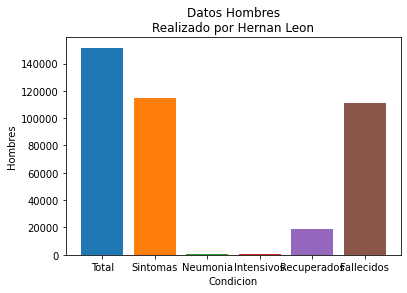

In [27]:
##Haciendo histograma (Hombres)
x=['Total','Sintomas','Neumonia','Intensivos','Recuperados','Fallecidos']
y= [total_hombres,total_hsintomas,total_hneumonia,total_hintensivos,total_hrecuperados,total_hfallecidos]
fig, ax=pp.subplots()
ax.bar(x[0],y[0],label=x[0])
ax.bar(x[1],y[1],label=x[1])
ax.bar(x[2],y[2],label=x[2])
ax.bar(x[3],y[3],label=x[3])
ax.bar(x[4],y[4],label=x[4])
ax.bar(x[5],y[5],label=x[5]) 
pp.title("Datos Hombres\nRealizado por Hernan Leon")
pp.xlabel("Condicion")
pp.ylabel("Hombres")
pp.show()

## Histograma de mujeres

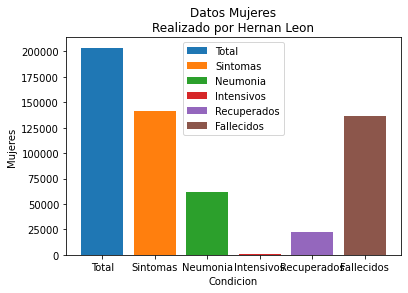

In [26]:
###Haciendo histograma mujeres
x=['Total','Sintomas','Neumonia','Intensivos','Recuperados','Fallecidos']
y= [total_mujeres,total_msintomas,total_mneumonia,total_mintensivos,total_mrecuperados,total_mfallecidos]
fig, ax=pp.subplots()
ax.bar(x[0],y[0],label=x[0])
ax.bar(x[1],y[1],label=x[1])
ax.bar(x[2],y[2],label=x[2])
ax.bar(x[3],y[3],label=x[3])
ax.bar(x[4],y[4],label=x[4])
ax.bar(x[5],y[5],label=x[5])
ax.legend()
pp.title("Datos Mujeres\nRealizado por Hernan Leon")
pp.xlabel("Condicion")
pp.ylabel("Mujeres")
pp.show()